In [128]:
import numpy as np
from tqdm.notebook import tqdm, trange
from alive_progress import alive_bar
import time # to be used in loop iterations
import caffeine
from multiprocess import Pool
import matplotlib.pyplot as plt
np.random.seed(1234)

## 3D spin model

I implemented gaussian kernel-approximation using SGD to 3-spin model, introduced in the 2018 paper by Vanden Eijnden and Grant Rostkoff entitled 'Trainability and Accuracy of Neural Networks: An Interacting Particle System Approach'. Then I compared losses in both the deterministic and the stochastic cases incurred in training by different algorithms, which I plotted. 

In [129]:
def spin_func(x,a):
    """
    Calculate the spin function for a given set of vectors and coefficients.

    Parameters:
    x (np.ndarray): An array representing a set of vectors with shape (n, d).
    a (np.ndarray): An array of coefficients with shape (d, d, d).

    Returns:
    np.ndarray: An array containing the computed spin values with shape (1, n).
    """
    n = x.shape[0]
    d = x.shape[1]
    y = x[:,np.newaxis, :]* x[:,:, np.newaxis]
    y = y[:,:,:,np.newaxis]* x[:,np.newaxis, np.newaxis, :]
    z = y*a[np.newaxis,:,:,:]
    return 1/d*z.sum(axis = (1,2,3)).reshape((1,n))

def grad_spin_func(x,a):
    """
    Calculate the gradient of the spin function with respect to the input vectors.

    Parameters:
    x (np.ndarray): An array representing a set of vectors with shape (n, d).
    a (np.ndarray): An array of coefficients with shape (d, d, d).

    Returns:
    np.ndarray: An array containing the gradient of the spin function with shape (n, d).
    """

    n = x.shape[0]
    d = x.shape[1]
    df = 1/d*np.array([((a[p,:,:]+a[:,p,:]+a[:,:,p])[np.newaxis, :,:]\
                *(x[:,np.newaxis,:]*x[:,:, np.newaxis])).sum(axis = (1,2)) for p in range(d)]).reshape(n,d)
    return df

def spin_func_slice(X,Y,a,d = 5):
    """
    Calculate the spin function for a given pair of angles and coefficients.

    Parameters:
    X (float): The first angle.
    Y (float): The second angle.
    a (np.ndarray): An array of coefficients with shape (d, d, d).
    d (int): The dimensionality of the vectors (default is 5).

    Returns:
    np.ndarray: An array containing the computed spin values with shape (1, n).
    """
    x = np.sqrt(d)*np.array([np.sin(X)*np.cos(Y), np.sin(X)*np.sin(Y), np.cos(X), 0]).reshape(1,d)
    return spin_func(x, a)

vspin_func_slice = np.vectorize(spin_func_slice)
vspin_func_slice.excluded.add(2)

In [11]:
#Initialise params
d = 4
a = np.random.normal(np.zeros((d,d,d)), np.ones((d,d,d)))

([], [])

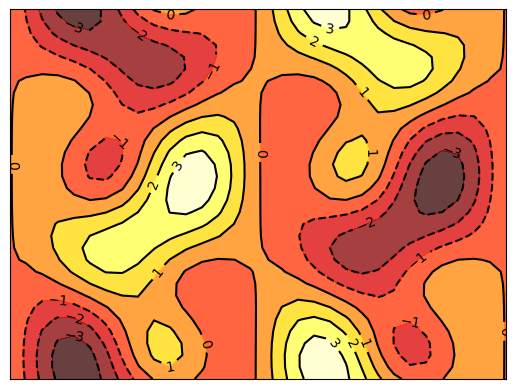

In [12]:
#contour plot of spin function
n = 32
x = np.linspace(-np.pi, np.pi, n)
y = np.linspace(0, 2*np.pi, n)
X, Y = np.meshgrid(x, y)

plt.contourf(X, Y, vspin_func_slice(X, Y, a, d=4), 8, alpha=.75, cmap=plt.cm.hot)
C = plt.contour(X, Y, vspin_func_slice(X,Y, a, d=4), 8, colors='black')
plt.clabel(C, inline=1, fontsize=10)
plt.xticks([])
plt.yticks([])

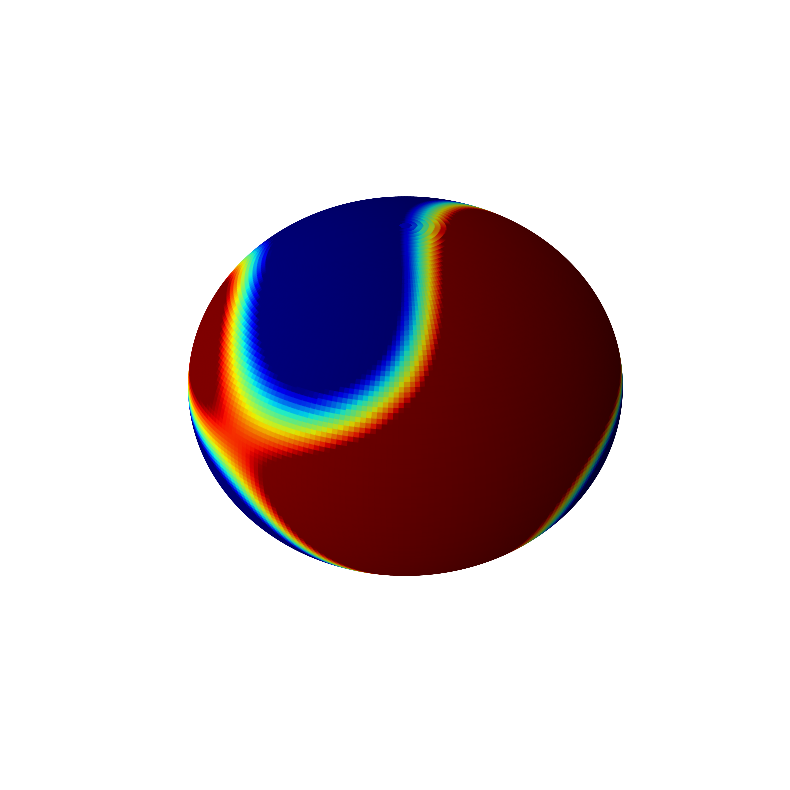

In [164]:
#Heat map (not my code-see below)
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm


def random_point( r=1 ):
    ct = 2*np.random.rand() - 1
    st = np.sqrt( 1 - ct**2 )
    phi = 2* np.pi *  np.random.rand()
    x = r * st * np.cos( phi)
    y = r * st * np.sin( phi)
    z = r * ct
    return np.array( [x, y, z ] )

def near( p, pntList, d0 ):
    cnt=0
    for pj in pntList:
        dist=np.linalg.norm( p - pj )
        if dist < d0:
            cnt += 1 - dist/d0
    return cnt


"""
https://stackoverflow.com/questions/22128909/plotting-the-temperature-distribution-on-a-sphere-with-python
"""

pointList = np.array([ random_point( 10.05 ) for i in range( 65 ) ] )

fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot( 1, 1, 1, projection='3d')

u = np.linspace( 0, 2 * np.pi, 240)
v = np.linspace( 0, np.pi, 120 )

# create the sphere surface
XX = np.sqrt(d) * np.outer( np.cos( u ), np.sin( v ) )
YY = np.sqrt(d) * np.outer( np.sin( u ), np.sin( v ) )
ZZ = np.sqrt(d) * np.outer( np.ones( np.size( u ) ), np.cos( v ) )

WW = XX.copy()
for i in range( len( XX ) ):
    for j in range( len( XX[0] ) ):
        x = XX[ i, j ]
        y = YY[ i, j ]
        z = ZZ[ i, j ]
        WW[ i, j ] = spin_func(np.array([x, y, z, 0]).reshape(1,4), a)
myheatmap = WW

# ~ ax.scatter( *zip( *pointList ), color='#dd00dd' )
ax.plot_surface( XX, YY,  ZZ, cstride=1, rstride=1, facecolors=cm.jet( myheatmap ) )
m = cm.ScalarMappable(cmap=cm.jet)
m.set_array(myheatmap)
#plt.colorbar(m)

ax.set_axis_off()
plt.savefig("/Users/pantelistassopoulos/Documents/texfiles/Summer-Research-2023/images/3d_spin_sphere_plot_d_4.png")

#Show the plot.
plt.show() 

In [130]:
def neural_net_symm(x, c, z):
    """
    Compute the output of a symmetric neural network for given input and parameters.

    Parameters:
    x (np.ndarray): An input vector of shape (1, d).
    c (np.ndarray): Coefficients of the neural network with shape (1, n).
    z (np.ndarray): Weight matrix with shape (n, d).

    Returns:
    np.ndarray: The output of the symmetric neural network with shape (1, 1).
    """
    z = np.array(z)
    n = z.shape[0]
    d = z.shape[1]
    c = c.reshape(1,n)
    return 1/n*(np.exp(-x@z.T)@c.T).reshape(1,x.shape[0])

def neural_net_slice(X, Y, c, z, d = 5):
    """
    Compute the output of a symmetric neural network for given angles and parameters.

    Parameters:
    X (float): The first angle.
    Y (float): The second angle.
    c (np.ndarray): Coefficients of the neural network with shape (1, n).
    z (np.ndarray): Weight matrix with shape (n, d).
    d (int): The dimensionality of the input vectors (default is 5).

    Returns:
    np.ndarray: The output of the symmetric neural network with shape (1, 1).
    """
    x = np.sqrt(d)*np.array([np.sin(X)*np.cos(Y), np.sin(X)*np.sin(Y), np.cos(X),0]).reshape(1,d)
    return neural_net_symm(x, c, z)
vneural_net_slice = np.vectorize(neural_net_slice)
vneural_net_slice.excluded.add(2)
vneural_net_slice.excluded.add(3)

In [131]:
def sample_uniform_sphere(r, d, n):
    """
    Generate random points uniformly distributed on the surface of a d-dimensional sphere with radius 'r'.

    Parameters:
    r (float): The radius of the sphere.
    d (int): The dimensionality of the sphere.
    n (int): The number of points to generate.

    Returns:
    np.ndarray: An array of shape (n, d) containing 'n' random points sampled uniformly on the sphere's surface.
    """
    s = np.random.multivariate_normal(np.zeros(d), np.diag(np.ones(d)), n)
    norm = np.sqrt(np.diag(s@s.T)).reshape(n,1)
    result = r*s/norm
    return result

In [132]:
#Training
def train(d = 5, n = 16, Dt = 1e3, steps = int(2*1e5)):
    """
    Train a neural network with symmetric architecture on a given spin system.

    Parameters:
    d (int): The dimensionality of the spin system (default is 5).
    n (int): The number of neural network units (default is 16).
    Dt (float): Time step for training (default is 1e3).
    steps (int): The number of training steps (default is 200,000).

    Returns:
    tuple: A tuple containing the trained neural network coefficients 'c', the weight matrix 'z',
           and an array of loss values during training.
    """
    
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    L = np.zeros(n).reshape(n,1)
    P = int(1e2)
    x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)
    losses = np.zeros(steps)
    #update step
    for step in trange(steps):
        grad = grad_spin_func(z,a)
        exp = np.exp(-z@z.T)
        #sample points on sphere        
        #exp_x = np.exp(-x@z.T)
        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)
        #loss1 = -1/n*c@spin_func(z, a).T+0.5*1/n**2*c@exp@c.T
        #neural_net_symm(z,c,z)
        c_next = c + (spin_func(z, a)-1/n*c@exp)*Dt 
        z_next = z + (c.T*grad+1/n*(c.T*exp)@(c.T*z))*Dt
        #c_next = c + (spin_func(x, a)@exp_x-1/n*c@exp_x.T@exp_x)*Dt/P
        #z_next = z + ((c.T*exp_x.T)@(spin_func(x, a).T*x)-1/n*(c.T*exp_x.T@((exp_x@c.T)*x)))*Dt/P

        #c_next = c + (spin_func(z, a)@exp-1/n*c@exp.T@exp)*Dt/n
        #z_next = z + ((c.T*exp.T)@(spin_func(z, a).T*z)+1/n*(c.T*exp.T@((exp@c.T)*z)))*Dt/n-L*z*Dt
        z_next = z_next*np.sqrt(d)/(np.linalg.norm(z_next, axis = 1).reshape(n,1)+1e-100)
        #L_next = L - (np.linalg.norm(z_next, axis = 1).reshape(n,1)-np.sqrt(d)*np.ones(n).reshape(n,1))*Dt
        z = z_next
        c = c_next
        #L = L_next
                
        losses[step] = loss
        print('loss: {}'.format(loss))
                
    return c,z, losses

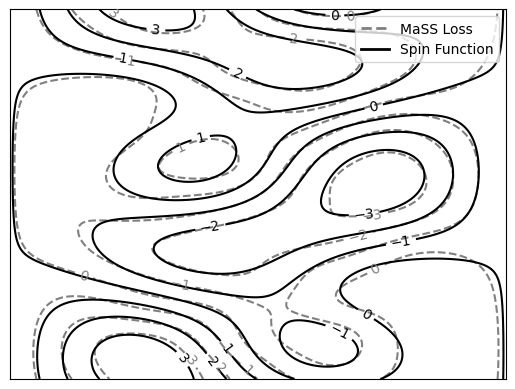

In [213]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

n = 256
x = np.linspace(0, np.pi, n)
y = np.linspace(0, 2 * np.pi, n)
X, Y = np.meshgrid(x, y)

# Assuming vneural_net_slice and vspin_func_slice are defined elsewhere

# Grey, dashed contour for vneural_net_slice
C = plt.contour(X, Y, vneural_net_slice(X, Y, c_mass, z_mass, d=4), 8, colors='grey', linestyles='dashed')
plt.clabel(C, inline=True, fontsize=10)

# Black, solid contour for vspin_func_slice
C2 = plt.contour(X, Y, vspin_func_slice(X, Y, a, d=4), 8, colors='black', linestyles='solid')
plt.clabel(C2, inline=True, fontsize=10)

# Create custom legend
custom_lines = [
    Line2D([0], [0], color='grey', lw=2, linestyle='--', label='MaSS Loss'),
    Line2D([0], [0], color='black', lw=2, linestyle='-', label='Spin Function')
]
plt.legend(handles=custom_lines, loc='upper right')

# Remove ticks for cleaner appearance
plt.xticks([])
plt.yticks([])
plt.savefig('/Users/pantelistassopoulos/Documents/3d-spin-model-neural-net-plot-d=4.png')
# Display the plot
plt.show()

In [ ]:
#Training with Nesterov accelerated gd
def nesterov_train_stochastic(d = 5, n = 16, Dt = 1e3, r = 3, k = 1, steps = int(2*1e5)):
    """
    Train a neural network with symmetric architecture on a given spin system using Nesterov's accelerated gradient descent.

    Parameters:
    d (int): The dimensionality of the spin system (default is 5).
    n (int): The number of neural network units (default is 16).
    Dt (float): Time step for training (default is 1e3).
    r (int): The number of steps for Nesterov's acceleration (default is 3).
    steps (int): The number of training steps (default is 200,000).

    Returns:
    tuple: A tuple containing the trained neural network coefficients 'c', the weight matrix 'z',
           and an array of loss values during training.
    """
    
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    c_change = c
    z_change = z
    
    
    losses = np.zeros(steps)
    #update step
    for step in trange(steps):
        grad = grad_spin_func(z_change,a)
        exp = np.exp(-z_change@z_change.T)
        #sample points on sphere
        P = int(1e2)
        x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)
        exp_x = np.exp(-x@z_change.T)
        
        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)    
        
        c1 = c
        z1 = z
        
        c_next = c_change + (spin_func(x, a)@exp_x-1/n*c_change@exp_x.T@exp_x)*Dt/P
        z_next = z_change + (-(c_change.T*exp_x.T)@(spin_func(x, a).T*x)+1/n*(c_change.T*exp_x.T@((exp_x@c_change.T)*x)))*Dt/P
        #z_next = z_change + ((c_change.T*exp_x.T)@(spin_func(x, a).T*x)\
        #                     -1/n*(c_change.T*exp_x.T@((exp_x@c_change.T)*x)))*Dt/P
        z_next = z_next*np.sqrt(d)/(np.linalg.norm(z_next, axis = 1).reshape(n,1)+1e-100)
                
        
        c_change = c_next + k*(c_next-c1)
        z_change = z_next + k*(z_next-z1)
        z = z_next
        c = c_next
        
        if (dc@(c_next-c).T)[0]+(dz*(z_next-z)).sum()>0: 
            count = 1
        
        
        losses[step] = loss
        print('loss: {}'.format(loss))
        z = z_next
        c = c_next
        
        
    return c,z, losses

In [205]:
#Training with Nesterov accelerated gd
def grad_restart_nesterov_train_stochastic(d = 5, n = 16, Dt = 1e3, r = 3, k = 1, steps = int(2*1e5)):
    """
    Train a neural network with symmetric architecture on a given spin system using Nesterov's accelerated gradient descent.

    Parameters:
    d (int): The dimensionality of the spin system (default is 5).
    n (int): The number of neural network units (default is 16).
    Dt (float): Time step for training (default is 1e3).
    r (int): The number of steps for Nesterov's acceleration (default is 3).
    steps (int): The number of training steps (default is 200,000).

    Returns:
    tuple: A tuple containing the trained neural network coefficients 'c', the weight matrix 'z',
           and an array of loss values during training.
    """
    
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    c_change = c
    z_change = z
    
    count =1
    losses = np.zeros(steps)
    #update step
    for step in trange(steps):
        grad = grad_spin_func(z_change,a)
        exp = np.exp(-z_change@z_change.T)
        #sample points on sphere
        P = int(1e2)
        x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)
        exp_x = np.exp(-x@z_change.T)
        
        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)    
        
        c1 = c
        z1 = z
        
        dc = -(spin_func(x, a)@exp_x-1/n*c_change@exp_x.T@exp_x)/P
        dz = -(-(c_change.T*exp_x.T)@(spin_func(x, a).T*x)+1/n*(c_change.T*exp_x.T@((exp_x@c_change.T)*x)))/P
        
        c_next = c_change -dc*Dt
        z_next = z_change -dz*Dt
        #z_next = z_change + ((c_change.T*exp_x.T)@(spin_func(x, a).T*x)\
        #                     -1/n*(c_change.T*exp_x.T@((exp_x@c_change.T)*x)))*Dt/P
        z_next = z_next*np.sqrt(d)/(np.linalg.norm(z_next, axis = 1).reshape(n,1)+1e-100)
                
        c_change = c_next + (count-1)/(count+2)*(c_next-c1)
        z_change = z_next + (count-1)/(count+2)*(z_next-z1)
        z = z_next
        c = c_next
        
        
        losses[step] = loss
        print('loss: {}'.format(loss))
        z = z_next
        c = c_next
        
        
    return c,z, losses

In [64]:
#Training with Nesterov accelerated gd
def nesterov_train_deterministic(d = 5, n = 16, Dt = 1e3, r = 3, steps = int(2*1e5)):
    """
    Train a neural network with symmetric architecture on a given spin system using Nesterov's accelerated gradient descent.

    Parameters:
    d (int): The dimensionality of the spin system (default is 5).
    n (int): The number of neural network units (default is 16).
    Dt (float): Time step for training (default is 1e3).
    r (int): The number of steps for Nesterov's acceleration (default is 3).
    steps (int): The number of training steps (default is 200,000).

    Returns:
    tuple: A tuple containing the trained neural network coefficients 'c', the weight matrix 'z',
           and an array of loss values during training.
    """
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    c_change = c
    z_change = z

    losses = np.zeros(steps)
    #update step
    for step in trange(1,steps+1):
        grad = grad_spin_func(z_change,a)
        exp = np.exp(-z_change@z_change.T)
        #sample points on sphere
        P = int(1e3)
        x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)

        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)

        c1 = c
        z1 = z
        
        c_next = c_change + (spin_func(z_change, a)@exp-1/n*c@exp.T@exp)*Dt/P
        z_next = z_change + ((c_change.T*exp.T)@(spin_func(z_change, a).T*z_change)\
                      -1/n*(c_change.T*exp.T@((exp@c_change.T)*z_change)))*Dt/P
        z_next = z_next*np.sqrt(d)/np.linalg.norm(z_next, axis = 1).reshape(n,1)

        c_change = c_next + 0.1*(c_next-c1)
        z_change = z_next + 0.1*(z_next-z1)
        z = z_next
        c = c_next

        losses[step-1] = loss
        print('loss: {}'.format(loss))
            
    return c,z, losses

In [196]:
def train_MaSS(d = 3, n = 256, steps = int(5*1e3), Dt = 1e-3, tolerance = 1e-2):
    
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    losses = np.zeros(steps)
    
    u = c
    v = z
    count = 1
    
    for step in trange(steps):
        
        grad = grad_spin_func(v,a)
        exp = np.exp(-v@v.T)
        #sample points on sphere
        P = int(1e2)
        x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)
        exp_x = np.exp(-x@v.T)

        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)
        
        dc = -(spin_func(x, a)@exp_x-1/n*c@exp_x.T@exp_x)/P
        dz = -(-(u.T*exp_x.T)@(spin_func(x, a).T*x)+1/n*(u.T*exp_x.T@((exp_x@u.T)*x)))/P
        
        m = 10
        eta2 = Dt/m
        
        c_new = u - Dt*dc
        z_new = v - Dt*dz
        
        u = c_new + (count-1)/(count+2)*(c_new-c) + eta2*dc
        v = z_new + (count-1)/(count+2)*(z_new-z) + eta2*dz

        if (dc@(c_new-c).T)[0]+(dz*(z_new-z)).sum()>0: 
            count = 1
        
        c = c_new
        z = z_new
        
        count +=1
        losses[step] = loss
        print('loss: {}'.format(loss))
    
    
    return c,z,losses

In [197]:
#contour plot of neural net reconstruction
c_mass,z_mass,losses_mass = train_MaSS(d = 4, n = 256, Dt = 1e-7, steps = int(1*1e5))

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 33348.18348173552
loss: 19176.571410863213
loss: 8250.043000486996
loss: 6682.580088644517
loss: 4505.179192915065
loss: 3049.715548946428
loss: 1870.9415671897916
loss: 1427.184359721669
loss: 1184.6500209878425
loss: 949.9574078079766
loss: 1122.8289890088645
loss: 842.1768110900048
loss: 498.3187103734814
loss: 638.0117689472511
loss: 592.1166481796813
loss: 390.544741174386
loss: 489.8230927653073
loss: 418.92011765723595
loss: 291.5390318528382
loss: 248.92045327014347
loss: 243.12489051166486
loss: 290.939854322477
loss: 207.6210657088355
loss: 238.31526423433934
loss: 238.86500577138267
loss: 182.22815502610226
loss: 209.81761103175992
loss: 153.92064375295783
loss: 106.8938589562577
loss: 144.99382898702888
loss: 193.49090556326698
loss: 136.62506479238783
loss: 111.58368783458295
loss: 74.51982800145603
loss: 73.37071693337204
loss: 75.88813510407775
loss: 69.72900236824351
loss: 57.17240399609771
loss: 48.341890645923165
loss: 48.5577260368323
loss: 48.73714282432086
lo

loss: 1.2446874088065132
loss: 1.3149316347172382
loss: 1.2605648841688386
loss: 1.4454125698504843
loss: 1.1694079132213049
loss: 0.999714068937284
loss: 1.1934147726840698
loss: 1.2603668581689869
loss: 1.7733073474817822
loss: 1.3859609010339355
loss: 1.1672668563616888
loss: 1.3620462188221663
loss: 1.3392852684233625
loss: 1.1062031594344375
loss: 1.2093647669356267
loss: 0.9861460491399563
loss: 1.4941107156225641
loss: 1.1403777413462148
loss: 1.310794522470993
loss: 1.2276369338793054
loss: 1.211442402319772
loss: 1.165104362154385
loss: 1.1025141364763236
loss: 1.7861229482114436
loss: 1.2263771010541644
loss: 1.3624468345256866
loss: 1.45322993344384
loss: 1.3528240408685261
loss: 1.2620384115555554
loss: 1.5438958346518303
loss: 1.0886097367106438
loss: 1.1112908026673016
loss: 1.195162166372968
loss: 1.4727077112820128
loss: 1.5837995187536622
loss: 1.1444547274190358
loss: 1.1157555099410503
loss: 1.2531091114706157
loss: 1.4622031352792932
loss: 1.1727768413964748
loss: 1

loss: 0.4975732765805924
loss: 0.4779228787972859
loss: 0.5932369282200015
loss: 0.662945465310055
loss: 0.6184039351276263
loss: 0.5873188398549491
loss: 0.6807212580598332
loss: 0.6841879909184299
loss: 0.6820810690184186
loss: 0.7040423465525899
loss: 0.5425535372102948
loss: 0.6610926526391547
loss: 0.6437408705190216
loss: 0.6280567785073512
loss: 0.590408018250489
loss: 0.5759450263367387
loss: 0.5991101422294558
loss: 0.7901808248621629
loss: 0.6528905099939568
loss: 0.548640484979454
loss: 0.4067961539319345
loss: 0.6542917261321446
loss: 0.5505025092320932
loss: 0.6431625704717099
loss: 0.5744814285281712
loss: 0.5577108228432549
loss: 0.6696627529566161
loss: 0.43628588019059356
loss: 0.5437397511875299
loss: 0.5416923938272298
loss: 0.5957886614533695
loss: 0.5355929423741166
loss: 0.5544834545125634
loss: 0.5272159357677123
loss: 0.6757614942882415
loss: 0.569475843362953
loss: 0.6336614425867563
loss: 0.7243887117211301
loss: 0.6740619816851967
loss: 0.5640080684185392
los

loss: 0.384187851246925
loss: 0.3204331994615211
loss: 0.4666574938195791
loss: 0.42436832724669216
loss: 0.3992936317502805
loss: 0.4145280775734246
loss: 0.4808809768377095
loss: 0.34596220451281345
loss: 0.413268479890323
loss: 0.44339227625756245
loss: 0.4150183113281286
loss: 0.44564808739220724
loss: 0.36434404808289556
loss: 0.2897069303226911
loss: 0.3703216905393176
loss: 0.37007840113382734
loss: 0.4006767053734998
loss: 0.4286350140964933
loss: 0.472153768776724
loss: 0.3952819355240955
loss: 0.403702956988737
loss: 0.31973332781682623
loss: 0.25130154492607376
loss: 0.5143742061228087
loss: 0.36830910595959876
loss: 0.3295343598921267
loss: 0.2873192470566959
loss: 0.3280573855326347
loss: 0.34495922785737115
loss: 0.36400031609959393
loss: 0.4032008878782275
loss: 0.3657804765487386
loss: 0.41033892776335834
loss: 0.3421277333621676
loss: 0.5304868846276429
loss: 0.35569722142973925
loss: 0.40801805885615716
loss: 0.34013188064454897
loss: 0.34530926278298035
loss: 0.28936

loss: 0.35788894142757566
loss: 0.32986631320887677
loss: 0.30633904002636697
loss: 0.27735259016101255
loss: 0.32172361077511236
loss: 0.4120832306127268
loss: 0.35741912265303805
loss: 0.3620393710664861
loss: 0.3487217106225299
loss: 0.2910292082938489
loss: 0.3343328529258979
loss: 0.2826606511743186
loss: 0.30603427184338144
loss: 0.25297903705450236
loss: 0.3307028748813924
loss: 0.27306866100366717
loss: 0.23280006862951358
loss: 0.30112363602692443
loss: 0.3463816670406261
loss: 0.31847840742436706
loss: 0.30525375386579934
loss: 0.28115029726470264
loss: 0.35721411933647956
loss: 0.30287930249950024
loss: 0.27043878657103404
loss: 0.3122486793792295
loss: 0.2916457243829446
loss: 0.3222443869410741
loss: 0.28144361295995246
loss: 0.32290531203244177
loss: 0.32165389466657435
loss: 0.32378275447177257
loss: 0.29879673484007513
loss: 0.27351761770421357
loss: 0.28371273745314285
loss: 0.3006693787959219
loss: 0.32655135151346765
loss: 0.3329888220617927
loss: 0.2838042696595787


loss: 0.21367653973376224
loss: 0.26252868688915876
loss: 0.2670027683238336
loss: 0.25264890887914226
loss: 0.2904204014381608
loss: 0.23618636173686763
loss: 0.23944953552951723
loss: 0.23865492193462962
loss: 0.20269830680857515
loss: 0.32995476528032486
loss: 0.3168498211724812
loss: 0.293302514015943
loss: 0.23455875071865223
loss: 0.2533475731210447
loss: 0.25941209154654615
loss: 0.3029156643211127
loss: 0.28072451502285023
loss: 0.19401959584077771
loss: 0.24224737172973787
loss: 0.24803247507267642
loss: 0.30044848436501603
loss: 0.317895333774537
loss: 0.29366193124254864
loss: 0.2677586986826374
loss: 0.268478768412236
loss: 0.25839868330595456
loss: 0.28131791931084377
loss: 0.3394984898566436
loss: 0.22646892700614984
loss: 0.2409819283905915
loss: 0.22177004623592822
loss: 0.2994580703858036
loss: 0.2297617875652231
loss: 0.2894178292987749
loss: 0.23453575293783518
loss: 0.21816925884000252
loss: 0.2444535514661534
loss: 0.27854070885172477
loss: 0.24229855294452934
loss

loss: 0.2116958088863547
loss: 0.29240827927145613
loss: 0.15743188620105014
loss: 0.21733578628169745
loss: 0.22622091646736991
loss: 0.23988876177969587
loss: 0.22597107890056572
loss: 0.2951523182586406
loss: 0.23769523758745145
loss: 0.19898825480658658
loss: 0.18975359472323386
loss: 0.22031436258589573
loss: 0.20633286896238762
loss: 0.2668428890506113
loss: 0.23075667296832741
loss: 0.24424458259170517
loss: 0.2774736635276777
loss: 0.289256783278044
loss: 0.24652487006282764
loss: 0.21399632935037616
loss: 0.19217514515177897
loss: 0.24568954046258903
loss: 0.2253489202157694
loss: 0.23271312365840444
loss: 0.2048514175345754
loss: 0.19179000653919864
loss: 0.2425364411849906
loss: 0.18243815866451146
loss: 0.22892174466818202
loss: 0.2239472358878821
loss: 0.18402758942172467
loss: 0.31763387959480777
loss: 0.21717597419388826
loss: 0.17463174080675004
loss: 0.24711676726966764
loss: 0.30747685041494477
loss: 0.26459125277808004
loss: 0.22261376997076204
loss: 0.21832058034398

loss: 0.2411734273977565
loss: 0.1629480542176243
loss: 0.21760802948411154
loss: 0.23404748922121243
loss: 0.1909731084942066
loss: 0.22977579918086757
loss: 0.22777786759736934
loss: 0.19633759858324976
loss: 0.22698567289847624
loss: 0.19675655860579971
loss: 0.19656721700956228
loss: 0.17253064319431272
loss: 0.25043846183231844
loss: 0.14682250000553487
loss: 0.13637204105145018
loss: 0.20075890140375263
loss: 0.18123144620605586
loss: 0.17956290667123154
loss: 0.23794460434257197
loss: 0.23922792538613213
loss: 0.18488477368793177
loss: 0.14099241271505605
loss: 0.19552348113652673
loss: 0.2408049876000619
loss: 0.20894461274617726
loss: 0.13020942914565425
loss: 0.2061792432998866
loss: 0.1884769598064483
loss: 0.2064549926612055
loss: 0.2511271065286083
loss: 0.2841351166807258
loss: 0.16802749828163
loss: 0.1974108267246428
loss: 0.16172117228652177
loss: 0.1756864682741977
loss: 0.20059058970771612
loss: 0.20887791029967445
loss: 0.21596147532969467
loss: 0.21055373777081596


loss: 0.2187546317358523
loss: 0.2043403542444993
loss: 0.15440753366628
loss: 0.184003467618773
loss: 0.1511356881588271
loss: 0.18236826827659156
loss: 0.17432086835509344
loss: 0.20630857660974322
loss: 0.18963101855090794
loss: 0.16544066591865397
loss: 0.1870500770003627
loss: 0.1681718762925971
loss: 0.16394696095799716
loss: 0.1749658353266991
loss: 0.22143589812125777
loss: 0.18866747298117537
loss: 0.22953069249447913
loss: 0.1692182287086412
loss: 0.15876082150997006
loss: 0.18985674970368607
loss: 0.17772613040064145
loss: 0.1991188399777474
loss: 0.15318129022473229
loss: 0.17424917807042725
loss: 0.19208962923579864
loss: 0.1749155431269043
loss: 0.20639761910925997
loss: 0.22026453401314522
loss: 0.1397326806647831
loss: 0.1936995923140494
loss: 0.20228311342951372
loss: 0.17060939128417144
loss: 0.18279897831916986
loss: 0.25564094290590017
loss: 0.2066578418492811
loss: 0.18661545954930478
loss: 0.183545364069886
loss: 0.19502514175080696
loss: 0.1894051160232145
loss: 

loss: 0.2353593685586704
loss: 0.17199482169031033
loss: 0.19258615629473738
loss: 0.21319711399928729
loss: 0.19595287826885738
loss: 0.23278073199402574
loss: 0.13354512771649726
loss: 0.15885281539116936
loss: 0.18392604015254188
loss: 0.16420916868777066
loss: 0.1764235866688074
loss: 0.19942910711729783
loss: 0.16839315614360678
loss: 0.1934733123190735
loss: 0.1949904651441849
loss: 0.14314123201582604
loss: 0.1970387658049182
loss: 0.14868328326548513
loss: 0.15126085258149982
loss: 0.18827365217677752
loss: 0.1582858574292584
loss: 0.1735719124386155
loss: 0.18636275374683084
loss: 0.21101906989143338
loss: 0.19185046533983274
loss: 0.14610372525322085
loss: 0.19589799134517968
loss: 0.15758504750363164
loss: 0.1998143655191485
loss: 0.16981470663596446
loss: 0.1468705749047373
loss: 0.17244366996010996
loss: 0.20594764623484554
loss: 0.16827400534983616
loss: 0.16594684869654636
loss: 0.15780606343950676
loss: 0.1697848652336397
loss: 0.1605670648675243
loss: 0.190290840636901

loss: 0.14350135427822516
loss: 0.1930878906189955
loss: 0.1854106981825359
loss: 0.19914631964648166
loss: 0.15049125328137344
loss: 0.18772505671384926
loss: 0.15773045106862033
loss: 0.157793987208729
loss: 0.1635257483192517
loss: 0.1653482391735923
loss: 0.17597263693161802
loss: 0.16983477816592077
loss: 0.1611455650477032
loss: 0.17722613416576982
loss: 0.17501897966677565
loss: 0.1535387698144264
loss: 0.1667561475093715
loss: 0.16000673318828748
loss: 0.19529855147512518
loss: 0.131250103147638
loss: 0.16397079043878782
loss: 0.10756466744156432
loss: 0.18370384596125802
loss: 0.17490374238053177
loss: 0.13699569947647772
loss: 0.1307815283767746
loss: 0.1249851971514879
loss: 0.18245823205209508
loss: 0.1734759593413291
loss: 0.19807444985033623
loss: 0.19808955355273553
loss: 0.1477947280654391
loss: 0.13266291158804264
loss: 0.1303169058585415
loss: 0.21345366232970664
loss: 0.14390624394280574
loss: 0.15795672393314897
loss: 0.2033433913378349
loss: 0.23942741582511598
los

loss: 0.14282403898510845
loss: 0.18617142781057958
loss: 0.11128176354714107
loss: 0.16029022620154457
loss: 0.1622438303279319
loss: 0.13851351709043336
loss: 0.1696935106214066
loss: 0.1781548113934759
loss: 0.17329036501067907
loss: 0.1787078322910758
loss: 0.14579716732760675
loss: 0.1223292022796986
loss: 0.11143202147601822
loss: 0.18081055026126458
loss: 0.1745611789795624
loss: 0.133907446817218
loss: 0.1503570828432423
loss: 0.14523211904502326
loss: 0.1338247133553559
loss: 0.13255479037522966
loss: 0.16989041662823154
loss: 0.14990308902122249
loss: 0.12849925450960473
loss: 0.1611107401445722
loss: 0.1321767650709905
loss: 0.174791157806892
loss: 0.14067947090840877
loss: 0.12977061453324668
loss: 0.13210723388953532
loss: 0.12139789796447353
loss: 0.12406144945847825
loss: 0.150498732549376
loss: 0.13785027853082282
loss: 0.14208813549792096
loss: 0.13723611875351774
loss: 0.20651213367819046
loss: 0.16756322575993746
loss: 0.1305710581764882
loss: 0.14611801859218113
los

loss: 0.18492945548001669
loss: 0.13636464178423946
loss: 0.14521082300410984
loss: 0.1437776935728156
loss: 0.14971034031601627
loss: 0.16627109139982965
loss: 0.12678792622306087
loss: 0.2055534143819895
loss: 0.14670578764707198
loss: 0.14555749444206584
loss: 0.16349678952882102
loss: 0.12274601283014455
loss: 0.20720137146387463
loss: 0.1496446341839646
loss: 0.1406046224661474
loss: 0.15133282259583875
loss: 0.1888937984914829
loss: 0.18145800732250764
loss: 0.1685890243310247
loss: 0.14055262585787728
loss: 0.15589244556080736
loss: 0.17185248139654496
loss: 0.14797612817026928
loss: 0.18167155498551282
loss: 0.124378894778726
loss: 0.1302009814950408
loss: 0.16269766888400966
loss: 0.12850127260380229
loss: 0.16040399881393064
loss: 0.18324417747766983
loss: 0.15000206500077573
loss: 0.15915250711810333
loss: 0.15504512976331195
loss: 0.15584551211102665
loss: 0.15898055135297978
loss: 0.12691286940836366
loss: 0.13222937699424495
loss: 0.12739572362736196
loss: 0.1521488322830

loss: 0.12738515531274944
loss: 0.1551215100264791
loss: 0.11506916143094362
loss: 0.12395784021859686
loss: 0.10781554008774412
loss: 0.15419652999082312
loss: 0.15921186612954766
loss: 0.13084141239259742
loss: 0.1299540011890787
loss: 0.12492011231956696
loss: 0.1282009233569321
loss: 0.13404268720498438
loss: 0.13477075895159638
loss: 0.11470466841616915
loss: 0.10030832894946201
loss: 0.12453116346321835
loss: 0.08730078979534256
loss: 0.14990424775898623
loss: 0.13687392275784202
loss: 0.15346127801802872
loss: 0.13599263714242912
loss: 0.14298758895484795
loss: 0.1133667204665376
loss: 0.11202433621290435
loss: 0.11155032748606025
loss: 0.12730317137291247
loss: 0.18042712824845636
loss: 0.1263424323826034
loss: 0.1267031486684473
loss: 0.1213663131129182
loss: 0.1118036150596857
loss: 0.1000136609409264
loss: 0.1278407014797502
loss: 0.11044313923322574
loss: 0.13784138301571827
loss: 0.12440642510105697
loss: 0.1237193120422461
loss: 0.11085144264891776
loss: 0.139347330870436

loss: 0.12264484718169594
loss: 0.11489452759804887
loss: 0.1250951190782479
loss: 0.14515384468627401
loss: 0.13794823915521598
loss: 0.10260170062774172
loss: 0.1665200622649768
loss: 0.10761944812106554
loss: 0.1273888084885138
loss: 0.15071742005573044
loss: 0.1277391139367427
loss: 0.12353759604619605
loss: 0.13882773458806286
loss: 0.11466526198516698
loss: 0.169882367489432
loss: 0.14268539834530472
loss: 0.14335613884149911
loss: 0.12903901134158188
loss: 0.14501738075892112
loss: 0.10980883247331956
loss: 0.14858783771367023
loss: 0.13528713420341376
loss: 0.10999593349748445
loss: 0.12116561265006504
loss: 0.14172632850572942
loss: 0.13069615517239028
loss: 0.1280034299130824
loss: 0.12713225972681313
loss: 0.11692258180534171
loss: 0.10894415381761975
loss: 0.14346544693577423
loss: 0.17443733756820273
loss: 0.12320549572380642
loss: 0.14408650187035638
loss: 0.11116325120798562
loss: 0.11621274495130962
loss: 0.11298835296387316
loss: 0.13096055643976245
loss: 0.14915108085

loss: 0.14162844175853384
loss: 0.11572263271061761
loss: 0.15630167950690615
loss: 0.11638785820487069
loss: 0.1416839724424969
loss: 0.11536461189438317
loss: 0.12934377029644142
loss: 0.15234332767389513
loss: 0.15027448711235827
loss: 0.11962590705160255
loss: 0.10261940437808159
loss: 0.12978104990119727
loss: 0.13542563576959613
loss: 0.1371709166949542
loss: 0.14070227945151356
loss: 0.1300751830833273
loss: 0.11712602967603607
loss: 0.1126271059422508
loss: 0.1011748491847785
loss: 0.13333973208324176
loss: 0.1416847726538645
loss: 0.12816589098685593
loss: 0.08826198083100238
loss: 0.1242758510991229
loss: 0.10437837605567654
loss: 0.12225231779161558
loss: 0.10381215687551736
loss: 0.14281439412283986
loss: 0.11674618332149693
loss: 0.11112851695904429
loss: 0.10252877696944881
loss: 0.1048439551750237
loss: 0.12384327268087088
loss: 0.1278444917979176
loss: 0.12984434250528867
loss: 0.14030190188479322
loss: 0.13167268546391392
loss: 0.1325827443292662
loss: 0.09279117411578

loss: 0.14324931026562235
loss: 0.1251050354819959
loss: 0.09962569782683259
loss: 0.11688975292410685
loss: 0.11738145955497875
loss: 0.10072178592338853
loss: 0.09603020246641551
loss: 0.08969311240863558
loss: 0.0976071756904903
loss: 0.09877798050593738
loss: 0.12300735970604461
loss: 0.12655328510653915
loss: 0.12766682278228622
loss: 0.11084196419313783
loss: 0.10116555881968572
loss: 0.10117698229213841
loss: 0.15393518346401144
loss: 0.1279028158728191
loss: 0.09793619630944152
loss: 0.12249479101438036
loss: 0.12771548103640987
loss: 0.0919802904770508
loss: 0.10026037933052902
loss: 0.13018231180425016
loss: 0.10130373694234521
loss: 0.13329651914146104
loss: 0.10686088861755183
loss: 0.13337345162739292
loss: 0.13538994810049415
loss: 0.10289269305841056
loss: 0.09879304788506144
loss: 0.12631965440521484
loss: 0.14248653862323782
loss: 0.12005737936023393
loss: 0.12998990931336984
loss: 0.12496169719085291
loss: 0.11434749921860166
loss: 0.10249322116613266
loss: 0.12338145

loss: 0.08553814723039871
loss: 0.10525508432820646
loss: 0.1264674633986624
loss: 0.10385277077789602
loss: 0.13197890192617334
loss: 0.10563651504692188
loss: 0.1104089387176114
loss: 0.09438481833053991
loss: 0.1002709530375781
loss: 0.12687648010488772
loss: 0.12382627279125419
loss: 0.09554025578749331
loss: 0.15131569018227314
loss: 0.09188042952313824
loss: 0.14594976922011893
loss: 0.09916340290311025
loss: 0.12378510893929358
loss: 0.10817974818067333
loss: 0.13103412181358853
loss: 0.10647475910224163
loss: 0.09371816845336933
loss: 0.131468336177112
loss: 0.1343856054692269
loss: 0.116386521337952
loss: 0.11313279444501231
loss: 0.12816321025939795
loss: 0.11928221699981353
loss: 0.13712266262145076
loss: 0.12137863549471009
loss: 0.0953938738284179
loss: 0.10018939691379224
loss: 0.0975363301677019
loss: 0.12772988321071335
loss: 0.12089862477312961
loss: 0.12084211815804131
loss: 0.12283798147893261
loss: 0.12551589754196668
loss: 0.1374698758031099
loss: 0.088942012200018

loss: 0.10466365389615766
loss: 0.10492761249142575
loss: 0.11813835796334779
loss: 0.09617214766647894
loss: 0.15816246705248005
loss: 0.09828005208710837
loss: 0.11930234558899735
loss: 0.12932681460962206
loss: 0.1506573937635708
loss: 0.08592657221588755
loss: 0.10758484219238623
loss: 0.13331052469971577
loss: 0.11619767546875183
loss: 0.06938472084043158
loss: 0.10893091012315427
loss: 0.10851686397766562
loss: 0.1291711167068451
loss: 0.09336809583304546
loss: 0.10940435237237921
loss: 0.12492126427037327
loss: 0.10686380648651087
loss: 0.1074751814511641
loss: 0.11908353050132799
loss: 0.1155634803210528
loss: 0.11874722183965745
loss: 0.11783165873673929
loss: 0.1097129869338885
loss: 0.13343321560841118
loss: 0.11895813028411202
loss: 0.1057706316074553
loss: 0.10139648991792503
loss: 0.11047733585319486
loss: 0.13011668536478121
loss: 0.10423676175471734
loss: 0.0979531003277899
loss: 0.09088127342052475
loss: 0.13890629855674855
loss: 0.13681476456404978
loss: 0.13674412044

loss: 0.10390719140723141
loss: 0.11564371714305026
loss: 0.11592386637856887
loss: 0.10045828771854523
loss: 0.09394281104578972
loss: 0.11690071171647086
loss: 0.09940995817263318
loss: 0.08373339691359485
loss: 0.09340797786347048
loss: 0.09488668614863176
loss: 0.1025078616309413
loss: 0.10523866992807507
loss: 0.1397878784515118
loss: 0.11431817076963266
loss: 0.13018539330865303
loss: 0.10403220316092371
loss: 0.10007812964992391
loss: 0.11963562797207979
loss: 0.09502788734601149
loss: 0.12611694802036064
loss: 0.12110838613570579
loss: 0.0948722974540598
loss: 0.11130918278049397
loss: 0.06840972227255132
loss: 0.08793823485227653
loss: 0.08321637679289326
loss: 0.08218004144842511
loss: 0.1149701053205491
loss: 0.1141565423397223
loss: 0.08810282069976581
loss: 0.09396971470739743
loss: 0.10372730599829502
loss: 0.13062022556386255
loss: 0.11704685907747878
loss: 0.07687183857218419
loss: 0.1186473204128999
loss: 0.09417894641275186
loss: 0.10128875810067348
loss: 0.0912257119

loss: 0.09746638551980205
loss: 0.13263759299814945
loss: 0.10385002191934177
loss: 0.09163190701071479
loss: 0.08030263670936102
loss: 0.11366016288601197
loss: 0.09668578785086651
loss: 0.09792484715247697
loss: 0.12065268099401293
loss: 0.11508110936482413
loss: 0.0796363972248742
loss: 0.11589760210765636
loss: 0.09608622937980464
loss: 0.0879870020150355
loss: 0.09613201259878801
loss: 0.09119612774842148
loss: 0.08908501226648306
loss: 0.10896716776512512
loss: 0.08200535610685136
loss: 0.10031555421660844
loss: 0.08772778307982028
loss: 0.12146175790854966
loss: 0.11847916802808652
loss: 0.10989656420066121
loss: 0.11499113262531141
loss: 0.09679259998008934
loss: 0.09819861401262216
loss: 0.0984100359167503
loss: 0.10382105711341022
loss: 0.08132701155098099
loss: 0.08728794069687845
loss: 0.07466780128455325
loss: 0.10854776982239461
loss: 0.1119809425418154
loss: 0.07868458180061974
loss: 0.08796581811362261
loss: 0.1017963264499922
loss: 0.09553065198987035
loss: 0.093234268

loss: 0.08303831495274058
loss: 0.10168236556187199
loss: 0.08960927270013974
loss: 0.0904150314045627
loss: 0.08900360313195675
loss: 0.08232794100088087
loss: 0.11723371699604736
loss: 0.0934024269934617
loss: 0.10223126434864137
loss: 0.09455072755836555
loss: 0.09935494255550831
loss: 0.11190654115730396
loss: 0.10499000776126793
loss: 0.12602682154575912
loss: 0.11276213682482583
loss: 0.07727343917763208
loss: 0.09034980565018916
loss: 0.09169805868940055
loss: 0.08497937103057679
loss: 0.0896187832889706
loss: 0.0840100735092096
loss: 0.10712540541867367
loss: 0.08874186273276234
loss: 0.08853212306570268
loss: 0.09437084028339907
loss: 0.10689868933842091
loss: 0.09338537975366196
loss: 0.09036267604170266
loss: 0.08625259791621241
loss: 0.10215768385673424
loss: 0.07725930749714238
loss: 0.11522663057082891
loss: 0.09902340871598345
loss: 0.08109460932567535
loss: 0.09886886878712099
loss: 0.08070841885724905
loss: 0.10003326912207092
loss: 0.11227224930993675
loss: 0.09089008

loss: 0.0956165480253183
loss: 0.07390283103856561
loss: 0.09613148209414657
loss: 0.08122984521322964
loss: 0.11134501787831147
loss: 0.1087420062173991
loss: 0.09751850774693878
loss: 0.09588158200326088
loss: 0.09225398660287826
loss: 0.08117358577634116
loss: 0.09302371584489354
loss: 0.0972021456257206
loss: 0.0893921855446202
loss: 0.08480134186730323
loss: 0.09322689002605024
loss: 0.09253586378690912
loss: 0.1154212380881816
loss: 0.0876549406033435
loss: 0.08093220353137859
loss: 0.09727533681373231
loss: 0.08964660478101324
loss: 0.09511371849399687
loss: 0.09562897807970934
loss: 0.09640847864552975
loss: 0.08967390441678132
loss: 0.10615514811040004
loss: 0.08830754575949731
loss: 0.073107995956029
loss: 0.10456251967487303
loss: 0.09197070474638097
loss: 0.09815118405755172
loss: 0.11257470966308258
loss: 0.1030277520566689
loss: 0.09741300038497147
loss: 0.11223115023552824
loss: 0.09012819988175202
loss: 0.09473872242204052
loss: 0.1014168556821689
loss: 0.10028231129220

loss: 0.10073729964956246
loss: 0.09310047375520031
loss: 0.1161481055331988
loss: 0.09833523859428102
loss: 0.08310614837810522
loss: 0.09295174722255245
loss: 0.0901147347170009
loss: 0.11809228643575026
loss: 0.09364217403527897
loss: 0.07932781272613648
loss: 0.0848198889573117
loss: 0.08980725547882497
loss: 0.07842475433463021
loss: 0.09283965780593706
loss: 0.10233499082670457
loss: 0.08659816452736678
loss: 0.09109372993462697
loss: 0.09649025094375467
loss: 0.08645136015216291
loss: 0.08319624083513283
loss: 0.09014552668966498
loss: 0.06225444151713676
loss: 0.09001445593115565
loss: 0.08836375070127991
loss: 0.07992584507473255
loss: 0.1066500058734363
loss: 0.0837914356617475
loss: 0.08288926882656772
loss: 0.08472289453490114
loss: 0.07917895091247558
loss: 0.08432133190902455
loss: 0.1066603223391156
loss: 0.08003983233195289
loss: 0.1116766238581503
loss: 0.0732294556319361
loss: 0.08260981406576852
loss: 0.10108291355291543
loss: 0.09785013465562345
loss: 0.091110026042

loss: 0.10050408713146214
loss: 0.09773954937335551
loss: 0.06484692920656475
loss: 0.08447986224321324
loss: 0.08041539922456657
loss: 0.07651410884306484
loss: 0.08316711429546711
loss: 0.10596935414328827
loss: 0.08923825892780186
loss: 0.1043624360652608
loss: 0.07456448528110968
loss: 0.08324209650911416
loss: 0.11724178859876877
loss: 0.0757256075787809
loss: 0.1102995277696486
loss: 0.08737015622038362
loss: 0.08595149643151
loss: 0.0772631756406866
loss: 0.09804976747545195
loss: 0.08971162914171832
loss: 0.08210483943975021
loss: 0.08233651465573297
loss: 0.08842374136423245
loss: 0.1010986936566635
loss: 0.09818078312877868
loss: 0.08065886464877436
loss: 0.08143224534976684
loss: 0.0895751619885534
loss: 0.08429801444042377
loss: 0.07522837793335631
loss: 0.07807162693272868
loss: 0.10569715917175211
loss: 0.09345745149597821
loss: 0.08583784643483929
loss: 0.09013119253516166
loss: 0.08949699418638836
loss: 0.08321364294243201
loss: 0.10067231647549182
loss: 0.1097570829017

loss: 0.0923152955871414
loss: 0.08405956460881045
loss: 0.07730929086283111
loss: 0.09160201990298981
loss: 0.07192007673311432
loss: 0.08397943342947378
loss: 0.07144602740135773
loss: 0.08571236812853165
loss: 0.08508432428272884
loss: 0.08857005132863646
loss: 0.06170367757425596
loss: 0.08587777938863438
loss: 0.07126202488958029
loss: 0.08581920892524098
loss: 0.06448908093317805
loss: 0.09649102396498177
loss: 0.11476184224929992
loss: 0.06672520465264466
loss: 0.07197781766945406
loss: 0.0780188247253403
loss: 0.09730875491913422
loss: 0.07607893488926495
loss: 0.0998872409110926
loss: 0.07972468048002837
loss: 0.10471632677781433
loss: 0.09830901419808219
loss: 0.08681190239000297
loss: 0.0775897124494322
loss: 0.08386958473882025
loss: 0.09211448530762759
loss: 0.09740482697317251
loss: 0.08963651372827536
loss: 0.08864613945015265
loss: 0.08836544776641392
loss: 0.07090474140748261
loss: 0.09962837944191116
loss: 0.09817489252586498
loss: 0.09950546320389664
loss: 0.11490424

loss: 0.10420938203114374
loss: 0.08489447871854008
loss: 0.08867679313607285
loss: 0.08943249760039487
loss: 0.06654813085787961
loss: 0.10511157997562114
loss: 0.09002606211157099
loss: 0.08392404168401109
loss: 0.0797270234802922
loss: 0.06685129549911582
loss: 0.07244309117548157
loss: 0.0838055883180316
loss: 0.08992059016585262
loss: 0.07923255635646062
loss: 0.0975646954716471
loss: 0.1107314296511883
loss: 0.0933878926653228
loss: 0.09783367034983544
loss: 0.11628610701069488
loss: 0.09335414790991436
loss: 0.08302204645100161
loss: 0.07092243003212925
loss: 0.08848128096268418
loss: 0.10031902180998893
loss: 0.07679907639514269
loss: 0.09244306877925146
loss: 0.10746444791111061
loss: 0.09053592455979054
loss: 0.09085115362120194
loss: 0.09415228094607939
loss: 0.07836454131178902
loss: 0.07869139864956227
loss: 0.09936800197506672
loss: 0.07958583637187958
loss: 0.06952295280413062
loss: 0.09041776375976726
loss: 0.08318299711009558
loss: 0.06903295995825114
loss: 0.082251834

loss: 0.08286156967168255
loss: 0.07046816752039643
loss: 0.06590805963208272
loss: 0.07230997039495585
loss: 0.07715779443934476
loss: 0.0759304880622615
loss: 0.09172687427799552
loss: 0.08619262196996855
loss: 0.0941243865960339
loss: 0.08518897049975074
loss: 0.06781333943661404
loss: 0.09380326929340319
loss: 0.09430418336413891
loss: 0.08010687013487433
loss: 0.1091976137250967
loss: 0.09577235120727146
loss: 0.07188843226495609
loss: 0.09059244936128234
loss: 0.06400312114730192
loss: 0.06989830344031031
loss: 0.07497728810790957
loss: 0.09774485085340631
loss: 0.07984606141114889
loss: 0.09499438140269476
loss: 0.07348622549591484
loss: 0.09169819256530307
loss: 0.08177766090306862
loss: 0.10640318296228499
loss: 0.09880489300874574
loss: 0.0867445179722225
loss: 0.09274882143930331
loss: 0.07852432864339914
loss: 0.09353129319913744
loss: 0.0671046188723626
loss: 0.11375367847388466
loss: 0.06402808578885243
loss: 0.07617758830677163
loss: 0.08862682789126154
loss: 0.088337943

loss: 0.05639845973742739
loss: 0.08722809363349773
loss: 0.08458724124624792
loss: 0.08057263482944352
loss: 0.08021025720077563
loss: 0.07995234448419448
loss: 0.09657044780507347
loss: 0.0879432889750629
loss: 0.09800230530825167
loss: 0.07593980661448267
loss: 0.09152629701731746
loss: 0.07183650155541581
loss: 0.09482790789644856
loss: 0.07146360161172725
loss: 0.06407467644271572
loss: 0.06339993448530262
loss: 0.0784474423630043
loss: 0.08657799298517009
loss: 0.0622064225542285
loss: 0.05893176267203102
loss: 0.07663769254103256
loss: 0.06653860579107058
loss: 0.07346774895792008
loss: 0.07038785845068764
loss: 0.07920768457179682
loss: 0.07763559190726252
loss: 0.056075122468323045
loss: 0.09510237454264381
loss: 0.08308209159184977
loss: 0.07981929582882112
loss: 0.08925656700001787
loss: 0.08420811770533908
loss: 0.0697385596273954
loss: 0.09606186483527086
loss: 0.07704452006420665
loss: 0.0809819277742103
loss: 0.08725873936605771
loss: 0.09100785904684226
loss: 0.07718763

loss: 0.09234603519870856
loss: 0.09213795293666957
loss: 0.06158700261824732
loss: 0.07883458010962072
loss: 0.07794269338509356
loss: 0.06487641634528067
loss: 0.08592265941307942
loss: 0.08050096137612377
loss: 0.07844273094274097
loss: 0.08625001505346834
loss: 0.07451438187107196
loss: 0.0856944758567994
loss: 0.08562330201543553
loss: 0.08975296051987013
loss: 0.07654636913452076
loss: 0.09031340591614773
loss: 0.0857989823110495
loss: 0.07355255679196299
loss: 0.09953500275268194
loss: 0.0861055339803404
loss: 0.08763440048745628
loss: 0.08185554492386522
loss: 0.09464937183510161
loss: 0.0790871493404203
loss: 0.06358689129936572
loss: 0.08113550982801715
loss: 0.06907072409602207
loss: 0.0644629048971293
loss: 0.09757383045282221
loss: 0.07437629860668772
loss: 0.08506002143765246
loss: 0.08390930411456118
loss: 0.08719940090729829
loss: 0.07238414248916626
loss: 0.093350694071926
loss: 0.08808531104674161
loss: 0.09950691749841224
loss: 0.08281008730645686
loss: 0.06540242444

loss: 0.10143565952239583
loss: 0.05513695368014844
loss: 0.08264412879173712
loss: 0.07597276209287049
loss: 0.06955868633975527
loss: 0.08214082585922221
loss: 0.06796215393508591
loss: 0.0778295677088821
loss: 0.07272495380434182
loss: 0.07720985490196583
loss: 0.07866886217104702
loss: 0.09730176715474954
loss: 0.06731330484800269
loss: 0.08076293885461933
loss: 0.07941319158923858
loss: 0.08844029210816878
loss: 0.07244210619773112
loss: 0.0896297682776443
loss: 0.0642051201650737
loss: 0.06331593054732632
loss: 0.07041419546955728
loss: 0.0771052315739306
loss: 0.07656313591061058
loss: 0.06556227349722614
loss: 0.08916012916457826
loss: 0.08545831515294822
loss: 0.08579420797491911
loss: 0.07807053148814462
loss: 0.07256894330283485
loss: 0.07880978235820503
loss: 0.09173439182309179
loss: 0.05934965003869367
loss: 0.0722805311272157
loss: 0.08056986454049576
loss: 0.08230084200108649
loss: 0.07525497766704459
loss: 0.06927058853483098
loss: 0.0753189043177466
loss: 0.0640947790

loss: 0.06695222866897896
loss: 0.08024177058653277
loss: 0.06029400840346339
loss: 0.08059218551686768
loss: 0.0585856353187644
loss: 0.07479494712521344
loss: 0.0719498689042568
loss: 0.07361537218059273
loss: 0.062201356630605324
loss: 0.07042340312720938
loss: 0.06319489139827136
loss: 0.06959818634251617
loss: 0.07016088088012251
loss: 0.07034106624748031
loss: 0.07864379302400168
loss: 0.06787992734625685
loss: 0.08617286814437394
loss: 0.08152166356213453
loss: 0.07990557860667442
loss: 0.07954569460238715
loss: 0.0711183519296359
loss: 0.06545868968325683
loss: 0.08374979663337542
loss: 0.08051688169179264
loss: 0.07587916841347125
loss: 0.07042429357112949
loss: 0.08641892381003541
loss: 0.07627658056258715
loss: 0.09197360296214935
loss: 0.07668501104927382
loss: 0.07126268804910552
loss: 0.061302309558849376
loss: 0.057488586981216595
loss: 0.06676252404817265
loss: 0.07106885622643379
loss: 0.08817195920002105
loss: 0.08826134767333431
loss: 0.07973385376062203
loss: 0.0734

loss: 0.06292908893011119
loss: 0.06132558578278439
loss: 0.07205225932678828
loss: 0.06865809734366697
loss: 0.06881490045618789
loss: 0.07618430909428216
loss: 0.06877030515104626
loss: 0.10059939740355352
loss: 0.08458277562801919
loss: 0.056891964904584376
loss: 0.05831111580916842
loss: 0.05158347715496849
loss: 0.06046878986189539
loss: 0.0747252658754643
loss: 0.07268290054779696
loss: 0.07491595752463268
loss: 0.07703829398638741
loss: 0.07928273727766241
loss: 0.07213484873721067
loss: 0.06658783093419367
loss: 0.06919286008447614
loss: 0.10151487603883133
loss: 0.07092241864459686
loss: 0.08109166323560087
loss: 0.0907594926252583
loss: 0.08788278105244876
loss: 0.06384573549782742
loss: 0.05087891776102824
loss: 0.07630503538869435
loss: 0.07381897203322936
loss: 0.06704417919659841
loss: 0.07453747011274066
loss: 0.08615466899965703
loss: 0.08878441528831718
loss: 0.07592435799851363
loss: 0.08464181118968478
loss: 0.07422735459592195
loss: 0.07362856066986896
loss: 0.06941

loss: 0.05829023316988735
loss: 0.07271592539438664
loss: 0.08353903994610398
loss: 0.05988065612777402
loss: 0.07782718442443838
loss: 0.04941065467670478
loss: 0.07810033341515146
loss: 0.06681522214298688
loss: 0.07676729381795981
loss: 0.07170933817585107
loss: 0.06677606414566167
loss: 0.07076771193626324
loss: 0.0631053934884157
loss: 0.06434975350727576
loss: 0.06564730589340517
loss: 0.08340152976169966
loss: 0.07917056613017434
loss: 0.06541394138116279
loss: 0.07416009481104893
loss: 0.08041430709525382
loss: 0.06571707910316907
loss: 0.07930996562635319
loss: 0.0748383106830651
loss: 0.07050741649175751
loss: 0.05596850955705508
loss: 0.07336976678347583
loss: 0.08559188123549898
loss: 0.07456767993769577
loss: 0.0709552832555753
loss: 0.04640293866429498
loss: 0.06929418597090378
loss: 0.08019449507373551
loss: 0.0798726076031522
loss: 0.07149068350761492
loss: 0.05867994295496782
loss: 0.06687195501753668
loss: 0.06615512761178607
loss: 0.07464682085438795
loss: 0.06335323

loss: 0.06509364837242569
loss: 0.05659484592505982
loss: 0.0698139200229623
loss: 0.0580740794751206
loss: 0.06618228944346823
loss: 0.07076052128390722
loss: 0.059658835864084124
loss: 0.06406018990462113
loss: 0.0594839303123984
loss: 0.06803728430052533
loss: 0.06858985498489743
loss: 0.07280916263844482
loss: 0.05871387110684348
loss: 0.07259631906266724
loss: 0.051421562632925716
loss: 0.06667008592632279
loss: 0.058116106687475175
loss: 0.059602965231812875
loss: 0.06561184769001512
loss: 0.05928847045480958
loss: 0.07752080182530605
loss: 0.05889487164995359
loss: 0.0676358849936093
loss: 0.07679745514650475
loss: 0.05286831366141435
loss: 0.06414835637815032
loss: 0.05575628278398834
loss: 0.06940243082241461
loss: 0.05162874671313621
loss: 0.08326343991607205
loss: 0.055351704681045694
loss: 0.05838924415266175
loss: 0.06826041040898319
loss: 0.0803944072826376
loss: 0.07519104506254895
loss: 0.057156769670329524
loss: 0.0753757039080199
loss: 0.06810831197452939
loss: 0.0635

loss: 0.0801465914148311
loss: 0.060494784072829634
loss: 0.06860818771793403
loss: 0.05929513524898043
loss: 0.07053970582469418
loss: 0.06340945913442576
loss: 0.05115785985382413
loss: 0.07209508374516659
loss: 0.06119195916697404
loss: 0.07009994705436026
loss: 0.07095455725795068
loss: 0.08035425196691191
loss: 0.047837968353412245
loss: 0.05417284222238607
loss: 0.0581145101298095
loss: 0.05616273792575506
loss: 0.06910537557977697
loss: 0.06559494030519153
loss: 0.07022552099704116
loss: 0.06375592409439933
loss: 0.052203185381955626
loss: 0.05398498405084486
loss: 0.054734424237702674
loss: 0.04791833825410665
loss: 0.06526363031926484
loss: 0.06289643510103626
loss: 0.06503626235101284
loss: 0.07245795417867687
loss: 0.06093266926457393
loss: 0.0711800406649688
loss: 0.05262493951752197
loss: 0.06255878011596062
loss: 0.057811062745378644
loss: 0.0606503243265512
loss: 0.06561728281145766
loss: 0.051590340536775095
loss: 0.05917343948630025
loss: 0.07000402112951971
loss: 0.05

loss: 0.06908746007412382
loss: 0.06564295168938478
loss: 0.04192663969734957
loss: 0.06321072399388793
loss: 0.051838548576832386
loss: 0.07140606143350565
loss: 0.049147833755302434
loss: 0.07572183502980054
loss: 0.058200775970785476
loss: 0.06521750426679768
loss: 0.06994915819781954
loss: 0.0755213422620567
loss: 0.049522753624696006
loss: 0.05454277549677399
loss: 0.07554542964388757
loss: 0.06942559234132027
loss: 0.06889729951218683
loss: 0.06618607782610403
loss: 0.0727756728701132
loss: 0.06415237481280599
loss: 0.05470365457359744
loss: 0.05189900103424154
loss: 0.05735163147281279
loss: 0.06742630894390023
loss: 0.05900709363411364
loss: 0.051220569887911925
loss: 0.04423156528125818
loss: 0.06128699893690758
loss: 0.05427358667619637
loss: 0.06870318293776864
loss: 0.07019787220627817
loss: 0.05432945402158076
loss: 0.06876600111981603
loss: 0.06512893134931413
loss: 0.0611507877577373
loss: 0.05466361087941905
loss: 0.04810553798317434
loss: 0.05263892666437779
loss: 0.05

loss: 0.055281811992074624
loss: 0.05675172562055257
loss: 0.05695391720718077
loss: 0.08177874672550775
loss: 0.05115251110232189
loss: 0.05261367004121505
loss: 0.0657864917807553
loss: 0.052129242821733666
loss: 0.07076679832493261
loss: 0.06592661431078492
loss: 0.0628390842643545
loss: 0.0649773469485324
loss: 0.06215043033602692
loss: 0.07296656734247246
loss: 0.0639180054909049
loss: 0.05251839999628985
loss: 0.05824348662159215
loss: 0.05080111241093452
loss: 0.053125125342497
loss: 0.07127180385040904
loss: 0.060229565237979114
loss: 0.06705586869684506
loss: 0.07413670172081754
loss: 0.06719966494655781
loss: 0.0644902180444069
loss: 0.07327092563816341
loss: 0.06160984932479367
loss: 0.07710812566305307
loss: 0.08051089913004036
loss: 0.05881139828674052
loss: 0.056931388203605715
loss: 0.07536998736484217
loss: 0.06229122337061871
loss: 0.10954418417713079
loss: 0.06924774372284716
loss: 0.052580635350954585
loss: 0.07636386989509492
loss: 0.07665882643658613
loss: 0.088253

loss: 0.06350907584438999
loss: 0.04836138824618851
loss: 0.06856711473115212
loss: 0.05719828679015481
loss: 0.07823443773015479
loss: 0.07834081830379791
loss: 0.042942225178779624
loss: 0.06672713712741957
loss: 0.07046894811322474
loss: 0.06277389613648887
loss: 0.05391064029134484
loss: 0.05867569688100135
loss: 0.05035559387773834
loss: 0.06481255340169455
loss: 0.055603787632162824
loss: 0.06393414236223859
loss: 0.06681406277688705
loss: 0.07251030894375239
loss: 0.06862477308317044
loss: 0.050318193953977575
loss: 0.06301052293042811
loss: 0.04762443618438016
loss: 0.0657856823778849
loss: 0.06104044129701117
loss: 0.05433409576533191
loss: 0.06838943888590335
loss: 0.06537580980688477
loss: 0.062421413339507445
loss: 0.05577609168570323
loss: 0.06465088265284125
loss: 0.05795247431516636
loss: 0.05602888894769968
loss: 0.07124724822286399
loss: 0.06745328209618714
loss: 0.04581356494272471
loss: 0.05400861661775354
loss: 0.058847376195192036
loss: 0.05341992307292063
loss: 0.

loss: 0.06623216118576458
loss: 0.07000062223880074
loss: 0.05162983013746548
loss: 0.05973558454231462
loss: 0.050902056154904125
loss: 0.0538017481742486
loss: 0.062213548741770125
loss: 0.049984676014834584
loss: 0.04948091542587158
loss: 0.054512687880424016
loss: 0.050810620459540615
loss: 0.07416082304307568
loss: 0.04833086769892294
loss: 0.0537262116412785
loss: 0.06015472979262712
loss: 0.053218261955020274
loss: 0.045465071767240024
loss: 0.040602362854865966
loss: 0.04926816760843747
loss: 0.051778584717001676
loss: 0.06275403628813989
loss: 0.06277208793314522
loss: 0.07920712446544338
loss: 0.05251000788533264
loss: 0.0513660363633685
loss: 0.07131289157050741
loss: 0.04372584682544021
loss: 0.07358530331075355
loss: 0.05380961219377661
loss: 0.05150826043492611
loss: 0.05660659254823064
loss: 0.05655215051250776
loss: 0.05585448832217794
loss: 0.042302719668753916
loss: 0.05525814279641292
loss: 0.061620993651508076
loss: 0.06776878147653749
loss: 0.06052785106285472
loss

loss: 0.05867654619841352
loss: 0.05308964893538323
loss: 0.05998986457735743
loss: 0.05140671700808588
loss: 0.059841258272965485
loss: 0.05087418610404284
loss: 0.05857821840600851
loss: 0.06546826023618171
loss: 0.044666242382401355
loss: 0.05835611945412542
loss: 0.06336011102601247
loss: 0.04922217246661413
loss: 0.04983270822976908
loss: 0.06631207342722978
loss: 0.06141793132895705
loss: 0.05077286943910098
loss: 0.06720413373332437
loss: 0.06041217357667532
loss: 0.06148964256558811
loss: 0.049167426246725404
loss: 0.04612281940053018
loss: 0.059286945985962076
loss: 0.057704801999201055
loss: 0.06614860482360148
loss: 0.05302853242954167
loss: 0.050089936856999785
loss: 0.07080639426555535
loss: 0.06172634524899603
loss: 0.059764616861228415
loss: 0.05488941080153364
loss: 0.06230748305599699
loss: 0.04709278154116259
loss: 0.056713941066147085
loss: 0.07416430062304992
loss: 0.06074512829241125
loss: 0.05848088482801414
loss: 0.05835378268288876
loss: 0.04716194435594156
loss

loss: 0.0711855728361292
loss: 0.05279347400558035
loss: 0.05017242849977302
loss: 0.05450528350445771
loss: 0.05100858803229309
loss: 0.0502374680716722
loss: 0.05494065707830378
loss: 0.054328613426415984
loss: 0.06206377449051158
loss: 0.0552804781806165
loss: 0.058899483355645564
loss: 0.06515111885473476
loss: 0.0463701214895117
loss: 0.06609696538698824
loss: 0.059052256187082965
loss: 0.05379251353565453
loss: 0.05555137053409189
loss: 0.05417361216163651
loss: 0.06401150227765785
loss: 0.06523050287150618
loss: 0.05471871000631583
loss: 0.06012725070974346
loss: 0.05108180068152144
loss: 0.0521242747164814
loss: 0.05089389145194019
loss: 0.05978799711423471
loss: 0.05390142406628633
loss: 0.051448526793495264
loss: 0.04802237009675661
loss: 0.04972478460141134
loss: 0.04419194293652028
loss: 0.05414321554032317
loss: 0.056100656823979224
loss: 0.04746016183639608
loss: 0.054166339887127865
loss: 0.053422544620469366
loss: 0.05988280862085237
loss: 0.060730215267821956
loss: 0.0

loss: 0.05324830343947078
loss: 0.06159770122590296
loss: 0.05475225150809717
loss: 0.06738402200222435
loss: 0.04676480952819286
loss: 0.07143302212890898
loss: 0.05567419311884705
loss: 0.05686376064720367
loss: 0.05986280514091041
loss: 0.0564342259376267
loss: 0.07728794582815919
loss: 0.05418799301478928
loss: 0.06044499765211357
loss: 0.05908430493440101
loss: 0.05398872861022618
loss: 0.047589680104857014
loss: 0.051426656971926714
loss: 0.05341588472876328
loss: 0.053688525229825215
loss: 0.058141424041222266
loss: 0.05574147763729217
loss: 0.060455588314964795
loss: 0.03738330979228926
loss: 0.05222730340447286
loss: 0.04941539899897504
loss: 0.04437425933981031
loss: 0.06830399304194458
loss: 0.05979178653179092
loss: 0.049460321816716606
loss: 0.05700987793053937
loss: 0.05200289008348087
loss: 0.05315647482511233
loss: 0.04036373314310932
loss: 0.04464585211909962
loss: 0.04929739930416885
loss: 0.05135583712968225
loss: 0.06648040102788498
loss: 0.04665639796296892
loss: 0

loss: 0.05423185811478515
loss: 0.05202009979737816
loss: 0.0447157915381027
loss: 0.048020098622059526
loss: 0.06535366005581925
loss: 0.05762602552181135
loss: 0.05389181775591026
loss: 0.04920025039157644
loss: 0.05193310264184871
loss: 0.0467600028016599
loss: 0.05531880469790232
loss: 0.050929088627443726
loss: 0.05426331970339438
loss: 0.056183090033937295
loss: 0.04938752110606742
loss: 0.05470488400068524
loss: 0.04760238517096629
loss: 0.05577584063386221
loss: 0.045919748668768016
loss: 0.04795443100304514
loss: 0.0486362700455698
loss: 0.044907837629902525
loss: 0.058668011470734215
loss: 0.053754406125993366
loss: 0.05031904314231575
loss: 0.04225225380956185
loss: 0.04772169564277576
loss: 0.039490208819070276
loss: 0.05301271060488448
loss: 0.06835238987918622
loss: 0.056101060693704206
loss: 0.042439207722002416
loss: 0.05225836163825588
loss: 0.04570825171329584
loss: 0.045074920710575034
loss: 0.05103499006028959
loss: 0.05151018150737159
loss: 0.045297244093376314
los

loss: 0.054413845265245786
loss: 0.051921172319636576
loss: 0.05479701692048429
loss: 0.04488914233612409
loss: 0.050738380823434175
loss: 0.05436427617301124
loss: 0.05552488505372935
loss: 0.05861361973717436
loss: 0.05372486853081274
loss: 0.05401189762584264
loss: 0.04508682625768782
loss: 0.03498588744270049
loss: 0.06191794476699938
loss: 0.053660330175751295
loss: 0.04483016878944017
loss: 0.04921592103426925
loss: 0.04631586331300954
loss: 0.047690840876587315
loss: 0.04646556914036548
loss: 0.06028876753418185
loss: 0.045547066700510806
loss: 0.05294344213105865
loss: 0.05444194360996651
loss: 0.06410944796584667
loss: 0.06103446991102736
loss: 0.05978736321354572
loss: 0.045292236882151726
loss: 0.04620298163273197
loss: 0.04755422649162453
loss: 0.039100501212841685
loss: 0.048004190369319015
loss: 0.05129904646668427
loss: 0.042793790405881715
loss: 0.0475726755099145
loss: 0.06312031829157874
loss: 0.04486936108752491
loss: 0.06088701740081208
loss: 0.052670666196771146
lo

loss: 0.04471050764117486
loss: 0.053308467223720866
loss: 0.047590236144275266
loss: 0.0517747607260897
loss: 0.045957094402968364
loss: 0.0555191459003648
loss: 0.050274248684889604
loss: 0.044137900415545356
loss: 0.05530003749153851
loss: 0.050837055982339396
loss: 0.049167430056653715
loss: 0.04579031869363682
loss: 0.040302195051886966
loss: 0.04798128461792253
loss: 0.052259596297925086
loss: 0.04765572130590354
loss: 0.05279694677030397
loss: 0.043533382876644586
loss: 0.04737451187827732
loss: 0.04758121725699975
loss: 0.055203433935103935
loss: 0.05568555763794073
loss: 0.05882215745897603
loss: 0.05437392891873041
loss: 0.05079133494096622
loss: 0.0471736290894855
loss: 0.04192577997019819
loss: 0.047137990028222235
loss: 0.04692851202743082
loss: 0.04734527650268325
loss: 0.036786140520934214
loss: 0.04915179067192458
loss: 0.05777800857678526
loss: 0.05589643400888557
loss: 0.04689257959273649
loss: 0.04580759762319996
loss: 0.05148991682471642
loss: 0.04193024658112831
lo

loss: 0.04851046074462426
loss: 0.03847759991937262
loss: 0.04927080206433041
loss: 0.06526129285993268
loss: 0.04366788307681982
loss: 0.06281394607549814
loss: 0.06014524377442141
loss: 0.04668157466604727
loss: 0.04265381922366499
loss: 0.04609487463061652
loss: 0.05212313656018984
loss: 0.0472895070249598
loss: 0.04583131350414177
loss: 0.05458089500303733
loss: 0.05769479214684879
loss: 0.054767968059476264
loss: 0.04866834019507458
loss: 0.04524658033819749
loss: 0.045579444981380536
loss: 0.036290120079131356
loss: 0.0495468922302654
loss: 0.048176426170532964
loss: 0.03503657437815552
loss: 0.05121397977259903
loss: 0.04842963902389651
loss: 0.05377832890232456
loss: 0.05247783581521705
loss: 0.048346844696669035
loss: 0.06429173450046546
loss: 0.054992487804726646
loss: 0.04321081580391227
loss: 0.04595666465768253
loss: 0.04409182969467114
loss: 0.051037619619760576
loss: 0.04737332662260016
loss: 0.04924915749639433
loss: 0.05435288181225143
loss: 0.05167752892325101
loss: 0

loss: 0.04021701267380158
loss: 0.045040760842230215
loss: 0.04302847191241524
loss: 0.050819792849088434
loss: 0.04029506837670951
loss: 0.04877721787785684
loss: 0.04261444892532011
loss: 0.04716126519918517
loss: 0.05227329180255001
loss: 0.05180110278375852
loss: 0.03977872131838499
loss: 0.050477107556829964
loss: 0.05367190372824432
loss: 0.048540706109779924
loss: 0.050763861029879696
loss: 0.04365385093270501
loss: 0.05545144498503124
loss: 0.05303604916243259
loss: 0.052732224931645116
loss: 0.045654615120646856
loss: 0.05077600332214815
loss: 0.046172153001637815
loss: 0.053465505421598634
loss: 0.047804513587523356
loss: 0.04562657961536647
loss: 0.04581984628574424
loss: 0.057758728111921356
loss: 0.046252410513615304
loss: 0.05150174198925547
loss: 0.04657525504759485
loss: 0.0581002264153366
loss: 0.0640348956700324
loss: 0.04306037323642332
loss: 0.05391574353320827
loss: 0.06328876638266247
loss: 0.05474531352507595
loss: 0.04953444075693413
loss: 0.046941184163418345
l

loss: 0.0486072703344085
loss: 0.04947752252996027
loss: 0.05471238420495439
loss: 0.05482237190617797
loss: 0.042594135338279215
loss: 0.0543098985569748
loss: 0.04314994966218602
loss: 0.052135906081216994
loss: 0.0504109851134524
loss: 0.03698459382763755
loss: 0.04817864413019948
loss: 0.049778442990173914
loss: 0.04215633510641563
loss: 0.045741090721780384
loss: 0.051762276830974584
loss: 0.045140464998080373
loss: 0.042807058654682525
loss: 0.03871847699237886
loss: 0.04784836436807801
loss: 0.050458828188790335
loss: 0.05187368641923104
loss: 0.04863212398858856
loss: 0.03954354982014456
loss: 0.04653664793383658
loss: 0.04568928343137916
loss: 0.05613260953919642
loss: 0.046817216629189605
loss: 0.039751901498891955
loss: 0.04077009981788466
loss: 0.051321941733652565
loss: 0.03725430937157831
loss: 0.044896290545024274
loss: 0.05057804622796555
loss: 0.05190048126423293
loss: 0.05369635839361072
loss: 0.04604790055136041
loss: 0.046943003927738494
loss: 0.04350731699893025
lo

loss: 0.03242810283444286
loss: 0.05641292384610877
loss: 0.05897528711864081
loss: 0.04105238951769981
loss: 0.052933313447038166
loss: 0.040022493934456234
loss: 0.04395741687850136
loss: 0.047812144831256884
loss: 0.04139245783181163
loss: 0.044343441046842305
loss: 0.0689784473689451
loss: 0.04147925093937625
loss: 0.03872380007516182
loss: 0.05134119335272468
loss: 0.040882909263338145
loss: 0.04034559881616913
loss: 0.05982844385438582
loss: 0.04034359911462067
loss: 0.04442040596694077
loss: 0.048579982598805575
loss: 0.04687622962158028
loss: 0.0545355678795985
loss: 0.04880882673887032
loss: 0.04989288646899528
loss: 0.04769991462806467
loss: 0.04045918460383265
loss: 0.04695720589549071
loss: 0.047887199711198807
loss: 0.04464947470153863
loss: 0.03870717498159567
loss: 0.05827238889133212
loss: 0.04963728019670469
loss: 0.044410123070289895
loss: 0.04472065925617699
loss: 0.04754857463711886
loss: 0.05058598320918831
loss: 0.05032543316262264
loss: 0.049952744690365834
loss:

loss: 0.045048982694422646
loss: 0.054371091343201415
loss: 0.03997723092187595
loss: 0.042805612495381694
loss: 0.05037234702507384
loss: 0.04651954744651912
loss: 0.05074999380289827
loss: 0.04483690700134127
loss: 0.04031474369719585
loss: 0.05621504669156846
loss: 0.04912709260192641
loss: 0.054687725872944674
loss: 0.04238378125183306
loss: 0.04100844261394304
loss: 0.04378064163700057
loss: 0.05946563160456303
loss: 0.051676431430884316
loss: 0.036613290272431036
loss: 0.045355330818252264
loss: 0.048767821318613576
loss: 0.055433790162682864
loss: 0.03907916005828045
loss: 0.04801864604432411
loss: 0.035718488717111044
loss: 0.046410470895469944
loss: 0.04573709128005882
loss: 0.0512580931983684
loss: 0.04611724166688389
loss: 0.05033934283674721
loss: 0.04865186842406724
loss: 0.054160029730203875
loss: 0.044328769190119785
loss: 0.04375169394416641
loss: 0.0460933883608431
loss: 0.04104037964956928
loss: 0.04792029345376153
loss: 0.05550437169877748
loss: 0.047689715192186934


loss: 0.045266150320208406
loss: 0.04687895593079815
loss: 0.041912853760611775
loss: 0.049225779434996085
loss: 0.04648411315189722
loss: 0.06347042125108264
loss: 0.042310662422580386
loss: 0.05552753152229087
loss: 0.04871748707029675
loss: 0.04786872223656934
loss: 0.046839465508204066
loss: 0.04190900461337835
loss: 0.05158626878725223
loss: 0.05128414706410874
loss: 0.04023962405797424
loss: 0.05415634535621521
loss: 0.03767752683511999
loss: 0.04139758389010635
loss: 0.02997267346932631
loss: 0.03988142963409906
loss: 0.04250237823888987
loss: 0.0432979514951707
loss: 0.036758195733245284
loss: 0.03791803285266919
loss: 0.043504395642019904
loss: 0.04129078653479975
loss: 0.04981126348947563
loss: 0.045201080521408886
loss: 0.05106694731726294
loss: 0.04217928597773169
loss: 0.044733751252893
loss: 0.03843589016299851
loss: 0.048090992256330914
loss: 0.04008391264442996
loss: 0.05035149349811022
loss: 0.04528136487976933
loss: 0.049542813875294044
loss: 0.043485078933911535
loss

loss: 0.05280473891670769
loss: 0.04685854750128754
loss: 0.04727100459468444
loss: 0.05918862136688489
loss: 0.03992473441339367
loss: 0.044760997738351224
loss: 0.043851764302161776
loss: 0.04625247373402838
loss: 0.05037632671377987
loss: 0.045663628476839586
loss: 0.04852495085471625
loss: 0.049143436553133364
loss: 0.046885947603698276
loss: 0.050020217019091706
loss: 0.04325068328993797
loss: 0.05009115038598597
loss: 0.03837254703539464
loss: 0.05168157118826435
loss: 0.03915727177475965
loss: 0.03909736406492987
loss: 0.059545240096865924
loss: 0.046378936210047836
loss: 0.04960773687688615
loss: 0.03750680756915082
loss: 0.05009951521135472
loss: 0.048316961486846076
loss: 0.03829446003072392
loss: 0.04677021443959919
loss: 0.047513808304217954
loss: 0.03888441793777889
loss: 0.04332388722193652
loss: 0.04216191221909545
loss: 0.040976554070708285
loss: 0.04615326908185542
loss: 0.052961111818566844
loss: 0.04669866216723147
loss: 0.05716577121105741
loss: 0.04342470589777172


loss: 0.04305472045609291
loss: 0.04602749912083512
loss: 0.05315325361592954
loss: 0.04053680770706815
loss: 0.052576795395449655
loss: 0.04024614399665886
loss: 0.038267713584069156
loss: 0.05046938743668828
loss: 0.050574631215173145
loss: 0.03440729039477247
loss: 0.05516583440096954
loss: 0.046391026958372876
loss: 0.043053438098578374
loss: 0.0369608553859171
loss: 0.04951307667106085
loss: 0.04745895458281714
loss: 0.03930542525930779
loss: 0.04922945057091495
loss: 0.047358909788101276
loss: 0.037784786250893786
loss: 0.03988083404799416
loss: 0.03699396088661448
loss: 0.04305569660102702
loss: 0.03976777975408099
loss: 0.04991537962366957
loss: 0.05246493700185091
loss: 0.05475935059417096
loss: 0.04516423285670057
loss: 0.04235352333199893
loss: 0.03392230962727087
loss: 0.04170989978434672
loss: 0.03994003628981249
loss: 0.043155021619587564
loss: 0.03876073762629159
loss: 0.042807928994627584
loss: 0.049286006364348725
loss: 0.04231852193672484
loss: 0.03941075171260753
los

loss: 0.04741297059624749
loss: 0.0393385925416361
loss: 0.035578171549596777
loss: 0.04982175134273209
loss: 0.045833295570532895
loss: 0.04932234358002267
loss: 0.03701967630404395
loss: 0.048722403304523425
loss: 0.04388029909237977
loss: 0.044936459702129596
loss: 0.04177810300262366
loss: 0.03907289424167667
loss: 0.0315998496415313
loss: 0.03259108471473512
loss: 0.03406336055920049
loss: 0.0591386379105048
loss: 0.03329237614970633
loss: 0.05071085685709308
loss: 0.044500339542133824
loss: 0.039746083924718095
loss: 0.0442586984923347
loss: 0.04203619141891176
loss: 0.04264141169417915
loss: 0.04724358985458241
loss: 0.0470333474033237
loss: 0.04488795177866219
loss: 0.04795585862540583
loss: 0.04084801593224412
loss: 0.048213749531461056
loss: 0.047957000343923833
loss: 0.04244230753421945
loss: 0.05174159118667912
loss: 0.04643804430755625
loss: 0.034237072006645705
loss: 0.04165869078311247
loss: 0.04630826664460074
loss: 0.036811435440097684
loss: 0.05437070458173378
loss: 0

loss: 0.042132662769391954
loss: 0.03635835751216904
loss: 0.040441911777409946
loss: 0.03536920473774069
loss: 0.037630304003914705
loss: 0.042270016915689566
loss: 0.02842912665297767
loss: 0.04504968501449594
loss: 0.0392926668758211
loss: 0.0356315325761553
loss: 0.042178538353404085
loss: 0.038647547606150405
loss: 0.04233066371012033
loss: 0.03839835836964587
loss: 0.035039753566673444
loss: 0.039450753654369716
loss: 0.038030091080363794
loss: 0.03823919735585972
loss: 0.05098444980469022
loss: 0.03849137017374275
loss: 0.04090608896801583
loss: 0.04309460545840616
loss: 0.04091124384814455
loss: 0.04570261944475764
loss: 0.03507587911586014
loss: 0.04150975646935165
loss: 0.03667540402333442
loss: 0.034975350916215384
loss: 0.032715461732879245
loss: 0.03581815384436676
loss: 0.037271001823916836
loss: 0.048096870555364886
loss: 0.04108270579814785
loss: 0.04179458756614162
loss: 0.03919501283015385
loss: 0.04088089475952505
loss: 0.037585215131436076
loss: 0.042913286255943456

loss: 0.04371141781450434
loss: 0.036539101476842556
loss: 0.039448486571305376
loss: 0.04052669829213858
loss: 0.045788782024514904
loss: 0.0497930803173029
loss: 0.040163617215193265
loss: 0.03794515201038406
loss: 0.041725331548956676
loss: 0.049938128472893376
loss: 0.046894218149667724
loss: 0.03661299799840857
loss: 0.0424918058460805
loss: 0.03763810233390887
loss: 0.04311383700734209
loss: 0.039549082470989295
loss: 0.03838157810785525
loss: 0.044850764485539936
loss: 0.04311909180303151
loss: 0.03868918244881057
loss: 0.05028006266026253
loss: 0.03100389552841686
loss: 0.041987780787088855
loss: 0.036511108008621895
loss: 0.03283670968624493
loss: 0.044095193712515954
loss: 0.03694099962243495
loss: 0.04308034235790212
loss: 0.04076604901231447
loss: 0.035748572409893334
loss: 0.049898636768471644
loss: 0.03794280935784229
loss: 0.04005736915413181
loss: 0.03704385637063158
loss: 0.045809386287527606
loss: 0.044406723802002904
loss: 0.0368603986743482
loss: 0.04762567301861293

loss: 0.04239689837623339
loss: 0.04020640448424318
loss: 0.03880959743248825
loss: 0.040911823049746845
loss: 0.041045962131272554
loss: 0.04375728091437742
loss: 0.03419989755390744
loss: 0.03448563138197927
loss: 0.045184047342971476
loss: 0.04008782178118192
loss: 0.035992596400950164
loss: 0.037509780366392576
loss: 0.04233017188254881
loss: 0.03095190109901033
loss: 0.03428125144826544
loss: 0.04439778846912991
loss: 0.03974578773674271
loss: 0.04234452243259863
loss: 0.04660979199795318
loss: 0.03336521641134289
loss: 0.03826915619896828
loss: 0.04213162419261089
loss: 0.03723461131538613
loss: 0.04077720319761178
loss: 0.04330532178916524
loss: 0.03258544931635552
loss: 0.03663528141210219
loss: 0.051020645164555976
loss: 0.04305410395892106
loss: 0.03106776553320434
loss: 0.04576696798728073
loss: 0.030448529557254994
loss: 0.037877183372933824
loss: 0.03762409605987829
loss: 0.044217581108820375
loss: 0.03666736312890418
loss: 0.04479134954079042
loss: 0.0426353571482027
loss

loss: 0.03587694806321136
loss: 0.040872185481440455
loss: 0.0443880816936939
loss: 0.03662588626213685
loss: 0.04308320135396856
loss: 0.04629439034539967
loss: 0.02988909828505608
loss: 0.040483665154743324
loss: 0.04326296877768671
loss: 0.04183619051419463
loss: 0.03863499620004787
loss: 0.04399520363112534
loss: 0.04025115819613804
loss: 0.03281263531113332
loss: 0.047241127486356976
loss: 0.03877700763525507
loss: 0.04589996409927836
loss: 0.04095740835373763
loss: 0.036109749525982
loss: 0.04757701556989009
loss: 0.037028645519057664
loss: 0.036932116036852286
loss: 0.03937010474494769
loss: 0.034393626743468526
loss: 0.037310204251408935
loss: 0.05190817929014838
loss: 0.04081844468012538
loss: 0.03725610259852852
loss: 0.03866943119329038
loss: 0.04065514265770101
loss: 0.04258094751645396
loss: 0.05344964946964428
loss: 0.04629426983833393
loss: 0.03177173097672878
loss: 0.034637703301597045
loss: 0.04452734844475172
loss: 0.04384485856741934
loss: 0.04817863289291485
loss: 0

loss: 0.04209324581431853
loss: 0.0401859574879227
loss: 0.03399539599789896
loss: 0.0443562054617943
loss: 0.04402139038016505
loss: 0.03943653479067853
loss: 0.0450666433902003
loss: 0.03131725644560927
loss: 0.03177203264125657
loss: 0.04275365201147687
loss: 0.045291783781285996
loss: 0.04302747647209798
loss: 0.04086859383044251
loss: 0.03534788502332303
loss: 0.05088095494298073
loss: 0.04186617277589759
loss: 0.03677895378753443
loss: 0.03930590260993485
loss: 0.04502177279052763
loss: 0.04489374479898522
loss: 0.04256520848320271
loss: 0.04414852637731479
loss: 0.03493039953710936
loss: 0.038817268407514156
loss: 0.03688448001471364
loss: 0.034566511513716806
loss: 0.04686030788542563
loss: 0.04363574290106508
loss: 0.049351526506211156
loss: 0.03597906694431238
loss: 0.03940376056574306
loss: 0.039418064682115124
loss: 0.03753510432625897
loss: 0.04346885402686241
loss: 0.04509088358530309
loss: 0.04793110896279692
loss: 0.03450973492097026
loss: 0.034604220205989036
loss: 0.0

loss: 0.04348779247827281
loss: 0.03654754264542842
loss: 0.03512846242236195
loss: 0.03393488254182357
loss: 0.038688792350720855
loss: 0.04177913400618436
loss: 0.03013727088950454
loss: 0.0382761108773589
loss: 0.04241691672394128
loss: 0.03484334333560548
loss: 0.03679239882689649
loss: 0.03460230381396322
loss: 0.04020832888981369
loss: 0.03953603801192001
loss: 0.047354943874919196
loss: 0.045834907698009915
loss: 0.03624436734561058
loss: 0.037823194453136505
loss: 0.042001447977336154
loss: 0.03884730420524706
loss: 0.03735824162964969
loss: 0.03487607872518564
loss: 0.03749709456762151
loss: 0.03288335889162808
loss: 0.03786541728298496
loss: 0.040508663440883025
loss: 0.03137094034638957
loss: 0.04190392636246001
loss: 0.04070156404242373
loss: 0.0335034187726934
loss: 0.039559757711037834
loss: 0.040590335835350676
loss: 0.03566487097283741
loss: 0.035618943862938394
loss: 0.0281066846470789
loss: 0.04035908420382268
loss: 0.0336083019290652
loss: 0.038077939353189816
loss: 

loss: 0.046089994716714135
loss: 0.05277032195856075
loss: 0.039690117734541515
loss: 0.03712002999283387
loss: 0.04386852018468825
loss: 0.04117205271776194
loss: 0.034823336845477636
loss: 0.03788656222971015
loss: 0.0419152046226604
loss: 0.032259342470293585
loss: 0.0318741347781482
loss: 0.03375179007087378
loss: 0.03335957419511298
loss: 0.03452507827204093
loss: 0.03995701708540169
loss: 0.030414700304954027
loss: 0.03974054407290186
loss: 0.04173382030504556
loss: 0.0398763354141026
loss: 0.03251706616131147
loss: 0.03444734663888686
loss: 0.03598622719606053
loss: 0.03611471147104525
loss: 0.03395858242310702
loss: 0.03668377976505374
loss: 0.036921893635247005
loss: 0.04487877462335402
loss: 0.041739334863871075
loss: 0.04250987275135984
loss: 0.035331546391516803
loss: 0.03724387563230641
loss: 0.03554715479530142
loss: 0.037614249055654796
loss: 0.0396101144796954
loss: 0.02522824585709802
loss: 0.03833812625067192
loss: 0.03616715450258357
loss: 0.03447183203471832
loss: 0

loss: 0.04670039581619086
loss: 0.04219206810382406
loss: 0.035261543818087625
loss: 0.03421786047102814
loss: 0.03656825795124223
loss: 0.03370428054566121
loss: 0.03299798428362893
loss: 0.03031873741593632
loss: 0.032102229481467355
loss: 0.036266048474487424
loss: 0.034863809766746766
loss: 0.03740761520261371
loss: 0.04483656050605096
loss: 0.035258148262229644
loss: 0.03547348181164553
loss: 0.03309022150835046
loss: 0.041056182343703576
loss: 0.03351600509539875
loss: 0.03798621799780383
loss: 0.050323154727691645
loss: 0.03458206004364645
loss: 0.040515815703729564
loss: 0.046663264855725514
loss: 0.03995619463034373
loss: 0.03807423815258012
loss: 0.03028448272982273
loss: 0.037774676615183404
loss: 0.03612284216215585
loss: 0.03774848753398576
loss: 0.03286523117975739
loss: 0.03125931673402347
loss: 0.03348969624073119
loss: 0.04495013996522503
loss: 0.03730967290470963
loss: 0.038673586089987104
loss: 0.03750228614195443
loss: 0.033938971583228894
loss: 0.0389746025977201
l

loss: 0.028456414392479326
loss: 0.040670672656804484
loss: 0.036374539953337365
loss: 0.029995761114934513
loss: 0.03534080213147985
loss: 0.03168309064969406
loss: 0.03468243060114792
loss: 0.04126488147474557
loss: 0.032877729633200244
loss: 0.025761608577758145
loss: 0.0382358140116712
loss: 0.03730495626642085
loss: 0.04554553720095662
loss: 0.03310197802271665
loss: 0.03284960735786477
loss: 0.037047301917838504
loss: 0.03771084356892799
loss: 0.032925075531164895
loss: 0.034112005679680264
loss: 0.04207953257852547
loss: 0.03857270088674869
loss: 0.028477837278551243
loss: 0.03250805927082481
loss: 0.0307991968349981
loss: 0.033781782360532364
loss: 0.039355539754516757
loss: 0.03882424736973801
loss: 0.03844514924757559
loss: 0.02913340303332443
loss: 0.03111419560065232
loss: 0.0255437535082206
loss: 0.04108714429520483
loss: 0.036262378839154986
loss: 0.03679507105147825
loss: 0.037092068123750356
loss: 0.03888018711656096
loss: 0.03494345683270679
loss: 0.05100050187193955
l

loss: 0.039037000967072404
loss: 0.03763681890271202
loss: 0.032869324069466105
loss: 0.0367200261889294
loss: 0.032965448811505954
loss: 0.04110711587792075
loss: 0.038066528898858885
loss: 0.03306600934133372
loss: 0.03004535067772991
loss: 0.03358299334244058
loss: 0.03203486379338103
loss: 0.04342251176244682
loss: 0.032274274886788155
loss: 0.027094418554742327
loss: 0.04246659878912116
loss: 0.03787302271798985
loss: 0.04079837954172052
loss: 0.036216146009782214
loss: 0.027127483192759327
loss: 0.03370277421592536
loss: 0.029973116473737297
loss: 0.025518018485221405
loss: 0.03559358050625742
loss: 0.034705923331302735
loss: 0.04598735029039509
loss: 0.04010996679829604
loss: 0.03278998963477325
loss: 0.04050610578850957
loss: 0.0363221202294323
loss: 0.03831704359227559
loss: 0.03455983359485573
loss: 0.03038360567038754
loss: 0.03315123631719302
loss: 0.04389260057983889
loss: 0.03745865252208095
loss: 0.024616308144817998
loss: 0.03096804660470119
loss: 0.0360387252349314
los

loss: 0.03415951823089619
loss: 0.03137213087715523
loss: 0.036461944921612914
loss: 0.03599587780575085
loss: 0.037241802415109417
loss: 0.04143464132330539
loss: 0.03793223499771599
loss: 0.03577022316017611
loss: 0.034140076801682684
loss: 0.03193349097727585
loss: 0.03267489945459097
loss: 0.03182841046637382
loss: 0.04442610591372863
loss: 0.0346008533857646
loss: 0.03794388366278103
loss: 0.03551444313445571
loss: 0.04504121384762447
loss: 0.03454485138089496
loss: 0.03837095782302603
loss: 0.033339973354960736
loss: 0.04160159942290527
loss: 0.04084650964593346
loss: 0.03639878266984181
loss: 0.04234624125091238
loss: 0.04052717853285714
loss: 0.02753604063353837
loss: 0.035114910806246194
loss: 0.028228699180039625
loss: 0.042812605010507834
loss: 0.032854815830786886
loss: 0.03824256843236042
loss: 0.041907260470923656
loss: 0.03181222330977641
loss: 0.037742503979906944
loss: 0.02957958013800805
loss: 0.03279292100876043
loss: 0.03722054498547053
loss: 0.044583895347621326
lo

loss: 0.039184044793672275
loss: 0.03483682000651565
loss: 0.036615952235230266
loss: 0.03589749153646642
loss: 0.035525241037708176
loss: 0.029564178849893253
loss: 0.03774318964632794
loss: 0.03690230040239872
loss: 0.039790135539190453
loss: 0.03042885224582254
loss: 0.047477136633895835
loss: 0.03468980939383953
loss: 0.03179299770073004
loss: 0.03431349929360192
loss: 0.04216409684390287
loss: 0.035141204456082965
loss: 0.04357840519759037
loss: 0.036122552230944224
loss: 0.03681751414717629
loss: 0.03194944022249159
loss: 0.03176902961075181
loss: 0.03817806591532927
loss: 0.041942028065574545
loss: 0.040498905917035255
loss: 0.0375067475895994
loss: 0.03735432829989611
loss: 0.034333719980029286
loss: 0.04380904164727208
loss: 0.037590504386804134
loss: 0.034903203774942465
loss: 0.03479749133149942
loss: 0.044069850235542614
loss: 0.04664559491210518
loss: 0.02954975532600809
loss: 0.03213966622664626
loss: 0.03485374098874388
loss: 0.03485053186915471
loss: 0.03858739168790386

loss: 0.03132381810873959
loss: 0.03386756872735086
loss: 0.03570459304253841
loss: 0.0394802863196745
loss: 0.0383226890696436
loss: 0.03723366371347426
loss: 0.03821541738711339
loss: 0.03935973669030075
loss: 0.03469905168278137
loss: 0.03685772232871878
loss: 0.046298111371119985
loss: 0.03530840223215609
loss: 0.03880503573833418
loss: 0.028259063009566224
loss: 0.0339059519733128
loss: 0.03476408791573434
loss: 0.049176675159745026
loss: 0.03637918325077407
loss: 0.039738738936151125
loss: 0.030244377535140567
loss: 0.041560159284204604
loss: 0.037025267350837145
loss: 0.03932849737924691
loss: 0.033602542750902534
loss: 0.032021240211095495
loss: 0.034447194293604676
loss: 0.028784558911859617
loss: 0.032970529301205684
loss: 0.03638234995887624
loss: 0.02857110683158638
loss: 0.043019506723137216
loss: 0.02828848727923911
loss: 0.037134532074216006
loss: 0.0383774777307184
loss: 0.03197327412106612
loss: 0.03434142950052099
loss: 0.03366863002902474
loss: 0.049132703929383334
l

loss: 0.04655300637233592
loss: 0.03766299687921931
loss: 0.036051997176006205
loss: 0.03803074454797777
loss: 0.03302996283854841
loss: 0.0319924241718246
loss: 0.041660778565180384
loss: 0.026561641741101583
loss: 0.023250452206497258
loss: 0.037470027551145264
loss: 0.02957933021868091
loss: 0.029484714288007096
loss: 0.031210899382873844
loss: 0.030842184039329323
loss: 0.04066900928515665
loss: 0.03474941208694531
loss: 0.03869356383537717
loss: 0.032683009028350335
loss: 0.03249698929268658
loss: 0.03138856003146824
loss: 0.0401383310429819
loss: 0.030657734557262853
loss: 0.028664183958752237
loss: 0.028972210851987677
loss: 0.04267135882113787
loss: 0.029354737894150634
loss: 0.028841397901921976
loss: 0.03171481521660843
loss: 0.03041345632287795
loss: 0.023352402728789214
loss: 0.029135523762726146
loss: 0.038073911426265095
loss: 0.02768977406221469
loss: 0.03332578114247406
loss: 0.0328246225516676
loss: 0.025993617960020553
loss: 0.028428699315555018
loss: 0.02475746286308

loss: 0.04060046269537458
loss: 0.03392525691852164
loss: 0.031571390963463494
loss: 0.028997035447628803
loss: 0.03070515872815275
loss: 0.03537088147098411
loss: 0.03128042163254055
loss: 0.03236291629662901
loss: 0.03971998487119395
loss: 0.03516812515216342
loss: 0.03039983805675509
loss: 0.030912046564774004
loss: 0.03127194707850095
loss: 0.03271489408281925
loss: 0.029692864282123067
loss: 0.03644206404845826
loss: 0.025331599609875025
loss: 0.027059869751840313
loss: 0.032571457100396245
loss: 0.03108896484886265
loss: 0.026799558023842505
loss: 0.0336974182153297
loss: 0.027499143709623718
loss: 0.031839579364234975
loss: 0.035322332800399356
loss: 0.03118469567910222
loss: 0.030692278627014558
loss: 0.04061996823840437
loss: 0.03152913419037133
loss: 0.020464272007019915
loss: 0.03299525876426726
loss: 0.030775830701448383
loss: 0.034889888986353784
loss: 0.03798438238050708
loss: 0.032634055992567725
loss: 0.03319981455255394
loss: 0.03250190444697984
loss: 0.028006820035716

loss: 0.03638742602579922
loss: 0.03381639864108633
loss: 0.03777411697961089
loss: 0.03420306762841539
loss: 0.03888877215899571
loss: 0.0384620769131508
loss: 0.03596142190094478
loss: 0.03343095734861249
loss: 0.03259681412518674
loss: 0.031044232557133167
loss: 0.03256537363099613
loss: 0.02702223701348066
loss: 0.03761266126521235
loss: 0.03221358222184453
loss: 0.027054762316600728
loss: 0.031056911230000664
loss: 0.02581741789788983
loss: 0.02713308769807763
loss: 0.028639827851945215
loss: 0.02609043309417171
loss: 0.027660494545119617
loss: 0.04031519529198434
loss: 0.03844687026870075
loss: 0.037348571164461976
loss: 0.030220699399515785
loss: 0.02776172614363424
loss: 0.03380925709546478
loss: 0.027572378084021142
loss: 0.03505863739596051
loss: 0.0334512389862953
loss: 0.03220740268121795
loss: 0.03798851383654702
loss: 0.034460677482450686
loss: 0.0337724118825675
loss: 0.030615740106716315
loss: 0.028533926644978093
loss: 0.03077481376224384
loss: 0.0283777827103372
loss:

loss: 0.03447325384737109
loss: 0.0365724361031758
loss: 0.03373616510068281
loss: 0.029560491877220766
loss: 0.03377923730214986
loss: 0.029613478112977622
loss: 0.037283012484863105
loss: 0.03240871088859329
loss: 0.03433647830890976
loss: 0.04493236700055745
loss: 0.03612480168073761
loss: 0.02720208066715885
loss: 0.025000543202180397
loss: 0.02940206506090845
loss: 0.03459671464491129
loss: 0.035816472807412916
loss: 0.03129137341967617
loss: 0.036658916035312614
loss: 0.030142978387482925
loss: 0.03470550460022332
loss: 0.035981856137837276
loss: 0.022592885700312492
loss: 0.028536163142366826
loss: 0.03772820079078151
loss: 0.03481877949427795
loss: 0.02772591255022537
loss: 0.027267078941901775
loss: 0.03784277483667079
loss: 0.029731686006671296
loss: 0.03610121656150882
loss: 0.025833640175099017
loss: 0.028548239600612903
loss: 0.028314653519368932
loss: 0.03415679167555572
loss: 0.02687433552742384
loss: 0.028332842649525146
loss: 0.030517793895178093
loss: 0.04226857966496

loss: 0.024039776286131347
loss: 0.025814483496435954
loss: 0.0332420755020935
loss: 0.031618124504390666
loss: 0.03306904036253772
loss: 0.03655163902674573
loss: 0.03205229649914857
loss: 0.035823898212995024
loss: 0.03993010362279035
loss: 0.02430604390755129
loss: 0.029971212396673278
loss: 0.035910645294213624
loss: 0.03231175809669591
loss: 0.027965158694551913
loss: 0.030417760030421057
loss: 0.03196748051815938
loss: 0.026327913482807337
loss: 0.03127397264057492
loss: 0.03191509665596041
loss: 0.0309991324397027
loss: 0.03448813763316133
loss: 0.03302638453020632
loss: 0.025046840606467242
loss: 0.029867018722642302
loss: 0.02602037763846296
loss: 0.03282880507218165
loss: 0.028575275848407796
loss: 0.031429988899191
loss: 0.03093902981668688
loss: 0.03290456929422632
loss: 0.033960498972003
loss: 0.02637968675816236
loss: 0.027749428063443313
loss: 0.032658694753030605
loss: 0.02827419574187029
loss: 0.030873332228938753
loss: 0.02811462025159146
loss: 0.03212103377034006
los

loss: 0.031102137850024154
loss: 0.042778195112319804
loss: 0.030294115032966116
loss: 0.03191046764060255
loss: 0.03194878072293607
loss: 0.030552231633063934
loss: 0.0276557535472139
loss: 0.030935443797917767
loss: 0.03216444929186044
loss: 0.028291669218212426
loss: 0.02937584704007563
loss: 0.02506135738737867
loss: 0.031921546575225127
loss: 0.032955196214311484
loss: 0.03208696769056323
loss: 0.0276580699072569
loss: 0.027314579447992485
loss: 0.023715011569387188
loss: 0.03693904566894397
loss: 0.03289047496179135
loss: 0.03483321053280052
loss: 0.03993452622934775
loss: 0.031162314869915286
loss: 0.0349867889635625
loss: 0.035850769493472406
loss: 0.025066640604523623
loss: 0.03433812809882166
loss: 0.03097698935147196
loss: 0.029486545878080365
loss: 0.030355779738602214
loss: 0.034178371503420554
loss: 0.031992496965908356
loss: 0.035903901618766575
loss: 0.03467583032049723
loss: 0.02483169779538172
loss: 0.03672130711975704
loss: 0.043609237323950244
loss: 0.03794324524507

loss: 0.03197231450983857
loss: 0.03222907762850602
loss: 0.038576942837888796
loss: 0.028043464192046424
loss: 0.0362912956125415
loss: 0.03698088960243449
loss: 0.03311431919937357
loss: 0.03098849581581006
loss: 0.03422615588502253
loss: 0.030382489752944632
loss: 0.03811941078540941
loss: 0.030330343084339108
loss: 0.035970002545470156
loss: 0.037948564475179726
loss: 0.03666210214610387
loss: 0.03430608934031723
loss: 0.032491634059042714
loss: 0.021726436611231886
loss: 0.032586368658825506
loss: 0.030463380070136645
loss: 0.041115242738028676
loss: 0.03386109247386976
loss: 0.032152023123103494
loss: 0.024035172913325038
loss: 0.03279063773668407
loss: 0.030280493402664005
loss: 0.032723022983034686
loss: 0.02929845892492952
loss: 0.02939389304074437
loss: 0.033693345560013556
loss: 0.03179246576964013
loss: 0.031968287925496656
loss: 0.03562679915488673
loss: 0.026252696816134333
loss: 0.0284005883682177
loss: 0.028697588670956443
loss: 0.02939204074728412
loss: 0.0347704782683

loss: 0.041055278288698455
loss: 0.025338234019492388
loss: 0.025141368431908565
loss: 0.03794052562752664
loss: 0.030388318835153104
loss: 0.02487324035390868
loss: 0.038712673314692976
loss: 0.025961190644692822
loss: 0.037370425983057995
loss: 0.02509337503971547
loss: 0.02838003170536466
loss: 0.027157226911292263
loss: 0.02902265212833698
loss: 0.03137425422835734
loss: 0.03088962149470197
loss: 0.033904168112548164
loss: 0.03170696074269616
loss: 0.03033629582406229
loss: 0.03580678366167796
loss: 0.03874221140115002
loss: 0.025780468164998193
loss: 0.03994250340194453
loss: 0.03399143049617111
loss: 0.027821765636836148
loss: 0.033329566747347855
loss: 0.02946243839254605
loss: 0.04267246907225191
loss: 0.02895426295551668
loss: 0.031344059370620264
loss: 0.0310073958620469
loss: 0.027816989602093434
loss: 0.027714447334169084
loss: 0.026476877250093036
loss: 0.031956279871992066
loss: 0.04129398692045974
loss: 0.0334790830221621
loss: 0.031947879113760055
loss: 0.03265510522340

loss: 0.027637763747827285
loss: 0.026246382696064652
loss: 0.02715134904484292
loss: 0.025559372529489966
loss: 0.03119637086424623
loss: 0.02218992667032601
loss: 0.026944386400013908
loss: 0.03010949956038797
loss: 0.02688597046394977
loss: 0.024629453173427778
loss: 0.030659942384957794
loss: 0.025409476771611445
loss: 0.03212420923243166
loss: 0.03295627459189391
loss: 0.03038159108112216
loss: 0.02963976543585979
loss: 0.02813722076692325
loss: 0.024158906999425123
loss: 0.03860203330936403
loss: 0.025949134948270072
loss: 0.024022453804906866
loss: 0.03138608579598851
loss: 0.028230431927212862
loss: 0.024444429936168327
loss: 0.028978153382477397
loss: 0.02662458128068093
loss: 0.02777451324180366
loss: 0.030085780374373625
loss: 0.024788569602779004
loss: 0.02664974696458037
loss: 0.024384165845072886
loss: 0.0317924917569434
loss: 0.032588670006980756
loss: 0.03097003719315159
loss: 0.028255843277090405
loss: 0.0272620449758071
loss: 0.035151453869086136
loss: 0.0276969423720

loss: 0.03376373110794532
loss: 0.031994713600315604
loss: 0.031142055628197284
loss: 0.032050286652468334
loss: 0.030779339919673413
loss: 0.03135184487090039
loss: 0.025705915456859248
loss: 0.021727158374985914
loss: 0.03279026415836814
loss: 0.031653520501393
loss: 0.02746237765723185
loss: 0.02816921855666359
loss: 0.02336052109817145
loss: 0.03510729333377116
loss: 0.032913141799847515
loss: 0.02954000372970095
loss: 0.032083928660776785
loss: 0.026262335227073455
loss: 0.027103086452974576
loss: 0.03080982656771606
loss: 0.027812483456789962
loss: 0.041042176278103575
loss: 0.029838471362549704
loss: 0.03333129204985435
loss: 0.03133796967157349
loss: 0.02879137057447124
loss: 0.024990362566109595
loss: 0.027134250695561378
loss: 0.0188945040168799
loss: 0.026833022164523115
loss: 0.026605186072750985
loss: 0.026552033384704264
loss: 0.02507791095190308
loss: 0.03444559110537758
loss: 0.029885091783647292
loss: 0.0308637992373253
loss: 0.02383487766270675
loss: 0.028608901985142

loss: 0.025809974349933453
loss: 0.031836468395984446
loss: 0.023920912516719132
loss: 0.026740211580850118
loss: 0.028273010422530234
loss: 0.028117341034779617
loss: 0.02216901180809364
loss: 0.02638710862910644
loss: 0.031100676740663222
loss: 0.0285825561320816
loss: 0.02820448210176505
loss: 0.019914659686275375
loss: 0.027407182038528512
loss: 0.027559364083660012
loss: 0.02694560857180442
loss: 0.028157235929540243
loss: 0.030612869936098637
loss: 0.0319098721143669
loss: 0.029009713774785995
loss: 0.023496324917448064
loss: 0.027484817637284432
loss: 0.025937045695834007
loss: 0.028536232111892525
loss: 0.030190981363168716
loss: 0.02505955980151813
loss: 0.03013235481211233
loss: 0.030383008498374577
loss: 0.027150610602393762
loss: 0.023704459239048518
loss: 0.025118397329022563
loss: 0.035290268648426805
loss: 0.03291334361451386
loss: 0.03294402322849514
loss: 0.03131042315929477
loss: 0.029379607816238728
loss: 0.03025978944172452
loss: 0.029953478318169732
loss: 0.0305883

loss: 0.031164072309611143
loss: 0.0297216396817129
loss: 0.029078267416140422
loss: 0.031889330177817594
loss: 0.027908112817581685
loss: 0.03306960563413344
loss: 0.030106770956196696
loss: 0.02302324968069571
loss: 0.028798588528334754
loss: 0.036775403891637005
loss: 0.02745510763260512
loss: 0.023063757368044578
loss: 0.025985581949988665
loss: 0.026946235817641096
loss: 0.03176612417168685
loss: 0.03560780817758394
loss: 0.028761669570856747
loss: 0.033087582404996096
loss: 0.027330529884815467
loss: 0.03917130005358221
loss: 0.02860153414640957
loss: 0.031072764728013486
loss: 0.029277900534788754
loss: 0.030674894279834105
loss: 0.027717448729333686
loss: 0.034688179242464375
loss: 0.030298288660307416
loss: 0.027466474748893424
loss: 0.031048261525012298
loss: 0.028079032069558373
loss: 0.03156878609868201
loss: 0.023149939790617132
loss: 0.026594009628522448
loss: 0.028678301973784417
loss: 0.02957252806050823
loss: 0.0261468711821973
loss: 0.023855671124565613
loss: 0.026963

loss: 0.023866415318939162
loss: 0.03658459554974895
loss: 0.029834445732517815
loss: 0.0325517154319579
loss: 0.028113753639219304
loss: 0.028930039212757986
loss: 0.028387023362479943
loss: 0.019262801660833356
loss: 0.021198141119920116
loss: 0.024849858211789703
loss: 0.027859723609441604
loss: 0.026100442572733806
loss: 0.0241972808605224
loss: 0.026513135146059873
loss: 0.023306960670483604
loss: 0.03133660349660327
loss: 0.0357745181311015
loss: 0.022393099097170622
loss: 0.03517991186326438
loss: 0.0270170789703027
loss: 0.024894452524008716
loss: 0.024445443296124955
loss: 0.023622639039506992
loss: 0.02463800249572004
loss: 0.029348921860057144
loss: 0.03574412683780076
loss: 0.02831234346435569
loss: 0.023371157793270564
loss: 0.020016681926101974
loss: 0.03236076904044972
loss: 0.02579262095781548
loss: 0.026512242984864022
loss: 0.03002746953945272
loss: 0.023301911592979715
loss: 0.02719105512386731
loss: 0.023046644878543198
loss: 0.02847842010744511
loss: 0.024670611133

loss: 0.027487746703424767
loss: 0.02993502434580167
loss: 0.022198117996473813
loss: 0.02189759734496872
loss: 0.02927873875389234
loss: 0.030474252645904566
loss: 0.027329056941909072
loss: 0.022732106972894545
loss: 0.03110512053961584
loss: 0.024554220430265766
loss: 0.02934050371592562
loss: 0.029765324792956883
loss: 0.030143350271175772
loss: 0.027396461093404878
loss: 0.023925849961316165
loss: 0.02902634431914502
loss: 0.032006989659674356
loss: 0.02297656316777435
loss: 0.021908127760303032
loss: 0.020000655238501905
loss: 0.028243349583577267
loss: 0.02644588368742822
loss: 0.036976177443531315
loss: 0.027016027435046906
loss: 0.033071787427346344
loss: 0.033392351038629454
loss: 0.032311457601087355
loss: 0.02779610870916061
loss: 0.03126425697278803
loss: 0.03230789458423375
loss: 0.027149868341128206
loss: 0.029836765348226667
loss: 0.024114171000337324
loss: 0.03434913260072367
loss: 0.025390849516730145
loss: 0.028291439282518305
loss: 0.028051254639216382
loss: 0.02229

loss: 0.023260313379880212
loss: 0.030010254960553956
loss: 0.024211718432771222
loss: 0.025436936922253694
loss: 0.03264942710936335
loss: 0.026241154694914514
loss: 0.02797902114904759
loss: 0.033753373327563695
loss: 0.03158599327434459
loss: 0.03958250099685224
loss: 0.02171356693262976
loss: 0.03689456504381359
loss: 0.02759918101750107
loss: 0.026233756378186493
loss: 0.023718089032399924
loss: 0.024823442758614853
loss: 0.022100898528035304
loss: 0.02545642851922184
loss: 0.025109422477443827
loss: 0.026657427581954708
loss: 0.026141946210443537
loss: 0.025343994219552687
loss: 0.026826342077848415
loss: 0.033130759184033874
loss: 0.029602521080145397
loss: 0.024539222985150363
loss: 0.029648941479266947
loss: 0.03054965194687751
loss: 0.0305725381919573
loss: 0.0324516168944163
loss: 0.02487850459495925
loss: 0.0298634120569382
loss: 0.03131634647905018
loss: 0.02697232315236544
loss: 0.03106512386014257
loss: 0.02882358130398591
loss: 0.022829485351490743
loss: 0.0245257635021

loss: 0.02193209864954511
loss: 0.02243271624659977
loss: 0.028976122878077076
loss: 0.020852458306098644
loss: 0.02451030214894673
loss: 0.029040397393716978
loss: 0.02096954787041805
loss: 0.024428939235031182
loss: 0.030155847955760876
loss: 0.027456818015150354
loss: 0.02782185800820163
loss: 0.024992064751705678
loss: 0.02983913910260926
loss: 0.03360878031977583
loss: 0.02507943764512696
loss: 0.030008723872555175
loss: 0.028948482724248003
loss: 0.020944055629862266
loss: 0.03149409360316168
loss: 0.02480418310416693
loss: 0.0268353178690571
loss: 0.024504960307380128
loss: 0.02496415577376511
loss: 0.028480123523067755
loss: 0.021009050260661594
loss: 0.028956127786293466
loss: 0.024557248998355607
loss: 0.02204856332316798
loss: 0.02186129262546383
loss: 0.02490900542314367
loss: 0.028001516796694447
loss: 0.02449422831169515
loss: 0.025359493852039425
loss: 0.03210623132521264
loss: 0.03266203279332409
loss: 0.02291344624999698
loss: 0.025673951089873807
loss: 0.0233917611197

loss: 0.023179155431464177
loss: 0.025249445348194975
loss: 0.027994002095646196
loss: 0.02776490756076044
loss: 0.029508062835018653
loss: 0.02557526182302647
loss: 0.021523044795297475
loss: 0.019891325755430143
loss: 0.02247139363429918
loss: 0.02902718235157427
loss: 0.02390034597337492
loss: 0.017645202934311696
loss: 0.029179347218613146
loss: 0.024000631487945144
loss: 0.032280109072034005
loss: 0.02662421258263533
loss: 0.029409694111622184
loss: 0.028020016197102437
loss: 0.02939141015608081
loss: 0.029969341527930425
loss: 0.030344901716816787
loss: 0.02741273069190558
loss: 0.026433324582345864
loss: 0.022119935415121392
loss: 0.028395907344592977
loss: 0.027661639664916887
loss: 0.025001879890733356
loss: 0.026739382471541617
loss: 0.02357398215090435
loss: 0.025860945950506708
loss: 0.025897912996627973
loss: 0.02644963452330427
loss: 0.030403999428822943
loss: 0.019947863591463957
loss: 0.02418078637311728
loss: 0.02238290386893699
loss: 0.026414137905831088
loss: 0.02882

loss: 0.024516402169189905
loss: 0.02213089737091687
loss: 0.03248366003942674
loss: 0.02758331137642894
loss: 0.029613917286641908
loss: 0.025355021498299272
loss: 0.03026526485284461
loss: 0.030470592889245834
loss: 0.028439611097896323
loss: 0.03147583535219765
loss: 0.030205823167341425
loss: 0.02853712130532339
loss: 0.026767179972306737
loss: 0.026570537373773864
loss: 0.02726928441103195
loss: 0.03435353588949502
loss: 0.023151087273134863
loss: 0.018514884942460598
loss: 0.026500834278920343
loss: 0.027336274677441236
loss: 0.03250918658602402
loss: 0.033272890657537156
loss: 0.02968042150340542
loss: 0.021766077457798013
loss: 0.02880311660640539
loss: 0.023083291350123894
loss: 0.02329603856662537
loss: 0.02093501624298414
loss: 0.025293537472485274
loss: 0.04129873673806125
loss: 0.025368225191958006
loss: 0.03199482343473607
loss: 0.020459606027873445
loss: 0.030825826337642102
loss: 0.026577112977071646
loss: 0.03198634239531283
loss: 0.02463000413119248
loss: 0.0308535658

loss: 0.022602793196283374
loss: 0.021532331872106427
loss: 0.02459462255737031
loss: 0.02265252131567754
loss: 0.02548687315768118
loss: 0.026153206196152294
loss: 0.028566586390673686
loss: 0.023133308039036606
loss: 0.024943933265994946
loss: 0.027174400023804307
loss: 0.02350522308528665
loss: 0.022098861768171437
loss: 0.020401631530902433
loss: 0.023280521537102628
loss: 0.0208191708737148
loss: 0.03205722692378456
loss: 0.024438437623838242
loss: 0.025166523140731895
loss: 0.021405229070706674
loss: 0.020480337585518947
loss: 0.02466737427366562
loss: 0.023956673370782035
loss: 0.022075566244328427
loss: 0.022852885862104242
loss: 0.024254421630328628
loss: 0.02147086281055336
loss: 0.028813291879101248
loss: 0.029676505143759916
loss: 0.022016342527732526
loss: 0.027748002088746105
loss: 0.022512750811499508
loss: 0.022444925105323362
loss: 0.019817300998733908
loss: 0.027814936729935177
loss: 0.026026527207620744
loss: 0.025324792907852327
loss: 0.02616275175519712
loss: 0.028

loss: 0.024780617026733832
loss: 0.021897026199702022
loss: 0.02862337169043074
loss: 0.02680708069996924
loss: 0.026604592580696487
loss: 0.019406966518978944
loss: 0.028166270498394465
loss: 0.02238996674893815
loss: 0.0246645580157658
loss: 0.028977412290906293
loss: 0.027740813629285096
loss: 0.030289254384368674
loss: 0.026830739469941845
loss: 0.026004748882534616
loss: 0.02263518680925197
loss: 0.024148592812063153
loss: 0.02661041811029238
loss: 0.03170795176793719
loss: 0.022539394772720777
loss: 0.02247501739982829
loss: 0.02486342252002689
loss: 0.024470979557747533
loss: 0.02514449149537804
loss: 0.028048513647972492
loss: 0.030776296498542813
loss: 0.02739812536146115
loss: 0.02750852112197673
loss: 0.020716426107905708
loss: 0.027190732747735244
loss: 0.029317403061609026
loss: 0.021636790067523816
loss: 0.02092240593909657
loss: 0.029233900951292795
loss: 0.026735301278855973
loss: 0.023022333504938434
loss: 0.021479136714931905
loss: 0.03402237662088905
loss: 0.02793218

loss: 0.028427540767564326
loss: 0.024334620969924895
loss: 0.021370527396924546
loss: 0.022823926235315574
loss: 0.024068436850575005
loss: 0.02509316898212623
loss: 0.027168667707165556
loss: 0.02696642513301506
loss: 0.019072981747391204
loss: 0.028064279392915524
loss: 0.02162895037730003
loss: 0.029125856140982863
loss: 0.0206817093868679
loss: 0.025691065132007664
loss: 0.021844091446532644
loss: 0.0216701861883204
loss: 0.022884193201914628
loss: 0.02764386668651678
loss: 0.023516348921144802
loss: 0.02857785809823819
loss: 0.032039536159296514
loss: 0.02771982012082879
loss: 0.024030095728027577
loss: 0.026199686019033556
loss: 0.027235041099807376
loss: 0.02371168033878227
loss: 0.020490719270672107
loss: 0.02436579936468957
loss: 0.018875423638712995
loss: 0.023021341162293082
loss: 0.022642954912937358
loss: 0.02088205011501687
loss: 0.028079282321862232
loss: 0.02441339143675863
loss: 0.025039018009279313
loss: 0.017774675646826707
loss: 0.02587041285927093
loss: 0.02338355

loss: 0.0235685849616886
loss: 0.024009726268869516
loss: 0.021530823761656458
loss: 0.032661757432226386
loss: 0.023481190980468417
loss: 0.017394136922253174
loss: 0.024182895822261935
loss: 0.02220505435881067
loss: 0.021309076673146427
loss: 0.01979472484000123
loss: 0.027372463717007443
loss: 0.030256772000567915
loss: 0.025944458538363052
loss: 0.026555557647200835
loss: 0.021582918147170928
loss: 0.023526291159435518
loss: 0.022932115878884326
loss: 0.02850357462496031
loss: 0.025463875878896567
loss: 0.027229363029755302
loss: 0.023083226931477574
loss: 0.01913575881132785
loss: 0.020664871401885585
loss: 0.025929375414386335
loss: 0.021512890044643608
loss: 0.022105480851422374
loss: 0.026644906838271015
loss: 0.02513658861498266
loss: 0.024166432680799474
loss: 0.025226516496854832
loss: 0.02577014651058789
loss: 0.026687585219700743
loss: 0.0238084322945324
loss: 0.02233095593426283
loss: 0.03408107292434014
loss: 0.021507446613745818
loss: 0.030320034157103385
loss: 0.03237

loss: 0.024937395727854268
loss: 0.01791545630122406
loss: 0.02541809455703471
loss: 0.02554118001404471
loss: 0.02772466531966084
loss: 0.0235728491925014
loss: 0.02030522000590599
loss: 0.02878865260504485
loss: 0.02457796418979362
loss: 0.022710793858650328
loss: 0.025173193709009768
loss: 0.029657981056520396
loss: 0.02523804247008181
loss: 0.03190118162667694
loss: 0.0205335590058093
loss: 0.02741520500999396
loss: 0.02430669927536859
loss: 0.02150534525370002
loss: 0.02053531403331892
loss: 0.02400593606083093
loss: 0.025225550660951467
loss: 0.02741413763990308
loss: 0.022760479461500834
loss: 0.024889769272156213
loss: 0.024073469543095985
loss: 0.029995328832504855
loss: 0.025836944675914523
loss: 0.02385473907926342
loss: 0.028454425586430965
loss: 0.022994773991871584
loss: 0.02125891620957958
loss: 0.020215051379494187
loss: 0.027058342901484508
loss: 0.022341554119766044
loss: 0.03058647918163471
loss: 0.025508531553830004
loss: 0.02499537581149176
loss: 0.0263983268549425

loss: 0.024355124369515077
loss: 0.025480692431763225
loss: 0.019249299308787368
loss: 0.02443148543790604
loss: 0.02012857403015451
loss: 0.026016484620966316
loss: 0.021838505292612734
loss: 0.024102444425486168
loss: 0.028113576718237374
loss: 0.0233623996570097
loss: 0.018654658211609453
loss: 0.01764249444012565
loss: 0.026844428052327052
loss: 0.024841286270038485
loss: 0.01970966405096261
loss: 0.034162546971099134
loss: 0.02225553864055925
loss: 0.017776432078824282
loss: 0.024259506628671663
loss: 0.022301940247540286
loss: 0.02617755551314826
loss: 0.024223982683792934
loss: 0.018020217883764206
loss: 0.02504930199199112
loss: 0.02369662511520717
loss: 0.017865925689324855
loss: 0.02445047586422429
loss: 0.02455785611361115
loss: 0.019556738076643623
loss: 0.024328292302115518
loss: 0.02085099788727522
loss: 0.026122183794400393
loss: 0.024372887161380433
loss: 0.02363832807810461
loss: 0.019983812199440086
loss: 0.024575735137342902
loss: 0.0197004903635084
loss: 0.021418567

loss: 0.021782096456930043
loss: 0.025519000978368848
loss: 0.023404207323244917
loss: 0.02142712237892295
loss: 0.019137526595908075
loss: 0.02311170469592418
loss: 0.023108058833989076
loss: 0.0276104885222745
loss: 0.030463524328788436
loss: 0.02190156323662468
loss: 0.023505443629439314
loss: 0.023733697248757946
loss: 0.02615500910345769
loss: 0.024803813390471947
loss: 0.027385070463922245
loss: 0.022929125678520144
loss: 0.02875495462289127
loss: 0.02506329961092714
loss: 0.026413977812940703
loss: 0.029149523360199662
loss: 0.021845727983705626
loss: 0.024460724532259073
loss: 0.026532032380199508
loss: 0.0221752111912684
loss: 0.02134936766497577
loss: 0.021131933373145135
loss: 0.02583574211999383
loss: 0.02637996972451275
loss: 0.026393211599417335
loss: 0.023596443145062297
loss: 0.025664450326410668
loss: 0.02496251998359682
loss: 0.02338700657289638
loss: 0.028404051054161137
loss: 0.026058942602843603
loss: 0.02279458918462343
loss: 0.02284016029154521
loss: 0.0238059692

loss: 0.021976292374563496
loss: 0.02801506830612848
loss: 0.022280045452273422
loss: 0.024759751301586495
loss: 0.0240910601480551
loss: 0.028836471230839576
loss: 0.022346727389852182
loss: 0.025234335103373064
loss: 0.023896476965609356
loss: 0.02512873169403142
loss: 0.02059723864352249
loss: 0.015531414755806832
loss: 0.019404475117776453
loss: 0.019411772229374527
loss: 0.024105196740435805
loss: 0.02383122576451546
loss: 0.024468574907382242
loss: 0.023836279526742853
loss: 0.025955207744870094
loss: 0.02249581473011427
loss: 0.033867591013792504
loss: 0.0233334459069553
loss: 0.02368991314714982
loss: 0.028615555475709712
loss: 0.02235742194604667
loss: 0.022556842100923312
loss: 0.022247149406477054
loss: 0.026390903956145663
loss: 0.027752487200997177
loss: 0.024009610159034963
loss: 0.022083565528438962
loss: 0.02546363615293795
loss: 0.018875946083375537
loss: 0.024778779231651636
loss: 0.02619476455916403
loss: 0.023743675818122333
loss: 0.023597327106962714
loss: 0.021606

loss: 0.021786312797232008
loss: 0.026140431181588417
loss: 0.022146002567960288
loss: 0.024518826989437095
loss: 0.024582348676325267
loss: 0.017820960692627088
loss: 0.022001692287329514
loss: 0.025965258921981395
loss: 0.021794228527353295
loss: 0.022865297585268805
loss: 0.023326207820925222
loss: 0.026424126702835688
loss: 0.02674320600355608
loss: 0.020526893336177167
loss: 0.025679510049230553
loss: 0.023973295611987702
loss: 0.022237821491900293
loss: 0.016672909256854152
loss: 0.01769459715213106
loss: 0.01645875362462009
loss: 0.0208992427644442
loss: 0.0250341450286395
loss: 0.02075933181809675
loss: 0.025766564585677814
loss: 0.01925357658840297
loss: 0.02342420597956614
loss: 0.026771486580821194
loss: 0.020412030583531263
loss: 0.022676009237317368
loss: 0.022591903952140127
loss: 0.01804212546835283
loss: 0.0223656255593937
loss: 0.021844568260733162
loss: 0.03274686930875901
loss: 0.020315742911913074
loss: 0.025204755780515047
loss: 0.02224532340488262
loss: 0.01733006

loss: 0.025006701015554196
loss: 0.019605183763447696
loss: 0.021370286875291494
loss: 0.019579601990008064
loss: 0.02348174957568976
loss: 0.03739892672942553
loss: 0.022519788457961633
loss: 0.025082516401636154
loss: 0.021787074703716044
loss: 0.02458518681524783
loss: 0.020508551539824723
loss: 0.020056477262924637
loss: 0.02592688352173391
loss: 0.02432553071649382
loss: 0.02750997151822197
loss: 0.02397695347014582
loss: 0.025458865346891315
loss: 0.026829995430844345
loss: 0.020704931159683523
loss: 0.020066387701051243
loss: 0.021565613766676418
loss: 0.0216669184965867
loss: 0.022875611205305044
loss: 0.022495739004149567
loss: 0.024729727705797035
loss: 0.022539273490331024
loss: 0.020950139974078335
loss: 0.023126832218729
loss: 0.02214036557954281
loss: 0.0246998529943273
loss: 0.023866863668158746
loss: 0.019893011747062237
loss: 0.022584793940264816
loss: 0.024691283766197558
loss: 0.019610249750818588
loss: 0.02359539833711549
loss: 0.018220076871668153
loss: 0.019446163

loss: 0.021808948528457
loss: 0.01632206431073602
loss: 0.023653689607063707
loss: 0.02364741933372687
loss: 0.026399267534898546
loss: 0.016708568808706158
loss: 0.026109618140600265
loss: 0.021615711525446817
loss: 0.025655387057279166
loss: 0.024875116130856235
loss: 0.020829750671882932
loss: 0.02439199476683419
loss: 0.024795767232414608
loss: 0.02143545266606119
loss: 0.02012508816601596
loss: 0.014978010378346085
loss: 0.0222061975983551
loss: 0.02196735434012407
loss: 0.02231622345598432
loss: 0.021229887487443543
loss: 0.017832993193425028
loss: 0.017393186986881956
loss: 0.024888762100252867
loss: 0.022836051353667862
loss: 0.024194638912521778
loss: 0.02054903428660533
loss: 0.016019522877414805
loss: 0.022391766625522166
loss: 0.024496587625684265
loss: 0.020061994403047866
loss: 0.020131784211086554
loss: 0.020402265690144757
loss: 0.02424463372790555
loss: 0.02385941469684605
loss: 0.02472307204567985
loss: 0.02067562439301676
loss: 0.024963609870446907
loss: 0.0191314887

loss: 0.033904656363552485
loss: 0.025166803437521215
loss: 0.02587072236856973
loss: 0.023695984648409878
loss: 0.021172746086092212
loss: 0.021352847315923636
loss: 0.021547217797272714
loss: 0.035937448582285196
loss: 0.027621095186613046
loss: 0.026276642555007695
loss: 0.021348257065612514
loss: 0.019187434650640312
loss: 0.021800921825694163
loss: 0.026225808796694276
loss: 0.023705297723802254
loss: 0.021561832868370975
loss: 0.019333246637647343
loss: 0.020304491783039547
loss: 0.024053763839033588
loss: 0.021977039934745903
loss: 0.024361579565244856
loss: 0.021774764612659894
loss: 0.022466713368197038
loss: 0.022741378364907437
loss: 0.023274955151166576
loss: 0.023014837541724238
loss: 0.02557620808117699
loss: 0.025325399983426075
loss: 0.02457888644790459
loss: 0.024766918430807233
loss: 0.02055234972232155
loss: 0.018858593452330125
loss: 0.020642328130078758
loss: 0.016583303602244703
loss: 0.022457938242075537
loss: 0.025159211287124724
loss: 0.01963878806256898
loss: 

loss: 0.02154573363343702
loss: 0.02136538918106815
loss: 0.01609246421355228
loss: 0.024434733841149497
loss: 0.017481758546435692
loss: 0.02326135316823463
loss: 0.024942940932555547
loss: 0.018588268360039215
loss: 0.02286546250979988
loss: 0.02280816489290322
loss: 0.017847053167581187
loss: 0.020262687396545416
loss: 0.023117976083769264
loss: 0.021897701425236827
loss: 0.018707594134537254
loss: 0.021231902777251958
loss: 0.01948588159467868
loss: 0.017751202086746784
loss: 0.02302641877652053
loss: 0.023934291529423956
loss: 0.02000174790734217
loss: 0.02066962127946895
loss: 0.018451035609020658
loss: 0.027069465131419505
loss: 0.019580262689211175
loss: 0.02216470935729774
loss: 0.018578084274238897
loss: 0.018639083058253833
loss: 0.022664154698567213
loss: 0.021292639035839153
loss: 0.016612097895430233
loss: 0.02518481054775065
loss: 0.022593308712021115
loss: 0.027790003546941153
loss: 0.02304105563245909
loss: 0.02108773804084466
loss: 0.018915364557643755
loss: 0.0240116

loss: 0.0184977683406509
loss: 0.02371490127425385
loss: 0.02184180293689277
loss: 0.01765138410892561
loss: 0.021116986576852632
loss: 0.02183168422128943
loss: 0.025338678932652115
loss: 0.01956793910548929
loss: 0.021581755231767582
loss: 0.020549321452993125
loss: 0.021507718858642836
loss: 0.021301915676711997
loss: 0.022534711793317036
loss: 0.02465612288253054
loss: 0.019804269027822244
loss: 0.01715850661755089
loss: 0.01869012655349868
loss: 0.021503888665427774
loss: 0.02350089283732118
loss: 0.02303092852266658
loss: 0.02517748443837979
loss: 0.01745022851222738
loss: 0.02491800946381689
loss: 0.018957114715510637
loss: 0.019726446149419243
loss: 0.02069107400250003
loss: 0.022983478085124624
loss: 0.02466519157331453
loss: 0.023003478692990183
loss: 0.01572013415371979
loss: 0.01980902716243567
loss: 0.01740822201265034
loss: 0.018537604875751696
loss: 0.02643336165312258
loss: 0.019510725921040115
loss: 0.017571536547526106
loss: 0.022496437696675736
loss: 0.02230357652985

loss: 0.019466783484390883
loss: 0.024566756830304376
loss: 0.025206493160793247
loss: 0.019042966174872396
loss: 0.02455568197988944
loss: 0.028577592892538483
loss: 0.023037149165999516
loss: 0.02070653080584622
loss: 0.02501149394339687
loss: 0.024962890742996607
loss: 0.0218855808575992
loss: 0.019294776784251157
loss: 0.025239044219845873
loss: 0.025388445698756156
loss: 0.020313947809605926
loss: 0.016725112755488672
loss: 0.020957150061735076
loss: 0.021949351017567977
loss: 0.027157891690218455
loss: 0.02021554168417648
loss: 0.021572205271809235
loss: 0.020082795553985934
loss: 0.021672239134423895
loss: 0.01822028238384903
loss: 0.025627733650787573
loss: 0.02253847613252503
loss: 0.02153515892571235
loss: 0.020190197795927015
loss: 0.021235425659141355
loss: 0.022441479726772587
loss: 0.025196417462946995
loss: 0.018670630933162274
loss: 0.01761128413663323
loss: 0.016473355959555507
loss: 0.016735831217472432
loss: 0.02037720335834388
loss: 0.022801661958150744
loss: 0.0247

loss: 0.022676104971916983
loss: 0.02352493211327804
loss: 0.02226292630284142
loss: 0.017234795722834453
loss: 0.021772153459937965
loss: 0.01964495466463558
loss: 0.018806030357321472
loss: 0.026751332118498533
loss: 0.01594152826694106
loss: 0.019418729662444855
loss: 0.02085376386888271
loss: 0.026158321130710226
loss: 0.025655494435289
loss: 0.017326973459560344
loss: 0.01976360158543679
loss: 0.01842780404299504
loss: 0.02015396810317176
loss: 0.02036835024486356
loss: 0.022323223720557332
loss: 0.02246560081586436
loss: 0.024399605340808997
loss: 0.021099780471040518
loss: 0.02498964196689907
loss: 0.02382069838037103
loss: 0.024285373362825977
loss: 0.020214743636838065
loss: 0.01978747663891576
loss: 0.024999693676150583
loss: 0.022352967550612987
loss: 0.019582192937826023
loss: 0.019427706234189074
loss: 0.029254184865633165
loss: 0.018746552719517764
loss: 0.025991652915412687
loss: 0.02139566095496911
loss: 0.019476551744585912
loss: 0.0176714079389143
loss: 0.024635742105

loss: 0.020228026100225515
loss: 0.025180203754004492
loss: 0.02426306050084028
loss: 0.018898317190691846
loss: 0.020252881507988908
loss: 0.02096682785243758
loss: 0.01984685721092857
loss: 0.017773506680448605
loss: 0.01711600721878962
loss: 0.019095049810695184
loss: 0.021874223346407637
loss: 0.019028773110990504
loss: 0.027472074696722887
loss: 0.030471989878410388
loss: 0.016362845993763905
loss: 0.0179525772457134
loss: 0.02081727660028452
loss: 0.02277193042768545
loss: 0.015430863056777681
loss: 0.023865447774123794
loss: 0.017715725441790987
loss: 0.01941960691620396
loss: 0.01722622604176132
loss: 0.01951094163998406
loss: 0.024187209804792
loss: 0.01683710034061512
loss: 0.018252239903375617
loss: 0.020676099611703965
loss: 0.015355769597457236
loss: 0.02059949173135886
loss: 0.01806751485903047
loss: 0.021214598349489612
loss: 0.018519981898026606
loss: 0.01894839212226569
loss: 0.020762350210078506
loss: 0.02032133824158398
loss: 0.019388480608730704
loss: 0.019003665850

loss: 0.018157683594669738
loss: 0.016434499727380907
loss: 0.01730296579036008
loss: 0.021153365843532494
loss: 0.017558544723455492
loss: 0.019434453966528886
loss: 0.021107038645981607
loss: 0.022680936924256392
loss: 0.020449082969898832
loss: 0.018933031250646645
loss: 0.02006233137877611
loss: 0.025534359937512775
loss: 0.024412338574256922
loss: 0.0161277191261334
loss: 0.019872521935363242
loss: 0.02185127027286791
loss: 0.02049786916369492
loss: 0.02408623585128717
loss: 0.017689491233602937
loss: 0.020455388520609397
loss: 0.021680597432948954
loss: 0.01621221519958508
loss: 0.02096704956546549
loss: 0.021711251773628235
loss: 0.019516511412005527
loss: 0.018146186608664322
loss: 0.016961419135067924
loss: 0.020284008994986544
loss: 0.016511945150263226
loss: 0.027546813324966363
loss: 0.02067853876725423
loss: 0.021109807248035097
loss: 0.024110474796880697
loss: 0.024583798034908018
loss: 0.019243707883475753
loss: 0.01921983849493659
loss: 0.021623748481528943
loss: 0.0212

loss: 0.020872585196590698
loss: 0.01795884304300561
loss: 0.02568331005581046
loss: 0.017127830243690304
loss: 0.024705223174966946
loss: 0.016424743707508994
loss: 0.01999010942381375
loss: 0.021794306098293456
loss: 0.018952929876667236
loss: 0.020630637003491447
loss: 0.01663046081673265
loss: 0.01846759323849625
loss: 0.01760291515450828
loss: 0.017327998171885888
loss: 0.020984467252807483
loss: 0.021182840972111275
loss: 0.020061632321822797
loss: 0.022963663873293832
loss: 0.018362841327639618
loss: 0.02121038623650183
loss: 0.024734802716686644
loss: 0.019961947806432054
loss: 0.024816899102454035
loss: 0.02194934709165676
loss: 0.021493542627437242
loss: 0.01889933536188619
loss: 0.021641900566994495
loss: 0.021272429972724133
loss: 0.02223503354066699
loss: 0.025631983599263282
loss: 0.02196684716363459
loss: 0.018902851644988256
loss: 0.01668253509299429
loss: 0.018308205847000773
loss: 0.01773235853857551
loss: 0.020026674437788515
loss: 0.02075035583563699
loss: 0.0169070

loss: 0.014784450623594602
loss: 0.02152871432877911
loss: 0.01740230411925121
loss: 0.015044708102520968
loss: 0.017336470428220035
loss: 0.020686936910042898
loss: 0.018839235089730115
loss: 0.02190458791946218
loss: 0.018385311384513
loss: 0.019287992601881677
loss: 0.014991613361885682
loss: 0.017877336439066707
loss: 0.020199423409727225
loss: 0.02138993999801236
loss: 0.020057927535750922
loss: 0.01604753264243223
loss: 0.01835414879932938
loss: 0.02142770726195999
loss: 0.023242494848777825
loss: 0.01852288733115264
loss: 0.01744323018797857
loss: 0.021803392738216573
loss: 0.015594412710796446
loss: 0.01802029070539914
loss: 0.019020361011824322
loss: 0.0164650886416983
loss: 0.02768258977876819
loss: 0.018976363286825816
loss: 0.01793047576404213
loss: 0.021622107493836373
loss: 0.02113097535016684
loss: 0.019591855161893837
loss: 0.022038819512829017
loss: 0.016299915893256366
loss: 0.019982112332375367
loss: 0.017143829830642603
loss: 0.018542607722569826
loss: 0.02230012668

loss: 0.018532209182629714
loss: 0.020116247796436712
loss: 0.021888873364954705
loss: 0.019731577071904236
loss: 0.016720405337544333
loss: 0.019612971438109975
loss: 0.019654774513586323
loss: 0.014322103879634012
loss: 0.020127923616123956
loss: 0.01813705932403342
loss: 0.022569016359636894
loss: 0.022584788571274838
loss: 0.018950832796581454
loss: 0.020165926109423634
loss: 0.016915007415459034
loss: 0.022578268653562276
loss: 0.01889041447607643
loss: 0.022014925248414995
loss: 0.015939417474388907
loss: 0.01984364559868909
loss: 0.017019803541537405
loss: 0.023609627568656075
loss: 0.02062769445424145
loss: 0.018423123901603913
loss: 0.017341265951982782
loss: 0.01669152180817971
loss: 0.021925330457005558
loss: 0.015585482862707325
loss: 0.019029406124377087
loss: 0.024577936931575173
loss: 0.01923260061412701
loss: 0.015107414609434702
loss: 0.01836290379866664
loss: 0.019504520552670407
loss: 0.023185933369711136
loss: 0.01841184973203189
loss: 0.02055620946903261
loss: 0.02

loss: 0.022206997062316193
loss: 0.019184954325922744
loss: 0.019477763578442817
loss: 0.024024137872023434
loss: 0.014157235832993484
loss: 0.018681124959790726
loss: 0.0167719651481153
loss: 0.020748095976205035
loss: 0.01791147844984249
loss: 0.018970441881901192
loss: 0.02006406305151449
loss: 0.021323411419645527
loss: 0.024554657866885772
loss: 0.021384348787035733
loss: 0.018431870505348637
loss: 0.013499380099425654
loss: 0.020518153803394043
loss: 0.018659356402247855
loss: 0.0155317700225567
loss: 0.021780716986214293
loss: 0.016660057096028483
loss: 0.01965890830459751
loss: 0.017867927419725798
loss: 0.01797044468758393
loss: 0.019163541072580653
loss: 0.018776121745726123
loss: 0.01794325575094584
loss: 0.017315039686387205
loss: 0.021962082584652484
loss: 0.018106644493562817
loss: 0.014453579450585294
loss: 0.016920225599135374
loss: 0.019958482247651885
loss: 0.01945931312167208
loss: 0.020941341265919514
loss: 0.020655790785194746
loss: 0.019992926191021203
loss: 0.016

loss: 0.01963082849590519
loss: 0.01608136692941174
loss: 0.02236739694787913
loss: 0.018006517432298464
loss: 0.018975587136422962
loss: 0.018481789925871052
loss: 0.022070967162325084
loss: 0.02273933802703072
loss: 0.019269389424639263
loss: 0.018402710731720003
loss: 0.01954353117828273
loss: 0.020657513369482045
loss: 0.015817456126565814
loss: 0.018563464560451735
loss: 0.017484951799240176
loss: 0.018815301917933677
loss: 0.01712927574158107
loss: 0.01620948905034286
loss: 0.017677017822902485
loss: 0.01779476057621875
loss: 0.01911023490900364
loss: 0.01663969187537489
loss: 0.015020884066780727
loss: 0.021830245386902095
loss: 0.014782439476046754
loss: 0.015036062748476528
loss: 0.015118557991958785
loss: 0.0231095570247958
loss: 0.018904195626322742
loss: 0.0182900458010949
loss: 0.019631882353812576
loss: 0.0224757345713096
loss: 0.018050825631258947
loss: 0.018577983492103153
loss: 0.022756358744780797
loss: 0.022711120739239737
loss: 0.016009782445962736
loss: 0.015150843

loss: 0.01795994861191688
loss: 0.017802681620923858
loss: 0.017239600869471152
loss: 0.019354632618988957
loss: 0.018947461282705996
loss: 0.01985244380145603
loss: 0.02007539446266116
loss: 0.02065595720669994
loss: 0.02273279762718348
loss: 0.01876366461208169
loss: 0.017857422793904804
loss: 0.018723697965088087
loss: 0.016256639309958312
loss: 0.01790708744362499
loss: 0.022672230517150414
loss: 0.014103420827548339
loss: 0.020328598737962906
loss: 0.01822398359901384
loss: 0.016720431147525295
loss: 0.01863783488541519
loss: 0.01697426588207184
loss: 0.021398742264605194
loss: 0.01759766659616295
loss: 0.017128403913532094
loss: 0.015225600028893383
loss: 0.017232816233724347
loss: 0.01714713378667893
loss: 0.018882697667725133
loss: 0.019395307164826573
loss: 0.01992925102277788
loss: 0.016011230283387697
loss: 0.02008913651429129
loss: 0.020792803415595355
loss: 0.016961486162548202
loss: 0.017468631749329916
loss: 0.01859169396010138
loss: 0.019263841453642135
loss: 0.01612628

loss: 0.015242972644232381
loss: 0.021210250439409512
loss: 0.01823249524111558
loss: 0.017720946789384923
loss: 0.019240988693237083
loss: 0.02171950820241163
loss: 0.017908814784648886
loss: 0.01241387068512654
loss: 0.017711296562555552
loss: 0.022572106234572602
loss: 0.018664797801770952
loss: 0.01851018568763055
loss: 0.01592617392938487
loss: 0.02055836691658529
loss: 0.014928462029255804
loss: 0.018493491107216965
loss: 0.018227287957590498
loss: 0.02014973755428088
loss: 0.020348062305933067
loss: 0.01886865018865708
loss: 0.01763835083144425
loss: 0.018263747189956582
loss: 0.018500312079563715
loss: 0.01570934763093019
loss: 0.01808056177640688
loss: 0.016920162168711724
loss: 0.0177975498993072
loss: 0.020099231026264402
loss: 0.01782329397060131
loss: 0.021516723080937213
loss: 0.021953085014972222
loss: 0.017651113693187587
loss: 0.01779214257502145
loss: 0.018444665092350737
loss: 0.018988437585847635
loss: 0.01784685245525917
loss: 0.016352172828531564
loss: 0.015910840

loss: 0.02495437019158167
loss: 0.014947913606052951
loss: 0.021965074316154066
loss: 0.018047823289190586
loss: 0.01745849590529108
loss: 0.020088168288876034
loss: 0.014797010922190879
loss: 0.01607432662569693
loss: 0.015464660314569188
loss: 0.021408543791983453
loss: 0.014034305468009923
loss: 0.016257826041250818
loss: 0.018616645201624114
loss: 0.015282628474426532
loss: 0.016697620889358902
loss: 0.01843675061042431
loss: 0.020253046259309442
loss: 0.014704874181690124
loss: 0.015338321352552944
loss: 0.01696910299498579
loss: 0.01753045252515181
loss: 0.01847470588437292
loss: 0.01684305541872189
loss: 0.023958636292984434
loss: 0.013959747497627274
loss: 0.019568488460150257
loss: 0.019709096523242584
loss: 0.02051421658238912
loss: 0.01499054862323185
loss: 0.023386413953415296
loss: 0.019046688313085883
loss: 0.016150680512517553
loss: 0.01755823239000782
loss: 0.016401042944597016
loss: 0.018943387266308086
loss: 0.0222762413375331
loss: 0.021356196540884942
loss: 0.018801

loss: 0.015616566263245
loss: 0.017349098216322533
loss: 0.01912069955584194
loss: 0.02022816459342282
loss: 0.01646574303934222
loss: 0.018711932024612386
loss: 0.02122620266887514
loss: 0.018670859714666078
loss: 0.018336847596590423
loss: 0.014406921152498944
loss: 0.018248085350799383
loss: 0.020906446569395946
loss: 0.017394080021890097
loss: 0.020014907637926724
loss: 0.018430536117395303
loss: 0.02143066648386854
loss: 0.01757798292263154
loss: 0.013784396763700368
loss: 0.021065718207947923
loss: 0.018342077268726487
loss: 0.019892723560314768
loss: 0.014640677195203199
loss: 0.025493083783525584
loss: 0.018715876284708357
loss: 0.016712801731164892
loss: 0.02223613184674951
loss: 0.021240930767404548
loss: 0.013559502715779636
loss: 0.015376442045359156
loss: 0.02161053043335201
loss: 0.020214530931662783
loss: 0.02308100739053806
loss: 0.0167343973233406
loss: 0.014872512314030297
loss: 0.021448679851032337
loss: 0.023055081187502307
loss: 0.016678861539485987
loss: 0.0294674

loss: 0.018490981531953173
loss: 0.020824318038106363
loss: 0.021854370102195667
loss: 0.01904141490274091
loss: 0.01574748118561658
loss: 0.02204571646082366
loss: 0.01804859011701549
loss: 0.01909960151634629
loss: 0.01517449395923733
loss: 0.016115108979303506
loss: 0.018968987638032373
loss: 0.02150459959964608
loss: 0.018482758946524354
loss: 0.017379624360902225
loss: 0.015898302469725165
loss: 0.020529881748091075
loss: 0.017395317565973335
loss: 0.021674553084508295
loss: 0.020250289234133256
loss: 0.020585614470966337
loss: 0.021045508220512446
loss: 0.015419852063498702
loss: 0.015256207412833738
loss: 0.017887070638523028
loss: 0.025384285798039377
loss: 0.017908681280748004
loss: 0.02032942865897766
loss: 0.0161580126286767
loss: 0.01898348317489606
loss: 0.02501036298699541
loss: 0.01915517685862625
loss: 0.018995405977023948
loss: 0.014207538446518954
loss: 0.014921442458812311
loss: 0.01704722534924067
loss: 0.020701325718270356
loss: 0.02021760301100419
loss: 0.01781718

loss: 0.022909849773936446
loss: 0.019649233197010146
loss: 0.01462381604615786
loss: 0.019157429207676612
loss: 0.019917491621514308
loss: 0.020973062204712064
loss: 0.0179485954479645
loss: 0.021441085349285016
loss: 0.01541656533930096
loss: 0.015668609956385745
loss: 0.014224990719373583
loss: 0.02196221252624689
loss: 0.018727082906712395
loss: 0.01639781364105188
loss: 0.022202459006284054
loss: 0.01554851264309612
loss: 0.01856518063494554
loss: 0.018872350124917316
loss: 0.01731513744316942
loss: 0.016048796605581294
loss: 0.014614194621603911
loss: 0.01601125200532726
loss: 0.018329619060294785
loss: 0.014369840529097575
loss: 0.019535907173801752
loss: 0.01913082912226632
loss: 0.01973219534044382
loss: 0.021443854833315536
loss: 0.019101750258796516
loss: 0.015169481844805767
loss: 0.015982638656202145
loss: 0.01636955136771262
loss: 0.01930868001822296
loss: 0.016221477309763938
loss: 0.016882330051258526
loss: 0.022509872736682427
loss: 0.01798229064312057
loss: 0.01988641

loss: 0.018941254279113407
loss: 0.01861537560322317
loss: 0.02388813064080169
loss: 0.021483404991983958
loss: 0.019777228711180008
loss: 0.01847045884241811
loss: 0.020271976211411788
loss: 0.019941995614374222
loss: 0.018846275519106347
loss: 0.01881381953321733
loss: 0.02110515245106492
loss: 0.014085842759345667
loss: 0.014320770005849616
loss: 0.020010459630778108
loss: 0.017630183239693197
loss: 0.014131177118725198
loss: 0.01719658689047483
loss: 0.019007741490511928
loss: 0.020693671647638082
loss: 0.01468234665852463
loss: 0.013720295874621207
loss: 0.019247441887233693
loss: 0.01520680969924863
loss: 0.019455176881541532
loss: 0.016899487644306824
loss: 0.0148480618570723
loss: 0.01666185877140127
loss: 0.017847266988519
loss: 0.01689791647563534
loss: 0.01806448371369466
loss: 0.01834622439581579
loss: 0.019862600046721374
loss: 0.023253663527991714
loss: 0.02228681684412897
loss: 0.016801746024547617
loss: 0.0135283944401374
loss: 0.017998200125951644
loss: 0.0174960864414

loss: 0.018621390228681613
loss: 0.01799716251456988
loss: 0.019870049622285522
loss: 0.017009818883876305
loss: 0.017668652371692364
loss: 0.021706397016168607
loss: 0.016827851213456882
loss: 0.018027813214135997
loss: 0.021521073883261476
loss: 0.014455555161199037
loss: 0.02029281028006364
loss: 0.01587837026708683
loss: 0.023886177335443484
loss: 0.01605159875296915
loss: 0.019285299671310697
loss: 0.01672629970472475
loss: 0.018346194239970783
loss: 0.017568193733079975
loss: 0.017814886030187303
loss: 0.016745232874415795
loss: 0.018433075182102587
loss: 0.016412403032255597
loss: 0.014992072262342839
loss: 0.01438394803626211
loss: 0.015966796227629393
loss: 0.013785521247448059
loss: 0.016056413675918767
loss: 0.015754479860489057
loss: 0.015714940330655677
loss: 0.017484234904351973
loss: 0.01572343458507576
loss: 0.019800022744143338
loss: 0.018556853438505192
loss: 0.02025729800723376
loss: 0.018948367604344138
loss: 0.016576328187016445
loss: 0.018810464011733176
loss: 0.0

loss: 0.016876349544939447
loss: 0.017703799130384112
loss: 0.014386733470421666
loss: 0.01630280956095067
loss: 0.016976750979052494
loss: 0.016109996854342955
loss: 0.01760326594096854
loss: 0.017834551248548023
loss: 0.01521149672940087
loss: 0.01757517002548766
loss: 0.01664188241472757
loss: 0.015872996599612568
loss: 0.020368922493841087
loss: 0.015679537431355438
loss: 0.013419950289732103
loss: 0.01775387680938378
loss: 0.022255027147708425
loss: 0.01519671998369002
loss: 0.016437851142585155
loss: 0.020527731767021388
loss: 0.01705060967083877
loss: 0.018356033896251463
loss: 0.013409135217402241
loss: 0.019572485385975027
loss: 0.02013407631817206
loss: 0.026446793027164503
loss: 0.015534187239580333
loss: 0.017402086511899294
loss: 0.01288883862374569
loss: 0.01651826195933989
loss: 0.018541550481296937
loss: 0.02466081155318978
loss: 0.018408659273429016
loss: 0.016003587817133628
loss: 0.02023799743141264
loss: 0.019852168741125744
loss: 0.01583183775410345
loss: 0.0186735

loss: 0.014533871142808378
loss: 0.014304074858587111
loss: 0.019557719376145193
loss: 0.019395565763136172
loss: 0.01997178538133742
loss: 0.02520479924763391
loss: 0.017857659250566146
loss: 0.017123092529820295
loss: 0.019725023728276024
loss: 0.018789277033600223
loss: 0.019319161656211625
loss: 0.017263312786934895
loss: 0.01654516643363513
loss: 0.017278027457166997
loss: 0.016713271976135115
loss: 0.019001140136472736
loss: 0.017484079321139538
loss: 0.0158869639588099
loss: 0.01815405055627748
loss: 0.015127895951659656
loss: 0.014552498684831484
loss: 0.01547844684236012
loss: 0.015297574968615404
loss: 0.013101306308805273
loss: 0.014166579700565651
loss: 0.021318466514554893
loss: 0.016235160828680824
loss: 0.022008529529051937
loss: 0.017576293837697807
loss: 0.018567882091644183
loss: 0.019930161605146567
loss: 0.016443754140454722
loss: 0.016772514971943306
loss: 0.019651068340594244
loss: 0.01998281056641771
loss: 0.016106147416566973
loss: 0.01704876004232952
loss: 0.01

loss: 0.016484614803754884
loss: 0.016459752761795395
loss: 0.017744430575005746
loss: 0.015411198307531224
loss: 0.01318300782060593
loss: 0.015877572046291297
loss: 0.013458702516053982
loss: 0.017721739689447416
loss: 0.014818887224972311
loss: 0.019083582200804042
loss: 0.01324795203141793
loss: 0.0169436976181037
loss: 0.017596572134505124
loss: 0.017426107560978062
loss: 0.01615126461592976
loss: 0.016877462776388505
loss: 0.01552862165034244
loss: 0.019346297786011407
loss: 0.015783837349100917
loss: 0.01567641632753134
loss: 0.019883423238003434
loss: 0.014587288306470776
loss: 0.01571172827837308
loss: 0.015094994961313975
loss: 0.026095457862392663
loss: 0.01588054771229389
loss: 0.019235562538117618
loss: 0.015996970500345768
loss: 0.016672109865066106
loss: 0.02034668102046994
loss: 0.01883029230331844
loss: 0.014061083021114813
loss: 0.01779048716232526
loss: 0.01811761715974437
loss: 0.023601953140521638
loss: 0.015608444169139557
loss: 0.01727644681084661
loss: 0.0180333

loss: 0.01638801189493201
loss: 0.01526986798722867
loss: 0.0161707462398609
loss: 0.01373768275310765
loss: 0.020683036961106484
loss: 0.017832781097701974
loss: 0.019186260151582372
loss: 0.011128551740278103
loss: 0.015083181755320503
loss: 0.017738400800886785
loss: 0.0159025690336009
loss: 0.01828342861819955
loss: 0.016229036712132196
loss: 0.016681957927684885
loss: 0.0143115359754238
loss: 0.016181802365357507
loss: 0.02094922001939866
loss: 0.01705915821273711
loss: 0.01804704566006894
loss: 0.02061534796767591
loss: 0.019215504705309444
loss: 0.015154371855614947
loss: 0.01670530505823571
loss: 0.016133086311632034
loss: 0.01775355971118284
loss: 0.019370873453791654
loss: 0.018657417735285464
loss: 0.013351497564652376
loss: 0.016076553086359427
loss: 0.017398870133636803
loss: 0.01725100260092586
loss: 0.01862362450434908
loss: 0.017577781032834656
loss: 0.015364246337737609
loss: 0.016263975077528123
loss: 0.019831221056093303
loss: 0.0207944177329043
loss: 0.0194746261625

loss: 0.015599787601676933
loss: 0.018560415115813234
loss: 0.021577353327569843
loss: 0.015002902653465983
loss: 0.016321473590916638
loss: 0.019557838152760184
loss: 0.016526925486927472
loss: 0.013940268495914341
loss: 0.011257113894653583
loss: 0.022882302909059397
loss: 0.019351076435424244
loss: 0.018004986692059074
loss: 0.013028528546946949
loss: 0.01681834953612968
loss: 0.016065269089654766
loss: 0.01723732346151849
loss: 0.014600029486998846
loss: 0.019030946069363584
loss: 0.01440348054866047
loss: 0.015606759789203183
loss: 0.015253885685256627
loss: 0.018570792515917492
loss: 0.012010277831372271
loss: 0.017876862504339074
loss: 0.02352833436005575
loss: 0.017930264763621938
loss: 0.017873415193790064
loss: 0.01926729570754823
loss: 0.01620977666420852
loss: 0.01551527783170036
loss: 0.0172161875003265
loss: 0.016545496450399072
loss: 0.019055128562564975
loss: 0.015735279987473417
loss: 0.0159891136600501
loss: 0.01703463420241256
loss: 0.015888377303797708
loss: 0.01716

loss: 0.01540277776231876
loss: 0.018224265638787773
loss: 0.014662674374797307
loss: 0.014801415392832367
loss: 0.015523457560044205
loss: 0.017709314543726994
loss: 0.020182598588779816
loss: 0.017848197222024555
loss: 0.019091961560512807
loss: 0.014904710736438944
loss: 0.013205705395107294
loss: 0.021434181103911175
loss: 0.01592167033562526
loss: 0.017655451190217455
loss: 0.01487041921878318
loss: 0.018008743337926795
loss: 0.016286428749665117
loss: 0.01477775637353695
loss: 0.015253611867767072
loss: 0.015711346073908308
loss: 0.019155522187075936
loss: 0.013472821252809212
loss: 0.016911351141209195
loss: 0.014461272865344701
loss: 0.01783730525106768
loss: 0.016066905633669123
loss: 0.0170560959407814
loss: 0.016210963309539778
loss: 0.01570052011795071
loss: 0.017569979363998824
loss: 0.01421153025679261
loss: 0.012435027748860858
loss: 0.01661720029911132
loss: 0.015410844042266312
loss: 0.016134095808292427
loss: 0.016130325196037344
loss: 0.01959457053892699
loss: 0.0214

loss: 0.016277991009527298
loss: 0.018124211696091425
loss: 0.01646366408919003
loss: 0.017821360232558103
loss: 0.018598685805481022
loss: 0.0175683084199365
loss: 0.016863345477317295
loss: 0.016533509960194502
loss: 0.016024668965385465
loss: 0.013412983424172156
loss: 0.010706491103958498
loss: 0.018521021205125887
loss: 0.017301368259360964
loss: 0.02258351221724908
loss: 0.014135975570846311
loss: 0.014627999364618519
loss: 0.019551705064730494
loss: 0.014018173655912092
loss: 0.01725578692664814
loss: 0.01672713723092031
loss: 0.018263426772395314
loss: 0.020640903757935446
loss: 0.015153767868140289
loss: 0.016067956975621432
loss: 0.018984311243727535
loss: 0.01681693958189292
loss: 0.01773536465733266
loss: 0.014170134224343546
loss: 0.01894378322166145
loss: 0.018263276287037757
loss: 0.019276669259148168
loss: 0.018244584340357275
loss: 0.01890195585891837
loss: 0.015546654439704788
loss: 0.019432332214773865
loss: 0.019115452256300645
loss: 0.01577990985293754
loss: 0.0187

loss: 0.01825032306978193
loss: 0.018134903268365025
loss: 0.015628682260838845
loss: 0.018694585597471197
loss: 0.011915061895741399
loss: 0.021116255671686533
loss: 0.01481651306441648
loss: 0.018755174503992743
loss: 0.018177364735980264
loss: 0.014138178834241354
loss: 0.018727758889595887
loss: 0.015060475347182934
loss: 0.01981971148578806
loss: 0.015813017313561793
loss: 0.01709090407792904
loss: 0.012925559273266522
loss: 0.015744845441066368
loss: 0.01955611789958833
loss: 0.018115537953898152
loss: 0.01793590986385016
loss: 0.015953316082304325
loss: 0.017134169181068526
loss: 0.023156839217592505
loss: 0.019198569645341505
loss: 0.014621782140617162
loss: 0.018976690794276482
loss: 0.01415750741199671
loss: 0.020329554072268795
loss: 0.016753017221042183
loss: 0.013530153530243602
loss: 0.016647803432966145
loss: 0.01912872933099771
loss: 0.017244848047976494
loss: 0.020037157931711312
loss: 0.0202524956605025
loss: 0.01892380505763455
loss: 0.019181470029065183
loss: 0.0173

loss: 0.016663617668498224
loss: 0.017796112119452
loss: 0.016941866601410293
loss: 0.01782985204625427
loss: 0.014870324046702514
loss: 0.014611362837024789
loss: 0.016470451426284276
loss: 0.017631956616329315
loss: 0.025492485870491067
loss: 0.012940719059288595
loss: 0.013451787401718667
loss: 0.01624639998160565
loss: 0.018624828023609152
loss: 0.0169708954477941
loss: 0.018917128109893766
loss: 0.018743657085043938
loss: 0.016628003781949976
loss: 0.0170666244333727
loss: 0.020761290805826702
loss: 0.011970513846624333
loss: 0.017986637799019118
loss: 0.01369228088427873
loss: 0.019195365891612252
loss: 0.017344186228698096
loss: 0.016524896683824154
loss: 0.01589188210999188
loss: 0.01718834964730552
loss: 0.01878639783936916
loss: 0.019663836723606772
loss: 0.01681308367051078
loss: 0.015647213784991346
loss: 0.017351735434040477
loss: 0.014852585111619809
loss: 0.014366247428304833
loss: 0.01790654447124052
loss: 0.01659031030293039
loss: 0.01896695826996349
loss: 0.0146572110

loss: 0.017034307216668484
loss: 0.015995214228086606
loss: 0.014152105744073384
loss: 0.015348143674432596
loss: 0.019110940812724006
loss: 0.017036899280381913
loss: 0.013692389561628016
loss: 0.017315433901310285
loss: 0.014069166619587707
loss: 0.013556725375862649
loss: 0.018304514587839823
loss: 0.016479461063303252
loss: 0.011594987235686431
loss: 0.01821979032864458
loss: 0.01417453195940493
loss: 0.019017630930068096
loss: 0.012352488695944998
loss: 0.01989572843639031
loss: 0.01480827639631078
loss: 0.017088550931123936
loss: 0.015900948125633283
loss: 0.01213663885422846
loss: 0.01623305029778329
loss: 0.014727680394274491
loss: 0.011417757140611655
loss: 0.016924283242224093
loss: 0.017113499267310837
loss: 0.01656060258729787
loss: 0.01953573919640055
loss: 0.016410025795803765
loss: 0.015771895407351445
loss: 0.014185807212617994
loss: 0.016168234903697593
loss: 0.013492348814822593
loss: 0.016738685041394866
loss: 0.015627731850429493
loss: 0.019333547455765664
loss: 0.0

loss: 0.014974494205605314
loss: 0.016887688243269538
loss: 0.013530833105723512
loss: 0.01666807868321608
loss: 0.013185540966804677
loss: 0.018769795249919882
loss: 0.0167064104963471
loss: 0.015989809659981803
loss: 0.016611629223440495
loss: 0.015103132284154717
loss: 0.015462973180959166
loss: 0.015483005717007649
loss: 0.013387937369065073
loss: 0.01816570208218615
loss: 0.017371006381522294
loss: 0.01867788787093559
loss: 0.014498147119934026
loss: 0.017092734520300024
loss: 0.014816918523436216
loss: 0.013043954281648555
loss: 0.017396577926444015
loss: 0.01948564571543873
loss: 0.015329275771316105
loss: 0.013878722576960838
loss: 0.014223755225603733
loss: 0.014153415714751452
loss: 0.015018882995664168
loss: 0.013463340596297163
loss: 0.011914526965524155
loss: 0.01827238408691431
loss: 0.015086281019001247
loss: 0.01536167267114242
loss: 0.012954564585772098
loss: 0.015011084570429246
loss: 0.021511727312199195
loss: 0.016673867898256745
loss: 0.01376816345401627
loss: 0.01

loss: 0.018538840440715708
loss: 0.019794542119474023
loss: 0.020105071375437725
loss: 0.01725363333254312
loss: 0.018536997666797582
loss: 0.015163148295391076
loss: 0.01802432698487754
loss: 0.015265857157695803
loss: 0.014480056223237005
loss: 0.017714478993829257
loss: 0.016927220856336314
loss: 0.01540564437214032
loss: 0.01450224325646945
loss: 0.0142779028354288
loss: 0.01421046011509014
loss: 0.01814879115010329
loss: 0.014496890849928546
loss: 0.014825824352946706
loss: 0.014050685684856772
loss: 0.01423096245376435
loss: 0.01600028221691978
loss: 0.013892367714250065
loss: 0.018210113516781243
loss: 0.013993558596590527
loss: 0.010808820583077496
loss: 0.017281142947693798
loss: 0.01372790970367246
loss: 0.015479781964117478
loss: 0.012903508827451567
loss: 0.014720541734411088
loss: 0.016676227316925103
loss: 0.01665752653119985
loss: 0.01677730156852629
loss: 0.013415161076514222
loss: 0.015336767744082215
loss: 0.016131720168313796
loss: 0.015213155856902659
loss: 0.016467

loss: 0.016363162915408805
loss: 0.01549441358011226
loss: 0.014580863884968286
loss: 0.014908979692498422
loss: 0.01531335172319977
loss: 0.017285344334681013
loss: 0.017135620253427842
loss: 0.014819423890290659
loss: 0.015070175178426957
loss: 0.019063898199593386
loss: 0.018734992425836264
loss: 0.020566884129412644
loss: 0.014756118201968444
loss: 0.013566626818790044
loss: 0.014653997077242058
loss: 0.01702065451681458
loss: 0.014253171469054367
loss: 0.013761197170873153
loss: 0.015902283404330985
loss: 0.017167004729700775
loss: 0.019945366050576948
loss: 0.013721587104960978
loss: 0.015518933929176587
loss: 0.01621405184160981
loss: 0.013415404988393678
loss: 0.017326524102902453
loss: 0.015670030264238088
loss: 0.022378435624887158
loss: 0.014851398369353635
loss: 0.015803449553882867
loss: 0.01568011865400083
loss: 0.01653250803817902
loss: 0.01583812360829496
loss: 0.013601385328853195
loss: 0.015321834322222854
loss: 0.016441094961654235
loss: 0.015616451438585099
loss: 0.

loss: 0.018244326270341164
loss: 0.016351652035950882
loss: 0.012768567002012286
loss: 0.017211841425953407
loss: 0.01717750876562548
loss: 0.015365645096407412
loss: 0.019308113878593297
loss: 0.01474643422236809
loss: 0.015729414417986524
loss: 0.01855857542754903
loss: 0.016360852663483055
loss: 0.017380693744987775
loss: 0.01689069167786822
loss: 0.01570378781273819
loss: 0.012905332523587212
loss: 0.014991306724103134
loss: 0.015049142787222882
loss: 0.012106733069669346
loss: 0.01696706327838334
loss: 0.019867263137905624
loss: 0.011744704939579593
loss: 0.016785290860836192
loss: 0.015268166684830893
loss: 0.013890614823425206
loss: 0.014257581865216126
loss: 0.014364426528092165
loss: 0.012895529635090417
loss: 0.013617461415860722
loss: 0.013691231378821046
loss: 0.013918335778975879
loss: 0.01667536366537099
loss: 0.013515701746297681
loss: 0.015526653457109456
loss: 0.018792576008665924
loss: 0.01969260618178527
loss: 0.011521841883698506
loss: 0.017709009414979503
loss: 0.0

loss: 0.01725394466551259
loss: 0.01643412036509376
loss: 0.016239718122923703
loss: 0.013515824240866952
loss: 0.013693581781688488
loss: 0.01637749136202855
loss: 0.017138793842585574
loss: 0.014638899362658313
loss: 0.0163218396804201
loss: 0.016735233408428744
loss: 0.018417398968010278
loss: 0.018889234024717275
loss: 0.01074218674491276
loss: 0.016459738422141146
loss: 0.014739444920142961
loss: 0.01516648893453748
loss: 0.015361289279927333
loss: 0.017678500468939543
loss: 0.014248027170425727
loss: 0.013649295790869966
loss: 0.017608252414593868
loss: 0.01426401346193462
loss: 0.016794831209604323
loss: 0.019790605701550768
loss: 0.016135821572584242
loss: 0.01887905918262146
loss: 0.014633499181549001
loss: 0.013087123448598012
loss: 0.013512691031050959
loss: 0.015174657007613071
loss: 0.021412043437176793
loss: 0.017048207398245366
loss: 0.01655042696118107
loss: 0.016132856739316456
loss: 0.016131896119932085
loss: 0.01637469652854729
loss: 0.015576240074590455
loss: 0.0191

loss: 0.014989273654895954
loss: 0.012438138842560198
loss: 0.01549177714131603
loss: 0.015911464822617398
loss: 0.013103409098021192
loss: 0.014872006112780676
loss: 0.015568928284275587
loss: 0.013202316220365001
loss: 0.017319679595996524
loss: 0.015485343351525106
loss: 0.013264294456989513
loss: 0.014147841107344879
loss: 0.015542001428512814
loss: 0.016656538713274358
loss: 0.012534541730546862
loss: 0.010957151668473173
loss: 0.015719422539029308
loss: 0.017720750286882844
loss: 0.019386050051008196
loss: 0.02061856145451445
loss: 0.019378992062110828
loss: 0.015739606378845656
loss: 0.014939706512581927
loss: 0.01630700919628866
loss: 0.015390711768182368
loss: 0.01623478281403689
loss: 0.018828851925462135
loss: 0.019793022694775262
loss: 0.011061868238583628
loss: 0.016601772325041425
loss: 0.017203262717742942
loss: 0.015727003255052933
loss: 0.017751811233631346
loss: 0.012693543923923821
loss: 0.015363917083797737
loss: 0.01580541040067591
loss: 0.017055904671792025
loss: 

loss: 0.013365146225045494
loss: 0.013962020799872098
loss: 0.013521524177852164
loss: 0.012239179303417351
loss: 0.016437202795421216
loss: 0.011751974152109266
loss: 0.013583372446205277
loss: 0.011459664177507349
loss: 0.014167898799649713
loss: 0.016868945414935426
loss: 0.017975843003712327
loss: 0.01865001324896238
loss: 0.013071745800865873
loss: 0.01580330045106666
loss: 0.014476343390371042
loss: 0.013245153274962038
loss: 0.012602991272898694
loss: 0.01696376606552148
loss: 0.01601042985693205
loss: 0.014477445024214965
loss: 0.01417626913197114
loss: 0.014496359323508267
loss: 0.016379184251395507
loss: 0.014070467439733787
loss: 0.014498590345151479
loss: 0.015438218894640497
loss: 0.015896263844625103
loss: 0.015547194030176396
loss: 0.012657874507338112
loss: 0.015113106238910747
loss: 0.014139776940067723
loss: 0.014979128553267966
loss: 0.014847877784010016
loss: 0.013201214565132983
loss: 0.01751002500524099
loss: 0.019917934631559667
loss: 0.01321254287086546
loss: 0.

loss: 0.014622123790171122
loss: 0.013320790882058535
loss: 0.016200247772686752
loss: 0.015037989275348424
loss: 0.01428267005396928
loss: 0.017166660831159204
loss: 0.014080544896928886
loss: 0.016265717881293013
loss: 0.020839002094639975
loss: 0.01394212707156048
loss: 0.015580961679021534
loss: 0.012386280752419382
loss: 0.016282881158602828
loss: 0.011870875573696316
loss: 0.01703423055484465
loss: 0.021234263390013636
loss: 0.016022885990512402
loss: 0.016078427237283876
loss: 0.015743998089238716
loss: 0.015361797669533194
loss: 0.022496504484337803
loss: 0.011988493282191837
loss: 0.010855558758014779
loss: 0.018415033807638974
loss: 0.014113609724364566
loss: 0.01946712682324228
loss: 0.016072340502782178
loss: 0.01675775555504929
loss: 0.015258933509691524
loss: 0.014926395419872866
loss: 0.016063939848137147
loss: 0.017341276894106684
loss: 0.017577821525589305
loss: 0.015367358884938532
loss: 0.01591328673325438
loss: 0.014343247883041105
loss: 0.011782564418871114
loss: 0

loss: 0.012075753401979332
loss: 0.015743362605405768
loss: 0.011897157654620944
loss: 0.01526350805209014
loss: 0.010854240060342366
loss: 0.016597957937762683
loss: 0.014233884811154689
loss: 0.017573681446843233
loss: 0.016807752042584927
loss: 0.015328084316311552
loss: 0.01691733180582053
loss: 0.017716048956003882
loss: 0.015554863080040256
loss: 0.01606891753360401
loss: 0.01867848281436719
loss: 0.016550571804764297
loss: 0.018580266720307315
loss: 0.01661041887012424
loss: 0.016977654403206335
loss: 0.015654465379111596
loss: 0.020326273467451493
loss: 0.01898200652697139
loss: 0.018328626462715464
loss: 0.01373079436456064
loss: 0.015793278748920975
loss: 0.01694780424935457
loss: 0.01762479399223918
loss: 0.01659024868470059
loss: 0.01781169138199561
loss: 0.016266585292395514
loss: 0.019888272306494773
loss: 0.01859757028526764
loss: 0.014547912938332479
loss: 0.017272410234211413
loss: 0.016072994356577667
loss: 0.01809228156475977
loss: 0.024963786271133735
loss: 0.015175

loss: 0.01872083473241275
loss: 0.01401818114615195
loss: 0.01754604475556422
loss: 0.01512288630900629
loss: 0.009585652001761822
loss: 0.0135546731179456
loss: 0.011451272543236348
loss: 0.014082942242338983
loss: 0.01680446619326162
loss: 0.012825796564344205
loss: 0.015475008953541512
loss: 0.013873522030177927
loss: 0.014669581865449614
loss: 0.016269886278511933
loss: 0.01937013349166542
loss: 0.01686888129379831
loss: 0.019717260208518963
loss: 0.017442094906377843
loss: 0.011269323820200166
loss: 0.015555218465708478
loss: 0.014032947046828887
loss: 0.013790245922140452
loss: 0.01527094944740429
loss: 0.01625130871678693
loss: 0.015730561962954956
loss: 0.018839261176977682
loss: 0.015481600544357162
loss: 0.014745546482759591
loss: 0.015166151539716321
loss: 0.014291531049535504
loss: 0.013239028522402926
loss: 0.015726722996091597
loss: 0.016030864478693153
loss: 0.016297191798839678
loss: 0.013453789461058662
loss: 0.017268839078162075
loss: 0.018383994249500525
loss: 0.0131

loss: 0.015213235184016622
loss: 0.01483657919733683
loss: 0.011318383171424737
loss: 0.016446335967507778
loss: 0.015354597449317968
loss: 0.014051506295280318
loss: 0.013458306496280579
loss: 0.015934857154885823
loss: 0.017031798756315056
loss: 0.018936617143578232
loss: 0.01676743837173625
loss: 0.01724674089902685
loss: 0.013906592753203606
loss: 0.01619285719855481
loss: 0.014599955365376182
loss: 0.013014264201893368
loss: 0.016818324281392266
loss: 0.016014407639097034
loss: 0.01512111121537189
loss: 0.01708259571248809
loss: 0.013812048910501078
loss: 0.01774750263258071
loss: 0.016577434025683485
loss: 0.018388646319145593
loss: 0.013647324813346089
loss: 0.016243901634689518
loss: 0.014413732727692967
loss: 0.012723495014774672
loss: 0.016194504093567274
loss: 0.014486302765810012
loss: 0.01390348020693699
loss: 0.012509091361596853
loss: 0.0165989701990254
loss: 0.016976601880908188
loss: 0.016646555363542582
loss: 0.01496316179297831
loss: 0.02265071769934838
loss: 0.01175

loss: 0.012135625353344337
loss: 0.012416564816922826
loss: 0.01299752376424158
loss: 0.0153189275374527
loss: 0.012984914235853661
loss: 0.009247379094938685
loss: 0.014125991923169283
loss: 0.01703858307175656
loss: 0.012693953559879689
loss: 0.014854982880022703
loss: 0.015547353097861023
loss: 0.014348646171569219
loss: 0.01972807883835998
loss: 0.015272954493762593
loss: 0.01653960519485991
loss: 0.012381169796679092
loss: 0.01415062927592783
loss: 0.018727299021745306
loss: 0.011407987478189193
loss: 0.016461749123772698
loss: 0.01562590574103487
loss: 0.017092504029326324
loss: 0.014139194557456642
loss: 0.014103295182111253
loss: 0.017410883071000062
loss: 0.01515510461283982
loss: 0.01710859899971701
loss: 0.01308442292599014
loss: 0.015231969475195143
loss: 0.016904007902959418
loss: 0.013875075693255745
loss: 0.01373960059739603
loss: 0.016792341136532416
loss: 0.016675067245859463
loss: 0.01611479058166637
loss: 0.015801942189735577
loss: 0.012634585957588032
loss: 0.014667

loss: 0.014434912571423757
loss: 0.012528143214612495
loss: 0.016046853004116724
loss: 0.014962168825446855
loss: 0.013055158438005206
loss: 0.01793827440949322
loss: 0.013170310888742239
loss: 0.01425642490339819
loss: 0.013070138898581713
loss: 0.016411011281490032
loss: 0.011160208515243297
loss: 0.010890315623771211
loss: 0.013216786276276449
loss: 0.01491755998133495
loss: 0.014005311550734655
loss: 0.017161668833177816
loss: 0.01613082185886547
loss: 0.015741918700196433
loss: 0.0158736072284669
loss: 0.01580242969438604
loss: 0.014014336174067454
loss: 0.01157216133632736
loss: 0.01380253767266736
loss: 0.012050247852439449
loss: 0.017355489887976985
loss: 0.01578890910026676
loss: 0.014601292084406636
loss: 0.012997003996519952
loss: 0.012158661909869863
loss: 0.013364046485899776
loss: 0.014960037304718985
loss: 0.012684233800315622
loss: 0.017317772105572896
loss: 0.014289626907824447
loss: 0.0136246206117532
loss: 0.01410025525491836
loss: 0.012454009165118109
loss: 0.016146

loss: 0.01797049304629425
loss: 0.012660927875548811
loss: 0.01668656037847691
loss: 0.01578405891080272
loss: 0.010941641689238824
loss: 0.011464212728780104
loss: 0.013781388966504023
loss: 0.01725925874942727
loss: 0.015239669742800745
loss: 0.014473344353126359
loss: 0.014231937830774217
loss: 0.013793716985849198
loss: 0.015098562179172841
loss: 0.01618329461027961
loss: 0.012335670283127369
loss: 0.016197372535401097
loss: 0.012198954632897418
loss: 0.013308256329253454
loss: 0.013268308783743825
loss: 0.015190193428884445
loss: 0.01239803491672208
loss: 0.01012825944193769
loss: 0.01151476422659857
loss: 0.011960929958894983
loss: 0.015521682141649602
loss: 0.01041235251840674
loss: 0.012842247695014073
loss: 0.011449800730323381
loss: 0.012183598572611294
loss: 0.011151361653197293
loss: 0.015042321887353705
loss: 0.011180122648304851
loss: 0.013802556477556007
loss: 0.011789152577084856
loss: 0.011816286928446005
loss: 0.016569925443104424
loss: 0.013272780880758927
loss: 0.01

loss: 0.012164193646081185
loss: 0.017197897166047808
loss: 0.012146287731789798
loss: 0.014656021133989712
loss: 0.01534777987675736
loss: 0.013876756589921897
loss: 0.016036925940681377
loss: 0.01418596183367655
loss: 0.013035194921440554
loss: 0.012868734781511253
loss: 0.014839608163681824
loss: 0.014712821267867137
loss: 0.013734864452322583
loss: 0.01480089125494759
loss: 0.014386504675258765
loss: 0.015415189402711103
loss: 0.014247129495943665
loss: 0.013557860647197568
loss: 0.012215844396394787
loss: 0.01070270523958734
loss: 0.017341516256012764
loss: 0.013334068876550951
loss: 0.016490011695009906
loss: 0.01933075848918188
loss: 0.01325023761761978
loss: 0.014071842875248883
loss: 0.014459381433422758
loss: 0.011619501706888411
loss: 0.014016794482070048
loss: 0.011861365719763031
loss: 0.011073698890919303
loss: 0.01786007039191285
loss: 0.016297031496863717
loss: 0.016579335359236124
loss: 0.014590834049375773
loss: 0.014152275874033598
loss: 0.014940827333938924
loss: 0.

loss: 0.014200780302046452
loss: 0.014432992733588595
loss: 0.012150315573125894
loss: 0.018633684485336924
loss: 0.012448973716798335
loss: 0.01093612245486283
loss: 0.012037391196527811
loss: 0.014602735184820269
loss: 0.014983870440966536
loss: 0.017672980379943422
loss: 0.01700624063554578
loss: 0.016591650084212248
loss: 0.012591311222675525
loss: 0.012254988353644412
loss: 0.014767553966446072
loss: 0.011831866631015896
loss: 0.013447379782118676
loss: 0.017332283268696687
loss: 0.017603200080884153
loss: 0.015883131336029543
loss: 0.012732804583540052
loss: 0.012617455562001462
loss: 0.01564658521993209
loss: 0.01580436982039289
loss: 0.014136359349825035
loss: 0.011022200178257967
loss: 0.013896081537805995
loss: 0.014314431868352837
loss: 0.015180942516582828
loss: 0.011964654261890981
loss: 0.012136271364554157
loss: 0.011778703465669003
loss: 0.013108341550629897
loss: 0.01553883028211995
loss: 0.01380861720989837
loss: 0.012824847956240459
loss: 0.012072683838679533
loss: 0

loss: 0.009960291351032137
loss: 0.013281819691941756
loss: 0.01301639418237872
loss: 0.012007701228021755
loss: 0.01643178120617202
loss: 0.01496864989021134
loss: 0.009413480659607164
loss: 0.017060645455013995
loss: 0.012621966372217287
loss: 0.010979819300562601
loss: 0.012700335419502813
loss: 0.015133620918523313
loss: 0.016219868237769153
loss: 0.019465595629726547
loss: 0.014594186100653756
loss: 0.014912336641904524
loss: 0.013857091997654204
loss: 0.011517633210880639
loss: 0.01365052240582261
loss: 0.012478333443887341
loss: 0.016581476698318845
loss: 0.012701931549865174
loss: 0.012774820749085496
loss: 0.011520437761559312
loss: 0.012734001793563132
loss: 0.018782781611248408
loss: 0.016141138406379367
loss: 0.016861682909128636
loss: 0.013506458848355198
loss: 0.012841802781296062
loss: 0.01365268497410212
loss: 0.01136650153395329
loss: 0.012144603240048214
loss: 0.015778166732436635
loss: 0.01584053063997422
loss: 0.014380568869518386
loss: 0.013451161535654503
loss: 0.

loss: 0.014800967227030703
loss: 0.012080389808408197
loss: 0.018861766310951
loss: 0.013032940372453412
loss: 0.013417173420091785
loss: 0.017265889940739177
loss: 0.0120814024804558
loss: 0.01420755399526246
loss: 0.015867101691613088
loss: 0.01453648900442657
loss: 0.013958040627160509
loss: 0.01510370139815203
loss: 0.011304716928169988
loss: 0.010841385380444324
loss: 0.012058183787509162
loss: 0.012510274052368138
loss: 0.01316006224611773
loss: 0.013836313842377247
loss: 0.01385948006856738
loss: 0.015043569588805358
loss: 0.012805827369175175
loss: 0.012150569074250635
loss: 0.010610421087831523
loss: 0.013761267243242599
loss: 0.01649390936109736
loss: 0.012557541373676573
loss: 0.016964145556068656
loss: 0.011117516700092115
loss: 0.011394614011715385
loss: 0.014985800335186227
loss: 0.013407187286127376
loss: 0.013583603119779252
loss: 0.012582065852615081
loss: 0.013057828794871757
loss: 0.011961836328925274
loss: 0.013182115139806702
loss: 0.011398606383214169
loss: 0.0115

loss: 0.014774838480281556
loss: 0.017687610316604815
loss: 0.01408096045747727
loss: 0.011356383743103706
loss: 0.00986626294815016
loss: 0.0131413539985334
loss: 0.013359931747475904
loss: 0.013229779192793854
loss: 0.015135509376493406
loss: 0.013079249304439959
loss: 0.015929450986659054
loss: 0.013915269392938861
loss: 0.01581926683878695
loss: 0.015669182253479016
loss: 0.012718672568024338
loss: 0.009879489900999553
loss: 0.013196424733147617
loss: 0.012730518823553319
loss: 0.012908511107194496
loss: 0.01127690502592168
loss: 0.013100071184144215
loss: 0.012561187451538336
loss: 0.016214363575666534
loss: 0.014890844383947863
loss: 0.014034321380032586
loss: 0.01398760501139724
loss: 0.012038549017633612
loss: 0.015785303660585216
loss: 0.014828697999582932
loss: 0.013882339291989194
loss: 0.01396183492627327
loss: 0.012933243698632082
loss: 0.01515482658356252
loss: 0.011466420375413034
loss: 0.01219548457087707
loss: 0.00936207386627129
loss: 0.01494929158286927
loss: 0.01173

loss: 0.015085959585623135
loss: 0.012166414100560382
loss: 0.014234017840361981
loss: 0.015759059214386785
loss: 0.01596969911777237
loss: 0.014969577184793501
loss: 0.016283804861253564
loss: 0.012847670410929045
loss: 0.012184578291262276
loss: 0.01390461706609857
loss: 0.014063414902934477
loss: 0.015564514723769341
loss: 0.013526489716398112
loss: 0.013275288118916555
loss: 0.014471099033618701
loss: 0.013503246098362625
loss: 0.013145002861951607
loss: 0.013460843933319856
loss: 0.013392854124986687
loss: 0.012537842375375119
loss: 0.013315838390107105
loss: 0.014391575124178586
loss: 0.01815885644051674
loss: 0.01258661704569573
loss: 0.013394838029860013
loss: 0.010168767813635324
loss: 0.018175574852992264
loss: 0.014064137119886157
loss: 0.011944735657773597
loss: 0.013315892457233768
loss: 0.01359807273492048
loss: 0.009359011095464392
loss: 0.016976407279186433
loss: 0.01690373393805567
loss: 0.013858360861669557
loss: 0.016223358973164247
loss: 0.01369776144541223
loss: 0.

loss: 0.012696967268012074
loss: 0.017213150185581106
loss: 0.014290202502102133
loss: 0.014625866854609409
loss: 0.015679047172355746
loss: 0.013308410176767253
loss: 0.011695504602973304
loss: 0.014301903809267493
loss: 0.015348597139943172
loss: 0.015185647547640848
loss: 0.016100457983262123
loss: 0.01382347257150794
loss: 0.014451104262209262
loss: 0.011567001229369706
loss: 0.015918189707506886
loss: 0.01727362341828288
loss: 0.012876813313436597
loss: 0.015212159272211622
loss: 0.011929907675014723
loss: 0.013053148604693018
loss: 0.011981199239224426
loss: 0.012386834032759452
loss: 0.016239840938779063
loss: 0.0147842543517328
loss: 0.012906812365606429
loss: 0.014009821915391319
loss: 0.013559002729151165
loss: 0.012955382344481552
loss: 0.012104924762711427
loss: 0.012478865112190944
loss: 0.011479478310228242
loss: 0.015455014323035763
loss: 0.014966135486107788
loss: 0.01428343389680687
loss: 0.013518733777606588
loss: 0.015303306099570074
loss: 0.013110562264163626
loss: 

loss: 0.012088071881089376
loss: 0.015565620780867342
loss: 0.011394136701239142
loss: 0.014034178691779656
loss: 0.012913290307229241
loss: 0.014990247172361314
loss: 0.01637046135257431
loss: 0.01703835056525559
loss: 0.011934166553125111
loss: 0.012832974223577426
loss: 0.012713964351138403
loss: 0.012545561008343925
loss: 0.016312579910281726
loss: 0.012693234156193285
loss: 0.019002206243805966
loss: 0.015466109098544529
loss: 0.014554822999831421
loss: 0.012792442395685444
loss: 0.014893280473461733
loss: 0.01206165140083458
loss: 0.013464418067196868
loss: 0.014050146561672408
loss: 0.013096837876839011
loss: 0.014753061907635718
loss: 0.013250534849014855
loss: 0.011551568145443775
loss: 0.015130999271971597
loss: 0.010291890656310324
loss: 0.013290601194125135
loss: 0.012185365500795306
loss: 0.01554822832124054
loss: 0.012563003362972192
loss: 0.013882116577463115
loss: 0.012387017670452131
loss: 0.016203879797263565
loss: 0.014172505631640181
loss: 0.015058632748693668
loss:

loss: 0.010213825390532356
loss: 0.014875332007265213
loss: 0.014802809282833354
loss: 0.012979580666477745
loss: 0.012620470995245376
loss: 0.013808146995661701
loss: 0.012288406878978041
loss: 0.014351211244703978
loss: 0.009014820049149448
loss: 0.013027468951204166
loss: 0.014042313473515318
loss: 0.012748153714299883
loss: 0.012993928381986009
loss: 0.013394734546820568
loss: 0.014632433274795307
loss: 0.015059212101405673
loss: 0.01271267160816968
loss: 0.014139171342449772
loss: 0.016147632168993474
loss: 0.011627808186883708
loss: 0.013835535098374646
loss: 0.014411322117342591
loss: 0.012231078931771822
loss: 0.013540798162060164
loss: 0.016032133984793587
loss: 0.01146206230714606
loss: 0.015434684476817942
loss: 0.014674285839145778
loss: 0.0167191104342816
loss: 0.009970753870274629
loss: 0.01315090273896195
loss: 0.010895241554607901
loss: 0.015783019362304432
loss: 0.013607388318924387
loss: 0.014504808172710238
loss: 0.012586060443485186
loss: 0.012661947879483649
loss: 

loss: 0.009964438732560197
loss: 0.013601172011981274
loss: 0.01329248835018966
loss: 0.012250727183500221
loss: 0.012342152700286295
loss: 0.010929044032809976
loss: 0.013218496897403877
loss: 0.015373661946867491
loss: 0.009691178138234701
loss: 0.010297591074513843
loss: 0.013175370503801515
loss: 0.013228516451369554
loss: 0.011615977987751977
loss: 0.012090407691926337
loss: 0.013924780980188256
loss: 0.012050838603935781
loss: 0.010385758239542322
loss: 0.015367155800621058
loss: 0.01220277183454695
loss: 0.010791993277100776
loss: 0.01425779524631104
loss: 0.010863291524780763
loss: 0.010316959022811148
loss: 0.013030326422662443
loss: 0.01332139314903296
loss: 0.012918371728803875
loss: 0.013182063038042327
loss: 0.014109242752983751
loss: 0.012239769674872341
loss: 0.011582425491600556
loss: 0.012000957689971418
loss: 0.012402821955119403
loss: 0.010303391642200756
loss: 0.013260532440580534
loss: 0.011702392752474984
loss: 0.012240121327505247
loss: 0.013086065979324022
loss:

loss: 0.014254834598011095
loss: 0.015674500737113198
loss: 0.00999933994311722
loss: 0.013770121011124964
loss: 0.012085255639551757
loss: 0.012776565406808403
loss: 0.010405948408793815
loss: 0.012487428784013046
loss: 0.009479226099183571
loss: 0.011804891217849611
loss: 0.014451725536269045
loss: 0.014133174526847729
loss: 0.012950628215365436
loss: 0.01332048407079563
loss: 0.008084363483991943
loss: 0.012570975451488086
loss: 0.012108933272703458
loss: 0.01186074360661485
loss: 0.012969996807209592
loss: 0.010363159015211716
loss: 0.016637813014001874
loss: 0.013431940861313305
loss: 0.010821861752877592
loss: 0.011551172169301743
loss: 0.015149405311307212
loss: 0.011849749232524884
loss: 0.01268603132220429
loss: 0.015258583686911764
loss: 0.010592394494704348
loss: 0.014052360807050135
loss: 0.014598694291241866
loss: 0.014022181148266285
loss: 0.012065401091646819
loss: 0.01199744015780539
loss: 0.014529082670771708
loss: 0.011740592883369916
loss: 0.011608556776195943
loss: 

loss: 0.012121467151078346
loss: 0.011027480560217746
loss: 0.01294276017686982
loss: 0.008679937986599107
loss: 0.016136455158650937
loss: 0.014990603335071939
loss: 0.014197767953143016
loss: 0.018288219481476308
loss: 0.014254538884445802
loss: 0.011445970144366182
loss: 0.01357016062424865
loss: 0.011574275769338388
loss: 0.012257380134413309
loss: 0.012602805651536573
loss: 0.011971654433496822
loss: 0.01590770165681105
loss: 0.015465426245848558
loss: 0.013207894560140664
loss: 0.009900295482521231
loss: 0.015598620600163997
loss: 0.014896225498436581
loss: 0.01843319806681363
loss: 0.011928207454455107
loss: 0.011955180436868147
loss: 0.01163539420287141
loss: 0.014214240038256777
loss: 0.013865387893037151
loss: 0.01071213899429523
loss: 0.01480534404584629
loss: 0.01601911695372229
loss: 0.013734124595477402
loss: 0.015344709916830403
loss: 0.014938778296855275
loss: 0.010659502197926433
loss: 0.012616888359698413
loss: 0.013197228310337736
loss: 0.011845341651137473
loss: 0.0

loss: 0.015127158886683846
loss: 0.013664387874144814
loss: 0.009454589370429995
loss: 0.012983341237115526
loss: 0.015872886174208747
loss: 0.018578567037928956
loss: 0.010011100832492075
loss: 0.012064955082948192
loss: 0.013899751626567529
loss: 0.014257615708063028
loss: 0.01343457507216927
loss: 0.013716728232542028
loss: 0.016797078604683637
loss: 0.014016423211672561
loss: 0.014539856882399688
loss: 0.010472782680470813
loss: 0.012097413289736483
loss: 0.013918398577636194
loss: 0.013049709321458913
loss: 0.011867405906179629
loss: 0.014679332170747744
loss: 0.015598460884209324
loss: 0.010893472586351694
loss: 0.013627939821120937
loss: 0.01142422053877853
loss: 0.015781607881595366
loss: 0.01611425886288511
loss: 0.011311921102748557
loss: 0.009672359929426033
loss: 0.012623968077476318
loss: 0.014167089917120089
loss: 0.016002269774392744
loss: 0.015249647126185168
loss: 0.009544924702353413
loss: 0.009340081868957293
loss: 0.010541482494700312
loss: 0.012441052995389503
loss

loss: 0.013601068951930508
loss: 0.011336793043556172
loss: 0.01093120816942502
loss: 0.01033229424240932
loss: 0.013119690724015505
loss: 0.011537683436649526
loss: 0.012661108937034569
loss: 0.011808816990998956
loss: 0.01146576378411802
loss: 0.014583878393191165
loss: 0.013567979780079802
loss: 0.014470845783088106
loss: 0.012466972947100387
loss: 0.011299969275410693
loss: 0.008993923424239186
loss: 0.009640701669251215
loss: 0.014395762560224403
loss: 0.011260454515412376
loss: 0.015151508635470818
loss: 0.010623259927860397
loss: 0.010861118243894841
loss: 0.01340950577176228
loss: 0.011505950944373011
loss: 0.013062046673647403
loss: 0.012008889917378897
loss: 0.009804770921191643
loss: 0.014595431507651526
loss: 0.01316340360774005
loss: 0.014189967243824854
loss: 0.013308135402767787
loss: 0.011888187318203715
loss: 0.014266160533273519
loss: 0.010908791377166847
loss: 0.013984228802862935
loss: 0.010779567978050268
loss: 0.014081136207281734
loss: 0.01455343481555149
loss: 0

loss: 0.013436548384167933
loss: 0.01375045581208932
loss: 0.013672280592203125
loss: 0.01244266721796258
loss: 0.01139050614159945
loss: 0.014490195371159165
loss: 0.011178840538216614
loss: 0.01381600199046779
loss: 0.011172315010226787
loss: 0.011768364819229398
loss: 0.014289963637029527
loss: 0.012620100650513525
loss: 0.012963617309490461
loss: 0.011481246046244476
loss: 0.013280697387366558
loss: 0.012326476038734394
loss: 0.010338700748172377
loss: 0.017273613500921457
loss: 0.011241385533216193
loss: 0.010718959351109858
loss: 0.014229606890579206
loss: 0.010198701203213787
loss: 0.011480879856505054
loss: 0.010996701910093215
loss: 0.012681289700420177
loss: 0.010505886449314468
loss: 0.012769821006670568
loss: 0.013861025068829642
loss: 0.009544409318468223
loss: 0.012994747316411365
loss: 0.011796865646020935
loss: 0.014142096161168096
loss: 0.013165402833978022
loss: 0.013248418549428449
loss: 0.015824439881741294
loss: 0.012005341598625725
loss: 0.014319633104700842
loss:

loss: 0.012373810084474007
loss: 0.011792957672456394
loss: 0.013991158020261928
loss: 0.009682467784316546
loss: 0.010279287813070808
loss: 0.01579207616533431
loss: 0.010846484303512361
loss: 0.010831158946992865
loss: 0.01100068487138482
loss: 0.010969358809463241
loss: 0.010795448421801222
loss: 0.011074602146614168
loss: 0.01460267102414991
loss: 0.013859091759166681
loss: 0.013213098197603692
loss: 0.012651095409608636
loss: 0.014551114643142666
loss: 0.01510341812594554
loss: 0.012690129129012094
loss: 0.012526454486619418
loss: 0.009611118755904513
loss: 0.012898911216682862
loss: 0.012500345375601124
loss: 0.014887808657496228
loss: 0.009798109680832638
loss: 0.011226346491772404
loss: 0.009290131374834157
loss: 0.01211451145451819
loss: 0.008879696961876798
loss: 0.015703069773834823
loss: 0.00977173403075672
loss: 0.010265177111134217
loss: 0.01325679694020604
loss: 0.012214335014701948
loss: 0.009021072411967528
loss: 0.011647232760489803
loss: 0.011493016351289244
loss: 0.

loss: 0.01447223817627564
loss: 0.010661433828400317
loss: 0.013168005073167897
loss: 0.009632565940080745
loss: 0.011596045087885216
loss: 0.01467735175167881
loss: 0.012567301772105546
loss: 0.010877878919165808
loss: 0.011936254420106015
loss: 0.01190768341012819
loss: 0.011019088948204652
loss: 0.015866414205398846
loss: 0.012445213315276869
loss: 0.009914078689751955
loss: 0.010478396883181187
loss: 0.012043215229121818
loss: 0.011935480772006377
loss: 0.012678504587604538
loss: 0.01148166999239728
loss: 0.010363787523073187
loss: 0.011351750717624051
loss: 0.012014869950720302
loss: 0.010537623641000478
loss: 0.012258525480920122
loss: 0.013915640786681848
loss: 0.011483646864069079
loss: 0.012327029764450386
loss: 0.013604094608790585
loss: 0.01188619080848511
loss: 0.012382603805073597
loss: 0.013216227998274082
loss: 0.010442845877282718
loss: 0.016125755410154936
loss: 0.010366623831243699
loss: 0.012952917389644238
loss: 0.016204425248760555
loss: 0.013133220115677784
loss: 

loss: 0.013127686137956094
loss: 0.014935405173575278
loss: 0.010717195883036932
loss: 0.014850098285029645
loss: 0.014328073006819852
loss: 0.010992615976299693
loss: 0.012271346794443664
loss: 0.011709134808986497
loss: 0.012010131600980554
loss: 0.012842217403453047
loss: 0.010678086480704792
loss: 0.011043562431461002
loss: 0.011715317276386692
loss: 0.012722770104542367
loss: 0.013578144085513525
loss: 0.011462578919295896
loss: 0.009535831076270597
loss: 0.01064190956231898
loss: 0.011174529196708295
loss: 0.009509932041934906
loss: 0.013288699202495284
loss: 0.011414693868513374
loss: 0.012645360982308113
loss: 0.010633923820211565
loss: 0.011800999192028807
loss: 0.012151620764389814
loss: 0.009985411880225541
loss: 0.010900114707609078
loss: 0.011359810181093588
loss: 0.01136965074368263
loss: 0.010944641379932457
loss: 0.011634632099713342
loss: 0.012392403518162863
loss: 0.012728817012347383
loss: 0.009338548368910148
loss: 0.010202064582442221
loss: 0.011925458205421173
los

loss: 0.011339330331228558
loss: 0.009906665145684737
loss: 0.015447949325570998
loss: 0.011853703963622833
loss: 0.014165293742920223
loss: 0.01146065804062123
loss: 0.011516598988755334
loss: 0.010862375455055584
loss: 0.017225892260349235
loss: 0.014330923938603485
loss: 0.01386530175982933
loss: 0.011611269305577508
loss: 0.011362071457200045
loss: 0.01312842644283152
loss: 0.013992398086510533
loss: 0.013579570755688
loss: 0.010387836837657635
loss: 0.009907210574107345
loss: 0.012462586537527812
loss: 0.011522203346426866
loss: 0.011848840613118371
loss: 0.012818968392787795
loss: 0.010737184737255575
loss: 0.013212943541036241
loss: 0.014579705719844153
loss: 0.013064814451953219
loss: 0.011737300739057767
loss: 0.012487616884058875
loss: 0.010254356686830486
loss: 0.01422984554823163
loss: 0.011369565307022014
loss: 0.01068382137350466
loss: 0.01250861849090758
loss: 0.012978994444414672
loss: 0.012739869769902698
loss: 0.010261261862858828
loss: 0.012925435258811561
loss: 0.01

loss: 0.014217946864809665
loss: 0.012290766603516103
loss: 0.011687923267090606
loss: 0.008846644507002182
loss: 0.01508617075528505
loss: 0.01191525715209503
loss: 0.01581836966775407
loss: 0.012358245930482157
loss: 0.013155071057339983
loss: 0.015025924196628128
loss: 0.012691305386566288
loss: 0.013818318903745514
loss: 0.011136670011263115
loss: 0.013282409643667312
loss: 0.011470720566892403
loss: 0.01764157835689743
loss: 0.01245147822429916
loss: 0.01456936006664094
loss: 0.014058767006979047
loss: 0.013457810793446524
loss: 0.014291160006036278
loss: 0.015198161049961705
loss: 0.015906689408412437
loss: 0.013240277590486871
loss: 0.011798513584119428
loss: 0.01277273155501006
loss: 0.012417092422015608
loss: 0.011070511393353728
loss: 0.014196277427558633
loss: 0.013694870620323239
loss: 0.013417243549890925
loss: 0.010383128141544146
loss: 0.010883709655719965
loss: 0.01174867312629301
loss: 0.012127600113834215
loss: 0.010799602647183184
loss: 0.014974468500798093
loss: 0.0

loss: 0.010862193681982458
loss: 0.012214572556569516
loss: 0.010434100484624483
loss: 0.011248174769385224
loss: 0.012466247134506298
loss: 0.011673657566411992
loss: 0.009539964287481014
loss: 0.013064897255610254
loss: 0.01379571274558136
loss: 0.010641127204061067
loss: 0.010581396875982745
loss: 0.011705248683780017
loss: 0.013310516286463792
loss: 0.015205711148431843
loss: 0.010814152349738848
loss: 0.011706985774577128
loss: 0.012868159149824572
loss: 0.013079271661007115
loss: 0.013627525709676888
loss: 0.011204851495622413
loss: 0.014039326725214286
loss: 0.010900547252842872
loss: 0.012471603807856715
loss: 0.014424239779398931
loss: 0.013050280350242874
loss: 0.012687587622760373
loss: 0.01031894634727031
loss: 0.010285281252832396
loss: 0.009036025434286806
loss: 0.009353010323793294
loss: 0.00950467020362002
loss: 0.011917587576229563
loss: 0.010309796250851204
loss: 0.009471327127668527
loss: 0.011700427186866053
loss: 0.012005827643797505
loss: 0.009178556053743825
loss

loss: 0.013039383933710036
loss: 0.010609060328432595
loss: 0.01111005636194167
loss: 0.00986051645173757
loss: 0.011485998647245775
loss: 0.008210633885950749
loss: 0.00940954577354741
loss: 0.012926019625150989
loss: 0.010942621173529446
loss: 0.011014573979038145
loss: 0.013518072322884205
loss: 0.009329767961866934
loss: 0.011563793201161292
loss: 0.01216975447239216
loss: 0.011579393250561428
loss: 0.009235298791976215
loss: 0.011933846817110365
loss: 0.01310629651306764
loss: 0.012442337582214896
loss: 0.012453420920101458
loss: 0.01141505312475171
loss: 0.012004799249544116
loss: 0.011166366744395624
loss: 0.009393973794564189
loss: 0.008896889644727233
loss: 0.011819202851765296
loss: 0.014891212745704131
loss: 0.010953095138964008
loss: 0.01188070383929006
loss: 0.013626310018821988
loss: 0.012331635933288851
loss: 0.010399813417017366
loss: 0.008289686130688352
loss: 0.013913474055230997
loss: 0.010741203667188845
loss: 0.010926414916933483
loss: 0.010471698543289611
loss: 0.

loss: 0.012198923718776858
loss: 0.011711945650398545
loss: 0.00817355609412462
loss: 0.009489860502796833
loss: 0.008325626052284084
loss: 0.010206277301391302
loss: 0.01382050381916089
loss: 0.009731454626440254
loss: 0.012860445535968696
loss: 0.012055530459427224
loss: 0.01407516788758822
loss: 0.012020986498001447
loss: 0.011147870918585165
loss: 0.009863122923568697
loss: 0.010317206331913138
loss: 0.012442092105262328
loss: 0.015191905886585266
loss: 0.010511958506022474
loss: 0.010547171762308533
loss: 0.011290347380284923
loss: 0.011403061284402955
loss: 0.010123871811822347
loss: 0.008623735140003818
loss: 0.010637764435299285
loss: 0.010566358278661607
loss: 0.011988225025657684
loss: 0.009105684554961935
loss: 0.009794224633277
loss: 0.010446403300418605
loss: 0.013132739090015902
loss: 0.012375722934460359
loss: 0.009120590689063176
loss: 0.011825770041068984
loss: 0.010897002477453753
loss: 0.011592465650304756
loss: 0.012572069512730379
loss: 0.00951254843176323
loss: 0.

loss: 0.012120856945550727
loss: 0.011876560920270183
loss: 0.011841255765760643
loss: 0.009046463390213777
loss: 0.011610182991657393
loss: 0.010900480242630094
loss: 0.010173445137444963
loss: 0.01118689568359793
loss: 0.012140359733727473
loss: 0.011332512458572057
loss: 0.012170945895313286
loss: 0.012355805980242902
loss: 0.007861198644590218
loss: 0.01091936196080344
loss: 0.013007882180509474
loss: 0.01151274476263624
loss: 0.009213366540257183
loss: 0.012971706362214706
loss: 0.011845772569297933
loss: 0.01014521466559392
loss: 0.01144350266171318
loss: 0.009604458654833177
loss: 0.00924445582893178
loss: 0.01198706406974837
loss: 0.008029346516476165
loss: 0.012304756361594886
loss: 0.011546560750723016
loss: 0.016283063939890506
loss: 0.011320822687007705
loss: 0.012782907956013384
loss: 0.012049363621823633
loss: 0.010607696478823363
loss: 0.009905751250886441
loss: 0.010543299351278115
loss: 0.0114157968710358
loss: 0.012751052867560637
loss: 0.011640145070753964
loss: 0.00

loss: 0.010385986106660118
loss: 0.01020737633498066
loss: 0.013390856756324586
loss: 0.007863419518262542
loss: 0.012277489311972917
loss: 0.01278373923348405
loss: 0.009418607685725536
loss: 0.01061218009984314
loss: 0.014634463256518428
loss: 0.01172934003303629
loss: 0.01230843437517011
loss: 0.009737935437309851
loss: 0.01177897363776313
loss: 0.011019144706868768
loss: 0.011070435101626731
loss: 0.01230371873757043
loss: 0.009754336072663542
loss: 0.008717473780744799
loss: 0.009987037564775843
loss: 0.009441367542587946
loss: 0.015255015226033968
loss: 0.011268954060854722
loss: 0.009818683915476556
loss: 0.013110546149388615
loss: 0.013235552817819985
loss: 0.010980364835617094
loss: 0.008597077904703312
loss: 0.01140731211182431
loss: 0.00937276575276945
loss: 0.013281194832193739
loss: 0.010708346650381862
loss: 0.012027519120004713
loss: 0.009666020059894026
loss: 0.011882991531397545
loss: 0.011661978380671942
loss: 0.016025219842038904
loss: 0.01108136034871547
loss: 0.010

loss: 0.011166452334283195
loss: 0.013215358973302274
loss: 0.010870701704942597
loss: 0.010681156697979725
loss: 0.01264406836113995
loss: 0.011130256016935602
loss: 0.012247588722723078
loss: 0.010915362344467662
loss: 0.011754943735994693
loss: 0.009569563604775672
loss: 0.01254050786627144
loss: 0.012467898179661206
loss: 0.011036631146953009
loss: 0.014153117829634554
loss: 0.010465473016154697
loss: 0.010288667735337242
loss: 0.01255109699484691
loss: 0.013193822809642312
loss: 0.012182794279223474
loss: 0.010579845793271932
loss: 0.010472302183569203
loss: 0.012670939511407046
loss: 0.014239482815079989
loss: 0.012123191386420252
loss: 0.009429656271981375
loss: 0.01094403131881311
loss: 0.0077718921723249615
loss: 0.009475098829325497
loss: 0.010886044409273994
loss: 0.011427061755435654
loss: 0.009117531021109458
loss: 0.010992844633104036
loss: 0.009386947161347407
loss: 0.012785942502537178
loss: 0.012419597633505633
loss: 0.013372398714309185
loss: 0.012133292204605158
loss

loss: 0.010816103084000344
loss: 0.011951753332574498
loss: 0.013257800589544868
loss: 0.010034271843323585
loss: 0.009637053514576095
loss: 0.010714126402952894
loss: 0.012905658967809824
loss: 0.010516582992786351
loss: 0.014862816945134201
loss: 0.009725439118321801
loss: 0.012612321205061047
loss: 0.011497751830529267
loss: 0.012205434723921112
loss: 0.009498309491179384
loss: 0.011496186264519617
loss: 0.011366377361406903
loss: 0.011881697444280978
loss: 0.01143635321833065
loss: 0.008413070322341069
loss: 0.009851252773327655
loss: 0.012296774339073217
loss: 0.011311847386102396
loss: 0.01021450985120703
loss: 0.008982593090552835
loss: 0.010577947693427125
loss: 0.011652895373545667
loss: 0.010311472164579099
loss: 0.008577746587598382
loss: 0.010197453120060644
loss: 0.010538926814855312
loss: 0.014051269073695114
loss: 0.014803800374409036
loss: 0.012882198675299519
loss: 0.010371812542943257
loss: 0.01072087163504799
loss: 0.012631545369229731
loss: 0.013422285682227674
loss

loss: 0.011134288825234737
loss: 0.009314141805702529
loss: 0.011683806851310008
loss: 0.014294787692532738
loss: 0.012044605972491245
loss: 0.010652794652889487
loss: 0.011996457414383098
loss: 0.012371493364563986
loss: 0.011873611509919281
loss: 0.012711609274788841
loss: 0.011087836570414424
loss: 0.011106862757062987
loss: 0.011420350370613059
loss: 0.01192839742170187
loss: 0.010136349312953107
loss: 0.009533952802507344
loss: 0.012642331531820088
loss: 0.011481464237284671
loss: 0.011855528003140974
loss: 0.011428395038551897
loss: 0.013158305148693213
loss: 0.011411350004339548
loss: 0.015623589849288876
loss: 0.009327547806626669
loss: 0.009718190494481109
loss: 0.01107049369218365
loss: 0.009873822531679151
loss: 0.014172969213058821
loss: 0.00994082698049189
loss: 0.013800485131128908
loss: 0.009521791872373507
loss: 0.012228906183606676
loss: 0.014192141724109186
loss: 0.010742576690101938
loss: 0.011924193690712008
loss: 0.014432156837382425
loss: 0.014066137056630859
loss

loss: 0.009056131312263587
loss: 0.010683676627694089
loss: 0.009666212286071538
loss: 0.01178534353103521
loss: 0.010117487834256582
loss: 0.009074050644645247
loss: 0.008706772397808678
loss: 0.010709447966300628
loss: 0.011979580210553587
loss: 0.01217826302407491
loss: 0.00997297912972952
loss: 0.009126380786385314
loss: 0.013566548212463867
loss: 0.01403650631736064
loss: 0.012132423612697375
loss: 0.011569072434671326
loss: 0.01008631156953885
loss: 0.013374021657437792
loss: 0.013017618329079543
loss: 0.011454274819878629
loss: 0.010601396565753493
loss: 0.008415435591895903
loss: 0.012987381887893605
loss: 0.010445702383664516
loss: 0.012495512489944452
loss: 0.012616811176390266
loss: 0.010636933645180237
loss: 0.01268402703747126
loss: 0.009215597927186028
loss: 0.010804329262107549
loss: 0.012579407890850632
loss: 0.013032233129776187
loss: 0.011206564946032402
loss: 0.010851601263619148
loss: 0.008446842257513538
loss: 0.011998251067226722
loss: 0.013154766963885687
loss: 0

loss: 0.009722731303467397
loss: 0.008730070907340197
loss: 0.01266853421477638
loss: 0.00915985198739639
loss: 0.010509398792978268
loss: 0.0144446975472918
loss: 0.011585655868037328
loss: 0.010665099776744286
loss: 0.012885255432470764
loss: 0.012243154493274394
loss: 0.013967536148099716
loss: 0.009892599439552919
loss: 0.01060248828138355
loss: 0.01000193583548042
loss: 0.011518475990872898
loss: 0.012019548754844398
loss: 0.012898803270138188
loss: 0.013595119810724943
loss: 0.01245258736280353
loss: 0.014128973836325092
loss: 0.011241441802206075
loss: 0.01784994925983566
loss: 0.015210594729700029
loss: 0.01135259778945362
loss: 0.012605951352121187
loss: 0.011050191256978972
loss: 0.010423652730639337
loss: 0.012078484652131651
loss: 0.010208012222673486
loss: 0.010292007557009833
loss: 0.01356964550180906
loss: 0.010471179671296562
loss: 0.013972839454442948
loss: 0.007930903256040513
loss: 0.009144832177810149
loss: 0.011204130052049281
loss: 0.010112191573546704
loss: 0.010

loss: 0.010247171909219713
loss: 0.010607505237213977
loss: 0.01003601203594358
loss: 0.011457625819613161
loss: 0.012298686868566711
loss: 0.010796836616756199
loss: 0.012357503082350703
loss: 0.010441748143306687
loss: 0.013893657707428382
loss: 0.009125227648843435
loss: 0.014403104262266707
loss: 0.010586452361321956
loss: 0.010977183595123554
loss: 0.01311046092467779
loss: 0.011255532153488021
loss: 0.009613437601300494
loss: 0.010532044848113572
loss: 0.011085487357420645
loss: 0.008222434077813954
loss: 0.011225274029736441
loss: 0.014197181658022107
loss: 0.013620941606257889
loss: 0.011679211081643812
loss: 0.008921513416254405
loss: 0.01254024958489961
loss: 0.012365375720023416
loss: 0.012014162852452994
loss: 0.011157342258870212
loss: 0.011130768550581836
loss: 0.012241685738842096
loss: 0.012471958638257941
loss: 0.010424207932605867
loss: 0.013270261214291335
loss: 0.01527149902505041
loss: 0.010006240817329108
loss: 0.009219012831787315
loss: 0.012013582720848383
loss:

loss: 0.009236194049997714
loss: 0.011100651306791871
loss: 0.010751151401779725
loss: 0.01004837537703247
loss: 0.008348592737681399
loss: 0.010680078938145108
loss: 0.011924477066845313
loss: 0.010585146136353507
loss: 0.011321064891599257
loss: 0.008654682655747026
loss: 0.010298582363649675
loss: 0.00931178548697946
loss: 0.01268252266651005
loss: 0.00919336612613231
loss: 0.009784425091677078
loss: 0.010450712583352305
loss: 0.009894729547957929
loss: 0.010319209187463015
loss: 0.008748027913230011
loss: 0.009220076554568109
loss: 0.011969730793647253
loss: 0.011792739789898046
loss: 0.011550595287161325
loss: 0.01102001982253492
loss: 0.012535139574319606
loss: 0.011022928295855137
loss: 0.009945143070209425
loss: 0.012121648871572067
loss: 0.014093056202460428
loss: 0.00995676700850371
loss: 0.011642692283752427
loss: 0.011183413980526153
loss: 0.014791045890083258
loss: 0.010651668604932364
loss: 0.013783649314226971
loss: 0.011720361753776118
loss: 0.00923845407445009
loss: 0.

loss: 0.010209530322093456
loss: 0.014613689320137615
loss: 0.01306069926157041
loss: 0.011591583413346238
loss: 0.011130238699164541
loss: 0.011688654113199089
loss: 0.010658302144900201
loss: 0.013192759121182274
loss: 0.012935007728833997
loss: 0.010210080466623705
loss: 0.009275360208142635
loss: 0.013301724993768613
loss: 0.011265849656530422
loss: 0.011044947316693466
loss: 0.011301475743130902
loss: 0.010362749198510202
loss: 0.009926760833922847
loss: 0.010418124685667121
loss: 0.009658729553883994
loss: 0.009155509074777482
loss: 0.011470203738559831
loss: 0.014570307410461843
loss: 0.011035432372003304
loss: 0.01251696679385461
loss: 0.014314480699222526
loss: 0.013144728911178492
loss: 0.01139332848348281
loss: 0.009780326724296393
loss: 0.012983853297530126
loss: 0.01068940526603245
loss: 0.01145003307643133
loss: 0.012183426902445275
loss: 0.010079270140777441
loss: 0.013844169536493143
loss: 0.00933615337526824
loss: 0.011577371813854336
loss: 0.011441012460025499
loss: 0

loss: 0.010878591292420128
loss: 0.010265152101663544
loss: 0.010464381181030706
loss: 0.009006650062309817
loss: 0.009408574440053915
loss: 0.01155288572865779
loss: 0.012417334911369416
loss: 0.01230218762230464
loss: 0.010379139507401056
loss: 0.010241146629750383
loss: 0.013877189975415863
loss: 0.008719220091487295
loss: 0.011165132849878483
loss: 0.011641092839693485
loss: 0.009659032345062272
loss: 0.01120142923793347
loss: 0.012255428109862958
loss: 0.011635814392565037
loss: 0.011307198756111999
loss: 0.012623652360811451
loss: 0.011918464797527544
loss: 0.01071307588148848
loss: 0.013984565509899785
loss: 0.012799412455023322
loss: 0.009515552361272977
loss: 0.011359060841011945
loss: 0.009134985980208496
loss: 0.009987463082260912
loss: 0.014680682714874034
loss: 0.010460930436245266
loss: 0.011993121807433888
loss: 0.012602436434434833
loss: 0.012652669932392438
loss: 0.010998223891919418
loss: 0.012560666987516051
loss: 0.010574123888213816
loss: 0.010867104463179145
loss:

loss: 0.011191730706666675
loss: 0.009888718556144975
loss: 0.00983702993125078
loss: 0.012332040718160433
loss: 0.009692028360240001
loss: 0.007423501338307392
loss: 0.007666792285228028
loss: 0.008918128652927675
loss: 0.011037420266929474
loss: 0.01033946487910162
loss: 0.011696407829104019
loss: 0.01345051164963727
loss: 0.009584412941715463
loss: 0.013301516528397568
loss: 0.012678955483791006
loss: 0.010380010832706715
loss: 0.008341003228790486
loss: 0.011751163925601438
loss: 0.011950562726508138
loss: 0.012042396544634605
loss: 0.01121351082026582
loss: 0.007679537565324464
loss: 0.010146942382938768
loss: 0.012280711913562283
loss: 0.012354731169512604
loss: 0.013082701441187047
loss: 0.008472675833669913
loss: 0.013042637511694623
loss: 0.014752739817899808
loss: 0.011117693645023302
loss: 0.01145173748924717
loss: 0.013508879611380507
loss: 0.011346171485465255
loss: 0.00973211013508485
loss: 0.007982921702475663
loss: 0.008052838841309386
loss: 0.008510800613104575
loss: 0

loss: 0.014424291830945585
loss: 0.009820506058592532
loss: 0.010671558426422319
loss: 0.011388507191818317
loss: 0.010102412515210822
loss: 0.01016452197027049
loss: 0.011579608245719866
loss: 0.012987202591692164
loss: 0.00821693195477194
loss: 0.01150131021417277
loss: 0.01305005287488777
loss: 0.013077922512511936
loss: 0.009560348308658406
loss: 0.009919068648572381
loss: 0.011614103001252027
loss: 0.010626357935917208
loss: 0.013146043314489106
loss: 0.009283107520524046
loss: 0.011097294518321636
loss: 0.010382018107875625
loss: 0.010438378460104002
loss: 0.01149645292032597
loss: 0.011592800634384483
loss: 0.007597212497723029
loss: 0.008909269334487524
loss: 0.012218836843962744
loss: 0.010614066811332581
loss: 0.01143987696527954
loss: 0.009545590925848373
loss: 0.009336926737258777
loss: 0.010652373052561136
loss: 0.010217819555781927
loss: 0.009731548192497051
loss: 0.009379446159134748
loss: 0.012576544005959091
loss: 0.011309943151642793
loss: 0.009236681895048943
loss: 0

loss: 0.011227699087951196
loss: 0.011758966973216545
loss: 0.011936332882829814
loss: 0.011119093460871376
loss: 0.011168264373058248
loss: 0.012210923113055215
loss: 0.011259807742622162
loss: 0.011747803930932022
loss: 0.010968007855013971
loss: 0.01172006364955331
loss: 0.011605194347269641
loss: 0.009742635166448792
loss: 0.009406345605301342
loss: 0.012280472286832347
loss: 0.009955494834407962
loss: 0.011313038454988912
loss: 0.012048753057416949
loss: 0.010531711357624212
loss: 0.009281592562229182
loss: 0.01394628624980278
loss: 0.010770401695121152
loss: 0.011431999802923754
loss: 0.01206326796187251
loss: 0.01169582478866676
loss: 0.013367778722638956
loss: 0.011531227784528676
loss: 0.009534390328385706
loss: 0.009948090905589306
loss: 0.009681817910717747
loss: 0.013190640298770238
loss: 0.01329903415869522
loss: 0.013194617263050691
loss: 0.01108995211996646
loss: 0.012014494485810717
loss: 0.010367144454214005
loss: 0.011696030285318258
loss: 0.009589067463260447
loss: 0

loss: 0.010758362227885308
loss: 0.012731799394022374
loss: 0.010391992704782244
loss: 0.010389715349370143
loss: 0.009601300948674953
loss: 0.008476584114597596
loss: 0.011646496342515364
loss: 0.010867834651478295
loss: 0.009021555413100088
loss: 0.009919891422607567
loss: 0.01248986714663914
loss: 0.010188390580031917
loss: 0.011332231011806703
loss: 0.009579396113327534
loss: 0.011030857360552227
loss: 0.011369848425496881
loss: 0.00735895777394622
loss: 0.013274977122413226
loss: 0.011986576067936737
loss: 0.012351856540776496
loss: 0.011873537111719734
loss: 0.009754863883969988
loss: 0.008994346149743752
loss: 0.010395014944598215
loss: 0.010960638755906233
loss: 0.009208069852033741
loss: 0.0109158315872199
loss: 0.010203090640163927
loss: 0.007797236769200532
loss: 0.015077033395540224
loss: 0.00696217065341178
loss: 0.011586909498436642
loss: 0.0094713062671395
loss: 0.010192365542453806
loss: 0.01054960589707554
loss: 0.008991232237928363
loss: 0.011616577064804446
loss: 0.0

loss: 0.00973762342054704
loss: 0.009358065790755866
loss: 0.010554521298901278
loss: 0.010783670490311236
loss: 0.011888334296134277
loss: 0.010547539825314834
loss: 0.009608505631427698
loss: 0.010515857022916806
loss: 0.011168317324210579
loss: 0.009600327948160969
loss: 0.008294801480804592
loss: 0.00967540854119412
loss: 0.0101027012382814
loss: 0.010876576149374666
loss: 0.010067029047221182
loss: 0.011845596998124732
loss: 0.01335689932133593
loss: 0.008403711573520467
loss: 0.00995275703618736
loss: 0.0097908373175036
loss: 0.011188694220236122
loss: 0.011816347168869257
loss: 0.011051978080522041
loss: 0.011056681669022812
loss: 0.01240244686166944
loss: 0.011418523461738965
loss: 0.008793604576875481
loss: 0.008810920395454612
loss: 0.011022790109362926
loss: 0.008965637033234844
loss: 0.011296500387337507
loss: 0.012897674549586733
loss: 0.01257098908098444
loss: 0.009864248709264117
loss: 0.010067638884436023
loss: 0.008740972794658837
loss: 0.009093857719099024
loss: 0.009

loss: 0.011739386052847727
loss: 0.009504208733608088
loss: 0.010525702782582724
loss: 0.012370967812452031
loss: 0.01149085904202129
loss: 0.011430382106782846
loss: 0.010605644680142658
loss: 0.010174056017000317
loss: 0.011862590267719924
loss: 0.00979417629519516
loss: 0.012166817396088072
loss: 0.010881323621833902
loss: 0.010720375945260308
loss: 0.008965778132058838
loss: 0.011703141759866838
loss: 0.009930433984004209
loss: 0.009799668044431446
loss: 0.00997092922801495
loss: 0.012221967001172819
loss: 0.010385400428620349
loss: 0.009546376880572534
loss: 0.014509459380369644
loss: 0.00904386740059932
loss: 0.012808923730010236
loss: 0.010885639263798636
loss: 0.009639830054908071
loss: 0.013105998015091434
loss: 0.012507883589465729
loss: 0.010214366929949002
loss: 0.009834350839330493
loss: 0.012753233297609518
loss: 0.01079169116248171
loss: 0.011934967073941132
loss: 0.010180921707587762
loss: 0.00859605065428791
loss: 0.012480189766103626
loss: 0.009849231177676969
loss: 0

loss: 0.010595823412945151
loss: 0.012459209947729992
loss: 0.009820635814638067
loss: 0.009884555328378902
loss: 0.008346367064471984
loss: 0.0087317009995021
loss: 0.009210682820983437
loss: 0.009021391943163736
loss: 0.009862298552259724
loss: 0.0110737687912009
loss: 0.009110464115705638
loss: 0.011091553901588733
loss: 0.009320469271940473
loss: 0.010736923713519754
loss: 0.011876155083646842
loss: 0.010830080771995144
loss: 0.008769777627087721
loss: 0.009270263722917026
loss: 0.00842434517003686
loss: 0.011441868431158124
loss: 0.009905802557822939
loss: 0.00961484687664925
loss: 0.01080340120862445
loss: 0.012234862721203386
loss: 0.011574395677710679
loss: 0.008694299487995584
loss: 0.009984003062351487
loss: 0.010652518725887985
loss: 0.009689761734275675
loss: 0.009930930734424573
loss: 0.010180830968379653
loss: 0.010903119072890424
loss: 0.008853753472686231
loss: 0.009305642376947816
loss: 0.008689217740647388
loss: 0.00939295102099965
loss: 0.012370877777424691
loss: 0.0

loss: 0.011496695861589296
loss: 0.008669995437716337
loss: 0.008463299127494378
loss: 0.010104251634621196
loss: 0.011031041588680703
loss: 0.01228597511949536
loss: 0.011154935767250313
loss: 0.009889270046797589
loss: 0.009872385928062218
loss: 0.012305568789364264
loss: 0.00787617538165508
loss: 0.011562223509466184
loss: 0.008682439185947194
loss: 0.010794605041061698
loss: 0.01229706643348397
loss: 0.010740334838320632
loss: 0.010162615747947102
loss: 0.009693047296435282
loss: 0.00977536223691375
loss: 0.01262094017397812
loss: 0.012235913393400138
loss: 0.013883801331975037
loss: 0.010845104835769545
loss: 0.011469058879218886
loss: 0.009120701120577146
loss: 0.011998267828363688
loss: 0.01030692215298441
loss: 0.008947674375657313
loss: 0.008949853144500815
loss: 0.009476963491664922
loss: 0.009009212048863638
loss: 0.013173952244364677
loss: 0.01157986230047565
loss: 0.010929984416837813
loss: 0.01145677707029322
loss: 0.009480478873203682
loss: 0.009618644377973015
loss: 0.0

loss: 0.007737169512280983
loss: 0.01432422017138681
loss: 0.00981334731528212
loss: 0.009442428375263892
loss: 0.010563710364088768
loss: 0.012056315285241885
loss: 0.009558092140904731
loss: 0.007347708220697378
loss: 0.009147795115923887
loss: 0.012234433004646912
loss: 0.01246535828525013
loss: 0.015485125628175465
loss: 0.011110711562580316
loss: 0.010202719315842624
loss: 0.009246519623126448
loss: 0.011141559292855601
loss: 0.010434953291460228
loss: 0.01000792870826084
loss: 0.010039492129127392
loss: 0.008904484424316213
loss: 0.010927082002605847
loss: 0.0075629220884551
loss: 0.010978911397663096
loss: 0.009417555279089398
loss: 0.012642096949464247
loss: 0.008966186828596304
loss: 0.0112440250788435
loss: 0.010944535555025985
loss: 0.009864755190921795
loss: 0.010465755675160846
loss: 0.013359328295311302
loss: 0.008866023219611285
loss: 0.011364219220573369
loss: 0.010091123333783007
loss: 0.011542520050752401
loss: 0.011002511093058156
loss: 0.010806671675010475
loss: 0.0

loss: 0.010326819370543656
loss: 0.0102344959757636
loss: 0.013527631782052399
loss: 0.012793883483919261
loss: 0.008893059811773274
loss: 0.009385967270807502
loss: 0.013180912288785054
loss: 0.011339734571713495
loss: 0.012320484686852002
loss: 0.011497764201468988
loss: 0.012640731539905243
loss: 0.011637733327340319
loss: 0.01372185941731417
loss: 0.009363534195594493
loss: 0.009274175633495162
loss: 0.008824004482676909
loss: 0.01178429392266706
loss: 0.011899512625384507
loss: 0.010311062241765074
loss: 0.01139413510577749
loss: 0.009431452902848273
loss: 0.013671247645362261
loss: 0.010110480847013235
loss: 0.011524614721695643
loss: 0.01009089112080798
loss: 0.009429595288329443
loss: 0.008919609117486266
loss: 0.009347853544997821
loss: 0.009427033532287637
loss: 0.012538335380778238
loss: 0.01154311131314984
loss: 0.010136598638460025
loss: 0.011397867066081556
loss: 0.010867518469368264
loss: 0.01386096632821232
loss: 0.010819358899109694
loss: 0.011139089850511352
loss: 0.0

loss: 0.007330239141070362
loss: 0.010213947388070433
loss: 0.010766482878689438
loss: 0.008762795583084619
loss: 0.011875331762430141
loss: 0.01217531470318575
loss: 0.00822315728731244
loss: 0.009997650135518522
loss: 0.008560580782015702
loss: 0.011257476350419883
loss: 0.008611893815811452
loss: 0.006268797522577712
loss: 0.010747561656419984
loss: 0.01162233203341457
loss: 0.007683883879493404
loss: 0.01118897220332703
loss: 0.011128389118561321
loss: 0.011185055571933946
loss: 0.009886165266963403
loss: 0.011433638817520995
loss: 0.009425480157256529
loss: 0.010020239361775134
loss: 0.01072326055955069
loss: 0.009689466369531097
loss: 0.011816672516061949
loss: 0.008760088542318658
loss: 0.009583407203191318
loss: 0.00947597900912631
loss: 0.008137509307641377
loss: 0.008506728456729434
loss: 0.011740461101795814
loss: 0.01013893281605645
loss: 0.011982341639003333
loss: 0.011661122346302793
loss: 0.009771470461704884
loss: 0.007389401365925311
loss: 0.011151423084708791
loss: 0.

loss: 0.009292103943720305
loss: 0.010177887381699738
loss: 0.008949168683809879
loss: 0.010819517375375282
loss: 0.011795317523499866
loss: 0.010439185742528586
loss: 0.009640523744140268
loss: 0.01152302339818053
loss: 0.00925770601151848
loss: 0.00897024506188052
loss: 0.008764314462311091
loss: 0.008238716268076594
loss: 0.008854640847823893
loss: 0.011003558634195467
loss: 0.011507874859268066
loss: 0.009242154911745794
loss: 0.009043100473411477
loss: 0.012357657536112057
loss: 0.008506335035417227
loss: 0.010648482013335858
loss: 0.008923539970651402
loss: 0.00988645929212989
loss: 0.01117140572482095
loss: 0.007873313498226767
loss: 0.008769814644675232
loss: 0.012052734117430066
loss: 0.007519853990497138
loss: 0.009554297631292934
loss: 0.012527893562536252
loss: 0.011924653682981535
loss: 0.011172710298721675
loss: 0.011032971822129227
loss: 0.009079331851911137
loss: 0.012655804458537114
loss: 0.01038257106743749
loss: 0.011144416107580523
loss: 0.009339112535494671
loss: 0

loss: 0.010428788415286903
loss: 0.008899532175124722
loss: 0.008835639110097304
loss: 0.009291258303327329
loss: 0.009650251904309879
loss: 0.009899202369222256
loss: 0.009816771572185544
loss: 0.010496367006353197
loss: 0.009072560648703515
loss: 0.010291098149502981
loss: 0.008794560078403063
loss: 0.009343319506753173
loss: 0.008023051340505993
loss: 0.009607140406751199
loss: 0.009761505562283463
loss: 0.008903726359418907
loss: 0.008745097963265287
loss: 0.010733365276699275
loss: 0.007108126750350413
loss: 0.009090702639339102
loss: 0.009705651555641064
loss: 0.012423331777626646
loss: 0.010679076175665108
loss: 0.009890627393207684
loss: 0.00913608231582734
loss: 0.008248428620927922
loss: 0.010827323969569496
loss: 0.013347701138375334
loss: 0.010507299298949535
loss: 0.011501793981504981
loss: 0.009860764864889404
loss: 0.008399446869003735
loss: 0.011020594519516083
loss: 0.009636184590880163
loss: 0.008399755321293499
loss: 0.010182787855483941
loss: 0.008517958821743351
lo

loss: 0.010321392593358424
loss: 0.012757806146489721
loss: 0.011554942164987824
loss: 0.010860612715186733
loss: 0.007696718945516301
loss: 0.01015247500634489
loss: 0.011604693050024777
loss: 0.013194554915831613
loss: 0.00860269898404871
loss: 0.011289313089022736
loss: 0.011445110690840112
loss: 0.009095288765746957
loss: 0.012226987902080664
loss: 0.0099632802750164
loss: 0.010290827173634564
loss: 0.009747561312249086
loss: 0.009302973339516912
loss: 0.009562180203657865
loss: 0.008690955655607166
loss: 0.010044161924333
loss: 0.008895845655334191
loss: 0.008640056078341373
loss: 0.009078346940587005
loss: 0.010697685448909646
loss: 0.011356864058943896
loss: 0.009916144206507238
loss: 0.010452529728367667
loss: 0.010664946474837334
loss: 0.012334609480385625
loss: 0.009798434649041404
loss: 0.011348222462767647
loss: 0.010559473724516672
loss: 0.011437505117437265
loss: 0.008630873641156644
loss: 0.00873496614008418
loss: 0.009998833286584314
loss: 0.01113274922653823
loss: 0.01

loss: 0.008725942304625792
loss: 0.01031541790323735
loss: 0.01065107183614565
loss: 0.009174046800150654
loss: 0.012010712766689278
loss: 0.009655571530867192
loss: 0.011485146750515866
loss: 0.007372641169435037
loss: 0.009050298194301776
loss: 0.010143297471157935
loss: 0.011264792700927872
loss: 0.012081551105126044
loss: 0.011108374652003417
loss: 0.009896508267179676
loss: 0.010711909136056639
loss: 0.006806114818640325
loss: 0.009775004544399375
loss: 0.011642680124854055
loss: 0.011097666933448637
loss: 0.00949265660626049
loss: 0.008802846450332115
loss: 0.008834226041156213
loss: 0.00739840896311298
loss: 0.010507322561997825
loss: 0.00985145904128805
loss: 0.009365863478314891
loss: 0.01282903235557466
loss: 0.011709224428374401
loss: 0.00986949250804073
loss: 0.009383243557485701
loss: 0.010153432261405242
loss: 0.010539061245464056
loss: 0.008501052001840917
loss: 0.01180279891053545
loss: 0.01190842721004385
loss: 0.008694065366715714
loss: 0.009770348627497044
loss: 0.00

loss: 0.009946034527229251
loss: 0.010091476355361945
loss: 0.009445435211939336
loss: 0.00928949777578068
loss: 0.009615770070283464
loss: 0.010709168633349793
loss: 0.011569933252096612
loss: 0.009274146073092094
loss: 0.008533267544515609
loss: 0.008376606412710182
loss: 0.008492949321677812
loss: 0.00979850935529142
loss: 0.009662555007277264
loss: 0.010919684040102469
loss: 0.00790534068802954
loss: 0.0099023914594589
loss: 0.009465957973020071
loss: 0.011306629737407507
loss: 0.010336853059457817
loss: 0.00992804679718525
loss: 0.013328485852352013
loss: 0.01063764080848293
loss: 0.013518781495743107
loss: 0.006540101427831062
loss: 0.010864094772076314
loss: 0.012519782275992621
loss: 0.008473872189518174
loss: 0.008655529191367943
loss: 0.011810576596890063
loss: 0.011181697744719445
loss: 0.007145371634433684
loss: 0.010779797262349426
loss: 0.009313651301472454
loss: 0.008566212943459306
loss: 0.009260754917264526
loss: 0.009512121708233541
loss: 0.009426696066029189
loss: 0.

loss: 0.010728773385703591
loss: 0.009136777017603825
loss: 0.009917448736429454
loss: 0.010856296096683595
loss: 0.00935911990613318
loss: 0.008541782095158067
loss: 0.010175772563732253
loss: 0.009658273569267269
loss: 0.010268896982138896
loss: 0.010028263215289643
loss: 0.00773201513052764
loss: 0.009504081503916411
loss: 0.010067572728502703
loss: 0.010048864213968375
loss: 0.007604118500881341
loss: 0.009529569680158667
loss: 0.010759112886567604
loss: 0.010255182410752059
loss: 0.00792246918211569
loss: 0.009750268739279365
loss: 0.007721188523295421
loss: 0.00956136240857256
loss: 0.01232945563900265
loss: 0.009370894433173214
loss: 0.007391911934541633
loss: 0.00975382076737931
loss: 0.011487770485513513
loss: 0.009727714271175407
loss: 0.008218779259754266
loss: 0.008986327701906785
loss: 0.007843612362533546
loss: 0.009775262885452045
loss: 0.008233835717070771
loss: 0.00900574282149009
loss: 0.0077627454926000395
loss: 0.009277572629939883
loss: 0.00772701231491395
loss: 0.

loss: 0.007238268904498358
loss: 0.008788694713677684
loss: 0.009397290816499884
loss: 0.007452652949837263
loss: 0.01087270985248048
loss: 0.008714193916925789
loss: 0.009895970176509599
loss: 0.012166321253238846
loss: 0.009969706131763446
loss: 0.010321562079706095
loss: 0.00727262162364561
loss: 0.009541615445352352
loss: 0.011006609935583011
loss: 0.009269963632342806
loss: 0.006734577719965011
loss: 0.008340601451884424
loss: 0.01066007015783135
loss: 0.011078325389091336
loss: 0.009863899475664541
loss: 0.00958045616357778
loss: 0.009321937372661711
loss: 0.009835086370459944
loss: 0.010341538334208969
loss: 0.01044353168736116
loss: 0.011755060328620323
loss: 0.010007264431715408
loss: 0.008518642870068302
loss: 0.010157759061278648
loss: 0.011235000849598904
loss: 0.01002914830540511
loss: 0.009249633913856086
loss: 0.010465839877471463
loss: 0.010032663705197738
loss: 0.011225537153180974
loss: 0.009827292998869266
loss: 0.009902272272011754
loss: 0.010645937468770263
loss: 0

loss: 0.009446567157337726
loss: 0.011121838940234934
loss: 0.01033921061733081
loss: 0.0115853902322749
loss: 0.009744767735382806
loss: 0.011570175694266856
loss: 0.011637508357396522
loss: 0.009600134200642312
loss: 0.010447843720122635
loss: 0.0072517690732119
loss: 0.011127664119005003
loss: 0.012899537174408995
loss: 0.010100220821551353
loss: 0.009598295218381698
loss: 0.009496712109785954
loss: 0.0075614866077863985
loss: 0.012479585694232
loss: 0.00920465954809812
loss: 0.010455930741839072
loss: 0.00699380705826399
loss: 0.010176925055734365
loss: 0.010646936332919821
loss: 0.009468338585156026
loss: 0.007740078112704896
loss: 0.009364735243103052
loss: 0.01081236284786652
loss: 0.007716921478318443
loss: 0.008316943870521487
loss: 0.008798093274672413
loss: 0.008502660243353551
loss: 0.009926763544499471
loss: 0.010722070415092403
loss: 0.009210548920913102
loss: 0.009974297638224206
loss: 0.010912218806175187
loss: 0.008385390322565744
loss: 0.012042850956450156
loss: 0.013

loss: 0.007580894588461534
loss: 0.00861673987726032
loss: 0.009909796370514251
loss: 0.008701004199696808
loss: 0.009522964084422589
loss: 0.01143273650939076
loss: 0.010933069762554669
loss: 0.014836550375200673
loss: 0.011358088817462192
loss: 0.010004383836344546
loss: 0.010496390271094233
loss: 0.007927636856349259
loss: 0.011068237231785046
loss: 0.008667415109069647
loss: 0.00900229710812892
loss: 0.011613599747355659
loss: 0.007833865148561638
loss: 0.012695249902806773
loss: 0.008450573411599955
loss: 0.008977777847086223
loss: 0.008403465285097092
loss: 0.01003657018078457
loss: 0.009009806777082598
loss: 0.012287595518522335
loss: 0.010086266912469787
loss: 0.008409905259990073
loss: 0.010025993851948922
loss: 0.011040341238650511
loss: 0.013166454263108262
loss: 0.009269904609647857
loss: 0.007533623892475602
loss: 0.009066305515762665
loss: 0.00840690704301441
loss: 0.00944002514935466
loss: 0.010885956820522695
loss: 0.010331655918193546
loss: 0.009730062155702329
loss: 0

loss: 0.006980237284660193
loss: 0.007829140719256077
loss: 0.008487839206511597
loss: 0.00947516680460469
loss: 0.00776956121731764
loss: 0.009886596049282971
loss: 0.009433388928495578
loss: 0.00943108786033629
loss: 0.007865439836529837
loss: 0.010712210969792826
loss: 0.007594083275931929
loss: 0.01042699009122249
loss: 0.011179402087351681
loss: 0.009874102041510287
loss: 0.006730624417158238
loss: 0.009114928215165777
loss: 0.00910588881475152
loss: 0.008154639631203841
loss: 0.009431543792770211
loss: 0.009925270471905116
loss: 0.009684376237243844
loss: 0.007706578497213719
loss: 0.00884991001760035
loss: 0.008115956361913836
loss: 0.010622136506974373
loss: 0.00937038306206944
loss: 0.010504593667164785
loss: 0.009003602897216073
loss: 0.009414059644577349
loss: 0.00944928513349453
loss: 0.010870380587429975
loss: 0.008389205461722811
loss: 0.012459871334248281
loss: 0.008409727421725976
loss: 0.00984191549870256
loss: 0.006631927125689468
loss: 0.009304470575393752
loss: 0.00

loss: 0.009726954300078063
loss: 0.009696478805552274
loss: 0.008378847608785128
loss: 0.008258481940185485
loss: 0.00929339143990741
loss: 0.008863071405278915
loss: 0.01172137411346293
loss: 0.011478626733564402
loss: 0.010009715319580486
loss: 0.010700717536241305
loss: 0.012105042339681212
loss: 0.007630094876155077
loss: 0.009851991882823586
loss: 0.010981069741806246
loss: 0.00863827162027921
loss: 0.007762432217672539
loss: 0.008929602705282895
loss: 0.012758316304625627
loss: 0.009415300063019902
loss: 0.009782320402745983
loss: 0.009470080951933404
loss: 0.00869846413198899
loss: 0.009484110122202905
loss: 0.010684183648460768
loss: 0.008920419244824722
loss: 0.007505914643380662
loss: 0.00859612961510873
loss: 0.008327188293369099
loss: 0.008732228448705021
loss: 0.009341890744918611
loss: 0.009901419750114318
loss: 0.009821069067637894
loss: 0.007834857759761608
loss: 0.01069819373386349
loss: 0.009531316630139347
loss: 0.009445373523318116
loss: 0.007858784525744915
loss: 0

loss: 0.010761730698173202
loss: 0.011529750637227188
loss: 0.011172266559678819
loss: 0.010852146474477947
loss: 0.012198760582280668
loss: 0.00827558590258085
loss: 0.009579001660005818
loss: 0.00973501671084562
loss: 0.009999358431288219
loss: 0.009705369030617935
loss: 0.007955589685952717
loss: 0.007797188645548026
loss: 0.010793782386065771
loss: 0.00858444081207372
loss: 0.011708599330854295
loss: 0.009617408689281322
loss: 0.00875286695980435
loss: 0.010641338162864184
loss: 0.011199457259721417
loss: 0.011049461535541025
loss: 0.007959696924728352
loss: 0.011652366984007026
loss: 0.009096578686833431
loss: 0.00990283164831219
loss: 0.009817790107428703
loss: 0.010427138027678888
loss: 0.009954339375972761
loss: 0.008723394374043859
loss: 0.011110303846224074
loss: 0.016161269169446293
loss: 0.009695552858754985
loss: 0.011001367065892711
loss: 0.008106339677194799
loss: 0.00964474095330221
loss: 0.00953926708369671
loss: 0.011599480641398652
loss: 0.009421222609668663
loss: 0.

loss: 0.006616430807842626
loss: 0.011042481138054061
loss: 0.011183645661650815
loss: 0.009448296827531302
loss: 0.007803045135019385
loss: 0.010642815434269853
loss: 0.006543023590277089
loss: 0.007442133265606168
loss: 0.008732013230083671
loss: 0.007632001454587378
loss: 0.010201681031688219
loss: 0.009359024912586455
loss: 0.009199650144615401
loss: 0.011026102594729612
loss: 0.007103858560001277
loss: 0.008270733062453765
loss: 0.008997959066507449
loss: 0.011875863495221689
loss: 0.008257400979261609
loss: 0.009369512508168592
loss: 0.01089892323580412
loss: 0.00962154154717633
loss: 0.008646275400306703
loss: 0.008150618664508343
loss: 0.007189006554604031
loss: 0.010694807590920587
loss: 0.009508778336671493
loss: 0.008224181527616307
loss: 0.010560292457758318
loss: 0.007837312187749948
loss: 0.009680488581793673
loss: 0.0067762819642072205
loss: 0.009526357066632286
loss: 0.008177782343739826
loss: 0.010847066668039114
loss: 0.008957603323344686
loss: 0.006834358326775224
lo

loss: 0.009475118503701918
loss: 0.0106896254452186
loss: 0.011354279473423151
loss: 0.009863759239694228
loss: 0.012927922823986722
loss: 0.010038037212997652
loss: 0.0110520119327681
loss: 0.009642589583926808
loss: 0.008682685177286414
loss: 0.009923194365629915
loss: 0.00965256665653397
loss: 0.009320483792101812
loss: 0.009834605249168259
loss: 0.010805335980395903
loss: 0.011366105362891194
loss: 0.01054057094024436
loss: 0.009053000837778836
loss: 0.009221013173631123
loss: 0.008590032706197492
loss: 0.008601220086398116
loss: 0.009900857976409603
loss: 0.00989234492848337
loss: 0.008915854457837952
loss: 0.010870217792527831
loss: 0.010185501856219342
loss: 0.011341405793107445
loss: 0.009347217569698434
loss: 0.010713653889954464
loss: 0.00927413319476637
loss: 0.011445609959272377
loss: 0.008627068573446825
loss: 0.008098540382213134
loss: 0.010473727722513992
loss: 0.010140524761091398
loss: 0.009451752963678957
loss: 0.009269917770223457
loss: 0.010826294818792779
loss: 0.0

loss: 0.00907349457769332
loss: 0.00830819869970543
loss: 0.00912067820323132
loss: 0.007686266159190947
loss: 0.010629725257472283
loss: 0.010803722325038867
loss: 0.011883950927518877
loss: 0.011554098096519855
loss: 0.010334726173182686
loss: 0.007801617862207694
loss: 0.009622132381166127
loss: 0.008173464761242203
loss: 0.01049475208685725
loss: 0.010991085195468042
loss: 0.009476927507519682
loss: 0.007773472041599023
loss: 0.007153801913278953
loss: 0.009567710740986338
loss: 0.009226413208908622
loss: 0.008543041004286244
loss: 0.011029353616060842
loss: 0.011381860557752815
loss: 0.009496863430452146
loss: 0.010803413239876117
loss: 0.009661815446469152
loss: 0.010717559412999605
loss: 0.010678137338211425
loss: 0.012524796187376
loss: 0.00859435220770136
loss: 0.010669645779329355
loss: 0.00989702911901324
loss: 0.010953995224487326
loss: 0.01076689228120177
loss: 0.00951202271563652
loss: 0.009967269540469455
loss: 0.008281777204830733
loss: 0.009579335046101499
loss: 0.0131

loss: 0.00989353780265594
loss: 0.010426049309448711
loss: 0.011415411457363706
loss: 0.006988430148760715
loss: 0.010621536848933655
loss: 0.009080734692266824
loss: 0.006934280350966803
loss: 0.014017186009857272
loss: 0.00859842166577674
loss: 0.009645945201749688
loss: 0.00996948948355806
loss: 0.010516475990322969
loss: 0.010955087215214083
loss: 0.009259741516890203
loss: 0.009738905608602775
loss: 0.0075107031498997156
loss: 0.012487273309826255
loss: 0.00930911542876855
loss: 0.010012657269869905
loss: 0.008505965155121012
loss: 0.009196154510572017
loss: 0.010134119664879761
loss: 0.008318462834449217
loss: 0.009818554425017147
loss: 0.00915168773078512
loss: 0.011249836008863706
loss: 0.00858703263658236
loss: 0.010068158721376294
loss: 0.007860812804673455
loss: 0.010097694973832306
loss: 0.009978282835909371
loss: 0.009350652699964282
loss: 0.009278387579650068
loss: 0.008938248384432771
loss: 0.008582876427655897
loss: 0.009622899787799339
loss: 0.01073987485300433
loss: 0

loss: 0.008614885728370715
loss: 0.009208474168445393
loss: 0.009256821622580442
loss: 0.009619965019053467
loss: 0.00913872058525404
loss: 0.009400332583258226
loss: 0.008941388039124443
loss: 0.009333436295485309
loss: 0.0068767754213547114
loss: 0.008308850728960556
loss: 0.009531494638762841
loss: 0.011119117960579983
loss: 0.009482922110903515
loss: 0.009243688347067106
loss: 0.0107579580269461
loss: 0.00876854067634353
loss: 0.007845626846225535
loss: 0.012705800570041448
loss: 0.009696476019009187
loss: 0.009757843711839041
loss: 0.010056371897510996
loss: 0.009968524812998598
loss: 0.010818777401534013
loss: 0.008942923871187617
loss: 0.011080014881764444
loss: 0.010240846361110162
loss: 0.008925411058464902
loss: 0.008049353937961183
loss: 0.009708189113222562
loss: 0.00984264785340664
loss: 0.008103439027805002
loss: 0.008105274396728703
loss: 0.009352181111705913
loss: 0.009439788344573333
loss: 0.009242114940802211
loss: 0.010864550022577293
loss: 0.008010683784348015
loss:

loss: 0.007609611874790462
loss: 0.007107394695586594
loss: 0.009208090129674747
loss: 0.008166960658902234
loss: 0.012837528613353006
loss: 0.010663578324866474
loss: 0.008937500968636691
loss: 0.009882691123581273
loss: 0.007208886626175399
loss: 0.012228408809196633
loss: 0.008058250317328423
loss: 0.00949401219163695
loss: 0.010546614543588524
loss: 0.008407448916704164
loss: 0.00865243279750957
loss: 0.010588816651441048
loss: 0.009864161855241875
loss: 0.009741024684847617
loss: 0.010653745889208872
loss: 0.009949188642906998
loss: 0.009394752015439685
loss: 0.010738371999944618
loss: 0.009632755131741827
loss: 0.008285592717632847
loss: 0.008216625376181308
loss: 0.007907302933284545
loss: 0.010414997077448352
loss: 0.00854828699493826
loss: 0.010656405014620132
loss: 0.009182646995485072
loss: 0.008302952573842375
loss: 0.009248771075609855
loss: 0.009487664693678875
loss: 0.008579297499950579
loss: 0.01155400108829788
loss: 0.006982050724493325
loss: 0.01103063491967183
loss: 

loss: 0.010059450737396319
loss: 0.009642905887139348
loss: 0.010314279811328377
loss: 0.008270395015167653
loss: 0.009426729377663643
loss: 0.009179840273038597
loss: 0.00985205784539453
loss: 0.00958384861145972
loss: 0.0073605099178790205
loss: 0.008293427616733778
loss: 0.008443284050118164
loss: 0.010920732071062417
loss: 0.008337092301107164
loss: 0.007766241550789002
loss: 0.0068328266516685795
loss: 0.007710178186071246
loss: 0.010648390081570279
loss: 0.01178308839205349
loss: 0.010625979166823183
loss: 0.009791930443983325
loss: 0.006729998543550369
loss: 0.007909250096205205
loss: 0.0111411001715951
loss: 0.011108847971994892
loss: 0.008597407584785517
loss: 0.009411364264062477
loss: 0.007478315374884493
loss: 0.009992441707952233
loss: 0.009184846436306893
loss: 0.008668794302614725
loss: 0.009384175035988589
loss: 0.009535023892673512
loss: 0.0076923170979288
loss: 0.010851395472836357
loss: 0.007961681023832776
loss: 0.007801468624089909
loss: 0.010247231494888131
loss: 

loss: 0.007768433443069518
loss: 0.00782941525814756
loss: 0.007428487746137858
loss: 0.0075050584010992296
loss: 0.010922008554498234
loss: 0.008968193091234639
loss: 0.009153375745845432
loss: 0.010923006290475079
loss: 0.010323691616646223
loss: 0.009378138468726094
loss: 0.009937191594016986
loss: 0.009363629535570345
loss: 0.009976420500748312
loss: 0.009439266096084736
loss: 0.009276623989214557
loss: 0.01029582453663481
loss: 0.009503644678009298
loss: 0.008944586483320855
loss: 0.007368396319475446
loss: 0.00818351517690472
loss: 0.008489080152351834
loss: 0.007766841399153647
loss: 0.009412599157029184
loss: 0.011001865949953338
loss: 0.007721102434160179
loss: 0.010540473823509573
loss: 0.008766817421556085
loss: 0.007421305031834702
loss: 0.009932223966479692
loss: 0.010201301080700866
loss: 0.009781337980564336
loss: 0.009024932396186316
loss: 0.008505334214611322
loss: 0.008876158886312475
loss: 0.00752347066474276
loss: 0.008111871479721039
loss: 0.008944793606679567
loss

loss: 0.009393593876771756
loss: 0.009463986007001298
loss: 0.009720553400931876
loss: 0.009521270992421903
loss: 0.008647718606933068
loss: 0.00789947043641256
loss: 0.009323621647656342
loss: 0.006291565514991496
loss: 0.008653369768327522
loss: 0.00799437773654183
loss: 0.008429380034678692
loss: 0.0070793087937210545
loss: 0.010262064047443635
loss: 0.008744451978155498
loss: 0.008577106431432243
loss: 0.007867765865463883
loss: 0.011277587815656303
loss: 0.007948869111508966
loss: 0.00785135544049075
loss: 0.008993337164864484
loss: 0.007619637267605042
loss: 0.00924742861568182
loss: 0.009614649117791845
loss: 0.00926379198212953
loss: 0.010287408783970258
loss: 0.008285711930182859
loss: 0.009282031776386592
loss: 0.008325602132373709
loss: 0.010194714130002098
loss: 0.00995759672180522
loss: 0.007340053692962798
loss: 0.008073767150433371
loss: 0.00749824281510002
loss: 0.009167817505408639
loss: 0.008827135628408388
loss: 0.00873086720273273
loss: 0.00806219415197762
loss: 0.0

loss: 0.009315422918077748
loss: 0.007737339312881648
loss: 0.010094885602567742
loss: 0.0066094553451695424
loss: 0.009098105518628946
loss: 0.009303484263666206
loss: 0.009858895294133
loss: 0.007907579359430334
loss: 0.009833171276961624
loss: 0.008478430987658242
loss: 0.009969246382503455
loss: 0.009582788974180221
loss: 0.009833288441784212
loss: 0.00978473086142238
loss: 0.009260530792332702
loss: 0.008841432130046612
loss: 0.008107984277822881
loss: 0.008334529656150069
loss: 0.009336606155674734
loss: 0.011381940802247333
loss: 0.00904462386993505
loss: 0.008387646208204577
loss: 0.009593906581116272
loss: 0.008270537009260689
loss: 0.008192343516316996
loss: 0.008332148163389952
loss: 0.00730828039384791
loss: 0.008921491632679135
loss: 0.009853187136912278
loss: 0.008818367451651786
loss: 0.007254373305995829
loss: 0.00954466868146029
loss: 0.008463444743153742
loss: 0.009001957076205006
loss: 0.01101410857919153
loss: 0.00788002520204028
loss: 0.007804829579813773
loss: 0.0

loss: 0.00962016523673793
loss: 0.008645392276490065
loss: 0.01225038407864841
loss: 0.009997617349145308
loss: 0.009117004172397261
loss: 0.010694036172370669
loss: 0.009526575326115587
loss: 0.009273756166031977
loss: 0.008258348312606134
loss: 0.010318163615700976
loss: 0.008903295173929918
loss: 0.009564796980166714
loss: 0.010974454612268423
loss: 0.010448098650484905
loss: 0.008888408316451005
loss: 0.008501380035976745
loss: 0.010462823282964278
loss: 0.007087069530704136
loss: 0.011861157429721887
loss: 0.008528391750962988
loss: 0.009715270433561782
loss: 0.01071978264689743
loss: 0.00924171818794199
loss: 0.01076926294683944
loss: 0.008235272536631996
loss: 0.009683772700633263
loss: 0.00897074962232463
loss: 0.010543168759232559
loss: 0.00882799050611448
loss: 0.010141270710005423
loss: 0.010570835665590765
loss: 0.009106252859838017
loss: 0.01055106582780083
loss: 0.00729960344339184
loss: 0.01020248176213832
loss: 0.00752939995159631
loss: 0.010471756743571661
loss: 0.0100

loss: 0.008497534151144433
loss: 0.008141298637503253
loss: 0.009720527552978489
loss: 0.00936749275266442
loss: 0.010041374160342495
loss: 0.009333706889323536
loss: 0.010286285222130336
loss: 0.008360480728459041
loss: 0.008363070937427943
loss: 0.012093450388092973
loss: 0.010087290321063268
loss: 0.010490506596140838
loss: 0.009289046357670456
loss: 0.008913161644151228
loss: 0.009123839426383942
loss: 0.010055997004211528
loss: 0.00981895315829155
loss: 0.011130636784065865
loss: 0.008927716520142967
loss: 0.00999138765889746
loss: 0.01041858843795977
loss: 0.007072294364855965
loss: 0.010464064349709166
loss: 0.008652379969999837
loss: 0.007859511450515506
loss: 0.009527482600043524
loss: 0.009028280875917496
loss: 0.009710455322359595
loss: 0.012374878877314064
loss: 0.009097340965781329
loss: 0.008947824274347869
loss: 0.010773231899401459
loss: 0.007541863206134967
loss: 0.01076957046297759
loss: 0.007683110021354039
loss: 0.007890079700048926
loss: 0.0074558848190456615
loss:

loss: 0.007453508746008554
loss: 0.009430262273202651
loss: 0.00759946413650367
loss: 0.010184726548237866
loss: 0.01157454850148782
loss: 0.008811617631644309
loss: 0.008105840556952291
loss: 0.009178855549846649
loss: 0.010116632935380274
loss: 0.007606211352896468
loss: 0.008777097660606999
loss: 0.009549037555050908
loss: 0.008339336120580488
loss: 0.008654503860133993
loss: 0.011499873865489113
loss: 0.00951878741113673
loss: 0.00826648036496445
loss: 0.007930700056868592
loss: 0.00852408221629346
loss: 0.008823038303607188
loss: 0.006196334595956445
loss: 0.009768768836745934
loss: 0.008659157317444016
loss: 0.009337462536963636
loss: 0.009102337638858739
loss: 0.011085781769072333
loss: 0.0095451176617591
loss: 0.007570435745518995
loss: 0.008739145323771241
loss: 0.006408395891320153
loss: 0.010943514011087388
loss: 0.008359454632388711
loss: 0.009119749416617008
loss: 0.0076946417268643616
loss: 0.006828928129418935
loss: 0.009244644567750563
loss: 0.00834249831434308
loss: 0.

loss: 0.008313578796277116
loss: 0.008314229626019805
loss: 0.007538217867773796
loss: 0.006106785853842417
loss: 0.007889700874080719
loss: 0.007007967051323909
loss: 0.008818186682283277
loss: 0.00954931722180116
loss: 0.008816321047913427
loss: 0.009466579999542007
loss: 0.008036414459835522
loss: 0.007667841379657259
loss: 0.007585524050705645
loss: 0.009491787279881973
loss: 0.008552271941150122
loss: 0.008517618526759552
loss: 0.011202704706566376
loss: 0.008418018454826842
loss: 0.007751721484226718
loss: 0.009421656295486976
loss: 0.01178384182985659
loss: 0.011596519367937526
loss: 0.010215376983227465
loss: 0.007736907333436921
loss: 0.007446801769057401
loss: 0.009595771006768242
loss: 0.008569586987893306
loss: 0.011334851034246807
loss: 0.008976723195186241
loss: 0.009308072911735906
loss: 0.014762826229081032
loss: 0.00805082092131308
loss: 0.009709660216486444
loss: 0.007266100256714271
loss: 0.008925394085658168
loss: 0.008837613877737587
loss: 0.011785914728872185
loss

loss: 0.009302432789552369
loss: 0.009570864910882498
loss: 0.00801838211781749
loss: 0.007788172759027502
loss: 0.00782961766740033
loss: 0.009501214639808955
loss: 0.009424127014163263
loss: 0.009255774008277238
loss: 0.00789521388559422
loss: 0.009262359464315344
loss: 0.007465023015692358
loss: 0.008352649382570475
loss: 0.00816060525774167
loss: 0.0091734731885192
loss: 0.008787637592106571
loss: 0.009441967837504676
loss: 0.009146351772198077
loss: 0.009325968054763578
loss: 0.009075857611934217
loss: 0.010890697588945522
loss: 0.011685863241967472
loss: 0.01091604862238198
loss: 0.009529058381887667
loss: 0.008459765414882617
loss: 0.009878340044398866
loss: 0.00774750750801871
loss: 0.007918997665413367
loss: 0.008372198388445683
loss: 0.010341715385125561
loss: 0.009427510790273867
loss: 0.011227483618907443
loss: 0.008303236211143367
loss: 0.010670023600072118
loss: 0.00834899956829224
loss: 0.008908950195502615
loss: 0.009883184131442128
loss: 0.008744075723380016
loss: 0.00

loss: 0.01012909568401562
loss: 0.00944917543457111
loss: 0.009044194976437964
loss: 0.008227804905305494
loss: 0.011592035870613315
loss: 0.00908717642966116
loss: 0.009737310544487017
loss: 0.008649499521344518
loss: 0.008097362918948863
loss: 0.007523475765384136
loss: 0.008114426129843241
loss: 0.008998648397754942
loss: 0.008195508406480985
loss: 0.010180003296984002
loss: 0.011521700713179522
loss: 0.011041970518067167
loss: 0.011387144222849602
loss: 0.008562172647195158
loss: 0.008928560143011867
loss: 0.00916991084932484
loss: 0.01166187094938337
loss: 0.009344670916882474
loss: 0.011659560151425918
loss: 0.01049881743859176
loss: 0.008973460616575897
loss: 0.006693777949346106
loss: 0.009842406684444591
loss: 0.00946201558807253
loss: 0.009508470486120819
loss: 0.010399446667763797
loss: 0.008577140073172115
loss: 0.009052512322140284
loss: 0.012986082886992793
loss: 0.009819723546067834
loss: 0.01006521773494369
loss: 0.009460676349769293
loss: 0.00780466379731631
loss: 0.01

loss: 0.009010622607139232
loss: 0.008719644513059323
loss: 0.008123013692714124
loss: 0.0085951269709096
loss: 0.00875743026669982
loss: 0.009832684209733272
loss: 0.011875889499216821
loss: 0.012620923274730168
loss: 0.007575820512750356
loss: 0.00846641269433236
loss: 0.007905020717598321
loss: 0.00851265702148786
loss: 0.008934010640290547
loss: 0.00829186346598319
loss: 0.009167258245512863
loss: 0.012325989788384
loss: 0.010806583843879504
loss: 0.010473426734633947
loss: 0.009102879144242482
loss: 0.008897675744594763
loss: 0.013333278120805613
loss: 0.007324497971243304
loss: 0.011466342492891106
loss: 0.00837653731158549
loss: 0.009040189175231243
loss: 0.00860763274890239
loss: 0.009418002801188536
loss: 0.011904964674999846
loss: 0.008926955338228194
loss: 0.008382791819416528
loss: 0.01158078920579582
loss: 0.008954011029440758
loss: 0.009283989563323691
loss: 0.009258739846140786
loss: 0.010496793568899194
loss: 0.00736182414706942
loss: 0.009588517652101218
loss: 0.009018

loss: 0.009444768531811656
loss: 0.007454978713629756
loss: 0.009442818681454518
loss: 0.008385251214864293
loss: 0.010676625545550846
loss: 0.010219456066899698
loss: 0.009272911441056913
loss: 0.007985628484982374
loss: 0.009573480550809161
loss: 0.009070759977265279
loss: 0.007299867979251659
loss: 0.008082476376568889
loss: 0.00845191773211453
loss: 0.006680545091936223
loss: 0.009466773231906554
loss: 0.007661512516236849
loss: 0.007282319324922976
loss: 0.010017296618022451
loss: 0.013067413433906251
loss: 0.00767168632541079
loss: 0.009610268988333578
loss: 0.009115137743837595
loss: 0.008957223224818024
loss: 0.008840748904514403
loss: 0.008802907258065455
loss: 0.010083120935322565
loss: 0.006993231660156125
loss: 0.007208288106860564
loss: 0.008833423350243128
loss: 0.009318739578224518
loss: 0.008085945823767674
loss: 0.00913352480646069
loss: 0.008087414336809075
loss: 0.008368464986124863
loss: 0.007347925550384878
loss: 0.007821753716623973
loss: 0.00788021331703456
loss:

loss: 0.007888301608495248
loss: 0.007417259908323786
loss: 0.008574036959046101
loss: 0.008502317580990636
loss: 0.01085286466810687
loss: 0.010059680638638888
loss: 0.009948812497523591
loss: 0.009738506737656229
loss: 0.007578808694954272
loss: 0.007690977642382332
loss: 0.008818840055002448
loss: 0.010941895379162703
loss: 0.008537158825432692
loss: 0.007575794673588853
loss: 0.008818973845352386
loss: 0.011245993961963067
loss: 0.011258656013469228
loss: 0.008201976847682105
loss: 0.008825108871306922
loss: 0.009684293825861126
loss: 0.009434979619462712
loss: 0.011357530771538303
loss: 0.0094242365731899
loss: 0.011724376829210056
loss: 0.008432920352101234
loss: 0.008593055373376035
loss: 0.006147816809105361
loss: 0.009910718766577155
loss: 0.010541700203657918
loss: 0.010745184178065968
loss: 0.007418878108436218
loss: 0.008904705885838948
loss: 0.011177295780370555
loss: 0.007713438654124245
loss: 0.008200362214309798
loss: 0.00904777081284481
loss: 0.0084801416514555
loss: 0

loss: 0.009908953195833995
loss: 0.008690026067797204
loss: 0.01125308515792402
loss: 0.009439302755531393
loss: 0.00893004338746362
loss: 0.008188263653921814
loss: 0.008635167115606687
loss: 0.009280184598217098
loss: 0.010040527238990406
loss: 0.00957423018654215
loss: 0.010817736077806688
loss: 0.0077093870812592865
loss: 0.00983941346861398
loss: 0.010354692527761902
loss: 0.007443876390811073
loss: 0.009064594330407547
loss: 0.010805603798609635
loss: 0.00726734818778464
loss: 0.008826740192589064
loss: 0.008869248107700865
loss: 0.010217027377454
loss: 0.00690924410637656
loss: 0.00926124404626373
loss: 0.008209949258923054
loss: 0.00967456807271121
loss: 0.009549877116945034
loss: 0.007661017617027036
loss: 0.010389218717705685
loss: 0.00778161040361725
loss: 0.00861958058310526
loss: 0.00796670254001371
loss: 0.006434027747303426
loss: 0.008814187716431759
loss: 0.008304405079472596
loss: 0.010257054107204061
loss: 0.007743762678967218
loss: 0.008494999911854914
loss: 0.006971

loss: 0.009673143768631931
loss: 0.009960588542274574
loss: 0.007367980213938331
loss: 0.008831448692136144
loss: 0.011518814645223419
loss: 0.010429668511290102
loss: 0.012188196796563128
loss: 0.007852704662477384
loss: 0.008537256627893485
loss: 0.009053170364271777
loss: 0.0085139988528048
loss: 0.008813147158403659
loss: 0.008237944315843815
loss: 0.006250438356779889
loss: 0.013121121897928498
loss: 0.0069775551838022285
loss: 0.009403916765188895
loss: 0.005941209046324309
loss: 0.006878090915130013
loss: 0.010116380739728781
loss: 0.009088576058437556
loss: 0.007509488596562959
loss: 0.00826124439155555
loss: 0.007693285960139548
loss: 0.009687246962321401
loss: 0.007978435387454838
loss: 0.006932379848213067
loss: 0.008837692550226954
loss: 0.007365475627620029
loss: 0.009751396042805498
loss: 0.007476365368035206
loss: 0.010106740782791203
loss: 0.01004870123624055
loss: 0.010351669045428134
loss: 0.008473687612269557
loss: 0.007015454701158177
loss: 0.008857060548543457
loss

loss: 0.008682659016551448
loss: 0.0075784784713295965
loss: 0.009680501854224765
loss: 0.010616227087091585
loss: 0.008461533916359093
loss: 0.009098116713590225
loss: 0.008453210987706093
loss: 0.010381231617484034
loss: 0.009860575495515578
loss: 0.007708863779648064
loss: 0.008792882533374383
loss: 0.008386477111637022
loss: 0.008982021362774604
loss: 0.008732876459278265
loss: 0.010765810237064254
loss: 0.009421164687042245
loss: 0.007721192470674052
loss: 0.008697702725511416
loss: 0.007877953025921964
loss: 0.008276938277214973
loss: 0.008528298995526113
loss: 0.01072800208761592
loss: 0.0077225334819711975
loss: 0.009296752042322947
loss: 0.007498700578580847
loss: 0.008382653674356646
loss: 0.008061921749859653
loss: 0.00812125894031904
loss: 0.008587787837657639
loss: 0.007244503577483529
loss: 0.008900276905069409
loss: 0.007367927395749682
loss: 0.008331333929631929
loss: 0.008546852106762141
loss: 0.00858033300067466
loss: 0.007427630041445524
loss: 0.007827451640408005
lo

loss: 0.009369589486825336
loss: 0.009749514566612974
loss: 0.010953736369214415
loss: 0.00887670847317326
loss: 0.00801718388503598
loss: 0.008167630916745551
loss: 0.007000220421938167
loss: 0.01096340046468993
loss: 0.00904706545921005
loss: 0.0071137396347723415
loss: 0.00905515623777276
loss: 0.00785195679214951
loss: 0.008287332657938932
loss: 0.009459340766598899
loss: 0.007381892649074324
loss: 0.007355712321237087
loss: 0.010139763117057199
loss: 0.009701515816686124
loss: 0.008472353580072872
loss: 0.009400528756154302
loss: 0.007748339916986967
loss: 0.009223496379601941
loss: 0.008697443155780644
loss: 0.009282979152447204
loss: 0.00818708596204512
loss: 0.009880180843022082
loss: 0.008059642340959875
loss: 0.008068518953434268
loss: 0.007454967246407914
loss: 0.009687940614096583
loss: 0.010292205549909682
loss: 0.008996276552025546
loss: 0.008645923908239114
loss: 0.008551455182811488
loss: 0.008011237387545066
loss: 0.00833352053373394
loss: 0.009818656971242349
loss: 0.

loss: 0.008084385260252283
loss: 0.00897604967192468
loss: 0.0076886797143937615
loss: 0.008308465385552457
loss: 0.009949433387660842
loss: 0.008509948512777
loss: 0.010220590676068217
loss: 0.008307394205006141
loss: 0.010610107220973495
loss: 0.008120005611793497
loss: 0.008069120393135915
loss: 0.007587022755212206
loss: 0.009185895685932852
loss: 0.01010941359145074
loss: 0.009793912633637027
loss: 0.007172546781359256
loss: 0.006875167585178323
loss: 0.006271583630016961
loss: 0.0069968188908241195
loss: 0.008106428816582916
loss: 0.008479489258277498
loss: 0.007432465870584426
loss: 0.007863121472417384
loss: 0.006728830453682366
loss: 0.008597517551241813
loss: 0.008940960030379728
loss: 0.007204517796957461
loss: 0.009780421496555631
loss: 0.009311302586338064
loss: 0.007326116094834237
loss: 0.009487189051558098
loss: 0.008800407871303262
loss: 0.01067501656166268
loss: 0.01020486304276032
loss: 0.00903412887410639
loss: 0.009666846246708325
loss: 0.008090270245513653
loss: 0

loss: 0.008985885271109962
loss: 0.007988858347827947
loss: 0.01016281126357242
loss: 0.009524761672219717
loss: 0.007975091268076977
loss: 0.00783347548601065
loss: 0.007358743203152174
loss: 0.008876070540436223
loss: 0.007044555207338129
loss: 0.00935805948626449
loss: 0.008661463353273195
loss: 0.010437377689450909
loss: 0.007551671791914725
loss: 0.009105950190103006
loss: 0.009083198402776832
loss: 0.009869474166987214
loss: 0.010230196967520016
loss: 0.008025861189949864
loss: 0.006817190691094448
loss: 0.009008777411140837
loss: 0.005580157485376378
loss: 0.010804677650791662
loss: 0.010640624336812485
loss: 0.007598887877799732
loss: 0.005340840685700565
loss: 0.008206244663724424
loss: 0.006997460095276661
loss: 0.007224806357910662
loss: 0.006504227285402006
loss: 0.007226436578077209
loss: 0.00774218904214736
loss: 0.008844349154352431
loss: 0.008115700294177755
loss: 0.009242602172155289
loss: 0.007550178908832615
loss: 0.0076871771887605115
loss: 0.008538612262546597
loss

loss: 0.0075318367333317635
loss: 0.00903653008831848
loss: 0.008256180620052284
loss: 0.00766587360118337
loss: 0.008154275020079212
loss: 0.00927564082252076
loss: 0.007943205481275755
loss: 0.007442075953441315
loss: 0.00950234853583675
loss: 0.0077908937314757455
loss: 0.008201802503775875
loss: 0.00829611259696667
loss: 0.008292337991528263
loss: 0.009799366632265022
loss: 0.008537255847763263
loss: 0.009528469402981559
loss: 0.0076399095551601525
loss: 0.007740859793725286
loss: 0.008107236520373415
loss: 0.01062164688309635
loss: 0.007313666169029822
loss: 0.008218871792618331
loss: 0.00784439848941662
loss: 0.007175609066196402
loss: 0.009426799403433116
loss: 0.007816492677478224
loss: 0.008246508582108125
loss: 0.0093223352917497
loss: 0.007945700713133092
loss: 0.009995830424070162
loss: 0.007017780480160366
loss: 0.007536540256740506
loss: 0.008636299495229155
loss: 0.009649090464781789
loss: 0.008375340038721268
loss: 0.007351616376173371
loss: 0.009870756144853157
loss: 0

loss: 0.009643048965315192
loss: 0.008044627234185924
loss: 0.009641119298110292
loss: 0.0093029655024813
loss: 0.00950332840401093
loss: 0.00859187499913089
loss: 0.010254942403650746
loss: 0.00918722797357152
loss: 0.010027388705881888
loss: 0.00845658916068845
loss: 0.008757546269135037
loss: 0.0078196600716608
loss: 0.007635094120138457
loss: 0.009047258770896759
loss: 0.008048761172378389
loss: 0.009713118665939302
loss: 0.008058409393280182
loss: 0.007930312033359505
loss: 0.008993373617701646
loss: 0.008341620225301551
loss: 0.00678517936084529
loss: 0.008487520364052332
loss: 0.008694882960752768
loss: 0.006460709548405084
loss: 0.008155959581773904
loss: 0.005996790469998446
loss: 0.006243676145984388
loss: 0.008985356048813696
loss: 0.007761104569253261
loss: 0.008331124874530945
loss: 0.0087522269833806
loss: 0.008814399241513938
loss: 0.008389296152831299
loss: 0.007654572653905968
loss: 0.009305152925602187
loss: 0.007442107681404868
loss: 0.00928929264585995
loss: 0.01069

loss: 0.008610523824975964
loss: 0.0069522033158318656
loss: 0.008951997975848251
loss: 0.007744050498527495
loss: 0.00840900570733628
loss: 0.007268961319653317
loss: 0.0081432214371647
loss: 0.010199509291188413
loss: 0.008597767301628239
loss: 0.007956763294385456
loss: 0.010125914547437574
loss: 0.009569999387495857
loss: 0.008216659121017187
loss: 0.00813836469127767
loss: 0.009373416978430473
loss: 0.010122560258695696
loss: 0.00813767220884667
loss: 0.008877171622827345
loss: 0.009505810793695404
loss: 0.009810317853810093
loss: 0.009624184956725783
loss: 0.007355133089310482
loss: 0.010079559185630782
loss: 0.008496702701871372
loss: 0.009184401014605893
loss: 0.009224029185576813
loss: 0.008908902326250115
loss: 0.007909784304687799
loss: 0.009967913150650941
loss: 0.008465497151779995
loss: 0.009306016201333575
loss: 0.009662799401039838
loss: 0.008996983047719991
loss: 0.007530289523362694
loss: 0.0074850165148211845
loss: 0.00907835127906502
loss: 0.00793889821208741
loss: 

loss: 0.008785775403681896
loss: 0.010816865964166377
loss: 0.009394004886954884
loss: 0.009604146465029573
loss: 0.00928245125838088
loss: 0.00953816180021282
loss: 0.006136126048251659
loss: 0.009935808359502734
loss: 0.008942456110840845
loss: 0.01035141715630355
loss: 0.009225639741604452
loss: 0.012934744145871693
loss: 0.009442160636673096
loss: 0.00840126290860606
loss: 0.007859546226396195
loss: 0.00855227803042591
loss: 0.007790997837731415
loss: 0.0074742626303727945
loss: 0.009680763197989968
loss: 0.010342202649977919
loss: 0.006806317334408538
loss: 0.00905841559749007
loss: 0.007905700670740064
loss: 0.00668694375027704
loss: 0.010149635209189978
loss: 0.006632798208073481
loss: 0.008210344451833034
loss: 0.009118677503186954
loss: 0.008756324632024186
loss: 0.010587151743678516
loss: 0.009551295005054132
loss: 0.008230113165871938
loss: 0.009049212808728797
loss: 0.009100278020501703
loss: 0.009089074248877107
loss: 0.009100314133157495
loss: 0.007401604529524633
loss: 0

loss: 0.009693944399591403
loss: 0.010104990295066845
loss: 0.009640212605813197
loss: 0.00873461647341047
loss: 0.008191413854747396
loss: 0.008793490799773668
loss: 0.007691588681865611
loss: 0.008444040772564087
loss: 0.005612664403023853
loss: 0.01080256592079381
loss: 0.006002860093148532
loss: 0.00877698333757633
loss: 0.008910328873316822
loss: 0.011372743188349542
loss: 0.007827856627272034
loss: 0.009395727998989228
loss: 0.007017657318345199
loss: 0.006680688510441402
loss: 0.008524518301038609
loss: 0.007965288985008737
loss: 0.008974780183042555
loss: 0.008004511374710175
loss: 0.00880060102835113
loss: 0.00918023385988215
loss: 0.008057861135489253
loss: 0.007129305589363502
loss: 0.008730368112546417
loss: 0.007604611887892145
loss: 0.0075848659150210915
loss: 0.009633405842842356
loss: 0.008022291944296623
loss: 0.007227189690339435
loss: 0.009811368151777161
loss: 0.008014634811411651
loss: 0.007878732699898604
loss: 0.007352074609074063
loss: 0.00671674844061344
loss: 

loss: 0.008016612063080065
loss: 0.007992640447914803
loss: 0.006326441193337604
loss: 0.007161101264643378
loss: 0.008423978232742692
loss: 0.00814331487536646
loss: 0.008838404361783682
loss: 0.008202169343889999
loss: 0.008239861261348767
loss: 0.007345593759073891
loss: 0.008017032828932649
loss: 0.0076881730705648365
loss: 0.008527309772124705
loss: 0.00811572317882145
loss: 0.008642581291460241
loss: 0.00786078203842406
loss: 0.009270982390481667
loss: 0.008984566347600057
loss: 0.008442331498131452
loss: 0.007994082807622434
loss: 0.008746225756156809
loss: 0.008485224369384326
loss: 0.007757059168647945
loss: 0.008790556744199412
loss: 0.009377381706996982
loss: 0.009140565330365561
loss: 0.008301028964758832
loss: 0.007171440189379957
loss: 0.008685766897664149
loss: 0.009049560949356298
loss: 0.0072049035842264774
loss: 0.007063167365494946
loss: 0.008951387738900717
loss: 0.00987456254079795
loss: 0.007424295574976833
loss: 0.006888083818090324
loss: 0.00783157903904189
loss

loss: 0.006528922693461119
loss: 0.009879977969037458
loss: 0.008982990362433559
loss: 0.008374050549942523
loss: 0.009907589416165277
loss: 0.008086573834995347
loss: 0.008070626983635873
loss: 0.00974701797285606
loss: 0.008155270959130212
loss: 0.0099468358586478
loss: 0.007316711308550477
loss: 0.007506342711477114
loss: 0.00957582853510993
loss: 0.005066037576421139
loss: 0.008426265325604664
loss: 0.00884576930204973
loss: 0.00834779488298582
loss: 0.009460489835083024
loss: 0.007877024410551407
loss: 0.007012791534672302
loss: 0.007892555710170234
loss: 0.007093441305221272
loss: 0.007529482874608311
loss: 0.009866268090075868
loss: 0.009014713414238252
loss: 0.010171402094407317
loss: 0.008554808562584554
loss: 0.008445249106750404
loss: 0.008013926844426027
loss: 0.009089155222666408
loss: 0.007763096077065995
loss: 0.008953350482878049
loss: 0.008217520833105093
loss: 0.007684216180146313
loss: 0.009045702146820812
loss: 0.007900258264075075
loss: 0.008510038088982123
loss: 0

loss: 0.008360830517773761
loss: 0.009556359326259424
loss: 0.008769272768121956
loss: 0.007322971562920502
loss: 0.007158634839849552
loss: 0.007597980942164778
loss: 0.009519849336082466
loss: 0.006365454420788834
loss: 0.00957591868421938
loss: 0.009081758078555364
loss: 0.00792644060386337
loss: 0.006981065397476315
loss: 0.008156096001404201
loss: 0.009027524283969685
loss: 0.009040907476876374
loss: 0.00906695308236308
loss: 0.008603091469259621
loss: 0.00976473869503234
loss: 0.008030559142258224
loss: 0.008585066427448988
loss: 0.010014793334452831
loss: 0.008011026058936832
loss: 0.009337444047985506
loss: 0.008333647805710496
loss: 0.009213472291123553
loss: 0.008472074354726631
loss: 0.00881720098066978
loss: 0.006481795174828563
loss: 0.01005224343766914
loss: 0.01053853548336289
loss: 0.012402585954893998
loss: 0.008541165903682677
loss: 0.00951132434318553
loss: 0.005536192588027742
loss: 0.009850377687719269
loss: 0.010797273423234293
loss: 0.009452424491189677
loss: 0.0

loss: 0.008219660902150814
loss: 0.007917157682609961
loss: 0.007069251419360736
loss: 0.008333025414830797
loss: 0.009354069632717564
loss: 0.008743426928408732
loss: 0.009379686503398632
loss: 0.008031959453930456
loss: 0.0075551729602304045
loss: 0.009890627279253147
loss: 0.007568270818712718
loss: 0.009232066368431083
loss: 0.010788925543302685
loss: 0.009686240243546569
loss: 0.007461333893975637
loss: 0.008320471019787818
loss: 0.00932218304156724
loss: 0.010193149449996317
loss: 0.007680004183719945
loss: 0.011118279722364932
loss: 0.008429989812359621
loss: 0.00927592641172385
loss: 0.009822991084135676
loss: 0.009439616969660546
loss: 0.011758583925223092
loss: 0.008545913896604668
loss: 0.008947339294996937
loss: 0.007699629460603119
loss: 0.01169788312477408
loss: 0.011224569145306267
loss: 0.008243049389993297
loss: 0.00939276541357009
loss: 0.00870582774348368
loss: 0.007077867540127983
loss: 0.010119309790936969
loss: 0.009880075801704448
loss: 0.00793235352832596
loss: 

loss: 0.006856356747733884
loss: 0.0077601248401122005
loss: 0.00975595755537971
loss: 0.01005944444463159
loss: 0.007551512725212492
loss: 0.007255243646051737
loss: 0.006807067333620694
loss: 0.010085848612801585
loss: 0.007049862276979203
loss: 0.00839440186412811
loss: 0.006853522317409811
loss: 0.008857919029577393
loss: 0.007268175674610748
loss: 0.009188643644798582
loss: 0.006408264171321416
loss: 0.008450916256566424
loss: 0.009054506060819128
loss: 0.011218519208626574
loss: 0.010600152908143584
loss: 0.008155417468614258
loss: 0.00868249554492272
loss: 0.00860112111951611
loss: 0.010021439362381656
loss: 0.007684954735532855
loss: 0.008498959639583052
loss: 0.00839409427687365
loss: 0.008718944473919436
loss: 0.00832690887353687
loss: 0.00765231402754596
loss: 0.008536109143145095
loss: 0.005575946810931659
loss: 0.008874190300446628
loss: 0.00713669577673856
loss: 0.008861536184734708
loss: 0.007192639378206014
loss: 0.008294686822572452
loss: 0.006320875994769518
loss: 0.0

loss: 0.008102448232196137
loss: 0.009569156923165623
loss: 0.010198948072503287
loss: 0.009135995041996964
loss: 0.009716713626893874
loss: 0.008177450671680402
loss: 0.00862857356784982
loss: 0.0071978424076088385
loss: 0.006608334755417351
loss: 0.01065243042229978
loss: 0.009677446013196714
loss: 0.009182539783779036
loss: 0.009461366462804589
loss: 0.008008012356998466
loss: 0.006676107459774542
loss: 0.009418063808385044
loss: 0.007914684801772504
loss: 0.008965212700479107
loss: 0.008891228733555549
loss: 0.0064462805347152196
loss: 0.0065351643333796915
loss: 0.010017223849508988
loss: 0.008132495347465168
loss: 0.008676899221405071
loss: 0.0091140309658243
loss: 0.009329197894182913
loss: 0.00718326979034082
loss: 0.009457327166922264
loss: 0.008918031586001622
loss: 0.00835167565354393
loss: 0.009035061968272721
loss: 0.01081459233955228
loss: 0.007556731496752697
loss: 0.007198433521085351
loss: 0.008548311774464957
loss: 0.008515995270765431
loss: 0.007292922935393793
loss:

loss: 0.009775270978431819
loss: 0.008836697120021858
loss: 0.007375437473404466
loss: 0.00817157644845844
loss: 0.007632098451211922
loss: 0.0064699550445153
loss: 0.008893957145002738
loss: 0.007359500550364079
loss: 0.007668133723963106
loss: 0.0075068681872071386
loss: 0.006881076667689441
loss: 0.007414842056175243
loss: 0.006809902435588826
loss: 0.007724789057334608
loss: 0.0075295499207674275
loss: 0.009098972034577619
loss: 0.009117627158311785
loss: 0.0075158539096462605
loss: 0.007233346591828691
loss: 0.011209190274883651
loss: 0.007011209286940425
loss: 0.007228558333126209
loss: 0.010626699633643372
loss: 0.008343944545733456
loss: 0.008740894207618262
loss: 0.009123664040208843
loss: 0.010086383423277643
loss: 0.0102343296324573
loss: 0.00781054774815079
loss: 0.008127861249210024
loss: 0.009015912903313964
loss: 0.006954801265390147
loss: 0.008970563830389973
loss: 0.007793099619110341
loss: 0.00791973433385199
loss: 0.006517316298787089
loss: 0.007013990546172744
loss:

loss: 0.007262002312829668
loss: 0.007834271324475511
loss: 0.007855426079166674
loss: 0.009202420492382797
loss: 0.008879155100227555
loss: 0.007802555109062018
loss: 0.007134725428883369
loss: 0.009559733178001123
loss: 0.008805847210998521
loss: 0.008931902103481664
loss: 0.008096761240556395
loss: 0.006965920337275821
loss: 0.00861757128128714
loss: 0.0070876811921156265
loss: 0.007843364819838943
loss: 0.008582154471640823
loss: 0.008720842864162814
loss: 0.01031636245322414
loss: 0.008121680046423963
loss: 0.008251359361828412
loss: 0.008685563557401407
loss: 0.012120989812049256
loss: 0.0071169812960670585
loss: 0.009528260115054438
loss: 0.009473156577263466
loss: 0.01051592133991623
loss: 0.007680312508311879
loss: 0.007772832908402064
loss: 0.00861338692531104
loss: 0.008391815762832598
loss: 0.008245545348771484
loss: 0.009283774132222753
loss: 0.00723047211694887
loss: 0.007727422011517196
loss: 0.007064567659483223
loss: 0.00947170984844995
loss: 0.0060813452589613985
loss

loss: 0.011464460212667449
loss: 0.010763082337570583
loss: 0.007207182513622171
loss: 0.007569591502832105
loss: 0.010372787049587535
loss: 0.00845411498673451
loss: 0.008658036179261017
loss: 0.0069207165863625466
loss: 0.006870104696241597
loss: 0.00818436037336968
loss: 0.00837132692073898
loss: 0.00673396931166455
loss: 0.008633583807994245
loss: 0.00708679552192838
loss: 0.007842712518027537
loss: 0.009084921481759772
loss: 0.008763680986279833
loss: 0.008630492076875
loss: 0.009201769512350163
loss: 0.009638768297140797
loss: 0.009066471134833703
loss: 0.007667197160750677
loss: 0.006917460979055469
loss: 0.009917611407818378
loss: 0.00785560730996753
loss: 0.0096448652204349
loss: 0.009341656659143424
loss: 0.006399290719593176
loss: 0.008897067152547913
loss: 0.00972523420129325
loss: 0.010831018488735347
loss: 0.011329284331787069
loss: 0.0078690422452636
loss: 0.006840431646671008
loss: 0.009459256708871051
loss: 0.008949010117113167
loss: 0.00711024399194782
loss: 0.0102679

loss: 0.007766289984184766
loss: 0.007322748136327861
loss: 0.009206613159846045
loss: 0.009026731168114864
loss: 0.009949356245985908
loss: 0.006999909190027396
loss: 0.01143881164778416
loss: 0.008628927808472379
loss: 0.00832605559465246
loss: 0.008519112114909477
loss: 0.0076425621790348185
loss: 0.009610623121653221
loss: 0.00981549212232291
loss: 0.008077400489785004
loss: 0.008794121828741132
loss: 0.009331663202677178
loss: 0.010657528881377913
loss: 0.01051082829458636
loss: 0.007421619590047334
loss: 0.009011587866224186
loss: 0.009547731738927624
loss: 0.007121729555947297
loss: 0.008710824672446747
loss: 0.008075242155310768
loss: 0.008347810199256333
loss: 0.00914187560504901
loss: 0.009176599086932004
loss: 0.008916615138253713
loss: 0.00830160040920507
loss: 0.007519823541932881
loss: 0.008162604206597318
loss: 0.007423004567316454
loss: 0.007535033932367397
loss: 0.007972623404400886
loss: 0.006827972520540412
loss: 0.007480116182342828
loss: 0.007053058752038734
loss: 

loss: 0.007547105046915391
loss: 0.008766780401463973
loss: 0.006225274559237767
loss: 0.008282900721223995
loss: 0.00890048029238724
loss: 0.007668243231359601
loss: 0.007466390637188711
loss: 0.008211506866286822
loss: 0.00735385539877603
loss: 0.0066798900844433715
loss: 0.006460169890780925
loss: 0.00757823692011734
loss: 0.008569131676459533
loss: 0.0071974613502684606
loss: 0.008985932630382292
loss: 0.007480314223154701
loss: 0.00975190359472878
loss: 0.005990154572934675
loss: 0.006132181186638906
loss: 0.006347633984392863
loss: 0.007991158718676056
loss: 0.009963741408216075
loss: 0.008997390417514772
loss: 0.007727604095662299
loss: 0.010870157488647097
loss: 0.008621007719694073
loss: 0.006460599310326165
loss: 0.009773345545909216
loss: 0.007128620235575372
loss: 0.007492831929686439
loss: 0.0077149940586937575
loss: 0.0075000071654086654
loss: 0.007895937547091917
loss: 0.008785597538228706
loss: 0.007704305995304421
loss: 0.007581164487117087
loss: 0.006422056295116005
l

loss: 0.007336461448290157
loss: 0.008625662235671407
loss: 0.00901664763887991
loss: 0.005872908683976683
loss: 0.007862737628774857
loss: 0.00859764992973695
loss: 0.008394557461634372
loss: 0.010584243251225041
loss: 0.006875401320022547
loss: 0.00999183490462593
loss: 0.012368356173439279
loss: 0.007270951221683316
loss: 0.009080730637475722
loss: 0.007130458252527891
loss: 0.007785650583106695
loss: 0.008082805616122289
loss: 0.006862315083808202
loss: 0.009016439064757888
loss: 0.009665197776545998
loss: 0.009120848965164532
loss: 0.008291258928146058
loss: 0.0074400712641684765
loss: 0.008425106411013582
loss: 0.00896243783385688
loss: 0.007607874483952915
loss: 0.008018709104112344
loss: 0.009327533556296827
loss: 0.007581252611064539
loss: 0.007936220640826101
loss: 0.007958102191629322
loss: 0.009752798367714043
loss: 0.010839849685786973
loss: 0.009127349094396532
loss: 0.007165557045536445
loss: 0.01077758731127058
loss: 0.009724283240296998
loss: 0.007553537464067913
loss:

loss: 0.008013283314018337
loss: 0.011615324193747395
loss: 0.006917634888317171
loss: 0.007841243754981565
loss: 0.009843605291813029
loss: 0.007710508959422541
loss: 0.01012990655114313
loss: 0.010349937002257401
loss: 0.00833644834353015
loss: 0.010211972341790413
loss: 0.008228546999148463
loss: 0.009108265735234633
loss: 0.008489004000762123
loss: 0.008329840488907676
loss: 0.008993298643506191
loss: 0.009827870215894248
loss: 0.010794712302053892
loss: 0.007788691272948373
loss: 0.008053657948725812
loss: 0.008490783634564134
loss: 0.008120510715001953
loss: 0.006572787070819405
loss: 0.008180209984088381
loss: 0.007428570615919191
loss: 0.007740528938140564
loss: 0.008224959833604327
loss: 0.007665915022253334
loss: 0.008625934555901396
loss: 0.008691536763192197
loss: 0.00991656167516443
loss: 0.00834951062266924
loss: 0.006925375168209978
loss: 0.007390989322330617
loss: 0.008710145030929062
loss: 0.007752229397395658
loss: 0.007731606502573046
loss: 0.007093978740010919
loss:

loss: 0.009491730795713948
loss: 0.007170015079097145
loss: 0.00984317787405886
loss: 0.006220967384092989
loss: 0.007657770261836011
loss: 0.00813512464057757
loss: 0.005530718435967471
loss: 0.005916984280490792
loss: 0.007578083865768823
loss: 0.007519176247851328
loss: 0.00794843919437083
loss: 0.006637045415057084
loss: 0.00831378822387172
loss: 0.008262843175637358
loss: 0.007465935303005878
loss: 0.008064562253454892
loss: 0.007247550926843626
loss: 0.01025329810513214
loss: 0.006829745976886595
loss: 0.010591401968180371
loss: 0.006966747720842009
loss: 0.00781105586610219
loss: 0.00660534998724733
loss: 0.008417174961354685
loss: 0.009381277415827926
loss: 0.009266425536747109
loss: 0.007860954877542146
loss: 0.007572055318708107
loss: 0.007661954573805449
loss: 0.00867323080883858
loss: 0.008464873488007105
loss: 0.005738465991591411
loss: 0.008005969577524556
loss: 0.008296522279290912
loss: 0.00895906214660456
loss: 0.007980594761001188
loss: 0.007688824247115236
loss: 0.00

loss: 0.008841407995667534
loss: 0.011604818744168927
loss: 0.00989264299676601
loss: 0.00989851157413617
loss: 0.008564862813782657
loss: 0.007337045561327355
loss: 0.010870633308192853
loss: 0.00923099099598414
loss: 0.007991634877087091
loss: 0.007984207029016192
loss: 0.009776237323637148
loss: 0.00843744650908236
loss: 0.010342282340784003
loss: 0.01056785831201222
loss: 0.00915361674005249
loss: 0.005751392260090388
loss: 0.008826030250008863
loss: 0.009400779621318528
loss: 0.009592246034513667
loss: 0.006845267807320338
loss: 0.010120710574126382
loss: 0.007165878597223285
loss: 0.009141685108812806
loss: 0.0071359119233713195
loss: 0.008660314168839079
loss: 0.006346495684739194
loss: 0.007598189556822263
loss: 0.008946733533571751
loss: 0.0094276219493499
loss: 0.00824294379252854
loss: 0.007233748345524308
loss: 0.005479516234053643
loss: 0.008997848586013695
loss: 0.008336293964349626
loss: 0.007976254318214717
loss: 0.008861395151732709
loss: 0.006255454217036632
loss: 0.0

loss: 0.006931023142153206
loss: 0.006577276707840807
loss: 0.007197297977006737
loss: 0.00915258506906345
loss: 0.005701212248577761
loss: 0.008049387516335086
loss: 0.00981212983010168
loss: 0.005883556874465985
loss: 0.00901473892322033
loss: 0.007285803734374685
loss: 0.006746607380522142
loss: 0.008491934687458453
loss: 0.006958928516364799
loss: 0.007628231523976977
loss: 0.00681774177963666
loss: 0.007766796904201452
loss: 0.0077696785682120975
loss: 0.007845392380753862
loss: 0.007105433211613742
loss: 0.0083458470733356
loss: 0.006201959008398451
loss: 0.00897478726854958
loss: 0.008295175720279581
loss: 0.007891447928734275
loss: 0.005610067154441393
loss: 0.007876528688298768
loss: 0.009420924907869298
loss: 0.009554976618940898
loss: 0.009391881430782149
loss: 0.0076608527705800235
loss: 0.009791903589683884
loss: 0.009042271230706087
loss: 0.0078088384550799375
loss: 0.009400661542165088
loss: 0.0077582371829135995
loss: 0.00753895343369174
loss: 0.008347436929068485
loss:

loss: 0.006994080906029066
loss: 0.007811666818027291
loss: 0.007093777878148567
loss: 0.008890250117144057
loss: 0.006546585470545802
loss: 0.008461063634329698
loss: 0.007057874701884654
loss: 0.006452722535155561
loss: 0.008088218370767047
loss: 0.007738049164235285
loss: 0.006343285938353539
loss: 0.007292000504881222
loss: 0.006872106494454686
loss: 0.006146881406962338
loss: 0.007073096908224846
loss: 0.009311257465621777
loss: 0.008308372132933112
loss: 0.007180224901252424
loss: 0.006700630683925072
loss: 0.008701953904621635
loss: 0.007432202733755833
loss: 0.007607841480063361
loss: 0.009055030207723875
loss: 0.008882039455048734
loss: 0.008440364541376292
loss: 0.010875296818115691
loss: 0.006687106775180408
loss: 0.006365114118693502
loss: 0.008545193667715306
loss: 0.007412872267149232
loss: 0.008675080358714003
loss: 0.006066154374042105
loss: 0.006646236963475675
loss: 0.006146429519160554
loss: 0.007550532159068484
loss: 0.007288603996693741
loss: 0.009636592146355975
l

loss: 0.007421073627893082
loss: 0.01007978089113759
loss: 0.009188863397813796
loss: 0.008115994868629774
loss: 0.008226427462455615
loss: 0.008190846109573291
loss: 0.007692764259888027
loss: 0.007016935677114216
loss: 0.0057983478106441565
loss: 0.009191240356976979
loss: 0.008154351135586033
loss: 0.006060403949943728
loss: 0.008246221305560656
loss: 0.008346472302745826
loss: 0.008415611948449085
loss: 0.007139711668755708
loss: 0.006594509951282817
loss: 0.006272625328096192
loss: 0.008599184508078322
loss: 0.006820581518896887
loss: 0.006871948682356225
loss: 0.006527306534406407
loss: 0.009464368687887154
loss: 0.008527802306999073
loss: 0.009365303449932708
loss: 0.006136791185423376
loss: 0.007405772655586219
loss: 0.007212417399196324
loss: 0.009387298911577087
loss: 0.010648698595405855
loss: 0.007587290696079083
loss: 0.008427524745114871
loss: 0.007948494749763902
loss: 0.007829910392773066
loss: 0.009721733347516474
loss: 0.007822207403937378
loss: 0.008207699748482657
l

loss: 0.007361041763083871
loss: 0.007962476887762996
loss: 0.00891688258732778
loss: 0.0067482823183174214
loss: 0.007567077913650986
loss: 0.009246260396603465
loss: 0.00513493662674747
loss: 0.006860859738717057
loss: 0.007903627725285798
loss: 0.009275579728577272
loss: 0.009813702490552334
loss: 0.008897277698570617
loss: 0.008323414727936695
loss: 0.008341741240702022
loss: 0.008900531345169434
loss: 0.0066090449569737005
loss: 0.007694446943777899
loss: 0.007301763211296944
loss: 0.007457260148602302
loss: 0.00803583532587598
loss: 0.009422047483759877
loss: 0.007057392140825983
loss: 0.008745977980395543
loss: 0.00907549417146408
loss: 0.009035091194195058
loss: 0.007088691633662586
loss: 0.007972820419062632
loss: 0.010089004827635781
loss: 0.010330353565956782
loss: 0.01070327335982601
loss: 0.008211627719871453
loss: 0.006899053269218474
loss: 0.009942049813339508
loss: 0.008609238807427633
loss: 0.007923495461996177
loss: 0.008129438428514251
loss: 0.006912603873136937
loss

loss: 0.011130005764239437
loss: 0.009436867645821752
loss: 0.008539790513360943
loss: 0.007631139502598639
loss: 0.006440456806392078
loss: 0.010291287663120865
loss: 0.006919297771197524
loss: 0.006034887903429208
loss: 0.009081646177489733
loss: 0.007540634359566864
loss: 0.007532038738530258
loss: 0.006873148977270095
loss: 0.00925115210295483
loss: 0.006602389895595849
loss: 0.007300896782368516
loss: 0.007402879143971727
loss: 0.0074625330384862
loss: 0.007363591418685723
loss: 0.00875916943514056
loss: 0.006808628873164014
loss: 0.01009559364099439
loss: 0.007605194115999279
loss: 0.006505209012103323
loss: 0.0067381460123210404
loss: 0.00737583129857351
loss: 0.008382176828337293
loss: 0.006564637051540928
loss: 0.007540618543511692
loss: 0.006511120488414761
loss: 0.006153223855567483
loss: 0.009698417066900855
loss: 0.007655904796990906
loss: 0.009058530563267702
loss: 0.008240075473754813
loss: 0.007969683840793116
loss: 0.0075117536670393295
loss: 0.006304232397222922
loss:

loss: 0.00832343167247623
loss: 0.006749038383003319
loss: 0.010542625485845383
loss: 0.008330531875966975
loss: 0.007968992668647838
loss: 0.010758201691751196
loss: 0.009435757430796976
loss: 0.008091902553132205
loss: 0.00854449158808355
loss: 0.008243644252620384
loss: 0.0064371587618622505
loss: 0.006601967242733791
loss: 0.007971388102079263
loss: 0.0064423059225334235
loss: 0.00962139145451861
loss: 0.008818645366552698
loss: 0.009205810716241753
loss: 0.007800491448494812
loss: 0.00873862801371105
loss: 0.007345210580103582
loss: 0.007883907685565357
loss: 0.009814199289447982
loss: 0.00724759412298531
loss: 0.008100978584109454
loss: 0.0062350663988412595
loss: 0.007983901856035806
loss: 0.0074819405614206195
loss: 0.010096260561560362
loss: 0.010356851868825002
loss: 0.008755195611797684
loss: 0.007721180519738766
loss: 0.00709688895840609
loss: 0.008544157512223371
loss: 0.008292142972512571
loss: 0.0069713751276755795
loss: 0.006511181800586393
loss: 0.009235949733817856
lo

loss: 0.0075690488606639595
loss: 0.00800524163446659
loss: 0.007290572434525684
loss: 0.006188603864280346
loss: 0.006974233632124884
loss: 0.006915382157060824
loss: 0.008589899044025635
loss: 0.006564975407743657
loss: 0.006899150348281112
loss: 0.007003317798095442
loss: 0.00881889305953223
loss: 0.0069035150950392
loss: 0.006114940675832974
loss: 0.007555267307604247
loss: 0.00856260388006922
loss: 0.008550687732429854
loss: 0.008632928717363963
loss: 0.006929707343267972
loss: 0.008108063532220114
loss: 0.008098408738432256
loss: 0.006480851360754008
loss: 0.008113451048771777
loss: 0.007613474570545377
loss: 0.007365154968382235
loss: 0.010428526102668517
loss: 0.008528527521441056
loss: 0.0078071990141151916
loss: 0.006752737562091786
loss: 0.008461928127840876
loss: 0.00609643028991367
loss: 0.00856248193115694
loss: 0.00805229008522014
loss: 0.006809853278068758
loss: 0.007792777042060305
loss: 0.0070907312516691745
loss: 0.008779817846812997
loss: 0.005863254897933557
loss: 

loss: 0.009470641681738648
loss: 0.008399943497905762
loss: 0.0067505214848997555
loss: 0.008571615328654681
loss: 0.00954181951524405
loss: 0.0074749374905552154
loss: 0.007013646962483186
loss: 0.007850077278365451
loss: 0.009307167541510435
loss: 0.006632895000625729
loss: 0.006991328214679283
loss: 0.008089338150256344
loss: 0.007163905810605275
loss: 0.007417522382753256
loss: 0.008108614961563523
loss: 0.01027331400786827
loss: 0.008102978256446536
loss: 0.006823651674538761
loss: 0.00846501470479431
loss: 0.007709959183300029
loss: 0.0067093881612346066
loss: 0.00957718819474254
loss: 0.010919370873569801
loss: 0.008458325151958136
loss: 0.008813349905904443
loss: 0.007542989521668281
loss: 0.006748216428451921
loss: 0.007075131808263113
loss: 0.007657756749492126
loss: 0.010154408270817688
loss: 0.007051010056319767
loss: 0.007350733848058784
loss: 0.007382595142238078
loss: 0.007608373268838897
loss: 0.008409695689602703
loss: 0.008332601510361227
loss: 0.0077914456610589855
l

loss: 0.008094520183452475
loss: 0.0062186356711483445
loss: 0.008389208838862605
loss: 0.004662699022175356
loss: 0.008145540070853764
loss: 0.00788818682576261
loss: 0.008085001610382352
loss: 0.00706449241378556
loss: 0.008798274026037688
loss: 0.010215510191086552
loss: 0.007376962647614576
loss: 0.007101524535720862
loss: 0.006690878443436544
loss: 0.007715468854157364
loss: 0.009495401556907746
loss: 0.005990725531390866
loss: 0.008526857424288494
loss: 0.008556544109791182
loss: 0.007738774855992594
loss: 0.008229662883006597
loss: 0.0066712336987553
loss: 0.007832543746144284
loss: 0.0072428164722618885
loss: 0.008289936374020616
loss: 0.007110179326044231
loss: 0.008452910549557493
loss: 0.007080031418874989
loss: 0.007272668761405242
loss: 0.007286757758974108
loss: 0.00971860368453158
loss: 0.007084297321367621
loss: 0.00807920642183722
loss: 0.008708986096881937
loss: 0.007995247388591196
loss: 0.0071074129431816045
loss: 0.006946426254099651
loss: 0.009731332918173966
loss

loss: 0.0057149076307287435
loss: 0.008465351916779313
loss: 0.007590976469066191
loss: 0.007183565669199888
loss: 0.006691558186776439
loss: 0.007051049567117992
loss: 0.008827893928786109
loss: 0.006991738767100224
loss: 0.006636761710632481
loss: 0.006461244097986282
loss: 0.006485447379027743
loss: 0.006585943588135052
loss: 0.009735793881460305
loss: 0.008365984488188602
loss: 0.007568177818389121
loss: 0.007396735339105235
loss: 0.007692541647177067
loss: 0.008886961953004566
loss: 0.008212002410604212
loss: 0.008814429599258251
loss: 0.007925275800404984
loss: 0.0087104160638649
loss: 0.00909077112472846
loss: 0.008728017203383244
loss: 0.006550045174131215
loss: 0.008185005146645464
loss: 0.00867554062611059
loss: 0.007391451586433835
loss: 0.005982739064942339
loss: 0.009419880294815578
loss: 0.007324016874677281
loss: 0.0072320770402446236
loss: 0.010072455058542117
loss: 0.00639159267044842
loss: 0.00664301622885199
loss: 0.006792947678629845
loss: 0.007424072436796616
loss:

loss: 0.008080946155254193
loss: 0.007906310952495745
loss: 0.00795345963150585
loss: 0.009129446399643196
loss: 0.007191131767328943
loss: 0.006234493102030167
loss: 0.007274480901880701
loss: 0.006816746240764784
loss: 0.00884686975311297
loss: 0.006087569142250163
loss: 0.0069876936302830876
loss: 0.0072424881542818296
loss: 0.008513582759038277
loss: 0.007603278493407991
loss: 0.007594311203278006
loss: 0.007771080282936594
loss: 0.005839886366297708
loss: 0.0076332191829005976
loss: 0.008038040092917552
loss: 0.007455957969954746
loss: 0.008658290387665725
loss: 0.007459744702812379
loss: 0.0061076853754934626
loss: 0.008426473981766746
loss: 0.006447132764314218
loss: 0.006933073922967001
loss: 0.006048770981009564
loss: 0.008371363834096902
loss: 0.0061038512224537
loss: 0.006735521695713302
loss: 0.006730140374283612
loss: 0.00646114836929325
loss: 0.0080650369830493
loss: 0.006343186017432594
loss: 0.005927203361611212
loss: 0.007560013447716753
loss: 0.00903280503155912
loss:

loss: 0.006317305081392982
loss: 0.007210694729038161
loss: 0.008596726660294924
loss: 0.006481441373380039
loss: 0.009028389013534671
loss: 0.00829682138104872
loss: 0.008031451682420677
loss: 0.006148098809837159
loss: 0.006795476298818754
loss: 0.007438380028881816
loss: 0.008976501924286576
loss: 0.009389468793931639
loss: 0.00658932426597162
loss: 0.007410404180845722
loss: 0.008909932092431204
loss: 0.007017605123154478
loss: 0.009111556984510064
loss: 0.009637132294320679
loss: 0.007980898889081867
loss: 0.009914990600701983
loss: 0.007929089412605709
loss: 0.007094994592439806
loss: 0.008931210192717172
loss: 0.009456335418926057
loss: 0.007778930399744207
loss: 0.007817118399211521
loss: 0.005509404170857596
loss: 0.00786208471905019
loss: 0.0072111977776694
loss: 0.006886174422518833
loss: 0.008768907642924477
loss: 0.0071854074899255485
loss: 0.006781423332196197
loss: 0.008310036483719868
loss: 0.008186385466429217
loss: 0.007432467813778278
loss: 0.009255666432222262
loss:

loss: 0.007648448217704463
loss: 0.006359906653755529
loss: 0.009617556262470456
loss: 0.006655094748298137
loss: 0.006581271918844
loss: 0.007725547376054864
loss: 0.006551741884563752
loss: 0.007198234836805666
loss: 0.009251294474580852
loss: 0.007706036213259087
loss: 0.005685770400299036
loss: 0.007961844860321253
loss: 0.00827466051741432
loss: 0.0093123332573855
loss: 0.009368331125842897
loss: 0.008941475977907712
loss: 0.005828693884464724
loss: 0.009021884320540574
loss: 0.007872100899113117
loss: 0.009198181716596851
loss: 0.00666768102000648
loss: 0.00656332698636965
loss: 0.008005201211374354
loss: 0.0088869627066451
loss: 0.008945477228146585
loss: 0.00822968018086616
loss: 0.0073512149882947785
loss: 0.006517716265725338
loss: 0.00817268618116591
loss: 0.005820217217305424
loss: 0.006065914646248108
loss: 0.0057120921699894125
loss: 0.00600268737394633
loss: 0.007413036302954668
loss: 0.008080624904354577
loss: 0.008986247636092315
loss: 0.009093693130022285
loss: 0.0070

loss: 0.00690972932066412
loss: 0.006972710134226842
loss: 0.005768942654118242
loss: 0.007748429424715085
loss: 0.006884514468948722
loss: 0.009518772735428694
loss: 0.005349063250665587
loss: 0.00709978908074272
loss: 0.0071664915777461926
loss: 0.008647882759471308
loss: 0.009765384286848084
loss: 0.008672120023583075
loss: 0.007113743368504717
loss: 0.008746617860759665
loss: 0.007181171711765899
loss: 0.009121518523438517
loss: 0.008079261713586174
loss: 0.00949290019809014
loss: 0.0090227794400064
loss: 0.007851216601820638
loss: 0.008273493456449916
loss: 0.00803452484530044
loss: 0.006617192482930322
loss: 0.008341463119685985
loss: 0.00842248455060397
loss: 0.008823589643444539
loss: 0.008242186298101181
loss: 0.008404665564073203
loss: 0.00809616815062062
loss: 0.007962857699145011
loss: 0.007141543107310273
loss: 0.00639919891850633
loss: 0.006356314765854337
loss: 0.008524712462470494
loss: 0.008796772553467455
loss: 0.0070224900848615945
loss: 0.00686212911111183
loss: 0.0

loss: 0.007586857801607074
loss: 0.006933955366775617
loss: 0.008121957068242102
loss: 0.006733674159999611
loss: 0.0064234438755648
loss: 0.0073020705972797
loss: 0.005961182108911422
loss: 0.008235043286137878
loss: 0.00873340609373317
loss: 0.007844135033709568
loss: 0.007968218363594091
loss: 0.007714200796429722
loss: 0.006423024767904284
loss: 0.008420817695739002
loss: 0.006364593868316817
loss: 0.007274674274997672
loss: 0.007833915563308383
loss: 0.008265327349325708
loss: 0.008469901017011304
loss: 0.007795345977910303
loss: 0.006795214172764097
loss: 0.008065832236148795
loss: 0.00732711171066075
loss: 0.0075710635989776655
loss: 0.010228784656609376
loss: 0.007746592469637571
loss: 0.007747228103937854
loss: 0.006681763682511341
loss: 0.007525081082860756
loss: 0.00767591937511934
loss: 0.006387366916024493
loss: 0.005962237308280653
loss: 0.009120897952501171
loss: 0.008394182495998787
loss: 0.007667394761032595
loss: 0.008325265937041451
loss: 0.006913702020783337
loss: 0

loss: 0.006922114081821192
loss: 0.008037822596404868
loss: 0.008465329916426508
loss: 0.011664517681464702
loss: 0.009313098199926931
loss: 0.007215734713796979
loss: 0.007310559612514016
loss: 0.008401355388955343
loss: 0.008062592843184939
loss: 0.007090046324132047
loss: 0.009417137966921903
loss: 0.006882721142069708
loss: 0.006314013651724903
loss: 0.007679679890547859
loss: 0.007364172489882278
loss: 0.006767944732433933
loss: 0.005950023921395736
loss: 0.009157125661709288
loss: 0.007919743092169886
loss: 0.007788559191325428
loss: 0.008285746371659929
loss: 0.007329824297546706
loss: 0.007855175858129974
loss: 0.006903460284457574
loss: 0.0062883072949492915
loss: 0.00689895026264302
loss: 0.007962534360599646
loss: 0.007896169444620354
loss: 0.009249591443276488
loss: 0.00782455554011139
loss: 0.007582865531934074
loss: 0.007540832875733478
loss: 0.008675925555121665
loss: 0.006347646721681432
loss: 0.008253536263947482
loss: 0.006736306574740193
loss: 0.008747400421264536
lo

loss: 0.0067358112872613314
loss: 0.00785094776310592
loss: 0.0076320744315304225
loss: 0.007120687105653515
loss: 0.007604357206785187
loss: 0.006846735415022558
loss: 0.00791237379604723
loss: 0.00683465803909565
loss: 0.007239179239738531
loss: 0.008121084883569744
loss: 0.008432418749253845
loss: 0.008378762557670795
loss: 0.0075272496664002715
loss: 0.009006581575090886
loss: 0.00929879922413868
loss: 0.009136108811774865
loss: 0.012346434642990643
loss: 0.006417777637437405
loss: 0.008076715854176138
loss: 0.006487722317181857
loss: 0.008714180755864213
loss: 0.00584245848672278
loss: 0.009699503380186734
loss: 0.008500754897167437
loss: 0.007065291494619788
loss: 0.00921683196209373
loss: 0.008637485546824235
loss: 0.005599939436379527
loss: 0.00820097000861134
loss: 0.008992490185166407
loss: 0.006776752568434832
loss: 0.006532306740660739
loss: 0.008799194178234158
loss: 0.006877890608005974
loss: 0.007549817138701741
loss: 0.006686908823190376
loss: 0.006633054145683638
loss:

loss: 0.00782425037760291
loss: 0.008224558352674178
loss: 0.007423009827990366
loss: 0.008192006378828842
loss: 0.006998763538308686
loss: 0.007994668361406741
loss: 0.008266823794642615
loss: 0.004984734969618706
loss: 0.0054016223117215965
loss: 0.006661428017679842
loss: 0.0069906253741732075
loss: 0.006921835076328434
loss: 0.006828228390159858
loss: 0.00961957014980819
loss: 0.008429706688475412
loss: 0.009092949244662451
loss: 0.007946009290872049
loss: 0.007660525745559848
loss: 0.00930629868828562
loss: 0.007761282582734209
loss: 0.006551107551905788
loss: 0.006226024828297692
loss: 0.007964342094870958
loss: 0.0074022347980968696
loss: 0.007593225565569908
loss: 0.006755617671543373
loss: 0.007102228507364205
loss: 0.0084537694672868
loss: 0.009358309227705072
loss: 0.00861404907226447
loss: 0.008709634251126643
loss: 0.006414552857460417
loss: 0.006035588814366642
loss: 0.008240878470915007
loss: 0.009582711419293528
loss: 0.010583301168896699
loss: 0.007474556456038954
loss

loss: 0.007697907685925962
loss: 0.006472237815050202
loss: 0.007637141726525477
loss: 0.007917156497288125
loss: 0.007206471868807642
loss: 0.0067651200007387505
loss: 0.006699463147087229
loss: 0.008501054031156348
loss: 0.006070872812807433
loss: 0.00860714084694223
loss: 0.00872882947454401
loss: 0.008215053427671828
loss: 0.00810255921718896
loss: 0.007941376293724671
loss: 0.007314191081546215
loss: 0.005753425072792541
loss: 0.008584025604693025
loss: 0.007225862734901299
loss: 0.009096199772397876
loss: 0.009390515890370484
loss: 0.007242012558443642
loss: 0.006512024585354464
loss: 0.007947840018244641
loss: 0.0066133563912677065
loss: 0.009940966203308107
loss: 0.007475508944588707
loss: 0.008064358889661139
loss: 0.006367445580113389
loss: 0.007393844412460136
loss: 0.007470586269352413
loss: 0.007465306569550071
loss: 0.008165945937611021
loss: 0.00916939772398822
loss: 0.0077596497203843325
loss: 0.007965212728284689
loss: 0.007577717210213881
loss: 0.00811367799539003
los

loss: 0.008215798866705714
loss: 0.007836080938639996
loss: 0.010008314900202406
loss: 0.007683435640066163
loss: 0.008326963631179433
loss: 0.007791390284290328
loss: 0.007905689579805208
loss: 0.00930911327650202
loss: 0.007777742478721803
loss: 0.007633017716102844
loss: 0.009006580726497685
loss: 0.006694848851057372
loss: 0.008673971490089076
loss: 0.005691359639479254
loss: 0.008114151977098269
loss: 0.0078093160504691984
loss: 0.006106811129442933
loss: 0.008237898211172205
loss: 0.008069046503010824
loss: 0.008360505330643836
loss: 0.007320696385367194
loss: 0.0060323790770082965
loss: 0.00856694490940649
loss: 0.008595161557660049
loss: 0.007412052085352306
loss: 0.006610351419039113
loss: 0.005885160271220947
loss: 0.009418628529426584
loss: 0.008417093154025456
loss: 0.008835388574967821
loss: 0.005904305227341005
loss: 0.006920285476974973
loss: 0.008890605612059472
loss: 0.008104361969908247
loss: 0.006714615641002515
loss: 0.007894626635844788
loss: 0.00656512580432821
lo

loss: 0.005902863263574076
loss: 0.009153468511053968
loss: 0.008394513862969655
loss: 0.006434323870798235
loss: 0.00896638067738582
loss: 0.006729376998862546
loss: 0.008077434546302487
loss: 0.007521824569548546
loss: 0.006721338725432791
loss: 0.009080720675645387
loss: 0.007922762125325654
loss: 0.008294357235064376
loss: 0.00723108661446587
loss: 0.00796872996182307
loss: 0.007957261554427095
loss: 0.007869145897832193
loss: 0.007839296363233971
loss: 0.00848652814306985
loss: 0.007576302840088253
loss: 0.008652445848324227
loss: 0.005775746665647069
loss: 0.009189094916724082
loss: 0.006693588777523975
loss: 0.006915832267196844
loss: 0.008274744338567017
loss: 0.008172224604622493
loss: 0.00677481723994207
loss: 0.009847935306007681
loss: 0.0060931159973476555
loss: 0.007827405147133634
loss: 0.008123382980099706
loss: 0.008888485032847546
loss: 0.009198900110816623
loss: 0.006521845342686104
loss: 0.008881893662307756
loss: 0.0072023749553428665
loss: 0.007838953713944254
loss

loss: 0.009479878011943386
loss: 0.007198125916861646
loss: 0.0068212706857256646
loss: 0.005808281547289736
loss: 0.00880285766850157
loss: 0.0065359438226955035
loss: 0.005614500606442542
loss: 0.004861192208217821
loss: 0.0061357952207174125
loss: 0.007214251941932292
loss: 0.007186087491479888
loss: 0.007827167859891314
loss: 0.007541205803487891
loss: 0.005068555126194602
loss: 0.007844147079655518
loss: 0.006032662922826357
loss: 0.006953299608940591
loss: 0.008304686967570373
loss: 0.0067779919454051115
loss: 0.00706129568951172
loss: 0.008478018390931218
loss: 0.00835652894495129
loss: 0.006577307823227612
loss: 0.0076183531619828946
loss: 0.006517210649811343
loss: 0.008385855048087051
loss: 0.007069906778507639
loss: 0.006694616698971858
loss: 0.00721186698436205
loss: 0.006160784157111481
loss: 0.006996843015513569
loss: 0.008652252000539323
loss: 0.0071625764197929065
loss: 0.0083585095740151
loss: 0.00613775889492977
loss: 0.00906364503768931
loss: 0.006766889840961973
los

loss: 0.007924754098607809
loss: 0.008054842009370318
loss: 0.009704578856432434
loss: 0.007974303579735038
loss: 0.006709875592933565
loss: 0.009098733697683376
loss: 0.006827501743723594
loss: 0.00852269313682218
loss: 0.008931936761007878
loss: 0.00804098951818863
loss: 0.0049563777970372015
loss: 0.007965603683395632
loss: 0.008205703660829922
loss: 0.008806986723821042
loss: 0.009458257031851432
loss: 0.006832332877971039
loss: 0.008488859660348515
loss: 0.006421688604087916
loss: 0.006921705578511055
loss: 0.007393633032789767
loss: 0.009416860522073585
loss: 0.0071394688850992686
loss: 0.0073699258900118535
loss: 0.007745770520000824
loss: 0.007536738635241961
loss: 0.007121739493083454
loss: 0.007684157480592284
loss: 0.008484253602866875
loss: 0.006792475371613127
loss: 0.007361397262069993
loss: 0.006260924065353018
loss: 0.009194326458860947
loss: 0.007167671852617543
loss: 0.0077857496890841385
loss: 0.006740029812219972
loss: 0.009071880759060163
loss: 0.007836639055838224

loss: 0.00903308757215024
loss: 0.007513244151064307
loss: 0.007604809850448547
loss: 0.0086983455168417
loss: 0.0077017454972596565
loss: 0.009189191791346599
loss: 0.007709635492855159
loss: 0.008082015806702673
loss: 0.009017324770441678
loss: 0.006072242245828014
loss: 0.006179706910900688
loss: 0.0068249713056201975
loss: 0.006780566427310511
loss: 0.0062441005612801845
loss: 0.0067228377318592466
loss: 0.00671860017460427
loss: 0.006407952220627067
loss: 0.008705085821544094
loss: 0.00830239671491498
loss: 0.006888289887487127
loss: 0.007347710658147382
loss: 0.006141273012054899
loss: 0.006579853662705244
loss: 0.008085189150401935
loss: 0.00792962651582576
loss: 0.006836983044427686
loss: 0.005564348297975719
loss: 0.006164942892947934
loss: 0.0069502582299334125
loss: 0.007824672321442308
loss: 0.007697399886279104
loss: 0.006783423246506029
loss: 0.005661466876790726
loss: 0.006023720042135222
loss: 0.006558880074800959
loss: 0.008176745632816305
loss: 0.007323548769943099
lo

loss: 0.008979004618818363
loss: 0.006381606172279995
loss: 0.008750040568689551
loss: 0.0072352643847684
loss: 0.006112981878163523
loss: 0.0069329258839164395
loss: 0.007278433873469263
loss: 0.007439707850762903
loss: 0.008038565990008255
loss: 0.008123872482003407
loss: 0.008800801232094204
loss: 0.006084429141004729
loss: 0.008133184711752471
loss: 0.006742127246137541
loss: 0.008009511745594116
loss: 0.007504475460125717
loss: 0.006913265542577612
loss: 0.0076320736109034525
loss: 0.009303351418411843
loss: 0.007532469199310456
loss: 0.007777886165090254
loss: 0.006462309098759251
loss: 0.008219556651026019
loss: 0.006380268789859878
loss: 0.009386221514849719
loss: 0.008864527035470103
loss: 0.006629157970466318
loss: 0.006353319553818373
loss: 0.007177393553589626
loss: 0.008000039324245811
loss: 0.006070146413520804
loss: 0.008306333300884148
loss: 0.008092527559967757
loss: 0.010057324909941354
loss: 0.008762414116545367
loss: 0.007811931118947711
loss: 0.0072245057155185055


loss: 0.007359257550040561
loss: 0.0070891750229522595
loss: 0.007827248946871056
loss: 0.007351732272688758
loss: 0.006404170916134378
loss: 0.006705122874626957
loss: 0.007492571833922995
loss: 0.007180777855488596
loss: 0.008139214203083044
loss: 0.009018163218054256
loss: 0.007874575129876384
loss: 0.007335174871388954
loss: 0.007745421541910299
loss: 0.006812101005403235
loss: 0.007611529754331447
loss: 0.007529747925347743
loss: 0.007637541388564779
loss: 0.006177235045088103
loss: 0.006934087907870622
loss: 0.008325667771828985
loss: 0.006407861602485864
loss: 0.009315829655851702
loss: 0.007681996412639366
loss: 0.00650823727384674
loss: 0.009010145965560677
loss: 0.006794116207539763
loss: 0.007961949794401341
loss: 0.006339262884282646
loss: 0.009259700769627741
loss: 0.007348075517858281
loss: 0.005811678914513167
loss: 0.008407354319784302
loss: 0.008588343659729145
loss: 0.007391805036475344
loss: 0.007579964792460545
loss: 0.008290621207293986
loss: 0.0075074992307427755


loss: 0.006607980688027681
loss: 0.006771814143213083
loss: 0.008561087051295218
loss: 0.009102071239197146
loss: 0.007664802121565094
loss: 0.004962361059771009
loss: 0.007057671628704079
loss: 0.007493892239173297
loss: 0.005576416942746556
loss: 0.0070637973748295555
loss: 0.007154340952593221
loss: 0.007569515273019895
loss: 0.007463513670225304
loss: 0.005696384790493478
loss: 0.008829403605368423
loss: 0.006794175746653304
loss: 0.009321413175186448
loss: 0.007149815602673303
loss: 0.008458559946899712
loss: 0.006781694706344094
loss: 0.006469034997840768
loss: 0.007219168929654062
loss: 0.007914099070736834
loss: 0.007169762290572449
loss: 0.007888628134270527
loss: 0.007222667579073744
loss: 0.008354166764384996
loss: 0.007263488515619738
loss: 0.010058051963662329
loss: 0.008387860195421626
loss: 0.007852168685786443
loss: 0.007261686921523855
loss: 0.008186978453170164
loss: 0.007828740024473918
loss: 0.00745980323667803
loss: 0.007614222717149038
loss: 0.0075511904451117
los

loss: 0.00776135053318355
loss: 0.008325294828352528
loss: 0.007748883842772002
loss: 0.007481219828240135
loss: 0.0070840814181098695
loss: 0.0063398790260318465
loss: 0.0077392346088607285
loss: 0.00944678011015125
loss: 0.006757574958358009
loss: 0.008369597799149267
loss: 0.005918255267819751
loss: 0.008415830161091679
loss: 0.009718200174365808
loss: 0.007536085632688749
loss: 0.007082569516435465
loss: 0.007133846268379448
loss: 0.0065057412510870945
loss: 0.00810719270465592
loss: 0.007907597035284455
loss: 0.009215225608854506
loss: 0.0069735672841209325
loss: 0.007619108170107496
loss: 0.008319022448737688
loss: 0.0060342746311393925
loss: 0.008998949103279388
loss: 0.007711413793257699
loss: 0.0061721604542560125
loss: 0.007590538080279842
loss: 0.007471108486173824
loss: 0.00783786269373332
loss: 0.008862727704625652
loss: 0.00990072359194984
loss: 0.008726453739492242
loss: 0.009352970896317488
loss: 0.007431100044917391
loss: 0.006651069686533458
loss: 0.00862903092665142


loss: 0.006938474347985241
loss: 0.009152216609403565
loss: 0.006977345617480851
loss: 0.006566966171057909
loss: 0.008813861376329966
loss: 0.005434206703167398
loss: 0.008923821148034633
loss: 0.0067513910650914485
loss: 0.007277485153683736
loss: 0.009309631661003282
loss: 0.007120075474316724
loss: 0.006766768461596467
loss: 0.006796725233239717
loss: 0.007822496990415883
loss: 0.008102268375277964
loss: 0.007148250655911979
loss: 0.008144505611798409
loss: 0.01073017772098225
loss: 0.00721680389498407
loss: 0.0063159198238711455
loss: 0.005969752924073808
loss: 0.009676588217559772
loss: 0.007928096359798182
loss: 0.007637233061272882
loss: 0.0072580712885302835
loss: 0.008058092118990822
loss: 0.008395008088964168
loss: 0.007700725798969607
loss: 0.006828961469076586
loss: 0.007244694874144987
loss: 0.008281610043922537
loss: 0.007157141386765629
loss: 0.00601675070133031
loss: 0.0065997838361307746
loss: 0.009406479744920078
loss: 0.006577182328826735
loss: 0.0068201901406709856

loss: 0.006815559107763105
loss: 0.007399411782960406
loss: 0.008229465389455104
loss: 0.007692700455750241
loss: 0.006332776577076106
loss: 0.005893550720768858
loss: 0.007977342696520983
loss: 0.0061666463101379245
loss: 0.007920369067508029
loss: 0.007680667236985616
loss: 0.00732082648964117
loss: 0.0075577147702884685
loss: 0.008155365504385635
loss: 0.009393064530593674
loss: 0.009912656263031028
loss: 0.008513658593283817
loss: 0.006312815974171934
loss: 0.0062176506811372064
loss: 0.006717893788501429
loss: 0.006965142805625887
loss: 0.00729655891487815
loss: 0.007673966566484546
loss: 0.007799377420914628
loss: 0.008019604876936903
loss: 0.007231584782365653
loss: 0.00821422151768868
loss: 0.006798516377369675
loss: 0.008010837265747089
loss: 0.008564344087048904
loss: 0.007570702634540401
loss: 0.006461046285448204
loss: 0.00658288525958981
loss: 0.007366499603889436
loss: 0.008856624103073519
loss: 0.006343743964880169
loss: 0.00862496670911749
loss: 0.006482010617536334
los

loss: 0.006552123272839041
loss: 0.007765716613002695
loss: 0.007187219708668765
loss: 0.006973972066086211
loss: 0.007773138125930227
loss: 0.006666568984653802
loss: 0.007789431181736073
loss: 0.007667698614501544
loss: 0.006365493016937068
loss: 0.007348424816523941
loss: 0.0084485913906506
loss: 0.008769435325728272
loss: 0.007148971825059128
loss: 0.008101015505356681
loss: 0.0075242540044538845
loss: 0.006511873874269974
loss: 0.007086404550098444
loss: 0.008198114438463286
loss: 0.007237515502016899
loss: 0.008981704347461763
loss: 0.007779755073062562
loss: 0.006546077010638474
loss: 0.007213362886252243
loss: 0.007843307207289645
loss: 0.0068765174658202
loss: 0.006626025504918008
loss: 0.00573745151038686
loss: 0.0069144616002135536
loss: 0.006780566880348421
loss: 0.007496057586310684
loss: 0.006593141246560769
loss: 0.00801337415471674
loss: 0.00790760596871304
loss: 0.007581646281472225
loss: 0.005793598695901527
loss: 0.008440382004149465
loss: 0.00792455450926242
loss: 0

loss: 0.008591691276016245
loss: 0.007883695481719554
loss: 0.007183305886754401
loss: 0.008025853147440918
loss: 0.008521084631843005
loss: 0.006818761609781141
loss: 0.007228114375063523
loss: 0.008824212058568301
loss: 0.008368424959259973
loss: 0.007525675692740994
loss: 0.008085918889195569
loss: 0.007834105390322282
loss: 0.006282340856493769
loss: 0.007781881549245757
loss: 0.009326590592595657
loss: 0.007295938011695316
loss: 0.007224004617222175
loss: 0.009311252700209584
loss: 0.008761741985971292
loss: 0.007257935248217483
loss: 0.009195503132416592
loss: 0.006728815471655649
loss: 0.006188122091310846
loss: 0.007412805675428343
loss: 0.0073327317253199745
loss: 0.010622896404272452
loss: 0.006833821651070465
loss: 0.007159982276014051
loss: 0.0068876326053925515
loss: 0.0076605411668814625
loss: 0.008822673749050025
loss: 0.007581381162740558
loss: 0.006902547268710158
loss: 0.00813713548070266
loss: 0.009523176127147894
loss: 0.007756676830252821
loss: 0.008553200904282295

loss: 0.007651790685180564
loss: 0.008848782533126478
loss: 0.007728756320568009
loss: 0.007165589080865589
loss: 0.005613488244776696
loss: 0.007846833113653561
loss: 0.006081398386415266
loss: 0.008234589145103367
loss: 0.009228440386985363
loss: 0.008650042005534637
loss: 0.008759162533730422
loss: 0.008204628232291296
loss: 0.006485252344300474
loss: 0.009411307970785895
loss: 0.008036729546182545
loss: 0.009141884726001588
loss: 0.00634301300498196
loss: 0.010115022665553808
loss: 0.007562417526798837
loss: 0.005985655525556823
loss: 0.009071197269407492
loss: 0.005964660019662539
loss: 0.005147423505664416
loss: 0.008106123209674056
loss: 0.006761580097163758
loss: 0.0075242866735925305
loss: 0.006948449437882409
loss: 0.008112682386175504
loss: 0.006023391983670195
loss: 0.009789095061683111
loss: 0.006606209379186217
loss: 0.008413527824897911
loss: 0.008409784072685476
loss: 0.00627627626609219
loss: 0.007689900055584415
loss: 0.0069778861164231844
loss: 0.0065149511826672005


loss: 0.008576225431198951
loss: 0.008734614783389518
loss: 0.007602535964817454
loss: 0.007590257877424143
loss: 0.007426794486822534
loss: 0.008828238238279811
loss: 0.006822651358968737
loss: 0.01067102283038527
loss: 0.007925129941279726
loss: 0.00983558012830713
loss: 0.007843698574500733
loss: 0.007653051416492533
loss: 0.008904725328517847
loss: 0.00923249653962577
loss: 0.008421137050167038
loss: 0.00795145733735185
loss: 0.010627002265477564
loss: 0.00782609147215216
loss: 0.006797233026378118
loss: 0.008169705871775677
loss: 0.00760234190160882
loss: 0.008359659619482788
loss: 0.008353568054899422
loss: 0.00848973609986074
loss: 0.008583053856760817
loss: 0.005965254370479881
loss: 0.010541919238766103
loss: 0.007656487905114936
loss: 0.008408832327084049
loss: 0.007045653311149647
loss: 0.005844760348513413
loss: 0.007048689290325
loss: 0.0077379292260710865
loss: 0.005549031674964835
loss: 0.0065157884259859165
loss: 0.007017757863885741
loss: 0.006883649539240552
loss: 0.0

loss: 0.0072242798035274435
loss: 0.006177747016985048
loss: 0.006236049208372582
loss: 0.008959012189633676
loss: 0.0063317588731717465
loss: 0.008071054088324762
loss: 0.00914539129097616
loss: 0.009611503248579411
loss: 0.00809854639466078
loss: 0.006632077374648038
loss: 0.007983881487379961
loss: 0.006462666036561655
loss: 0.006969219189406903
loss: 0.007289749895766568
loss: 0.0076082605792464975
loss: 0.0076949281610490285
loss: 0.007407177508294621
loss: 0.006449807147774787
loss: 0.007591911443412707
loss: 0.008121324786093991
loss: 0.00887386616048675
loss: 0.007039255164003574
loss: 0.005920036573176969
loss: 0.006353015774044944
loss: 0.007751343495407608
loss: 0.006695225115055517
loss: 0.007899825887512976
loss: 0.007768924236789272
loss: 0.009586368530007479
loss: 0.007292002239555042
loss: 0.00590511402007202
loss: 0.006674601020549024
loss: 0.006144829148858602
loss: 0.008964842942834662
loss: 0.007557209514307411
loss: 0.005609401373335982
loss: 0.0064081902152401515


In [192]:
c_2,z_2, Nesterov_losses_2 = nesterov_train_stochastic(d=4, n = 256, k = 0.2, steps = int(1*1e5), Dt = 1e-7)
c_5,z_5, Nesterov_losses_5 = nesterov_train_stochastic(d=4, n = 256, k = 0.5, steps = int(1*1e5), Dt = 1e-7)
c_7,z_7, Nesterov_losses_7 = nesterov_train_stochastic(d=4, n = 256, k = 0.7, steps = int(1*1e5), Dt = 1e-7)

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 15428.684905565158
loss: 15285.558915349404
loss: 13937.069259550462
loss: 14641.861138514982
loss: 10654.781299710909
loss: 7300.598674907476
loss: 8341.106867459983
loss: 6329.703413102376
loss: 8139.119507150965
loss: 4202.294948872041
loss: 6559.71275476336
loss: 5355.657487722629
loss: 4354.43770600763
loss: 4503.517891892281
loss: 4113.5949829211995
loss: 5346.259177973619
loss: 4156.726076596075
loss: 3581.1022600324186
loss: 3553.2309670203335
loss: 4459.871703977247
loss: 3448.790683861991
loss: 3833.0586242316613
loss: 4289.963639561168
loss: 3599.4067207558387
loss: 3611.8606357941567
loss: 3491.9808506826257
loss: 3099.008101599595
loss: 2454.9079809569303
loss: 3100.574664773438
loss: 2746.4083018590304
loss: 3101.8518429960222
loss: 3552.558475763543
loss: 3514.406383363757
loss: 3053.331268565614
loss: 3075.4067465589537
loss: 3545.694759197123
loss: 2851.519843559633
loss: 3361.336426771341
loss: 3146.6847410514165
loss: 3348.572384139577
loss: 3240.1055351442687


loss: 2869.590928835046
loss: 2711.354245050781
loss: 2677.0138215848874
loss: 2629.401380407715
loss: 2583.453624148817
loss: 2645.731747290389
loss: 2546.3140930888126
loss: 2705.615667673783
loss: 2687.493810348213
loss: 2525.2726558999593
loss: 2428.4081076988873
loss: 2521.6046725983997
loss: 2641.326376697468
loss: 2478.239968015502
loss: 2569.8320274718435
loss: 2659.8238572527534
loss: 2755.557546797079
loss: 2617.4613991724004
loss: 2565.749465874373
loss: 2655.03603909822
loss: 2562.5873593982806
loss: 2436.467600607343
loss: 2613.019393413447
loss: 2579.9447128813754
loss: 2665.6446398608327
loss: 2764.7904459255824
loss: 2569.813580944185
loss: 2899.532813912519
loss: 2562.394549709974
loss: 2671.927830687815
loss: 2619.968868474853
loss: 2694.8530811150868
loss: 2688.8742382171763
loss: 2685.9459990831588
loss: 2679.1549778144504
loss: 2737.6895863158006
loss: 2622.8993102108116
loss: 2584.4504668603254
loss: 2780.8774157373555
loss: 2500.6286946143773
loss: 2667.010006176

loss: 2646.6505639353195
loss: 2681.0045075947705
loss: 2680.216004606187
loss: 2683.0407766094304
loss: 2506.0861801596857
loss: 2509.5714351175507
loss: 2574.985513970385
loss: 2588.162497893863
loss: 2611.8132001485887
loss: 2715.09908376409
loss: 2560.8179391076246
loss: 2691.176333363764
loss: 2497.0657399870806
loss: 2595.188172181418
loss: 2730.3900966062342
loss: 2600.5219762438765
loss: 2668.0922263694233
loss: 2564.1117145629537
loss: 2582.876338668216
loss: 2530.7246681358984
loss: 2744.0857589575294
loss: 2538.767856511605
loss: 2615.1126959693693
loss: 2503.618314586717
loss: 2754.1005664179224
loss: 2623.8050695716283
loss: 2665.3006026355765
loss: 2682.3569380937483
loss: 2609.8109623426826
loss: 2628.9327828191467
loss: 2582.1443092917702
loss: 2744.063362864136
loss: 2703.7922505603788
loss: 2440.5888014309826
loss: 2567.1275458609216
loss: 2650.7498574510914
loss: 2624.3453286067966
loss: 2531.3681377962967
loss: 2583.6360436906407
loss: 2633.352963417205
loss: 2638.7

loss: 2625.5682088989615
loss: 2684.697169675513
loss: 2602.0247498140125
loss: 2634.009986676327
loss: 2588.0952799986035
loss: 2621.97210173808
loss: 2653.8368730932084
loss: 2535.468990002018
loss: 2513.332175856331
loss: 2666.786207683146
loss: 2524.1383576554867
loss: 2567.472401027059
loss: 2664.462619966877
loss: 2558.674834823542
loss: 2523.888013586929
loss: 2544.3482179434595
loss: 2477.941691084964
loss: 2429.177405936556
loss: 2528.738828463996
loss: 2600.3006328261813
loss: 2471.3880230197947
loss: 2602.144724573947
loss: 2456.8415920065377
loss: 2765.1940682160002
loss: 2538.1629182752154
loss: 2533.724600495603
loss: 2636.690655669514
loss: 2609.2736281526404
loss: 2489.0159831794595
loss: 2685.1621085849783
loss: 2492.822044191001
loss: 2548.7305439991283
loss: 2602.5666068522223
loss: 2727.102242456583
loss: 2553.38749084213
loss: 2439.37606848534
loss: 2560.1189427489244
loss: 2686.4012968470156
loss: 2664.0114727403266
loss: 2626.082336294924
loss: 2605.3798507628717

loss: 2590.9585929855552
loss: 2516.3059487617434
loss: 2563.5298609840697
loss: 2573.4808156404574
loss: 2577.1698766926656
loss: 2509.6930656653176
loss: 2620.7206517504046
loss: 2637.496754630351
loss: 2607.108437323759
loss: 2640.7543139290547
loss: 2496.1803814435652
loss: 2503.8865407531257
loss: 2649.2267024559837
loss: 2654.0761405604117
loss: 2590.2522928188396
loss: 2611.990941322408
loss: 2612.405854391465
loss: 2551.022875418099
loss: 2539.1293552752477
loss: 2527.2208487423004
loss: 2612.6368883924883
loss: 2482.150788319659
loss: 2609.239491011694
loss: 2586.5877281822713
loss: 2620.761742586131
loss: 2673.488835320401
loss: 2700.39031810517
loss: 2546.206438251783
loss: 2738.6839020901893
loss: 2589.7467428964947
loss: 2644.5917305506355
loss: 2566.176677634991
loss: 2497.528109957278
loss: 2663.310734024022
loss: 2676.3840690150646
loss: 2554.5787647133757
loss: 2690.851672033678
loss: 2525.7799341799273
loss: 2571.2798393318294
loss: 2665.29320184763
loss: 2549.3146473

loss: 2474.25723574368
loss: 2691.8324191011784
loss: 2578.1694898048777
loss: 2538.7357867660103
loss: 2606.7461449397447
loss: 2508.7767600710145
loss: 2554.4695298078705
loss: 2483.976622506523
loss: 2543.6991729471074
loss: 2576.069508474238
loss: 2554.957342693015
loss: 2597.9141120944932
loss: 2488.134734749358
loss: 2612.5539428385464
loss: 2559.783562660812
loss: 2602.2566701339524
loss: 2426.59061183461
loss: 2526.458227408272
loss: 2670.050565882599
loss: 2685.800087451984
loss: 2518.1935033707673
loss: 2554.0686834138305
loss: 2685.8263969825903
loss: 2670.4190154798616
loss: 2528.9484370623018
loss: 2551.08040302623
loss: 2535.560224183761
loss: 2518.1191329780713
loss: 2560.7466000889976
loss: 2524.411473566361
loss: 2615.1134602964535
loss: 2589.8121976309685
loss: 2569.312565936236
loss: 2523.445907129523
loss: 2525.6234308581297
loss: 2511.6355426214996
loss: 2527.308013151625
loss: 2606.2353324486317
loss: 2627.6683361999144
loss: 2460.8885174524944
loss: 2595.88891189

loss: 2581.565145891525
loss: 2572.4188196093232
loss: 2575.6412985047664
loss: 2508.8573708478325
loss: 2521.2204114622496
loss: 2646.383457396875
loss: 2525.2234924763598
loss: 2540.0704487859653
loss: 2572.9306733541625
loss: 2616.46321703381
loss: 2580.607046437404
loss: 2550.6589258954327
loss: 2542.887425477537
loss: 2521.4795101311533
loss: 2544.6678758014173
loss: 2559.0842892430696
loss: 2539.5165998717803
loss: 2664.7324087125535
loss: 2556.4343194557446
loss: 2551.818271594775
loss: 2572.668980148294
loss: 2566.4819360856563
loss: 2509.4624619833307
loss: 2510.0926598008477
loss: 2615.7594480426937
loss: 2575.474171406058
loss: 2562.416445021637
loss: 2495.0432731973897
loss: 2589.190670540662
loss: 2539.0190569477445
loss: 2524.196896372977
loss: 2583.785922501591
loss: 2577.61671409241
loss: 2494.486868660572
loss: 2543.4717058836513
loss: 2536.7001964423744
loss: 2410.1481652421467
loss: 2483.847978131089
loss: 2536.9725794337705
loss: 2547.3956719158978
loss: 2620.491567

loss: 2497.226280951792
loss: 2571.8846288166296
loss: 2527.132158607519
loss: 2607.3325898595504
loss: 2524.8698354000644
loss: 2541.0058021901536
loss: 2617.6125536497048
loss: 2468.9658393199707
loss: 2597.633894621424
loss: 2621.570656983906
loss: 2590.30194850312
loss: 2523.814525743176
loss: 2557.3127077697186
loss: 2603.3249299825743
loss: 2554.345192276867
loss: 2476.4547706985736
loss: 2442.125154283453
loss: 2435.279016214155
loss: 2544.8362231756155
loss: 2534.0200226253605
loss: 2498.240549944735
loss: 2625.785906512379
loss: 2526.5977663918775
loss: 2562.230434158431
loss: 2563.2653576824036
loss: 2454.504878080327
loss: 2526.339097282701
loss: 2597.851612546723
loss: 2480.9396946963157
loss: 2527.55328754399
loss: 2515.6821670045097
loss: 2602.4748784892504
loss: 2527.2154526439244
loss: 2424.014015247948
loss: 2528.7451825781013
loss: 2582.1320004860886
loss: 2449.7910253672503
loss: 2585.468191335878
loss: 2482.207218079483
loss: 2526.4279171976004
loss: 2658.0052037861

loss: 2624.8334212043756
loss: 2507.5717563420294
loss: 2560.608613298486
loss: 2423.8461270986604
loss: 2553.0026305536753
loss: 2583.1287257977833
loss: 2505.1302913485597
loss: 2571.8095013872758
loss: 2563.459854908279
loss: 2487.3462779099164
loss: 2568.789382807203
loss: 2491.2227716195257
loss: 2524.1929607603392
loss: 2602.340724495399
loss: 2455.2795067714173
loss: 2526.6291628693207
loss: 2528.6846720969756
loss: 2602.836899778296
loss: 2517.4300725187422
loss: 2467.736564776486
loss: 2502.061957806784
loss: 2538.4106169437723
loss: 2604.9489590838493
loss: 2566.0542897050473
loss: 2556.689397544373
loss: 2595.7982146398895
loss: 2489.925395957527
loss: 2517.6523136297824
loss: 2490.34972065844
loss: 2563.6354337235916
loss: 2506.038361705677
loss: 2599.3038415499286
loss: 2505.465989377037
loss: 2560.435838058173
loss: 2530.6806374753323
loss: 2564.2504742305528
loss: 2578.759619457765
loss: 2511.386747956037
loss: 2611.567027446341
loss: 2532.494679876708
loss: 2484.3264385

loss: 2514.2676293185677
loss: 2580.7049611239695
loss: 2547.773026515034
loss: 2610.864018012022
loss: 2487.157986615898
loss: 2451.9739156522623
loss: 2393.396257487751
loss: 2623.3923167851344
loss: 2500.6125477208616
loss: 2643.892527882128
loss: 2574.840085130356
loss: 2576.92963119116
loss: 2496.5934745724758
loss: 2590.224479294325
loss: 2522.8421464101457
loss: 2564.3477550392226
loss: 2537.4126281039603
loss: 2514.225552945108
loss: 2496.4850632813814
loss: 2539.5781446332035
loss: 2447.8091129805275
loss: 2545.08638520572
loss: 2490.5308745750303
loss: 2508.897041081663
loss: 2516.972741603482
loss: 2543.857295124041
loss: 2477.138868172865
loss: 2507.156072717106
loss: 2509.615993419117
loss: 2528.05130719105
loss: 2541.211142164333
loss: 2584.5648857028746
loss: 2554.0318452399792
loss: 2526.3375621913183
loss: 2565.873714591616
loss: 2439.927394869116
loss: 2534.125899138364
loss: 2515.0526378265076
loss: 2617.4741231487064
loss: 2462.5617520691935
loss: 2486.6322394610556

loss: 2488.930629882888
loss: 2477.956915659361
loss: 2505.723410477689
loss: 2523.171825655204
loss: 2542.8669627040326
loss: 2522.7407171431237
loss: 2495.290089546374
loss: 2570.0690873265344
loss: 2528.380123505382
loss: 2598.3592733873875
loss: 2523.008466201066
loss: 2537.5463982801903
loss: 2493.0111767129715
loss: 2559.14849080121
loss: 2495.7322012825744
loss: 2459.8308625536174
loss: 2508.8717179425494
loss: 2548.4459630222073
loss: 2564.473368521796
loss: 2497.131815715331
loss: 2411.515460840611
loss: 2445.552223145927
loss: 2566.9934051487253
loss: 2581.7038712964404
loss: 2616.256847912371
loss: 2536.1355616079604
loss: 2532.339555992326
loss: 2536.717204362618
loss: 2421.42205306088
loss: 2509.393900221363
loss: 2535.545089409768
loss: 2497.7132548651416
loss: 2555.440295132467
loss: 2547.139756179537
loss: 2546.576700746708
loss: 2583.3340243333278
loss: 2459.293539567154
loss: 2591.6696040930447
loss: 2458.6917357002217
loss: 2586.43326623846
loss: 2574.536955844775
lo

loss: 2489.4606686308302
loss: 2523.680901818139
loss: 2466.8662242811715
loss: 2571.3938123041335
loss: 2505.093506676634
loss: 2492.6449445591675
loss: 2546.460861332459
loss: 2525.862193338374
loss: 2544.3890322871152
loss: 2501.125144899429
loss: 2559.2804218302726
loss: 2568.026108241714
loss: 2555.142839440879
loss: 2517.458093362767
loss: 2522.437619770858
loss: 2479.941937183095
loss: 2442.019445798043
loss: 2589.227719591004
loss: 2414.722692043328
loss: 2552.452056222601
loss: 2501.6221577277843
loss: 2569.0551787973945
loss: 2511.7556856231117
loss: 2515.687907547484
loss: 2536.7317818502684
loss: 2483.3703370004655
loss: 2538.1026152329764
loss: 2485.682187608906
loss: 2616.016320801435
loss: 2478.5486374936445
loss: 2520.216728852824
loss: 2558.809487429579
loss: 2530.398469622937
loss: 2531.1458430994426
loss: 2625.2254626900035
loss: 2560.1452398817114
loss: 2449.603355497582
loss: 2558.5056989512286
loss: 2505.410407621866
loss: 2577.8941441765382
loss: 2538.45119982490

loss: 2569.1038017153514
loss: 2535.2460243041633
loss: 2553.244556528134
loss: 2524.878306944573
loss: 2555.5693460524826
loss: 2551.561987112017
loss: 2419.52236376098
loss: 2491.79694412718
loss: 2543.905674465975
loss: 2484.0635625910886
loss: 2504.7625944129563
loss: 2485.0395916286457
loss: 2531.148090603795
loss: 2493.2581886390494
loss: 2523.480179253759
loss: 2554.44785079138
loss: 2471.2896631430344
loss: 2482.318735499862
loss: 2589.753006869052
loss: 2468.182451390101
loss: 2454.867046914465
loss: 2480.944576918118
loss: 2453.150038607686
loss: 2503.238030816567
loss: 2514.112758176535
loss: 2583.770878964152
loss: 2529.907133262683
loss: 2547.384377901221
loss: 2475.1866994027423
loss: 2554.2587855993465
loss: 2503.874074497724
loss: 2588.3401700664404
loss: 2513.766109933549
loss: 2582.8163419342322
loss: 2532.4982464771756
loss: 2519.755735956167
loss: 2468.279572391966
loss: 2559.2792964785617
loss: 2571.637225697983
loss: 2492.270162015453
loss: 2448.6237598639714
loss

loss: 2574.158752147235
loss: 2572.3624424565437
loss: 2459.5316275942046
loss: 2482.7427754093333
loss: 2486.0871536941577
loss: 2473.430921695625
loss: 2521.951592966212
loss: 2531.907190374246
loss: 2465.3998805886167
loss: 2522.5348365977193
loss: 2544.222476095061
loss: 2481.363639137276
loss: 2438.6981831239173
loss: 2526.752794705414
loss: 2612.0884732876934
loss: 2398.6617883561485
loss: 2499.746140330963
loss: 2553.887478346977
loss: 2525.24384967341
loss: 2458.983293703027
loss: 2474.0837233569187
loss: 2491.111765348932
loss: 2529.663222577781
loss: 2472.770458275568
loss: 2518.941353455321
loss: 2553.440345827849
loss: 2484.3282680577554
loss: 2456.763133163981
loss: 2473.4194402669423
loss: 2493.204398666977
loss: 2439.691799497159
loss: 2442.109057080296
loss: 2525.219500805383
loss: 2572.5431440278344
loss: 2468.7484491532477
loss: 2485.8863300650823
loss: 2574.873716533976
loss: 2443.577955157108
loss: 2604.4103989342507
loss: 2593.869966400716
loss: 2464.3010662619718


loss: 2452.779892442502
loss: 2575.4308169974775
loss: 2443.270040673071
loss: 2409.2570373245935
loss: 2467.4313650086974
loss: 2461.232336160751
loss: 2492.984391581503
loss: 2532.609227187052
loss: 2469.8069868574253
loss: 2527.7259440988632
loss: 2521.3796254798035
loss: 2420.750528146857
loss: 2475.2428243459212
loss: 2530.072563313955
loss: 2551.991274819103
loss: 2491.127033758169
loss: 2534.8487203040695
loss: 2491.4703814715567
loss: 2481.0763747611622
loss: 2459.5909834317936
loss: 2538.868225844651
loss: 2487.151565038683
loss: 2607.436437535719
loss: 2468.3842376645466
loss: 2568.4412720305468
loss: 2530.9803876497967
loss: 2454.5195241748447
loss: 2529.874466699412
loss: 2540.8369417185518
loss: 2485.245371389283
loss: 2553.4423849808622
loss: 2541.226401086674
loss: 2604.636160351244
loss: 2582.615422375608
loss: 2494.7185455992258
loss: 2486.250384969232
loss: 2589.023721829332
loss: 2459.4349684272106
loss: 2420.3205352732557
loss: 2636.4960991169255
loss: 2449.85443629

loss: 2394.412120813348
loss: 2461.5041783567676
loss: 2395.5326065514387
loss: 2443.68931162689
loss: 2506.609338045708
loss: 2568.743004176436
loss: 2460.8784897054625
loss: 2486.744182988042
loss: 2492.9946083965624
loss: 2474.5404165209707
loss: 2391.478501911234
loss: 2432.0116441427836
loss: 2434.525258006542
loss: 2529.4894135595373
loss: 2474.939848425361
loss: 2407.631282807738
loss: 2514.063753402517
loss: 2498.380268021992
loss: 2565.4445243049895
loss: 2544.348903305637
loss: 2493.6989341560115
loss: 2518.7394308002326
loss: 2496.317232023344
loss: 2567.2188421759506
loss: 2458.0629365061704
loss: 2440.5487532642405
loss: 2521.3993541374784
loss: 2520.114040623748
loss: 2531.900078629308
loss: 2459.3089235502675
loss: 2441.9827473866885
loss: 2510.627098658774
loss: 2529.348763278031
loss: 2506.1319160230023
loss: 2485.2174374072033
loss: 2424.0164609970657
loss: 2501.6741511277655
loss: 2493.1050217867705
loss: 2386.086180470679
loss: 2366.8610199153336
loss: 2475.59316947

loss: 2513.579663181314
loss: 2377.1196796426984
loss: 2585.023114506023
loss: 2450.372972342718
loss: 2506.5955129562226
loss: 2509.795373445305
loss: 2519.0058220846863
loss: 2505.243931918633
loss: 2485.0806864316573
loss: 2499.0129390383618
loss: 2483.4636723691
loss: 2508.9472487908283
loss: 2517.941308156475
loss: 2506.973685490465
loss: 2403.7021629856695
loss: 2460.524229592798
loss: 2484.093007501095
loss: 2497.8653870386174
loss: 2429.2305908042104
loss: 2477.4088145724404
loss: 2490.302920630439
loss: 2520.6283907609077
loss: 2471.933177743912
loss: 2456.040368955799
loss: 2523.9319683786607
loss: 2443.7659987434467
loss: 2513.276704355588
loss: 2537.264474897338
loss: 2446.52762317148
loss: 2532.977741510157
loss: 2472.9204465091175
loss: 2476.196321761814
loss: 2466.6062694160887
loss: 2460.524425146002
loss: 2437.6876544647434
loss: 2457.3858061250316
loss: 2442.219705694256
loss: 2517.555652026497
loss: 2577.6037753157893
loss: 2392.3250803857864
loss: 2373.410266271344


loss: 2490.439698002605
loss: 2492.4262735945235
loss: 2504.649061591343
loss: 2451.715665854475
loss: 2503.837721471015
loss: 2375.4569838656694
loss: 2453.0281425580224
loss: 2547.755313658416
loss: 2500.3847442919846
loss: 2446.26866246261
loss: 2472.5094379711595
loss: 2530.5472573283973
loss: 2504.6159412059105
loss: 2514.7832591503134
loss: 2500.7682395882307
loss: 2496.166182854766
loss: 2470.0663554831135
loss: 2420.0954323314945
loss: 2438.810394478029
loss: 2538.383142222818
loss: 2566.0374378608476
loss: 2501.966873037616
loss: 2505.4035709572445
loss: 2545.891841671572
loss: 2472.1817480302716
loss: 2427.1434219559
loss: 2481.4356818983524
loss: 2454.5692546223804
loss: 2453.0534317900047
loss: 2517.7986910816085
loss: 2567.1555552097107
loss: 2451.629054662585
loss: 2411.1666154888853
loss: 2474.4582353313754
loss: 2418.5018253559133
loss: 2445.8069674349053
loss: 2428.385361598689
loss: 2503.6961162622524
loss: 2434.9498176804286
loss: 2563.105267627443
loss: 2497.1200585

loss: 2455.5161482173203
loss: 2430.6021759501655
loss: 2444.0760488806695
loss: 2495.6947098762794
loss: 2483.145846870868
loss: 2433.9428506547397
loss: 2458.817944440036
loss: 2357.835494652469
loss: 2445.436104254998
loss: 2508.7238152079117
loss: 2466.463401321177
loss: 2444.560869892749
loss: 2475.4308122818825
loss: 2540.2314989389474
loss: 2431.412953269621
loss: 2427.5430500658267
loss: 2482.3937239781476
loss: 2345.100102699046
loss: 2366.608953529536
loss: 2467.204671503634
loss: 2481.108926715679
loss: 2637.641559770108
loss: 2441.815080530342
loss: 2602.6685122525478
loss: 2476.2267928406573
loss: 2449.787114534961
loss: 2500.548699435963
loss: 2422.3037949632576
loss: 2501.851526938651
loss: 2433.005850630307
loss: 2433.6355886778824
loss: 2414.281983719957
loss: 2460.159489462204
loss: 2597.695726328587
loss: 2526.505164777445
loss: 2481.568146607302
loss: 2460.847679991326
loss: 2456.267535122288
loss: 2476.005602848814
loss: 2455.2538047240173
loss: 2419.6401228249288


loss: 2442.831952987737
loss: 2502.838765824686
loss: 2511.4994535267956
loss: 2452.567458376334
loss: 2499.776066828981
loss: 2442.7081988845903
loss: 2505.815808338512
loss: 2458.6111221361725
loss: 2466.2573773315394
loss: 2554.5091687663603
loss: 2500.226971607793
loss: 2473.714282798346
loss: 2476.4988779415016
loss: 2507.2052817670524
loss: 2427.3507770564283
loss: 2526.2245038239053
loss: 2523.3381109346174
loss: 2552.5949467948517
loss: 2469.288942004604
loss: 2469.7019054475063
loss: 2506.9629760303915
loss: 2402.3557812668996
loss: 2511.899948062386
loss: 2451.3960493428617
loss: 2497.2937092082598
loss: 2446.232237895405
loss: 2538.544216678217
loss: 2564.8879723766895
loss: 2428.6029923473193
loss: 2544.4865487074117
loss: 2456.824723532635
loss: 2534.1640408178123
loss: 2437.966725585844
loss: 2472.8743698564244
loss: 2402.424916983179
loss: 2590.8531992351623
loss: 2483.5688896043675
loss: 2497.84902591456
loss: 2451.2585333666852
loss: 2551.653709966595
loss: 2432.988129

loss: 2475.105488104465
loss: 2426.9328004715194
loss: 2458.582282788945
loss: 2466.2087322027273
loss: 2441.768950086683
loss: 2427.2290726001315
loss: 2514.122025265488
loss: 2444.440614821937
loss: 2404.223263824283
loss: 2522.806674964193
loss: 2485.712100587464
loss: 2528.205148854288
loss: 2428.539642828467
loss: 2440.013346341988
loss: 2478.610222594513
loss: 2398.3174358896167
loss: 2452.819746945798
loss: 2412.9323335226068
loss: 2467.2377619815143
loss: 2446.7742737531053
loss: 2482.038308342197
loss: 2494.8740445658505
loss: 2419.185510150753
loss: 2522.2066954090074
loss: 2526.4692881233395
loss: 2371.6044492959354
loss: 2510.0484723972795
loss: 2448.972084829167
loss: 2528.166078585629
loss: 2398.2698138540322
loss: 2447.9402648507266
loss: 2499.83811432453
loss: 2449.560220468403
loss: 2546.5133492446876
loss: 2447.1027605796044
loss: 2399.013716420249
loss: 2523.5212049082893
loss: 2439.0472392056995
loss: 2482.1183810192965
loss: 2516.4708851483865
loss: 2542.0213963956

loss: 2347.8857615015017
loss: 2544.4312696908014
loss: 2482.093301408648
loss: 2309.6763674917524
loss: 2382.4453535348644
loss: 2456.59446603911
loss: 2506.280216713132
loss: 2386.194421567096
loss: 2479.4903349592623
loss: 2451.7523462112354
loss: 2523.2630274605394
loss: 2395.425456494171
loss: 2374.087343183459
loss: 2603.3886970359963
loss: 2489.9690019260433
loss: 2476.545101677312
loss: 2531.575982733968
loss: 2514.4082182924535
loss: 2445.8377951584202
loss: 2468.279134780738
loss: 2409.0535012782
loss: 2527.50052933572
loss: 2490.0066317442815
loss: 2517.2872152540413
loss: 2496.6958886490847
loss: 2446.7669894915116
loss: 2513.27259618852
loss: 2431.1557682060156
loss: 2462.468137076888
loss: 2513.350765840591
loss: 2482.008576739023
loss: 2542.743276866592
loss: 2433.1316974613505
loss: 2443.448995166462
loss: 2500.1843257318087
loss: 2411.9779521070295
loss: 2455.3241915425906
loss: 2482.8052726483847
loss: 2434.4102657628728
loss: 2543.523570322659
loss: 2448.192959811107

loss: 2477.9475493389905
loss: 2346.7266358416214
loss: 2396.816404609879
loss: 2467.7557763894574
loss: 2489.334783933297
loss: 2447.2978222849333
loss: 2411.243397209873
loss: 2437.8660421731097
loss: 2468.1407236166506
loss: 2526.052107386675
loss: 2410.2191716670186
loss: 2483.524109618673
loss: 2368.5138667351553
loss: 2445.767223906484
loss: 2511.126934178163
loss: 2471.5360730510215
loss: 2389.8953169585247
loss: 2426.438994061076
loss: 2472.9074463266206
loss: 2487.050988041767
loss: 2480.812202204371
loss: 2472.239635169644
loss: 2380.79284379269
loss: 2523.1955600569945
loss: 2458.4271785389838
loss: 2376.8607168260396
loss: 2371.4943848164125
loss: 2456.315161439175
loss: 2380.4134348524317
loss: 2498.4432444785543
loss: 2487.0063542805588
loss: 2483.2315445123445
loss: 2475.354445763999
loss: 2392.9613564930255
loss: 2514.024189188199
loss: 2463.5140564278495
loss: 2410.4310296310487
loss: 2423.466722722071
loss: 2457.7407830201814
loss: 2505.448485758626
loss: 2512.9739173

loss: 2516.7569327581946
loss: 2458.5973453918036
loss: 2517.8181330669995
loss: 2491.898087521742
loss: 2389.237946049507
loss: 2522.938927397046
loss: 2458.8268376013484
loss: 2416.8852596783117
loss: 2462.0840427530675
loss: 2446.1020024283516
loss: 2488.0816499500834
loss: 2382.2248138997243
loss: 2453.086184769643
loss: 2470.0826979858457
loss: 2389.227873444583
loss: 2336.0459133339436
loss: 2457.9518217780023
loss: 2442.1010092118654
loss: 2402.948012510369
loss: 2469.6238362540917
loss: 2424.669329476094
loss: 2580.604635287314
loss: 2451.0421563323725
loss: 2376.701804539594
loss: 2268.089213665064
loss: 2487.9014954134873
loss: 2481.184920840382
loss: 2464.8004801814714
loss: 2437.0780204633656
loss: 2494.741308487338
loss: 2355.0611527306583
loss: 2405.830845057477
loss: 2513.077539783771
loss: 2398.4629068249665
loss: 2402.4384644424076
loss: 2480.599457985374
loss: 2423.190080923781
loss: 2511.963783171933
loss: 2421.142346602082
loss: 2508.4254484815233
loss: 2393.1651524

loss: 2456.4070830801184
loss: 2397.4332926898783
loss: 2465.0329148694723
loss: 2470.3961709066048
loss: 2408.806430852029
loss: 2496.5455067759794
loss: 2402.8507503654105
loss: 2389.1656691631665
loss: 2426.489710206943
loss: 2426.544430426267
loss: 2569.426367304977
loss: 2523.6629617181384
loss: 2508.4714022558055
loss: 2453.2871849202083
loss: 2368.1047970279155
loss: 2393.909298084159
loss: 2410.978915362845
loss: 2443.957635625417
loss: 2607.0995564096784
loss: 2417.8958078540313
loss: 2412.041737232915
loss: 2411.9946177412667
loss: 2457.4377104020514
loss: 2498.425112343002
loss: 2421.8926806102854
loss: 2429.2954692793214
loss: 2466.1330744814504
loss: 2396.9416239678603
loss: 2453.3117165469826
loss: 2449.702444419605
loss: 2506.7378659852093
loss: 2404.2615148428727
loss: 2416.5733368082706
loss: 2461.809194959579
loss: 2402.4391158669805
loss: 2510.4028272508244
loss: 2381.5068387907786
loss: 2437.477572706457
loss: 2436.1783130141366
loss: 2421.4068044181236
loss: 2515.5

loss: 2461.9676084550356
loss: 2515.4343803220727
loss: 2455.153035538045
loss: 2432.9857906942775
loss: 2446.985755448255
loss: 2418.9418575903474
loss: 2460.2338520280337
loss: 2423.023873161419
loss: 2412.554278814714
loss: 2461.402054671261
loss: 2423.5846835201287
loss: 2468.712452554621
loss: 2436.764565505063
loss: 2463.4822029715087
loss: 2383.2197139497816
loss: 2468.843640989082
loss: 2343.0958070393044
loss: 2419.209097654902
loss: 2449.693920743652
loss: 2476.158423243942
loss: 2344.709109235485
loss: 2513.941221059887
loss: 2382.3628286943303
loss: 2409.8435416666352
loss: 2403.880887264923
loss: 2384.5685740661966
loss: 2412.4703611176355
loss: 2401.6495719063714
loss: 2453.467106799626
loss: 2375.396999070551
loss: 2427.5589484402863
loss: 2380.930445962997
loss: 2488.2818501279894
loss: 2403.1680195395543
loss: 2454.053148432453
loss: 2406.649138788939
loss: 2468.150938891482
loss: 2425.488827026561
loss: 2443.4202152205803
loss: 2536.7232078627962
loss: 2468.2046132268

loss: 2395.109180651222
loss: 2281.574327967023
loss: 2434.4065576586086
loss: 2612.1192545598556
loss: 2415.6718791912067
loss: 2515.0870995421956
loss: 2444.763097753832
loss: 2394.6464569245877
loss: 2351.5519849625575
loss: 2466.3604932042404
loss: 2397.6067932321826
loss: 2463.341881497509
loss: 2496.501211265885
loss: 2423.7438179364
loss: 2399.183757714024
loss: 2477.0293187946104
loss: 2375.7864094433694
loss: 2360.462725171925
loss: 2445.828914654904
loss: 2453.805102138819
loss: 2430.9961817222757
loss: 2459.26105803494
loss: 2483.052251954662
loss: 2458.3275637080496
loss: 2466.9547160740817
loss: 2351.3192176325656
loss: 2399.099439833485
loss: 2427.6658827987926
loss: 2436.095244274261
loss: 2381.5834556355753
loss: 2408.9379270998015
loss: 2445.453682465472
loss: 2346.717409481422
loss: 2473.304354522857
loss: 2430.244190139975
loss: 2579.622111943005
loss: 2377.642659598805
loss: 2363.0186955293625
loss: 2500.40647751681
loss: 2444.3882408473146
loss: 2487.561285264481
l

loss: 2494.7823662443716
loss: 2347.637037522593
loss: 2448.7845253854525
loss: 2318.8525287761436
loss: 2500.2836272166155
loss: 2456.873107054146
loss: 2423.6939795230464
loss: 2416.8982370642434
loss: 2481.8813352650845
loss: 2517.425096461712
loss: 2394.311972518352
loss: 2396.84306713056
loss: 2430.712773820911
loss: 2435.5762179209
loss: 2519.36518389666
loss: 2434.957822543455
loss: 2396.969870996049
loss: 2435.279391523869
loss: 2448.9045426307894
loss: 2396.6774654723645
loss: 2464.780616547092
loss: 2396.611067825776
loss: 2540.3753126349416
loss: 2404.675991146516
loss: 2428.279725649325
loss: 2362.9519286860254
loss: 2427.7209172509056
loss: 2483.425059065627
loss: 2433.3503064016145
loss: 2464.228432371261
loss: 2508.469181079781
loss: 2397.9942002828775
loss: 2440.0050236748375
loss: 2459.425523891968
loss: 2408.3218968866304
loss: 2444.357667728633
loss: 2426.9599183546884
loss: 2392.5690777403697
loss: 2400.0092690787105
loss: 2461.212703408749
loss: 2392.6537781181287


loss: 2472.3759847645647
loss: 2404.7280675106035
loss: 2425.7722321497927
loss: 2382.5060908841983
loss: 2428.331522727775
loss: 2356.685940895047
loss: 2457.994519042468
loss: 2497.880789422832
loss: 2456.2352884749403
loss: 2467.4634320209107
loss: 2377.0190061151134
loss: 2394.56235411797
loss: 2429.22344112783
loss: 2386.624758300168
loss: 2448.38106111811
loss: 2439.0034852217877
loss: 2377.9110417757242
loss: 2463.622743084904
loss: 2421.2738383202927
loss: 2445.58699198692
loss: 2418.9758771446805
loss: 2425.2846905679226
loss: 2364.3462918094747
loss: 2465.5786904525276
loss: 2500.7467613538965
loss: 2399.3520879558278
loss: 2452.838007554995
loss: 2367.7011473619223
loss: 2380.917992322927
loss: 2455.906688333501
loss: 2385.131737273683
loss: 2389.615466533984
loss: 2447.370568546556
loss: 2431.046204554294
loss: 2409.84164703587
loss: 2451.435298639603
loss: 2416.97358502488
loss: 2436.852734442444
loss: 2436.848477739467
loss: 2338.179884004527
loss: 2533.4393565294904
loss

loss: 2390.9959793537478
loss: 2447.428712746752
loss: 2390.4688245198226
loss: 2393.482125766212
loss: 2426.4596692213045
loss: 2357.1545669353713
loss: 2503.6633661197066
loss: 2377.3805035876876
loss: 2425.530866414052
loss: 2447.7631486319383
loss: 2446.6207438357956
loss: 2433.734274260567
loss: 2373.126282769455
loss: 2425.4136645588173
loss: 2410.5804637519086
loss: 2423.9089341121453
loss: 2387.7785153552545
loss: 2467.9469992957925
loss: 2434.0075612967153
loss: 2447.4322674288182
loss: 2370.7974296810066
loss: 2418.334721123643
loss: 2549.145237022935
loss: 2455.2716098756323
loss: 2457.436667186029
loss: 2473.7840824744153
loss: 2399.9854427741066
loss: 2373.017890723438
loss: 2343.195821024262
loss: 2456.015436473597
loss: 2410.823680415689
loss: 2432.0225293608783
loss: 2408.357948001479
loss: 2361.8508238877316
loss: 2389.384506191666
loss: 2432.996600885959
loss: 2457.7221525199084
loss: 2433.4856123131744
loss: 2410.2811126881447
loss: 2414.4292255352375
loss: 2473.1438

loss: 2316.910426817622
loss: 2394.6622435764434
loss: 2337.6414793201257
loss: 2462.4489774876433
loss: 2565.392761267013
loss: 2527.3555625660256
loss: 2441.084090096779
loss: 2348.35585366537
loss: 2391.690823961846
loss: 2383.264697712226
loss: 2356.7255493286443
loss: 2404.8978746360917
loss: 2365.2263579988594
loss: 2387.8982784112904
loss: 2431.595579994897
loss: 2516.7780309138047
loss: 2433.7325715956194
loss: 2409.115341586411
loss: 2370.8258274072873
loss: 2399.283284263258
loss: 2410.793080730343
loss: 2372.701940249381
loss: 2422.3624380456267
loss: 2390.4134878137997
loss: 2418.0034939795637
loss: 2460.6474885767734
loss: 2440.8911723461138
loss: 2385.238755227697
loss: 2483.151507108653
loss: 2482.6606357932305
loss: 2405.7242781245322
loss: 2435.0842923978403
loss: 2444.0643995172513
loss: 2443.412971496452
loss: 2394.668390410195
loss: 2380.7989959693464
loss: 2342.4087948724964
loss: 2431.8980546498033
loss: 2333.650113064613
loss: 2387.3716992645736
loss: 2366.991073

loss: 2390.457715126223
loss: 2402.8090812730406
loss: 2323.4501733974366
loss: 2448.3819042635364
loss: 2343.394860836827
loss: 2482.837643273549
loss: 2399.737130421736
loss: 2439.7369464437065
loss: 2346.042865204063
loss: 2367.3348348335035
loss: 2430.2148174162444
loss: 2455.1301554911242
loss: 2374.8027032276404
loss: 2392.4592010562296
loss: 2425.219964126229
loss: 2373.4804659135348
loss: 2337.9669268288662
loss: 2355.7682695098056
loss: 2480.4356154746906
loss: 2428.9013277006425
loss: 2384.1462995369893
loss: 2405.3823001223404
loss: 2406.8842059224903
loss: 2470.4141443384556
loss: 2404.038876768644
loss: 2364.4184505750823
loss: 2388.3259249256093
loss: 2385.2776965885787
loss: 2371.957213460398
loss: 2317.52526022403
loss: 2395.4917045968023
loss: 2307.7329716389518
loss: 2397.049466410819
loss: 2408.120062126471
loss: 2411.9620264609052
loss: 2454.8757387549426
loss: 2407.3627896464695
loss: 2427.862262960738
loss: 2417.856677767095
loss: 2381.972778434398
loss: 2405.9233

loss: 2411.1919698385723
loss: 2398.536985018421
loss: 2383.1884803090697
loss: 2454.5815678331933
loss: 2407.228779359605
loss: 2450.0793441025935
loss: 2319.934489000836
loss: 2502.8037729328357
loss: 2488.525844497031
loss: 2421.009921398143
loss: 2439.684085795884
loss: 2338.3889242840137
loss: 2374.27975842205
loss: 2355.2138401448647
loss: 2355.282805935384
loss: 2428.5406447127098
loss: 2375.701142952029
loss: 2320.146238553868
loss: 2358.3658267140745
loss: 2353.7696390232086
loss: 2412.167744925958
loss: 2405.1529141100696
loss: 2415.7739923404283
loss: 2333.670204790459
loss: 2423.0311519877923
loss: 2344.462068970511
loss: 2353.92372023267
loss: 2339.821885426323
loss: 2625.1967952347495
loss: 2437.9331010506294
loss: 2435.1345248757234
loss: 2365.279064199148
loss: 2420.919815262987
loss: 2396.1672964198674
loss: 2316.7925523734016
loss: 2371.205109495708
loss: 2456.7071448644683
loss: 2466.000837312903
loss: 2467.9293228965703
loss: 2432.5037074398792
loss: 2456.0039187281

loss: 2414.9346097834955
loss: 2335.928455778479
loss: 2360.93068727712
loss: 2448.324885740908
loss: 2350.833571614411
loss: 2432.1621510651735
loss: 2343.9999182230213
loss: 2472.5736021902176
loss: 2333.11990186524
loss: 2472.176649390184
loss: 2467.4024012512386
loss: 2442.983463331594
loss: 2393.488114082203
loss: 2391.6099254105375
loss: 2446.0853018473517
loss: 2443.6683424693833
loss: 2359.00557211388
loss: 2422.7652908904683
loss: 2469.1419515904863
loss: 2333.3968326880117
loss: 2427.900081212134
loss: 2403.549628561207
loss: 2375.409632238164
loss: 2420.8052854634193
loss: 2456.134332353567
loss: 2351.6392291125403
loss: 2394.7621978410493
loss: 2341.6462638394314
loss: 2388.558536907589
loss: 2390.53652164291
loss: 2387.8469776263846
loss: 2423.1777583160724
loss: 2393.135840975798
loss: 2368.4178631869677
loss: 2404.471846415501
loss: 2346.827353733537
loss: 2422.7506193333365
loss: 2347.1053544879733
loss: 2304.517182485938
loss: 2350.7338571664154
loss: 2409.630534755641

loss: 2323.0188083630437
loss: 2402.288633186148
loss: 2389.2985857999292
loss: 2364.8728223404464
loss: 2294.4663341620885
loss: 2432.279424687236
loss: 2296.6164013590083
loss: 2317.3987561662343
loss: 2314.263887489622
loss: 2483.6250269107504
loss: 2351.011900445105
loss: 2470.5362700863175
loss: 2361.5452344211512
loss: 2413.6356790939103
loss: 2409.4088604536546
loss: 2454.516436606816
loss: 2326.6893581327276
loss: 2327.651379086993
loss: 2406.3599453592096
loss: 2336.758167540599
loss: 2394.840648633997
loss: 2430.9201444662576
loss: 2313.0982143606943
loss: 2355.0265580343207
loss: 2363.709861304739
loss: 2352.823803499456
loss: 2344.397956428483
loss: 2364.7862914785287
loss: 2360.786535131333
loss: 2482.124307036649
loss: 2387.5185807894554
loss: 2372.16716823895
loss: 2379.869277495463
loss: 2362.0547457701527
loss: 2456.7142523688635
loss: 2395.8845258385136
loss: 2337.4580149258372
loss: 2357.0699556506106
loss: 2261.6912318187756
loss: 2365.8062195984257
loss: 2352.96886

loss: 2376.4060928504946
loss: 2426.8002977487354
loss: 2381.226496328146
loss: 2414.390425165705
loss: 2396.9949146662593
loss: 2357.686189566734
loss: 2469.3964270972488
loss: 2450.9112031226177
loss: 2380.5311392057383
loss: 2363.9410830764764
loss: 2393.8748401424277
loss: 2322.0458239553072
loss: 2374.8858119183715
loss: 2374.278567274255
loss: 2359.941673943846
loss: 2292.4096034872214
loss: 2429.15654180389
loss: 2424.371726730159
loss: 2414.3074574056645
loss: 2392.5928932200445
loss: 2378.1745503637167
loss: 2286.386726223484
loss: 2408.214262783078
loss: 2463.220686179545
loss: 2387.324289054514
loss: 2419.5940514320773
loss: 2317.8351234563397
loss: 2455.549044272434
loss: 2348.722399171868
loss: 2351.806084178903
loss: 2361.8577972361295
loss: 2377.3205457987706
loss: 2324.426035745368
loss: 2433.0885452306734
loss: 2416.397050714187
loss: 2338.322718369784
loss: 2418.4700024859403
loss: 2333.2025655209413
loss: 2427.7597914614003
loss: 2421.2622714927847
loss: 2320.6136341

loss: 2302.496715823406
loss: 2372.0901911737974
loss: 2415.978989682799
loss: 2296.6453415943497
loss: 2384.474299278211
loss: 2357.015232148619
loss: 2365.813638520013
loss: 2343.4197369197295
loss: 2526.81766351704
loss: 2444.6893259169856
loss: 2312.8161086673003
loss: 2384.01566319501
loss: 2415.658908854736
loss: 2427.0973731670583
loss: 2493.923342001156
loss: 2367.163979832819
loss: 2403.484720058891
loss: 2326.302543804394
loss: 2357.2858552531184
loss: 2335.3350089076043
loss: 2379.954850419965
loss: 2328.432264724206
loss: 2325.6605459906104
loss: 2355.496257252213
loss: 2380.5231894595936
loss: 2357.2307676703704
loss: 2325.353665014747
loss: 2389.324338657629
loss: 2440.350424379718
loss: 2398.7104792968066
loss: 2366.7227234734346
loss: 2359.0352823749654
loss: 2395.1234502879615
loss: 2375.1192009982733
loss: 2312.908358261852
loss: 2427.2770693800876
loss: 2358.5036948813304
loss: 2364.12535215247
loss: 2387.6752296279938
loss: 2296.59739789935
loss: 2396.5587920653147


loss: 2460.0723548342125
loss: 2363.635773618595
loss: 2412.069107794036
loss: 2426.962423828953
loss: 2414.4154008887385
loss: 2318.457491406215
loss: 2460.1127693356048
loss: 2393.967368104506
loss: 2384.2172785541434
loss: 2416.934062481653
loss: 2382.0654146597158
loss: 2295.3402536840076
loss: 2384.7775624625906
loss: 2435.859480811969
loss: 2411.926167840087
loss: 2346.7813931284836
loss: 2378.073574118251
loss: 2322.0643953982785
loss: 2398.0218573950433
loss: 2390.515998177194
loss: 2395.1116623979933
loss: 2404.588024934065
loss: 2392.9379873458324
loss: 2387.74666727225
loss: 2374.22055455767
loss: 2315.7056544978896
loss: 2396.154642980858
loss: 2416.752790583205
loss: 2389.8244433785694
loss: 2401.9606509105383
loss: 2303.7160614935037
loss: 2384.653552559917
loss: 2352.4850958716415
loss: 2390.08479686296
loss: 2278.775632226598
loss: 2363.5996768435584
loss: 2367.0421340105804
loss: 2372.691863853868
loss: 2356.231412124204
loss: 2360.1255225321574
loss: 2391.562141896439

loss: 2360.99381861138
loss: 2374.532166447762
loss: 2320.0858293402284
loss: 2436.623822745349
loss: 2328.1457292174764
loss: 2443.090578708171
loss: 2396.7208405437227
loss: 2332.473869496459
loss: 2307.9459442894226
loss: 2307.391994739715
loss: 2377.806168844192
loss: 2380.240713874207
loss: 2244.8335867466913
loss: 2398.8267407798644
loss: 2426.1241507447644
loss: 2268.3638692976706
loss: 2306.0982863473178
loss: 2336.40014800777
loss: 2331.2982781889746
loss: 2404.582523605204
loss: 2431.0846592096696
loss: 2389.4315680498826
loss: 2426.873420861804
loss: 2380.4556744081656
loss: 2313.6866659121024
loss: 2306.924316266681
loss: 2349.3739591075932
loss: 2423.634768552509
loss: 2437.2972507722416
loss: 2357.709244894246
loss: 2302.2170395875214
loss: 2354.475303145885
loss: 2414.58559188969
loss: 2352.07112338039
loss: 2387.0777947231354
loss: 2313.5345451201697
loss: 2338.517761593024
loss: 2338.560884064801
loss: 2299.4500646789056
loss: 2383.6062723599043
loss: 2463.056010029450

loss: 2371.5418485925907
loss: 2288.8869765302165
loss: 2337.342183394091
loss: 2397.893366201549
loss: 2295.3274103556464
loss: 2384.6961526629448
loss: 2361.3604707048444
loss: 2387.7905689135905
loss: 2450.086370329099
loss: 2480.8412621083567
loss: 2350.44908106577
loss: 2331.721733775861
loss: 2376.403753190784
loss: 2308.634250599544
loss: 2286.514448310576
loss: 2262.01191948689
loss: 2395.4571354471495
loss: 2418.074898147745
loss: 2407.22494222182
loss: 2401.3739943084233
loss: 2365.9844820743347
loss: 2418.2694762533565
loss: 2315.222421300403
loss: 2344.205968531842
loss: 2380.2366154985048
loss: 2376.8642753485383
loss: 2344.4209707322448
loss: 2297.263481834339
loss: 2387.3301470321944
loss: 2431.122804444345
loss: 2316.472590344467
loss: 2355.730933123318
loss: 2367.8685629881297
loss: 2417.300807743147
loss: 2354.629080732784
loss: 2324.3950729953767
loss: 2336.5697751665375
loss: 2383.243598922752
loss: 2372.982919974838
loss: 2409.5154644816635
loss: 2362.8003918163186

loss: 2366.870981806119
loss: 2349.506245406958
loss: 2422.9896029859215
loss: 2366.669651034958
loss: 2306.640044541331
loss: 2389.1960295518275
loss: 2330.0352141452577
loss: 2342.6760145881676
loss: 2336.4461416698778
loss: 2309.53022566399
loss: 2289.085275815002
loss: 2383.6357641707123
loss: 2346.222314973821
loss: 2398.9536732291085
loss: 2286.111015098966
loss: 2348.6569034898766
loss: 2348.3610896406376
loss: 2378.7764371707585
loss: 2333.0440363488196
loss: 2316.5605776731436
loss: 2363.9042941062808
loss: 2413.016458673292
loss: 2301.7003430699724
loss: 2353.6556358335793
loss: 2436.26445276366
loss: 2334.503784140852
loss: 2287.9379024556947
loss: 2326.23475203246
loss: 2450.6702143094576
loss: 2405.1606011406866
loss: 2265.570895261537
loss: 2273.5544024313685
loss: 2349.8990782197607
loss: 2401.7442401477806
loss: 2349.9284385271244
loss: 2328.0009499123144
loss: 2362.4255137041464
loss: 2415.6044148224073
loss: 2298.357116803525
loss: 2256.524388187893
loss: 2358.3762799

loss: 2378.8328332621295
loss: 2381.8338773135592
loss: 2332.6335249232066
loss: 2341.547063101082
loss: 2354.6652005247443
loss: 2347.191608444465
loss: 2423.0931852244244
loss: 2383.686443653213
loss: 2269.467686223089
loss: 2347.4105323091353
loss: 2323.990575815229
loss: 2305.867211594441
loss: 2361.5343627150273
loss: 2327.728628809221
loss: 2297.1418310355657
loss: 2415.1356009117208
loss: 2199.2298982907114
loss: 2391.9585196258968
loss: 2395.303488807197
loss: 2357.146480773109
loss: 2384.6669273986868
loss: 2361.5593809247803
loss: 2313.453047378348
loss: 2309.907828095678
loss: 2366.979423291398
loss: 2320.280464139538
loss: 2311.7892252817387
loss: 2234.5109720713667
loss: 2253.954408776639
loss: 2348.1268148013505
loss: 2335.9602725828304
loss: 2363.586690140705
loss: 2399.3921460944816
loss: 2397.659035625626
loss: 2298.863303331243
loss: 2233.976867469158
loss: 2424.325051788002
loss: 2335.0556022518667
loss: 2382.3220289105016
loss: 2365.0472315472834
loss: 2410.96258135

loss: 2327.2463917492573
loss: 2432.165610373582
loss: 2386.579939112024
loss: 2508.1910930811873
loss: 2435.4641993810624
loss: 2307.3312265344166
loss: 2255.197458117598
loss: 2327.958961115155
loss: 2352.9449024312166
loss: 2329.5471901128026
loss: 2283.6598655930557
loss: 2370.71950469071
loss: 2239.378888081205
loss: 2326.5398871781817
loss: 2365.2694682827555
loss: 2322.788107129579
loss: 2354.950713349806
loss: 2324.490666275964
loss: 2366.3636900979845
loss: 2275.595091190778
loss: 2355.081993405296
loss: 2342.593200106817
loss: 2313.5296602656836
loss: 2371.2206037991223
loss: 2348.902766346224
loss: 2432.113084900793
loss: 2425.77619864267
loss: 2355.3637740632375
loss: 2293.539752123218
loss: 2307.9902604964586
loss: 2300.157175088822
loss: 2336.5189437937242
loss: 2315.2934597460862
loss: 2419.825513851823
loss: 2254.6810853446686
loss: 2343.6897545453967
loss: 2394.637074842311
loss: 2414.8742447656996
loss: 2296.725040599278
loss: 2363.7881328687
loss: 2341.851767966039
l

loss: 2337.267697977488
loss: 2285.022299155976
loss: 2411.786318718772
loss: 2281.9240169378686
loss: 2207.3486546442273
loss: 2259.8656700032534
loss: 2284.435955666695
loss: 2331.8551638527456
loss: 2308.75168051606
loss: 2457.5327937877255
loss: 2415.364837353893
loss: 2360.0338789086386
loss: 2406.746146439487
loss: 2293.9314627305453
loss: 2361.02795405934
loss: 2397.0843520365083
loss: 2287.407586806995
loss: 2263.7710243015586
loss: 2393.8956533456903
loss: 2390.4011520011436
loss: 2353.601558411568
loss: 2331.4433056890284
loss: 2451.3928106135786
loss: 2406.923002648311
loss: 2294.8560572595134
loss: 2364.734308401377
loss: 2262.1756966679623
loss: 2330.69763612675
loss: 2336.6308571321542
loss: 2311.282397501808
loss: 2271.5673336470336
loss: 2269.2847152752765
loss: 2327.4363227432204
loss: 2369.413944030475
loss: 2345.5170751550145
loss: 2238.4825817270435
loss: 2228.8243312339614
loss: 2366.002318444583
loss: 2354.3520029273545
loss: 2360.7720668165994
loss: 2365.78095559

loss: 2332.8490631433883
loss: 2348.1433829861194
loss: 2330.005028403323
loss: 2312.713409464924
loss: 2330.1799330370927
loss: 2343.564004316004
loss: 2370.5589475826746
loss: 2254.3205681667314
loss: 2264.3889669662017
loss: 2352.4274322343704
loss: 2293.842824250656
loss: 2279.686079987613
loss: 2299.0495029142885
loss: 2380.996847174717
loss: 2346.686266259878
loss: 2288.54151278357
loss: 2304.7398609398106
loss: 2327.77953638408
loss: 2346.9777782628953
loss: 2440.0971872199125
loss: 2298.6020383361556
loss: 2321.266575849423
loss: 2353.8936517672437
loss: 2345.0532605248923
loss: 2323.384505750504
loss: 2335.4275225973215
loss: 2354.803731444945
loss: 2300.8754161567904
loss: 2360.9976789573525
loss: 2259.0864320605024
loss: 2379.8738863546496
loss: 2404.9563834972105
loss: 2292.6616266271153
loss: 2386.5143529855227
loss: 2354.999681934825
loss: 2400.6970337393604
loss: 2332.4157065360237
loss: 2323.529127655906
loss: 2318.742129191599
loss: 2322.8198595157755
loss: 2273.124750

loss: 2254.089750526757
loss: 2275.595612495821
loss: 2359.0375298615672
loss: 2217.5693789383213
loss: 2316.6099286482113
loss: 2317.554460711632
loss: 2364.640497680291
loss: 2350.753562485932
loss: 2280.1061771356017
loss: 2290.212301427572
loss: 2267.7529796319623
loss: 2387.9515730049457
loss: 2388.8850442985477
loss: 2435.825196732299
loss: 2274.289892842274
loss: 2354.3562474981068
loss: 2360.2816215953617
loss: 2273.990586709558
loss: 2365.808011830308
loss: 2300.4874877909047
loss: 2270.423495229177
loss: 2341.385895109494
loss: 2387.6977602132074
loss: 2326.239501039135
loss: 2361.97145083989
loss: 2299.1101223475057
loss: 2335.0796870762574
loss: 2363.320030727504
loss: 2346.998800381428
loss: 2238.9783469273098
loss: 2332.5532781829
loss: 2316.227642557857
loss: 2335.4278088796286
loss: 2326.416415909769
loss: 2332.8102331745345
loss: 2319.1964113663053
loss: 2299.7033669018124
loss: 2344.3450917770333
loss: 2334.026802915825
loss: 2329.281320740065
loss: 2205.641123319255


loss: 2386.172702158986
loss: 2262.325703556587
loss: 2335.5315718111005
loss: 2311.8199883212746
loss: 2214.7327437054123
loss: 2260.0147942197364
loss: 2346.672896863842
loss: 2312.145381152884
loss: 2286.9255359991935
loss: 2333.0682490447793
loss: 2299.0656030993855
loss: 2329.1008827754395
loss: 2282.328767519275
loss: 2312.7171477795373
loss: 2335.0108878300625
loss: 2344.875896119801
loss: 2336.0226729737974
loss: 2246.715561751222
loss: 2241.258200689495
loss: 2307.1404952641597
loss: 2277.2686861200327
loss: 2275.8636580866482
loss: 2442.485796008574
loss: 2264.7739625628196
loss: 2313.2018798875374
loss: 2316.874220922037
loss: 2224.117064753029
loss: 2193.901715392762
loss: 2347.722669787828
loss: 2360.2881513918455
loss: 2269.9064204236615
loss: 2268.7117166032926
loss: 2358.2285086063976
loss: 2321.53693789509
loss: 2242.0188594579654
loss: 2311.4403555456474
loss: 2354.6671791089275
loss: 2233.5044425741903
loss: 2353.5254354567724
loss: 2343.1310187438894
loss: 2350.3791

loss: 2264.8407765319007
loss: 2336.031082693201
loss: 2217.060862336701
loss: 2329.1039220347657
loss: 2414.488143427952
loss: 2341.3478667103777
loss: 2306.5087713169814
loss: 2279.079843790122
loss: 2343.329997916745
loss: 2348.818714117607
loss: 2343.600362030159
loss: 2264.7215171276002
loss: 2302.6419881986058
loss: 2361.532543844284
loss: 2253.1152569014766
loss: 2288.4776367983513
loss: 2227.473876607017
loss: 2307.3761259727175
loss: 2291.6111759161595
loss: 2281.734506400075
loss: 2330.5386677327538
loss: 2326.800384313743
loss: 2325.6251713867673
loss: 2279.2477919466064
loss: 2264.547676077787
loss: 2288.5947045231314
loss: 2326.9054759216374
loss: 2321.5054236448304
loss: 2440.507023509437
loss: 2304.8842430491814
loss: 2375.56025356298
loss: 2344.163390169531
loss: 2343.3737923786557
loss: 2301.8650143200007
loss: 2383.3989343512712
loss: 2260.937465811862
loss: 2341.2479088640716
loss: 2295.3473514168763
loss: 2366.3277650617742
loss: 2286.410546343123
loss: 2242.6478879

loss: 2291.1794205757883
loss: 2263.6697817917707
loss: 2205.376770164339
loss: 2394.3849897302152
loss: 2295.3780672747034
loss: 2417.7052953148996
loss: 2327.6244282493954
loss: 2272.258453311345
loss: 2356.7568647149146
loss: 2252.1521826393405
loss: 2260.335105316041
loss: 2319.3649574639435
loss: 2309.9592519557755
loss: 2383.3736401566694
loss: 2261.3541623353394
loss: 2298.474340143085
loss: 2308.3507592279166
loss: 2329.8721245510123
loss: 2311.5759836220745
loss: 2280.6969869018685
loss: 2358.7217907644604
loss: 2348.314953173176
loss: 2328.3291477059165
loss: 2264.6910656389846
loss: 2280.487372778566
loss: 2245.114478531183
loss: 2382.3447351608334
loss: 2286.507294597162
loss: 2348.2300201522357
loss: 2293.1587239663145
loss: 2298.6133393431546
loss: 2294.8846030841114
loss: 2393.353657685937
loss: 2325.0732064995927
loss: 2261.5944517187363
loss: 2321.7545879217637
loss: 2361.973932967813
loss: 2310.4582000603255
loss: 2301.363854152208
loss: 2319.4937494288606
loss: 2315.

loss: 2307.800974255475
loss: 2250.423243615202
loss: 2293.3419017732376
loss: 2309.0103794540883
loss: 2282.0655435650106
loss: 2315.9970877724963
loss: 2361.8974144765302
loss: 2350.880392061672
loss: 2343.189663037535
loss: 2337.551673095032
loss: 2344.260816713979
loss: 2355.893693182144
loss: 2271.9253031053804
loss: 2251.914408303758
loss: 2356.41429381765
loss: 2329.5780108796334
loss: 2277.501419340883
loss: 2341.216279372774
loss: 2242.156897104153
loss: 2285.5822184847457
loss: 2305.2046350546184
loss: 2317.5065642001805
loss: 2267.0877590349805
loss: 2268.0735748943744
loss: 2254.1712281729224
loss: 2273.3566045333296
loss: 2375.770312969838
loss: 2198.5306990003273
loss: 2297.4315200472106
loss: 2346.7367898049006
loss: 2307.2945661841522
loss: 2216.729219428625
loss: 2344.7903389722715
loss: 2389.187520456713
loss: 2256.1221224845694
loss: 2325.6568765198676
loss: 2403.07071865803
loss: 2249.1678411726207
loss: 2359.6043445262767
loss: 2279.268433706477
loss: 2315.04294439

loss: 2227.772474828657
loss: 2415.264935416483
loss: 2287.247921878096
loss: 2253.5455927536173
loss: 2307.5814453624425
loss: 2341.867528723806
loss: 2264.068686173887
loss: 2379.175536082123
loss: 2294.5307113482004
loss: 2311.276157731993
loss: 2313.6149771360197
loss: 2354.852975383228
loss: 2328.122823802605
loss: 2325.4297012498464
loss: 2291.70331036546
loss: 2265.0401932139043
loss: 2278.6000209652334
loss: 2303.8692638015686
loss: 2291.763725971156
loss: 2378.2131665109778
loss: 2346.7650564700903
loss: 2293.608528960098
loss: 2287.611363575107
loss: 2324.688865533733
loss: 2285.1317805007175
loss: 2305.2355792316657
loss: 2380.6502651285514
loss: 2326.9361237841167
loss: 2318.980710275158
loss: 2250.68482913809
loss: 2317.591434270704
loss: 2262.215337433755
loss: 2256.190017318985
loss: 2298.730545093058
loss: 2308.376393596575
loss: 2282.370429987113
loss: 2315.948130865528
loss: 2304.139214744989
loss: 2330.731209593725
loss: 2269.7783783312098
loss: 2332.1892781353863
lo

loss: 2292.142462435567
loss: 2404.206334834819
loss: 2370.6996488875443
loss: 2258.4245796036325
loss: 2245.0231638212263
loss: 2251.565422879724
loss: 2289.7270912566946
loss: 2291.1051692168253
loss: 2305.8457103867286
loss: 2266.976717389866
loss: 2263.6276802763123
loss: 2341.054906789221
loss: 2329.314094288873
loss: 2313.2007423002783
loss: 2240.1230035591334
loss: 2255.681639398484
loss: 2262.875534526508
loss: 2254.848814421504
loss: 2249.8434083786974
loss: 2316.496190147812
loss: 2316.277840118759
loss: 2314.6586087083224
loss: 2308.5353240594022
loss: 2265.942838189075
loss: 2375.5876170957017
loss: 2261.783833952362
loss: 2316.967859006163
loss: 2346.4862249348157
loss: 2202.3257513938033
loss: 2322.742077119766
loss: 2286.0738056443633
loss: 2309.2457527770725
loss: 2339.6710404336245
loss: 2207.292277299223
loss: 2205.822750078041
loss: 2350.686118655825
loss: 2340.7151017531637
loss: 2315.5781876086726
loss: 2285.53820916417
loss: 2307.2593582680884
loss: 2274.894610558

loss: 2252.7992999973294
loss: 2307.685329553335
loss: 2223.467623075496
loss: 2328.7478747427194
loss: 2213.7029998500275
loss: 2298.320978867794
loss: 2313.5540653920652
loss: 2277.0460927172885
loss: 2251.7217328067054
loss: 2314.871379670148
loss: 2304.3165650817696
loss: 2266.7801369142508
loss: 2349.105377502981
loss: 2298.066409265697
loss: 2293.8641623195667
loss: 2353.3104599247226
loss: 2335.705106309394
loss: 2300.1656222642305
loss: 2280.321365637807
loss: 2297.514925811552
loss: 2303.8059460604486
loss: 2363.249784388914
loss: 2237.3944474909517
loss: 2252.448101105121
loss: 2307.32406536746
loss: 2237.459092063166
loss: 2307.740822732715
loss: 2333.6307930744697
loss: 2299.1050610700463
loss: 2279.1949655932804
loss: 2256.4332675485975
loss: 2330.3313247645187
loss: 2257.0477753638693
loss: 2231.7047724517893
loss: 2276.212128573572
loss: 2383.8640417521933
loss: 2208.1681631925017
loss: 2225.8594255060852
loss: 2260.166749363374
loss: 2284.5148495364283
loss: 2349.293923

loss: 2253.9878889436654
loss: 2244.011919674959
loss: 2298.4184169999166
loss: 2280.3174716334233
loss: 2267.289978225312
loss: 2259.8947464343423
loss: 2253.8841592334156
loss: 2345.602710097812
loss: 2361.1660769056843
loss: 2250.2440929676595
loss: 2299.8848295287708
loss: 2261.223232261005
loss: 2251.681471889349
loss: 2335.6539772493297
loss: 2189.8771390116494
loss: 2294.5596086281457
loss: 2249.15914019436
loss: 2324.325568880335
loss: 2330.72231304649
loss: 2298.5938743086376
loss: 2331.239296215525
loss: 2270.5414646853837
loss: 2273.361286167083
loss: 2311.100516663604
loss: 2335.442467977083
loss: 2272.303305807962
loss: 2280.647500809866
loss: 2307.781813007548
loss: 2283.0285527201927
loss: 2279.296852541525
loss: 2261.6006002040017
loss: 2255.9444944620723
loss: 2258.7361999934787
loss: 2252.7468262511666
loss: 2331.915650099147
loss: 2263.989305760788
loss: 2237.611298762198
loss: 2333.4204120561753
loss: 2298.38939892403
loss: 2261.6396733932866
loss: 2272.543150594862

loss: 2257.1633344821453
loss: 2250.73663983655
loss: 2225.604342382454
loss: 2258.6259543349997
loss: 2285.601321684143
loss: 2370.567242184302
loss: 2288.7299720398614
loss: 2265.663031310189
loss: 2329.404810458566
loss: 2297.070619983495
loss: 2301.3254534082407
loss: 2343.0744019852286
loss: 2264.1506688480304
loss: 2225.6096470310567
loss: 2272.342656865223
loss: 2273.9389471466443
loss: 2222.2812885441176
loss: 2346.1558881012133
loss: 2276.090873962738
loss: 2206.716920767902
loss: 2251.337099577207
loss: 2305.6157675977174
loss: 2211.341951697606
loss: 2263.036411336991
loss: 2201.589805525982
loss: 2243.3074785089166
loss: 2309.5115382398517
loss: 2247.94152488593
loss: 2237.8695805319494
loss: 2264.699063498916
loss: 2238.5046486978613
loss: 2244.8137749016037
loss: 2330.5541466411023
loss: 2353.2370612666773
loss: 2292.4856356061678
loss: 2326.309583240465
loss: 2248.1892411178587
loss: 2290.4874553719087
loss: 2293.7065994869777
loss: 2320.8597599647865
loss: 2207.95653251

loss: 2203.5933774303403
loss: 2213.48436882144
loss: 2301.1590077156075
loss: 2306.852653843273
loss: 2291.9923311303123
loss: 2194.913693119794
loss: 2337.2588190826273
loss: 2275.8105814231517
loss: 2150.8486234649113
loss: 2320.8048467857693
loss: 2284.3015787217796
loss: 2191.888047337652
loss: 2249.4746340421143
loss: 2200.4707973731697
loss: 2253.4087708893294
loss: 2286.835367220047
loss: 2304.378729803501
loss: 2304.0526775115877
loss: 2187.3533701950123
loss: 2256.9532949892136
loss: 2316.0155717063394
loss: 2241.79147950596
loss: 2238.9964039028996
loss: 2299.7706716049192
loss: 2171.5664379227765
loss: 2299.7348113836483
loss: 2265.422006686366
loss: 2365.4018301823903
loss: 2327.2564252585025
loss: 2257.202364152904
loss: 2303.2447514194023
loss: 2225.6171650500874
loss: 2283.241361866131
loss: 2382.0944878955397
loss: 2282.2824869207166
loss: 2287.2566262334412
loss: 2238.0980778415756
loss: 2261.5836265916887
loss: 2176.660606266054
loss: 2237.6900507061027
loss: 2254.69

loss: 2288.957411727367
loss: 2252.001912315712
loss: 2250.695301736529
loss: 2293.874926204986
loss: 2284.5522510516953
loss: 2279.516828489152
loss: 2264.494686658744
loss: 2264.5667418908224
loss: 2236.883671968201
loss: 2302.850379400117
loss: 2252.282721125205
loss: 2298.7831144262536
loss: 2231.103526511326
loss: 2248.0940257920875
loss: 2269.232325880137
loss: 2241.1935071560747
loss: 2189.88535492131
loss: 2283.047647870708
loss: 2284.7860706738943
loss: 2227.420888641334
loss: 2242.491825447475
loss: 2288.5891342038026
loss: 2341.5513348302957
loss: 2275.0164402920386
loss: 2263.751745437336
loss: 2283.491019610574
loss: 2365.554491854091
loss: 2275.739565059521
loss: 2309.0305503466802
loss: 2247.3994903148086
loss: 2242.988854537549
loss: 2242.217975017849
loss: 2262.142744508168
loss: 2357.1610394919558
loss: 2278.211972934747
loss: 2270.0034438897787
loss: 2339.2830078573634
loss: 2242.6556476941496
loss: 2263.175191432309
loss: 2195.585106307266
loss: 2337.4299327148456
l

loss: 2203.2492341784136
loss: 2217.5586084851175
loss: 2288.557970574302
loss: 2272.8986573296684
loss: 2253.723648532834
loss: 2261.706571175006
loss: 2195.3760944725377
loss: 2256.2600132078082
loss: 2304.656709711666
loss: 2228.89871722169
loss: 2350.0160487005046
loss: 2243.1784847610706
loss: 2271.6559215084403
loss: 2189.1115229486363
loss: 2322.2731472310275
loss: 2257.838607329773
loss: 2240.238552610121
loss: 2185.5641593493506
loss: 2300.6815681965395
loss: 2232.8592768675853
loss: 2297.6969358874294
loss: 2312.3233611119176
loss: 2293.0317658959825
loss: 2304.8036845640586
loss: 2237.6940788405527
loss: 2289.09874486458
loss: 2311.9923201474817
loss: 2208.13116864281
loss: 2252.1463346766996
loss: 2212.00452691549
loss: 2331.6543330872014
loss: 2279.2013741721785
loss: 2299.856524614931
loss: 2178.7271636383525
loss: 2228.756819991732
loss: 2328.17846839681
loss: 2304.678444966423
loss: 2280.239540446207
loss: 2273.195094701481
loss: 2286.9669427560675
loss: 2324.4200185344

loss: 2285.532784668141
loss: 2197.872899605864
loss: 2281.5216754402154
loss: 2186.2262930864927
loss: 2265.819513511199
loss: 2209.3966580482893
loss: 2216.969984077042
loss: 2169.2603345639336
loss: 2289.730933144778
loss: 2247.8946540000757
loss: 2278.448739714511
loss: 2285.7211939664867
loss: 2146.9211214136303
loss: 2287.0418452821277
loss: 2122.5794688237256
loss: 2321.8458123001355
loss: 2209.9047039414886
loss: 2262.135852147211
loss: 2298.4417559684384
loss: 2307.413550245326
loss: 2272.4283155948606
loss: 2273.509348628033
loss: 2286.0042250834395
loss: 2239.6222190807125
loss: 2215.8490511986815
loss: 2232.3469669952156
loss: 2257.6271499709687
loss: 2252.1589308819366
loss: 2188.5757805400713
loss: 2217.133449436752
loss: 2291.1850744804733
loss: 2275.7336980931727
loss: 2321.7473434002795
loss: 2223.0477613223366
loss: 2265.6684735575136
loss: 2326.9576159529856
loss: 2249.8651904271896
loss: 2129.3674531650163
loss: 2299.4688332984665
loss: 2250.1987297704654
loss: 2191

loss: 2256.7373491117523
loss: 2245.5785270839833
loss: 2218.694670331012
loss: 2243.540809407268
loss: 2340.9126638109456
loss: 2268.751311276304
loss: 2208.4534923013007
loss: 2287.7074010715646
loss: 2225.107494572852
loss: 2269.5358560937166
loss: 2268.5411702220617
loss: 2226.763053240225
loss: 2223.063422148481
loss: 2216.503538765782
loss: 2345.31537391584
loss: 2239.161298788438
loss: 2204.2634436541684
loss: 2298.558238549852
loss: 2228.5804590288626
loss: 2275.504447356057
loss: 2269.0465679233157
loss: 2238.461212994839
loss: 2211.4467704771027
loss: 2210.258289045962
loss: 2239.903563853557
loss: 2274.738758945441
loss: 2196.369163784517
loss: 2227.956681384936
loss: 2190.715673729419
loss: 2174.207460189186
loss: 2227.439200739244
loss: 2237.227756978282
loss: 2308.955786834591
loss: 2253.6468753335703
loss: 2272.1922232335332
loss: 2208.5111929744344
loss: 2235.7499118916676
loss: 2248.7841842748644
loss: 2158.848118903796
loss: 2256.5950336355354
loss: 2215.64907797586
l

loss: 2293.2952822081998
loss: 2213.288212016437
loss: 2241.112617509752
loss: 2211.0210355873005
loss: 2321.189663684045
loss: 2235.915197230646
loss: 2259.6181578175006
loss: 2302.572615551747
loss: 2228.459737542139
loss: 2208.046927387468
loss: 2189.391847385335
loss: 2262.223770595085
loss: 2277.7999507242653
loss: 2255.8481384522815
loss: 2201.1979688957053
loss: 2193.4233659947363
loss: 2273.7363333869052
loss: 2243.886591738906
loss: 2306.081851522695
loss: 2270.223075350063
loss: 2226.4376878223043
loss: 2306.5580569445506
loss: 2247.8046730793762
loss: 2191.735858105029
loss: 2226.7104546091828
loss: 2229.438263920714
loss: 2207.172517991052
loss: 2321.16681678865
loss: 2193.314770978218
loss: 2250.775238600182
loss: 2243.5086435225267
loss: 2277.2484448424484
loss: 2263.482243183496
loss: 2206.5841149855214
loss: 2293.0901677554416
loss: 2304.581707889357
loss: 2256.6066366963637
loss: 2233.8456621073205
loss: 2289.0829858074458
loss: 2211.35233452557
loss: 2288.818556469248

loss: 2247.9561087883617
loss: 2220.157338443346
loss: 2213.1058268349966
loss: 2235.3305961253327
loss: 2297.0691090834803
loss: 2198.0133291965517
loss: 2231.2925010876443
loss: 2316.5776836863656
loss: 2233.9833304662952
loss: 2218.5865305829857
loss: 2211.2201988864194
loss: 2187.283177141841
loss: 2180.6598597772495
loss: 2367.474711436769
loss: 2276.2584233426423
loss: 2272.944310209838
loss: 2205.648293975387
loss: 2207.8766456325293
loss: 2214.3410289122858
loss: 2253.3774418601447
loss: 2148.3898248735604
loss: 2253.135653698475
loss: 2238.507525604035
loss: 2154.7076120929983
loss: 2177.906087495581
loss: 2250.879114297823
loss: 2260.2402294258923
loss: 2218.6636595944497
loss: 2316.487491224841
loss: 2166.511875821265
loss: 2258.4115534880543
loss: 2214.9961336344477
loss: 2282.022363374394
loss: 2231.2267102598316
loss: 2264.5916794623004
loss: 2297.6745200867886
loss: 2239.6472826703134
loss: 2210.038992071136
loss: 2236.6851635614175
loss: 2256.6676865222735
loss: 2272.47

loss: 2199.647364616023
loss: 2336.1681621849975
loss: 2273.99983180472
loss: 2264.789758290545
loss: 2244.9538748671885
loss: 2248.9171915719617
loss: 2192.7564544361258
loss: 2272.0907858528126
loss: 2226.7210259868457
loss: 2152.1437095169404
loss: 2246.375265233219
loss: 2242.996741723782
loss: 2261.48352455882
loss: 2294.7581235090133
loss: 2222.6614779711444
loss: 2208.6339450131486
loss: 2182.6767241929897
loss: 2240.4526578934174
loss: 2149.52228279252
loss: 2143.54114408032
loss: 2213.061764825665
loss: 2181.259609011945
loss: 2176.6505810053427
loss: 2186.0103145276667
loss: 2134.4091732660927
loss: 2154.7327427794794
loss: 2352.2690531739995
loss: 2251.469588045438
loss: 2233.2524366201656
loss: 2192.4917465550343
loss: 2297.499393790023
loss: 2236.451102285973
loss: 2276.5763890869207
loss: 2271.655890436325
loss: 2232.4782040489617
loss: 2239.131217001808
loss: 2258.8275227966237
loss: 2172.7565013575086
loss: 2250.8572709588525
loss: 2230.1266960469648
loss: 2171.03324548

loss: 2291.4037375705866
loss: 2216.827080448768
loss: 2224.418441871811
loss: 2231.1223185791027
loss: 2166.7203835345204
loss: 2185.743997155192
loss: 2214.654654926647
loss: 2194.4719791757093
loss: 2232.8772731036424
loss: 2308.9119596885753
loss: 2206.644343946298
loss: 2284.428446908694
loss: 2211.9680094729256
loss: 2193.963537177029
loss: 2265.6609134920636
loss: 2227.600279660755
loss: 2264.1638450805162
loss: 2265.796298528553
loss: 2220.128738718261
loss: 2195.2672842842967
loss: 2210.7001550524265
loss: 2277.176510315482
loss: 2234.673287851409
loss: 2222.610319888829
loss: 2223.1161748164454
loss: 2186.7552664831856
loss: 2252.9708212400246
loss: 2215.0530145335874
loss: 2193.728444600976
loss: 2274.29294390399
loss: 2244.3851448912587
loss: 2250.4315345154737
loss: 2229.9699275220264
loss: 2273.0652898967105
loss: 2195.8234720177197
loss: 2196.670525664069
loss: 2143.4236550440214
loss: 2232.172921227623
loss: 2223.266144363408
loss: 2259.034834581932
loss: 2188.345015414

loss: 2241.533598569428
loss: 2245.2312806266173
loss: 2248.625807395381
loss: 2134.93528219587
loss: 2210.6995561417416
loss: 2235.709096865526
loss: 2228.421680214504
loss: 2187.4398836377436
loss: 2211.8837149158617
loss: 2215.15988752014
loss: 2257.6599395745143
loss: 2263.008087850799
loss: 2202.5941651042453
loss: 2270.718290362598
loss: 2243.326032048382
loss: 2214.411887226478
loss: 2201.130451202077
loss: 2272.015592821142
loss: 2270.5924028765653
loss: 2246.153742891352
loss: 2297.9100707182497
loss: 2221.09380880206
loss: 2185.2827444143036
loss: 2290.302608464114
loss: 2163.5518402551415
loss: 2194.381659986105
loss: 2151.0356331413755
loss: 2195.204339711782
loss: 2192.0369865524676
loss: 2306.6702877218454
loss: 2203.4009409899754
loss: 2170.364523246282
loss: 2228.089618062444
loss: 2170.342910932379
loss: 2228.4848822979297
loss: 2277.084897469044
loss: 2252.2394899596384
loss: 2233.0020055144555
loss: 2214.3855131414193
loss: 2128.648199951686
loss: 2253.0206230084923


loss: 2187.19712860915
loss: 2246.442982904493
loss: 2183.2330966793957
loss: 2197.1824676710776
loss: 2284.974957249396
loss: 2191.5573547874587
loss: 2192.152247203344
loss: 2198.5581694862167
loss: 2176.055996958748
loss: 2155.5544757143875
loss: 2177.565053155099
loss: 2351.035372536197
loss: 2262.73046477984
loss: 2150.785351561569
loss: 2147.1480265720493
loss: 2260.4980636012847
loss: 2299.266980127094
loss: 2153.3286515269633
loss: 2278.0774475779717
loss: 2235.1015813905633
loss: 2242.7502983503005
loss: 2203.500049037939
loss: 2304.1400087594434
loss: 2204.1100773247344
loss: 2289.473863170199
loss: 2243.854419381983
loss: 2256.0404112927454
loss: 2224.222175142966
loss: 2219.739594110892
loss: 2226.3359829459077
loss: 2246.1976744831622
loss: 2158.7431135549446
loss: 2170.5583030400603
loss: 2207.4013782705365
loss: 2234.7297326382904
loss: 2201.6970009192482
loss: 2255.6398937707777
loss: 2269.1843721553773
loss: 2220.685431836792
loss: 2200.5196732353465
loss: 2201.3765166

loss: 2146.039553532426
loss: 2221.820112317911
loss: 2156.163475561059
loss: 2138.573712914873
loss: 2211.870490313188
loss: 2181.80337704547
loss: 2301.395346314065
loss: 2270.8826894560943
loss: 2161.0288351573404
loss: 2275.5055319585617
loss: 2202.106171621069
loss: 2287.158690407369
loss: 2231.8742446086508
loss: 2258.2627950275732
loss: 2151.572424388171
loss: 2213.9059603654787
loss: 2178.870471694356
loss: 2232.9109666492545
loss: 2190.982460304436
loss: 2227.924202688138
loss: 2188.8585453826545
loss: 2199.283283475371
loss: 2237.3593671699723
loss: 2255.8324343723125
loss: 2158.7337819859545
loss: 2200.6095022786753
loss: 2180.709200964979
loss: 2224.4494676250056
loss: 2183.500791678029
loss: 2149.761793857538
loss: 2257.346137302993
loss: 2219.0090408891897
loss: 2156.733078689763
loss: 2217.088688876956
loss: 2180.514883203371
loss: 2240.2756047682487
loss: 2158.3010679060517
loss: 2171.0537901407533
loss: 2177.188771256231
loss: 2201.509344265832
loss: 2148.4639199613466

loss: 2163.8596112660252
loss: 2211.2642115782264
loss: 2183.2361900499077
loss: 2228.6200919688713
loss: 2156.6865932606424
loss: 2176.3289141452765
loss: 2238.9907216357738
loss: 2195.4908090319605
loss: 2171.935364691486
loss: 2179.4847856417323
loss: 2219.118065488766
loss: 2232.4428731313615
loss: 2169.620848943772
loss: 2206.27187909779
loss: 2272.1146586903387
loss: 2172.875816630063
loss: 2153.3216677640457
loss: 2246.161078617791
loss: 2141.9664026480696
loss: 2224.8032660454164
loss: 2104.1024602758207
loss: 2230.9588789339646
loss: 2213.6760613963065
loss: 2269.373890517151
loss: 2248.6092189931774
loss: 2224.1041415706873
loss: 2280.6220818263305
loss: 2172.2500684594697
loss: 2198.94419480688
loss: 2192.7726767744666
loss: 2252.9779471928696
loss: 2152.186666095493
loss: 2217.0902961040015
loss: 2232.976721368637
loss: 2224.4069162824644
loss: 2182.240186279727
loss: 2197.291414030708
loss: 2178.0372012790244
loss: 2205.7060613086346
loss: 2177.9709607940217
loss: 2214.984

loss: 2193.025022518069
loss: 2171.6655935870785
loss: 2205.5211494138125
loss: 2264.3805371980834
loss: 2185.736825828928
loss: 2240.2757998169604
loss: 2165.423022669593
loss: 2238.408596936706
loss: 2269.072794985556
loss: 2230.5836242904293
loss: 2193.6556345811855
loss: 2166.2195701490223
loss: 2161.366703248784
loss: 2222.0305626949184
loss: 2186.805358198551
loss: 2167.2586338196797
loss: 2228.0599923279387
loss: 2241.5778133448002
loss: 2169.05301700594
loss: 2174.74489956852
loss: 2204.2484148636668
loss: 2197.642358453753
loss: 2184.284534829027
loss: 2205.0202647053
loss: 2139.193317805048
loss: 2183.4076159899932
loss: 2282.4779267408867
loss: 2194.6373342597294
loss: 2174.2624207389294
loss: 2177.8694048047846
loss: 2207.1290400948774
loss: 2139.4728773499705
loss: 2206.8455053345606
loss: 2169.9247110259216
loss: 2238.433467407966
loss: 2276.632617582625
loss: 2202.8020492742967
loss: 2255.9931071022393
loss: 2217.498020210385
loss: 2200.1214709440083
loss: 2236.855724508

loss: 2132.8006190810806
loss: 2140.4517919668115
loss: 2180.5119018254104
loss: 2227.012010314504
loss: 2183.5792473306374
loss: 2238.4922370959453
loss: 2188.534953004041
loss: 2147.066669699641
loss: 2197.12294546177
loss: 2145.390605696399
loss: 2254.4509084566726
loss: 2197.8945714283827
loss: 2260.073220900126
loss: 2140.0358710983705
loss: 2205.478355802583
loss: 2204.5814236568212
loss: 2240.7082160737104
loss: 2245.521105097419
loss: 2188.596835437185
loss: 2180.250751522684
loss: 2135.787329548132
loss: 2277.296546926423
loss: 2189.1074995989397
loss: 2171.1619395706475
loss: 2206.121361875147
loss: 2210.4937307702457
loss: 2136.277471184108
loss: 2252.365906019209
loss: 2173.1869600166533
loss: 2206.145686108295
loss: 2166.7219371444694
loss: 2197.721666578523
loss: 2167.12254758411
loss: 2194.1137398658357
loss: 2226.272996761129
loss: 2231.0540025783816
loss: 2159.8217759628806
loss: 2147.4464485698413
loss: 2222.467245784222
loss: 2189.445481104945
loss: 2148.40428189669


loss: 2146.5969807168776
loss: 2233.932271537773
loss: 2261.4761450330607
loss: 2182.500710408578
loss: 2179.302750220234
loss: 2133.5753298099285
loss: 2177.4813534332284
loss: 2133.3017702859615
loss: 2168.7350153349307
loss: 2229.784446583661
loss: 2181.738200450726
loss: 2227.5840210713195
loss: 2129.3492153452603
loss: 2192.038269534405
loss: 2178.059933657719
loss: 2142.97733502778
loss: 2219.146407771201
loss: 2102.635434548083
loss: 2206.294408194519
loss: 2176.2281941868437
loss: 2138.5824975417736
loss: 2308.917520645492
loss: 2161.314342871531
loss: 2203.7268102361827
loss: 2192.943294058474
loss: 2207.220669441371
loss: 2204.440928627433
loss: 2098.0564452390327
loss: 2212.6942429704386
loss: 2242.5956458962846
loss: 2117.794220122986
loss: 2167.512663849452
loss: 2098.3336339266525
loss: 2143.0600096569747
loss: 2218.55101804544
loss: 2140.5602842110034
loss: 2253.472267108709
loss: 2164.915624037793
loss: 2183.89054641465
loss: 2185.3799348819853
loss: 2174.7695943728972


loss: 2220.943895851046
loss: 2126.715372859551
loss: 2185.564417892078
loss: 2254.8266601705654
loss: 2171.0823691692653
loss: 2186.411350305167
loss: 2238.9873318887853
loss: 2178.89989499262
loss: 2224.8928576152534
loss: 2192.7146269770137
loss: 2166.403543446951
loss: 2189.0109823392427
loss: 2191.6423575575063
loss: 2211.0185683267005
loss: 2172.192964301008
loss: 2190.05960790523
loss: 2160.585693395372
loss: 2173.1692962706966
loss: 2152.637486383083
loss: 2156.7647939847984
loss: 2157.258363230266
loss: 2172.9731468133
loss: 2249.6980029714696
loss: 2165.3228675228297
loss: 2246.4318202292898
loss: 2126.838228824752
loss: 2211.157361976277
loss: 2155.946933561706
loss: 2206.118486688869
loss: 2168.8215094817533
loss: 2148.861160969433
loss: 2209.8421748815167
loss: 2279.4294583693595
loss: 2207.625015300483
loss: 2191.987863587978
loss: 2193.413038609932
loss: 2155.256470232136
loss: 2169.6534764444277
loss: 2169.9596691052675
loss: 2132.6534382919112
loss: 2271.6857282080323


loss: 2107.1785002752
loss: 2164.5145908492723
loss: 2184.1835668934878
loss: 2178.261879263063
loss: 2176.965938121379
loss: 2152.3811379394733
loss: 2186.5355274347316
loss: 2254.8679686517607
loss: 2119.678299762257
loss: 2175.302825319248
loss: 2218.3694174725974
loss: 2176.519033121086
loss: 2155.5207668900416
loss: 2128.0706206196724
loss: 2227.4792941406663
loss: 2146.509570540717
loss: 2187.592709180788
loss: 2148.1073363633914
loss: 2186.647073868933
loss: 2182.134155343765
loss: 2131.3595317849245
loss: 2178.157592205906
loss: 2189.667329347929
loss: 2186.345359486156
loss: 2115.2570899444563
loss: 2163.0904780029728
loss: 2120.2481103138875
loss: 2219.216495671598
loss: 2157.323880684175
loss: 2119.985974449695
loss: 2215.605305349505
loss: 2167.0849847708923
loss: 2110.097272238731
loss: 2196.3989401127656
loss: 2237.6290855006646
loss: 2188.6715954278097
loss: 2146.5517781569342
loss: 2116.1858704371484
loss: 2215.5200339799967
loss: 2203.2922305167335
loss: 2159.491990297

loss: 2199.732283192462
loss: 2213.3507930506303
loss: 2277.0684997641447
loss: 2237.8391768855554
loss: 2152.8816108356177
loss: 2200.478322764297
loss: 2179.0539666359678
loss: 2160.658032446282
loss: 2177.5332125821583
loss: 2183.5883558468117
loss: 2217.8657064554145
loss: 2142.63787311725
loss: 2166.64057521946
loss: 2174.992246388644
loss: 2179.000668906025
loss: 2195.716304063093
loss: 2153.18171359468
loss: 2121.843683107534
loss: 2161.156367741187
loss: 2189.062148427364
loss: 2255.7443268601214
loss: 2185.494643689859
loss: 2133.3348855147824
loss: 2147.620078464174
loss: 2161.778405485799
loss: 2129.9423343923395
loss: 2239.149556511266
loss: 2232.9038423490088
loss: 2110.142988367963
loss: 2181.3295232835976
loss: 2225.1473923640096
loss: 2115.296282185876
loss: 2144.620791307309
loss: 2119.433059395235
loss: 2161.604530945481
loss: 2195.312613807141
loss: 2101.708401890749
loss: 2265.7758731327754
loss: 2139.421892625012
loss: 2174.201803096371
loss: 2217.980422040288
loss

loss: 2247.277178361421
loss: 2151.6099108718568
loss: 2145.223794314061
loss: 2169.1153896487212
loss: 2222.12638029766
loss: 2126.297465500816
loss: 2159.5585376573013
loss: 2145.7164295231896
loss: 2119.3706568645994
loss: 2252.9012293404166
loss: 2207.275585205489
loss: 2115.5213412038106
loss: 2202.5985891439486
loss: 2143.395698899136
loss: 2103.19324668777
loss: 2153.5458042951163
loss: 2154.915778895303
loss: 2203.5308683426874
loss: 2136.8410937060457
loss: 2203.339417798227
loss: 2144.5080801528416
loss: 2127.2007140282244
loss: 2239.4657598780173
loss: 2155.7079104805293
loss: 2195.9272435685943
loss: 2154.0542725027312
loss: 2161.3204130708855
loss: 2185.8795678977317
loss: 2151.8977897427258
loss: 2192.7478000022306
loss: 2134.211913669273
loss: 2205.1435708020294
loss: 2215.3840114710947
loss: 2137.1848557754843
loss: 2079.9466137465115
loss: 2120.1444057910467
loss: 2209.53779549762
loss: 2136.8003012696145
loss: 2160.473445510062
loss: 2161.437936399243
loss: 2199.49910

loss: 2159.103105548104
loss: 2098.8445592929397
loss: 2150.5691128812746
loss: 2093.7240066103786
loss: 2089.6756160640375
loss: 2218.317566057328
loss: 2216.1744201447527
loss: 2129.0158981810555
loss: 2158.4719690458405
loss: 2197.8065825069584
loss: 2127.659758473627
loss: 2118.7374681936594
loss: 2196.5945893984936
loss: 2178.3489758218834
loss: 2105.0893409775845
loss: 2187.9570478150454
loss: 2117.576582587943
loss: 2163.554019624149
loss: 2089.001071547174
loss: 2164.9177799956874
loss: 2253.742996620119
loss: 2063.925595765235
loss: 2211.9060011759652
loss: 2219.5854153307073
loss: 2133.9221797670343
loss: 2169.0280977099833
loss: 2122.5938503758293
loss: 2151.181573716557
loss: 2196.2743774529313
loss: 2132.4529188408087
loss: 2175.589215470206
loss: 2117.6504442946093
loss: 2117.2315486989323
loss: 2178.112375809565
loss: 2186.3288097572827
loss: 2159.0683760289244
loss: 2200.2046871978964
loss: 2161.1274964449276
loss: 2167.213858677576
loss: 2130.7455859255806
loss: 2196.8

loss: 2145.416541576925
loss: 2155.436248958553
loss: 2167.3607458983415
loss: 2168.5109046838443
loss: 2191.9411339673507
loss: 2262.7779315597795
loss: 2116.8823243101465
loss: 2184.979641875534
loss: 2120.9111544930515
loss: 2126.5610569881546
loss: 2175.6447739567407
loss: 2204.5062277894003
loss: 2143.5877449994427
loss: 2221.7521780072725
loss: 2143.4177007630833
loss: 2131.1860846136788
loss: 2147.437959889965
loss: 2147.506385432594
loss: 2077.85080091902
loss: 2138.7288401928645
loss: 2230.0660683589576
loss: 2077.2560910754664
loss: 2246.750202898902
loss: 2173.2035802975033
loss: 2179.3438322858356
loss: 2132.7158156363867
loss: 2144.7205385061
loss: 2177.5748799943754
loss: 2163.641556475888
loss: 2176.1552294243043
loss: 2186.726584014989
loss: 2107.1047124481984
loss: 2161.4695775919604
loss: 2162.9216819945564
loss: 2187.6545966549693
loss: 2135.6264312620533
loss: 2082.0261095736946
loss: 2141.9557213368175
loss: 2120.6477585425255
loss: 2144.9408561770015
loss: 2169.57

loss: 2199.5940329810333
loss: 2123.7223891319786
loss: 2061.519498533302
loss: 2171.474106947596
loss: 2159.306401630454
loss: 2133.5027188722725
loss: 2209.4875271463607
loss: 2113.5322486613686
loss: 2121.283994630437
loss: 2167.332555531375
loss: 2185.0790945222348
loss: 2134.681227220891
loss: 2141.119328388643
loss: 2134.9570375903427
loss: 2148.2017229733337
loss: 2169.0801151835253
loss: 2182.7478046311026
loss: 2142.9876842730937
loss: 2127.0768695875713
loss: 2132.34046082802
loss: 2160.429600572732
loss: 2100.003995270972
loss: 2174.277183016727
loss: 2097.2800054765194
loss: 2116.8537288154516
loss: 2133.5238458223826
loss: 2120.8156606268453
loss: 2158.729485908808
loss: 2081.7448693029974
loss: 2166.475521747273
loss: 2101.1655496191315
loss: 2106.025075815126
loss: 2172.5953030409296
loss: 2127.9828014908508
loss: 2158.2214282551345
loss: 2093.2009634665083
loss: 2117.4856660970163
loss: 2124.783820726948
loss: 2135.749280370429
loss: 2143.537263335258
loss: 2163.9109637

loss: 2191.1180062400335
loss: 2111.386262422194
loss: 2140.9616325483726
loss: 2193.5524504366344
loss: 2119.7960778454435
loss: 2162.3952153866576
loss: 2136.628350519438
loss: 2136.2426825779835
loss: 2120.1125481958193
loss: 2059.847025685478
loss: 2157.7502130361145
loss: 2112.798265432358
loss: 2114.687464450421
loss: 2188.866291937102
loss: 2193.7887622195476
loss: 2116.071695641164
loss: 2240.324207494866
loss: 2133.4287478680903
loss: 2174.5417690089134
loss: 2072.4114810504975
loss: 2157.2490454484064
loss: 2101.3948222600334
loss: 2143.064587018252
loss: 2130.549329764959
loss: 2121.633954886102
loss: 2186.841651768077
loss: 2090.710219283604
loss: 2133.178795969644
loss: 2172.3686154948828
loss: 2081.546850921354
loss: 2215.9169348168994
loss: 2125.6544544367953
loss: 2222.339612194276
loss: 2072.1299527857987
loss: 2104.229105097056
loss: 2174.297067258022
loss: 2161.6168769756437
loss: 2223.135860304127
loss: 2168.946031310445
loss: 2182.0121895590646
loss: 2082.405779819

loss: 2132.0990232123627
loss: 2072.579673199779
loss: 2071.9862107149656
loss: 2099.1985445829
loss: 2142.950563402222
loss: 2210.020137790087
loss: 2110.0134030278305
loss: 2130.1949450318775
loss: 2102.4631478338365
loss: 2248.4297801195926
loss: 2071.31249208843
loss: 2130.379586990488
loss: 2112.5546654880354
loss: 2130.9765636816815
loss: 2158.1947497491406
loss: 2171.7495764771525
loss: 2193.4810253627593
loss: 2114.768641147338
loss: 2148.3127513509658
loss: 2195.4354905561627
loss: 2111.785503445353
loss: 2084.8794811304706
loss: 2211.1005038510634
loss: 2103.8791909064544
loss: 2122.219503180013
loss: 2131.594044666892
loss: 2112.314247650777
loss: 2145.4152228135154
loss: 2159.684762209685
loss: 2121.8536514954467
loss: 2177.989696823137
loss: 2219.705941059309
loss: 2066.4020440715576
loss: 2164.16497102313
loss: 2049.971500633766
loss: 2168.487373826243
loss: 2194.390903655803
loss: 2147.3197697247892
loss: 2138.1056650078826
loss: 2120.949755359566
loss: 2108.985398811262

loss: 2155.731924904013
loss: 2069.2490095271432
loss: 2109.558297231056
loss: 2125.961172996975
loss: 2118.8700295417902
loss: 2158.629822586283
loss: 2124.9194545015653
loss: 2238.282517163479
loss: 2097.9617939972245
loss: 2117.1634153047694
loss: 2112.850473819364
loss: 2122.833045006127
loss: 2147.3666207170018
loss: 2109.101926838126
loss: 2115.921914092273
loss: 2145.863551885455
loss: 2139.6041467923596
loss: 2137.353666465288
loss: 2149.863164819259
loss: 2111.648148636781
loss: 2132.492495896391
loss: 2173.726966979279
loss: 2079.824954640757
loss: 2203.178750800418
loss: 2147.0925938020087
loss: 2086.9817806555307
loss: 2119.89533132522
loss: 2053.200857637674
loss: 2137.9131638304916
loss: 2121.5401049262055
loss: 2139.7448453740535
loss: 2056.854045288749
loss: 2093.780189816164
loss: 2112.998680440968
loss: 2083.385959510091
loss: 2115.382825098197
loss: 2156.93251319454
loss: 2147.4589638781395
loss: 2115.343413425006
loss: 2180.4821003877623
loss: 2157.3748686400095
los

loss: 2103.3697454029457
loss: 2165.0591168118476
loss: 2194.4411953425615
loss: 2188.793464145309
loss: 2079.713069574876
loss: 2090.2773904865617
loss: 2115.5008890140916
loss: 2165.1978979193254
loss: 2123.257827834356
loss: 2134.361452496105
loss: 2096.3303840043804
loss: 2062.3591645771553
loss: 2042.486589518076
loss: 2156.5183069295413
loss: 2200.24264788657
loss: 2071.7892784684336
loss: 2080.2432375470457
loss: 2183.5855926249815
loss: 2132.4606561782207
loss: 2154.59048807984
loss: 2119.2426265577933
loss: 2163.3642683427847
loss: 2072.392353370055
loss: 2095.4767302318814
loss: 2136.027086977035
loss: 2142.180323217551
loss: 2206.8982065436153
loss: 2099.705034076267
loss: 2108.640848206576
loss: 2153.7039271970734
loss: 2172.2206586831812
loss: 2187.276202740198
loss: 2121.5779159236768
loss: 2138.197130436218
loss: 2100.684054115907
loss: 2122.693113041108
loss: 2095.01483955798
loss: 2110.323290986859
loss: 2139.662248250745
loss: 2097.1876065875435
loss: 2141.62648557086

loss: 2133.9327344011144
loss: 2169.545067708053
loss: 2117.45510321566
loss: 2159.5567496339445
loss: 2137.081696516676
loss: 2223.1725148175206
loss: 2100.763741934506
loss: 2089.05442736469
loss: 2121.2764820631473
loss: 2084.7838205079343
loss: 2089.059336253547
loss: 2090.559157660419
loss: 2075.040727740277
loss: 2181.3718540557866
loss: 2022.709073002572
loss: 2097.475799504478
loss: 2165.401522606185
loss: 2158.7368070644698
loss: 2072.4396963241124
loss: 2066.0750817365824
loss: 2145.4738601632275
loss: 2125.72886600212
loss: 2113.843999779021
loss: 2083.4396702508093
loss: 2091.9471689216825
loss: 2044.1079794845934
loss: 2041.6080069002717
loss: 2112.579755019635
loss: 2162.243186406806
loss: 2118.516129144872
loss: 2135.3612892930755
loss: 2127.60910797789
loss: 2148.45092963859
loss: 2114.104175829285
loss: 2160.392258289174
loss: 2142.1096022976058
loss: 2134.2759998816437
loss: 2121.7682651900313
loss: 2109.414212781591
loss: 2103.348991301801
loss: 2092.221746059418
los

loss: 2103.1633956581168
loss: 2127.0892032645625
loss: 2128.3844210123098
loss: 2143.3550399844785
loss: 2081.4181245544023
loss: 2121.3756732203
loss: 2087.1311662614758
loss: 2059.8901833613336
loss: 2102.844863857949
loss: 2167.8697073682156
loss: 2158.040368415283
loss: 2092.7150030406665
loss: 2091.953257374398
loss: 2131.2142724696528
loss: 2110.8645814915194
loss: 2111.141435007868
loss: 2068.9352589161117
loss: 2138.7346782961745
loss: 2046.4497027746506
loss: 2145.4472479469214
loss: 2042.566698493456
loss: 2084.840715504057
loss: 2087.2958439826143
loss: 2223.114351819023
loss: 2181.4150157345193
loss: 2120.453569155199
loss: 2090.987446883836
loss: 2118.671356966907
loss: 2098.4221944357314
loss: 2106.5417189257773
loss: 2073.421075617561
loss: 2115.7037398944017
loss: 2124.5383590385186
loss: 2113.0252521833604
loss: 2116.066895679842
loss: 2172.749546107795
loss: 2112.604194859848
loss: 2087.566589920255
loss: 2108.7072756535576
loss: 2150.720450287282
loss: 2071.91074199

loss: 2085.5222070576656
loss: 2029.0070250216295
loss: 2096.896043555781
loss: 2060.793246224523
loss: 2126.089399475407
loss: 2192.4939201021602
loss: 2111.3912693781053
loss: 2141.5295574135585
loss: 2122.2373692032947
loss: 2103.5399961051708
loss: 2140.217946274528
loss: 2051.322990262539
loss: 2065.1431646572883
loss: 2139.8562922745023
loss: 2061.3015343726206
loss: 2214.1141020988075
loss: 2075.666657539626
loss: 2117.4793891555205
loss: 2126.54729859926
loss: 2033.0255987249557
loss: 2111.059754094806
loss: 2154.3439654102904
loss: 2093.2643372728257
loss: 2007.6175780635247
loss: 2086.7446903236832
loss: 2151.3806309282554
loss: 2149.61852653218
loss: 2092.4830163988863
loss: 2101.394084468819
loss: 2123.4355555126513
loss: 2028.8369754065002
loss: 2221.235015109501
loss: 2130.8388290378625
loss: 2059.7580088754326
loss: 2096.75933017365
loss: 2084.0933027307105
loss: 2063.4516337827345
loss: 2099.436418152811
loss: 2122.6412055470882
loss: 2089.9165659366645
loss: 2068.82621

loss: 2156.312467207973
loss: 2156.3273754368406
loss: 2109.1999779308644
loss: 2148.195948311539
loss: 2104.312998255523
loss: 2087.6381294098856
loss: 2052.1812969031157
loss: 2072.621423790807
loss: 2022.7285797559928
loss: 2127.411384677511
loss: 2115.185057454411
loss: 2127.9393847494885
loss: 2072.4815316840572
loss: 2147.252859363462
loss: 2097.2830565195372
loss: 2131.1272674431043
loss: 2062.8047540990515
loss: 2119.064458074343
loss: 2100.9468860965994
loss: 2127.6663351510956
loss: 2089.358916561603
loss: 2121.683376235531
loss: 2183.843417579728
loss: 2075.0385656339804
loss: 2095.1843204141032
loss: 2183.0481984246308
loss: 2103.638495367126
loss: 2069.3287514407148
loss: 2094.91611568728
loss: 2087.578372496027
loss: 2112.632644828263
loss: 2121.3145344469763
loss: 2120.7219058913765
loss: 2111.329457987438
loss: 2125.241360186669
loss: 2072.305054864558
loss: 2105.292725491463
loss: 2151.5470346026163
loss: 2129.8226681909205
loss: 2102.8113685561666
loss: 2114.001037128

loss: 2055.773527375686
loss: 2036.1695205141662
loss: 2143.2238850027366
loss: 2142.485018874541
loss: 2119.6422696723685
loss: 2113.3277100111054
loss: 2075.083798997389
loss: 2087.2278879697615
loss: 2100.3263399568777
loss: 2038.5278288363113
loss: 2071.4856100411907
loss: 2144.8800227948677
loss: 2028.3398636392435
loss: 2097.8778620601206
loss: 2018.3811262061295
loss: 2191.407456460152
loss: 2129.9546847142574
loss: 2035.1757661616998
loss: 2047.7589189395978
loss: 2177.368892256821
loss: 2064.3785385585647
loss: 2130.3920456873766
loss: 2092.8391138394013
loss: 2158.0133160635264
loss: 2080.8837923650003
loss: 2115.067142789811
loss: 2115.430518442651
loss: 2043.0734314998545
loss: 2047.0398749839087
loss: 2031.9577553675183
loss: 2143.019262759448
loss: 2100.241136585198
loss: 2111.193721590666
loss: 2111.1294777554153
loss: 2082.119934826699
loss: 2118.1225704700228
loss: 2097.3439623297645
loss: 2091.6406991535637
loss: 2065.977188406387
loss: 2086.8824676432228
loss: 2148.7

loss: 2058.6030124228632
loss: 2061.4463135241263
loss: 2015.447738728703
loss: 2083.1173398777323
loss: 2045.650637814515
loss: 2082.0758734371893
loss: 2102.2446686439453
loss: 2227.74474304244
loss: 2094.245718191251
loss: 2114.685624266997
loss: 2134.9798554064873
loss: 2029.1188095657585
loss: 2085.682743025302
loss: 2069.900044724775
loss: 2123.269670483892
loss: 2063.0747239840593
loss: 2093.399447032792
loss: 2104.8003995935273
loss: 2073.8119455632927
loss: 2108.8531455948923
loss: 2103.8922757339205
loss: 2136.66304629215
loss: 2059.315855994981
loss: 2098.8568157955924
loss: 2104.1364649161856
loss: 2139.929481658217
loss: 2097.1281424587914
loss: 2069.750953522834
loss: 2100.2654393403286
loss: 2115.0044878498684
loss: 2131.4028480016887
loss: 2168.80735978824
loss: 2101.884238918283
loss: 2060.930454086052
loss: 2049.4781178177564
loss: 2142.0846724126322
loss: 2102.3647455623063
loss: 2074.105684903665
loss: 2106.97319704035
loss: 2094.5776859539737
loss: 2017.70275316654

loss: 2024.269798539717
loss: 2046.5804476660364
loss: 2019.4570260327912
loss: 2198.419212410625
loss: 2153.5313156012785
loss: 2067.8266536828105
loss: 2063.649571039067
loss: 2113.6304966981743
loss: 2074.053938012176
loss: 2143.9314312426827
loss: 2031.9249943440261
loss: 2122.3893911866207
loss: 2080.335114705623
loss: 2046.9793358131853
loss: 2126.9435068185444
loss: 2099.601678898076
loss: 2068.461448922563
loss: 2136.6808430547835
loss: 2064.131994848444
loss: 2164.1218006024365
loss: 2047.933898571857
loss: 2066.535938995021
loss: 2051.456654624022
loss: 2028.0236203659929
loss: 2049.622035178082
loss: 2053.3779018548935
loss: 2068.672049177267
loss: 2050.4312286652553
loss: 2169.4009596528867
loss: 2222.263074098178
loss: 2106.330894247987
loss: 2112.51431806698
loss: 2119.9661619205995
loss: 2035.6704787996416
loss: 2107.9025952272227
loss: 2097.4216541340093
loss: 2070.371486781673
loss: 2084.0314319185986
loss: 2020.317428121938
loss: 2108.802596807179
loss: 2111.275245069

loss: 2118.004546475154
loss: 2095.0291906691546
loss: 2110.5836108653307
loss: 2076.785065861577
loss: 2073.937797398963
loss: 2074.132420160722
loss: 2079.9730787887906
loss: 1999.6899588112867
loss: 2102.393802047758
loss: 2147.3780834337535
loss: 2101.6416477182725
loss: 2063.7627698683787
loss: 2078.82896110138
loss: 2049.133021381829
loss: 2070.002455067704
loss: 2043.5067559679323
loss: 1999.576147971234
loss: 1978.7504442884183
loss: 2145.581290114962
loss: 2096.3823855843766
loss: 2026.1881437764996
loss: 2182.665878912043
loss: 2101.8869541259114
loss: 2024.9959760496513
loss: 2071.645849019993
loss: 2012.6337291710056
loss: 2077.7932738710224
loss: 2109.195731611302
loss: 2082.7116307809147
loss: 2102.8575360838477
loss: 2055.1848908641914
loss: 2139.2976747288094
loss: 2031.151342084861
loss: 2119.9847528675855
loss: 2129.362597770212
loss: 2050.3712853451616
loss: 2141.003434754767
loss: 2115.0731500730412
loss: 2093.7222390749494
loss: 2031.8216091840811
loss: 2052.457828

loss: 2083.355021348834
loss: 2120.1005181039345
loss: 2031.22705623477
loss: 2067.6725856063913
loss: 2095.2433749353218
loss: 2083.665042333412
loss: 1979.219625251141
loss: 2074.8623857308144
loss: 2128.261696784848
loss: 2060.823852413959
loss: 2066.6814827118033
loss: 2054.656043946403
loss: 2076.7853929949247
loss: 2021.2306755288182
loss: 2263.3512399450346
loss: 2134.811879123427
loss: 2086.9295628294344
loss: 2004.606398257695
loss: 2093.0776015975334
loss: 2150.937649733356
loss: 2082.2461459927617
loss: 2104.1153066842953
loss: 2080.483618787838
loss: 2142.165940983844
loss: 2066.5778439432547
loss: 2052.44902546809
loss: 2132.120987579875
loss: 2053.6446943640785
loss: 1996.8758405946405
loss: 2067.629288650054
loss: 2075.7076631036953
loss: 2118.397499458864
loss: 2108.6754996989375
loss: 2093.8804443794347
loss: 2083.1678938680097
loss: 2120.774051700606
loss: 2132.965934026149
loss: 2069.602644155691
loss: 2044.2284111141294
loss: 2100.257442211938
loss: 2122.22689568829

loss: 2034.2970239880942
loss: 2090.0599291235208
loss: 2046.934275711826
loss: 2062.49273854115
loss: 2084.4809846388293
loss: 2041.1231625302953
loss: 2067.2989190330986
loss: 2088.768360703206
loss: 2079.6266043634514
loss: 2055.2071219751656
loss: 2098.296624744538
loss: 1984.2962481618108
loss: 2062.478920951092
loss: 2057.0092227088553
loss: 2046.7282018796927
loss: 2046.9839131505928
loss: 2087.1688724140945
loss: 2092.664675915314
loss: 2079.243938389069
loss: 2105.0194951303247
loss: 2025.381096897959
loss: 2018.7894232666486
loss: 2126.0807423160395
loss: 2027.6279105644487
loss: 2035.2667780481213
loss: 2090.2231708321224
loss: 2100.586683929312
loss: 2164.999692461679
loss: 2011.0896321076423
loss: 2090.707773446751
loss: 2145.2934365585343
loss: 2087.4101884627253
loss: 2136.386466398537
loss: 2058.5756714587556
loss: 2109.347640008362
loss: 2015.9692768858172
loss: 2122.786036005013
loss: 2063.7182511882706
loss: 2036.656442966439
loss: 2063.4443739598855
loss: 2094.15863

loss: 2073.9205993502737
loss: 2106.0652852415824
loss: 2022.5378371988545
loss: 2077.0700644976173
loss: 2054.414800005514
loss: 2109.7747976732
loss: 2037.0778300517588
loss: 2037.8748502492622
loss: 2108.3496703248948
loss: 2121.56792415455
loss: 2045.2600827119666
loss: 2058.448926899954
loss: 2122.907955250072
loss: 2076.0407828960665
loss: 2095.3209069588024
loss: 2062.3705421513646
loss: 1974.5859626773067
loss: 2086.051302160159
loss: 2038.6906504720027
loss: 2030.110060535842
loss: 2071.0611057473293
loss: 2087.0476330144393
loss: 2017.7618185506801
loss: 2149.929153123106
loss: 2044.9051782844554
loss: 2096.2831724877724
loss: 2117.720498239444
loss: 2057.3598100959316
loss: 2031.1531103199916
loss: 2134.995417847609
loss: 2026.9774275490429
loss: 2077.4423643391256
loss: 2058.469957126572
loss: 2090.255475326199
loss: 2133.394290292603
loss: 2067.741310795486
loss: 2086.801022791474
loss: 2085.094298138978
loss: 2045.4100336865347
loss: 2046.9354980151545
loss: 2023.80436861

loss: 2036.5655544514207
loss: 2056.369547749293
loss: 2025.4836126688215
loss: 2128.8592658231037
loss: 2078.37509828326
loss: 2017.9203436809985
loss: 2024.6864260169582
loss: 2095.8051148388636
loss: 2076.3689670757553
loss: 2030.6594876884938
loss: 2067.7424708553212
loss: 2076.5376896734506
loss: 2038.5880639726468
loss: 2059.5984921669196
loss: 2103.9959992103736
loss: 2011.7753394632666
loss: 2060.4836853628185
loss: 2066.0736405960865
loss: 2070.095944900111
loss: 2084.484122220974
loss: 2062.214498805632
loss: 2032.265890459198
loss: 2027.396048374216
loss: 2128.803852437437
loss: 2090.1559165537383
loss: 2016.0128918853502
loss: 2110.2441249500516
loss: 2086.3173840282593
loss: 2036.4888560979184
loss: 2062.6428055140045
loss: 2038.6748730970226
loss: 1976.8796862641416
loss: 2127.6386148092697
loss: 2042.713154129733
loss: 2051.4371489245673
loss: 2073.1048276301326
loss: 1981.4783710281658
loss: 2112.041200479514
loss: 1992.8838410038254
loss: 2086.1175542379297
loss: 2151.

loss: 2040.8707172858499
loss: 2069.788849361183
loss: 2089.3292895648947
loss: 2050.224512151211
loss: 2075.716264810064
loss: 2050.554650842037
loss: 2070.7031405653047
loss: 2027.4062436398497
loss: 2073.6367551965755
loss: 2060.5233852165834
loss: 2064.318559874961
loss: 2087.721950421455
loss: 2034.1347685860903
loss: 2019.2312318471986
loss: 2075.555951073969
loss: 2004.3353652331427
loss: 2116.079949574497
loss: 2018.3320742820943
loss: 2078.8238860483907
loss: 2097.394599835917
loss: 2102.6178397508093
loss: 2130.7864465158873
loss: 2036.5836827623812
loss: 1980.3842756162528
loss: 2016.6379205637943
loss: 2101.72130114077
loss: 2106.3982016874756
loss: 2126.9056133070744
loss: 2046.4278020717052
loss: 2018.842617152365
loss: 2044.3660778211952
loss: 2027.3934681875571
loss: 2055.742025860572
loss: 2032.8616468377825
loss: 2076.179526920066
loss: 2104.3024439430283
loss: 2107.9913978615546
loss: 2046.6518859074367
loss: 2067.106516811031
loss: 2145.8237163629324
loss: 2069.7611

loss: 2085.8233555372585
loss: 2081.7381379778512
loss: 2024.7400182266283
loss: 2059.2970943513255
loss: 2064.7619280056856
loss: 2046.4090855550687
loss: 2032.9624082677428
loss: 2109.593147049276
loss: 2081.0385004679283
loss: 2082.634127471472
loss: 2031.9836619840096
loss: 2102.270979632222
loss: 2061.684904314738
loss: 2062.6757054864443
loss: 2025.9177812725247
loss: 2037.2809780221091
loss: 2092.391077818809
loss: 2038.6343711346938
loss: 2029.762185628186
loss: 2018.7157564069612
loss: 1993.288761852454
loss: 2072.5070695480676
loss: 2056.8533208958042
loss: 2106.3557235603366
loss: 2058.8288951952254
loss: 1991.3277032810217
loss: 2074.8710571011234
loss: 2028.3850876337226
loss: 2066.9380609356117
loss: 2104.648913478871
loss: 2052.9232023330846
loss: 2106.2067861329524
loss: 2070.3458317490326
loss: 2074.0416798699694
loss: 2116.458985001635
loss: 2015.4187974653325
loss: 2044.919897455746
loss: 2089.520780403951
loss: 2035.7655970770613
loss: 2049.004595754438
loss: 1976.4

loss: 2029.1067837722596
loss: 2172.1250571523256
loss: 2047.1056798492964
loss: 1978.842048566568
loss: 2056.3972366705766
loss: 1996.8811508813433
loss: 2019.4222846923558
loss: 2146.0767514786635
loss: 2010.2861935133892
loss: 2123.8343869509217
loss: 2051.5739008908495
loss: 1992.3155652184037
loss: 2088.816351996021
loss: 2100.3339604969105
loss: 2108.0540822150915
loss: 2042.3028267503582
loss: 2023.9822704490389
loss: 2073.8357872595975
loss: 2015.4781860118944
loss: 2055.414956625158
loss: 2133.0713759561536
loss: 2064.983833274247
loss: 2027.6805983897223
loss: 2053.415613583698
loss: 1992.3396770248146
loss: 2023.0835155284906
loss: 1995.5499719359386
loss: 2003.9192680004667
loss: 2007.7185777800905
loss: 1976.445855549645
loss: 2067.1541052322473
loss: 2013.2974872424143
loss: 2129.4172368809936
loss: 2024.4938099364026
loss: 2047.896577484355
loss: 2074.167027864532
loss: 2140.9526675114553
loss: 2029.8456281903696
loss: 1979.8630477890986
loss: 2096.839980283788
loss: 202

loss: 1998.78411408773
loss: 2043.093341778786
loss: 2022.6609352072037
loss: 2009.9587728013637
loss: 2039.4389868150972
loss: 1981.5868243109821
loss: 2024.3412448455304
loss: 2168.108617745123
loss: 2091.86227612486
loss: 2041.808233988393
loss: 2107.731646621143
loss: 2056.321423831228
loss: 2000.1235814034005
loss: 2071.974383314788
loss: 2000.362320993309
loss: 2026.60953975016
loss: 2108.608914968049
loss: 2041.4827494926278
loss: 2026.9881492427387
loss: 2114.3664231709595
loss: 2024.4517011252321
loss: 2066.7444758895294
loss: 2041.534358244489
loss: 2099.662696614009
loss: 2020.424225497302
loss: 2076.7835872575774
loss: 2047.5588181546057
loss: 2036.5543357488534
loss: 2078.778689501954
loss: 2003.5643821745325
loss: 2107.4516981417364
loss: 1961.2502836377046
loss: 1994.9329266330585
loss: 2060.6596172711334
loss: 2027.2627745333305
loss: 2077.584456480381
loss: 2004.103641023644
loss: 2051.371823828611
loss: 2003.7823834045523
loss: 2064.887969351531
loss: 2084.08935809457

loss: 1998.6905226081365
loss: 2059.999723606266
loss: 2097.355654362128
loss: 2002.7540493887745
loss: 1996.4448983149155
loss: 2030.274757499849
loss: 2037.0836963774325
loss: 2047.5892157027238
loss: 2112.68639088875
loss: 2017.4653834558576
loss: 2036.7695831849521
loss: 2051.050551288393
loss: 2110.2323750969317
loss: 2030.7963426440647
loss: 2053.10916178637
loss: 1979.9604300284527
loss: 2094.9314969430734
loss: 2103.244958476007
loss: 2040.3969082592457
loss: 1997.7880803225946
loss: 2013.2422307915228
loss: 2034.328810145128
loss: 2011.3261500716887
loss: 2113.7228146288903
loss: 2008.2424477210964
loss: 2051.723987159651
loss: 2028.9790041194208
loss: 2097.110113351684
loss: 2051.8061719487246
loss: 2064.9658807352916
loss: 2044.2837742326735
loss: 2054.753338415533
loss: 2036.4210461705616
loss: 2002.9642237168148
loss: 2040.653354494738
loss: 2059.8515148492115
loss: 1984.0673427680263
loss: 1960.1223321951873
loss: 2064.4895652550126
loss: 2005.529289335109
loss: 2022.4398

loss: 1998.7652033662482
loss: 2083.59436645402
loss: 2034.6959747789112
loss: 2038.4266152740083
loss: 1971.5386195717542
loss: 2038.1200047711307
loss: 2060.6026838196644
loss: 2024.4033792519465
loss: 2078.482185632679
loss: 2000.185159721703
loss: 2057.510008500446
loss: 2093.3859966656146
loss: 2038.171743709324
loss: 2043.978685191032
loss: 2042.9968154418552
loss: 2042.9621426670062
loss: 2075.5143726039537
loss: 1975.2838385979576
loss: 2033.4271167836052
loss: 2066.3672327409663
loss: 2082.9345967826403
loss: 2086.8198959460065
loss: 2017.463174894558
loss: 2041.709110910261
loss: 2041.2291014702316
loss: 2080.6135548525285
loss: 2030.4697322633476
loss: 2053.007824999033
loss: 2007.2369002593625
loss: 2048.715187604049
loss: 2003.978615536113
loss: 2079.41218003596
loss: 2024.4090069288143
loss: 2027.247088867688
loss: 2042.7605610463334
loss: 2080.706058480214
loss: 2012.1684900662635
loss: 2070.2891819176284
loss: 1989.6834240749117
loss: 2037.7516121034307
loss: 2077.13420

loss: 2042.8907283853125
loss: 2042.0852170823161
loss: 2027.019308551986
loss: 2002.9259432645204
loss: 1997.5099151935187
loss: 2056.996697484533
loss: 2034.17211777907
loss: 2014.705081783123
loss: 2036.6132550408252
loss: 2005.653531194337
loss: 2034.504126248885
loss: 2049.364922102096
loss: 1989.6013815668111
loss: 2004.7902039166813
loss: 2070.4829790431995
loss: 2053.135752645585
loss: 2021.4809767663162
loss: 1984.7066812030507
loss: 2050.5954907412797
loss: 2054.2196822712363
loss: 1994.326063915487
loss: 2041.3380888736763
loss: 2063.6148832673907
loss: 2089.353025544779
loss: 2043.6314623970225
loss: 2031.6599483047896
loss: 2038.4436920323194
loss: 2037.7278385388533
loss: 2105.149002343957
loss: 2046.6896689593257
loss: 2065.9423468715163
loss: 2045.8748540851025
loss: 2035.9891974236168
loss: 2025.3009750652966
loss: 2068.2827674564605
loss: 2032.5900526423513
loss: 2035.7204809126704
loss: 2013.6723703592734
loss: 2038.8383611705829
loss: 2058.0280054488526
loss: 2063.1

loss: 2043.4967750325816
loss: 2066.6221721904612
loss: 2031.034549350169
loss: 2017.7740731705967
loss: 2051.2282484368507
loss: 2053.18295478674
loss: 2008.6331310301416
loss: 2057.260850741166
loss: 2008.3336727404499
loss: 2056.1101058930576
loss: 2069.5776553050605
loss: 2055.845103193003
loss: 2085.504615161155
loss: 2014.35259860936
loss: 2063.783624777109
loss: 1982.1235073583614
loss: 1980.9047683686042
loss: 2092.249999197945
loss: 2013.4964632013796
loss: 2131.2610518142988
loss: 2040.4619648622577
loss: 2068.0494620238496
loss: 2040.395716296386
loss: 1973.4982123173118
loss: 1988.9577875568607
loss: 2012.2346114308684
loss: 2036.692914185074
loss: 2020.991973129175
loss: 2053.1682287777567
loss: 1964.1755672563363
loss: 2014.0272675884814
loss: 2052.914189522577
loss: 2003.0206571501546
loss: 2017.4632953939695
loss: 2035.9191864956324
loss: 2089.5419726795335
loss: 2048.9628262681135
loss: 2014.219797956977
loss: 2011.7616074054627
loss: 1946.8708438638312
loss: 1986.7018

loss: 2122.347293390833
loss: 2003.3756818223558
loss: 2005.0882130461873
loss: 2026.1634819578842
loss: 1970.5847011703474
loss: 1973.917173422563
loss: 2046.5574763594884
loss: 2001.597714393904
loss: 1981.5736743108673
loss: 2082.2355004623073
loss: 2043.6606903724733
loss: 1995.9848860279913
loss: 1969.863465055146
loss: 2054.031138197779
loss: 2006.945477484705
loss: 2027.0760396030173
loss: 2022.7695207826741
loss: 2047.4800940457988
loss: 2038.5204922827313
loss: 2052.319792327723
loss: 2022.6990455759308
loss: 2051.853326510009
loss: 1994.6953660054164
loss: 1971.6912928736847
loss: 2023.0671179751841
loss: 2066.3509683774582
loss: 2063.1461955185555
loss: 1974.6069343884187
loss: 2051.8323090741724
loss: 2015.7515071136224
loss: 1988.0249793371067
loss: 2033.2753829245034
loss: 2052.7723324588674
loss: 2018.1422259995857
loss: 2065.86857819651
loss: 2027.0008065374
loss: 2096.6888460505106
loss: 1976.8951102217095
loss: 2033.528306229689
loss: 2049.3702867524507
loss: 2030.542

loss: 2019.0048270338777
loss: 1997.7101913973806
loss: 2071.3144666709513
loss: 2070.1127326512983
loss: 2025.1818826949402
loss: 1972.2300520982635
loss: 2100.7426651595647
loss: 2015.0155961148039
loss: 2012.5423072323988
loss: 1964.1742138459913
loss: 2092.1685429670097
loss: 2020.719041551385
loss: 2035.7773593837774
loss: 2008.6351480775015
loss: 2026.0476270830416
loss: 2057.3628360927387
loss: 2034.596349747182
loss: 1988.7237247568282
loss: 1923.901934129715
loss: 2034.8053411405917
loss: 2025.2513646952375
loss: 1982.7018235411808
loss: 1926.1714103891813
loss: 1924.862367013247
loss: 1989.795736292816
loss: 2056.272260155796
loss: 2053.0442221831063
loss: 1992.7858286508265
loss: 2059.5493068985775
loss: 2035.5410130268492
loss: 2022.3549404058776
loss: 2011.2822195919946
loss: 2015.7780342494998
loss: 1983.1955306471302
loss: 1983.0793924000693
loss: 2053.073226353136
loss: 2054.1696700450643
loss: 2033.034679534263
loss: 1968.8151464497878
loss: 2097.7887082086686
loss: 20

loss: 2079.1499362133995
loss: 2005.4197427627507
loss: 1955.0696369743805
loss: 2005.9745563230217
loss: 1990.6961440623884
loss: 2045.343475414149
loss: 1990.0208587256666
loss: 1952.070708210457
loss: 2032.9272661796663
loss: 2084.074986257459
loss: 2076.4185554768874
loss: 2064.076809494134
loss: 1962.3393706866887
loss: 2024.0775132646754
loss: 2045.7256006656555
loss: 2038.8652717412554
loss: 2018.6029192637468
loss: 2045.9981589829297
loss: 1966.0592176310395
loss: 1999.8340627834637
loss: 2074.04081967736
loss: 1985.656107463267
loss: 2095.415922109578
loss: 2004.758302245698
loss: 2020.296069304736
loss: 2025.4360149870515
loss: 2031.6009298689478
loss: 1960.948753610093
loss: 2072.138320899891
loss: 2002.827440677145
loss: 1998.8943299777623
loss: 2011.801561236387
loss: 2021.6821897857797
loss: 2009.5917205150572
loss: 1965.883397125404
loss: 2036.6494586762628
loss: 2002.043468787738
loss: 2029.2689104277838
loss: 2051.330458190781
loss: 1982.1508481931198
loss: 2011.942979

loss: 2039.004523823601
loss: 1941.787996317981
loss: 1960.4969360286227
loss: 1967.6975331000408
loss: 2022.1633758768558
loss: 2086.8178200192683
loss: 2041.807925635219
loss: 1942.9552446264834
loss: 2060.966916526251
loss: 1966.7375931361585
loss: 2037.0880353375258
loss: 2036.312858142098
loss: 1908.2258084214957
loss: 1993.5019382797877
loss: 1918.9194388762512
loss: 1966.8110486273931
loss: 2027.4769608503716
loss: 1975.5245421155394
loss: 2049.8764477910554
loss: 1971.3143388728774
loss: 1991.5047906690927
loss: 1979.5290946009513
loss: 1985.6010485531453
loss: 2020.5016517216768
loss: 2078.270758591731
loss: 2016.8362030491658
loss: 1993.0115909796577
loss: 2021.3827407955641
loss: 1974.946276017056
loss: 2043.1995812566852
loss: 2008.8896685388816
loss: 2040.7483803953066
loss: 1994.6682919003815
loss: 2028.3566612564491
loss: 2004.2658813867463
loss: 1971.6857402693736
loss: 2024.2370160047699
loss: 1997.5301133455473
loss: 2052.007198710343
loss: 1972.0663489191033
loss: 19

loss: 1929.7935790607964
loss: 1996.5614131978248
loss: 2016.615899376417
loss: 2058.8377779371135
loss: 2012.934577600701
loss: 2070.5318240764896
loss: 1989.0138842636688
loss: 1976.7311652711987
loss: 2022.302480915779
loss: 2024.7055971520895
loss: 1988.6404843371156
loss: 2013.5115242899526
loss: 1956.4840085413725
loss: 1964.5325295357907
loss: 1983.6136365675775
loss: 2023.9439725980237
loss: 2006.387929973428
loss: 1961.9595909999462
loss: 2003.533412540905
loss: 1956.2660958822246
loss: 2002.3018684716365
loss: 2005.2232269016936
loss: 1972.4218775823526
loss: 1994.8877823849812
loss: 2002.9960084632012
loss: 2029.6841835114728
loss: 2000.839281373705
loss: 2051.812319477511
loss: 2051.8082240912545
loss: 2007.4997028694042
loss: 2057.127614175028
loss: 1948.369755761357
loss: 1965.2110434891067
loss: 1950.4095577766268
loss: 1928.119437498559
loss: 2061.98487363708
loss: 1980.52368786426
loss: 2063.247135134381
loss: 1977.9821636412266
loss: 1984.6030729273248
loss: 1981.8849

loss: 2019.1627560564289
loss: 1978.6114167054257
loss: 2007.826193882033
loss: 2069.7540602417785
loss: 1948.586536786442
loss: 1976.1957664551037
loss: 1985.6427398540793
loss: 2003.6439004330737
loss: 2018.145382576968
loss: 1960.426309039299
loss: 2026.7291129320129
loss: 1901.9351928615536
loss: 2043.9284598325355
loss: 1949.5276221760648
loss: 1972.4852309434652
loss: 2038.0321684501191
loss: 2041.1716895063928
loss: 1990.0122765719404
loss: 2018.7455798925087
loss: 1989.361200521967
loss: 2005.6476956903766
loss: 1980.9851644892142
loss: 2028.3520242812156
loss: 2023.4812663266382
loss: 1981.1108515949481
loss: 2002.3488033074887
loss: 1991.4711383817676
loss: 1965.7176921939235
loss: 2034.2690777786768
loss: 1963.7982230806517
loss: 1976.8879302303485
loss: 1965.881723335842
loss: 2059.8557083966853
loss: 1996.6282138716394
loss: 2005.0641143211265
loss: 1977.232338404836
loss: 1978.6303350766655
loss: 1908.1352737463044
loss: 2081.066058599124
loss: 2010.610298858017
loss: 195

loss: 1975.1722915102416
loss: 1949.7933427367534
loss: 1999.103288121111
loss: 1962.0280976618963
loss: 2071.190975345754
loss: 2051.6980353741465
loss: 1961.1127864115601
loss: 1959.7550820079011
loss: 2014.3677066412629
loss: 1952.963838388814
loss: 2018.2739339384498
loss: 2030.3423535480815
loss: 2018.866871423877
loss: 1987.0363615252686
loss: 2019.6344026219706
loss: 1985.7955600630908
loss: 1971.0822540781803
loss: 1969.4270922950536
loss: 1968.721937447164
loss: 2024.7000943517885
loss: 1993.1277394856586
loss: 2037.7085669816358
loss: 1974.610975742898
loss: 1993.2270210773236
loss: 2028.2615987133786
loss: 1966.3353415121278
loss: 2024.7083613773034
loss: 1993.8485300430143
loss: 1965.9194285649564
loss: 2021.2786663546021
loss: 1930.3441204083795
loss: 1937.894374732264
loss: 1986.5139501208996
loss: 2110.418101363574
loss: 1942.7007743298973
loss: 2044.2758107088769
loss: 2048.507953136902
loss: 2057.0130519754457
loss: 2021.2929154163812
loss: 1974.1216533919307
loss: 199

loss: 1993.3034252684022
loss: 1954.059007898523
loss: 2082.6681075031865
loss: 1991.366201442823
loss: 2030.7612960385677
loss: 1937.1945979531242
loss: 1956.706970256578
loss: 1998.5219904111475
loss: 2038.790284827309
loss: 1947.613487128865
loss: 1979.5048023708953
loss: 2028.1237327433005
loss: 2043.0849263110995
loss: 1968.658640990641
loss: 2007.4617355894475
loss: 1993.4866705546976
loss: 1942.668277980233
loss: 2026.2843312717832
loss: 1979.8247915820996
loss: 1969.4052358800327
loss: 1973.522652946661
loss: 2023.7360106419405
loss: 2043.3961600143512
loss: 1957.0342323166897
loss: 2005.0468316996767
loss: 2021.123347308758
loss: 1962.9852011368605
loss: 1990.2201874644734
loss: 1968.894009269904
loss: 1918.1158922650377
loss: 1965.32564298371
loss: 1989.5504845365106
loss: 2064.9908399346896
loss: 2019.4340781978108
loss: 1926.8449128674977
loss: 1973.4029199307304
loss: 2007.1938446819802
loss: 1906.7962017775235
loss: 1980.5376015335048
loss: 1994.3585940851508
loss: 1998.9

loss: 1963.3460389015727
loss: 1948.7682663163819
loss: 1903.427211693046
loss: 1949.4493442142393
loss: 1974.2176567303793
loss: 2019.354202149414
loss: 2033.5884303167365
loss: 1946.9178973996625
loss: 1962.6275540226477
loss: 1974.1816654909642
loss: 2015.0832175159005
loss: 1998.9434358985534
loss: 1940.9642999403172
loss: 2039.0527432008703
loss: 1895.0540323011694
loss: 1907.0710747733788
loss: 2004.7669470602157
loss: 2014.057765784288
loss: 1922.1421079819856
loss: 2020.9181705362896
loss: 2008.196250815456
loss: 2068.204421040411
loss: 1982.2085777674622
loss: 1965.9930731329246
loss: 2010.3557106848975
loss: 2016.082860939968
loss: 2035.7211839759364
loss: 1946.362589548098
loss: 1923.120343601543
loss: 1972.5113981928846
loss: 1966.4441193310695
loss: 2037.5915307902242
loss: 2026.3151873865477
loss: 2008.0627188816945
loss: 1969.9280411774917
loss: 1935.6126270489922
loss: 2003.0704030084155
loss: 1961.869720557925
loss: 1935.412415136209
loss: 1966.570157037972
loss: 2040.

loss: 1968.1189444284955
loss: 1963.2492751567395
loss: 1972.0410539501952
loss: 1987.7339717459604
loss: 1948.5400417605845
loss: 2027.0968360709896
loss: 1963.0247814210013
loss: 1935.0568851617077
loss: 1966.1674995691521
loss: 1919.9311232880436
loss: 2004.8317839806032
loss: 1918.7772278442271
loss: 1987.7197350948427
loss: 2003.3009066598868
loss: 2005.549197010138
loss: 1938.9147997622283
loss: 1954.3319257298913
loss: 1915.8800575761445
loss: 2058.2445917320674
loss: 1966.6579654689851
loss: 2033.557086097219
loss: 1932.4016450600134
loss: 1985.455855357781
loss: 1996.2033740249524
loss: 1898.242757301387
loss: 1916.6983093132064
loss: 2014.3436627498356
loss: 2017.4904515533085
loss: 1995.8162444945747
loss: 1971.5839763968054
loss: 1935.466382058137
loss: 1967.8002107124191
loss: 1974.8195755232978
loss: 1924.6111306320088
loss: 1982.1190623400041
loss: 1977.0585737763568
loss: 1993.076965587505
loss: 1961.3769021347994
loss: 2025.5362821058243
loss: 1999.2036953690508
loss: 

loss: 1919.8715934956274
loss: 1982.7675563514535
loss: 2017.6031096858906
loss: 2019.0110202155756
loss: 1987.6250770569761
loss: 2010.857866902586
loss: 2032.3609005532762
loss: 2028.0431276790125
loss: 1980.15738434995
loss: 1944.2036270714802
loss: 1962.0483132665552
loss: 1945.7366532277802
loss: 1992.3102948319483
loss: 1979.311723869982
loss: 2001.3849884873969
loss: 2019.758803680393
loss: 1969.0094663045802
loss: 1958.7578786720132
loss: 1991.2926722801712
loss: 2013.342307979693
loss: 1930.546127735267
loss: 2010.2883440916617
loss: 1999.0266293282405
loss: 1952.251640287207
loss: 1976.1853431445709
loss: 2019.1910760433882
loss: 1955.6426921268226
loss: 1941.1766037136595
loss: 2017.311761633686
loss: 2005.5525111102822
loss: 1977.3000288184894
loss: 1991.171909883231
loss: 2016.0265048461026
loss: 1958.3350883704684
loss: 1950.3068758854852
loss: 1964.6659708609766
loss: 1911.174094315379
loss: 1950.0134982734626
loss: 1905.7427160693303
loss: 1969.7188585345093
loss: 1937.

loss: 1951.4444384859746
loss: 1949.6888618902603
loss: 1998.1770987029854
loss: 1961.4812627615458
loss: 1978.8276839438886
loss: 1958.848828915422
loss: 1986.955381456432
loss: 1931.7897737743249
loss: 1982.1401985604152
loss: 1988.5839785537967
loss: 1955.89256486097
loss: 1933.1490934638753
loss: 1937.979816913606
loss: 1952.197107201288
loss: 2037.8067585363124
loss: 1894.2988676576988
loss: 1971.4811239637033
loss: 1984.7531310394875
loss: 2015.064042675716
loss: 2012.2576483676096
loss: 1966.4877472205853
loss: 2004.86353761286
loss: 2055.924214670883
loss: 2000.846487249101
loss: 1957.2420361986638
loss: 1942.3164572006801
loss: 1977.9063550735827
loss: 1999.9790267520104
loss: 2024.8705334093925
loss: 1916.770056933604
loss: 1994.4776868004212
loss: 1949.9662422380236
loss: 1965.4812025445322
loss: 2012.6103410189733
loss: 1969.4823702797498
loss: 1996.0605747470438
loss: 1996.3417444105505
loss: 1936.0211681056433
loss: 1937.849358452743
loss: 1894.7052082046503
loss: 1865.07

loss: 2066.840966550525
loss: 1984.8019040470783
loss: 1986.397357720778
loss: 1948.2481485773494
loss: 2010.8540322437716
loss: 1948.2420895455696
loss: 1959.3090489128444
loss: 1956.1865753240133
loss: 1989.4285627958611
loss: 1950.8014970732263
loss: 1926.260436637668
loss: 1971.656753492017
loss: 2000.6534578823273
loss: 1967.7379080204303
loss: 2007.3824823990817
loss: 1924.9695349083288
loss: 1952.6272386585126
loss: 1934.783338059427
loss: 1933.235404836916
loss: 2005.109366924561
loss: 1939.7823025982323
loss: 1992.7775763550314
loss: 1919.458339905799
loss: 1904.2209694683459
loss: 2017.9541380933858
loss: 1976.0566697083498
loss: 1952.7608181081857
loss: 1962.7600624325391
loss: 1964.9833525160732
loss: 1915.2841467434318
loss: 2007.3885798509623
loss: 1930.3832009164162
loss: 1999.0617202108663
loss: 1902.6216151733977
loss: 1994.7327510778011
loss: 1896.635706359138
loss: 2042.3255517290836
loss: 1945.3961749002515
loss: 1935.6395222633842
loss: 1946.9405667188578
loss: 196

loss: 1964.3458324965284
loss: 1967.7120792251155
loss: 2004.9638348844767
loss: 1959.5441200017833
loss: 1979.9918273506985
loss: 1931.4158900036232
loss: 2006.4715784173293
loss: 1967.5022403178089
loss: 1982.4757203687209
loss: 1956.5190693980142
loss: 1973.8410176577986
loss: 1959.744910654595
loss: 1972.3519867594443
loss: 1944.3776263356372
loss: 1928.583088969764
loss: 2030.1671490858016
loss: 1986.6438929806425
loss: 1906.8651760507914
loss: 1967.8076663530737
loss: 2007.9232361420861
loss: 1972.5137692956407
loss: 1939.6231180946716
loss: 1984.8054632995618
loss: 1952.4383687084257
loss: 1989.5984788568799
loss: 2024.8339342526845
loss: 1960.3827935888175
loss: 1941.8114888989373
loss: 1954.118900421173
loss: 1989.4453798341776
loss: 1945.1224737745474
loss: 1934.3081017956563
loss: 1944.3397852479904
loss: 1954.966523171511
loss: 1939.053026479563
loss: 1955.4893115001403
loss: 1948.947385499908
loss: 1987.29821600973
loss: 1960.9931134370597
loss: 1942.16553339691
loss: 1947

loss: 1949.5106643457789
loss: 2000.7072194234797
loss: 1944.9737998279431
loss: 1970.86657712766
loss: 1949.94959648652
loss: 1920.520030995439
loss: 1961.7437669185078
loss: 1969.0689857724094
loss: 1953.595708805052
loss: 1998.5586731309768
loss: 1914.5008339543378
loss: 1998.537152808304
loss: 1978.1135216366047
loss: 1988.8241247928975
loss: 1928.7270701711634
loss: 1941.5118723255632
loss: 1996.5256846352904
loss: 1949.7744162221068
loss: 1988.4025682670506
loss: 1960.070764363597
loss: 1921.9271078782667
loss: 1879.099925234942
loss: 1945.9209269295661
loss: 1931.5165619606805
loss: 1922.4277231781045
loss: 1943.1989900068359
loss: 2026.8152502708517
loss: 1967.3512267462343
loss: 1929.1766860608298
loss: 1929.783441687928
loss: 1936.2088932920178
loss: 2019.7228383288084
loss: 1946.6743287688032
loss: 1934.9036105016755
loss: 1981.000727616472
loss: 1935.0573958466089
loss: 2012.0593985378632
loss: 1936.0359400310233
loss: 1956.2858036306907
loss: 1922.7817137749591
loss: 1928.

loss: 1928.9104881642425
loss: 1977.3509387531406
loss: 1956.71928179823
loss: 1945.5036778242322
loss: 1947.4705295081396
loss: 1983.3535967428224
loss: 1939.2765649914365
loss: 1962.1307923909126
loss: 1921.5808691957634
loss: 1901.574099288821
loss: 1943.8026041281616
loss: 1972.630868491556
loss: 1962.3795104140277
loss: 1918.7627119023687
loss: 1895.9147903974947
loss: 1910.2608334801855
loss: 1942.2870032502872
loss: 1970.7163327849069
loss: 1935.583746235755
loss: 1980.3960646417866
loss: 2013.8180208904953
loss: 1904.91953428609
loss: 1985.5799883593636
loss: 1897.1610773222253
loss: 1925.4045741566858
loss: 1866.0293515364265
loss: 1996.028964516717
loss: 1926.1739964965009
loss: 1922.1840930502967
loss: 1965.5529216562563
loss: 1822.8203065337323
loss: 1913.033104365103
loss: 1948.0603577119086
loss: 1934.1995184863845
loss: 1927.6879993220302
loss: 1953.775481830241
loss: 2024.0539678005932
loss: 1916.0900562766856
loss: 1930.506489371224
loss: 1976.7939335490382
loss: 1894.

loss: 1960.0291621347562
loss: 1943.958403563929
loss: 1938.4904982075986
loss: 2028.0870719263278
loss: 1978.6047830338262
loss: 1958.761203328334
loss: 1944.7809385985215
loss: 1916.462362759934
loss: 1985.4966810197761
loss: 2003.7493515489646
loss: 1920.8911878690863
loss: 1931.1792356309907
loss: 1920.882101045616
loss: 1874.1709164107558
loss: 1971.0551028807097
loss: 1962.7889390321257
loss: 1969.964567871808
loss: 1931.821903450306
loss: 1944.0805873085305
loss: 1998.1742016581338
loss: 2003.359810653448
loss: 1981.7197444455337
loss: 1930.735860258671
loss: 1957.8019393594395
loss: 1952.3930065730708
loss: 1922.798519502774
loss: 1951.4898668484168
loss: 1974.9513867821186
loss: 1899.2477600236616
loss: 1898.49633133491
loss: 1942.4017463859789
loss: 1959.5606897107666
loss: 2007.0460773152781
loss: 1944.2162750284388
loss: 1909.11528947588
loss: 1920.627764237261
loss: 1922.692718888058
loss: 1985.0038025879383
loss: 1946.929978526136
loss: 1917.06607888635
loss: 1994.0130517

loss: 1923.0027124521837
loss: 1951.3545918142647
loss: 1944.1169592307926
loss: 1910.4466632105919
loss: 1960.836639757106
loss: 1937.945317894127
loss: 1983.8040714280737
loss: 1917.078213654426
loss: 1926.0297402238516
loss: 1975.048589724058
loss: 1905.8956493309263
loss: 1926.2280515400628
loss: 1881.2876113596003
loss: 1927.9508857345938
loss: 2017.131380798943
loss: 1949.736406379214
loss: 1892.869819261004
loss: 1925.3891486325062
loss: 1966.8307857376917
loss: 2056.924488410559
loss: 1936.4696018106176
loss: 1950.838203273227
loss: 1944.3788256787855
loss: 1952.8113488093038
loss: 1942.8286472666057
loss: 1941.122229250199
loss: 1917.0636950580881
loss: 1874.1474962191976
loss: 1877.792461051874
loss: 1915.6992480663312
loss: 1944.7580001347287
loss: 1929.5388358008574
loss: 1865.4916522214162
loss: 1924.8945417336354
loss: 1922.8294256414963
loss: 1911.85136912973
loss: 1959.9320981672865
loss: 1972.4552816575194
loss: 1966.5708356620867
loss: 1972.9519211854467
loss: 1956.56

loss: 1931.48101247218
loss: 1800.637832321398
loss: 1998.3207920606274
loss: 1870.074330737535
loss: 2041.8598486681337
loss: 1933.0777825140349
loss: 1997.9480205469822
loss: 1888.8945351202246
loss: 1922.7551720573526
loss: 1947.3007371429185
loss: 1930.5561262121714
loss: 2007.261180863782
loss: 1958.548630933706
loss: 1898.4441944962716
loss: 1900.3865508144038
loss: 1817.7092108687536
loss: 1917.0778959805245
loss: 1954.529691140888
loss: 1916.8779006469154
loss: 1994.3038037571307
loss: 1913.2959592430952
loss: 1912.187107171448
loss: 1941.3468008213617
loss: 1877.3668243861885
loss: 1928.1774206903845
loss: 1913.6062917428685
loss: 1968.8773348088664
loss: 1881.3172382269568
loss: 1985.2142175655952
loss: 1909.9081863978977
loss: 1946.401905402009
loss: 1948.5414194596053
loss: 1972.389366265804
loss: 1920.9287786181915
loss: 1986.0051941993752
loss: 1932.5229280937974
loss: 1930.631152671766
loss: 1934.9715969482852
loss: 1900.455180615292
loss: 1924.073320311095
loss: 1953.88

loss: 1906.1651850912574
loss: 2056.2844513289674
loss: 1894.9287651787474
loss: 1895.347411426308
loss: 1909.0118478817906
loss: 1935.9182592453462
loss: 1881.1862777115105
loss: 1849.4856434426285
loss: 1980.4440632010335
loss: 1864.0185181446993
loss: 2002.6829971131685
loss: 1913.2636152062018
loss: 1876.958970972923
loss: 1940.1454179759285
loss: 1953.1850903903403
loss: 1900.111854013102
loss: 2016.5966129013375
loss: 1914.651060403367
loss: 1918.415593725644
loss: 1917.0658379642907
loss: 1961.7141861597163
loss: 1937.7060077193817
loss: 1918.80548837352
loss: 1959.5819285977207
loss: 1999.4990056250922
loss: 1882.8833209861798
loss: 1877.233250094664
loss: 1910.9920822046458
loss: 1969.3541191515455
loss: 1892.2265507499244
loss: 1922.975917186016
loss: 1972.518285930262
loss: 1951.2964170086761
loss: 1862.7691825498437
loss: 1933.309340820184
loss: 1914.7193579115824
loss: 1887.1472316153877
loss: 1985.2000445419449
loss: 1922.3182992115117
loss: 1953.3436675261107
loss: 1977.

loss: 1929.8781047895404
loss: 1903.545222608194
loss: 1920.1879474615434
loss: 1916.3500369225085
loss: 1943.129051977098
loss: 1982.3539675041945
loss: 1933.9574077535099
loss: 1983.7810586665066
loss: 1893.597944671205
loss: 1901.8890775559153
loss: 1950.7508075045585
loss: 1910.1717569893433
loss: 1895.9037455099822
loss: 1997.3588445530957
loss: 1908.389113907512
loss: 1891.8134645803837
loss: 1960.7302255287293
loss: 1898.5009138789192
loss: 1908.8469230388
loss: 1911.6421405885621
loss: 1970.5726559573868
loss: 1907.793534699843
loss: 1932.3296591790934
loss: 1925.7537096410838
loss: 1850.4601806935793
loss: 1912.6403761556821
loss: 1899.7651822489895
loss: 1973.8014140039263
loss: 1941.7519495635172
loss: 1991.7298129415576
loss: 1958.211415388371
loss: 1977.9531968275141
loss: 1933.5447762442914
loss: 1971.0587955686397
loss: 1881.5852974384209
loss: 1931.1500497498075
loss: 1912.1788259359519
loss: 1950.0600495874876
loss: 1905.1312783725068
loss: 1941.6675938918802
loss: 197

loss: 1930.2835095211399
loss: 1917.5851130428446
loss: 1881.978532479738
loss: 1938.5204082968478
loss: 1918.4712589181383
loss: 1864.044707821432
loss: 1936.2582846918106
loss: 1931.065025179249
loss: 1935.2190540176493
loss: 1946.7565757711177
loss: 1896.7823829482888
loss: 1890.790708030488
loss: 1928.84377212371
loss: 1902.4811027999638
loss: 1884.883928833279
loss: 1921.3582895477157
loss: 1892.0131455233861
loss: 1957.811829383512
loss: 1899.501930551152
loss: 1893.3826348392154
loss: 1977.4191288523111
loss: 1851.3423241205583
loss: 1932.5114040923975
loss: 1917.0429906254901
loss: 1868.6790749275044
loss: 1983.5254237116317
loss: 1939.0113895369564
loss: 1957.4093646184142
loss: 1933.6013460102029
loss: 1955.972160561972
loss: 1952.1732005144793
loss: 1954.4201929174471
loss: 1924.4644255278617
loss: 1936.4821047465919
loss: 1881.8408153283044
loss: 1950.1039781293994
loss: 1946.3617324300885
loss: 1989.113657672923
loss: 1922.150445367121
loss: 1932.510042599544
loss: 1847.40

loss: 1877.3077177026375
loss: 1890.055076710546
loss: 1995.0622313580589
loss: 1928.4394351592384
loss: 1955.0155926300629
loss: 1998.4357185653196
loss: 1889.8618119818068
loss: 1932.3638532702366
loss: 1931.5229581889116
loss: 1897.2224963636754
loss: 1848.8537857137715
loss: 1899.611072539172
loss: 1958.9152401057008
loss: 1910.362497073008
loss: 1948.6089133751511
loss: 1924.9908851525793
loss: 1965.6365792121462
loss: 1953.899469116288
loss: 1922.0196958255467
loss: 1960.9161497002794
loss: 1956.6324615243211
loss: 1971.2731172526048
loss: 1910.0774567247613
loss: 1892.240322770914
loss: 1898.4957929300178
loss: 1924.7369415155217
loss: 1933.7590324923729
loss: 1883.2820286601186
loss: 1909.9575587245179
loss: 1891.2764608421217
loss: 1931.6696424332797
loss: 1934.3292301105685
loss: 1925.2758586703044
loss: 1954.539450596261
loss: 1895.413563281735
loss: 1922.8325818043033
loss: 1902.8779061707867
loss: 1921.9081468756444
loss: 1916.0870808890413
loss: 1956.8502594386928
loss: 1

loss: 1893.9692359265855
loss: 1915.1973223568334
loss: 1863.4111047563645
loss: 1883.8859543184028
loss: 1912.8320867770642
loss: 1924.4050284311306
loss: 1899.7036759467226
loss: 1933.3926709560703
loss: 1829.9316828403037
loss: 1972.597029773499
loss: 1927.8920633944158
loss: 1893.6349391188944
loss: 1943.5063915680762
loss: 1894.3594929785647
loss: 1938.4955914977782
loss: 1908.5753321050706
loss: 1986.8819968355983
loss: 1915.0019729544522
loss: 1962.6365602893038
loss: 1939.6905538827311
loss: 1937.27048020177
loss: 1875.7868878263564
loss: 1946.8449276824595
loss: 1919.5844216073615
loss: 1899.78393856782
loss: 1899.8905257934914
loss: 1884.316554072452
loss: 1911.8895500012443
loss: 1947.7307405591841
loss: 1895.027503233135
loss: 1881.3397177799966
loss: 1945.6933843989161
loss: 1940.4234654775419
loss: 1874.4792934579498
loss: 1824.9442929332633
loss: 1933.0404558338143
loss: 1854.7350397906994
loss: 1894.1237468902898
loss: 1948.5611295417134
loss: 1924.984718933849
loss: 20

loss: 1844.9788168139964
loss: 1953.1431337476781
loss: 1889.7020971187212
loss: 1911.3529185939908
loss: 1878.3566529617303
loss: 1925.216748119515
loss: 1873.4971054228506
loss: 1968.191389090758
loss: 1950.6100801056084
loss: 1868.0994892374129
loss: 1896.0152521573937
loss: 1893.2360354482046
loss: 1875.5578075174628
loss: 1906.1882386212828
loss: 1914.6461280539258
loss: 1897.8565407060232
loss: 1947.9900476893206
loss: 1942.1971305569343
loss: 1959.5799270737523
loss: 1909.7448557500882
loss: 1882.9370896797045
loss: 1911.9495433018724
loss: 1879.7527242007523
loss: 1957.0974497678562
loss: 1910.1073678744488
loss: 1873.5458203538742
loss: 1830.8869159651379
loss: 1886.0812068171333
loss: 1937.0539184558243
loss: 1960.7459864914406
loss: 1867.9589467824342
loss: 1857.9931775312082
loss: 1921.7574170101975
loss: 1872.7806755820045
loss: 1924.6143079290416
loss: 1849.714154321664
loss: 1898.6794764466622
loss: 1935.5965919169548
loss: 1890.90416190545
loss: 1976.9761553997512
loss:

loss: 1865.8898194064907
loss: 1910.4983722659995
loss: 1928.7246891828795
loss: 1893.9069570688255
loss: 1923.4700256441354
loss: 1935.3778142947535
loss: 1884.318365545202
loss: 1933.2100694197056
loss: 1870.1818352868243
loss: 1948.659435278052
loss: 1889.1097711132109
loss: 1881.0185461324609
loss: 1874.1900438209125
loss: 1887.5717849471469
loss: 1908.0592385662428
loss: 1879.8679022557533
loss: 1944.1027421110753
loss: 1815.0622103349265
loss: 1886.3621087255667
loss: 1930.2434252081478
loss: 1911.2250943408842
loss: 1985.2157271749177
loss: 1853.0119659111617
loss: 1877.4267604185557
loss: 1933.36129003845
loss: 1956.386558591641
loss: 1876.037183265554
loss: 1873.7557545619354
loss: 1931.5608416218206
loss: 1933.2315125127914
loss: 1870.5331100400865
loss: 1907.3542173625403
loss: 1879.2021028545223
loss: 1883.7870322724111
loss: 1829.9446705257485
loss: 1944.665577498342
loss: 1914.1354481213273
loss: 1929.046012569124
loss: 1909.635990731151
loss: 1883.0954165538396
loss: 194

loss: 1879.1586248091626
loss: 1880.945802268462
loss: 1849.7285073266146
loss: 1957.7518798814665
loss: 1962.377727858285
loss: 1970.3935942703943
loss: 1882.8768322055196
loss: 1878.8581350239142
loss: 1921.235957315724
loss: 1928.6007294346189
loss: 1908.0833236387643
loss: 1921.2848636602753
loss: 1915.6052856461486
loss: 1859.2395507332017
loss: 1890.774283627621
loss: 1951.6672511499703
loss: 1925.280408429382
loss: 1890.1250868559564
loss: 1862.6547745345167
loss: 1946.6049951149223
loss: 1920.0740850351244
loss: 1888.6283313972904
loss: 1881.8818060506735
loss: 1917.3954745110793
loss: 1836.746121442096
loss: 1914.0443020941923
loss: 1939.521182235672
loss: 1921.9792155543992
loss: 1867.9637588335897
loss: 1879.3504881172971
loss: 1899.587442722942
loss: 1919.7343073804814
loss: 1983.8895645919517
loss: 1886.810718030119
loss: 1901.5394136573443
loss: 1899.6486529214394
loss: 1855.9390417263692
loss: 1849.052579412695
loss: 1949.0871666515695
loss: 1904.9678223806795
loss: 1877

loss: 1953.0842473625607
loss: 1880.1039835290023
loss: 1920.346859706177
loss: 1881.5745415595209
loss: 1913.5856394187733
loss: 1954.921145850491
loss: 1860.7388174140945
loss: 1904.8124000976227
loss: 1908.7649342369361
loss: 1984.566223757092
loss: 1928.556140784372
loss: 1933.4640159688688
loss: 1867.5694247512108
loss: 1892.5039613605163
loss: 1897.0521234191654
loss: 1888.3261984360734
loss: 1916.8165659032402
loss: 1882.5722303497573
loss: 1826.032239984219
loss: 1853.5040756362794
loss: 1899.7694556602419
loss: 1901.086377422169
loss: 1880.0708542700079
loss: 1902.5551582080172
loss: 1813.2322941386903
loss: 1917.284277695486
loss: 1892.8840113513495
loss: 1959.7286700613893
loss: 1892.1148397105833
loss: 1961.8055461424053
loss: 1918.9050110390883
loss: 1821.3865808426087
loss: 1923.5278697787307
loss: 1857.6098124761502
loss: 1960.9200378259857
loss: 1941.0421673071135
loss: 1861.82456542353
loss: 1901.8646370829103
loss: 1822.3633159917497
loss: 1853.7524659583653
loss: 191

loss: 1814.839536482953
loss: 1872.2136313133221
loss: 1925.246956005347
loss: 1905.0415218731612
loss: 1888.701991423392
loss: 1856.0140610308786
loss: 1874.1090049293216
loss: 1897.3840768211192
loss: 1833.3868313218074
loss: 1942.1461402446282
loss: 1887.1877309010802
loss: 1934.132551411163
loss: 1896.5364815646005
loss: 1911.1622885602621
loss: 1950.6942671545394
loss: 1838.7603946558727
loss: 1889.4065334773645
loss: 1892.2996206701334
loss: 1898.5023208792732
loss: 1845.4024690175202
loss: 1843.9060086855918
loss: 1931.8669860739055
loss: 1938.972951388946
loss: 1996.6241629784374
loss: 1961.2548458428803
loss: 1818.013913755743
loss: 1891.5494002597666
loss: 1842.8106295556531
loss: 1939.9921984002826
loss: 1845.8270491739615
loss: 1883.8029987811376
loss: 1935.3892919015511
loss: 1894.8254634531986
loss: 1867.4286998991506
loss: 1897.8966837741202
loss: 1884.8312193505596
loss: 1942.6125723196685
loss: 1916.7818549505807
loss: 1925.216432916926
loss: 1879.0236314178742
loss: 1

loss: 1924.6147120803528
loss: 1917.009603605382
loss: 1878.5596471350664
loss: 1899.922779537652
loss: 1898.1509315450257
loss: 1842.3173849267391
loss: 1878.9207047487844
loss: 1947.6190081465172
loss: 1909.3526877365928
loss: 1907.8553481947374
loss: 1895.6964652344025
loss: 1861.8794556866103
loss: 1861.8538375096718
loss: 1779.0354711198277
loss: 1899.6255940112806
loss: 1932.700816251689
loss: 1892.195299700228
loss: 1937.8240187503607
loss: 1902.0058232139343
loss: 1859.513505705125
loss: 1881.6537326571038
loss: 1893.503166293853
loss: 1923.3142356488177
loss: 2015.4611118262505
loss: 1898.708952554985
loss: 1896.7658950034247
loss: 1900.3975750072389
loss: 1850.9678346431956
loss: 1858.5588154058612
loss: 1910.362948009736
loss: 1825.1519395400578
loss: 1807.1057896684308
loss: 1974.4597878608
loss: 1893.4110638286709
loss: 1921.896488835528
loss: 1816.768109668225
loss: 1881.4282525062965
loss: 1882.882793287434
loss: 1918.3912877395467
loss: 1895.531405813566
loss: 1861.9548

loss: 1908.617120505588
loss: 1875.313528650345
loss: 1887.099243402671
loss: 1936.1347587222556
loss: 1857.3497038097676
loss: 1821.979181807195
loss: 1833.284379236525
loss: 1869.1013035633578
loss: 1861.3760766481944
loss: 1913.6677641918986
loss: 1888.8240895095266
loss: 1896.4790409107402
loss: 1913.9889620225745
loss: 1907.7422855732057
loss: 1916.4213457640246
loss: 1861.837005179427
loss: 1908.2985479072443
loss: 1887.2417848435468
loss: 1852.244807160868
loss: 1889.5897339916116
loss: 1878.3891355335163
loss: 1895.8674208656785
loss: 1914.4562260022942
loss: 1906.7497898471909
loss: 1856.663984662609
loss: 1882.862997829332
loss: 1878.9628461950497
loss: 1865.6312594449214
loss: 1875.1605291136816
loss: 1837.387910721278
loss: 1865.796769520842
loss: 1833.5669988596853
loss: 1846.1574063458215
loss: 1857.6142322144287
loss: 1956.2943253801973
loss: 1865.024684157527
loss: 1811.9829859842525
loss: 1892.644016575516
loss: 1834.6995671296145
loss: 1871.9404632664011
loss: 1958.56

loss: 1859.9337601937448
loss: 1919.423952354622
loss: 1853.4282380732554
loss: 1904.092070426737
loss: 1850.2475630027975
loss: 1876.1639664324052
loss: 1872.1298731297306
loss: 1890.3921994648422
loss: 1871.0387640593121
loss: 1859.6175887098864
loss: 1827.5340950468076
loss: 1885.1571774258775
loss: 1808.5164009076439
loss: 1906.0380880739517
loss: 1888.563781816748
loss: 1905.9101716754883
loss: 1913.1901271680617
loss: 1869.9023491771807
loss: 1812.2603954529395
loss: 1833.503480304548
loss: 1874.9703662891209
loss: 1915.8345827618489
loss: 1961.2343787877762
loss: 1800.0955912480938
loss: 1867.4104930521269
loss: 1867.1984389723702
loss: 1797.9765832242074
loss: 1910.3999351245247
loss: 1883.344181797051
loss: 1821.902305315022
loss: 1872.5531240226019
loss: 1840.0483474932817
loss: 1893.927102684669
loss: 1905.1205126571733
loss: 1892.7148226021516
loss: 1856.2705181092801
loss: 1868.2840367671606
loss: 1916.666122575496
loss: 1839.2600343162148
loss: 1937.2057407776633
loss: 19

loss: 1852.8954735090247
loss: 1869.4402888375482
loss: 1890.846304919376
loss: 1858.2837074617812
loss: 1866.556966567709
loss: 1856.0374960549411
loss: 1850.1069409278293
loss: 1874.7239992465088
loss: 1855.9245039884281
loss: 1916.8111606212624
loss: 1823.7298773694263
loss: 1887.7006829266463
loss: 1813.3706608938392
loss: 1818.2679773366656
loss: 1917.5711567698224
loss: 1815.6018518599667
loss: 1869.5700184451741
loss: 1919.2109171229063
loss: 1863.9116729356365
loss: 1889.620038502603
loss: 1907.8931710054044
loss: 1889.529444828011
loss: 1818.779332480861
loss: 1895.9060048104686
loss: 1891.3739340016054
loss: 1865.0196200319374
loss: 1890.6437851427074
loss: 1905.247224678671
loss: 1820.2146659729226
loss: 1859.9436787536895
loss: 1838.903599821683
loss: 1902.2755747381295
loss: 1858.8410588139243
loss: 1889.5462644071185
loss: 1875.9808408036824
loss: 1893.912469626551
loss: 1887.048075047549
loss: 1903.783537850046
loss: 1846.3220192088102
loss: 1863.6097880756624
loss: 1842

loss: 1861.7576994686874
loss: 1842.6682633928492
loss: 1842.679808600554
loss: 1856.6055291224943
loss: 1873.0796345230037
loss: 1869.4873638588867
loss: 1803.8435326042884
loss: 1869.6249104499116
loss: 1860.4190677688669
loss: 1888.9558163459913
loss: 1885.1616483247662
loss: 1875.8919996306483
loss: 1813.8144451505293
loss: 1831.324675431417
loss: 1919.2425009151332
loss: 1887.5433997392133
loss: 1903.9564863088683
loss: 1786.099389874293
loss: 1891.7333946698916
loss: 1861.1630758925169
loss: 1805.6439011440204
loss: 1900.8313519261612
loss: 1857.3597698933995
loss: 1903.67577205165
loss: 1964.7036744310071
loss: 1939.5380726232415
loss: 1871.9410197869565
loss: 1814.4463690493722
loss: 1864.0298629633287
loss: 1825.634990814776
loss: 1806.881676030555
loss: 1902.99270635105
loss: 1937.555735692241
loss: 1832.0354716863599
loss: 1864.4772346243858
loss: 1835.2591818350922
loss: 1818.2054583186743
loss: 1851.7528843398293
loss: 1806.6807534736631
loss: 1872.2441251636783
loss: 1941

loss: 1881.41676636367
loss: 1799.9803562638376
loss: 1852.7238529581218
loss: 1946.175596942224
loss: 1915.4220903053874
loss: 1831.446351096485
loss: 1858.4205571499563
loss: 1845.2297700469394
loss: 1918.8230421369333
loss: 1858.835816981667
loss: 1923.9414637387047
loss: 1890.8698583508874
loss: 1848.1292705034516
loss: 1839.2907275293628
loss: 1901.933258658107
loss: 1862.9414608730021
loss: 1856.0545269797483
loss: 1819.35995001265
loss: 1841.677438984548
loss: 1920.721605036011
loss: 1856.1362885282422
loss: 1877.2426681688812
loss: 1875.1008801244573
loss: 1892.8074805713968
loss: 1888.653433982547
loss: 1914.035677994672
loss: 1847.1731314473006
loss: 1881.8014027368617
loss: 1872.1785052096245
loss: 1846.8319187913737
loss: 1892.7887403740897
loss: 1782.9486452810772
loss: 1867.7005022348656
loss: 1868.3833411988633
loss: 1867.4753911416274
loss: 1929.2430099860585
loss: 1839.1546954362918
loss: 1831.8632538539705
loss: 1859.679078805698
loss: 1890.43614019577
loss: 1874.7563

loss: 1854.6606076647054
loss: 1823.01019616218
loss: 1871.3319016491682
loss: 1826.4755088071965
loss: 1917.8273020497736
loss: 1811.3828771259994
loss: 1912.254212197933
loss: 1839.1846168915465
loss: 1871.9995983759964
loss: 1876.7847940161353
loss: 1866.8442508734336
loss: 1868.1682384782182
loss: 1856.6262391788052
loss: 1868.1263077401202
loss: 1906.8422389484604
loss: 1820.6450057637717
loss: 1821.7822646404215
loss: 1902.52712782581
loss: 1890.924192676837
loss: 1823.9577743020504
loss: 1874.5142344743172
loss: 1847.900085314439
loss: 1890.6786151246445
loss: 1893.9720213595274
loss: 1858.4676149807274
loss: 1844.4741489777891
loss: 1812.7117468469714
loss: 1845.1816471239033
loss: 1858.7037046277037
loss: 1869.6232736085503
loss: 1868.106697465545
loss: 1876.4861085472126
loss: 1825.492956641515
loss: 1874.223115353265
loss: 1935.2800046562434
loss: 1884.3823682942748
loss: 1872.5546131484891
loss: 1827.691764588987
loss: 1822.909173502053
loss: 1884.1123505502776
loss: 1814.3

loss: 1809.5681673609333
loss: 1902.6920262459032
loss: 1887.3602286321654
loss: 1909.5530389334867
loss: 1899.4498619480503
loss: 1804.0447449087396
loss: 1814.9612383816443
loss: 1914.3010551476511
loss: 1824.1648063662783
loss: 1870.0297794007333
loss: 1772.823537174258
loss: 2038.0324930987708
loss: 1942.886556464423
loss: 1820.8292301540832
loss: 1837.5613121336812
loss: 1873.4237827847046
loss: 1859.6913836361637
loss: 1883.3270019399467
loss: 1857.1204094537422
loss: 1860.157435684655
loss: 1847.4925900412418
loss: 1936.72828028716
loss: 1904.7384949847137
loss: 1904.6294592610807
loss: 1916.8024157709597
loss: 1864.1815798935481
loss: 1871.3322085192424
loss: 1904.3396024932931
loss: 1821.626813512151
loss: 1827.33676765427
loss: 1852.8347833810801
loss: 1865.7371699548437
loss: 1865.4504493705879
loss: 1854.8630347776475
loss: 1847.272866881114
loss: 1890.1964129836322
loss: 1861.9010097517792
loss: 1793.0180841540757
loss: 1859.8378158532353
loss: 1856.2809815733647
loss: 191

loss: 1884.9643815697564
loss: 1909.3127402405462
loss: 1920.699280182047
loss: 1888.4967086048166
loss: 1872.3387148794636
loss: 1842.0354661127237
loss: 1832.0502851806516
loss: 1890.3959367934956
loss: 1852.0385825137598
loss: 1865.28437075816
loss: 1862.5055046048071
loss: 1869.8310820195097
loss: 1847.3057845802875
loss: 1817.5208980465547
loss: 1924.1383606754391
loss: 1832.937876342649
loss: 1822.7597443043303
loss: 1868.9394832877092
loss: 1797.9435979406885
loss: 1783.3790474700122
loss: 1864.6013025638752
loss: 1879.653408317811
loss: 1888.13476864217
loss: 1933.345907340271
loss: 1887.6996963521938
loss: 1855.7259853197509
loss: 1918.5805805052996
loss: 1857.941543267774
loss: 1905.6046543745176
loss: 1854.3070466509953
loss: 1822.8053650551751
loss: 1873.7721417279772
loss: 1835.9245994991097
loss: 1829.9417183996054
loss: 1848.4348779816778
loss: 1844.8245770237997
loss: 1902.737748479905
loss: 1848.786774461933
loss: 1786.5083063599263
loss: 1893.163964381041
loss: 1824.0

loss: 1827.2330159037654
loss: 1878.068126115558
loss: 1817.39625673966
loss: 1869.0710455572203
loss: 1878.6924469440742
loss: 1839.703788597913
loss: 1790.5159599960475
loss: 1941.0926592707565
loss: 1826.3218556129968
loss: 1878.473155135269
loss: 1863.2360800748688
loss: 1865.9839997671506
loss: 1849.0726846886591
loss: 1875.8592660656868
loss: 1845.1559454835847
loss: 1851.7570476447916
loss: 1804.7620145054834
loss: 1840.396612659427
loss: 1829.3389118224793
loss: 1914.2218598555419
loss: 1863.403923347668
loss: 1812.3886342614692
loss: 1805.8679404900736
loss: 1928.019475615135
loss: 1860.5476633306714
loss: 1836.8723180949164
loss: 1802.3212215805654
loss: 1836.3270102149006
loss: 1832.8026205063084
loss: 1863.3761049300601
loss: 1908.5002979550964
loss: 1847.1087181517494
loss: 1922.8345968142519
loss: 1830.314075395843
loss: 1869.3617388936168
loss: 1811.0113156875677
loss: 1783.1465835389379
loss: 1948.7053211523275
loss: 1878.4316067467619
loss: 1830.7227082521817
loss: 184

loss: 1915.0693506402906
loss: 1867.2925081714232
loss: 1848.7394460208168
loss: 1852.0677209909693
loss: 1852.676718883815
loss: 1867.2864881919982
loss: 1803.8087473218072
loss: 1903.6945577695747
loss: 1874.4475121654386
loss: 1800.2762508074552
loss: 1832.9931782570548
loss: 1818.936471171366
loss: 1826.0143197150092
loss: 1805.92956227719
loss: 1863.351310234212
loss: 1860.9284120491532
loss: 1855.239079624248
loss: 1839.7060146466476
loss: 1819.1204266767686
loss: 1838.1509773479293
loss: 1830.1416873653504
loss: 1893.1417649439127
loss: 1930.0913561401956
loss: 1832.739762059515
loss: 1906.8773818006046
loss: 1828.473964333095
loss: 1842.3576514597453
loss: 1802.5933280911331
loss: 1875.2873420554386
loss: 1852.0224385649383
loss: 1860.1908582112599
loss: 1803.6023677328071
loss: 1877.5293601624319
loss: 1825.4505097105598
loss: 1835.1821163341033
loss: 1873.8867027093756
loss: 1826.7046165545084
loss: 1833.5804365539768
loss: 1890.4634264544468
loss: 1805.0827332649822
loss: 19

loss: 1832.6064748310507
loss: 1885.1906582546592
loss: 1850.8611987295053
loss: 1806.5928507678684
loss: 1859.6910733881182
loss: 1867.7330044063638
loss: 1830.8900122107566
loss: 1887.0375533787383
loss: 1827.1994528855753
loss: 1848.201545525845
loss: 1860.9910000702127
loss: 1834.5625494543267
loss: 1854.969818907195
loss: 1844.339586565793
loss: 1816.2102040794555
loss: 1849.7624999563827
loss: 1833.4767466822318
loss: 1761.2847829313628
loss: 1884.2079471719571
loss: 1853.2058333818304
loss: 1810.9745375275309
loss: 1795.7205947002685
loss: 1864.0527104190126
loss: 1806.9129263063678
loss: 1913.5287311991967
loss: 1812.533621286742
loss: 1856.9332017088952
loss: 1852.4805595000444
loss: 1873.8586439636827
loss: 1846.878717651704
loss: 1789.6896779039948
loss: 1874.586307275523
loss: 1855.9233969659838
loss: 1898.2606773924606
loss: 1806.7916465384524
loss: 1848.9558134843305
loss: 1866.0662419429157
loss: 1836.932473161607
loss: 1878.7356801304168
loss: 1850.4280284076747
loss: 1

loss: 1890.5962941802043
loss: 1930.9001573111432
loss: 1780.621723716713
loss: 1824.360355491658
loss: 1777.6410205263192
loss: 1859.0174120928216
loss: 1868.1458976826991
loss: 1834.858346571393
loss: 1845.248758133959
loss: 1774.4283661189845
loss: 1829.1041430657237
loss: 1866.468599585949
loss: 1807.2492644388858
loss: 1839.1345777460906
loss: 1838.5886344779976
loss: 1797.1878721766466
loss: 1865.611500301439
loss: 1874.0046577485177
loss: 1827.3615858175754
loss: 1826.4885724327726
loss: 1822.1189131199117
loss: 1853.9214940932857
loss: 1874.7110458240727
loss: 1826.310439065837
loss: 1817.8431396795952
loss: 1807.0252335133528
loss: 1823.290697873172
loss: 1781.0128879897911
loss: 1827.3210851318913
loss: 1770.9532208670582
loss: 1852.1800120069663
loss: 1876.8139276834236
loss: 1808.2069576285105
loss: 1887.9547754062105
loss: 1845.393302267004
loss: 1900.7075956877754
loss: 1854.8362584525132
loss: 1817.3150293886192
loss: 1829.6520122722318
loss: 1811.7472654486107
loss: 183

loss: 1782.6740179537176
loss: 1850.1036386636201
loss: 1850.921563514157
loss: 1820.0497130716494
loss: 1870.6870135080221
loss: 1825.4639493313548
loss: 1800.1640877006896
loss: 1863.664120080652
loss: 1821.7792380718643
loss: 1806.40724643285
loss: 1797.7496825457483
loss: 1855.233756183256
loss: 1778.509186979358
loss: 1873.8144275523723
loss: 1838.9692890234742
loss: 1795.9596835784553
loss: 1887.7106875803147
loss: 1830.152018152178
loss: 1795.3858889752748
loss: 1916.6494715860347
loss: 1818.5132964314214
loss: 1858.2431602153954
loss: 1841.5019950890776
loss: 1829.6133022072
loss: 1829.9572550189432
loss: 1841.1042417296223
loss: 1841.6430917738392
loss: 1843.5970421994928
loss: 1803.3630871367131
loss: 1865.0092925030995
loss: 1846.4730632290314
loss: 1749.4704722541203
loss: 1851.785387818
loss: 1859.4944919141271
loss: 1823.4799162589272
loss: 1816.573692998781
loss: 1870.163366790916
loss: 1796.930690077682
loss: 1835.3974106899343
loss: 1865.741338936844
loss: 1895.3769351

loss: 1741.4591155667665
loss: 1848.7772087665705
loss: 1824.7139047252092
loss: 1807.1241793094969
loss: 1852.7652536145906
loss: 1815.6580843034399
loss: 1865.405964568456
loss: 1832.9610085698314
loss: 1849.561472680724
loss: 1797.3730774513149
loss: 1854.972153835373
loss: 1836.7931691602307
loss: 1856.0566975534207
loss: 1834.037102454602
loss: 1778.098495933266
loss: 1908.9956323436008
loss: 1839.7584480728044
loss: 1829.8259011359087
loss: 1773.558807272744
loss: 1850.8850526675765
loss: 1763.6507732525702
loss: 1840.4295954642857
loss: 1803.2770070129984
loss: 1853.3373277886976
loss: 1795.7532459648166
loss: 1840.1045270007144
loss: 1855.512152193898
loss: 1838.8929117598714
loss: 1847.7874144546818
loss: 1880.0597004683593
loss: 1837.3692768210935
loss: 1887.293452406344
loss: 1862.962683194454
loss: 1866.871046062728
loss: 1831.5394083325166
loss: 1879.0092330190162
loss: 1818.8448598285552
loss: 1836.0224677148203
loss: 1822.0272981588382
loss: 1825.3007484173277
loss: 1810

loss: 1861.234749431007
loss: 1824.492053231718
loss: 1822.2085572348542
loss: 1862.8991954352357
loss: 1856.6411938163012
loss: 1856.2377360496507
loss: 1821.4987234645275
loss: 1854.0934875936398
loss: 1818.7626026299615
loss: 1787.7957712120049
loss: 1854.3601069590225
loss: 1820.4451246732433
loss: 1808.172575002234
loss: 1778.2683296651273
loss: 1826.8769640207604
loss: 1818.5903732577353
loss: 1802.8324037877617
loss: 1896.3075389344378
loss: 1853.060328154071
loss: 1805.104402627068
loss: 1834.4135370697913
loss: 1826.3829960013352
loss: 1799.3431094533985
loss: 1776.2705655419848
loss: 1825.2720076513176
loss: 1775.1881111747082
loss: 1891.2805294859272
loss: 1823.9095079825784
loss: 1787.0504036639422
loss: 1834.3548486169177
loss: 1813.8433896126037
loss: 1904.5757747904022
loss: 1809.9034320153607
loss: 1830.2192492084955
loss: 1812.9302357541046
loss: 1853.0928063679137
loss: 1763.143285654919
loss: 1779.6756595458073
loss: 1774.8101143033166
loss: 1855.9166960010095
loss: 

loss: 1857.3398129339207
loss: 1829.8908992082115
loss: 1843.9670063889835
loss: 1822.1873395418627
loss: 1804.2510365518538
loss: 1805.8017919428073
loss: 1841.320996053952
loss: 1825.137066582698
loss: 1776.0911822039575
loss: 1824.9983208973056
loss: 1834.3702058901272
loss: 1828.950789255557
loss: 1810.8484319996112
loss: 1830.839173405119
loss: 1882.4889433052688
loss: 1797.3356620841978
loss: 1836.9936019844906
loss: 1829.3520385176398
loss: 1807.6416275573238
loss: 1860.2740081195882
loss: 1825.2484233250832
loss: 1781.5897182922888
loss: 1792.0068662260371
loss: 1848.363686194081
loss: 1837.911836259991
loss: 1814.9619247953801
loss: 1813.433846790638
loss: 1854.7217760978494
loss: 1847.0382033534509
loss: 1803.863710642345
loss: 1789.9148296905923
loss: 1794.117671339346
loss: 1839.5497489824377
loss: 1825.171546153168
loss: 1855.0791948381086
loss: 1822.8463599820566
loss: 1818.7620706094374
loss: 1770.938495652604
loss: 1784.4454176823992
loss: 1803.9510657923483
loss: 1857.

loss: 1763.4697984217676
loss: 1845.1799199979273
loss: 1800.534299908112
loss: 1793.3004249524672
loss: 1844.616492017892
loss: 1823.8885455166114
loss: 1813.9901310134312
loss: 1783.5592683860577
loss: 1907.8086952312974
loss: 1789.1116405885905
loss: 1829.5787268604597
loss: 1795.746659545066
loss: 1815.771544478899
loss: 1858.333000229935
loss: 1782.3454770292215
loss: 1806.404675910058
loss: 1798.651770502525
loss: 1820.436043380304
loss: 1889.3675752392376
loss: 1779.442525742465
loss: 1865.3958033087868
loss: 1781.435205249192
loss: 1816.7763086915409
loss: 1794.7565562710247
loss: 1803.8414191969182
loss: 1806.4386885640417
loss: 1813.5030513662432
loss: 1821.386113716226
loss: 1823.2919698702362
loss: 1853.1363742392623
loss: 1877.36086005623
loss: 1788.752966909
loss: 1863.1471446781266
loss: 1837.3264968537742
loss: 1830.738419535254
loss: 1772.9854538230188
loss: 1820.22683794204
loss: 1784.8429125686134
loss: 1857.7398724926184
loss: 1769.1480017928031
loss: 1808.948951053

loss: 1845.8607506308647
loss: 1819.3991100164387
loss: 1810.3371256824619
loss: 1804.8158651055664
loss: 1772.2779977103407
loss: 1814.631554572431
loss: 1839.1776585408288
loss: 1784.5584575976848
loss: 1856.3297810489855
loss: 1844.1776850965753
loss: 1806.3340217379307
loss: 1858.8731876712234
loss: 1806.8159148712878
loss: 1785.185435729654
loss: 1878.0719079749472
loss: 1789.3361908173047
loss: 1778.39210027195
loss: 1763.3550065207235
loss: 1765.1628062263192
loss: 1796.5782901897046
loss: 1776.1445314059654
loss: 1848.164551220671
loss: 1784.3409783577806
loss: 1793.7641780523775
loss: 1863.4515901090056
loss: 1778.6577824943827
loss: 1751.4506866443453
loss: 1880.68459767475
loss: 1773.0695117948262
loss: 1764.4882139748772
loss: 1794.135953409127
loss: 1911.552550961515
loss: 1823.9341243222595
loss: 1845.1876602464547
loss: 1804.2762406267084
loss: 1863.8140376684275
loss: 1802.5612098069532
loss: 1828.9636894963219
loss: 1784.9208008986245
loss: 1775.4398614867441
loss: 178

loss: 1788.9577764874061
loss: 1763.6571262196592
loss: 1752.3384624535363
loss: 1745.3453074568793
loss: 1875.9650338750291
loss: 1828.0334062601105
loss: 1909.2032191180988
loss: 1827.2028746240946
loss: 1742.7591361984355
loss: 1795.0077252580545
loss: 1823.0806739882742
loss: 1834.832528225157
loss: 1805.0758051735645
loss: 1838.5309370757252
loss: 1833.9243039571309
loss: 1766.3949177414556
loss: 1766.988577420841
loss: 1787.7372489639488
loss: 1852.0867081212275
loss: 1847.5144661906372
loss: 1807.8723073610247
loss: 1858.064957864623
loss: 1778.629232315181
loss: 1730.4902281138473
loss: 1814.937592384096
loss: 1786.3440466550146
loss: 1771.6564908351868
loss: 1872.8868343395839
loss: 1777.1612964785995
loss: 1836.3493597812337
loss: 1774.6155869758888
loss: 1848.7721484511817
loss: 1727.0358293146405
loss: 1846.5181623249061
loss: 1794.7429728062011
loss: 1778.4280879585508
loss: 1784.534257762952
loss: 1835.6673289555176
loss: 1766.5884581181983
loss: 1808.7742053292889
loss: 

loss: 1792.5589429282243
loss: 1803.6184955447766
loss: 1775.8697700155014
loss: 1757.1671762413266
loss: 1804.6738327132591
loss: 1760.6427986592814
loss: 1805.9856669742005
loss: 1844.8497141298046
loss: 1792.9163799379412
loss: 1778.6650354908777
loss: 1838.2517890629401
loss: 1837.4900916193246
loss: 1815.5145741012946
loss: 1860.1093230158729
loss: 1796.3901869541698
loss: 1782.4433105539647
loss: 1885.1462369976537
loss: 1827.653727578921
loss: 1868.0280214946322
loss: 1874.887360038377
loss: 1771.1647824320378
loss: 1763.163145307512
loss: 1794.5260117486823
loss: 1830.1085803119322
loss: 1832.4537608455423
loss: 1750.9379523595585
loss: 1688.4398889137565
loss: 1834.3511877205724
loss: 1798.9271295057158
loss: 1822.742953911436
loss: 1814.4944654175551
loss: 1808.2428929653643
loss: 1857.0686331641
loss: 1843.4134195064275
loss: 1779.3464314430528
loss: 1805.2589548603712
loss: 1828.9925630262244
loss: 1831.907080362099
loss: 1728.8238822855055
loss: 1815.7798748257999
loss: 17

loss: 1810.9189162694236
loss: 1788.5556888677374
loss: 1832.3200519354618
loss: 1824.62953469492
loss: 1831.9735107173371
loss: 1768.3398369209433
loss: 1811.1660830237481
loss: 1805.507490104739
loss: 1807.6078090134888
loss: 1810.6552256468274
loss: 1823.442514197475
loss: 1743.3761615928236
loss: 1769.8052038418703
loss: 1832.6213291415927
loss: 1739.079285524907
loss: 1856.1717718053592
loss: 1746.5141696576281
loss: 1826.6086766410053
loss: 1733.9230608088326
loss: 1814.7106293684128
loss: 1809.978357955154
loss: 1812.2260190779768
loss: 1812.4384608253959
loss: 1775.9404289209417
loss: 1829.4757370559216
loss: 1781.1693929640182
loss: 1760.2515190235388
loss: 1786.7152188705325
loss: 1771.384652901019
loss: 1798.8515162372323
loss: 1815.7025357550658
loss: 1808.081257223671
loss: 1721.8116021226672
loss: 1829.5226698327822
loss: 1852.141571406769
loss: 1785.3021593671135
loss: 1827.8654351942732
loss: 1766.339123049154
loss: 1802.0836668765464
loss: 1790.3084768012143
loss: 1739

loss: 1756.779437373475
loss: 1810.3973432820476
loss: 1830.9112919232136
loss: 1811.5252218249498
loss: 1792.6088844120575
loss: 1800.5836859122765
loss: 1758.814538411743
loss: 1738.85782778057
loss: 1816.4637543810354
loss: 1777.330738368749
loss: 1781.142067435399
loss: 1788.6026572553446
loss: 1750.6323783708326
loss: 1817.1870123432257
loss: 1827.4508002736939
loss: 1827.0317635437223
loss: 1794.7003854102024
loss: 1833.7968190147162
loss: 1877.6890414818604
loss: 1862.727806729585
loss: 1771.4365251160611
loss: 1769.618677171134
loss: 1790.7777675168988
loss: 1763.4952026710248
loss: 1834.9073895792012
loss: 1782.8144475263014
loss: 1773.615923396656
loss: 1747.8086373983426
loss: 1858.8510824079185
loss: 1768.2449327671836
loss: 1796.005809135362
loss: 1797.1946700227702
loss: 1748.103399795577
loss: 1783.634677224948
loss: 1839.271461699948
loss: 1804.138895553333
loss: 1809.0113920141896
loss: 1772.8314753871373
loss: 1751.5041668475862
loss: 1791.8145067974194
loss: 1771.508

loss: 1749.7835700854855
loss: 1774.0666780610454
loss: 1786.5760163898115
loss: 1776.9734433021963
loss: 1839.0242003327357
loss: 1850.2400177345478
loss: 1816.6194519859584
loss: 1770.494939367559
loss: 1823.947686877051
loss: 1792.690555186465
loss: 1761.2570617076697
loss: 1769.8762066227437
loss: 1818.948556033723
loss: 1794.176408274695
loss: 1839.6047044623033
loss: 1799.5792764497332
loss: 1803.8038562216639
loss: 1811.8684740243436
loss: 1756.5385405648474
loss: 1779.9302117055445
loss: 1793.2193179251599
loss: 1787.000316826164
loss: 1808.385149110218
loss: 1783.8416374013482
loss: 1863.6686760712587
loss: 1762.2830057810925
loss: 1759.643448123209
loss: 1795.0908891200065
loss: 1759.5289746153621
loss: 1773.6393248390327
loss: 1812.0537979114933
loss: 1748.1284941985705
loss: 1800.6540423594718
loss: 1822.055600731478
loss: 1789.763129968701
loss: 1780.809536380319
loss: 1783.7461618464147
loss: 1797.895704008236
loss: 1814.4108369294875
loss: 1805.424886201175
loss: 1803.76

loss: 1751.5847428384084
loss: 1772.542541385641
loss: 1739.2454459830449
loss: 1873.4160865013919
loss: 1808.413388902369
loss: 1822.1677076745723
loss: 1781.400490113954
loss: 1798.8802724851785
loss: 1784.7284921869814
loss: 1777.0784687734683
loss: 1807.861951308121
loss: 1757.8257921281727
loss: 1800.8859257843214
loss: 1765.6410434748925
loss: 1782.9519842135387
loss: 1790.7292887131919
loss: 1783.4753913435063
loss: 1787.6634393931395
loss: 1862.0756091471333
loss: 1796.3481585470206
loss: 1774.094267049248
loss: 1740.161153110347
loss: 1808.4527290694614
loss: 1826.3407762016611
loss: 1785.126067154013
loss: 1776.697620571718
loss: 1749.4245349625294
loss: 1769.5421645789365
loss: 1796.3617059872722
loss: 1824.3095538317962
loss: 1762.1313610195116
loss: 1803.8524834574707
loss: 1813.8310916429234
loss: 1792.03236111581
loss: 1796.1198828355355
loss: 1781.5259633531723
loss: 1789.3790872107702
loss: 1726.4368241699701
loss: 1765.744243377541
loss: 1713.4929976011044
loss: 1744.

loss: 1822.190715703319
loss: 1804.2222965408375
loss: 1776.8363527683239
loss: 1738.2607086940168
loss: 1794.3422757758544
loss: 1784.449867054104
loss: 1773.1769781187215
loss: 1778.548673308252
loss: 1781.7738296246735
loss: 1770.4779480649925
loss: 1760.5318968132344
loss: 1713.645524373485
loss: 1729.0382113725368
loss: 1817.1621999119236
loss: 1770.7122982369226
loss: 1805.9002438927287
loss: 1803.6228852743056
loss: 1817.562709879732
loss: 1774.538714608355
loss: 1812.1560677892617
loss: 1779.164772607376
loss: 1812.6190616177125
loss: 1766.4555006169235
loss: 1797.9366166143323
loss: 1779.302974892309
loss: 1769.669911168347
loss: 1815.0587508202664
loss: 1789.0029518190308
loss: 1766.8676577398423
loss: 1821.7512516766
loss: 1803.8195803980054
loss: 1762.203088937365
loss: 1763.744412749279
loss: 1777.8099932771029
loss: 1798.7400773002475
loss: 1758.0543294940646
loss: 1763.5237400094352
loss: 1817.7527609950696
loss: 1795.318145926831
loss: 1771.0508402913492
loss: 1762.7234

loss: 1841.5837861927514
loss: 1805.9990557363903
loss: 1764.74012645023
loss: 1717.982169298076
loss: 1818.8051517693507
loss: 1772.2689455065351
loss: 1759.255139066312
loss: 1776.1855191361462
loss: 1703.936239195472
loss: 1858.5931883372393
loss: 1834.7199172417138
loss: 1739.892538425526
loss: 1742.9351853302649
loss: 1789.0268414547565
loss: 1709.2214960934164
loss: 1787.4652772550012
loss: 1737.2108949551164
loss: 1839.6272294927833
loss: 1723.7295246277995
loss: 1752.5274903103557
loss: 1808.8465077107808
loss: 1723.809494754123
loss: 1774.950310378018
loss: 1774.9832517521436
loss: 1821.7039112067898
loss: 1778.1319678753966
loss: 1779.186870201581
loss: 1787.6884908977083
loss: 1848.0862940873224
loss: 1800.2357016342319
loss: 1774.555163355885
loss: 1752.194256695841
loss: 1740.3027817786765
loss: 1747.262111811195
loss: 1740.579577055916
loss: 1773.9273754415794
loss: 1824.3348374583313
loss: 1742.4944779875673
loss: 1760.9132432825397
loss: 1848.1901126820767
loss: 1713.81

loss: 1751.811612156268
loss: 1775.5361055201693
loss: 1807.08907167018
loss: 1738.086450696362
loss: 1767.8810409027556
loss: 1743.6087368923688
loss: 1730.5143469010507
loss: 1733.7388580244678
loss: 1757.8898582596034
loss: 1823.5717426625058
loss: 1750.4896891494882
loss: 1749.5047719036595
loss: 1796.536217161226
loss: 1831.842388076813
loss: 1722.3189691755595
loss: 1823.9605964926732
loss: 1779.2584796717638
loss: 1806.3039584948042
loss: 1746.823855057376
loss: 1742.3719637545757
loss: 1762.688941292122
loss: 1739.5896557206675
loss: 1813.2679576453613
loss: 1748.8745675897087
loss: 1766.8331697745216
loss: 1800.704316611888
loss: 1795.2505309351955
loss: 1870.518441828529
loss: 1786.698242923682
loss: 1790.807672699199
loss: 1754.9273869215767
loss: 1775.6687494291714
loss: 1786.058803404281
loss: 1832.1338387094656
loss: 1764.149093539551
loss: 1733.796550504462
loss: 1745.9377897624092
loss: 1775.125071195583
loss: 1803.0536746798105
loss: 1781.666057433894
loss: 1729.216771

loss: 1756.2058447139166
loss: 1795.018752497123
loss: 1759.8738103596372
loss: 1864.1469399710475
loss: 1800.502588827688
loss: 1747.8803536100158
loss: 1776.6483047026222
loss: 1726.8366676519136
loss: 1692.6612961931567
loss: 1758.943136030256
loss: 1781.5031966081117
loss: 1787.8824444359257
loss: 1868.9282840302656
loss: 1708.4964405427902
loss: 1833.0985091159619
loss: 1765.7313044628515
loss: 1722.3045647010329
loss: 1810.6349979462063
loss: 1760.619169300763
loss: 1733.2444736881612
loss: 1771.5128644252636
loss: 1756.0709235463216
loss: 1781.9915882619052
loss: 1772.710362676072
loss: 1729.4596323542733
loss: 1709.4089270334734
loss: 1833.9571394923216
loss: 1819.5588717236822
loss: 1768.9260516031916
loss: 1847.5912081701476
loss: 1741.9199497585284
loss: 1841.4348914530703
loss: 1808.9561635374607
loss: 1781.3711313390565
loss: 1752.6512313754833
loss: 1779.3953856367257
loss: 1784.6246848248663
loss: 1756.374880916493
loss: 1770.4021297949591
loss: 1752.3689451000423
loss: 

loss: 1791.032714370142
loss: 1770.2721739554172
loss: 1756.1383705213857
loss: 1756.5754511333214
loss: 1748.7733783902283
loss: 1795.2563198106031
loss: 1726.685088864816
loss: 1744.993569939202
loss: 1736.6295650982377
loss: 1741.2170334797106
loss: 1750.7973113445184
loss: 1741.16655223525
loss: 1699.8415242761866
loss: 1830.8944564214999
loss: 1807.2742438895325
loss: 1759.5974153065297
loss: 1769.8207409057065
loss: 1779.925666584227
loss: 1829.4078310766397
loss: 1790.0580612868112
loss: 1755.5810729876625
loss: 1750.7422087016007
loss: 1781.5746179123362
loss: 1744.177503745725
loss: 1738.3727246816072
loss: 1773.8845164718878
loss: 1720.1772668772644
loss: 1748.6999181998974
loss: 1773.1297291330454
loss: 1745.2726864193369
loss: 1831.7228373948647
loss: 1759.6959991688998
loss: 1801.5428534260675
loss: 1761.8730066122444
loss: 1802.1906458231042
loss: 1793.1922353036748
loss: 1754.1137701742023
loss: 1759.9434840756046
loss: 1784.7185758228834
loss: 1754.6603080593404
loss: 1

loss: 1709.9765308809936
loss: 1781.8069847630309
loss: 1774.6845154864664
loss: 1751.005539514958
loss: 1762.6805335586787
loss: 1722.0945676447036
loss: 1720.7379436037672
loss: 1800.0135165705972
loss: 1820.4255396169656
loss: 1770.3739976743457
loss: 1745.2951520027239
loss: 1706.145389656418
loss: 1772.5079220297764
loss: 1791.4176365077478
loss: 1742.9843381852663
loss: 1741.791386018505
loss: 1781.9854000500918
loss: 1770.8617827737035
loss: 1748.1433802067552
loss: 1727.130283654516
loss: 1724.6957791070415
loss: 1805.1770189697002
loss: 1798.9828701189444
loss: 1736.1869673146475
loss: 1806.9426555908822
loss: 1826.848216079505
loss: 1786.6268311803244
loss: 1791.4207407589797
loss: 1772.3759091263446
loss: 1755.3492775983946
loss: 1753.496166599742
loss: 1745.647109006292
loss: 1779.237876202086
loss: 1762.260399360739
loss: 1712.2595145882422
loss: 1742.8468673684342
loss: 1748.4683821888611
loss: 1758.9870610414605
loss: 1741.918635720489
loss: 1783.77385475397
loss: 1723.1

loss: 1797.407282265508
loss: 1750.7212701059557
loss: 1789.7733830730808
loss: 1792.1831022944461
loss: 1781.0576495715372
loss: 1741.5425946413557
loss: 1737.2483634347473
loss: 1753.3631936632767
loss: 1750.4761139056093
loss: 1735.6122118346664
loss: 1685.9549956821656
loss: 1793.861894154548
loss: 1768.259172993863
loss: 1723.4721764565259
loss: 1734.839901686007
loss: 1832.9118946347933
loss: 1733.8462185686265
loss: 1757.1154918521854
loss: 1737.3362959554659
loss: 1708.6731335631466
loss: 1729.8945973934638
loss: 1766.2077879767896
loss: 1740.604781571611
loss: 1761.0058119549844
loss: 1721.069841633347
loss: 1834.2499554336491
loss: 1687.8133710767788
loss: 1776.1940005100755
loss: 1755.9819687775387
loss: 1740.0635236843839
loss: 1781.87449321679
loss: 1780.9076621819381
loss: 1704.7483288161632
loss: 1824.3797050271612
loss: 1725.9218458696507
loss: 1746.8599596175347
loss: 1833.7640941291904
loss: 1747.9898747064028
loss: 1732.5468525968338
loss: 1736.6209569877321
loss: 17

loss: 1797.62180309342
loss: 1739.0183310711448
loss: 1786.4405377079167
loss: 1718.1822867163492
loss: 1847.1074080958747
loss: 1758.00692913298
loss: 1762.8837674887484
loss: 1732.7225127435092
loss: 1735.2696674426916
loss: 1731.179637636508
loss: 1742.192081530334
loss: 1750.0905732923354
loss: 1814.2186990527268
loss: 1771.7714693243252
loss: 1790.4913697526656
loss: 1786.5017008681386
loss: 1706.9679962085804
loss: 1727.0557982967855
loss: 1743.082348406984
loss: 1749.8340452412137
loss: 1835.8743165316412
loss: 1728.1286232334
loss: 1669.5181581145193
loss: 1771.8194411132044
loss: 1794.2201676699758
loss: 1797.4589072432395
loss: 1763.1363331794907
loss: 1784.4892187325697
loss: 1769.378829541358
loss: 1768.5345945046452
loss: 1762.7256684560323
loss: 1792.441242279812
loss: 1740.304286119263
loss: 1723.8327054994838
loss: 1761.4192686735173
loss: 1773.8517464210788
loss: 1735.2528863059051
loss: 1714.9169883361144
loss: 1716.0055775182475
loss: 1776.2654561411064
loss: 1768.66

loss: 1785.8931992276298
loss: 1746.2441641993382
loss: 1710.949767292758
loss: 1732.864894877921
loss: 1744.4700840876092
loss: 1796.3545526450314
loss: 1811.704723478831
loss: 1739.7386647794513
loss: 1713.5229878641703
loss: 1765.9912219686482
loss: 1755.4652018865559
loss: 1787.4769833132952
loss: 1729.0147768722734
loss: 1711.0212562461047
loss: 1699.9353450306924
loss: 1726.1373711398298
loss: 1759.8050805268756
loss: 1788.1828644809343
loss: 1744.0723775611032
loss: 1801.9959487819508
loss: 1739.5203922734834
loss: 1707.593345124077
loss: 1756.2721291789223
loss: 1769.2710115599255
loss: 1787.2345086952494
loss: 1791.3661973285023
loss: 1771.3986916198585
loss: 1735.4243924708128
loss: 1764.1833344976747
loss: 1745.2193061984588
loss: 1735.6915423209898
loss: 1715.419824679101
loss: 1724.1218164850982
loss: 1720.7598981884842
loss: 1768.4606514680095
loss: 1697.487940476716
loss: 1799.0206699723997
loss: 1767.6969810993721
loss: 1722.666742524662
loss: 1767.2091312279235
loss: 1

loss: 1790.6435344077718
loss: 1698.0584376383931
loss: 1723.4334068377502
loss: 1803.2191202827144
loss: 1765.772828069829
loss: 1740.939920442634
loss: 1744.028209465089
loss: 1702.7370963118176
loss: 1715.5117862957604
loss: 1754.460614836843
loss: 1759.5030623258638
loss: 1785.1239608230085
loss: 1767.730174915842
loss: 1782.7877267358986
loss: 1751.5174172139607
loss: 1679.4477436549112
loss: 1697.9683791408004
loss: 1754.7619831271697
loss: 1752.3164662945949
loss: 1765.3620554877052
loss: 1715.7048863574078
loss: 1730.7273569662336
loss: 1729.7626766821331
loss: 1758.2870434357524
loss: 1754.544409065472
loss: 1727.0659396694684
loss: 1729.032981976236
loss: 1777.8350479796316
loss: 1718.6051674536036
loss: 1705.0171004614751
loss: 1673.0643027158835
loss: 1762.0708144445057
loss: 1762.075672799184
loss: 1763.1667618833883
loss: 1697.3110314107005
loss: 1746.0558400319405
loss: 1806.7094159122373
loss: 1794.099678107319
loss: 1692.518982740782
loss: 1709.7317305584581
loss: 1753

loss: 1737.9779869211654
loss: 1705.638021562341
loss: 1792.9343153741822
loss: 1699.9262570528383
loss: 1725.9387550160498
loss: 1787.7204788203649
loss: 1735.4850939015505
loss: 1731.7254884753313
loss: 1791.791473606333
loss: 1792.3312851352994
loss: 1758.5191618334181
loss: 1732.46708593099
loss: 1774.7861660082472
loss: 1796.0151206361138
loss: 1725.2313262284342
loss: 1772.859091674222
loss: 1717.3353276611294
loss: 1748.8925336393609
loss: 1720.014031786449
loss: 1711.0636209149407
loss: 1752.38195873761
loss: 1732.4852493678293
loss: 1773.3862775785744
loss: 1756.2614052717413
loss: 1739.3015132791522
loss: 1756.7116846581903
loss: 1724.8238677446006
loss: 1765.818964283198
loss: 1786.9572240589137
loss: 1704.717359678686
loss: 1757.1992838430365
loss: 1771.0444455577363
loss: 1724.713597573158
loss: 1783.2579578894427
loss: 1749.9885952919574
loss: 1728.9064403394718
loss: 1767.6492862614377
loss: 1765.3219603650841
loss: 1721.1009786495824
loss: 1754.298889708983
loss: 1701.3

loss: 1747.2149391087319
loss: 1752.0432068670427
loss: 1723.7412869565076
loss: 1765.8467257594123
loss: 1741.7806293970796
loss: 1766.3689464217925
loss: 1723.8600905224
loss: 1710.3613067611639
loss: 1680.2091098141955
loss: 1792.7700671173682
loss: 1758.1535754270253
loss: 1755.9060233402656
loss: 1780.4937482596868
loss: 1771.4173533478313
loss: 1686.4076303446582
loss: 1761.8142377973938
loss: 1754.963383110662
loss: 1743.187983522693
loss: 1689.9749054663987
loss: 1731.8693170430404
loss: 1782.8335827927524
loss: 1728.4759090703667
loss: 1739.1188106656775
loss: 1725.6136788060583
loss: 1721.6978918872574
loss: 1748.085428701149
loss: 1695.8379644986167
loss: 1802.8444497280993
loss: 1703.2091385458227
loss: 1626.0622218715434
loss: 1670.6692056274437
loss: 1817.2212329688355
loss: 1787.591767967187
loss: 1687.969089585456
loss: 1698.2773855790554
loss: 1715.02490732738
loss: 1707.2647595934786
loss: 1660.137316643951
loss: 1722.1856139253775
loss: 1742.1253782204603
loss: 1807.

loss: 1712.5261166608027
loss: 1728.2415946995534
loss: 1703.477569350393
loss: 1754.838060925155
loss: 1719.9536616777782
loss: 1800.6122259357833
loss: 1732.4013569071824
loss: 1707.2527635864858
loss: 1738.8486981617407
loss: 1712.118429632769
loss: 1688.1957138586117
loss: 1652.0320048149304
loss: 1823.2376924032455
loss: 1765.6685025317931
loss: 1744.9211798510128
loss: 1756.8577306542534
loss: 1694.8904181087908
loss: 1792.4531486084131
loss: 1723.8593806596969
loss: 1738.128686586092
loss: 1722.3869110078529
loss: 1746.3800484372791
loss: 1776.2589688997014
loss: 1718.4508881847373
loss: 1773.7768948802727
loss: 1706.2556644846156
loss: 1757.5159433702515
loss: 1709.110865187038
loss: 1780.2877376402478
loss: 1764.6138794806318
loss: 1694.1253145970788
loss: 1759.304908408238
loss: 1735.414261431219
loss: 1737.7759894686337
loss: 1744.1326596703248
loss: 1679.8500441544672
loss: 1722.016470147695
loss: 1710.4981864113695
loss: 1726.6237754175118
loss: 1707.6246079604214
loss: 17

loss: 1737.4601177241025
loss: 1730.797952147756
loss: 1714.1710084754397
loss: 1710.581852597164
loss: 1706.1255203533312
loss: 1730.5818195544364
loss: 1701.187579694125
loss: 1671.8019375702524
loss: 1794.2261827174352
loss: 1729.702577047167
loss: 1723.4183142680686
loss: 1766.2588265683748
loss: 1730.893045795918
loss: 1715.6663982432892
loss: 1675.6010303915048
loss: 1707.3658722853797
loss: 1752.2591648037844
loss: 1767.0782944992184
loss: 1683.576825866966
loss: 1733.1055559934703
loss: 1811.0881040710765
loss: 1708.41820315447
loss: 1712.4188326805438
loss: 1768.0602565514282
loss: 1717.4466528912765
loss: 1709.1524093197058
loss: 1743.0030285442097
loss: 1738.8682511299398
loss: 1688.9618983594808
loss: 1721.8582129175975
loss: 1757.6367653869793
loss: 1763.4800726872068
loss: 1744.706734717146
loss: 1716.0906596119212
loss: 1721.2072435409584
loss: 1757.794419313923
loss: 1757.2099193174654
loss: 1730.7905564605683
loss: 1712.4370645096883
loss: 1711.6450170932471
loss: 1706

loss: 1744.1179452481638
loss: 1726.8656861222753
loss: 1706.7553313926023
loss: 1688.5828827437304
loss: 1713.4780925454502
loss: 1734.854230739994
loss: 1666.1870706175894
loss: 1713.6868642463255
loss: 1721.7828923226393
loss: 1776.5353728032837
loss: 1730.8399056626406
loss: 1710.8313864786232
loss: 1739.3431092719695
loss: 1726.193591322341
loss: 1720.6820141860246
loss: 1775.8047650553171
loss: 1671.4635457719924
loss: 1740.7865455675646
loss: 1754.3260334818763
loss: 1696.0940362045192
loss: 1703.445582329905
loss: 1683.848380239052
loss: 1796.846001598807
loss: 1717.7580907826734
loss: 1735.3194268017478
loss: 1738.705563592272
loss: 1745.4472945643058
loss: 1764.3736188438447
loss: 1781.7414905379014
loss: 1708.5064171673416
loss: 1685.7509288556384
loss: 1722.666365072995
loss: 1745.8813813121178
loss: 1732.5384567899976
loss: 1678.104556023135
loss: 1745.4716652530105
loss: 1738.1676358433906
loss: 1730.782491726019
loss: 1740.2652755674962
loss: 1712.3507568593764
loss: 175

loss: 1680.6516968875922
loss: 1727.7789251534873
loss: 1692.927813854038
loss: 1737.0022097535445
loss: 1715.145185842643
loss: 1697.1581534967877
loss: 1724.2411176638095
loss: 1781.9035581288686
loss: 1720.1103480174747
loss: 1717.1687029762747
loss: 1649.593513018094
loss: 1776.6629775961285
loss: 1724.372197789897
loss: 1745.8721090772833
loss: 1738.9757676650704
loss: 1791.6016370685572
loss: 1788.313300307474
loss: 1724.2319838454919
loss: 1753.189434905187
loss: 1691.5656991723517
loss: 1790.8687054283482
loss: 1735.6092975724046
loss: 1699.8232994524767
loss: 1728.7485328480716
loss: 1712.856280885882
loss: 1686.181782675962
loss: 1703.9228398710752
loss: 1690.9477979858545
loss: 1738.0644555188728
loss: 1727.1693924492324
loss: 1715.0903498602763
loss: 1682.16705962134
loss: 1789.3965581334728
loss: 1712.2662235268135
loss: 1693.0173989407433
loss: 1722.3202271227672
loss: 1729.902551840896
loss: 1770.8333954182858
loss: 1720.41363721315
loss: 1672.9875055534292
loss: 1686.22

loss: 1686.8516581772521
loss: 1744.7196768822678
loss: 1671.7321808035515
loss: 1697.4507181551346
loss: 1744.5338596233676
loss: 1696.3412517132467
loss: 1742.0282735254152
loss: 1735.2982449349927
loss: 1741.8028630604376
loss: 1688.2509104140936
loss: 1726.4739372895306
loss: 1704.165576527174
loss: 1712.6208426739718
loss: 1732.7612523254313
loss: 1657.1801719987652
loss: 1754.496171472442
loss: 1712.5660522900462
loss: 1717.1571707833853
loss: 1788.7690393577866
loss: 1716.230378249213
loss: 1694.0993559240474
loss: 1741.7120344407379
loss: 1691.745969557057
loss: 1753.8556999706148
loss: 1718.5988769478854
loss: 1679.7735490241962
loss: 1786.7555124934436
loss: 1736.015998641959
loss: 1691.604470859718
loss: 1748.3120476291515
loss: 1729.7502202977155
loss: 1711.6025665895506
loss: 1736.381062355693
loss: 1744.4762988553705
loss: 1699.5902874461096
loss: 1650.7491627282734
loss: 1750.8221197621504
loss: 1715.9840185803325
loss: 1681.0926267902616
loss: 1724.9733139651219
loss: 1

loss: 1741.741265519386
loss: 1697.0351596604469
loss: 1671.260769437666
loss: 1767.7319733384677
loss: 1754.02412813763
loss: 1705.515754546594
loss: 1678.9826766089757
loss: 1647.4052081736338
loss: 1720.5051643062488
loss: 1708.1589627423934
loss: 1730.4937274811746
loss: 1668.6269938432247
loss: 1721.838766839723
loss: 1706.0441182841357
loss: 1721.8643604079657
loss: 1707.3171094704753
loss: 1711.0454249770776
loss: 1703.8744714727177
loss: 1671.4810522027194
loss: 1660.5904593080027
loss: 1782.6412341220994
loss: 1788.3319584461497
loss: 1697.669931068818
loss: 1717.4472260059854
loss: 1716.610752180393
loss: 1734.9251845040667
loss: 1735.834815636989
loss: 1674.8811426498785
loss: 1761.6087046965895
loss: 1724.4249043933546
loss: 1668.6921815342805
loss: 1683.5319684325743
loss: 1678.243887220805
loss: 1717.8293696534063
loss: 1705.4197195243082
loss: 1709.5020705940492
loss: 1681.0543390759776
loss: 1676.617771218957
loss: 1765.2568283985906
loss: 1658.3804528502287
loss: 1742.

loss: 1765.214322415399
loss: 1763.3551861805606
loss: 1694.6865629463982
loss: 1700.8976383996937
loss: 1711.1670244075535
loss: 1732.6654115527003
loss: 1617.6558562746743
loss: 1734.4117987774086
loss: 1719.7253667777527
loss: 1653.527260436264
loss: 1654.2536448081646
loss: 1684.0359129813105
loss: 1784.1208441593171
loss: 1745.02847770952
loss: 1731.8350696004782
loss: 1727.470045930092
loss: 1669.9139565644007
loss: 1729.8912094756524
loss: 1694.278121624964
loss: 1723.4467066459808
loss: 1694.2907500274346
loss: 1725.6732838852324
loss: 1633.5149571955221
loss: 1739.466238996013
loss: 1653.2269615434511
loss: 1699.1740409846773
loss: 1634.3557608952362
loss: 1699.492969255733
loss: 1752.8810290964175
loss: 1779.0623210700544
loss: 1736.5160739034118
loss: 1677.7784213116374
loss: 1737.1084587400169
loss: 1701.7937706379116
loss: 1661.4448659798632
loss: 1729.6952101129207
loss: 1719.901807033694
loss: 1685.1134166876352
loss: 1721.2202477430953
loss: 1729.7511950558512
loss: 174

loss: 1753.1430136092592
loss: 1668.841484220552
loss: 1673.1555882775544
loss: 1748.1737186601747
loss: 1691.1642016312915
loss: 1707.3731201470814
loss: 1725.1120266835737
loss: 1700.7266720991167
loss: 1688.265351504942
loss: 1684.872436490662
loss: 1731.7214936098587
loss: 1723.5890023397637
loss: 1729.218153650492
loss: 1716.2275082537903
loss: 1660.7536832354706
loss: 1714.1312343338902
loss: 1768.5192709959726
loss: 1665.7107657163285
loss: 1725.699295575922
loss: 1773.696160738513
loss: 1710.4595257267388
loss: 1739.3023966521525
loss: 1727.8714920025488
loss: 1708.4334688992374
loss: 1722.1246731828883
loss: 1702.7162552784002
loss: 1752.8595206185385
loss: 1693.797195315862
loss: 1666.7316444764917
loss: 1713.3646393105344
loss: 1732.3699743502416
loss: 1665.9845033598963
loss: 1726.831638074144
loss: 1703.6672731431233
loss: 1696.7774952856146
loss: 1709.1496086951674
loss: 1711.9862139066242
loss: 1716.0793691600516
loss: 1735.7983670376543
loss: 1743.7866412230492
loss: 17

loss: 1675.7512847655564
loss: 1691.3203176079633
loss: 1652.0502156824398
loss: 1705.235148303595
loss: 1665.8630460107065
loss: 1697.2566419758095
loss: 1671.7883050538335
loss: 1728.6916164302445
loss: 1707.9184388870735
loss: 1698.1907672242492
loss: 1673.2573502384212
loss: 1711.0851329771924
loss: 1654.8869612000394
loss: 1739.112353569145
loss: 1742.0817762511556
loss: 1739.19399447623
loss: 1700.706182251939
loss: 1686.3417976590029
loss: 1731.7892666279843
loss: 1709.7369575796247
loss: 1732.04384650806
loss: 1691.5963013526423
loss: 1637.6920014627394
loss: 1672.028326991451
loss: 1744.0811942033563
loss: 1707.245943938081
loss: 1670.421187697025
loss: 1747.2262983991066
loss: 1686.5748912625777
loss: 1727.1196082325719
loss: 1686.8074868669003
loss: 1709.4957380342616
loss: 1768.9990935301687
loss: 1742.9452278555277
loss: 1713.8654979284456
loss: 1713.4224383649996
loss: 1653.9612179048647
loss: 1695.6818066146764
loss: 1654.9285467888662
loss: 1664.9244778266675
loss: 1659

loss: 1662.9766931990266
loss: 1746.777484047779
loss: 1681.7513423446674
loss: 1733.2628929273292
loss: 1639.5070096063375
loss: 1760.8597729114026
loss: 1604.5085939026255
loss: 1696.6372488057466
loss: 1674.6563897531023
loss: 1675.3444573617764
loss: 1710.7704533852873
loss: 1696.309614721732
loss: 1675.5716868962431
loss: 1689.0716368089024
loss: 1733.2682550099482
loss: 1719.8045370850389
loss: 1672.3530662202083
loss: 1670.027316603432
loss: 1716.040232502326
loss: 1720.1042382180358
loss: 1702.4120771679868
loss: 1661.4811526009125
loss: 1688.0499353004952
loss: 1685.1764571741917
loss: 1655.0710037610386
loss: 1731.1510060189757
loss: 1700.0286486610144
loss: 1679.763840533382
loss: 1651.2943506906036
loss: 1742.89713292518
loss: 1677.8838567681785
loss: 1677.5824515870677
loss: 1748.2486537924228
loss: 1711.3543315809598
loss: 1681.330825339925
loss: 1732.2632284945137
loss: 1647.467431510727
loss: 1715.8921361539242
loss: 1714.5505863592825
loss: 1594.8955346588766
loss: 173

loss: 1684.798705483274
loss: 1656.236863774284
loss: 1713.8449364499374
loss: 1758.3752805411066
loss: 1731.5239726828245
loss: 1671.0081345520664
loss: 1709.4154185674097
loss: 1698.8419810181313
loss: 1710.4234033902276
loss: 1670.2863419931775
loss: 1701.0929199745713
loss: 1717.875767713085
loss: 1699.6738547050106
loss: 1724.351723917085
loss: 1660.4833720835
loss: 1702.0735876643314
loss: 1678.2163153028948
loss: 1638.3729944663908
loss: 1670.0807396625405
loss: 1687.1970163823464
loss: 1700.827659178266
loss: 1722.1977317720784
loss: 1665.745059816876
loss: 1698.846484485331
loss: 1715.2357238713978
loss: 1723.283765847862
loss: 1707.2943006861876
loss: 1674.753536780109
loss: 1666.5384744685275
loss: 1711.8362166299273
loss: 1683.5400247100845
loss: 1710.8401855184563
loss: 1669.8401828884503
loss: 1652.9015630460535
loss: 1730.3935423088603
loss: 1728.5806892612788
loss: 1714.5843621228328
loss: 1684.8438508885217
loss: 1710.3687343570557
loss: 1667.908935618768
loss: 1729.28

loss: 1682.5378082641848
loss: 1716.9061831916054
loss: 1687.9665969319406
loss: 1697.9155328010777
loss: 1670.1259550428658
loss: 1650.289202025804
loss: 1692.6537878969093
loss: 1634.8219118846214
loss: 1659.7269509957925
loss: 1731.1949446598242
loss: 1669.4382012723595
loss: 1741.925576851225
loss: 1671.607018879957
loss: 1691.9385630498175
loss: 1737.5743295010086
loss: 1688.2424068483194
loss: 1712.485902869474
loss: 1727.7384004023816
loss: 1688.5405673302334
loss: 1687.7178108804749
loss: 1685.0801348250543
loss: 1693.3893811734433
loss: 1656.5431949688627
loss: 1683.4555854212151
loss: 1718.595156103204
loss: 1659.025136634011
loss: 1660.7414544655203
loss: 1666.69130523199
loss: 1690.625316580605
loss: 1712.7225734926126
loss: 1698.3314901783792
loss: 1756.3296100107168
loss: 1691.5537809173384
loss: 1660.5768878849274
loss: 1690.0212393847498
loss: 1668.486987123103
loss: 1718.1317336285738
loss: 1660.6913459386458
loss: 1684.0803791261255
loss: 1637.5067933673015
loss: 1725

loss: 1695.7432232431204
loss: 1699.4510655918973
loss: 1717.568386903806
loss: 1689.511657143949
loss: 1709.813705455673
loss: 1644.7717708196278
loss: 1665.826947568034
loss: 1671.3782462548406
loss: 1708.8492959473567
loss: 1692.152665516814
loss: 1644.4110461553178
loss: 1633.6946910550323
loss: 1758.778008454558
loss: 1662.1142680208268
loss: 1660.7115224265033
loss: 1734.4425216890993
loss: 1681.0343822733307
loss: 1693.8220332618614
loss: 1673.941282195044
loss: 1702.6527731437716
loss: 1638.2231936282155
loss: 1742.3895644718746
loss: 1635.4516561434966
loss: 1680.7268828197589
loss: 1695.9591389839647
loss: 1664.7239198582652
loss: 1665.7798750350062
loss: 1664.3623645266603
loss: 1693.7290337195734
loss: 1664.6794901696867
loss: 1628.9239120754842
loss: 1697.8238529113846
loss: 1687.1589985726046
loss: 1681.0156011083052
loss: 1672.4244739154994
loss: 1691.379304675461
loss: 1687.6274617625363
loss: 1684.9194229335487
loss: 1710.3399840103436
loss: 1664.9569776345543
loss: 16

loss: 1691.7785620553716
loss: 1693.5811580040565
loss: 1698.6203838907923
loss: 1661.5309623435728
loss: 1683.041282127143
loss: 1683.5050712738102
loss: 1639.3574092949098
loss: 1673.2490597851395
loss: 1684.1307386011958
loss: 1742.9889542158955
loss: 1724.3356910926743
loss: 1682.2375525443963
loss: 1700.3625049200732
loss: 1679.0681762960778
loss: 1628.7703403941885
loss: 1677.8130858522695
loss: 1622.1121214763757
loss: 1623.7532793946004
loss: 1668.3943968259327
loss: 1589.9523208389173
loss: 1706.187743523553
loss: 1705.3936205090768
loss: 1594.844069390913
loss: 1714.5991436034774
loss: 1734.2081534229512
loss: 1735.1977610612914
loss: 1702.0563042823808
loss: 1705.678312458524
loss: 1672.340104640178
loss: 1668.2707316730748
loss: 1688.052830720148
loss: 1689.8458916319773
loss: 1695.7682738425794
loss: 1694.1540839935553
loss: 1630.933745901278
loss: 1618.3089438591996
loss: 1643.4971261247126
loss: 1749.512637799318
loss: 1665.0211774270513
loss: 1708.7795588641468
loss: 17

loss: 1666.2307427371125
loss: 1626.2103701271728
loss: 1669.9770883791111
loss: 1662.0189901452716
loss: 1651.0149856676985
loss: 1664.6417661407768
loss: 1684.5240255445224
loss: 1719.4251469182643
loss: 1750.3904448294352
loss: 1698.9363740403992
loss: 1712.5974678234734
loss: 1697.6982440568688
loss: 1699.714388671799
loss: 1655.2703703070147
loss: 1687.8783478520634
loss: 1643.9601859132817
loss: 1660.5481789475273
loss: 1641.6969642196677
loss: 1618.2685907711043
loss: 1716.8497395441022
loss: 1685.4709772690344
loss: 1693.2213865025658
loss: 1661.7055754793848
loss: 1653.2411164071036
loss: 1700.3264649876444
loss: 1690.3563503634405
loss: 1710.344140943068
loss: 1658.6226933051937
loss: 1687.0688289110033
loss: 1670.3238497072266
loss: 1667.98063153961
loss: 1720.985840062351
loss: 1672.496134861681
loss: 1640.6586514887906
loss: 1643.8693983777107
loss: 1671.319183960425
loss: 1664.1076184011595
loss: 1654.1771143581302
loss: 1700.2840290032116
loss: 1654.6142721989497
loss: 1

loss: 1663.69686370958
loss: 1624.6529011961427
loss: 1597.0403829049174
loss: 1753.7523616450503
loss: 1652.4964691280077
loss: 1687.5461468306387
loss: 1747.3956166337612
loss: 1652.8370583387293
loss: 1684.9799207890037
loss: 1643.3419001672387
loss: 1648.9969661603807
loss: 1698.0441313338806
loss: 1668.357203736022
loss: 1636.9116453249821
loss: 1612.700055851152
loss: 1725.851560489633
loss: 1682.0336403098988
loss: 1716.9804004289465
loss: 1685.124913862824
loss: 1621.3338234407356
loss: 1676.708246596049
loss: 1750.444544259767
loss: 1677.4579884562825
loss: 1660.0142946421768
loss: 1647.8973754369713
loss: 1663.3559527013608
loss: 1675.9191628424796
loss: 1651.1970570483752
loss: 1600.5856094930093
loss: 1702.5866710668572
loss: 1657.3071540860767
loss: 1781.2631626559566
loss: 1723.9672497780225
loss: 1677.6621927828971
loss: 1653.485937074706
loss: 1703.6373330089657
loss: 1673.078225621788
loss: 1670.5258652606146
loss: 1680.9904372787087
loss: 1718.9575039502683
loss: 1654

loss: 1632.2827357432823
loss: 1609.820563433371
loss: 1693.5636140845431
loss: 1666.0338232751137
loss: 1684.3463971986837
loss: 1734.5224746207416
loss: 1661.4666705874217
loss: 1655.7840364382316
loss: 1698.4382318388539
loss: 1669.8499060064053
loss: 1636.4814711596423
loss: 1669.2780999968982
loss: 1601.1169756363781
loss: 1647.5190392330433
loss: 1658.0661578655372
loss: 1669.6095668171258
loss: 1667.4446000229714
loss: 1668.8331900645728
loss: 1644.2128652220867
loss: 1680.9341829613381
loss: 1697.3552812595947
loss: 1651.449781669333
loss: 1696.0359097395362
loss: 1647.8235842274635
loss: 1621.533195482513
loss: 1703.2583885725287
loss: 1656.4781541754676
loss: 1633.8311582004649
loss: 1689.1564299151019
loss: 1594.1915832724594
loss: 1683.6665410725432
loss: 1671.7850167099684
loss: 1705.7489366084496
loss: 1715.7641178408026
loss: 1649.1934703712818
loss: 1672.2354946355033
loss: 1682.7057538636495
loss: 1660.0532282409963
loss: 1699.343183689277
loss: 1644.1111625941026
loss

loss: 1626.607868989421
loss: 1629.7468979856305
loss: 1674.6619481029734
loss: 1625.9836276483452
loss: 1684.157536081864
loss: 1717.3730601303732
loss: 1663.852126504458
loss: 1617.7544132055118
loss: 1648.5824913391546
loss: 1664.353732183454
loss: 1614.4135525836432
loss: 1709.5334034047714
loss: 1657.5871833347157
loss: 1620.287495518704
loss: 1699.490332202146
loss: 1619.8891350553686
loss: 1681.060051052489
loss: 1681.53331235572
loss: 1645.762821400073
loss: 1657.1220268467764
loss: 1698.599164161741
loss: 1689.2940046675392
loss: 1679.7864314811898
loss: 1679.278820456832
loss: 1635.4776578658718
loss: 1622.2602197797914
loss: 1638.3181349486522
loss: 1679.4304471595215
loss: 1667.6103722013556
loss: 1653.2970979278577
loss: 1672.9078668550924
loss: 1655.010207046239
loss: 1676.4802037677064
loss: 1691.7484703375408
loss: 1612.23381157878
loss: 1623.5712520870206
loss: 1709.1967264775324
loss: 1665.1702856241945
loss: 1674.1999734144129
loss: 1647.7405182733353
loss: 1696.3881

loss: 1631.9077415232505
loss: 1655.4330147432986
loss: 1667.386111368768
loss: 1647.833833609187
loss: 1680.8633430176765
loss: 1587.1893360937572
loss: 1629.4530527361171
loss: 1661.3700949187419
loss: 1679.755011490577
loss: 1685.3964011674152
loss: 1675.0186488996185
loss: 1621.6264478654732
loss: 1654.9564617936633
loss: 1617.3609798960633
loss: 1628.1336318514932
loss: 1663.5084087582375
loss: 1631.597927600504
loss: 1689.515616058722
loss: 1638.5862012344214
loss: 1686.424373876259
loss: 1711.9854768807525
loss: 1668.9736776413533
loss: 1652.491367793015
loss: 1695.331956200701
loss: 1678.9196509703065
loss: 1609.5300147717217
loss: 1687.2407263631699
loss: 1623.2011092054183
loss: 1698.097635590033
loss: 1660.0624915327453
loss: 1697.6132917510333
loss: 1622.1961234287933
loss: 1634.8405399026065
loss: 1688.061427554531
loss: 1691.1173318898343
loss: 1640.5356136636296
loss: 1662.1449965214833
loss: 1651.6787233467535
loss: 1651.7482867456338
loss: 1682.5302562694126
loss: 1571

loss: 1636.7533613721926
loss: 1635.8450891632385
loss: 1699.3767215376438
loss: 1662.6428488925262
loss: 1681.441410445689
loss: 1683.883351029315
loss: 1655.6922432729295
loss: 1641.6501031448718
loss: 1665.5595806732194
loss: 1658.2864226400714
loss: 1628.6632587951901
loss: 1672.1037773532112
loss: 1633.5257838920577
loss: 1694.53133420278
loss: 1639.6852866606112
loss: 1645.6677712036026
loss: 1647.8216240950785
loss: 1641.0940355608532
loss: 1696.7426213829667
loss: 1614.4146594578813
loss: 1701.7558133482232
loss: 1647.0754928079489
loss: 1632.7989624255727
loss: 1648.4729438531563
loss: 1669.313322910828
loss: 1663.00392447317
loss: 1673.6696299892883
loss: 1656.8118123804693
loss: 1643.204692399673
loss: 1682.3557789002778
loss: 1661.2980388208857
loss: 1620.033037566435
loss: 1637.4846454437245
loss: 1651.8176020362228
loss: 1619.4636549628192
loss: 1692.488973633993
loss: 1687.0818566831203
loss: 1692.062399409062
loss: 1630.418958315657
loss: 1630.7706436133699
loss: 1614.5

loss: 1626.5799595645312
loss: 1694.2839679125689
loss: 1645.8224503456677
loss: 1679.1120482486326
loss: 1584.284524613267
loss: 1608.4329585187243
loss: 1634.1777224924567
loss: 1599.3299189365978
loss: 1754.3086106210355
loss: 1601.0754229027548
loss: 1633.9842488227266
loss: 1619.1002938186991
loss: 1709.0598228757378
loss: 1722.0492586900718
loss: 1613.7571228950346
loss: 1649.9462367367846
loss: 1668.0299517626845
loss: 1703.333248195878
loss: 1636.2495728937988
loss: 1685.454576980024
loss: 1623.5692252555048
loss: 1639.3251835226306
loss: 1644.0662560644062
loss: 1642.884316230116
loss: 1699.0971031563315
loss: 1618.624679983692
loss: 1697.1949716789022
loss: 1622.2066900989041
loss: 1637.5220843635586
loss: 1658.0733320090571
loss: 1669.7339086464463
loss: 1711.5211295903462
loss: 1699.6135336992527
loss: 1678.4781465900314
loss: 1688.314950762925
loss: 1669.7123060948334
loss: 1661.9177987182252
loss: 1609.5350177597968
loss: 1648.2822669902455
loss: 1633.6124285455567
loss: 

loss: 1670.2899649040576
loss: 1614.633959525726
loss: 1630.756189756582
loss: 1666.1394416645198
loss: 1607.0996601555062
loss: 1715.361087780691
loss: 1658.8800944667396
loss: 1632.2592720400035
loss: 1723.330177366969
loss: 1671.1975301167895
loss: 1606.8991739525864
loss: 1689.643611306813
loss: 1639.8858486925058
loss: 1666.782668598678
loss: 1606.587965063605
loss: 1645.3450121715305
loss: 1666.243975007199
loss: 1656.064965186898
loss: 1669.8213410018343
loss: 1611.8401951710632
loss: 1657.1232408072894
loss: 1630.396689081371
loss: 1670.3957230860512
loss: 1648.5314142766229
loss: 1628.857251828553
loss: 1673.046794026925
loss: 1651.0063640660885
loss: 1628.466754197379
loss: 1646.7517015177575
loss: 1631.4859230405364
loss: 1630.9202005824918
loss: 1652.6539131623408
loss: 1640.0969692800074
loss: 1599.314960893553
loss: 1613.4033780147365
loss: 1694.6744674140607
loss: 1706.9286187822054
loss: 1637.380099851523
loss: 1647.988770164019
loss: 1659.5822994689722
loss: 1652.89120

loss: 1620.2026439932638
loss: 1641.2386601924334
loss: 1646.2394186640136
loss: 1648.5300686589505
loss: 1680.3231239496456
loss: 1641.6882202977768
loss: 1620.6645871312458
loss: 1685.2899448796402
loss: 1651.1858557056794
loss: 1603.0770844268636
loss: 1693.7916774998625
loss: 1620.881572903415
loss: 1667.963205453758
loss: 1657.16116656383
loss: 1663.7629845101744
loss: 1631.1387920619381
loss: 1646.3740197489649
loss: 1626.3000228729018
loss: 1618.9170329061076
loss: 1644.3560179427868
loss: 1649.3318376267969
loss: 1610.563185272573
loss: 1669.185058704682
loss: 1636.8970947600776
loss: 1658.943508023847
loss: 1683.217235703144
loss: 1628.8674056586833
loss: 1629.618247915255
loss: 1631.6274265303225
loss: 1583.9959772103632
loss: 1700.6300543428838
loss: 1692.3299644604842
loss: 1642.5363438110674
loss: 1603.8578515411564
loss: 1591.5047153474688
loss: 1690.7822585321787
loss: 1692.4737429587442
loss: 1698.579606689576
loss: 1662.81847466613
loss: 1643.8340908321015
loss: 1656.5

loss: 1724.1324461290708
loss: 1623.1768789345283
loss: 1620.7676004411996
loss: 1626.176683593958
loss: 1623.506125269231
loss: 1674.8709759559613
loss: 1643.637810761983
loss: 1640.6248829410501
loss: 1696.6633643506577
loss: 1680.4689517128784
loss: 1641.5437608593106
loss: 1650.1247130578743
loss: 1616.1570539533045
loss: 1591.2559834317826
loss: 1666.6737719662985
loss: 1598.7063017615656
loss: 1670.2328883040655
loss: 1655.5163934349662
loss: 1676.4067713024197
loss: 1606.9226804665723
loss: 1660.6467568685032
loss: 1623.461813234793
loss: 1658.589018805021
loss: 1621.8947610881096
loss: 1638.076530773891
loss: 1698.4004703559146
loss: 1593.5741292115458
loss: 1618.0819864331963
loss: 1627.4580051298656
loss: 1599.0918052544791
loss: 1748.5345260793536
loss: 1583.9990628110547
loss: 1620.9907452087018
loss: 1609.4725966867843
loss: 1663.1448394749582
loss: 1672.2313954158747
loss: 1568.3049224622985
loss: 1664.4823022520295
loss: 1652.1391098727918
loss: 1593.0494043958981
loss: 

loss: 1652.092118809668
loss: 1696.19614342661
loss: 1629.9273827252587
loss: 1640.788084579725
loss: 1604.4399995432468
loss: 1650.8952643280118
loss: 1667.6236301543786
loss: 1647.6369657152327
loss: 1620.9426702749718
loss: 1595.974149922996
loss: 1584.7435872480655
loss: 1675.3216234969823
loss: 1562.3010101706045
loss: 1721.4327949047274
loss: 1626.9074206744333
loss: 1660.1443772654538
loss: 1680.760178350061
loss: 1612.9670610325015
loss: 1654.8404104680887
loss: 1628.4286369704337
loss: 1670.7727339111882
loss: 1619.9348568528433
loss: 1644.86718039559
loss: 1623.2552013126747
loss: 1704.7827527718316
loss: 1559.6950893976348
loss: 1654.1820307559867
loss: 1646.3265976987304
loss: 1633.134555640665
loss: 1582.772313529568
loss: 1573.707998589569
loss: 1676.521947738087
loss: 1727.5605621975576
loss: 1642.4918818056158
loss: 1660.1641076631336
loss: 1629.9604630199556
loss: 1633.8428377170596
loss: 1650.0290751646687
loss: 1579.6657273008989
loss: 1695.2487366133323
loss: 1643.0

loss: 1678.0441171048371
loss: 1621.1018360258122
loss: 1623.7711045644944
loss: 1611.424008424289
loss: 1643.6908259602624
loss: 1656.9961931670684
loss: 1617.474699823394
loss: 1662.3298556229106
loss: 1667.100441174017
loss: 1645.889108117619
loss: 1619.3860377114863
loss: 1552.741835236206
loss: 1695.7744123949524
loss: 1695.0591917610905
loss: 1563.8941276685002
loss: 1646.534939977619
loss: 1672.8744950632733
loss: 1623.4726322599456
loss: 1606.0647089454706
loss: 1644.56725992588
loss: 1699.0836467280997
loss: 1631.990818644435
loss: 1650.4247262925066
loss: 1686.1036910899786
loss: 1667.136800464945
loss: 1645.4435007177103
loss: 1626.1797770907951
loss: 1643.7636912961484
loss: 1603.135724170906
loss: 1582.1032335174802
loss: 1651.0416819874151
loss: 1617.7234096147054
loss: 1584.44946558783
loss: 1678.9629595605352
loss: 1642.4924159903237
loss: 1645.0647997360106
loss: 1659.3319282480506
loss: 1634.2449052710176
loss: 1686.540960639544
loss: 1680.915837390693
loss: 1652.1290

loss: 1630.912286821334
loss: 1630.9330677512605
loss: 1647.3766463927514
loss: 1643.1828097056161
loss: 1646.2734364240296
loss: 1646.8799881376804
loss: 1546.3903012663554
loss: 1627.5999798771352
loss: 1591.9776371391083
loss: 1624.845098560829
loss: 1619.7014450854933
loss: 1665.404875467628
loss: 1602.2534921521126
loss: 1686.963219237733
loss: 1635.649452130099
loss: 1525.1879343530254
loss: 1636.8171601817091
loss: 1616.0617258137406
loss: 1670.9671883483968
loss: 1570.965431702247
loss: 1659.6442962223307
loss: 1727.92726285709
loss: 1619.8905578900178
loss: 1633.8737150787074
loss: 1630.7465073155358
loss: 1579.181688273028
loss: 1670.8236952291868
loss: 1694.174718611494
loss: 1635.4026501665226
loss: 1585.7952781001648
loss: 1665.9856062230572
loss: 1610.8215694394123
loss: 1571.1956302737121
loss: 1649.1048936706939
loss: 1591.6984606884994
loss: 1603.727586602218
loss: 1638.0295537560462
loss: 1615.1455300740874
loss: 1629.7922327512995
loss: 1611.5387599226192
loss: 1589.

loss: 1628.4299344825442
loss: 1616.777698957673
loss: 1633.4978477529814
loss: 1622.9888912306874
loss: 1628.186433002605
loss: 1666.9056028352068
loss: 1627.748017946776
loss: 1595.492600074514
loss: 1684.757278625077
loss: 1632.1095688007792
loss: 1623.4084456574535
loss: 1638.1277952734847
loss: 1608.9932435359885
loss: 1661.12170470778
loss: 1601.1831006692626
loss: 1596.0848456548952
loss: 1633.494058303528
loss: 1631.5163268015226
loss: 1633.7183598999288
loss: 1638.5357768786675
loss: 1617.7636912307048
loss: 1676.4527881508554
loss: 1603.4146419261117
loss: 1635.8746748478052
loss: 1662.1000097234482
loss: 1643.8254500221365
loss: 1570.2634952517392
loss: 1612.9216248252376
loss: 1635.0136232658908
loss: 1664.6115248055073
loss: 1658.9439515001627
loss: 1631.1934116721716
loss: 1595.924746536751
loss: 1651.2382712324536
loss: 1593.4243138301408
loss: 1589.6826100831447
loss: 1610.6385093688723
loss: 1704.7980719756438
loss: 1611.396795106272
loss: 1638.022020218218
loss: 1571.

loss: 1622.62402591339
loss: 1637.7190101917067
loss: 1581.9569002445583
loss: 1616.14370573478
loss: 1605.0938014354294
loss: 1697.7181997471107
loss: 1623.5993042120003
loss: 1614.8586364706964
loss: 1651.3649772932863
loss: 1629.7755519740763
loss: 1629.771676054426
loss: 1618.3347333113834
loss: 1624.2643408780848
loss: 1673.5220668978895
loss: 1629.8787515170961
loss: 1590.0655003028905
loss: 1688.8217621429396
loss: 1589.4375327502241
loss: 1606.9913093054681
loss: 1644.9288862327146
loss: 1628.9429528973226
loss: 1637.9861435172272
loss: 1572.5658966028514
loss: 1643.2448438794434
loss: 1613.3857079629493
loss: 1622.7400335718942
loss: 1656.991004195444
loss: 1626.1818359963643
loss: 1611.9264127489616
loss: 1640.78452319584
loss: 1585.3709036192213
loss: 1590.529220964077
loss: 1641.9066643580663
loss: 1637.416957553557
loss: 1632.3182733469732
loss: 1590.1594215532825
loss: 1634.6102883761039
loss: 1590.3060508815295
loss: 1621.8714915049015
loss: 1633.1730955904882
loss: 1635

loss: 1730.079193919391
loss: 1692.155346073634
loss: 1623.2145379858114
loss: 1627.435074622661
loss: 1662.9353284833528
loss: 1643.0109457170865
loss: 1643.9144480847542
loss: 1616.0082772362541
loss: 1585.9809626665904
loss: 1616.2676016470616
loss: 1639.0993291976308
loss: 1616.6433140340323
loss: 1658.468475587117
loss: 1601.5134965679806
loss: 1605.0989928554786
loss: 1601.584558064745
loss: 1621.181843412015
loss: 1623.2972053809926
loss: 1676.6423922202175
loss: 1649.5546178629406
loss: 1636.4264877549117
loss: 1675.9846143546429
loss: 1642.6084146239323
loss: 1636.7895191368973
loss: 1622.8280858166959
loss: 1634.3809108268686
loss: 1592.4803884636774
loss: 1612.1817104163742
loss: 1580.700165040788
loss: 1580.6087603310186
loss: 1675.0673386737255
loss: 1663.8199641180806
loss: 1615.6950944255289
loss: 1687.9555210067233
loss: 1624.3790031248611
loss: 1588.6078797613095
loss: 1631.5126170623093
loss: 1645.1089146875993
loss: 1616.5544307263262
loss: 1630.0722306671864
loss: 1

loss: 1636.9222389910435
loss: 1566.4115209342872
loss: 1566.8879074329461
loss: 1603.9290793147352
loss: 1580.5583273711718
loss: 1648.769991176136
loss: 1639.0889295866964
loss: 1678.7834383495967
loss: 1572.2591367466616
loss: 1711.1030233255276
loss: 1628.9155206951566
loss: 1636.0122436916558
loss: 1638.389274020679
loss: 1616.7521525935308
loss: 1618.5760182684837
loss: 1584.6214551366895
loss: 1625.68550737341
loss: 1580.1697734243455
loss: 1567.7878301856679
loss: 1655.6422319907351
loss: 1553.787573930586
loss: 1666.8304900021797
loss: 1581.197362683962
loss: 1626.3405438123075
loss: 1579.1702642401672
loss: 1685.635546290195
loss: 1568.1995523292987
loss: 1571.1918718621118
loss: 1590.0250184875476
loss: 1611.3427519459656
loss: 1666.0468903557405
loss: 1605.42816921054
loss: 1594.4660196065577
loss: 1645.7819099454605
loss: 1637.5112223770534
loss: 1637.8183531988707
loss: 1620.5829784136254
loss: 1611.6498715611472
loss: 1623.945422602381
loss: 1622.1376453835817
loss: 1622

loss: 1636.487379968476
loss: 1655.5669216138804
loss: 1585.1129769307754
loss: 1621.6378083687762
loss: 1603.5277531908275
loss: 1602.1622361183813
loss: 1590.9479154472604
loss: 1653.9093503983165
loss: 1608.506640854911
loss: 1559.0655182208116
loss: 1634.0523967962304
loss: 1659.4435343869568
loss: 1594.997055052402
loss: 1662.003011549763
loss: 1620.862968384459
loss: 1641.5185377981627
loss: 1592.166410110893
loss: 1593.5542348148526
loss: 1609.6206320953768
loss: 1625.4301834692462
loss: 1583.0514267901442
loss: 1644.3013283438338
loss: 1580.8470952091739
loss: 1618.203028714084
loss: 1636.348945110851
loss: 1640.4552577831703
loss: 1599.917821712035
loss: 1576.3234602203217
loss: 1610.7644820904811
loss: 1630.5261895879707
loss: 1624.9755259874767
loss: 1640.4720846969365
loss: 1670.059308736258
loss: 1583.8954926933804
loss: 1544.2039075448483
loss: 1582.6398578708622
loss: 1556.1567262172914
loss: 1614.315939509739
loss: 1532.4532325910725
loss: 1641.117229938289
loss: 1589.9

loss: 1623.9649059437297
loss: 1547.7124881613192
loss: 1631.469490301093
loss: 1619.3395705578298
loss: 1664.9497159183381
loss: 1589.905426617397
loss: 1608.4288861725927
loss: 1621.8196225719712
loss: 1564.2401183275654
loss: 1631.028647744418
loss: 1604.1912487722477
loss: 1641.273109852151
loss: 1600.4339967912265
loss: 1673.041514076901
loss: 1570.1290388586174
loss: 1579.4425017281196
loss: 1618.584823217014
loss: 1604.9361359056231
loss: 1618.0309370628324
loss: 1583.3611897539115
loss: 1625.438791651832
loss: 1597.7078877341476
loss: 1542.173886527956
loss: 1648.3768896885615
loss: 1611.7640077752428
loss: 1601.7635703678566
loss: 1550.6456842094697
loss: 1665.62719566288
loss: 1597.4430344825676
loss: 1583.0672240402644
loss: 1645.8766937715875
loss: 1564.803339878089
loss: 1648.37697517035
loss: 1582.0746705385102
loss: 1643.4217022597536
loss: 1587.4918440852434
loss: 1608.9158941049643
loss: 1582.2237891275574
loss: 1617.496163695695
loss: 1619.9065898575377
loss: 1666.039

loss: 1594.2285872627265
loss: 1628.4600117794637
loss: 1628.3899075788463
loss: 1632.580173255699
loss: 1593.2462881224085
loss: 1592.7653453843584
loss: 1595.0749449150594
loss: 1648.1609528999036
loss: 1627.4772246509392
loss: 1585.8882296294726
loss: 1580.4915959472796
loss: 1597.2469175619274
loss: 1623.2851557661745
loss: 1633.394245667037
loss: 1557.1660919948386
loss: 1609.958003587731
loss: 1593.5255298340746
loss: 1618.5617796855963
loss: 1653.771454296536
loss: 1623.698106292964
loss: 1611.5108958824355
loss: 1569.1873340098352
loss: 1578.2659621932628
loss: 1598.5042837289586
loss: 1581.3604417067604
loss: 1604.426251895517
loss: 1633.8573942671685
loss: 1629.084712617877
loss: 1646.3571317001981
loss: 1575.254550287239
loss: 1591.445678518315
loss: 1608.136533819425
loss: 1631.428556854632
loss: 1622.213960636904
loss: 1580.5770442704604
loss: 1665.8220941253367
loss: 1608.0296169859384
loss: 1602.0649467708013
loss: 1598.0816626810413
loss: 1591.593790735533
loss: 1580.95

loss: 1565.736097775097
loss: 1623.6385798946096
loss: 1643.582021263965
loss: 1618.0015677238384
loss: 1605.719213398403
loss: 1570.9286055936902
loss: 1628.1392499266374
loss: 1672.031788045549
loss: 1595.2249425316159
loss: 1630.544870182135
loss: 1611.2267213211867
loss: 1570.378818111702
loss: 1645.3662368485277
loss: 1581.1893424862837
loss: 1607.393742392316
loss: 1622.8315795614135
loss: 1559.1170932407092
loss: 1646.4976215940117
loss: 1729.1485444640753
loss: 1586.237042405167
loss: 1630.5675705140436
loss: 1624.1410167012734
loss: 1626.353075103862
loss: 1555.855228227646
loss: 1611.7671033702927
loss: 1616.23019360846
loss: 1621.590631125305
loss: 1593.9484152285822
loss: 1610.6522020436769
loss: 1659.5090871498576
loss: 1614.606142185405
loss: 1593.2771227029202
loss: 1600.2022087017872
loss: 1566.464603448611
loss: 1641.1603755448702
loss: 1628.2928525594934
loss: 1620.2761071144262
loss: 1599.893650864435
loss: 1611.1560437998978
loss: 1611.5894661900945
loss: 1609.23188

loss: 1581.2635159184879
loss: 1600.4399016527575
loss: 1610.219177137682
loss: 1614.7726224340583
loss: 1621.1574164490896
loss: 1633.0352520477165
loss: 1555.022556531847
loss: 1603.5487234739755
loss: 1573.8929325005167
loss: 1605.5047848779964
loss: 1619.5825549105086
loss: 1606.678923571219
loss: 1605.4851931852747
loss: 1623.5623956503882
loss: 1630.3566211775315
loss: 1589.031478517124
loss: 1590.548505961614
loss: 1576.8617170723778
loss: 1570.0907879337487
loss: 1598.2930266124374
loss: 1607.6753059699652
loss: 1619.2344265300053
loss: 1623.4617662012781
loss: 1581.4484732751266
loss: 1609.170591244872
loss: 1610.7243176795769
loss: 1593.7240332348167
loss: 1584.2462640588963
loss: 1608.7670910338543
loss: 1620.7354607383095
loss: 1596.1408305685761
loss: 1604.496797530226
loss: 1610.1924384250278
loss: 1669.7435039637064
loss: 1570.3072581830754
loss: 1583.1892835592078
loss: 1592.8215441643367
loss: 1608.5917518823358
loss: 1583.4031407558305
loss: 1609.5448101588634
loss: 1

loss: 1660.2650881585516
loss: 1630.2690211768477
loss: 1603.1198744381065
loss: 1583.420228236757
loss: 1618.9989829332887
loss: 1590.9834230264355
loss: 1589.4488326426656
loss: 1577.247284801947
loss: 1593.067228796907
loss: 1544.1831940547138
loss: 1627.2846695316362
loss: 1585.5588231282318
loss: 1656.9295299144992
loss: 1569.6708736907553
loss: 1572.5809131679766
loss: 1551.9959000906945
loss: 1569.512519474498
loss: 1588.7457642060544
loss: 1598.7096488148104
loss: 1570.1740266697525
loss: 1658.7433743648037
loss: 1570.8959707809963
loss: 1555.9872240857405
loss: 1562.8874284666692
loss: 1612.6532287267535
loss: 1589.3788579835332
loss: 1578.4781211603104
loss: 1628.4516950476807
loss: 1608.1810888338573
loss: 1601.758296069768
loss: 1570.6233767691726
loss: 1592.9448918464925
loss: 1582.3210248735556
loss: 1613.772468118813
loss: 1573.8561463350666
loss: 1581.7225516864016
loss: 1595.4682886622759
loss: 1660.6179033002338
loss: 1561.9926980820508
loss: 1628.8367895655176
loss: 

loss: 1572.0587611818441
loss: 1615.0023721098207
loss: 1575.3120192255715
loss: 1529.5991304950073
loss: 1589.5091182918186
loss: 1571.8101410741542
loss: 1569.670467793372
loss: 1617.4677509183684
loss: 1525.1516313277918
loss: 1538.4522960686468
loss: 1611.4757239497367
loss: 1478.162490211507
loss: 1589.1655061752558
loss: 1535.953381236846
loss: 1682.457579447575
loss: 1599.4575066224506
loss: 1652.6954682922283
loss: 1644.918070068302
loss: 1617.0256486902422
loss: 1542.5688405107812
loss: 1625.2759809469756
loss: 1614.4590509810116
loss: 1632.457718772351
loss: 1621.1778281677703
loss: 1577.3782463866623
loss: 1627.0858959696293
loss: 1553.3825635515122
loss: 1589.7439840150837
loss: 1587.4677786105315
loss: 1578.3929010302008
loss: 1670.0416396698774
loss: 1600.7052810798957
loss: 1603.1953718210034
loss: 1575.5146633414922
loss: 1578.5958862645628
loss: 1571.7226428944407
loss: 1588.6957449489034
loss: 1558.252019416301
loss: 1549.6695850444116
loss: 1590.8961870322269
loss: 1

loss: 1547.2190158522153
loss: 1575.3350275235252
loss: 1583.2831857302494
loss: 1593.9460087202501
loss: 1568.3231946137278
loss: 1606.6160850592753
loss: 1623.0688549887736
loss: 1522.1342349122758
loss: 1571.5251509061218
loss: 1604.1611468277965
loss: 1604.0569851561545
loss: 1550.41888042509
loss: 1572.504882391158
loss: 1602.308061256936
loss: 1525.2467864003452
loss: 1632.6041661639404
loss: 1568.291676172152
loss: 1591.863308875652
loss: 1569.619597945968
loss: 1587.4611962086021
loss: 1612.5368862808232
loss: 1545.8854107348745
loss: 1522.1997846621878
loss: 1612.521013209561
loss: 1586.4583008337256
loss: 1655.957495332771
loss: 1587.6649206108539
loss: 1638.0783524214871
loss: 1591.7859932865279
loss: 1633.9453456843817
loss: 1555.2402599814252
loss: 1589.4379161072836
loss: 1578.737328641163
loss: 1600.1348255695855
loss: 1643.9905190743689
loss: 1530.5176283089997
loss: 1570.0123890752654
loss: 1581.9411674816229
loss: 1569.1588877170916
loss: 1575.5351252162466
loss: 1565

loss: 1622.6257395251032
loss: 1609.8515106857078
loss: 1610.076451946675
loss: 1549.8501085317132
loss: 1564.3338289006697
loss: 1573.3702653117225
loss: 1594.4693631382104
loss: 1617.051382163136
loss: 1609.4549370799814
loss: 1590.9401011081623
loss: 1586.525585397688
loss: 1623.6559420119086
loss: 1593.6599086086821
loss: 1592.2978434323597
loss: 1639.630081963078
loss: 1556.8153116147419
loss: 1598.702320897109
loss: 1557.6151523062947
loss: 1545.6381595229884
loss: 1573.3152911874035
loss: 1575.7212730934104
loss: 1582.0639430571773
loss: 1561.6991502926808
loss: 1621.2081051877822
loss: 1590.9049701333486
loss: 1619.1941859271305
loss: 1609.1305401732614
loss: 1579.2801024236385
loss: 1593.5866852755507
loss: 1587.1966327670525
loss: 1554.196133887206
loss: 1552.8587143246802
loss: 1604.8991247209851
loss: 1634.7893412924739
loss: 1582.3174089785011
loss: 1564.8725804573087
loss: 1600.7166368888002
loss: 1552.2678766167073
loss: 1574.8164051808149
loss: 1586.926499600659
loss: 1

loss: 1609.43743521138
loss: 1587.6139071191083
loss: 1546.302621161386
loss: 1579.1029951103847
loss: 1556.764422025407
loss: 1647.208432030602
loss: 1659.2102300635179
loss: 1570.8886179901745
loss: 1583.5839518964494
loss: 1571.99059878194
loss: 1552.3372268451913
loss: 1578.524619081783
loss: 1553.076810681282
loss: 1548.5727571883162
loss: 1509.8908216647055
loss: 1628.382014384734
loss: 1549.112338473369
loss: 1517.443831270387
loss: 1569.5833767560387
loss: 1533.9203819602494
loss: 1627.4957033538078
loss: 1559.2523993820132
loss: 1598.585419536136
loss: 1558.9852312243174
loss: 1622.9450196709827
loss: 1551.8897775680325
loss: 1585.6387720770872
loss: 1616.3673287731767
loss: 1562.9403254720828
loss: 1563.333847788884
loss: 1587.9593340022157
loss: 1569.9702016819197
loss: 1580.342601304403
loss: 1584.8644425107498
loss: 1583.451496855647
loss: 1544.6755780394801
loss: 1600.7714214002353
loss: 1607.3056222085436
loss: 1564.6369704559156
loss: 1583.4467679916713
loss: 1579.49955

loss: 1593.6517625904892
loss: 1568.748209612808
loss: 1571.9437673000089
loss: 1562.5786503310715
loss: 1573.3203024605507
loss: 1588.8768170981773
loss: 1540.187636243068
loss: 1536.8112773502496
loss: 1579.1648628592704
loss: 1553.2521295021425
loss: 1564.9699192779847
loss: 1571.207961699001
loss: 1554.0632028939206
loss: 1542.824040937115
loss: 1529.1184639376959
loss: 1580.4113683216883
loss: 1569.4882873656368
loss: 1593.7709617544253
loss: 1678.2915732585452
loss: 1621.4431987161615
loss: 1568.5227096435356
loss: 1532.4749103816848
loss: 1597.1508640384639
loss: 1536.6978316520272
loss: 1543.0012787232038
loss: 1635.8895233881503
loss: 1564.288976150408
loss: 1591.4731999872777
loss: 1608.7021574679936
loss: 1558.948765380845
loss: 1590.2036253496262
loss: 1565.6030531945175
loss: 1585.2025175893366
loss: 1522.2666362896996
loss: 1567.334171643302
loss: 1585.0528639545198
loss: 1553.1614360756057
loss: 1637.7734243530224
loss: 1610.7042260441851
loss: 1548.39583242491
loss: 159

loss: 1564.6195744989936
loss: 1611.492382259337
loss: 1598.7709712770054
loss: 1565.8704462172202
loss: 1593.5714647457019
loss: 1639.545934729203
loss: 1556.0768675339668
loss: 1591.0744350184684
loss: 1567.9452191427924
loss: 1538.1671217813084
loss: 1574.4803394057162
loss: 1533.2807208731135
loss: 1556.648552696995
loss: 1613.8040540898407
loss: 1521.1112990654533
loss: 1576.005500575845
loss: 1533.9855318079974
loss: 1579.1033514947828
loss: 1644.9456808977445
loss: 1584.5816455799193
loss: 1554.208637907783
loss: 1574.6522448630367
loss: 1612.8943086836193
loss: 1546.0961939776441
loss: 1570.2297829016668
loss: 1618.1545504507314
loss: 1568.699566363304
loss: 1604.809537270199
loss: 1568.383359215818
loss: 1585.1712084505787
loss: 1560.0122417877274
loss: 1591.1856914183331
loss: 1547.9647088654942
loss: 1594.6211490576334
loss: 1598.6609151467646
loss: 1581.7464201812847
loss: 1522.6364009562112
loss: 1534.222395882227
loss: 1541.1385672834074
loss: 1601.403814711642
loss: 1571

loss: 1557.925911586323
loss: 1545.0114048728667
loss: 1611.228336022519
loss: 1563.206980983215
loss: 1593.6600298516057
loss: 1561.032173370378
loss: 1574.737348700679
loss: 1568.8645950055527
loss: 1591.5843616701534
loss: 1520.4589420378306
loss: 1610.0655056812093
loss: 1588.3454371363969
loss: 1581.0825745118532
loss: 1547.973408269069
loss: 1539.0060133842642
loss: 1598.278979409003
loss: 1584.5523377560444
loss: 1606.6340172408693
loss: 1595.96434627532
loss: 1578.6585128107943
loss: 1556.422290287018
loss: 1558.6678342127727
loss: 1552.7865882172161
loss: 1574.7029107978994
loss: 1599.8265650567578
loss: 1576.2970246315836
loss: 1560.0610913103644
loss: 1588.573144077228
loss: 1583.4477367647994
loss: 1580.1496619076174
loss: 1559.6911107356602
loss: 1639.8951008130566
loss: 1552.2173684479349
loss: 1501.6078219422538
loss: 1589.3402851864716
loss: 1537.9414006592785
loss: 1564.4775893739043
loss: 1580.9313083598486
loss: 1530.1794473046912
loss: 1521.5715505743597
loss: 1535.

loss: 1527.704110046601
loss: 1529.6914232816387
loss: 1582.7066488776316
loss: 1561.8460878906762
loss: 1611.4509899003203
loss: 1602.1778207646223
loss: 1563.4663999022628
loss: 1544.8404599727407
loss: 1555.147919110083
loss: 1567.0527098455048
loss: 1530.19674206661
loss: 1593.8911267694618
loss: 1575.828339493985
loss: 1490.5106132947894
loss: 1582.1039240771759
loss: 1554.5161636224905
loss: 1594.0423087281386
loss: 1575.4278543336459
loss: 1606.427262861612
loss: 1514.221885227874
loss: 1565.9201690616133
loss: 1564.6441625664456
loss: 1623.9563609074382
loss: 1604.612058914297
loss: 1535.556119938165
loss: 1558.7651687759871
loss: 1530.7052147662355
loss: 1556.3600674792629
loss: 1590.4475125760532
loss: 1531.6403326381871
loss: 1600.580436156829
loss: 1540.9129642552832
loss: 1559.1670077481906
loss: 1586.9100122508635
loss: 1593.7841773894252
loss: 1533.2443961361323
loss: 1611.4915705452004
loss: 1516.6670254636438
loss: 1570.1927347716694
loss: 1547.0037536717489
loss: 1541

loss: 1564.18381074063
loss: 1556.8936577302402
loss: 1560.5752821335752
loss: 1514.6782374463205
loss: 1574.3087555755285
loss: 1575.5433500055747
loss: 1564.4917913274878
loss: 1585.0395890541158
loss: 1572.4237852636454
loss: 1518.0994565876324
loss: 1527.0963617188318
loss: 1539.8391752748723
loss: 1569.1277701776498
loss: 1516.699501271843
loss: 1595.9781665837008
loss: 1497.257464382037
loss: 1537.4320217524792
loss: 1625.5990642089016
loss: 1584.235153044146
loss: 1563.7588411055706
loss: 1563.9347176116894
loss: 1603.3788177199833
loss: 1558.9704184636132
loss: 1530.1046096168545
loss: 1580.3169350557164
loss: 1590.3942659904412
loss: 1527.6480630096025
loss: 1571.9789827182024
loss: 1573.0097613237078
loss: 1604.9558119258913
loss: 1520.2768721707816
loss: 1568.9712374068256
loss: 1560.812535238315
loss: 1597.856832915243
loss: 1579.5184556135519
loss: 1579.8263932763593
loss: 1539.348022931817
loss: 1603.94614258769
loss: 1560.2078177827839
loss: 1569.8127828038944
loss: 1584

loss: 1583.277012676698
loss: 1603.6301599205658
loss: 1581.245257958294
loss: 1542.588452733991
loss: 1579.7322625548727
loss: 1554.5412504140431
loss: 1535.2439673035583
loss: 1539.4605813867215
loss: 1571.0857313781153
loss: 1540.2219895605836
loss: 1491.5594735801465
loss: 1545.569195591981
loss: 1539.8394245973786
loss: 1559.1184623993486
loss: 1568.0706985990703
loss: 1525.6334823303073
loss: 1541.6492528350614
loss: 1561.9274508018689
loss: 1558.4958442787806
loss: 1512.4515457006578
loss: 1533.6253007491923
loss: 1564.6318422822162
loss: 1614.3059134966309
loss: 1548.5641485782396
loss: 1556.4157392774869
loss: 1586.7607874038858
loss: 1536.199363621462
loss: 1545.0959893443326
loss: 1602.6640872308799
loss: 1539.8342894171274
loss: 1584.0489436921794
loss: 1627.264064816933
loss: 1552.118496596148
loss: 1581.316669058988
loss: 1620.684566777606
loss: 1518.1033695412416
loss: 1529.5141582710942
loss: 1508.8239309711985
loss: 1577.3097463883491
loss: 1611.3297851404004
loss: 157

loss: 1516.7201992129576
loss: 1550.3330957521712
loss: 1513.226888646328
loss: 1568.5230810913295
loss: 1601.5017639957357
loss: 1529.383289627235
loss: 1528.7635228972067
loss: 1565.5794949942635
loss: 1581.2708330336325
loss: 1526.6692414843117
loss: 1499.282954434493
loss: 1556.977810798475
loss: 1546.863476716795
loss: 1557.8700724413554
loss: 1636.9800879425247
loss: 1546.422568079658
loss: 1457.2431296843927
loss: 1578.2176762354973
loss: 1611.1879908325075
loss: 1552.5091890579786
loss: 1606.2969839302768
loss: 1543.7410290626065
loss: 1575.3228645452543
loss: 1569.3557142427796
loss: 1525.462505972495
loss: 1539.977480256647
loss: 1567.2575036410929
loss: 1565.5331718659977
loss: 1607.407097649271
loss: 1544.0847975313104
loss: 1562.1393801603137
loss: 1581.5514426712905
loss: 1500.5769086683026
loss: 1562.8231990355396
loss: 1538.6819186704513
loss: 1539.743565978072
loss: 1562.1168081428411
loss: 1540.8974811758235
loss: 1545.8635049892737
loss: 1531.0928296506263
loss: 1542

loss: 1530.5031287301824
loss: 1514.5789409735305
loss: 1527.8581485787968
loss: 1527.1524476211825
loss: 1531.5706809862852
loss: 1524.7256573777877
loss: 1574.8010963030197
loss: 1586.5093689034725
loss: 1594.2978493296177
loss: 1524.9073283359314
loss: 1506.6590546979412
loss: 1534.4303811466334
loss: 1583.253632645474
loss: 1574.731676831125
loss: 1566.1138334441953
loss: 1561.9328359650335
loss: 1481.239780734917
loss: 1575.6669075559869
loss: 1504.5755725176857
loss: 1590.1529788544506
loss: 1507.7566608398324
loss: 1590.6426698945681
loss: 1591.9700481374778
loss: 1614.3747396873005
loss: 1537.651819250717
loss: 1539.7599410849143
loss: 1530.3526347055188
loss: 1527.1353165496557
loss: 1542.7346342428168
loss: 1566.9366709643664
loss: 1528.5268414128034
loss: 1504.7363986667747
loss: 1563.8050123115652
loss: 1603.0299080306008
loss: 1492.6259315803325
loss: 1592.8667571128012
loss: 1616.174062644889
loss: 1580.28077386939
loss: 1533.521703648811
loss: 1566.4147124643093
loss: 15

loss: 1544.2951573303662
loss: 1557.924001058762
loss: 1541.3196006008332
loss: 1570.8550431207557
loss: 1581.9095164639994
loss: 1513.678414365858
loss: 1534.5897351441897
loss: 1546.702326030495
loss: 1510.443607127497
loss: 1538.380551926606
loss: 1540.5039300134831
loss: 1556.0350319870233
loss: 1564.604942341679
loss: 1525.8358672742095
loss: 1525.4428433036448
loss: 1528.0270270849087
loss: 1560.7904801263505
loss: 1560.990180084863
loss: 1544.1819297729944
loss: 1525.5675183446756
loss: 1503.4830299073435
loss: 1539.8112730942917
loss: 1554.7830948599103
loss: 1554.8474600765028
loss: 1519.5744254167034
loss: 1577.0456523917912
loss: 1503.8590141367831
loss: 1647.620301804584
loss: 1546.691145563546
loss: 1525.4834220038274
loss: 1571.5630586585182
loss: 1512.1933016217406
loss: 1546.8002116054313
loss: 1532.7083039060892
loss: 1532.9000943907124
loss: 1565.4330981566873
loss: 1540.3931576947998
loss: 1493.258911170049
loss: 1596.3695644016375
loss: 1570.0222648265637
loss: 1501

loss: 1505.4713655252563
loss: 1469.2615545119793
loss: 1556.3782503972946
loss: 1613.708946259552
loss: 1560.884717088678
loss: 1551.1702612425909
loss: 1489.087354323263
loss: 1597.0232586671202
loss: 1541.7804706810848
loss: 1496.8043937625544
loss: 1513.1069212739637
loss: 1520.6155892995357
loss: 1502.5102230159582
loss: 1531.153642059421
loss: 1497.9992669449382
loss: 1571.4706932702827
loss: 1560.4228040972314
loss: 1518.8093046706206
loss: 1520.7609645889927
loss: 1529.3335738413778
loss: 1536.6978686394352
loss: 1560.9089977411745
loss: 1517.7517331986608
loss: 1534.962826287192
loss: 1554.6198119436006
loss: 1591.5623052033166
loss: 1569.362293668605
loss: 1484.7477741759074
loss: 1556.8046156516482
loss: 1510.6785430177538
loss: 1583.7492614762523
loss: 1595.6687169767317
loss: 1524.1810209967377
loss: 1526.0879872900352
loss: 1593.706661269066
loss: 1558.996369167677
loss: 1578.2425046745097
loss: 1599.2339885769638
loss: 1578.7369505741115
loss: 1548.2857889533716
loss: 15

loss: 1531.9778977236078
loss: 1535.1471300470182
loss: 1562.6356436289873
loss: 1513.1307109920347
loss: 1564.6416188069995
loss: 1542.384094085889
loss: 1523.5293807819585
loss: 1546.1493459989092
loss: 1508.855175380047
loss: 1593.5181636872617
loss: 1537.0494521547676
loss: 1542.266389097978
loss: 1536.6601047311315
loss: 1497.7889301073533
loss: 1583.555193586197
loss: 1545.486820946672
loss: 1514.872486699325
loss: 1585.3950118522293
loss: 1511.475240883381
loss: 1545.264813562447
loss: 1535.8143091035379
loss: 1510.912413860006
loss: 1546.5462789023682
loss: 1521.734013836237
loss: 1536.8946634860442
loss: 1528.3650815740343
loss: 1595.0818945259682
loss: 1546.6861227975169
loss: 1564.4903662847605
loss: 1569.2460894349394
loss: 1543.5000008978466
loss: 1556.809506265053
loss: 1543.6080170359126
loss: 1538.3348909398192
loss: 1548.3141168940829
loss: 1519.6851052348584
loss: 1570.941822163717
loss: 1564.642776799902
loss: 1518.7187428864836
loss: 1554.2566072619065
loss: 1543.73

loss: 1550.6430193956517
loss: 1609.7223208401583
loss: 1518.205052594616
loss: 1568.9763544493874
loss: 1535.6063735970226
loss: 1548.0164572117803
loss: 1529.6887050852126
loss: 1525.9898179962138
loss: 1509.9764416692879
loss: 1532.8595231446081
loss: 1594.1441223842257
loss: 1514.012165125469
loss: 1499.4053908235649
loss: 1559.606520932681
loss: 1509.4841188196015
loss: 1530.174792597255
loss: 1540.6919347987207
loss: 1520.9478562773606
loss: 1489.101555931352
loss: 1564.2989873108593
loss: 1544.5853326214194
loss: 1517.3502019465075
loss: 1506.8819138485976
loss: 1543.3249931901546
loss: 1509.7940963000697
loss: 1541.5668500761913
loss: 1527.9097593716124
loss: 1509.8301147346303
loss: 1518.0414391966222
loss: 1522.4643160254623
loss: 1541.0715791367672
loss: 1536.625290039582
loss: 1536.7055130404342
loss: 1538.2061864538896
loss: 1504.724970559595
loss: 1570.9177363776198
loss: 1552.2740933575683
loss: 1510.672349009121
loss: 1570.8754639500614
loss: 1559.0830422628753
loss: 15

loss: 1516.882019347437
loss: 1547.3134113547496
loss: 1578.4611047825258
loss: 1603.206448729068
loss: 1497.4833469087148
loss: 1465.1417009295046
loss: 1596.7590963194607
loss: 1559.8853286458582
loss: 1518.9183309423775
loss: 1508.2129072057985
loss: 1492.715099612602
loss: 1615.6584283561758
loss: 1505.726979737532
loss: 1542.5739046696224
loss: 1569.2327207406283
loss: 1582.89253901359
loss: 1507.5770577943051
loss: 1509.6236082066055
loss: 1550.19650946874
loss: 1513.6155047528375
loss: 1535.741339617856
loss: 1585.7835068441384
loss: 1563.6142839422575
loss: 1557.5170846479093
loss: 1490.2327278631526
loss: 1521.7782370344512
loss: 1515.8316975723317
loss: 1528.0916027791404
loss: 1530.9334387823237
loss: 1490.938700920612
loss: 1502.832660711122
loss: 1484.5626941198186
loss: 1540.7946796332405
loss: 1593.8956868559405
loss: 1578.9778319377053
loss: 1523.5457886867343
loss: 1539.2996648168119
loss: 1512.3143431616654
loss: 1521.672878369955
loss: 1502.4689898593974
loss: 1493.4

loss: 1509.9664598857871
loss: 1532.497801029773
loss: 1524.3980924101006
loss: 1517.083184459753
loss: 1598.8402324149451
loss: 1530.899679490635
loss: 1540.8122198146707
loss: 1534.975656106939
loss: 1577.56538102755
loss: 1530.1863627814926
loss: 1511.1205770545005
loss: 1524.6154094670592
loss: 1496.7702587864173
loss: 1545.1618741650943
loss: 1475.406450004541
loss: 1526.4277006104055
loss: 1482.918734512609
loss: 1514.1235995567145
loss: 1552.8198966412654
loss: 1581.1006042080721
loss: 1491.834686153377
loss: 1593.4192826835467
loss: 1538.138818848524
loss: 1570.887633468598
loss: 1491.8065782175645
loss: 1468.1149133283748
loss: 1552.6954525309466
loss: 1493.4923007919904
loss: 1569.3641299249553
loss: 1476.0158062280484
loss: 1535.744147129327
loss: 1486.708191984651
loss: 1510.360819624736
loss: 1535.9368021790629
loss: 1597.487833749736
loss: 1519.2270742342757
loss: 1529.7485710668793
loss: 1551.8626904596686
loss: 1577.6076545771502
loss: 1533.114061909716
loss: 1559.88467

loss: 1549.2770364501782
loss: 1532.9416961482902
loss: 1514.988773562243
loss: 1555.8005469146551
loss: 1533.1734942085573
loss: 1503.2076514493228
loss: 1500.576169112398
loss: 1522.7247199344538
loss: 1514.1519283901434
loss: 1500.4890185073832
loss: 1526.9218512292157
loss: 1562.3575565890806
loss: 1536.9858396594311
loss: 1519.8893385993092
loss: 1495.420825871035
loss: 1566.087393070358
loss: 1524.8756681804502
loss: 1521.1584279551637
loss: 1533.7228448358794
loss: 1506.9517910970335
loss: 1527.9847344864822
loss: 1572.8915425378673
loss: 1577.6675883789067
loss: 1532.7528349869506
loss: 1556.0666831270585
loss: 1525.0396498333962
loss: 1532.662825976882
loss: 1539.3466880575063
loss: 1550.588619278648
loss: 1529.501078329782
loss: 1495.0620668399351
loss: 1496.4076317687227
loss: 1539.6159885119769
loss: 1487.7541561287105
loss: 1494.1088754922835
loss: 1555.473934335124
loss: 1523.3207205127142
loss: 1474.7943340639458
loss: 1549.2787212903238
loss: 1554.4641948533674
loss: 15

loss: 1532.9335226678315
loss: 1545.825043298588
loss: 1498.766136721784
loss: 1541.296411712741
loss: 1521.7377290796715
loss: 1481.461499924571
loss: 1579.9163042068853
loss: 1520.6300166482638
loss: 1530.8250242504555
loss: 1532.9116147159775
loss: 1542.667145613054
loss: 1543.520026317684
loss: 1497.9586378247457
loss: 1529.4338312628738
loss: 1560.1093990923255
loss: 1518.6445337828604
loss: 1490.957307924979
loss: 1515.7617028948694
loss: 1581.9576905563601
loss: 1520.8583943934073
loss: 1481.8453860050033
loss: 1485.2415868778126
loss: 1508.3869331844096
loss: 1568.328739272502
loss: 1573.4263739018622
loss: 1513.0456155582744
loss: 1537.6072169052736
loss: 1515.7048240320676
loss: 1550.8871127606842
loss: 1479.3189582499392
loss: 1515.7577608371805
loss: 1499.2747017706401
loss: 1524.5861229273185
loss: 1506.9231440409044
loss: 1521.2840752602458
loss: 1481.7285386192505
loss: 1562.1282689855684
loss: 1534.2780807090458
loss: 1517.0454686881594
loss: 1468.5012216910948
loss: 15

loss: 1512.0175115936975
loss: 1505.2106238729707
loss: 1529.5161496583867
loss: 1500.919754983743
loss: 1500.5565965114379
loss: 1524.3458633397368
loss: 1515.1486725526352
loss: 1501.230527711639
loss: 1484.634965988498
loss: 1506.23768312609
loss: 1557.2151160443443
loss: 1545.2154589833287
loss: 1567.455346800936
loss: 1499.4881260401912
loss: 1533.9015586993905
loss: 1577.9486680729215
loss: 1502.5196409248756
loss: 1519.457201125742
loss: 1504.4812641890585
loss: 1529.555148435922
loss: 1529.3972718322186
loss: 1540.7507096361376
loss: 1509.3672162226244
loss: 1489.4245100083272
loss: 1496.132348948176
loss: 1520.4620953148199
loss: 1511.8773203602136
loss: 1524.3969788217562
loss: 1483.0418240845986
loss: 1496.5887517149615
loss: 1514.395145982533
loss: 1532.2064977461434
loss: 1497.6295266488933
loss: 1504.4415916715411
loss: 1527.1027238936526
loss: 1496.5265163846448
loss: 1521.3310894866556
loss: 1575.0517253338437
loss: 1513.2564709571316
loss: 1537.9152185072921
loss: 1519

loss: 1505.6980611369595
loss: 1517.3244094586178
loss: 1493.4883138275827
loss: 1538.0386423327554
loss: 1501.7431195371094
loss: 1538.0186446311554
loss: 1494.149474706565
loss: 1504.4959245879963
loss: 1511.2776669566977
loss: 1485.2364038730486
loss: 1483.383424299191
loss: 1500.18437736746
loss: 1531.7861115845544
loss: 1469.2361427114574
loss: 1502.7078792877
loss: 1543.6663672078566
loss: 1563.6797823526022
loss: 1552.9439407367288
loss: 1454.787901664341
loss: 1542.9664823965077
loss: 1535.1833260940691
loss: 1523.3280644365452
loss: 1518.4665495989743
loss: 1460.1334626397743
loss: 1519.9915060372846
loss: 1537.885303524387
loss: 1554.8253714420787
loss: 1536.6773907415047
loss: 1474.139305503496
loss: 1496.9122347065809
loss: 1537.4518210126162
loss: 1552.2318908512816
loss: 1537.8885171184368
loss: 1515.090188386278
loss: 1541.703583684732
loss: 1510.8677647629797
loss: 1537.8660126461834
loss: 1501.756587740254
loss: 1514.775432813873
loss: 1572.473940540415
loss: 1518.8942

loss: 1474.9354800591248
loss: 1508.161360286657
loss: 1527.4187139657877
loss: 1477.384250721918
loss: 1484.3888671981372
loss: 1522.5412991770409
loss: 1500.4343594003697
loss: 1494.965814905821
loss: 1511.7027624043833
loss: 1524.048858320848
loss: 1503.2095128203455
loss: 1472.1656821303006
loss: 1569.8352813018646
loss: 1502.4460726834318
loss: 1530.4520033777849
loss: 1515.1079465735163
loss: 1485.5045203571447
loss: 1476.9456998698931
loss: 1488.4500571816598
loss: 1563.1934202914751
loss: 1515.0443158356766
loss: 1542.5440190832908
loss: 1510.6199970471373
loss: 1515.5550780754254
loss: 1512.3761125085887
loss: 1533.0990479124407
loss: 1501.234510349544
loss: 1490.084201800174
loss: 1488.039030145361
loss: 1518.0397508963915
loss: 1525.0553588314528
loss: 1532.0054900037119
loss: 1496.5377561298665
loss: 1491.7715754176313
loss: 1454.9664157947618
loss: 1518.7192969604846
loss: 1493.7951738709007
loss: 1531.5090233065646
loss: 1492.5338549081341
loss: 1510.9136067741535
loss: 1

loss: 1472.6060365605206
loss: 1513.452696248674
loss: 1492.5370927467634
loss: 1488.3044015178539
loss: 1530.5736221590437
loss: 1530.088671529852
loss: 1524.5678577405417
loss: 1475.9661533940439
loss: 1489.2214271802254
loss: 1497.4946601966587
loss: 1549.3239627195865
loss: 1533.6014798876654
loss: 1511.3271250048979
loss: 1513.8024140034513
loss: 1497.7669336000617
loss: 1578.347732481826
loss: 1538.9929858797614
loss: 1526.2525642142555
loss: 1499.6745489961293
loss: 1492.1278234909548
loss: 1499.498590615626
loss: 1504.9592180804812
loss: 1503.5413058039658
loss: 1542.7707484504647
loss: 1512.2813159107288
loss: 1463.030848230598
loss: 1527.9178407071233
loss: 1528.5627774021925
loss: 1558.50252751182
loss: 1479.6451979859826
loss: 1519.7494214933893
loss: 1491.038074754017
loss: 1514.4624403092573
loss: 1472.9744565986089
loss: 1526.6047003934152
loss: 1515.0757621349119
loss: 1536.249445646862
loss: 1512.1734805816627
loss: 1517.8924744791727
loss: 1521.9867316907257
loss: 151

loss: 1514.8515100689517
loss: 1457.0870396513046
loss: 1511.0339682836006
loss: 1494.4390828143262
loss: 1485.2956350247075
loss: 1493.712755573022
loss: 1519.878404374195
loss: 1515.9370470110277
loss: 1500.1787238580457
loss: 1475.0754560707503
loss: 1426.7123719738008
loss: 1512.067537815703
loss: 1539.169507641292
loss: 1525.6648161324329
loss: 1445.173797512654
loss: 1490.1390857819301
loss: 1506.2833494820197
loss: 1509.5341134523771
loss: 1491.4232016016
loss: 1485.570636434967
loss: 1493.3138557146217
loss: 1487.7410551301323
loss: 1509.4580329218072
loss: 1471.2701269131046
loss: 1479.6201978341612
loss: 1444.2342377386024
loss: 1556.5484750569906
loss: 1527.984476989914
loss: 1483.6432224077214
loss: 1482.8694439834844
loss: 1482.042050792848
loss: 1483.8394788094424
loss: 1520.8623455105635
loss: 1548.2366496055374
loss: 1539.038134555077
loss: 1539.1758727565746
loss: 1476.1524583833539
loss: 1530.4179857215456
loss: 1473.3683858709367
loss: 1474.773390725395
loss: 1424.86

loss: 1525.6840314975989
loss: 1512.3203530896112
loss: 1496.7556500233343
loss: 1533.5464119565688
loss: 1455.1338929117835
loss: 1495.6252828151667
loss: 1508.8165123053232
loss: 1553.7747744116027
loss: 1537.2756770014782
loss: 1529.3330558098241
loss: 1522.063658920231
loss: 1509.105715275556
loss: 1490.3490175242996
loss: 1532.8709738167877
loss: 1545.1686256584935
loss: 1498.7180354820819
loss: 1517.5414265133838
loss: 1529.5698087586766
loss: 1526.1529355113591
loss: 1487.9209623162997
loss: 1483.3578006420307
loss: 1518.9444635976636
loss: 1528.976535761384
loss: 1445.956908961382
loss: 1521.2571835534372
loss: 1539.8970139591117
loss: 1510.7364670650534
loss: 1495.9096731469494
loss: 1481.0929133190064
loss: 1500.450617114512
loss: 1522.2637485562518
loss: 1468.8474185791583
loss: 1488.0568148395855
loss: 1562.4655135346973
loss: 1490.2985487869332
loss: 1500.5875804986106
loss: 1496.4113472513002
loss: 1497.8458088449936
loss: 1554.71929186873
loss: 1506.5010400498813
loss: 1

loss: 1508.5970050621152
loss: 1510.8627657792642
loss: 1511.511124001267
loss: 1480.828164941212
loss: 1505.418349268504
loss: 1424.9244981935733
loss: 1420.0538554198602
loss: 1502.5490643109506
loss: 1467.4330411453332
loss: 1534.6592936129236
loss: 1546.8542338817374
loss: 1515.7179522571594
loss: 1495.4712278524976
loss: 1498.0738465202483
loss: 1504.4315186211697
loss: 1496.7611724207395
loss: 1502.1183128697617
loss: 1499.7842410763922
loss: 1481.4443283988119
loss: 1446.8278139442034
loss: 1542.6255543236541
loss: 1471.8057275363726
loss: 1463.8760506576148
loss: 1537.7699209476664
loss: 1533.6014389362672
loss: 1519.1566529908189
loss: 1511.6110386722537
loss: 1499.9324750822434
loss: 1487.3810243932364
loss: 1492.3867261053465
loss: 1472.2420780104906
loss: 1475.601406956833
loss: 1523.4022597427163
loss: 1459.7414949028355
loss: 1505.5019668593784
loss: 1515.937423192327
loss: 1479.685878284175
loss: 1481.1250470159214
loss: 1477.6042880957893
loss: 1481.6786277166746
loss: 

loss: 1540.4792445458124
loss: 1531.482023157537
loss: 1504.6374068813798
loss: 1481.1245898859377
loss: 1515.719946186098
loss: 1498.1716788776837
loss: 1472.0026337470779
loss: 1487.6589114417327
loss: 1515.9774037083623
loss: 1508.6241831540826
loss: 1485.5100261981556
loss: 1481.8748384917517
loss: 1477.6969610880897
loss: 1505.0496175982883
loss: 1493.7135065132459
loss: 1543.3487080713778
loss: 1559.2195594093712
loss: 1537.9963645145028
loss: 1532.182933046357
loss: 1469.9675502466175
loss: 1473.5911436819151
loss: 1452.9113840215891
loss: 1490.4388114118892
loss: 1506.7315477491727
loss: 1476.1171569877902
loss: 1478.1987231951864
loss: 1525.2416016432499
loss: 1492.9697021777765
loss: 1482.4224728120537
loss: 1487.4965913698375
loss: 1555.1025970468143
loss: 1456.996588014188
loss: 1477.3140419860606
loss: 1462.5167637744723
loss: 1534.7488885270388
loss: 1472.2442821984184
loss: 1487.179553455405
loss: 1474.9996416808253
loss: 1537.2366660015964
loss: 1498.7707116246183
loss:

loss: 1457.49043267142
loss: 1522.1921504967486
loss: 1494.9540560518699
loss: 1438.5610924193109
loss: 1432.6886236980345
loss: 1503.34377731352
loss: 1526.1742072535117
loss: 1473.1980375968376
loss: 1486.717926758317
loss: 1465.4713297003664
loss: 1458.9560776579694
loss: 1479.546087484014
loss: 1516.1604867123156
loss: 1446.7508915660649
loss: 1497.3470070155352
loss: 1523.396368296702
loss: 1456.3926295595033
loss: 1565.9741966027716
loss: 1499.722193003385
loss: 1480.7100769974104
loss: 1536.5063164398618
loss: 1563.7408614160202
loss: 1444.9980888389262
loss: 1444.6118763932675
loss: 1539.857796166159
loss: 1472.0780628128307
loss: 1496.4378238323375
loss: 1525.6331390679657
loss: 1510.2612949109507
loss: 1424.764506344565
loss: 1509.7036755329389
loss: 1478.7612213648174
loss: 1500.0531934875428
loss: 1467.0473493180325
loss: 1498.7177504398333
loss: 1399.8932399948117
loss: 1494.5132816635387
loss: 1490.9288813668597
loss: 1477.3553543505354
loss: 1481.8621921050767
loss: 1491

loss: 1501.0997734557504
loss: 1510.946461402633
loss: 1488.540243279474
loss: 1511.6664430785004
loss: 1433.068145767682
loss: 1498.4662045750965
loss: 1524.7542447936303
loss: 1523.168416359645
loss: 1494.308246428698
loss: 1478.9312264553892
loss: 1452.8156401988608
loss: 1521.0285953904074
loss: 1463.3580214850047
loss: 1515.9509070246675
loss: 1463.665248281556
loss: 1441.9252507692006
loss: 1478.6340229682787
loss: 1511.8092795056612
loss: 1489.8541368615545
loss: 1514.6295564161292
loss: 1499.9816745206638
loss: 1482.125699549353
loss: 1469.6307735665916
loss: 1519.6294020164523
loss: 1477.3209355298927
loss: 1484.7130729502207
loss: 1476.1405002472623
loss: 1516.9587378802614
loss: 1529.4620808491136
loss: 1484.8923405527416
loss: 1481.4696701192674
loss: 1499.2506451215618
loss: 1476.3504481365276
loss: 1530.224256985623
loss: 1515.6106720673579
loss: 1493.2790412209092
loss: 1523.6479467626157
loss: 1487.0230689691334
loss: 1496.8895576102063
loss: 1501.0395914660248
loss: 14

loss: 1467.8298323518693
loss: 1499.2768259954055
loss: 1482.2633213068914
loss: 1474.1818542129809
loss: 1495.0832831342063
loss: 1488.390370945706
loss: 1509.4282255136154
loss: 1468.3578715291849
loss: 1477.2609978582407
loss: 1453.3852665170136
loss: 1541.2803669431858
loss: 1497.1511941299814
loss: 1482.0565052234138
loss: 1528.6131589696772
loss: 1494.520296993094
loss: 1469.698530840507
loss: 1488.0739517859097
loss: 1497.000912210772
loss: 1485.873254547298
loss: 1470.5841250227772
loss: 1471.684119853005
loss: 1460.4067061227022
loss: 1513.9408841448364
loss: 1483.1095582543107
loss: 1492.2560189449825
loss: 1517.0331132694537
loss: 1465.8271550853729
loss: 1488.1312266462471
loss: 1467.3614492026204
loss: 1460.7223854779625
loss: 1466.138291432488
loss: 1460.1143704586948
loss: 1447.0943537873372
loss: 1444.4858799873848
loss: 1503.1515147668272
loss: 1459.1011207987465
loss: 1483.6823479255584
loss: 1468.445633291531
loss: 1524.9123910404842
loss: 1570.93958431297
loss: 1477

loss: 1478.171111639927
loss: 1497.8003923187532
loss: 1450.467951754306
loss: 1483.4451854231252
loss: 1514.8541116006152
loss: 1493.1466214136838
loss: 1464.850365823961
loss: 1491.2597486222214
loss: 1469.8062144669693
loss: 1465.4570820138588
loss: 1483.5742120858458
loss: 1493.039656233165
loss: 1510.2455493492293
loss: 1498.722253552484
loss: 1486.203721886141
loss: 1493.5994977414346
loss: 1496.629376279848
loss: 1496.658988643818
loss: 1470.6770608135835
loss: 1535.7189732754766
loss: 1510.1392967086836
loss: 1536.091636100604
loss: 1471.8126711783761
loss: 1478.242696836361
loss: 1467.900542575489
loss: 1472.190871139197
loss: 1439.0234861792187
loss: 1449.1535810116243
loss: 1493.835029106869
loss: 1496.0843132563857
loss: 1494.0676729402094
loss: 1460.753217755907
loss: 1438.7303255489721
loss: 1467.517479446972
loss: 1467.4861709828294
loss: 1469.1491366693672
loss: 1479.4994019603382
loss: 1481.5659409427203
loss: 1502.6360869084244
loss: 1424.3426470539055
loss: 1515.0927

loss: 1415.278650227141
loss: 1492.145754283019
loss: 1433.0057056693759
loss: 1432.9356956572205
loss: 1460.4951856331004
loss: 1582.5461730343484
loss: 1520.4195834967697
loss: 1411.2892551377302
loss: 1488.5467115030524
loss: 1461.7164287231096
loss: 1443.0493854167732
loss: 1508.178956469764
loss: 1461.428634016295
loss: 1425.563281295866
loss: 1449.7960125989773
loss: 1462.9933756766175
loss: 1459.1004360284057
loss: 1512.1767742116854
loss: 1466.284380211946
loss: 1433.9391994467048
loss: 1505.5101380138162
loss: 1553.1804866923094
loss: 1461.495258985074
loss: 1545.6688218305214
loss: 1422.7195794964964
loss: 1445.676479362046
loss: 1531.3459470946766
loss: 1466.2658873414277
loss: 1511.4641573652282
loss: 1509.5525403372792
loss: 1480.5716138152845
loss: 1454.0131618198302
loss: 1498.1659422391635
loss: 1463.797397779834
loss: 1489.5122578221342
loss: 1457.3240614862475
loss: 1473.4749321126828
loss: 1497.214665042217
loss: 1490.2116903408719
loss: 1489.0748815412924
loss: 1474

loss: 1483.0297564214252
loss: 1516.198050578044
loss: 1474.8734950881872
loss: 1480.3646525224385
loss: 1474.6444231846372
loss: 1517.4615940271885
loss: 1470.0328558269832
loss: 1489.367177356846
loss: 1440.2294158609861
loss: 1477.6540074539544
loss: 1491.2482979544286
loss: 1474.2572802103975
loss: 1464.7436584874297
loss: 1474.6047771284939
loss: 1440.307744476971
loss: 1475.9576068472115
loss: 1450.3820693719695
loss: 1479.6571751260528
loss: 1473.1870692752634
loss: 1464.9833880564577
loss: 1458.3426676394538
loss: 1474.0447423467294
loss: 1445.3206140558018
loss: 1514.9664107833203
loss: 1492.4217574826066
loss: 1452.1251119005774
loss: 1445.5728325805114
loss: 1456.6558112974112
loss: 1456.8905375566426
loss: 1421.1380680168566
loss: 1482.0991188568244
loss: 1500.440249773846
loss: 1445.3393753155794
loss: 1455.4851742435412
loss: 1435.1217457399398
loss: 1490.5047721080607
loss: 1506.305993304443
loss: 1525.3430919101304
loss: 1456.8640226625735
loss: 1496.16492320474
loss: 1

loss: 1490.6503530667637
loss: 1477.2338708651077
loss: 1485.9960893967673
loss: 1460.3149606147251
loss: 1488.479477702638
loss: 1485.884332771184
loss: 1460.282262003262
loss: 1431.3700817798444
loss: 1461.2511200410063
loss: 1490.3591644466742
loss: 1460.096529090529
loss: 1488.0097302718088
loss: 1468.0577506824952
loss: 1476.1669983053694
loss: 1477.5773662001573
loss: 1481.9481307004323
loss: 1467.2389096948793
loss: 1496.3870596768274
loss: 1466.0975888848639
loss: 1454.0639132503147
loss: 1464.8291776391643
loss: 1494.159280377903
loss: 1465.7962640456267
loss: 1446.8233311034785
loss: 1482.8946190255929
loss: 1433.3096936577733
loss: 1472.577238771551
loss: 1463.7396478201672
loss: 1449.2669162288498
loss: 1465.4123925582362
loss: 1486.5689132342493
loss: 1450.2039842129313
loss: 1490.794193141049
loss: 1461.84645981608
loss: 1506.1935363036212
loss: 1494.389749271346
loss: 1462.5527239195446
loss: 1477.904890715018
loss: 1470.5624395605826
loss: 1434.586531746008
loss: 1440.7

loss: 1477.1152148534873
loss: 1459.0271101294054
loss: 1545.0162565859923
loss: 1428.6648139599192
loss: 1435.288996138332
loss: 1484.7371674229923
loss: 1426.7070281260742
loss: 1474.5298698350848
loss: 1452.5889853522249
loss: 1485.5791475156655
loss: 1489.2556684077624
loss: 1490.7209389629033
loss: 1493.4062610370268
loss: 1485.0490742208588
loss: 1442.8363651925806
loss: 1480.7783133156408
loss: 1485.9049708566495
loss: 1451.526937361609
loss: 1438.3924256383057
loss: 1474.4514885620924
loss: 1446.2812218366296
loss: 1442.7789887586966
loss: 1468.723070688099
loss: 1433.2554742833327
loss: 1484.7641832003596
loss: 1494.2762047315607
loss: 1467.4707505168255
loss: 1462.9978920386516
loss: 1468.2034580262782
loss: 1485.2683489956614
loss: 1465.4721393488987
loss: 1462.6039205241832
loss: 1439.130756705113
loss: 1495.2863608706796
loss: 1446.5030331293278
loss: 1469.476339357639
loss: 1445.0683009948705
loss: 1453.238924107528
loss: 1494.3530228487632
loss: 1452.6153234427065
loss: 

loss: 1482.453033249222
loss: 1484.3056254664564
loss: 1466.8922238592886
loss: 1477.2157190573478
loss: 1436.9920962901836
loss: 1496.7260150842371
loss: 1425.2199919059872
loss: 1490.085748764615
loss: 1489.4975860083205
loss: 1466.6495381051777
loss: 1508.8575615870895
loss: 1449.4860525283343
loss: 1430.7964771123675
loss: 1449.9631230632308
loss: 1410.2917291231106
loss: 1457.053289888826
loss: 1493.0052371180388
loss: 1416.1732538543206
loss: 1515.5680859659392
loss: 1423.5147713302001
loss: 1454.2423355920798
loss: 1437.149435544244
loss: 1506.4372173779093
loss: 1475.0992241867111
loss: 1436.7725154584523
loss: 1453.266524875447
loss: 1472.7676813474777
loss: 1476.7187041115872
loss: 1443.8222195969677
loss: 1429.6274089367785
loss: 1485.5321755260486
loss: 1430.0638736225667
loss: 1481.9754543682432
loss: 1477.5228516525021
loss: 1461.9308610843136
loss: 1442.3090748364202
loss: 1425.5672953190851
loss: 1450.0724623732854
loss: 1489.2241718521698
loss: 1422.9596675056578
loss:

loss: 1478.9640601609228
loss: 1411.871470656036
loss: 1444.606327143633
loss: 1462.6334942017277
loss: 1433.6558796953
loss: 1481.1416463735268
loss: 1479.3483475385522
loss: 1432.101871885883
loss: 1459.6762354139344
loss: 1412.1723970563223
loss: 1468.7350941394607
loss: 1529.4779341247975
loss: 1469.0151712217373
loss: 1428.5651651264232
loss: 1394.618259980384
loss: 1438.4890139870115
loss: 1498.7967185078298
loss: 1465.5739953194568
loss: 1439.8857728213995
loss: 1516.8789301237098
loss: 1459.4874710869035
loss: 1501.2307764048671
loss: 1484.9220186844118
loss: 1424.9062088101896
loss: 1449.9858759227866
loss: 1466.0349689074967
loss: 1471.2983958996388
loss: 1421.1097893015094
loss: 1424.237578567895
loss: 1465.6510578983184
loss: 1435.9280330584443
loss: 1464.294020426738
loss: 1505.4450515224746
loss: 1491.4179424536792
loss: 1422.716413473773
loss: 1416.3894898065662
loss: 1474.19923487272
loss: 1431.0120527277809
loss: 1434.7124207676475
loss: 1548.925661269445
loss: 1504.22

loss: 1415.3650603809563
loss: 1467.1145153456373
loss: 1461.150724818266
loss: 1432.692245245066
loss: 1463.0880717544333
loss: 1490.5861212908262
loss: 1485.3851181387308
loss: 1494.4206019553274
loss: 1455.6313012531668
loss: 1457.7630746432549
loss: 1453.7115267837623
loss: 1446.0733812205433
loss: 1430.4563656704504
loss: 1521.028983509113
loss: 1456.3479089515229
loss: 1499.0860875662006
loss: 1474.558666502787
loss: 1434.7781678640656
loss: 1462.3571428934586
loss: 1502.9393154886156
loss: 1418.60944691283
loss: 1432.3087387623063
loss: 1463.5770271359243
loss: 1455.849234266299
loss: 1481.0709701847718
loss: 1484.9734560340478
loss: 1437.6009027850064
loss: 1461.9782942559746
loss: 1462.6711137563339
loss: 1483.765102421162
loss: 1455.887338960423
loss: 1448.1775358816396
loss: 1450.86464349671
loss: 1467.7863294159397
loss: 1470.1561210870805
loss: 1448.6516680206869
loss: 1437.081044657072
loss: 1448.8323918260337
loss: 1480.5623114379498
loss: 1468.050424342335
loss: 1502.73

loss: 1445.3210950151094
loss: 1429.1311948276507
loss: 1450.8655506038476
loss: 1460.085970662984
loss: 1463.782337856911
loss: 1401.0816852334342
loss: 1477.8633857642408
loss: 1474.2886362297663
loss: 1459.9717611140159
loss: 1494.6537186809305
loss: 1508.5929174163277
loss: 1512.3820188047355
loss: 1462.66081066885
loss: 1434.7744869312044
loss: 1468.4028172086241
loss: 1449.2216305733841
loss: 1453.6921253909304
loss: 1429.7569158003794
loss: 1435.2078050897865
loss: 1426.1734516678712
loss: 1436.739982645043
loss: 1487.1662029200552
loss: 1440.452968005652
loss: 1452.1179458283732
loss: 1420.7301283985323
loss: 1431.8594044107151
loss: 1451.4453221347153
loss: 1501.7549391723899
loss: 1488.6588113494345
loss: 1442.6882760139283
loss: 1487.3473829185439
loss: 1421.627470745151
loss: 1435.1116657710788
loss: 1450.9802276605221
loss: 1438.4223044688822
loss: 1455.8216984107871
loss: 1435.2507935681842
loss: 1454.5676372732578
loss: 1461.4770551528584
loss: 1438.8681652261878
loss: 1

loss: 1416.4551377721637
loss: 1423.136981496502
loss: 1513.0416055482447
loss: 1469.6370661027051
loss: 1459.3607975158081
loss: 1453.4709233813494
loss: 1448.0810394365963
loss: 1433.0206319395686
loss: 1415.0559633705907
loss: 1456.9600940526784
loss: 1453.517089512571
loss: 1434.6807650649466
loss: 1475.933957029634
loss: 1445.4539461433756
loss: 1461.3009739174565
loss: 1407.1890840687965
loss: 1411.9504444730703
loss: 1495.5658173027582
loss: 1449.1354309158023
loss: 1451.0846338765498
loss: 1507.1426403298285
loss: 1456.1850349919116
loss: 1418.9770414167774
loss: 1431.1846756334
loss: 1466.2014511394002
loss: 1440.712322481306
loss: 1476.779401987641
loss: 1495.9129919198874
loss: 1424.691110264983
loss: 1409.8665372200305
loss: 1474.7791127422577
loss: 1448.6233260654817
loss: 1433.9333940352778
loss: 1411.6969111406981
loss: 1426.5208966646608
loss: 1482.047808147571
loss: 1449.2067149228087
loss: 1481.1496842940549
loss: 1409.563251623023
loss: 1444.3600338637762
loss: 1438.

loss: 1460.9703889775546
loss: 1462.800345256044
loss: 1497.9987040724006
loss: 1459.0834003521775
loss: 1433.3587394917072
loss: 1381.9830719566412
loss: 1409.0406174504487
loss: 1419.9060103533207
loss: 1534.84922778627
loss: 1475.0358352745766
loss: 1480.7101323440822
loss: 1411.0604025897815
loss: 1444.2592719592813
loss: 1418.9949154059793
loss: 1476.0901168459643
loss: 1457.2274322976875
loss: 1457.5255417161793
loss: 1407.2685754421504
loss: 1445.4259954322656
loss: 1437.9836235283512
loss: 1411.262878698352
loss: 1477.7442154012256
loss: 1440.5707646672872
loss: 1494.2911080091749
loss: 1501.9268173894038
loss: 1483.725184493692
loss: 1430.1246434355933
loss: 1430.7165404737598
loss: 1448.241363747858
loss: 1442.2348476788618
loss: 1488.1995563940304
loss: 1475.444802460062
loss: 1452.6361665053337
loss: 1450.8445919426076
loss: 1464.485679256413
loss: 1437.041004891
loss: 1456.5547848363622
loss: 1460.1166151378263
loss: 1461.0320622331428
loss: 1423.1874121008077
loss: 1426.5

loss: 1459.6049565494834
loss: 1420.927795739668
loss: 1433.6788767172934
loss: 1440.3389065260812
loss: 1454.1536736059204
loss: 1451.6304602850823
loss: 1422.3281544983622
loss: 1445.4865430749758
loss: 1438.8474681589296
loss: 1474.0832708661467
loss: 1463.0218867280719
loss: 1415.1071353748507
loss: 1481.2667900262209
loss: 1447.1705306086565
loss: 1471.5246893103222
loss: 1426.4284931513307
loss: 1443.4338171890863
loss: 1450.8552786519901
loss: 1377.5524015758472
loss: 1447.3212014378614
loss: 1469.4623903870538
loss: 1444.825768572428
loss: 1427.6389797006925
loss: 1428.0946247136735
loss: 1412.0629801758564
loss: 1448.015611995316
loss: 1426.3311481119974
loss: 1483.422266976971
loss: 1435.207321599232
loss: 1469.1337734081242
loss: 1474.579600495234
loss: 1463.8117613649677
loss: 1444.281027111966
loss: 1457.8513953577672
loss: 1506.574927297552
loss: 1432.9722746752075
loss: 1461.6466437315437
loss: 1412.6967406482158
loss: 1452.5379926918038
loss: 1443.106387420048
loss: 145

loss: 1437.9681870602756
loss: 1451.2219079832387
loss: 1485.6821857464395
loss: 1458.965383338197
loss: 1415.2448135214672
loss: 1444.4522677138418
loss: 1424.906272407932
loss: 1416.8262745443492
loss: 1445.6445577703184
loss: 1461.2017714537662
loss: 1447.2503478769288
loss: 1401.7119688933242
loss: 1441.1603144081748
loss: 1478.084006085225
loss: 1476.0885808313872
loss: 1421.518879529946
loss: 1474.7920135661348
loss: 1422.3245138787443
loss: 1399.2456684731096
loss: 1453.0298484977402
loss: 1503.659604331011
loss: 1485.4185308613514
loss: 1460.4462036600871
loss: 1431.4027361991748
loss: 1456.6142377681808
loss: 1393.0516840307073
loss: 1405.8611733278565
loss: 1488.2781221240577
loss: 1405.00785707585
loss: 1443.6734407172187
loss: 1462.7571428187844
loss: 1453.8564284436266
loss: 1464.4420231831516
loss: 1428.2324751788144
loss: 1428.7618887646315
loss: 1466.9768583494908
loss: 1449.0940153388544
loss: 1501.3644695278026
loss: 1431.9702369866684
loss: 1434.6552198976485
loss: 1

loss: 1419.2490495211014
loss: 1396.9363926962317
loss: 1382.2711192845197
loss: 1449.6548548328285
loss: 1479.0888865585691
loss: 1428.4218951014693
loss: 1364.0955069547774
loss: 1436.4582781870129
loss: 1445.3396025377547
loss: 1400.283436118377
loss: 1443.0972390193338
loss: 1422.9634133005147
loss: 1446.3452243196807
loss: 1435.9043257495828
loss: 1409.8250293212848
loss: 1463.83693590037
loss: 1417.5537940147615
loss: 1399.597749939865
loss: 1447.4344704397947
loss: 1471.2592992959887
loss: 1396.145348222574
loss: 1452.8952666761409
loss: 1441.865341137967
loss: 1441.553405778374
loss: 1381.8369126242915
loss: 1440.648111788825
loss: 1459.789695376775
loss: 1455.1489537608577
loss: 1437.6329355741732
loss: 1446.7030762238035
loss: 1439.8962775305386
loss: 1513.825889389752
loss: 1416.823917026672
loss: 1443.1875994506136
loss: 1469.825773057762
loss: 1425.0067981699447
loss: 1460.84085717342
loss: 1427.949631539816
loss: 1441.4319135725318
loss: 1463.9067461725638
loss: 1420.4861

loss: 1422.5471001184533
loss: 1385.8239298940834
loss: 1465.6617065473358
loss: 1426.7523641511852
loss: 1464.8005428376055
loss: 1406.8936127837112
loss: 1436.7056898779801
loss: 1424.0528783346076
loss: 1428.224525536944
loss: 1408.7977036419406
loss: 1440.154849767522
loss: 1480.3075785675078
loss: 1414.7785768782487
loss: 1470.8378684590334
loss: 1448.2969688566427
loss: 1492.2302226933866
loss: 1443.5973789746442
loss: 1412.3186938241329
loss: 1441.3100559954785
loss: 1442.7789091124187
loss: 1419.295662910956
loss: 1420.8381607287433
loss: 1429.4019125234333
loss: 1454.7504893589464
loss: 1436.6772072899066
loss: 1455.8276495192729
loss: 1453.3725011563572
loss: 1379.5787016916445
loss: 1425.662333319647
loss: 1377.2864979433994
loss: 1387.4858904709636
loss: 1456.9381268638397
loss: 1352.8044003805628
loss: 1450.1443618315086
loss: 1415.1591591483782
loss: 1388.8969760351645
loss: 1424.007756672384
loss: 1369.9651577340585
loss: 1427.7757688673319
loss: 1475.7522955047932
loss:

loss: 1437.3453052286154
loss: 1423.6423711015605
loss: 1484.5394063458523
loss: 1438.2703431045773
loss: 1429.667496343747
loss: 1430.7431343307826
loss: 1430.215047547542
loss: 1395.4350431473636
loss: 1442.3597967514388
loss: 1415.5298203104583
loss: 1440.371432215394
loss: 1465.5587298890014
loss: 1472.1969802980864
loss: 1406.704943807227
loss: 1449.175186121459
loss: 1438.0005686956645
loss: 1398.1029693415246
loss: 1430.3258551732322
loss: 1468.062385831388
loss: 1424.1573742144267
loss: 1437.2352000196597
loss: 1419.201630955079
loss: 1459.3342191231452
loss: 1421.4417518016073
loss: 1445.5039769437808
loss: 1392.22997599501
loss: 1442.4463729003694
loss: 1437.5030523871185
loss: 1420.3211807430655
loss: 1410.56792906159
loss: 1446.1227339032296
loss: 1434.985092141207
loss: 1422.0932848005195
loss: 1409.397858231153
loss: 1417.4846550709915
loss: 1458.6764185415034
loss: 1405.1494866427267
loss: 1456.2325194507494
loss: 1448.4923728336214
loss: 1416.6501800448486
loss: 1413.73

loss: 1435.739551260273
loss: 1465.963552913421
loss: 1439.9181639601372
loss: 1446.635689322339
loss: 1446.5293354531334
loss: 1403.9059785457735
loss: 1419.9837777773273
loss: 1422.01687857209
loss: 1434.7792955762873
loss: 1416.0862832572377
loss: 1495.3337470243675
loss: 1399.2437183854436
loss: 1453.7663420018998
loss: 1416.3370201545895
loss: 1388.7085270309167
loss: 1443.9118015461602
loss: 1370.2046636420994
loss: 1445.408821867579
loss: 1386.8989625561628
loss: 1471.7987194096047
loss: 1459.928294756271
loss: 1413.9523102628727
loss: 1435.4250714834002
loss: 1422.1651331538253
loss: 1397.0588554875947
loss: 1429.7731171152197
loss: 1412.5987798122876
loss: 1417.4417332432577
loss: 1473.523495796778
loss: 1475.274130499135
loss: 1458.4808774795467
loss: 1401.7152956631762
loss: 1441.9180551057518
loss: 1472.5249253291727
loss: 1422.0800948046935
loss: 1396.3602864096495
loss: 1428.4427915971207
loss: 1462.4518006903143
loss: 1423.8770848907775
loss: 1414.5312092962165
loss: 147

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 12189.856029478717
loss: 11109.660311890997
loss: 11078.938722272564
loss: 8515.38301799254
loss: 8898.510536316351
loss: 9306.758888332342
loss: 5955.802109585817
loss: 5161.289061191999
loss: 3864.1406100385693
loss: 5262.156260801936
loss: 4515.965610175436
loss: 4218.904125127923
loss: 2476.0760550029167
loss: 3723.351325855957
loss: 2877.0349628958165
loss: 2857.031691852265
loss: 2156.68980371087
loss: 1975.0654123172508
loss: 2435.6714542941245
loss: 1546.988434254619
loss: 1721.9296278122717
loss: 1487.630361420671
loss: 1504.1062019348094
loss: 1197.6147710421728
loss: 1860.7074342732217
loss: 1388.2070528784543
loss: 1455.4506998675456
loss: 1091.656490255656
loss: 1105.5695829026827
loss: 1003.6896541735339
loss: 1252.2650435652452
loss: 1124.510553189782
loss: 1351.0220597301968
loss: 889.5108972530185
loss: 885.2560527259776
loss: 946.8018937101314
loss: 1096.452535013654
loss: 653.2723760904928
loss: 874.4526963093903
loss: 958.9241522918368
loss: 1042.1497769813293

loss: 258.75209933006647
loss: 258.93586079136026
loss: 220.42120242240958
loss: 227.80722260252824
loss: 259.7591052055925
loss: 308.44102490982203
loss: 262.70500433214403
loss: 273.67868257800257
loss: 271.2214463983331
loss: 230.18827412470912
loss: 273.0992409163151
loss: 232.79468670445578
loss: 238.83869025133853
loss: 263.76383393017636
loss: 272.5553562363031
loss: 290.0260736104832
loss: 284.11587164651877
loss: 242.1400502136359
loss: 286.1314553953639
loss: 250.02648493001576
loss: 236.0473345747631
loss: 248.09895149496424
loss: 250.1191225666753
loss: 262.3209091244912
loss: 264.67526316397397
loss: 257.440958428249
loss: 297.7259603432874
loss: 231.21761694387365
loss: 250.4514870483885
loss: 265.80112229752626
loss: 290.0647817582438
loss: 278.25823303577323
loss: 240.5714480735918
loss: 253.18959942275623
loss: 229.66872069012578
loss: 278.8332633465809
loss: 264.38652952162454
loss: 302.8734639808844
loss: 253.75623691539116
loss: 238.95283084242394
loss: 259.08681033

loss: 234.41928276403104
loss: 231.23690276066878
loss: 221.50167045067303
loss: 245.07858123435665
loss: 262.23907327209713
loss: 214.63637384788242
loss: 243.47755016503635
loss: 230.0073289675457
loss: 252.36858118538902
loss: 259.7004711109787
loss: 232.71858723629106
loss: 217.5060545920164
loss: 233.91637426104623
loss: 249.2329187889883
loss: 215.18733236858546
loss: 219.8398233506223
loss: 220.68569760538136
loss: 225.23124664701064
loss: 212.28695568860851
loss: 262.90511802704344
loss: 237.72568801092308
loss: 255.5192300128818
loss: 244.4185056061842
loss: 247.48922838820872
loss: 230.60140640631752
loss: 206.84921238368236
loss: 263.1268350473576
loss: 198.20832117667814
loss: 248.61087391465625
loss: 242.2415861731578
loss: 242.83405396307396
loss: 221.53479576056748
loss: 273.3027874825664
loss: 203.9781353287803
loss: 223.61002171743098
loss: 234.70235468261168
loss: 244.68610583283188
loss: 234.04323893642925
loss: 226.44703836326423
loss: 199.72664100438223
loss: 214.7

loss: 232.8550671015902
loss: 204.63727815797796
loss: 247.24834763479257
loss: 194.79718771541917
loss: 247.31539690519642
loss: 194.7209855593496
loss: 230.9945782262514
loss: 204.6851439253439
loss: 217.92646876990185
loss: 226.9109285818097
loss: 247.79818379828885
loss: 208.33239151870762
loss: 221.1310936587427
loss: 220.90601656343395
loss: 211.0827785252742
loss: 246.10779504404505
loss: 204.76670741959512
loss: 208.46450601209108
loss: 228.37295430792182
loss: 204.7152518714434
loss: 223.05800096920046
loss: 229.4277526891062
loss: 224.92251702557147
loss: 220.8235216282436
loss: 223.5130243868012
loss: 210.63712831081457
loss: 188.6777125590817
loss: 212.4045080720807
loss: 198.48919063645332
loss: 226.4814297485431
loss: 247.83566478502823
loss: 233.62660679460896
loss: 232.61426433835607
loss: 272.1094761455456
loss: 225.1527346113696
loss: 210.62631660101164
loss: 218.24616280262032
loss: 223.43701087055942
loss: 206.11796521585487
loss: 206.74972251868456
loss: 219.526877

loss: 223.42565246118022
loss: 220.57233127409248
loss: 219.54333754328684
loss: 204.88601774030073
loss: 225.0038931773201
loss: 211.97887686883155
loss: 217.77561811596152
loss: 226.3109295751521
loss: 245.27478894334598
loss: 211.12679123933725
loss: 219.5890831511546
loss: 222.4494033357389
loss: 203.67394919397648
loss: 233.65713086566396
loss: 205.70028061300275
loss: 197.16851137533718
loss: 200.14004915229933
loss: 205.73086442717212
loss: 233.60268632421838
loss: 201.05018408825202
loss: 216.9706498858923
loss: 212.0741030762178
loss: 219.80114108599798
loss: 194.44279828978102
loss: 220.1265639460036
loss: 210.85154962038558
loss: 206.5982094347599
loss: 224.16519537068544
loss: 225.19980321126295
loss: 199.6992185127354
loss: 228.4502963006129
loss: 221.1918629727962
loss: 194.97392156342275
loss: 234.35950543836202
loss: 251.4415744015886
loss: 204.37692474733956
loss: 212.67989846428347
loss: 206.8706479820331
loss: 233.51577620711822
loss: 227.53794126060384
loss: 238.487

loss: 212.72920850888423
loss: 210.75349295522992
loss: 205.17535553225468
loss: 207.45858110401986
loss: 177.03564792374115
loss: 209.05085206823276
loss: 224.84367459664583
loss: 201.85370649519905
loss: 214.21407757013722
loss: 206.224409144016
loss: 196.62482835107548
loss: 191.50760933040817
loss: 197.62552995865255
loss: 225.56755045305312
loss: 215.4319342916755
loss: 220.30112984634013
loss: 199.4508028201844
loss: 183.21627412199243
loss: 211.01959765754196
loss: 215.83484963830648
loss: 203.0556555558004
loss: 203.75407828481195
loss: 229.98882081577582
loss: 193.51081212735934
loss: 206.4522888293281
loss: 243.75792205417477
loss: 205.78831656562218
loss: 212.67557527221186
loss: 221.8840745304606
loss: 218.17870637337387
loss: 219.09371158952584
loss: 203.9591639705695
loss: 190.32329238765942
loss: 192.86827212405333
loss: 193.87562254746524
loss: 194.20525864129795
loss: 212.70214750442813
loss: 211.88595700558977
loss: 218.1946516063036
loss: 205.5503904381533
loss: 196.

loss: 195.1619201469888
loss: 228.1224545294704
loss: 228.19040377898008
loss: 204.98964037614687
loss: 206.80235447591568
loss: 208.67875622309867
loss: 221.35082488080198
loss: 219.20246943161573
loss: 208.40814129009112
loss: 201.49068834491342
loss: 182.06695369039386
loss: 206.25060112089497
loss: 212.55319320887375
loss: 204.00369905359585
loss: 190.84026960626684
loss: 227.94575943734392
loss: 212.74684328014288
loss: 198.2087710220642
loss: 207.96666491553822
loss: 222.3441831885074
loss: 215.51831985047764
loss: 211.9771829578449
loss: 202.47613160644246
loss: 200.02008011272756
loss: 233.6920307748735
loss: 232.9295039740952
loss: 211.67054590683438
loss: 203.38098612252793
loss: 193.5862862999271
loss: 223.11910630062556
loss: 211.30217622208727
loss: 189.88808840692175
loss: 216.76552250796274
loss: 205.76228381691453
loss: 195.44405150798883
loss: 193.92997578079925
loss: 194.79226125455378
loss: 218.5161308312749
loss: 189.03808416591076
loss: 218.48911674449238
loss: 189

loss: 206.92059359565818
loss: 213.48753915271843
loss: 192.18029799105923
loss: 205.26109398139545
loss: 207.2026681754868
loss: 220.26308114016294
loss: 184.40751722211786
loss: 197.9210533973012
loss: 191.8201266384907
loss: 208.75168917121132
loss: 232.63384587766865
loss: 198.16734368777182
loss: 210.73980272374718
loss: 201.72193690854078
loss: 219.96541448446504
loss: 195.98804930079146
loss: 201.76387726833084
loss: 205.74537982808758
loss: 195.40410483363775
loss: 206.33908650526365
loss: 200.7412637750722
loss: 203.09035676885836
loss: 210.7757058782581
loss: 200.99702212341097
loss: 206.01772370267045
loss: 217.40820303995986
loss: 209.85141012830638
loss: 214.1537448278471
loss: 196.68500804033027
loss: 225.08722523832418
loss: 215.4487662539312
loss: 203.2189972806143
loss: 210.62317894851807
loss: 203.90243605492532
loss: 197.6993958785478
loss: 214.79524465737518
loss: 195.7750257205227
loss: 189.5089984592664
loss: 194.2772993827365
loss: 184.99771538929053
loss: 211.51

loss: 191.33677421520576
loss: 205.29354900140112
loss: 221.9781485583001
loss: 205.3689487873196
loss: 200.86378417007293
loss: 189.31626219828698
loss: 202.44939426304595
loss: 198.93527665129278
loss: 209.83257942743268
loss: 200.75855237809319
loss: 195.36967149117612
loss: 201.3798906017011
loss: 210.56692912286996
loss: 208.56267325666465
loss: 196.5403477977387
loss: 198.611680255658
loss: 204.2470021190024
loss: 206.99534752496442
loss: 209.5124861445085
loss: 201.40423761045832
loss: 217.2824979564887
loss: 204.17783897987323
loss: 192.5013244319515
loss: 200.70979878960574
loss: 184.85894623167874
loss: 200.33606294364745
loss: 194.90308996383084
loss: 183.32055374531214
loss: 200.58347188419043
loss: 176.83255240961603
loss: 197.55647471126983
loss: 203.08616792007274
loss: 197.400372597344
loss: 202.69670300606973
loss: 219.27492516494047
loss: 201.9586538192217
loss: 206.96995692418344
loss: 207.9072025690701
loss: 211.73806159231165
loss: 191.7400684006143
loss: 205.12814

loss: 220.31566616986393
loss: 186.6466100763759
loss: 191.19169333129736
loss: 218.86934719113643
loss: 190.48219685486163
loss: 197.29641861771353
loss: 193.1995668813523
loss: 206.32093369916205
loss: 192.35987805763693
loss: 218.7771173240439
loss: 213.8437595578723
loss: 212.913100849622
loss: 196.55125239677972
loss: 197.1868873270024
loss: 220.42903004271002
loss: 214.200413848063
loss: 206.5043238714112
loss: 200.54540234948934
loss: 213.81862477892318
loss: 203.96780119335133
loss: 211.55912124633033
loss: 181.0114511495012
loss: 200.989177127777
loss: 197.52266073929903
loss: 198.62078576464444
loss: 188.0713536606455
loss: 204.1242677533362
loss: 210.33367815212733
loss: 188.16376280287813
loss: 197.05967804972295
loss: 212.20164175177214
loss: 196.73469168037118
loss: 201.70279129090116
loss: 210.97746999105559
loss: 207.4127553565368
loss: 202.93518968236822
loss: 199.7457781168745
loss: 207.03846852220374
loss: 196.44360093674533
loss: 206.05640830663907
loss: 209.0110657

loss: 199.3609459646902
loss: 203.17882704678345
loss: 187.05031594301056
loss: 200.3024409445624
loss: 193.24752511132886
loss: 211.6152607185185
loss: 201.63643208574754
loss: 200.31413670226488
loss: 213.02837025807548
loss: 200.84235499591784
loss: 190.2431144059278
loss: 185.22727765482847
loss: 198.22946184373487
loss: 212.03009764226275
loss: 190.86795545184708
loss: 201.86719569762164
loss: 193.46161435050192
loss: 199.33643662348604
loss: 196.68570224849745
loss: 206.5234008387965
loss: 190.66631023542084
loss: 198.86625141953326
loss: 205.57428883754147
loss: 200.61274232404477
loss: 191.87039103410928
loss: 202.16900784846038
loss: 193.3220507522632
loss: 212.25811712123294
loss: 186.85223383411127
loss: 197.55475329686814
loss: 204.31208079641272
loss: 204.37194598163114
loss: 191.5422358362987
loss: 197.2952641646758
loss: 201.71404613570692
loss: 201.3757083670088
loss: 219.14312375597075
loss: 185.02053073442326
loss: 204.41799734586414
loss: 199.28239532093085
loss: 191

loss: 208.92498706731385
loss: 192.19415581828127
loss: 197.55043285097864
loss: 188.90634574734221
loss: 189.6149105155246
loss: 190.73994999794067
loss: 206.6722609612152
loss: 207.0573814925187
loss: 187.39850777634766
loss: 201.00266249325847
loss: 195.83497042127522
loss: 202.61097089565862
loss: 202.31360263296818
loss: 198.09113779078737
loss: 206.33935099627942
loss: 197.91553938544442
loss: 197.16804610542377
loss: 202.80402291903854
loss: 205.89297272392776
loss: 211.95204544547497
loss: 199.77646719038043
loss: 204.61788786656263
loss: 198.96389015527828
loss: 189.11491183381764
loss: 191.81851832635587
loss: 205.2297263716734
loss: 197.68728885742118
loss: 203.09179640363772
loss: 205.7710940817059
loss: 192.94991335481117
loss: 197.64560940776354
loss: 187.549706647923
loss: 199.55764387072276
loss: 190.11126178422447
loss: 202.60350813639326
loss: 195.51835099653715
loss: 182.41629762811158
loss: 194.24404903314056
loss: 203.46936345209747
loss: 204.7105146647843
loss: 19

loss: 202.86481028291604
loss: 188.97928849848216
loss: 183.15030871961747
loss: 189.80897838983228
loss: 205.58190622222995
loss: 200.31073137757548
loss: 184.56701372613796
loss: 195.30356657090738
loss: 184.32344018335706
loss: 192.4281731276303
loss: 201.1903565902932
loss: 197.10908325508106
loss: 201.8408893854299
loss: 198.20552769268036
loss: 190.54278187486577
loss: 200.38070878502904
loss: 196.6981233605323
loss: 198.41830707075584
loss: 196.62967208570302
loss: 208.44121455543845
loss: 183.38202394167521
loss: 201.75232579623028
loss: 194.50819426929164
loss: 196.60226534347007
loss: 211.48588016223977
loss: 208.6706529123547
loss: 195.02156191988735
loss: 188.43277909109347
loss: 194.30718680715333
loss: 191.45980298575978
loss: 201.2713063454654
loss: 185.54770100845056
loss: 190.071795745429
loss: 216.12088094000097
loss: 183.23543215385823
loss: 216.9157276480593
loss: 195.18777073862478
loss: 201.08989765495073
loss: 197.02706435785126
loss: 195.08563065732466
loss: 186

loss: 194.43167940739772
loss: 201.51762332727188
loss: 204.86332062613553
loss: 193.26386161284455
loss: 197.7957677503127
loss: 199.6937289347245
loss: 194.2263786513183
loss: 194.23267458265738
loss: 197.2930156036555
loss: 196.10979404313187
loss: 203.52848569819704
loss: 192.9740491744279
loss: 210.14596082363343
loss: 184.99387861844335
loss: 201.28660554084286
loss: 182.27317632137675
loss: 195.946643110325
loss: 188.43908356285007
loss: 194.1517038710852
loss: 193.95330145762466
loss: 197.17585652662828
loss: 180.50281523357634
loss: 189.62573348703768
loss: 184.1767226941218
loss: 194.06608046275167
loss: 194.9411399124964
loss: 200.44842785873337
loss: 209.23242441203357
loss: 195.22826164481813
loss: 191.07732682089485
loss: 196.96395952415244
loss: 190.92693065692677
loss: 202.81636799101398
loss: 194.05285575232304
loss: 199.51694027151447
loss: 200.73998236947145
loss: 183.59951309338885
loss: 186.69645439714145
loss: 197.69720403395522
loss: 210.1750380969253
loss: 194.2

loss: 199.31545398914642
loss: 201.44861922844592
loss: 194.17739900925687
loss: 190.70017391901897
loss: 192.26650791975746
loss: 194.11865181274453
loss: 199.72262348504708
loss: 195.76777823212592
loss: 190.8766905903023
loss: 213.02638809947948
loss: 205.59482287416867
loss: 193.58871998402591
loss: 200.32143130784542
loss: 203.19954674266063
loss: 194.7227663407217
loss: 195.71001386032668
loss: 204.92462410483094
loss: 207.24191035141016
loss: 195.10066121098137
loss: 206.5775244953108
loss: 199.65032222140798
loss: 177.05110032693335
loss: 184.74708498440677
loss: 198.68841495888387
loss: 194.3075386924039
loss: 193.96342409163034
loss: 187.61161355145504
loss: 199.88016160378208
loss: 182.85213750784817
loss: 186.6864553314885
loss: 192.18313226938722
loss: 188.02828310578673
loss: 189.76707278103487
loss: 186.00598101574508
loss: 196.0155945252245
loss: 188.81009256842938
loss: 200.2478749379113
loss: 195.7127078567015
loss: 199.19205822849858
loss: 188.2722024479017
loss: 195

loss: 192.50153295206476
loss: 191.3177932688534
loss: 198.8336330337291
loss: 197.40101405688046
loss: 189.23262575656528
loss: 186.80792804277488
loss: 189.5320516903479
loss: 190.671447818814
loss: 197.17609843632215
loss: 188.63245407651868
loss: 193.97940461353647
loss: 182.27140174437042
loss: 202.2412354432914
loss: 203.63669322805694
loss: 186.97306347773028
loss: 183.1029825930569
loss: 199.23162957686895
loss: 190.17028327283595
loss: 197.26898386575039
loss: 180.70990350869138
loss: 192.9266065262135
loss: 204.0055397626845
loss: 195.62801123902256
loss: 193.65850686564704
loss: 197.76609389751485
loss: 186.01721172798744
loss: 192.5867003971297
loss: 199.60512017938515
loss: 197.71069209987454
loss: 215.33781559934926
loss: 193.34328634505115
loss: 195.02891155965054
loss: 202.96840699728827
loss: 190.19240431996582
loss: 197.83130411162685
loss: 199.83481372278092
loss: 192.14690651304855
loss: 187.33936884892134
loss: 199.1901571436023
loss: 203.21301365348774
loss: 178.4

loss: 188.52671663478822
loss: 201.8460173689165
loss: 192.94570198470427
loss: 186.86215279280282
loss: 193.07603071264145
loss: 189.88569832526684
loss: 184.92139094395333
loss: 182.47966232687367
loss: 199.7326895131472
loss: 184.23807732705944
loss: 195.78262315596467
loss: 190.23552526962837
loss: 196.82888788230227
loss: 193.8914589744453
loss: 186.84638793725145
loss: 202.7560307080013
loss: 197.375323655607
loss: 190.2811937775492
loss: 182.67640033277956
loss: 197.19124129474648
loss: 196.89857330425377
loss: 193.00092487793697
loss: 197.94159381109404
loss: 196.94965756310705
loss: 195.2714342754489
loss: 192.65612344237593
loss: 181.10650480049537
loss: 188.41153533155665
loss: 209.06160441301571
loss: 202.80871803093774
loss: 185.87847886296476
loss: 202.58048621443334
loss: 195.67830896559153
loss: 196.92453084911125
loss: 197.82739903337745
loss: 184.29166026208685
loss: 190.58880259204
loss: 194.1917319894216
loss: 198.79856437078132
loss: 193.76171287071222
loss: 198.20

loss: 186.08968287144594
loss: 193.91035654133805
loss: 186.01468195080386
loss: 202.26326171392523
loss: 191.8206024471083
loss: 202.13755667832174
loss: 186.98213964575186
loss: 183.3825659955588
loss: 191.77857041988898
loss: 192.8330298084601
loss: 193.41527012173134
loss: 183.13712929901808
loss: 194.45920079414728
loss: 184.95089900603224
loss: 192.81920047115287
loss: 190.9424602656735
loss: 202.03456638218336
loss: 182.3211937735893
loss: 188.05007998557397
loss: 179.6209191586439
loss: 200.4649600834491
loss: 199.1783992494334
loss: 183.27476450476678
loss: 188.04291016705037
loss: 185.81689824572473
loss: 199.35281227718835
loss: 184.05273618211513
loss: 193.5783763080789
loss: 188.69286112939716
loss: 188.634445374267
loss: 185.1919833329697
loss: 187.33930833966508
loss: 188.62165287220546
loss: 185.76006046362923
loss: 190.90849484562378
loss: 199.3308561329273
loss: 191.74401990661764
loss: 195.43555608947884
loss: 178.83803656664986
loss: 193.80885903952117
loss: 187.887

loss: 180.6331491293908
loss: 197.3261541408475
loss: 201.7822300541085
loss: 190.69165175428694
loss: 202.86554113552467
loss: 179.9936580371351
loss: 184.45871371193374
loss: 190.43823110059085
loss: 188.52964312718362
loss: 185.87111107102686
loss: 205.6899161653164
loss: 186.39826410073775
loss: 192.73134514734582
loss: 179.16942533631521
loss: 190.05572653683063
loss: 177.60571303591712
loss: 191.93027191132015
loss: 191.96410522875712
loss: 193.57518351315014
loss: 195.99251821188773
loss: 196.29993093417175
loss: 178.68255006388839
loss: 189.72882830148535
loss: 182.91278202723117
loss: 193.24200801698078
loss: 194.9385237832696
loss: 196.3629073294497
loss: 187.73986013285733
loss: 185.18607542271837
loss: 200.25018945334978
loss: 182.2681278486806
loss: 195.142758083491
loss: 200.38765881479628
loss: 197.6510009520507
loss: 192.4984261359659
loss: 194.4411335009778
loss: 184.15534987774853
loss: 189.18176506397077
loss: 191.95616883306153
loss: 193.08365074889556
loss: 181.368

loss: 186.88546275288587
loss: 187.42305566812942
loss: 199.3734008284516
loss: 184.26958139862737
loss: 184.20152431929884
loss: 191.4054352654431
loss: 182.87410568504677
loss: 191.9486031526838
loss: 188.62974513329257
loss: 190.68459740514507
loss: 190.11075806161654
loss: 192.8514923834112
loss: 188.7481159062205
loss: 198.83902941968998
loss: 188.18059998422828
loss: 193.91057130216254
loss: 199.99237054341063
loss: 187.71573290275452
loss: 188.10248210436734
loss: 194.6049388517922
loss: 191.36204542873872
loss: 185.57857305474542
loss: 189.20441601671064
loss: 180.09963829305607
loss: 187.19315469712834
loss: 192.28535144852702
loss: 198.08914902679226
loss: 194.77970343472228
loss: 190.68728888458213
loss: 191.77498181513144
loss: 182.414888262351
loss: 192.67462656346768
loss: 185.7126564492224
loss: 189.6657707222256
loss: 189.24016698450964
loss: 199.81446732483172
loss: 181.69140340449707
loss: 197.5965765837041
loss: 199.88734215938032
loss: 184.0448702819607
loss: 197.64

loss: 186.132179595964
loss: 190.0951189856062
loss: 191.9552565600987
loss: 185.65101396152681
loss: 194.5206653732546
loss: 189.8303447691066
loss: 183.2757801737593
loss: 190.58986913368096
loss: 207.98668464646013
loss: 183.51790470680203
loss: 177.54442312285474
loss: 189.10085636264984
loss: 193.66018040807285
loss: 197.14319573821922
loss: 187.81573106153007
loss: 189.29418547934526
loss: 189.18863805722452
loss: 196.5253737841378
loss: 195.8985219791521
loss: 191.0112210332789
loss: 188.2883801066915
loss: 190.9472745600019
loss: 177.3436749278894
loss: 194.5374651396471
loss: 185.75365325687878
loss: 197.138138413019
loss: 188.0260479330656
loss: 184.41076326289013
loss: 190.61101065220785
loss: 198.7516830955612
loss: 199.46351364486972
loss: 178.9266993346215
loss: 183.0312842498103
loss: 178.10786691504333
loss: 193.19189753436157
loss: 184.7875484681471
loss: 183.33707374147568
loss: 177.51570363587678
loss: 187.9174538769549
loss: 203.62127460462315
loss: 191.874478330243

loss: 195.588798079445
loss: 181.4606376248273
loss: 188.58988295210864
loss: 188.8441650866065
loss: 187.2588195460812
loss: 201.6506804066644
loss: 183.7018581971376
loss: 184.278194177955
loss: 186.5964612651946
loss: 187.9527282266894
loss: 183.48795597737623
loss: 187.5176797630859
loss: 192.015548668103
loss: 186.79207761429473
loss: 185.93770131578674
loss: 190.70562009012622
loss: 187.45367995588927
loss: 195.20225851243234
loss: 182.8487919171934
loss: 187.51167108757093
loss: 185.74843781228182
loss: 187.67994663561413
loss: 192.7137888358824
loss: 183.5551609702755
loss: 195.04974223583807
loss: 196.61320408985847
loss: 186.6099318900025
loss: 182.53287674008385
loss: 193.27077094937792
loss: 182.77030575087892
loss: 187.78112999593225
loss: 198.0260022959982
loss: 184.5100105962078
loss: 189.015950106183
loss: 202.69194889857928
loss: 187.00733232988384
loss: 189.7654676106279
loss: 199.99038660080038
loss: 181.47360624115495
loss: 196.71179822629114
loss: 193.315588288552


loss: 185.22961362438383
loss: 185.04095746447186
loss: 189.83810618331944
loss: 182.92306911495686
loss: 173.99137515311912
loss: 185.4591796554639
loss: 180.30193057112746
loss: 187.36284498805173
loss: 204.9568393512638
loss: 190.91171484203815
loss: 183.31973257798316
loss: 189.2603405947084
loss: 192.44870277561935
loss: 188.61336548750717
loss: 180.24875569057713
loss: 195.35420545338772
loss: 173.58628543816124
loss: 199.22210567953152
loss: 192.2982607130243
loss: 194.64857147265377
loss: 178.73274889686564
loss: 180.44677892891875
loss: 187.41152678055437
loss: 193.82419596704756
loss: 188.97751750477036
loss: 193.3124461821878
loss: 190.5440686986434
loss: 193.4087505414701
loss: 207.39730914585624
loss: 182.4048609260873
loss: 187.9469323486768
loss: 187.52509923123515
loss: 181.39781508311495
loss: 186.0801914635557
loss: 190.72153879388026
loss: 194.86734731614163
loss: 182.55775269542895
loss: 185.02938403777648
loss: 180.1064277948447
loss: 194.26145803724089
loss: 193.6

loss: 189.6126715655072
loss: 192.09145969783577
loss: 194.77940404434165
loss: 192.8203598757138
loss: 186.12942412090965
loss: 188.11101368247412
loss: 183.92733407255196
loss: 181.7797396182431
loss: 190.42350920370635
loss: 190.86818079406987
loss: 186.56041597119332
loss: 191.11186005106322
loss: 183.77570643916275
loss: 173.86740223144096
loss: 188.78339217948
loss: 183.23735081011492
loss: 189.2175394713053
loss: 185.04588850914573
loss: 184.44194396978415
loss: 183.87147978443645
loss: 191.59261465549739
loss: 186.70236652921588
loss: 189.83513152530918
loss: 191.33981199603983
loss: 175.47185338312912
loss: 193.9606142227638
loss: 193.88636936656644
loss: 195.37044613017767
loss: 194.28603716304045
loss: 189.05267554092404
loss: 194.29324764763416
loss: 183.8268409481081
loss: 198.39223101904798
loss: 196.4536923321952
loss: 183.97525264141248
loss: 200.31489780724792
loss: 185.3810419367354
loss: 181.2090305861806
loss: 185.3394431279647
loss: 193.3397486514307
loss: 187.0494

loss: 194.26603167123162
loss: 189.4554307075351
loss: 183.6054699874156
loss: 194.66165307116586
loss: 183.7436174815617
loss: 190.4654507138392
loss: 185.91823769928735
loss: 187.86873004250643
loss: 190.67042283995906
loss: 171.6815436094409
loss: 190.4508343786338
loss: 187.58726470416175
loss: 183.50121314520104
loss: 188.6748431583197
loss: 191.5617470249637
loss: 196.19961503062237
loss: 177.72927159942353
loss: 193.64165581088102
loss: 187.9351985059659
loss: 202.0420058260696
loss: 177.0294799274692
loss: 189.8548240503723
loss: 190.5341415383127
loss: 185.54886955738783
loss: 193.11033762757077
loss: 197.30762820982662
loss: 186.96658636608416
loss: 184.95443374816267
loss: 185.62424535088397
loss: 186.66873887288125
loss: 171.5301186854496
loss: 188.15997896849035
loss: 175.6636043597177
loss: 188.95075212138107
loss: 195.9331305604021
loss: 194.79189603685964
loss: 191.93466730277933
loss: 182.79643229749448
loss: 195.55770029815906
loss: 185.9829661909799
loss: 170.0616213

loss: 180.72329631667634
loss: 179.8044881174439
loss: 178.58834474341464
loss: 184.17457391827918
loss: 192.6232503817985
loss: 188.53849618461103
loss: 192.23619540259278
loss: 185.38314182804908
loss: 187.158748035312
loss: 182.82208313043466
loss: 188.67812470778546
loss: 185.5010269327825
loss: 191.28896904082237
loss: 173.87481457414123
loss: 187.44346327171775
loss: 180.8026114807879
loss: 189.96622103981477
loss: 182.24448230541245
loss: 184.14075535233545
loss: 188.54719191249958
loss: 180.12163891154276
loss: 182.07613911862597
loss: 189.44944049289887
loss: 183.86925323946014
loss: 192.21515770867674
loss: 190.59982971445442
loss: 191.91874631777776
loss: 184.73962131257392
loss: 188.27746028989398
loss: 189.840659641315
loss: 181.54816009502758
loss: 188.86413916213843
loss: 177.31507784516396
loss: 187.76582153620674
loss: 182.8196107345363
loss: 183.65521151996333
loss: 187.84561034170187
loss: 177.09352025142377
loss: 197.36334937460552
loss: 191.34785705585867
loss: 191

loss: 183.73478819382805
loss: 178.413912063361
loss: 183.77399867902025
loss: 190.58529840663806
loss: 194.93122843831398
loss: 175.07102148355915
loss: 184.30584669022963
loss: 181.96740196574822
loss: 185.1865125184774
loss: 184.43016618931898
loss: 183.31212733782374
loss: 189.55667368518698
loss: 180.06674584934393
loss: 187.9072414675164
loss: 181.66644320388804
loss: 190.58600257676235
loss: 186.14277481126462
loss: 190.51211401024182
loss: 188.2748388373415
loss: 184.50155611260496
loss: 192.60354485253745
loss: 200.45526337098818
loss: 197.13239196237416
loss: 180.51181755664294
loss: 179.9495498766141
loss: 183.15300877211226
loss: 183.0187866011026
loss: 190.167968013676
loss: 177.15914349853946
loss: 186.15719956358902
loss: 184.6429287860926
loss: 183.39474657547635
loss: 189.8106651156663
loss: 190.2011956703853
loss: 179.04513075203977
loss: 180.51563379700212
loss: 185.47603723823173
loss: 178.32983081723148
loss: 188.59529697691426
loss: 181.28062610092968
loss: 184.98

loss: 187.83727366919123
loss: 183.14943053930602
loss: 173.00104746734706
loss: 190.19027106059409
loss: 184.24289288158394
loss: 192.55171019478124
loss: 195.1803343459011
loss: 187.66720019566506
loss: 183.816818523225
loss: 188.79361692502323
loss: 190.14139907614114
loss: 187.7618362112952
loss: 192.6385960684953
loss: 182.21080221287423
loss: 188.26336914574316
loss: 185.79349758900622
loss: 186.00550297756644
loss: 184.67510496853834
loss: 186.613031740871
loss: 180.66747679719265
loss: 190.30883630670422
loss: 181.37921045708998
loss: 189.41229473008858
loss: 188.1090790255292
loss: 200.2817272213878
loss: 184.87932192352568
loss: 191.05501128793668
loss: 190.24077282605896
loss: 180.18921947759702
loss: 180.49864472848708
loss: 190.08190386668528
loss: 187.0978754266151
loss: 179.58580893429829
loss: 191.80396999503904
loss: 188.21145985872943
loss: 183.00981138169914
loss: 183.93896443892672
loss: 178.1449856719961
loss: 187.97281779236081
loss: 182.814158799793
loss: 184.528

loss: 175.58034530407716
loss: 181.43356392191924
loss: 186.1826073686226
loss: 188.12484505453213
loss: 185.8172683972139
loss: 179.78386982656113
loss: 182.3978057743139
loss: 189.91817396181443
loss: 193.35476101141387
loss: 185.50622633122134
loss: 183.43342798585195
loss: 182.51131431447672
loss: 179.60962907094626
loss: 186.11234013799057
loss: 187.18513243863907
loss: 187.9156571587486
loss: 176.68386426254074
loss: 187.72540727325887
loss: 177.1171366696521
loss: 175.36993356679807
loss: 189.29897407380437
loss: 185.6783137425188
loss: 178.8783050449103
loss: 188.68938568854443
loss: 184.01579269674164
loss: 189.45189640188696
loss: 184.08505712356862
loss: 187.55529711141673
loss: 185.90291445047583
loss: 185.84812771110512
loss: 180.9044735778606
loss: 188.0462409576542
loss: 176.59451359451486
loss: 186.32169201214325
loss: 188.94182829153667
loss: 195.27075056469508
loss: 196.38657459995324
loss: 185.34224053938067
loss: 188.3824921117661
loss: 189.30663530671558
loss: 183.

loss: 183.3371738029161
loss: 185.9651666552085
loss: 183.2491011652054
loss: 183.3616203274712
loss: 183.04013175672964
loss: 170.86558758164472
loss: 202.656231177284
loss: 182.7418303987177
loss: 176.665291534852
loss: 182.6622070959385
loss: 175.6096257751326
loss: 177.24536889863808
loss: 170.30551520884373
loss: 185.75345837600278
loss: 177.21257721564064
loss: 177.6141073501047
loss: 183.3952102414726
loss: 177.02489570590686
loss: 191.64812875024228
loss: 182.3707697631419
loss: 183.79134529209878
loss: 191.95204488312876
loss: 180.7033716571573
loss: 180.67053591945674
loss: 184.7439014689279
loss: 182.7898886641786
loss: 182.9574103597744
loss: 178.0496373212193
loss: 174.81543238582717
loss: 189.68227518934694
loss: 182.32987542215406
loss: 186.37846050455516
loss: 180.07366687735222
loss: 175.24380722670907
loss: 182.722304833736
loss: 174.78068731848143
loss: 184.58980269726456
loss: 175.24469769978833
loss: 187.57096327450253
loss: 184.2510472601624
loss: 182.228258359587

loss: 180.39750848583927
loss: 169.64182625979026
loss: 176.55731981349004
loss: 185.07722370305407
loss: 186.55821192978613
loss: 174.23325322490106
loss: 188.47421080515755
loss: 184.8396579157614
loss: 189.3808174122964
loss: 181.08855837051368
loss: 185.4633465530142
loss: 187.6588560595505
loss: 182.28470214431817
loss: 199.2465293082891
loss: 171.2300795692399
loss: 179.07714577101967
loss: 180.56991002321013
loss: 186.3045058145345
loss: 172.23125211277343
loss: 172.68059377587917
loss: 184.17505078692093
loss: 184.46304306699113
loss: 184.7843362286324
loss: 176.40126877850122
loss: 179.45262917998704
loss: 178.44185035525098
loss: 185.62533404299177
loss: 184.10125974879998
loss: 189.7419437969496
loss: 183.0978083595099
loss: 178.1796721757565
loss: 183.948646940271
loss: 181.20944904182707
loss: 191.94074282592774
loss: 178.9054008919676
loss: 184.54656676757892
loss: 187.96996989230385
loss: 183.38788286970103
loss: 174.8552835472707
loss: 173.44708678963968
loss: 178.96468

loss: 178.6283164443068
loss: 183.1097047703545
loss: 177.37453827145967
loss: 180.36086477511336
loss: 180.99084816260677
loss: 177.95252714159543
loss: 185.64340101869172
loss: 185.63381257282524
loss: 177.85867488250983
loss: 190.29842803749725
loss: 175.7722661289111
loss: 188.15695146811603
loss: 174.97850908085675
loss: 177.8762695334578
loss: 182.65328804786387
loss: 182.85237882127421
loss: 184.15198178678241
loss: 172.72664463876004
loss: 190.59494096642254
loss: 177.03653387786747
loss: 180.45990302744983
loss: 190.84089937642185
loss: 185.4949270669969
loss: 185.00577330964973
loss: 183.55107416760077
loss: 186.76243291992833
loss: 177.07896701898028
loss: 186.37754993978797
loss: 185.2011088284645
loss: 182.40410648249647
loss: 180.88727521547142
loss: 188.88662949855058
loss: 177.68094027397672
loss: 177.01952435150508
loss: 187.31972260875912
loss: 183.13219985128745
loss: 184.91985769445586
loss: 186.00285442154615
loss: 185.64391709724308
loss: 180.91177724036896
loss: 

loss: 183.97166316589946
loss: 182.5838637296238
loss: 178.06334091512286
loss: 193.4745115742131
loss: 174.6255580777958
loss: 181.11645304945924
loss: 190.32563819833464
loss: 182.07755326459483
loss: 172.28826152155025
loss: 179.03396551204253
loss: 175.77031941735422
loss: 186.77830114307093
loss: 178.626605146676
loss: 184.33671012552378
loss: 175.8241664483901
loss: 176.06507410239982
loss: 176.55294486049215
loss: 183.33583011680057
loss: 182.1097775025384
loss: 179.06498343730706
loss: 181.9628737779784
loss: 173.54128343722235
loss: 185.51199459090788
loss: 179.742224792043
loss: 182.33552204078353
loss: 176.5130881516648
loss: 186.30737112657175
loss: 176.537842204753
loss: 192.12777289067603
loss: 186.11873533603702
loss: 185.17916550792017
loss: 182.37734475957012
loss: 185.66021020012576
loss: 182.31636248501684
loss: 172.1335984051543
loss: 182.63482986808793
loss: 173.94077973672134
loss: 185.51876345197098
loss: 181.65783657764624
loss: 179.55057498816703
loss: 173.6805

loss: 176.90214921548292
loss: 179.50945099999055
loss: 180.9649769575466
loss: 187.6544689783199
loss: 191.35800500960923
loss: 176.4194580547303
loss: 178.80574560831218
loss: 187.04913215213423
loss: 175.33156810994268
loss: 173.6843479589296
loss: 172.06115424770778
loss: 179.62903386505684
loss: 182.8385184808839
loss: 184.5029467356477
loss: 181.92860079934718
loss: 177.16695598584906
loss: 168.13616889875522
loss: 179.2527001782706
loss: 182.89885703274572
loss: 179.11142467913677
loss: 171.7871637143143
loss: 190.173140679686
loss: 177.42078086361536
loss: 186.67349526848176
loss: 173.87926908572612
loss: 176.31861335843703
loss: 182.30411341979297
loss: 185.22409777620996
loss: 185.39784381350447
loss: 185.47714687531806
loss: 178.69671127388602
loss: 179.98484531516752
loss: 182.9198444000401
loss: 167.0254043965161
loss: 182.00949436525264
loss: 181.04245309453486
loss: 178.3386760760915
loss: 161.77685600138517
loss: 169.44895932927153
loss: 176.70174930871016
loss: 174.401

loss: 178.01996781417998
loss: 186.12997195186372
loss: 179.63785372637224
loss: 172.80553491163914
loss: 181.84016231910272
loss: 180.6729170101642
loss: 182.33120712896468
loss: 176.51522376521123
loss: 175.47494181267888
loss: 186.29003384435978
loss: 184.9915084142658
loss: 186.46237562351752
loss: 180.6355874128371
loss: 175.16619890120106
loss: 175.45018993187296
loss: 176.4024126533874
loss: 169.7565589901046
loss: 167.22673529119885
loss: 181.17089692524553
loss: 179.98711625485547
loss: 180.72657913275955
loss: 176.97555919811433
loss: 176.72845521583352
loss: 184.28307513307928
loss: 181.15981650504116
loss: 179.8831928653112
loss: 177.1389656666472
loss: 176.73875898239345
loss: 186.25826949997114
loss: 175.24770181075735
loss: 178.71189447710145
loss: 184.8483509750496
loss: 178.47833693466416
loss: 183.97806427795578
loss: 186.61824474952914
loss: 178.80598804208745
loss: 183.91993526149832
loss: 183.24809271543768
loss: 178.03752862864118
loss: 173.25248348761332
loss: 17

loss: 189.57961730409374
loss: 183.65419839091282
loss: 174.35018812130932
loss: 178.3460678153758
loss: 183.29635112965332
loss: 180.21163990274982
loss: 179.02468077403628
loss: 184.05704150065557
loss: 183.4892868696212
loss: 178.9944445883705
loss: 175.79373737736609
loss: 171.4219395396109
loss: 175.96389887280634
loss: 190.6376841195268
loss: 179.9624980217165
loss: 184.88404784376314
loss: 174.75848621526598
loss: 175.6840644597464
loss: 184.71725160899484
loss: 175.20353495883344
loss: 174.32335619120798
loss: 171.1114342624175
loss: 182.74955620332014
loss: 185.2353116603955
loss: 183.094200494089
loss: 176.0431195471498
loss: 182.9684122439344
loss: 174.0993220030601
loss: 176.7928211896178
loss: 175.77972461913228
loss: 171.55071205733756
loss: 182.4941272670662
loss: 184.93666151494497
loss: 177.99458223879867
loss: 165.64373051161937
loss: 171.44734010886378
loss: 172.78302046568785
loss: 177.98213333826803
loss: 174.42174302879891
loss: 183.05861202705185
loss: 182.283394

loss: 176.4244663398361
loss: 172.50233789300586
loss: 185.47792361116444
loss: 177.18877843839155
loss: 169.0616596992752
loss: 176.40654084943642
loss: 176.40701850817138
loss: 178.68110455983526
loss: 175.1490353926735
loss: 184.07856844281912
loss: 183.7719462921622
loss: 171.18387010125107
loss: 177.97406320768494
loss: 173.89551773963154
loss: 172.77123448952577
loss: 172.4907327169208
loss: 179.68503215374835
loss: 177.5554797046947
loss: 172.4577963786314
loss: 167.90762208467055
loss: 176.34340767186913
loss: 168.5277424858755
loss: 184.96023567031497
loss: 182.81508307705207
loss: 172.78856430763946
loss: 180.3129402447472
loss: 162.39774257326965
loss: 176.77563935336946
loss: 193.58792194115696
loss: 178.14532077405798
loss: 180.4289746592201
loss: 177.8813474397519
loss: 180.03960753032555
loss: 168.1170917056894
loss: 177.47907072797744
loss: 179.44579839319985
loss: 179.82841956962162
loss: 181.1934047388874
loss: 175.3194655350593
loss: 184.09758712828344
loss: 166.5368

loss: 173.50614753491038
loss: 180.42930589743787
loss: 175.21606218818047
loss: 180.4485818297878
loss: 175.048837317838
loss: 179.99392912767763
loss: 171.89646355980003
loss: 173.28205782115202
loss: 176.8956295949782
loss: 181.82984816120916
loss: 181.58237799184516
loss: 177.59810834709475
loss: 185.9640048086853
loss: 183.48520003880844
loss: 185.76149320292043
loss: 179.62002213562727
loss: 174.2988376159067
loss: 175.29867317952713
loss: 170.23157818047144
loss: 183.09138060097857
loss: 174.59076332520064
loss: 185.47074860217214
loss: 175.20859550625758
loss: 177.3017422536172
loss: 178.82789063107418
loss: 179.93678451467812
loss: 181.19768031761916
loss: 173.26219789041338
loss: 179.6241582705926
loss: 170.44500027751076
loss: 176.3482988822192
loss: 163.2814447793631
loss: 182.09713121035077
loss: 176.5992284631216
loss: 174.69904043260078
loss: 173.72048617368947
loss: 169.28832846628214
loss: 182.91442272045282
loss: 168.5433015213638
loss: 179.75805333321753
loss: 176.83

loss: 184.21710280357257
loss: 169.78700407900328
loss: 176.87589335276917
loss: 174.017440178895
loss: 175.80215174992315
loss: 183.6572928209418
loss: 176.75720226995188
loss: 185.21743848770552
loss: 175.88060328370003
loss: 184.684776026573
loss: 180.90448950044848
loss: 184.18797941637797
loss: 172.60218683532315
loss: 180.44121314186955
loss: 168.1337988503711
loss: 178.56759624212918
loss: 174.61528467678826
loss: 179.95684432746881
loss: 174.24170969086356
loss: 176.32929712032
loss: 185.7765387656613
loss: 178.28092102231557
loss: 178.55191738227316
loss: 177.84257307271514
loss: 171.061303163354
loss: 169.64468039180213
loss: 179.61650294004087
loss: 177.76032218029502
loss: 174.50496971105034
loss: 177.24981279708274
loss: 180.61488397427559
loss: 169.63910651036463
loss: 169.83282492074343
loss: 170.66115524537804
loss: 182.40747597144656
loss: 170.73027361429814
loss: 173.6292079154656
loss: 174.95759230959578
loss: 175.1280722638865
loss: 169.2357352646072
loss: 175.81848

loss: 181.01312658132244
loss: 178.34049164987434
loss: 175.2646488022501
loss: 178.3043749903016
loss: 178.1346616737545
loss: 173.86525473574392
loss: 181.26461909049277
loss: 171.42134184538656
loss: 181.06487579457635
loss: 179.27064788254268
loss: 181.1790748377294
loss: 176.54811968755877
loss: 177.5653556390618
loss: 177.90881302939238
loss: 177.68745611540743
loss: 171.35809007756674
loss: 173.73566811571513
loss: 180.2130791326756
loss: 168.764255758004
loss: 177.52175795875755
loss: 172.59830824459885
loss: 170.6540379794253
loss: 176.884424987191
loss: 179.16705122020684
loss: 187.28777554175645
loss: 174.9762674525601
loss: 171.5039542551907
loss: 174.6405539881002
loss: 172.95866611500082
loss: 181.31587760828992
loss: 188.85474529764326
loss: 172.83717726072734
loss: 170.8665300892618
loss: 169.20744954530412
loss: 175.13115711351395
loss: 182.42723708161432
loss: 182.55271801816994
loss: 175.680297339597
loss: 173.0675905050074
loss: 172.4519991253279
loss: 172.197361149

loss: 178.94255101158046
loss: 176.18069720043036
loss: 173.27002012337636
loss: 168.8346517229906
loss: 174.0014558318573
loss: 171.29298341900846
loss: 170.8738863835049
loss: 172.7045059846882
loss: 167.12810179372343
loss: 175.36059714715444
loss: 165.9074263595377
loss: 174.61557736542926
loss: 174.64421437137028
loss: 179.67741854892657
loss: 178.5649393844763
loss: 182.91572605055936
loss: 174.45599466713014
loss: 178.53123519888035
loss: 175.03453538097784
loss: 175.39876412320478
loss: 170.1210070144882
loss: 173.22002770924985
loss: 161.75346258132416
loss: 175.94832382824023
loss: 170.6175877706902
loss: 182.94180833723792
loss: 175.32784369168547
loss: 172.84946513068388
loss: 183.04351631549423
loss: 183.115658938908
loss: 170.33432553428858
loss: 175.45432706955523
loss: 178.11006451407127
loss: 181.7157259922469
loss: 182.4779735553919
loss: 161.03620340404143
loss: 173.1338106240849
loss: 166.99042573667947
loss: 171.67011543189065
loss: 172.12941790078278
loss: 174.512

loss: 172.82345883684343
loss: 180.46339611630893
loss: 175.76186656317756
loss: 167.9007685060411
loss: 177.89325235857305
loss: 176.674837598413
loss: 184.09930371964353
loss: 174.26597613529327
loss: 173.06866164178965
loss: 179.3090475659757
loss: 171.97801292201495
loss: 183.8003945460897
loss: 171.68727725078688
loss: 180.23545912318409
loss: 173.30810181064865
loss: 168.14577720180046
loss: 174.22882672243483
loss: 171.05577151674825
loss: 175.53461698267725
loss: 184.264302314059
loss: 171.6362778308928
loss: 181.09914931875224
loss: 177.09472444739987
loss: 176.03154145882422
loss: 177.28902736846348
loss: 169.86585809032175
loss: 168.15932683843536
loss: 174.15716433953605
loss: 174.38528210471938
loss: 171.82320204713156
loss: 175.0775546152256
loss: 168.07233742543488
loss: 172.45054231856298
loss: 173.26032354844406
loss: 177.08253913561478
loss: 176.40300244850255
loss: 175.42591318962067
loss: 177.49071257052597
loss: 181.702973506013
loss: 170.4920789509489
loss: 175.60

loss: 183.08748375926294
loss: 170.2213365416214
loss: 171.53633489489144
loss: 172.17659723497624
loss: 174.46836872284103
loss: 182.25372074664108
loss: 177.64014020146178
loss: 167.88176233939413
loss: 168.32238316932998
loss: 161.43815022390822
loss: 174.11012531262853
loss: 167.56304270583433
loss: 177.58113276671494
loss: 179.3582875038683
loss: 173.31189461370104
loss: 172.25563404948818
loss: 174.01117241207464
loss: 169.4278906243413
loss: 179.304231408332
loss: 179.81831134904212
loss: 171.97769123977108
loss: 182.01110575148567
loss: 172.89166994241714
loss: 170.33751696163716
loss: 171.48219365980037
loss: 172.35782441752158
loss: 180.82182452199677
loss: 170.90531981315596
loss: 171.29097072042816
loss: 170.0736817701373
loss: 161.2401243057175
loss: 171.97650135390748
loss: 166.39590877173083
loss: 176.11597829877846
loss: 178.19984563756358
loss: 175.15042308848427
loss: 185.8020849164311
loss: 166.18824657043672
loss: 172.40948334696546
loss: 176.7141119959414
loss: 173

loss: 169.0248816535224
loss: 168.30862671835928
loss: 175.0074140154997
loss: 175.75457618368776
loss: 169.88504218252336
loss: 175.9026616754714
loss: 174.86303981475987
loss: 163.70932072298075
loss: 170.39917453407918
loss: 177.1158413315165
loss: 177.29837444130263
loss: 174.0947973876417
loss: 177.89581815054567
loss: 169.1213203037331
loss: 178.89601723392897
loss: 168.92693725527002
loss: 168.7248792050494
loss: 182.9531204444664
loss: 171.2766818479247
loss: 180.9461375604886
loss: 172.8884585094183
loss: 172.237034313257
loss: 174.73203827267614
loss: 168.3503862978267
loss: 169.52320847506616
loss: 174.6318236824674
loss: 169.70891701012576
loss: 178.19917691112386
loss: 173.37053587728067
loss: 181.1472709339336
loss: 171.99884693755033
loss: 168.94461350139255
loss: 172.68827087063252
loss: 173.77176266743945
loss: 177.63457896604595
loss: 170.16675746242564
loss: 168.96408090076224
loss: 168.3468773975498
loss: 176.79402431808427
loss: 171.95419203590114
loss: 162.4051245

loss: 171.51789578676232
loss: 162.63248515674016
loss: 164.33801389851695
loss: 167.7896106245403
loss: 159.27354033656198
loss: 176.7015904709954
loss: 175.09954239807882
loss: 168.24778445874318
loss: 175.6127321571479
loss: 179.0429980014355
loss: 169.35916667130152
loss: 173.68549198676365
loss: 180.31814378887077
loss: 169.20703895194606
loss: 174.07967341227086
loss: 171.95941620162765
loss: 168.9452857469436
loss: 175.109243643453
loss: 178.4478190838349
loss: 173.2743790523075
loss: 166.6559315997763
loss: 167.6803152090737
loss: 172.80183366581863
loss: 180.13479043462812
loss: 171.8288617901392
loss: 173.00488311177386
loss: 169.34923072226712
loss: 173.3999707669437
loss: 172.71174679185285
loss: 165.46526007368277
loss: 170.42421302295884
loss: 174.77283804237322
loss: 173.08964483578976
loss: 173.2295908031852
loss: 178.7878804088933
loss: 176.068616552311
loss: 165.53207887898728
loss: 173.20275882426785
loss: 168.18193673006317
loss: 171.506591992335
loss: 173.512325724

loss: 167.25504669012335
loss: 176.39294137295397
loss: 164.0822627023125
loss: 166.52634920532685
loss: 168.8814052941012
loss: 175.97281905702712
loss: 175.28269438476812
loss: 172.06027059028747
loss: 174.84044325697144
loss: 169.33798278859624
loss: 176.5017320195715
loss: 173.91971738159097
loss: 168.39629406080365
loss: 171.25702604853203
loss: 168.81448507264656
loss: 184.35931311087978
loss: 171.13435618753545
loss: 176.02543060983163
loss: 177.71358420842608
loss: 171.7356594080048
loss: 173.30613497817723
loss: 166.96501602607898
loss: 169.35294398562712
loss: 169.75457244138906
loss: 168.93150175536564
loss: 168.2042520785551
loss: 178.04309663029105
loss: 175.00270769750935
loss: 176.7700780135904
loss: 169.75536544001295
loss: 175.98759506502026
loss: 177.777936071927
loss: 166.9352888816137
loss: 174.7663255942067
loss: 167.10173645441265
loss: 174.65715571436886
loss: 171.86754345943874
loss: 168.2503905561276
loss: 172.84816482136398
loss: 167.504748541928
loss: 173.643

loss: 164.4593801878786
loss: 172.5022966679922
loss: 172.89567495656968
loss: 172.00516876908063
loss: 176.726597486616
loss: 172.96660903927778
loss: 168.4570245821493
loss: 168.80499593430272
loss: 170.45019967100382
loss: 167.42889271016531
loss: 170.16651868020747
loss: 171.9235971105676
loss: 172.60942491227604
loss: 172.6606183468427
loss: 165.780183613645
loss: 169.15831217746307
loss: 174.79242652645866
loss: 173.4067522570869
loss: 172.30207590233468
loss: 165.92099156811534
loss: 171.0238939683812
loss: 171.63485691848365
loss: 179.57864310652815
loss: 177.19036027545292
loss: 170.3029173686799
loss: 171.41938065519128
loss: 167.29802540115747
loss: 164.76039532054568
loss: 170.7245115373511
loss: 169.85784743451305
loss: 170.6858532354929
loss: 166.53781128073354
loss: 164.2502572380163
loss: 174.49309357738235
loss: 169.76373089064225
loss: 180.0331715514041
loss: 169.04593818131897
loss: 178.54467674835152
loss: 174.2239493903923
loss: 174.33880708713323
loss: 172.2920946

loss: 175.0859742400597
loss: 165.7330618118546
loss: 170.30712275801045
loss: 170.35523314809635
loss: 169.86280957154617
loss: 169.8870250029685
loss: 173.97914264432768
loss: 165.89545229267193
loss: 173.48401138411455
loss: 171.50843746379635
loss: 176.44964936128662
loss: 173.6228104056059
loss: 181.63996680632135
loss: 170.01131236219877
loss: 169.36764668638622
loss: 171.8643614597404
loss: 163.50078765916274
loss: 170.43196830755633
loss: 176.5418379232997
loss: 161.99948420687878
loss: 170.56530226264996
loss: 174.87725398441492
loss: 164.59944709531675
loss: 175.17560736608033
loss: 171.80129252957727
loss: 165.73940917134652
loss: 168.89998104333606
loss: 167.2158150291763
loss: 163.79744708932864
loss: 170.08467050986732
loss: 164.0495747836051
loss: 175.9148900328335
loss: 165.91750418466282
loss: 178.3927882489587
loss: 172.61676873506826
loss: 174.2190749714728
loss: 169.29580673906602
loss: 166.3004311946945
loss: 173.4678960222456
loss: 168.15320232103662
loss: 166.243

loss: 166.86542949085734
loss: 164.36950708148066
loss: 167.4679674153996
loss: 172.08134465341044
loss: 168.0556029395417
loss: 172.5033330544053
loss: 178.27700342209974
loss: 174.7339567805805
loss: 178.7610843446389
loss: 165.55937433369994
loss: 172.66292527000599
loss: 163.5033852906439
loss: 166.88511911064583
loss: 170.93874220893417
loss: 172.6383057778973
loss: 168.0732819138975
loss: 167.14130983227923
loss: 175.80132986595575
loss: 173.35879510626717
loss: 170.03761069609143
loss: 175.005611591227
loss: 162.10432192952837
loss: 173.07603161149305
loss: 166.85908617709018
loss: 166.5525557913743
loss: 169.81228570313795
loss: 172.9568902257528
loss: 172.68832593550488
loss: 168.39570760343875
loss: 165.72177870790424
loss: 171.71836832772883
loss: 175.44408145552836
loss: 168.37307505528017
loss: 171.26548251229295
loss: 166.33039048738453
loss: 166.1851544427982
loss: 168.91669541793743
loss: 172.4970230663661
loss: 166.03209117671423
loss: 174.74310799938073
loss: 170.9803

loss: 171.63851593905682
loss: 162.97008903987708
loss: 169.70191850044063
loss: 168.0797118493002
loss: 176.78880355436362
loss: 167.16299588728802
loss: 169.83490041104076
loss: 171.98804485839702
loss: 163.4103798816958
loss: 168.0182266709395
loss: 164.26826394830704
loss: 168.8919871771039
loss: 172.7545496707018
loss: 162.81521592541583
loss: 165.69053225146547
loss: 166.31350798836468
loss: 171.60167504343823
loss: 161.01403346759113
loss: 171.50775392591956
loss: 164.03676650930367
loss: 165.19168056904306
loss: 171.5315355646024
loss: 166.83419590817996
loss: 173.972342858186
loss: 173.69140317866717
loss: 164.07565227784133
loss: 172.84346608495815
loss: 165.02565900424997
loss: 169.53902377858503
loss: 165.91236906231427
loss: 167.6587598389008
loss: 172.9288468594185
loss: 172.25909001782048
loss: 158.44033119582298
loss: 168.97995618439703
loss: 173.0777491882457
loss: 166.96990032163717
loss: 171.90106035260678
loss: 167.69272880320005
loss: 164.71053188077428
loss: 176.1

loss: 177.29336807415092
loss: 170.360007715706
loss: 169.09637964622226
loss: 164.17747222216582
loss: 169.1522297059126
loss: 166.6831475424641
loss: 172.32140016397997
loss: 167.34693709197768
loss: 165.84407544082626
loss: 167.28637606812018
loss: 164.46070082311743
loss: 166.43063366248077
loss: 168.45190937211476
loss: 164.8448739092523
loss: 176.1915699229625
loss: 164.73910963964332
loss: 176.7875119536995
loss: 173.29802996109638
loss: 171.70587086598897
loss: 163.51524095293476
loss: 163.55987935362253
loss: 166.72460987617995
loss: 167.5403011905356
loss: 171.27107810113327
loss: 168.23576802056456
loss: 172.71215763213394
loss: 172.5834250595966
loss: 165.56862393802814
loss: 167.30713082427778
loss: 171.942902016969
loss: 165.5338881830863
loss: 165.05060449416877
loss: 167.9351997709179
loss: 168.4588666637833
loss: 170.22454551786063
loss: 170.0959849489151
loss: 173.07131776822146
loss: 166.43801567849508
loss: 163.46584441895067
loss: 165.8674296483919
loss: 173.053308

loss: 168.06652794541043
loss: 174.6396143925669
loss: 170.35588224048567
loss: 165.2322742451779
loss: 163.82266654769532
loss: 161.82092577252888
loss: 174.05568705500207
loss: 163.21538718083153
loss: 170.42349161533005
loss: 161.60363926169617
loss: 168.90985257203786
loss: 167.584494490464
loss: 161.91655774025557
loss: 172.48318139966293
loss: 171.1759846757224
loss: 163.15060821178574
loss: 162.650425381578
loss: 170.78785040288534
loss: 164.83380387222485
loss: 169.8779100074701
loss: 167.90307110023116
loss: 168.50122050533287
loss: 162.78405678637714
loss: 169.11271607586514
loss: 171.44282980270836
loss: 169.86636970703222
loss: 163.6561575087553
loss: 160.11415205828592
loss: 173.08819717654373
loss: 172.49319765596104
loss: 163.49508325631408
loss: 170.90771345386887
loss: 167.32620132041225
loss: 164.32126286944822
loss: 166.5496480579889
loss: 162.78835346090926
loss: 167.32593089626388
loss: 175.77733755424688
loss: 175.2248425276977
loss: 170.19642141341907
loss: 166.4

loss: 170.03723466843158
loss: 160.29079161246304
loss: 165.9996337810609
loss: 173.73018075540895
loss: 176.48669479941353
loss: 166.5745610497514
loss: 174.08399955677422
loss: 171.803687394482
loss: 168.39117585228308
loss: 162.70776056564443
loss: 160.9395819824518
loss: 161.6992746094219
loss: 171.22954492928562
loss: 168.99130348495873
loss: 168.31214084434777
loss: 164.09295900465776
loss: 164.1681683274186
loss: 174.984101995108
loss: 167.8471997121365
loss: 176.91713724327266
loss: 166.16799254150936
loss: 165.55931819982948
loss: 162.14500354256262
loss: 163.3063145264182
loss: 159.9159982983641
loss: 164.33376843682322
loss: 165.09693739857113
loss: 176.48330714661725
loss: 170.11221550510928
loss: 172.11216785552668
loss: 166.0237987125851
loss: 168.29562208319965
loss: 169.66391765119613
loss: 164.23643350855963
loss: 163.2369809876556
loss: 165.034304311638
loss: 163.40451209247695
loss: 161.76905826965202
loss: 172.3548991142752
loss: 165.8608144629194
loss: 168.66818814

loss: 169.80000559492638
loss: 163.65004501158683
loss: 163.672226037407
loss: 165.50259744381935
loss: 159.1812463916841
loss: 165.55090335663758
loss: 174.32716716995088
loss: 157.78406562854684
loss: 175.18559140966642
loss: 171.12409535496607
loss: 158.5421085521444
loss: 167.63931175373025
loss: 171.75475904276493
loss: 168.68211680058775
loss: 163.9128338789804
loss: 167.1127390781852
loss: 162.53337947857884
loss: 167.6371490725121
loss: 164.07370245967465
loss: 176.59532519067952
loss: 161.98521615244897
loss: 169.56146415089404
loss: 172.91604615508524
loss: 162.2678534450919
loss: 166.6257624458662
loss: 166.32056978657917
loss: 167.68494788715657
loss: 163.62243060969027
loss: 163.5971533339626
loss: 170.1099162352844
loss: 161.79813566330165
loss: 172.51909290566914
loss: 169.48177723984176
loss: 165.4167245093556
loss: 170.9515033602386
loss: 165.58437262257902
loss: 167.86079348926532
loss: 163.96427915283658
loss: 158.3995779073009
loss: 166.44862218151292
loss: 167.5305

loss: 169.9351260872739
loss: 170.24798928865
loss: 164.4440433136159
loss: 161.3898976751111
loss: 173.0629833902411
loss: 160.98263055276556
loss: 165.96004349117663
loss: 160.48482655940634
loss: 165.8437604027888
loss: 166.89288053238667
loss: 163.45331583642513
loss: 158.33173199139736
loss: 167.34903891939163
loss: 162.14813570097354
loss: 160.9614376562973
loss: 160.43660259449197
loss: 171.10356814906763
loss: 160.5195255231722
loss: 159.05765302505978
loss: 172.09869531126668
loss: 167.70993201916022
loss: 160.32084434037236
loss: 164.6565761799905
loss: 160.1922379737375
loss: 165.24042007979133
loss: 166.24560921072185
loss: 168.64012356502892
loss: 169.40652772590755
loss: 166.921910737407
loss: 164.99157462233262
loss: 176.05412845146782
loss: 172.22991063512455
loss: 163.0894773689854
loss: 174.00584562628765
loss: 165.81233493429886
loss: 164.54446687386869
loss: 170.44443404092036
loss: 170.89622063834892
loss: 168.91951362551276
loss: 160.07717163796445
loss: 161.38263

loss: 164.0324870507943
loss: 171.30542530345218
loss: 166.00532966795464
loss: 166.61598664895436
loss: 159.95322494261677
loss: 162.68887474272125
loss: 159.78870782766973
loss: 163.3732347845317
loss: 166.79439143593453
loss: 162.26730709927782
loss: 159.6365889573071
loss: 172.82381613064493
loss: 171.4345285133483
loss: 161.10345220011814
loss: 162.07785736227842
loss: 161.26540637898106
loss: 170.31144395728154
loss: 160.8849722241315
loss: 162.47967637071076
loss: 166.62865392179867
loss: 163.68351284415175
loss: 170.71367026516128
loss: 164.2424998426895
loss: 159.80084231370304
loss: 164.00677634297782
loss: 166.3579413091141
loss: 164.9338814197368
loss: 165.27372646939065
loss: 167.56315141341508
loss: 169.2791670416466
loss: 167.0822959635886
loss: 167.22539611039218
loss: 165.37461922969652
loss: 168.32833609627895
loss: 164.0060511466927
loss: 163.41609121008636
loss: 168.41246980038602
loss: 162.58448918537283
loss: 160.6919122330032
loss: 165.82236897278403
loss: 164.28

loss: 166.9090006453675
loss: 174.15160742085533
loss: 170.89612013219002
loss: 158.1869760800122
loss: 169.21434180579755
loss: 167.6084022595657
loss: 160.41503695994416
loss: 155.76970916509035
loss: 167.07725003090007
loss: 164.0510994985473
loss: 164.93159964995903
loss: 160.94096829675934
loss: 170.34050463131206
loss: 170.336056121558
loss: 159.1893657735816
loss: 163.1799865137616
loss: 160.46193236647787
loss: 159.98372340149265
loss: 164.00295580456932
loss: 170.26214819284178
loss: 163.94961255443076
loss: 164.50602496670564
loss: 175.02537393357787
loss: 159.57916741186477
loss: 162.27310923470165
loss: 176.83383914981871
loss: 164.98711810378873
loss: 166.97118052016566
loss: 166.74262433418664
loss: 166.46678784372173
loss: 160.7708644606039
loss: 164.45050916525534
loss: 166.94887462535752
loss: 165.67867720421017
loss: 164.31349046686788
loss: 160.94422174579597
loss: 161.33411829164584
loss: 161.93127463790006
loss: 165.03377064211924
loss: 172.94874413554786
loss: 165

loss: 170.21591822834293
loss: 164.52344757095454
loss: 165.08695242291745
loss: 162.6320106265019
loss: 165.64904712944994
loss: 165.54841817954667
loss: 169.419545882529
loss: 160.7710420930505
loss: 164.08804105369643
loss: 157.89660788846265
loss: 164.41046310304333
loss: 167.4792066665522
loss: 161.67431799944964
loss: 162.40874519358044
loss: 172.55042016224732
loss: 163.62196571801056
loss: 168.80096448932173
loss: 156.44258839489473
loss: 161.02581403454883
loss: 167.98684683061245
loss: 161.7357400543589
loss: 158.13657076529356
loss: 166.2116891521422
loss: 164.61660025353888
loss: 164.07708974616108
loss: 159.75689087537586
loss: 167.63724890668854
loss: 162.4809350076147
loss: 160.21756583156053
loss: 159.78992679684904
loss: 167.3413930768539
loss: 163.349613823452
loss: 164.7494991712838
loss: 166.10265364310936
loss: 160.2786117642326
loss: 162.51033326230979
loss: 166.06130709164972
loss: 163.918379127729
loss: 164.76111012800112
loss: 164.65677121745657
loss: 163.31008

loss: 170.45991999464042
loss: 165.32491208470216
loss: 165.66309522347703
loss: 162.65461601593094
loss: 164.16115722464366
loss: 164.0175392247265
loss: 164.55748962512294
loss: 165.47583749675297
loss: 168.1247421217082
loss: 162.12068187534194
loss: 160.6067996386336
loss: 170.0524327017299
loss: 162.05868073885316
loss: 163.44029344441188
loss: 163.6391797698712
loss: 160.92745130276532
loss: 161.230170934564
loss: 165.47226203761537
loss: 164.23687729272038
loss: 164.4268608186413
loss: 164.10909211164926
loss: 164.54422846266027
loss: 164.1100492708591
loss: 164.17946649680565
loss: 165.36310925099622
loss: 166.55997876899303
loss: 159.45703034131148
loss: 167.34416735217803
loss: 164.12203171676668
loss: 158.17763869961837
loss: 170.94846291699238
loss: 165.5348606964901
loss: 162.17376184004578
loss: 170.42997103879134
loss: 167.6007140582152
loss: 164.0811045613603
loss: 164.96344113638082
loss: 164.4423897093577
loss: 165.643375340837
loss: 158.50673752148174
loss: 165.22336

loss: 157.80529136013752
loss: 164.9729417333092
loss: 168.43043631618085
loss: 161.92207580195182
loss: 162.77034661798407
loss: 159.99860779945095
loss: 159.98577214836038
loss: 159.75013343590194
loss: 162.79503410632174
loss: 158.01717216527192
loss: 158.5939330989476
loss: 165.32124668038895
loss: 159.61883391768413
loss: 164.07639116843143
loss: 166.9464539885239
loss: 158.54207746876398
loss: 161.49785728228156
loss: 166.13958931865184
loss: 164.41398222270536
loss: 159.07009941278338
loss: 165.47500109713485
loss: 169.94754666338926
loss: 166.7269571679292
loss: 157.84422954530856
loss: 166.44143290738376
loss: 165.1479923352342
loss: 158.43738549977516
loss: 163.8140906223032
loss: 161.84796191829741
loss: 159.79040986012265
loss: 167.5333948569787
loss: 165.44362027512258
loss: 158.7914447362379
loss: 162.01624929512317
loss: 161.1005673026096
loss: 166.06602628044922
loss: 165.8725246398211
loss: 158.3216272958369
loss: 164.90228527795517
loss: 163.10563792596977
loss: 165.4

loss: 161.14704991609884
loss: 165.4272929529364
loss: 165.0571054105783
loss: 163.4865660369624
loss: 159.19538201134404
loss: 160.19499096721748
loss: 156.58147006007619
loss: 158.84610919828717
loss: 158.85485137497304
loss: 161.6654813528512
loss: 170.65378307495234
loss: 165.7089956575245
loss: 159.86443733578176
loss: 159.00460294350083
loss: 160.6562112069182
loss: 157.04300550953846
loss: 169.14979799220617
loss: 160.54427139587753
loss: 164.60805163216486
loss: 158.3372479615761
loss: 154.67047303822648
loss: 161.26440655371783
loss: 171.68951065851627
loss: 156.98488357514995
loss: 160.17025408710978
loss: 160.89572727783352
loss: 172.60939023286363
loss: 163.71009620468266
loss: 168.29581711197886
loss: 161.32520485001203
loss: 161.0890503422113
loss: 164.89719352735239
loss: 160.99886638471034
loss: 156.67078855696573
loss: 159.24212156942937
loss: 158.83249094660067
loss: 158.87836290224695
loss: 160.10961542131068
loss: 154.2728453397351
loss: 162.7131536394978
loss: 166.

loss: 159.66206893507106
loss: 161.12372277974572
loss: 163.54291687054436
loss: 156.56157861468722
loss: 158.87359948243085
loss: 158.61625801006323
loss: 162.4931184947209
loss: 163.40444149015423
loss: 161.6093878183179
loss: 164.97330237978483
loss: 159.27165285745278
loss: 163.53647653927567
loss: 161.87834845337454
loss: 154.75794731773797
loss: 164.91238197374588
loss: 166.14377466054717
loss: 165.6504001721699
loss: 162.543830577065
loss: 161.59674988890066
loss: 160.5312115919374
loss: 161.20131432147784
loss: 162.55846643858152
loss: 164.77472624462695
loss: 167.70773814888122
loss: 167.1473276404341
loss: 165.27084411616386
loss: 159.46574427239085
loss: 160.68648336145833
loss: 160.4184137194456
loss: 160.1394621405533
loss: 167.06727725063706
loss: 157.51132559862867
loss: 163.35925718434626
loss: 161.8534591013421
loss: 161.36942279836114
loss: 156.2858975700866
loss: 159.51498293500862
loss: 158.97222105889915
loss: 165.32890557920666
loss: 162.15869958367327
loss: 157.8

loss: 160.3674609212965
loss: 158.65312027608448
loss: 159.78013703533676
loss: 164.66154325113297
loss: 165.47771098412642
loss: 157.65820990248855
loss: 163.5759546209441
loss: 162.85230037594636
loss: 161.67584767374808
loss: 161.6530341905123
loss: 162.88012495040508
loss: 161.13262952644126
loss: 159.22267371721784
loss: 159.67550462513967
loss: 157.7530195005638
loss: 162.20215263731146
loss: 157.07208641032975
loss: 162.11086895129986
loss: 161.87027824265917
loss: 159.46062834498963
loss: 160.47243743738727
loss: 162.84485254993416
loss: 164.8453614114156
loss: 156.1187167420667
loss: 158.88924582863615
loss: 161.536969716468
loss: 161.60775023124265
loss: 163.64745735754076
loss: 156.0562984440304
loss: 163.2100447094463
loss: 161.94978898061171
loss: 169.279339932227
loss: 163.98705256800145
loss: 167.8751622029021
loss: 157.01702470219033
loss: 157.77536304614011
loss: 164.43145221509138
loss: 164.14775523368576
loss: 159.5500253102836
loss: 159.94763845901647
loss: 163.1225

loss: 161.53770962234293
loss: 166.0651324224777
loss: 157.88295972586994
loss: 161.19246915804422
loss: 159.51705155685505
loss: 153.04766842074207
loss: 163.7300219444731
loss: 159.28760783938623
loss: 158.3827149645957
loss: 158.4329797228611
loss: 157.96726824122754
loss: 157.6641370881907
loss: 164.82371119695918
loss: 171.97744870356348
loss: 164.12153937234646
loss: 154.752599990987
loss: 161.2442056948847
loss: 161.79808933381636
loss: 167.59515128625077
loss: 157.20327803441293
loss: 159.49911475698002
loss: 164.3268936822289
loss: 161.76502280584623
loss: 152.29423669304532
loss: 157.07122636960557
loss: 162.52808678855314
loss: 155.00250959217308
loss: 160.7099578234368
loss: 164.93413723549526
loss: 159.90193811917004
loss: 160.4550411140563
loss: 163.88722692451336
loss: 159.49847377446926
loss: 162.27696333275787
loss: 160.63416353127033
loss: 157.37907987554317
loss: 156.71593530043674
loss: 163.18405537042528
loss: 160.4131848965438
loss: 160.56917109100388
loss: 160.16

loss: 160.79541425927104
loss: 164.97319035529006
loss: 162.99376357127935
loss: 160.69815557262075
loss: 159.41374849431935
loss: 162.73237551456884
loss: 163.18918470652892
loss: 157.77963140068036
loss: 161.37276143459624
loss: 157.84526472404266
loss: 158.6549398115835
loss: 156.32883322616033
loss: 164.38587432508265
loss: 168.40496284297842
loss: 165.22162603127032
loss: 152.8684751037246
loss: 157.67643288902678
loss: 160.6217896424189
loss: 159.51170504784557
loss: 159.08060264730614
loss: 156.57977951953984
loss: 159.15542731243949
loss: 155.29386308549408
loss: 159.40538908825891
loss: 154.67786276803935
loss: 159.77184668968076
loss: 158.01702485216285
loss: 166.76175725387986
loss: 158.60591668133037
loss: 158.60222487677476
loss: 166.55787354549142
loss: 162.21044528127615
loss: 157.03705201669572
loss: 150.4946674946031
loss: 162.14036502484763
loss: 156.27449577061518
loss: 156.6702328693753
loss: 158.75274232605625
loss: 160.04371257005408
loss: 161.59525964824806
loss:

loss: 165.3199268670306
loss: 167.34972528913357
loss: 158.54329832120732
loss: 160.2999013841678
loss: 161.7559852236786
loss: 160.33970393082814
loss: 160.14662892228114
loss: 160.55935168224718
loss: 155.65639505605208
loss: 168.53179860207868
loss: 158.21284328760672
loss: 158.35733053489244
loss: 157.349819235013
loss: 162.75478740688092
loss: 162.65592256328082
loss: 157.81300802372232
loss: 159.85687351955212
loss: 159.68420600943665
loss: 160.00551460789774
loss: 166.33615498509585
loss: 166.7456269866703
loss: 159.18153086161163
loss: 156.84308140277304
loss: 150.14254665822997
loss: 154.59108583461847
loss: 155.84786430137666
loss: 150.0272027304505
loss: 155.94528469491618
loss: 162.17883763819296
loss: 156.8565267620344
loss: 158.53661158622364
loss: 153.4768109884693
loss: 161.28089828589845
loss: 161.5714416968224
loss: 167.90157884732656
loss: 161.49898916688605
loss: 159.71951472340552
loss: 162.62574135106092
loss: 164.95883806978378
loss: 162.92389589300222
loss: 170.

loss: 166.89102802816345
loss: 152.31138483634967
loss: 156.65854449312133
loss: 151.61245078504555
loss: 156.09352467629583
loss: 157.98225693622885
loss: 157.07843890052638
loss: 161.1350825609121
loss: 165.17388294975572
loss: 156.36990963004033
loss: 158.99959921079747
loss: 158.15613810426885
loss: 163.40049015124814
loss: 157.8366615618089
loss: 160.23144341427613
loss: 159.7383220124403
loss: 157.5534538219416
loss: 158.4362509033554
loss: 161.00027606987038
loss: 161.39343717574502
loss: 152.85752780668895
loss: 157.73509742902587
loss: 152.60255863588014
loss: 170.3915410074635
loss: 157.98297811905297
loss: 158.95024394856412
loss: 162.0599137892519
loss: 155.5263322660313
loss: 153.94205682079937
loss: 158.31162562396096
loss: 147.66425035850898
loss: 163.57673570889338
loss: 161.25574360635304
loss: 152.72715759320613
loss: 163.62299943704917
loss: 158.92965304129362
loss: 165.0503421151408
loss: 159.57789081052076
loss: 160.77462933443684
loss: 158.46387776198995
loss: 159

loss: 155.6194761712589
loss: 152.90440696302332
loss: 151.95016797126823
loss: 162.1455529210836
loss: 155.64511739976354
loss: 157.3751594365875
loss: 161.69987231640422
loss: 154.73619555508373
loss: 155.7152048158762
loss: 155.74921550746177
loss: 156.83673851780557
loss: 157.2364835589082
loss: 154.77304778783977
loss: 155.50958950013327
loss: 163.03431873209692
loss: 157.73590211206476
loss: 157.5113273172768
loss: 158.87478410151797
loss: 154.05007484390842
loss: 160.46600942421915
loss: 155.31763750605444
loss: 153.81686171196702
loss: 165.8459388977708
loss: 154.6837291534237
loss: 162.13186775362533
loss: 163.04162578416964
loss: 151.8793803144074
loss: 159.95824874677683
loss: 157.6905433813057
loss: 157.6808795429132
loss: 156.21453208259317
loss: 156.97730416264687
loss: 160.4258873124118
loss: 159.95288314488118
loss: 154.81482393836419
loss: 161.9172903347621
loss: 160.12039579540362
loss: 164.01553728688685
loss: 163.4650418364714
loss: 158.5824774107152
loss: 159.60280

loss: 158.21336654955581
loss: 159.53782810272077
loss: 154.62945813371263
loss: 148.6913514535418
loss: 161.3721627421776
loss: 152.7727866255243
loss: 149.3172377536763
loss: 163.1293519178591
loss: 164.11779702490793
loss: 157.2960824513723
loss: 159.7683668266725
loss: 161.15754421232876
loss: 156.4276626615354
loss: 166.85241051846998
loss: 158.33186723380896
loss: 167.13494463962832
loss: 156.29732372227136
loss: 161.52288711477277
loss: 156.65699759274258
loss: 157.71895991162222
loss: 150.7450696880197
loss: 160.6907641668591
loss: 156.48712128867908
loss: 152.73491741759665
loss: 162.45957050028022
loss: 155.10592572418975
loss: 153.14382758828899
loss: 159.77272397692815
loss: 155.47765466195554
loss: 161.80732462057506
loss: 160.52593068801684
loss: 162.57894616843524
loss: 158.39891740751668
loss: 156.08201689736123
loss: 159.90200264738206
loss: 158.7044446379991
loss: 156.82675109667016
loss: 155.99658314296673
loss: 157.7869566257898
loss: 156.09246040376334
loss: 160.15

loss: 157.3544769296085
loss: 159.24294839179652
loss: 148.3015221706265
loss: 157.2042618910138
loss: 160.33577804624116
loss: 156.858988076375
loss: 157.14113612363292
loss: 152.7767319994658
loss: 160.87223560754217
loss: 152.99779972842606
loss: 159.86790880127074
loss: 157.30872693383
loss: 152.813482585222
loss: 149.23907019207832
loss: 158.71629285308214
loss: 155.94969300637626
loss: 163.33173018809674
loss: 161.46951982184447
loss: 159.3444186263722
loss: 159.58476125724448
loss: 160.82672362043184
loss: 160.1307451223742
loss: 155.2747158130855
loss: 154.75474841863576
loss: 155.2860075385116
loss: 148.0671194031137
loss: 157.8061635682189
loss: 152.76606646805647
loss: 158.51956548412556
loss: 151.94148609421885
loss: 154.76529001787463
loss: 158.84108870827916
loss: 154.0542542504637
loss: 158.90923401057793
loss: 155.09907221474313
loss: 159.18494574009324
loss: 158.3277155188786
loss: 159.01869980463
loss: 155.60587813015078
loss: 152.58576079730514
loss: 153.833572153995

loss: 162.7541473895325
loss: 154.9655686703791
loss: 158.2067397658902
loss: 153.19806555531343
loss: 149.29353373435967
loss: 157.3481667012401
loss: 157.62649106812117
loss: 162.04020248294088
loss: 151.3843812946189
loss: 160.51370584844665
loss: 160.5191573372543
loss: 156.2694174329917
loss: 150.46546830625067
loss: 155.824103486881
loss: 157.69780686052823
loss: 154.09268495770783
loss: 157.66885825240055
loss: 149.44354265299208
loss: 155.58757573757518
loss: 154.6180075212609
loss: 150.75744105887196
loss: 169.2557898640212
loss: 162.99778457787744
loss: 154.4399080815563
loss: 156.6652463068453
loss: 155.66652651676873
loss: 153.64670124885734
loss: 157.76299135889488
loss: 157.4651797350744
loss: 154.51732841326503
loss: 161.1766306664646
loss: 157.88193122692851
loss: 152.20355234317327
loss: 153.41884062045116
loss: 166.24645456657953
loss: 154.59456809701143
loss: 156.58780995787868
loss: 152.52295878937537
loss: 157.08011613568837
loss: 148.7253797075388
loss: 158.381985

loss: 156.53670370538973
loss: 156.40934034936905
loss: 153.51174508278595
loss: 159.76056170878402
loss: 154.18428617300387
loss: 158.4408983194895
loss: 156.71369896454007
loss: 158.0968318964797
loss: 156.1595769038441
loss: 155.00567037550812
loss: 157.86849001910872
loss: 151.77432207891164
loss: 159.24697683359477
loss: 157.09559475816405
loss: 150.23063633034263
loss: 153.90664479996235
loss: 155.56498398926922
loss: 148.05161598055037
loss: 159.4951367627367
loss: 158.54820751682166
loss: 147.91840160144224
loss: 160.18844220843164
loss: 157.16157416152043
loss: 154.84502856381536
loss: 156.59715866491524
loss: 151.33076034192624
loss: 158.3981163928104
loss: 159.44103009131268
loss: 156.315015602211
loss: 153.91778936107912
loss: 154.9256952346725
loss: 155.00925664836657
loss: 156.7768377108691
loss: 155.50934222181803
loss: 152.5170537482062
loss: 150.9843455612557
loss: 161.19721464605433
loss: 163.62550677035472
loss: 155.80626141797154
loss: 155.84015049920296
loss: 155.4

loss: 153.35673666853347
loss: 158.5931525292037
loss: 154.11859666331213
loss: 152.32282799530157
loss: 156.66633280345835
loss: 153.04343718016125
loss: 154.7935766331738
loss: 151.28439411769818
loss: 155.93674377211624
loss: 159.8899010242271
loss: 156.06048954131217
loss: 158.14355283703634
loss: 155.97396890744935
loss: 158.5116092147431
loss: 156.25533204305322
loss: 155.4388257719405
loss: 159.15164263896423
loss: 151.8759559249251
loss: 151.84492390708942
loss: 156.7029609139456
loss: 160.5193832447425
loss: 155.98534805831522
loss: 160.08866601873208
loss: 148.65991283079023
loss: 153.06012252352318
loss: 157.56871595088157
loss: 158.72220953918688
loss: 154.8598145852598
loss: 158.54074968892814
loss: 153.75528526421428
loss: 156.8751362555338
loss: 157.67960981387122
loss: 158.328254783053
loss: 156.03643356545172
loss: 154.6715169504377
loss: 152.73158244234622
loss: 153.56913984038476
loss: 158.01350175998599
loss: 153.8137270569329
loss: 155.55149489209344
loss: 156.7504

loss: 157.48254078884983
loss: 153.52653232299667
loss: 149.1285967834939
loss: 155.24955456330989
loss: 155.34518431477196
loss: 151.86341554993405
loss: 154.2217852157033
loss: 146.8324667834545
loss: 152.84150743174555
loss: 157.70432387736466
loss: 150.83175855794337
loss: 157.95960925856315
loss: 153.26735948540644
loss: 150.2678775269244
loss: 153.20229410764884
loss: 148.61431395924686
loss: 150.7071920607964
loss: 149.46580172602742
loss: 161.6922570190309
loss: 161.11566184087232
loss: 154.5743035332673
loss: 154.27310946717392
loss: 154.54114807779334
loss: 152.1754240542233
loss: 156.94822313623752
loss: 162.61238839114324
loss: 153.179157544292
loss: 155.55281179873163
loss: 144.53896740648324
loss: 156.13930318447265
loss: 151.3202375245051
loss: 150.07469074807162
loss: 162.80256269463936
loss: 157.80778475322137
loss: 150.98098218891909
loss: 154.58405170394815
loss: 156.54042705231484
loss: 150.3731614368335
loss: 156.43855708883055
loss: 150.5186028895442
loss: 152.458

loss: 146.31508141464536
loss: 156.38649539002066
loss: 152.32205474744353
loss: 147.77325067899216
loss: 146.78587744035835
loss: 152.70827989769612
loss: 155.67382304112755
loss: 156.18847021976094
loss: 154.21849441565743
loss: 156.98502896257796
loss: 143.46627902394738
loss: 155.79813425558723
loss: 149.57011085978635
loss: 156.9721376984236
loss: 156.31047817349767
loss: 154.25680631165164
loss: 152.52943938238724
loss: 153.73223477046852
loss: 155.94483082512562
loss: 161.19329811595733
loss: 148.42096627492333
loss: 156.84287355600827
loss: 155.8733552375181
loss: 158.36759667765128
loss: 149.62147076919015
loss: 155.41704134686347
loss: 152.56258658681963
loss: 156.46567177932997
loss: 151.59763379786844
loss: 146.47065391340203
loss: 149.18584746822495
loss: 155.74879077729938
loss: 157.38995651246282
loss: 153.20997057342586
loss: 150.37904561394484
loss: 145.57498230676111
loss: 160.5126944265031
loss: 159.5365827867983
loss: 152.90140856988316
loss: 157.7419318631846
loss:

loss: 160.82662612001994
loss: 155.3013657684688
loss: 152.63805703837363
loss: 149.73934668279014
loss: 148.51996631492872
loss: 152.68559309053143
loss: 147.16717963932038
loss: 149.82496092840972
loss: 154.86999965364083
loss: 150.73551609298897
loss: 156.2082200123424
loss: 152.68836170016255
loss: 157.9993533262207
loss: 152.61234866231607
loss: 153.97487409819578
loss: 153.8209361236212
loss: 157.88142059189565
loss: 155.93816663779464
loss: 157.16182731600998
loss: 161.09022950057425
loss: 156.0059154331397
loss: 155.9485951925203
loss: 151.2870683299225
loss: 151.8430588249811
loss: 149.11084519182464
loss: 148.64989658365064
loss: 144.6008274457424
loss: 156.5046405813313
loss: 154.24458170574007
loss: 153.53483931911637
loss: 150.3803082006153
loss: 158.01178327965653
loss: 154.4225764171739
loss: 150.7794483051237
loss: 156.8590447832199
loss: 151.02519663719968
loss: 156.54537944595228
loss: 157.98153019860555
loss: 152.14899813122497
loss: 152.60747658720663
loss: 150.3538

loss: 157.8335415249903
loss: 150.99851679779556
loss: 151.99448316046747
loss: 153.11148209808502
loss: 158.32603291870888
loss: 159.11335103425637
loss: 149.23685962757133
loss: 159.29342790287612
loss: 152.46205214147528
loss: 154.19472129212068
loss: 149.41310751151767
loss: 152.461806243897
loss: 147.50645330220615
loss: 157.13577501070105
loss: 152.09970847611623
loss: 149.3519460715042
loss: 156.61537370964757
loss: 152.65018860466597
loss: 153.57292245199952
loss: 152.75948860809203
loss: 154.3160265534515
loss: 154.20598329757829
loss: 148.7317731574986
loss: 158.43227481963368
loss: 150.38984656416037
loss: 150.67819467506138
loss: 148.73209868553994
loss: 150.91946576557163
loss: 152.32070847964505
loss: 149.53834768552423
loss: 155.63127968887392
loss: 154.12712930597843
loss: 147.25743696650582
loss: 155.80136091308447
loss: 153.87132259101622
loss: 148.9759473418558
loss: 156.12517809050055
loss: 157.7858301771518
loss: 151.99446660263163
loss: 150.79734974823265
loss: 14

loss: 157.60171658040193
loss: 153.22847059270893
loss: 148.55109106227556
loss: 153.74552042376652
loss: 144.12902441383042
loss: 156.9857049158858
loss: 148.42335419883284
loss: 154.7020884475099
loss: 161.67428565267878
loss: 152.38721601160557
loss: 157.11663741143252
loss: 151.41551162222405
loss: 158.4654678087917
loss: 155.02735218490267
loss: 157.56527925531813
loss: 151.2510306753852
loss: 151.22798180143974
loss: 159.36161726721662
loss: 151.66846522251464
loss: 156.76819383487586
loss: 147.12799171920977
loss: 145.63769151550264
loss: 153.77737602640545
loss: 153.99336165008717
loss: 153.22052909614823
loss: 151.51159011145387
loss: 150.52891270147165
loss: 153.4064009963849
loss: 153.64142998849337
loss: 154.27968693973529
loss: 153.08504967344305
loss: 149.55390547503328
loss: 150.59161215161717
loss: 156.02998981791333
loss: 153.75259482687395
loss: 152.07648256903602
loss: 151.19296409608256
loss: 160.66796697267452
loss: 160.3178026277773
loss: 152.2741697186714
loss: 1

loss: 157.08849833157652
loss: 148.5564468283848
loss: 151.50077776715986
loss: 155.85115390405429
loss: 155.34463927663683
loss: 147.52409230128796
loss: 152.88427711174904
loss: 159.51732629991508
loss: 151.468999048122
loss: 153.21366729330657
loss: 156.32561614430816
loss: 150.30272257354613
loss: 152.5521889194155
loss: 148.75352288916608
loss: 152.71486316138686
loss: 153.08593614498324
loss: 156.1183486692531
loss: 152.37983317174616
loss: 152.53130996321158
loss: 147.30665699072907
loss: 148.78506643920633
loss: 150.01187691240008
loss: 154.9801491595537
loss: 148.9393724700908
loss: 154.14759557041643
loss: 148.32205718690827
loss: 158.46216872009524
loss: 156.60905773453388
loss: 145.85125628434568
loss: 147.96233899184304
loss: 152.90433008415062
loss: 153.2733321232317
loss: 152.2121660182658
loss: 154.83201504599126
loss: 148.08981303440086
loss: 153.53353018721285
loss: 153.86489158904135
loss: 146.7133780994112
loss: 154.9531094122394
loss: 144.3304688358948
loss: 147.20

loss: 148.86224887723048
loss: 151.98508439940377
loss: 150.90648774402518
loss: 150.9010952316407
loss: 155.02320164494068
loss: 150.48675676238247
loss: 151.1022354676104
loss: 147.67296025564045
loss: 152.6943322818111
loss: 152.86749581947163
loss: 155.11710875132385
loss: 157.3115286807971
loss: 147.45369947096896
loss: 152.19882769430177
loss: 153.65805370282237
loss: 147.17671378914113
loss: 151.23625904909318
loss: 163.46607721688696
loss: 152.99073149700217
loss: 149.8171269962301
loss: 150.06180723058165
loss: 157.20579231217843
loss: 145.83089579439323
loss: 152.40729759725588
loss: 153.06966725728913
loss: 153.3309710651979
loss: 144.09806655663502
loss: 149.25105913740666
loss: 150.5072777571893
loss: 151.42372628729453
loss: 149.9655305909629
loss: 153.13625741295803
loss: 147.13292158227716
loss: 154.2005190386077
loss: 148.7966417223583
loss: 151.07138411669865
loss: 151.02847850589833
loss: 149.6481968117552
loss: 148.29198382535284
loss: 154.03162881575466
loss: 154.5

loss: 145.71083642538824
loss: 152.67316781631692
loss: 150.901563638838
loss: 150.88078722288728
loss: 149.16300904783483
loss: 146.96897065164427
loss: 147.92983604558182
loss: 149.38128626071892
loss: 153.50020473620435
loss: 147.94457642301995
loss: 154.23137291478204
loss: 158.88703817346592
loss: 157.48050778081816
loss: 150.4407139698023
loss: 152.52908281747452
loss: 153.33014220282794
loss: 147.17981218177385
loss: 152.31128393746255
loss: 148.1620682168529
loss: 150.2061891910255
loss: 147.6279579390771
loss: 153.44580211793087
loss: 144.30851365065226
loss: 151.1456595246729
loss: 146.897923910639
loss: 152.26334402709753
loss: 150.2039821816986
loss: 152.63494013936858
loss: 148.20299333813705
loss: 147.87908477023677
loss: 150.6887255150572
loss: 153.39112697973746
loss: 152.81671719445762
loss: 149.39476086749016
loss: 145.27858528609434
loss: 147.03782036223657
loss: 148.22456253870368
loss: 151.55722317443482
loss: 150.55913701587812
loss: 148.06778459204284
loss: 153.1

loss: 150.11382424966058
loss: 139.4838487522266
loss: 151.65147069252072
loss: 144.40675573658072
loss: 150.09237046078528
loss: 154.76547244436426
loss: 153.86963383291877
loss: 147.83536609953688
loss: 152.40516459992793
loss: 155.33427389628145
loss: 148.80049771885396
loss: 148.13633000172965
loss: 148.79309525512284
loss: 150.82850739874186
loss: 151.9146747773597
loss: 147.99034810915796
loss: 147.94710519168373
loss: 150.11255845501216
loss: 141.4915632630672
loss: 152.0367928869916
loss: 154.07351677723906
loss: 145.8750098589423
loss: 151.9259393694825
loss: 148.39887245490274
loss: 152.57085526592058
loss: 158.15258239227475
loss: 152.92818411861717
loss: 146.83457689037252
loss: 148.78457185457285
loss: 145.84330478541068
loss: 155.02891820141062
loss: 149.79393363684943
loss: 149.44580737207926
loss: 145.94763234705263
loss: 153.26118287437512
loss: 150.43545291993595
loss: 158.83865529518377
loss: 154.67421998060956
loss: 157.5006072178608
loss: 142.0808405525404
loss: 15

loss: 152.2361547645536
loss: 150.63158013836141
loss: 150.42628818855562
loss: 152.58315166165863
loss: 148.31147387623977
loss: 148.65013996194185
loss: 152.820939533843
loss: 147.7088068549973
loss: 147.3525058283533
loss: 155.58783160521963
loss: 146.25596311382844
loss: 149.91736665861222
loss: 142.393350825541
loss: 149.90280846056328
loss: 149.10356365605332
loss: 154.24761021366174
loss: 152.34273278743427
loss: 146.34606914212654
loss: 143.80464142927963
loss: 147.2546062905022
loss: 151.80290370925914
loss: 152.36300555506676
loss: 152.55654979995026
loss: 145.60200402459452
loss: 151.0768545318653
loss: 155.90530826223107
loss: 155.33194136579272
loss: 146.26299449216904
loss: 150.87622871870187
loss: 145.9409290069984
loss: 151.19283505189733
loss: 146.90163848242656
loss: 147.02052192374222
loss: 153.95166986132756
loss: 144.67302831000856
loss: 147.27588446815176
loss: 151.42292553117875
loss: 155.4657601103663
loss: 149.9859365197393
loss: 148.81682833151152
loss: 148.80

loss: 148.57979251920665
loss: 149.99567634373645
loss: 143.71173006370856
loss: 143.43042289929016
loss: 153.36093870416724
loss: 148.2942614487443
loss: 155.04389928515855
loss: 150.73209066541776
loss: 150.99884696343037
loss: 153.41746444721895
loss: 146.21190919176826
loss: 153.14414623710303
loss: 147.42248083391266
loss: 151.75257898892843
loss: 149.5503396961253
loss: 146.0989738066511
loss: 151.8707772002326
loss: 150.38515659443976
loss: 151.09825894230647
loss: 153.04989216937736
loss: 148.0007672655987
loss: 150.64825745027997
loss: 150.89423956469594
loss: 150.316943399707
loss: 148.5924759185817
loss: 144.87263367657334
loss: 149.72669921763483
loss: 143.4812864643616
loss: 149.25776815509107
loss: 149.75069378966987
loss: 141.72941552007893
loss: 153.92424355956453
loss: 146.27624414179388
loss: 155.14688514415724
loss: 153.08798868890008
loss: 153.23967379937005
loss: 141.60108060409368
loss: 150.04870691939746
loss: 139.16767300267517
loss: 152.21656520726853
loss: 147

loss: 144.8419342811997
loss: 147.34057997530616
loss: 152.17913460377093
loss: 144.08601321805986
loss: 149.44444902969764
loss: 146.92441571518387
loss: 155.87210689256975
loss: 146.4653639934072
loss: 153.62196146074803
loss: 148.08368444030336
loss: 148.9860084519325
loss: 150.36700286453478
loss: 149.48310723839023
loss: 144.83731506698837
loss: 149.39441280281596
loss: 146.83985646833037
loss: 149.36403205427098
loss: 152.14542234487934
loss: 144.63564869368167
loss: 146.0602235328076
loss: 151.10284130938211
loss: 148.83391955506542
loss: 145.32983357651185
loss: 143.47733606304962
loss: 148.13579640486546
loss: 143.35472523149184
loss: 148.86524467177637
loss: 153.44213549972466
loss: 150.90849130033132
loss: 146.9540578257867
loss: 151.12630418990537
loss: 148.8988595343362
loss: 148.64677640871994
loss: 147.45229878644187
loss: 144.21227931833755
loss: 149.28540967235247
loss: 143.60722698426167
loss: 152.72924676092248
loss: 152.27752678094328
loss: 144.32104471592652
loss: 

loss: 146.42932515690404
loss: 147.43274014450972
loss: 145.42802481734705
loss: 145.95247583365608
loss: 148.14508486951527
loss: 150.36737618509918
loss: 148.14510651359228
loss: 145.83714567191487
loss: 152.89214488111796
loss: 149.61103062021272
loss: 149.57660153013884
loss: 145.03636574685206
loss: 146.53625109302286
loss: 143.895113632178
loss: 144.58782552363738
loss: 148.05514374750214
loss: 146.68906366856297
loss: 148.00204113069174
loss: 144.5603896972845
loss: 147.96785605729679
loss: 148.40696567655527
loss: 152.08755636085263
loss: 145.86046305995143
loss: 144.58172241784027
loss: 142.15299177814452
loss: 150.65798832910244
loss: 149.5169747918415
loss: 149.2212349622072
loss: 146.18396479867596
loss: 153.3192129121624
loss: 149.036876450414
loss: 150.99754970730766
loss: 144.98350159253314
loss: 141.78566707224843
loss: 146.3148508115527
loss: 147.94730091627744
loss: 146.3710317774151
loss: 144.6071900081929
loss: 144.4167111440305
loss: 147.19988137578747
loss: 147.86

loss: 146.71336833403856
loss: 149.0173448494827
loss: 151.40157502693498
loss: 143.99121775407377
loss: 149.0866643843048
loss: 141.36115624567307
loss: 146.1310208312387
loss: 155.4842499479802
loss: 150.9282795821591
loss: 147.407530955307
loss: 144.92605336771973
loss: 150.30937446364305
loss: 146.53632160968158
loss: 148.8060996179161
loss: 147.00493131914106
loss: 144.55530912402597
loss: 144.86500236750834
loss: 151.16538691897486
loss: 146.9347402433367
loss: 148.6331001030709
loss: 144.08901945202496
loss: 145.83737998908902
loss: 143.7279539860667
loss: 144.1229863595723
loss: 150.06318451840775
loss: 146.98533454344957
loss: 152.20294873885348
loss: 150.3445564504176
loss: 149.0049304985087
loss: 146.37804606753488
loss: 148.91864257959372
loss: 147.07341478808877
loss: 145.89727508249857
loss: 147.80357795691597
loss: 146.43926519916369
loss: 146.99024267773183
loss: 154.18172093348275
loss: 149.21889122224246
loss: 148.78370639934516
loss: 148.81616277209923
loss: 144.0298

loss: 140.72439684323396
loss: 152.79798481491122
loss: 151.8034954965652
loss: 142.57054166409333
loss: 149.0102036452746
loss: 148.5959534781391
loss: 146.5372629814471
loss: 146.70032326170087
loss: 150.19585280249797
loss: 141.95987190266706
loss: 147.36784192866642
loss: 153.18284828710884
loss: 144.80196688988056
loss: 145.3546044575456
loss: 142.2337684156855
loss: 147.07554345094724
loss: 150.05819642787807
loss: 149.08830670284792
loss: 144.08723239566075
loss: 147.5207486418878
loss: 150.51558169962823
loss: 148.42272869898343
loss: 144.3409900893118
loss: 155.4549767845258
loss: 148.75168208211574
loss: 143.61290136188435
loss: 150.22309401674664
loss: 148.65519342253984
loss: 150.91516016242025
loss: 147.19663800757704
loss: 144.91899307052086
loss: 143.30004737799703
loss: 149.81841800765542
loss: 142.87598310480627
loss: 145.85209038280126
loss: 147.06620354870398
loss: 149.67206532052325
loss: 149.486360938208
loss: 146.68171912301227
loss: 141.59911406528644
loss: 147.4

loss: 146.33758672554302
loss: 150.53439197249344
loss: 144.93393751486707
loss: 146.5969661392691
loss: 157.2051534538053
loss: 148.72854107562918
loss: 145.18173358636182
loss: 143.3432133836997
loss: 151.0577343828224
loss: 146.09409294815956
loss: 147.27560305704884
loss: 146.04252715907884
loss: 140.6598251600465
loss: 144.96256466400857
loss: 141.25117351908054
loss: 142.18613620883752
loss: 144.7738844904601
loss: 146.33016719745615
loss: 154.72170888906797
loss: 150.2912189782413
loss: 146.64831307976598
loss: 148.45913997046108
loss: 142.98590720614152
loss: 151.32229151134104
loss: 145.43216512780666
loss: 148.89280373560823
loss: 149.19298814167868
loss: 151.18167673405455
loss: 146.42332819402415
loss: 148.07467588160364
loss: 146.40015718914924
loss: 142.10805807553032
loss: 143.1026096036888
loss: 145.12925980842962
loss: 145.4472248713399
loss: 150.0572811372854
loss: 142.8377871554436
loss: 150.41750501445833
loss: 148.92100227435273
loss: 142.07125605738585
loss: 148.1

loss: 149.4672107905218
loss: 140.51021639362335
loss: 143.42788355255365
loss: 146.17094344545035
loss: 147.5794516044833
loss: 151.23269567541084
loss: 151.3983714073667
loss: 145.7779152918341
loss: 151.36131678657003
loss: 146.93713825396821
loss: 146.86379293918546
loss: 141.40306692328028
loss: 143.84755066503936
loss: 149.02657725596913
loss: 144.21944408448803
loss: 146.24922440055315
loss: 147.77475839923562
loss: 143.83876276639788
loss: 144.67588228174967
loss: 145.53169454753825
loss: 148.2382457315458
loss: 144.32234432950162
loss: 142.34053568978678
loss: 153.9062602598657
loss: 146.71966112572497
loss: 150.7942078531233
loss: 145.26362570022852
loss: 142.364128033011
loss: 151.58563994556164
loss: 148.72287852831417
loss: 147.4210418648035
loss: 145.01266098754195
loss: 148.05628483142135
loss: 146.5387609249068
loss: 149.81082819431276
loss: 146.9763316699204
loss: 145.81455518678675
loss: 146.39080194002608
loss: 144.56411935162706
loss: 150.32409202428454
loss: 149.38

loss: 150.398873872937
loss: 142.039234898797
loss: 147.8050494415601
loss: 145.70364948563594
loss: 150.80894245459524
loss: 145.48414810892652
loss: 145.4980075603637
loss: 146.28368078472434
loss: 141.67521232857422
loss: 140.9026506615621
loss: 145.3454794874006
loss: 146.5128808974693
loss: 134.49829872252357
loss: 148.46549230123844
loss: 151.4283492209634
loss: 149.13855411198952
loss: 145.10487597552682
loss: 147.02287916401423
loss: 147.44557134285324
loss: 148.16453564479815
loss: 146.36893329007816
loss: 143.9906022639523
loss: 142.77584795501033
loss: 156.19112793911208
loss: 138.63656328142324
loss: 148.45943833401597
loss: 148.74269305519496
loss: 148.0123707790858
loss: 141.70082773199888
loss: 147.67863391638903
loss: 141.48352054971892
loss: 151.00032477076758
loss: 146.0858644043331
loss: 141.1026029822942
loss: 145.00226698285266
loss: 144.7949068193222
loss: 141.55734827401037
loss: 155.572959350581
loss: 145.79207834256928
loss: 146.04790319373186
loss: 150.8040763

loss: 147.46686853310794
loss: 145.6599065476733
loss: 146.42354605246362
loss: 148.17943680675407
loss: 151.22405758841543
loss: 144.1618619265005
loss: 143.29098107606052
loss: 144.0706868342824
loss: 146.21549773593125
loss: 142.72913021198022
loss: 140.4284893197832
loss: 143.20980080726437
loss: 140.50255517584839
loss: 143.4061085826711
loss: 146.55272823891545
loss: 147.16788851750826
loss: 146.8050499919501
loss: 137.63016062922165
loss: 146.43655372193982
loss: 146.9880425455815
loss: 146.32782086898828
loss: 145.37339979298898
loss: 149.44484793081088
loss: 143.59580312028135
loss: 145.56141861738647
loss: 145.14811491495726
loss: 144.56583081281525
loss: 143.1529861624182
loss: 142.97796491931314
loss: 147.42616454028098
loss: 145.86227558712642
loss: 146.9344755314461
loss: 149.6760816034088
loss: 144.20859918599066
loss: 147.3211130311291
loss: 142.90411699588066
loss: 144.46113890132924
loss: 146.98564791566633
loss: 151.8750580401639
loss: 141.85561393690944
loss: 146.81

loss: 145.3800898040501
loss: 148.1281123985643
loss: 144.30968729136646
loss: 141.6760952042995
loss: 143.02192657676852
loss: 140.97131265688535
loss: 147.96348048958671
loss: 144.14470013902073
loss: 144.68172325863304
loss: 141.23725690697484
loss: 145.54098178223535
loss: 143.5602893098875
loss: 139.7206426821571
loss: 143.82851065448267
loss: 140.67609148404426
loss: 147.99520550885114
loss: 144.29427001724167
loss: 145.32196609494034
loss: 140.2494958024807
loss: 146.14024347806478
loss: 146.21346854126162
loss: 146.75501519267382
loss: 139.77429827434045
loss: 144.91809986911537
loss: 147.7869985483981
loss: 144.7079155397807
loss: 138.4858330486177
loss: 141.36005700194696
loss: 149.8021901720502
loss: 142.52602976026026
loss: 150.39407146833727
loss: 141.45413573502293
loss: 146.82211115290275
loss: 148.2529608931928
loss: 143.5250567442937
loss: 144.96709735339758
loss: 142.8488731621502
loss: 142.93493323356606
loss: 146.81984434098518
loss: 138.51072229944464
loss: 146.228

loss: 142.54632882130852
loss: 148.27121940912798
loss: 145.5053550744063
loss: 137.56717677882352
loss: 147.82467815496167
loss: 143.47438888486448
loss: 141.69623230315818
loss: 146.07692609339566
loss: 142.88004669262781
loss: 144.85088839071835
loss: 140.31006048220488
loss: 143.9305857091084
loss: 139.84138015056854
loss: 147.06707350777603
loss: 141.91699245834846
loss: 146.81859656223725
loss: 147.49721279409613
loss: 145.19161336640846
loss: 141.80522124127427
loss: 147.95649877637507
loss: 141.30376378730617
loss: 144.86562894606553
loss: 141.40080973262857
loss: 147.19965684374668
loss: 144.18287056455492
loss: 149.42741214798622
loss: 145.55685340436787
loss: 139.02401492348008
loss: 141.36255376653705
loss: 144.1330958703293
loss: 139.4548667825855
loss: 148.5358251781813
loss: 145.4351319671067
loss: 150.5338278229799
loss: 141.70754954716364
loss: 146.1828159401211
loss: 137.7113043143954
loss: 147.85546947784974
loss: 139.80719251457245
loss: 141.37619432094115
loss: 140

loss: 141.0506452494952
loss: 146.50914171157513
loss: 142.23625395446987
loss: 141.73516702719132
loss: 146.0983646941275
loss: 136.2036986385172
loss: 141.5797779056505
loss: 151.8567592944784
loss: 144.41627209353655
loss: 143.70040456090885
loss: 146.45784499626606
loss: 145.0873391103957
loss: 142.3547396784826
loss: 144.32475461251613
loss: 145.70806805044134
loss: 140.84693625127863
loss: 138.89359660703508
loss: 141.87712148190352
loss: 144.80118202015413
loss: 140.95622170440964
loss: 145.09297150755626
loss: 142.94176900424512
loss: 144.53540248940146
loss: 145.44543043704994
loss: 141.5643013504725
loss: 151.71074729613127
loss: 140.04965121103962
loss: 142.21886105404582
loss: 144.59889966271297
loss: 141.7730643165205
loss: 145.01884019175347
loss: 141.34804697081267
loss: 141.67509740017135
loss: 147.87026156214856
loss: 147.18752723601605
loss: 136.23497898234746
loss: 142.03137819372486
loss: 146.11996829345557
loss: 141.23593410216944
loss: 139.03391409663968
loss: 142

loss: 137.43278523674212
loss: 141.13522117353068
loss: 148.111268160504
loss: 141.6002887674215
loss: 147.97510463339538
loss: 144.31677306416043
loss: 143.2144504928951
loss: 144.00530413833266
loss: 142.42759824542244
loss: 138.71537304701954
loss: 144.19404440551358
loss: 142.12193864738344
loss: 137.4494388309461
loss: 140.3913591092611
loss: 144.28386134791288
loss: 143.86761970625238
loss: 142.5018296173528
loss: 138.50755915245733
loss: 140.92126539098044
loss: 144.46737692078742
loss: 145.43964440501085
loss: 143.38837534930474
loss: 147.54024587517023
loss: 146.09447821601185
loss: 146.34887109295704
loss: 143.52105463151972
loss: 150.04090162510442
loss: 143.2032999953021
loss: 141.55144101353383
loss: 142.7641950776824
loss: 143.89169006756728
loss: 144.7527053512507
loss: 141.7629252357649
loss: 141.57886476622713
loss: 137.47327964913993
loss: 136.65723193176936
loss: 142.98351797582754
loss: 142.10492166978062
loss: 138.7384570649269
loss: 140.31498445994987
loss: 144.90

loss: 143.93354860349626
loss: 141.55468153995076
loss: 138.3919961420336
loss: 142.4078118248586
loss: 140.4685667631625
loss: 141.36987423756966
loss: 146.1236397753241
loss: 138.91574661595143
loss: 140.5947228308345
loss: 141.35329554487242
loss: 145.0612653725995
loss: 135.32953794536598
loss: 133.82133422974178
loss: 151.22189962894248
loss: 143.50212268375614
loss: 138.30214259836012
loss: 143.54033901758092
loss: 143.60156055060054
loss: 136.30617144986488
loss: 145.41637050056895
loss: 145.50874965878526
loss: 145.04304397492098
loss: 139.8952256128988
loss: 143.29387713113124
loss: 140.9166453394507
loss: 144.97326392072554
loss: 146.23075380685495
loss: 144.79602709457643
loss: 145.92176656098604
loss: 144.21494182045856
loss: 141.31296658242306
loss: 144.91620909153593
loss: 144.95358965393004
loss: 139.39183173642334
loss: 141.6264642010916
loss: 138.74091268508158
loss: 140.6317527674273
loss: 137.1892725871103
loss: 149.4488830391203
loss: 145.76856931177196
loss: 138.45

loss: 139.44605182636172
loss: 141.5133640981835
loss: 137.98523285167474
loss: 142.07194114128896
loss: 143.2222574757557
loss: 138.81663055844268
loss: 147.74235260353797
loss: 146.34161575262422
loss: 150.76182738797817
loss: 143.10766094551335
loss: 135.49012206931496
loss: 139.38532408644357
loss: 140.79110416495627
loss: 144.64602872253445
loss: 139.42493200158393
loss: 138.75303683682705
loss: 142.84551157537192
loss: 146.27295861794093
loss: 142.55264449954728
loss: 143.07356851367663
loss: 142.23115501555893
loss: 140.95358223564878
loss: 147.70962700195997
loss: 142.67798177032435
loss: 138.67235872025188
loss: 143.2218473708224
loss: 147.90840497276798
loss: 143.66062552336555
loss: 141.02848211913545
loss: 141.76441525519252
loss: 138.71472349032626
loss: 139.37780092700777
loss: 137.17096747533355
loss: 139.73802752340544
loss: 148.44184363912544
loss: 143.06554637786908
loss: 141.33083242272812
loss: 134.87298640070884
loss: 132.3634848187283
loss: 144.7215070187151
loss:

loss: 137.65039514252206
loss: 139.68195293263227
loss: 143.27406250945157
loss: 139.78035915937036
loss: 140.27948574819806
loss: 136.8027343717553
loss: 145.97650381548843
loss: 143.2818961462425
loss: 142.09759723756895
loss: 146.22520731062932
loss: 140.98395254125805
loss: 144.62175894755245
loss: 139.93329646995844
loss: 145.44905017038363
loss: 142.14190971238236
loss: 137.55194303761388
loss: 143.5250910828117
loss: 145.01973300370008
loss: 144.48415708406776
loss: 138.65558782951518
loss: 140.07855848104217
loss: 142.0563386778569
loss: 143.28837663670092
loss: 148.59001661173133
loss: 140.76303001664567
loss: 139.0351759370048
loss: 142.77990500250633
loss: 136.2332251803779
loss: 138.1285897505062
loss: 140.5838853562237
loss: 140.25776817412495
loss: 142.9714171908743
loss: 141.52103083249685
loss: 140.4256811170408
loss: 141.51284557690633
loss: 140.37449035535607
loss: 140.887807963803
loss: 145.44085283920526
loss: 142.98587282264853
loss: 141.7341757426165
loss: 145.553

loss: 137.723609297375
loss: 142.06018266923004
loss: 141.6904830873623
loss: 148.57421678185338
loss: 139.64199373276605
loss: 143.10903200765614
loss: 145.70283601583765
loss: 134.87048807930444
loss: 143.8954572877872
loss: 141.58101654122865
loss: 143.03836709285437
loss: 141.37694671091788
loss: 140.1210520263169
loss: 142.38248110640336
loss: 141.01663327267875
loss: 136.29439083991127
loss: 138.93655923036619
loss: 143.69508254948715
loss: 135.83810794630202
loss: 138.647123725597
loss: 143.21017131703158
loss: 142.77348490317735
loss: 141.9703797085122
loss: 134.60059096080914
loss: 140.1423226413372
loss: 140.4273126833732
loss: 146.43085686611747
loss: 141.949920280085
loss: 142.9802329465905
loss: 140.20825656115542
loss: 141.34184098572734
loss: 142.4367877831931
loss: 143.63091711062094
loss: 136.3045436226193
loss: 143.1528813203726
loss: 142.9420728991552
loss: 134.13883210569082
loss: 137.85369890132978
loss: 136.43094851941044
loss: 137.26706737797775
loss: 139.9446307

loss: 144.36947785081418
loss: 137.674930579298
loss: 137.7009473635074
loss: 139.64816908686157
loss: 149.307384819941
loss: 141.73814232845035
loss: 143.02462717753534
loss: 140.32719392292182
loss: 138.44174654294136
loss: 139.8656579991037
loss: 142.41209221607429
loss: 136.6667398468554
loss: 139.92620891072852
loss: 141.91138008923096
loss: 139.17870664465704
loss: 142.99872906232227
loss: 142.253060172388
loss: 135.96890415598676
loss: 137.0417513238398
loss: 145.1271218970685
loss: 135.60864323130775
loss: 139.20670025913884
loss: 137.84564877756878
loss: 140.7763633818282
loss: 139.68931405843895
loss: 142.03346870748018
loss: 142.1294643968478
loss: 143.42942667762583
loss: 141.93770389837155
loss: 138.41978298527724
loss: 138.01404908386507
loss: 137.56046621974576
loss: 141.71405198344925
loss: 141.6750202464754
loss: 147.29024351636792
loss: 141.40763147740054
loss: 139.44914875504057
loss: 146.50954103328166
loss: 142.5984630049773
loss: 144.2316285683591
loss: 138.632212

loss: 140.47669665152173
loss: 141.19674962792786
loss: 138.90144346651425
loss: 143.73829789887859
loss: 142.46691124379032
loss: 139.41785405331538
loss: 140.97215803155902
loss: 134.0040428384101
loss: 139.9750400663706
loss: 136.42944131361847
loss: 142.04615131819648
loss: 140.14706895434347
loss: 138.1706775091314
loss: 138.4626068175381
loss: 141.07211121734224
loss: 138.67693041691538
loss: 144.74694620589182
loss: 142.20106636229454
loss: 138.27526639122462
loss: 142.6097976964985
loss: 144.44928292731203
loss: 137.54559637991954
loss: 147.53545268547748
loss: 138.13920689238864
loss: 136.6588771936756
loss: 135.6580964490182
loss: 137.18821862095407
loss: 134.51758426443982
loss: 142.53889009609645
loss: 143.9541628647374
loss: 143.2033519717292
loss: 143.59679705880453
loss: 133.41681647507062
loss: 140.05218068630077
loss: 134.88389943659914
loss: 133.96475061725275
loss: 146.4809541303086
loss: 133.16974187545554
loss: 131.0760836646449
loss: 136.55972056677746
loss: 144.4

loss: 141.8829312386881
loss: 139.92718194113314
loss: 139.95894751356164
loss: 139.0058068905654
loss: 139.70376709579534
loss: 138.04447436684643
loss: 137.54980195293356
loss: 136.57599857298993
loss: 142.80133873890674
loss: 136.55711705600325
loss: 137.18508143526495
loss: 140.2464534917476
loss: 140.56234276672743
loss: 140.92766174549024
loss: 145.27009569506103
loss: 134.36670599524166
loss: 136.37326453343553
loss: 141.9588728155135
loss: 142.71797340502678
loss: 143.197423295858
loss: 143.4587859133895
loss: 141.0995993669418
loss: 143.1705655410753
loss: 138.90323437045214
loss: 137.1867960895687
loss: 146.3545477040173
loss: 140.67391301732744
loss: 139.1035852846506
loss: 141.06749406473645
loss: 138.37628620406122
loss: 137.90693593892192
loss: 144.81487714097105
loss: 141.40169320008658
loss: 138.0037639395101
loss: 138.6327358201385
loss: 141.01698117283283
loss: 138.58146341749318
loss: 134.58779301390993
loss: 143.2289304661797
loss: 140.69896903145442
loss: 143.19508

loss: 144.12025398179603
loss: 141.85252852119555
loss: 138.45456587671006
loss: 133.07892810415683
loss: 140.5612419005885
loss: 142.31575720548247
loss: 142.13970709207436
loss: 139.62265671357017
loss: 139.0261883052171
loss: 141.7903230538796
loss: 136.76041860876114
loss: 140.12476702968732
loss: 138.97023372355568
loss: 138.24345642909725
loss: 139.82775428323262
loss: 137.31955734595715
loss: 138.32874442354557
loss: 144.6710180909301
loss: 136.86981510922362
loss: 134.9628043060002
loss: 141.33251688213088
loss: 136.87182312917446
loss: 141.39237969687602
loss: 139.9844450849364
loss: 143.503011965479
loss: 141.49894679130543
loss: 140.5964353580091
loss: 134.3708005872383
loss: 137.52658926880957
loss: 137.39914349267698
loss: 138.10149886633124
loss: 139.86437408576055
loss: 141.83027210117783
loss: 137.0080830920697
loss: 135.29684803704893
loss: 140.16848317757353
loss: 140.40232416971267
loss: 141.53735322213691
loss: 140.086713989606
loss: 139.42443394781392
loss: 135.564

loss: 136.21008288960044
loss: 135.38875843418703
loss: 142.5610191464179
loss: 135.9200759153092
loss: 134.95575798986505
loss: 138.24461594862348
loss: 139.19097399041289
loss: 136.59821056340178
loss: 132.84882925438203
loss: 138.0708630103791
loss: 146.19730006344
loss: 133.39829554478402
loss: 139.17630260971012
loss: 140.58587668942292
loss: 133.55031537919564
loss: 136.59230815237694
loss: 139.1859851231033
loss: 138.12885664405326
loss: 137.92176391303119
loss: 135.396573985525
loss: 134.5812623979942
loss: 147.87582264742247
loss: 142.04664502032085
loss: 140.89978680629756
loss: 138.0097561796355
loss: 139.63231519046982
loss: 139.0041340705123
loss: 139.68377645541315
loss: 146.96712445044813
loss: 136.84572611452887
loss: 139.41114037585615
loss: 133.6520696347355
loss: 136.05653756740315
loss: 137.5400506164643
loss: 135.98153628879734
loss: 138.0613151639347
loss: 138.65314275319693
loss: 134.6696704030117
loss: 136.00207781303348
loss: 142.28201522255165
loss: 136.028098

loss: 132.75695899684524
loss: 136.89634682861075
loss: 144.16784817025
loss: 137.82499002290172
loss: 134.83114721935715
loss: 133.70419059846552
loss: 142.29466556309208
loss: 138.9716061703199
loss: 133.64623899011804
loss: 138.11814354024887
loss: 141.49304716211802
loss: 137.11607818721677
loss: 135.89118285550347
loss: 137.78489347335199
loss: 139.20807737156414
loss: 137.87786661379923
loss: 143.08567634676064
loss: 138.9574893849422
loss: 134.36376151415496
loss: 139.81112767797148
loss: 139.57376082914405
loss: 141.6001489746548
loss: 138.91148925575567
loss: 141.88771087425255
loss: 131.96685338662002
loss: 135.2442444119682
loss: 138.18066971785933
loss: 135.90100512539118
loss: 141.70345051705632
loss: 140.7733944274112
loss: 133.75639972756292
loss: 139.4784502628021
loss: 140.40068628197946
loss: 135.33869090507062
loss: 135.52568654276044
loss: 138.0190558901947
loss: 138.83291069899226
loss: 135.04900154093826
loss: 135.23248892098223
loss: 134.85747074040162
loss: 130.

loss: 140.41307122210304
loss: 140.22754028289307
loss: 135.02461989377264
loss: 140.6748791538594
loss: 135.02028344209822
loss: 138.48592037351258
loss: 127.04581482006874
loss: 140.65048893653662
loss: 137.96728490550777
loss: 140.83642022208744
loss: 132.96730957654432
loss: 140.34072958772268
loss: 140.38315942192315
loss: 138.49561860068653
loss: 134.68263089702523
loss: 140.02483391881276
loss: 140.1177090528002
loss: 138.4327076728256
loss: 137.86626210191037
loss: 137.95370987504026
loss: 136.6213345751441
loss: 138.35984755775738
loss: 133.6600306917252
loss: 143.9465493980566
loss: 135.9167129171576
loss: 143.87101041040046
loss: 138.46864434841305
loss: 140.13955649678445
loss: 139.40086884455647
loss: 141.44277649946028
loss: 141.32479407001753
loss: 142.2163082976823
loss: 133.20720242477958
loss: 133.7772798902956
loss: 137.47687959337475
loss: 138.41823589972196
loss: 139.21272552427527
loss: 139.53877605338218
loss: 137.6827237991223
loss: 133.87873548575607
loss: 137.

loss: 144.22297878322502
loss: 136.86078903640026
loss: 140.6238632689071
loss: 139.63484499868633
loss: 139.479042451592
loss: 136.54495250758362
loss: 138.52929592910925
loss: 138.88898135885125
loss: 143.1374018139912
loss: 134.0343053587243
loss: 134.1739224603119
loss: 137.3688194562874
loss: 136.05514511181696
loss: 137.25237324626866
loss: 140.01228003654333
loss: 139.63126674554644
loss: 139.523551527499
loss: 135.06290336375008
loss: 136.18535305727883
loss: 140.7809952215108
loss: 138.6076920926639
loss: 134.71680949546538
loss: 139.2583794562775
loss: 136.10771425731983
loss: 138.2754782968721
loss: 143.2738462951109
loss: 131.52975265522974
loss: 137.31069209272238
loss: 132.2542112733692
loss: 134.6977440695265
loss: 136.56604420095022
loss: 144.5058840982701
loss: 138.64420886175108
loss: 135.61040929945855
loss: 141.05205070868752
loss: 134.7069595906756
loss: 136.091170922941
loss: 142.47391953521193
loss: 135.83756520704972
loss: 138.74689654136495
loss: 136.8923993670

loss: 133.18774523223752
loss: 132.660425430923
loss: 133.7356450468262
loss: 133.52015263167138
loss: 135.57184194064118
loss: 134.34557623764059
loss: 139.6930858159894
loss: 134.57376916738286
loss: 140.0301796333854
loss: 133.66823053587842
loss: 135.09609920024346
loss: 135.57860683969685
loss: 138.684679374158
loss: 133.59170212309544
loss: 140.53771290726812
loss: 136.71720744504245
loss: 138.40210326046974
loss: 132.5363432899316
loss: 133.2182407933951
loss: 132.17830098644913
loss: 138.71725843694912
loss: 134.2164310248063
loss: 135.66699304322884
loss: 134.9621608509429
loss: 134.30484360657056
loss: 136.0815332786998
loss: 135.66814494782338
loss: 133.70679617772876
loss: 134.86149755018994
loss: 137.77860097823276
loss: 136.58663418684907
loss: 132.3735037186921
loss: 134.56133060483643
loss: 138.02013306890123
loss: 138.1512007125335
loss: 139.8451950664381
loss: 132.38509459797967
loss: 138.10248009365614
loss: 134.22992339701787
loss: 139.43218486903407
loss: 134.31686

loss: 133.3432934602048
loss: 132.92112277840243
loss: 136.992426856448
loss: 135.82390672816027
loss: 133.78019822063246
loss: 136.0935126500598
loss: 135.60920276660062
loss: 136.3272843023893
loss: 136.25765760109752
loss: 129.70729787806096
loss: 137.97814994431576
loss: 136.23048051801908
loss: 134.1964579144707
loss: 137.65454911580653
loss: 134.2528902857486
loss: 138.7079015227122
loss: 136.01981133502974
loss: 134.7196168426089
loss: 131.27613089509393
loss: 135.86069794347242
loss: 139.58775990781115
loss: 139.95523564430533
loss: 138.66284338317504
loss: 134.25498436296675
loss: 135.3395536993194
loss: 136.53972801440798
loss: 133.9026320317257
loss: 137.81963891317847
loss: 139.03713906385755
loss: 134.5140261559686
loss: 141.13866998955476
loss: 137.15309454950182
loss: 135.8336075071578
loss: 132.78134415222596
loss: 137.73962432387466
loss: 134.96399364836964
loss: 135.2070242629661
loss: 137.4623017813018
loss: 136.92986301599814
loss: 141.00645876879219
loss: 135.56380

loss: 129.4783719452141
loss: 136.70686227711826
loss: 135.04297880429579
loss: 136.76711148124804
loss: 131.75068924383328
loss: 138.7166847850711
loss: 129.35539937908212
loss: 130.57817729103033
loss: 134.605549561697
loss: 130.5808785489825
loss: 136.48635345707518
loss: 133.7074850424422
loss: 135.15284009963946
loss: 139.19828071592548
loss: 133.1089064030427
loss: 130.89147370101887
loss: 135.2866241751068
loss: 135.41487958224155
loss: 136.79985772891305
loss: 131.97146751535388
loss: 141.06707288358749
loss: 137.58280837926029
loss: 136.65247682472886
loss: 135.46341554303154
loss: 137.51974360364932
loss: 133.41296247933033
loss: 135.17505303215796
loss: 135.4816694921331
loss: 134.52392992103427
loss: 134.75397231964558
loss: 139.49651548415864
loss: 131.44941114534492
loss: 130.23864374006519
loss: 130.07457309839378
loss: 132.9801255481442
loss: 137.9559512640857
loss: 133.81174116552702
loss: 141.6088559134314
loss: 133.4390073564795
loss: 132.25822733292563
loss: 137.517

loss: 137.99262952528042
loss: 132.9175185010731
loss: 135.7113222220434
loss: 133.16173192053174
loss: 136.2513656256356
loss: 134.21012438067413
loss: 136.123755104828
loss: 132.89299377318738
loss: 134.69553155120033
loss: 140.9739718284021
loss: 137.15265229783472
loss: 131.32045714391043
loss: 136.8641131997857
loss: 133.23650263358945
loss: 131.46820875431314
loss: 132.80187300160156
loss: 132.6444526416046
loss: 131.24119059784792
loss: 132.65922138876047
loss: 135.310297435833
loss: 133.22232550520232
loss: 136.82147478604645
loss: 137.9723016477439
loss: 137.23620233660043
loss: 130.96079102095248
loss: 133.75677269136548
loss: 134.59097510367496
loss: 136.5092055442232
loss: 137.55273752066424
loss: 138.33378499652608
loss: 127.53904704231778
loss: 132.93142602048047
loss: 132.4031259650824
loss: 131.2643133743969
loss: 133.83678034726597
loss: 138.09395089231927
loss: 136.48981721912202
loss: 141.04590274853916
loss: 131.0078280244158
loss: 129.44487810054537
loss: 133.77033

loss: 134.6404925446485
loss: 130.96804065852263
loss: 135.34952551794288
loss: 138.29655202856446
loss: 136.72804587597702
loss: 136.9872936605106
loss: 127.9493264970157
loss: 136.0192200199193
loss: 135.4445291713026
loss: 135.4628160767193
loss: 132.87469043931762
loss: 132.4609719914795
loss: 133.79757557383385
loss: 140.36687624358328
loss: 136.71472967262216
loss: 133.0427659578163
loss: 129.09259243238517
loss: 132.43898524874743
loss: 128.52421066590122
loss: 142.34596456962257
loss: 137.2418051418581
loss: 135.59149661670207
loss: 136.60881563839158
loss: 137.25297948321273
loss: 134.8072998181994
loss: 133.23546534555715
loss: 133.24505587940476
loss: 134.47212072296225
loss: 133.526133282878
loss: 137.90740507453253
loss: 133.72519173803158
loss: 133.71613038716225
loss: 130.08730006952382
loss: 139.1293139397331
loss: 133.74383043244134
loss: 135.5720696475675
loss: 137.87976012495295
loss: 134.57075856472846
loss: 133.99618826358292
loss: 136.00099296691232
loss: 137.5431

loss: 134.61984919583904
loss: 133.27520796578003
loss: 136.14181912524057
loss: 131.6672351099918
loss: 131.45580150570032
loss: 132.39523001897192
loss: 136.83047079145067
loss: 131.39270127424214
loss: 135.4203577877537
loss: 132.92282590359866
loss: 136.85474381527217
loss: 134.17100875645943
loss: 132.30020855551425
loss: 129.6432551984724
loss: 130.9043401823869
loss: 132.21171045726408
loss: 129.80205186180262
loss: 131.55972455234817
loss: 135.1129566528295
loss: 133.5799952555175
loss: 133.6493526597678
loss: 135.39042530245752
loss: 137.6956457812212
loss: 137.51593664163923
loss: 137.42792819432137
loss: 133.21569756619195
loss: 134.18888446170433
loss: 134.4915307350932
loss: 131.40785021664325
loss: 131.348691622839
loss: 137.55740222354834
loss: 133.66636720805306
loss: 130.19450082006495
loss: 130.49183218060853
loss: 134.053678303233
loss: 132.57388838445908
loss: 137.76450105888512
loss: 133.78104565333106
loss: 132.75044936669946
loss: 134.3674474092655
loss: 134.2051

loss: 134.1058142815866
loss: 131.05483176038481
loss: 132.23160075231246
loss: 128.5666698714124
loss: 133.80412870974635
loss: 136.71776775193533
loss: 130.79058622707828
loss: 135.15545070219926
loss: 130.78245159678968
loss: 138.28654744008946
loss: 132.4805793170384
loss: 132.71724025051918
loss: 132.9500292369583
loss: 135.08902816645264
loss: 133.53170770232583
loss: 136.5927660156052
loss: 133.89948564080427
loss: 129.91489445190393
loss: 134.84402639527224
loss: 135.690250798954
loss: 130.6226156274476
loss: 135.20060988028675
loss: 132.57370265468876
loss: 140.73645103106503
loss: 132.94555148929558
loss: 130.16712955646918
loss: 132.11347004184103
loss: 135.82908856645906
loss: 129.91905857425982
loss: 131.3174015096997
loss: 134.12890841948357
loss: 131.94364266762838
loss: 137.46619032335033
loss: 133.0412727907303
loss: 137.96632666145376
loss: 133.00986226769461
loss: 138.41531957613904
loss: 132.64318391441503
loss: 134.49976815485508
loss: 133.3829530860455
loss: 133.4

loss: 130.70369868708977
loss: 132.17642285940906
loss: 130.0278828499696
loss: 129.4819323064289
loss: 130.7115499560149
loss: 130.04622231563152
loss: 129.10465958092266
loss: 134.53941509010266
loss: 131.55569847088123
loss: 132.64904679349263
loss: 132.9969307664386
loss: 130.04082723171692
loss: 131.64659165259658
loss: 137.4771526919395
loss: 132.10666711128857
loss: 129.53685659387827
loss: 134.8889408533853
loss: 130.03166548526403
loss: 133.52647375710447
loss: 131.2352733823754
loss: 132.91598930966097
loss: 134.1764838650396
loss: 135.54136025939994
loss: 131.99086701409482
loss: 127.66191538186153
loss: 129.10627034460975
loss: 132.78823211885853
loss: 132.28638903048886
loss: 134.55464728678496
loss: 131.13039769215806
loss: 134.10759727139725
loss: 127.90524413920068
loss: 129.23243511754526
loss: 136.96847126853106
loss: 131.22874477116503
loss: 138.78011125753955
loss: 129.86712893038424
loss: 134.15540645440032
loss: 128.74732376249386
loss: 131.42100036790782
loss: 13

loss: 132.25674132688124
loss: 130.78654580450694
loss: 135.2744350883616
loss: 130.4123588899182
loss: 134.2709699520133
loss: 130.58921041244227
loss: 130.64266169384325
loss: 132.70283361180336
loss: 130.27350023752692
loss: 132.14934087991685
loss: 132.12344243551826
loss: 132.24855377607236
loss: 129.55905125467226
loss: 132.78043500506968
loss: 138.234230783822
loss: 128.63063019214763
loss: 136.32355692972087
loss: 135.27086416727707
loss: 134.99709717610943
loss: 129.22784723420125
loss: 130.66722039718348
loss: 131.28665704227976
loss: 130.15844735398608
loss: 130.31861238764398
loss: 130.67927803988965
loss: 136.34974502959764
loss: 134.1043857668897
loss: 130.58224736217235
loss: 133.67080975439754
loss: 132.10288090342604
loss: 132.0238052198292
loss: 131.30374769644607
loss: 129.7892539057163
loss: 132.3178485518853
loss: 129.93449498109499
loss: 134.02236963136738
loss: 131.94976893685205
loss: 127.01786469955572
loss: 133.48448379275067
loss: 132.07965529153097
loss: 132

loss: 134.594753262008
loss: 131.39099590716188
loss: 132.16163106997558
loss: 127.39433018329515
loss: 132.63610174687145
loss: 136.3185372689132
loss: 132.91400005176266
loss: 132.46459251318672
loss: 130.95586855609739
loss: 134.78607545150348
loss: 130.73275314942205
loss: 130.96825891937044
loss: 136.46993892909424
loss: 127.57969241679427
loss: 127.1141219850644
loss: 135.87987630050236
loss: 134.54357454389353
loss: 128.45350438098933
loss: 130.02888179362537
loss: 123.79468775574425
loss: 131.07967142927282
loss: 133.7698813093062
loss: 129.85312529327533
loss: 129.02745783743455
loss: 132.8845531316049
loss: 129.2338944077042
loss: 133.75220249071626
loss: 128.0590397082404
loss: 139.07094055726841
loss: 130.3442393178339
loss: 134.96391005663108
loss: 135.72092566316965
loss: 128.91400622979546
loss: 133.0574098529081
loss: 136.37377751211557
loss: 128.43017650429692
loss: 129.82609033891154
loss: 132.55078773116637
loss: 131.8284698142065
loss: 130.2665561016042
loss: 136.58

loss: 130.9088434855547
loss: 128.44576323898272
loss: 130.90482957408813
loss: 128.3630287875766
loss: 133.82433486479175
loss: 136.3845367439333
loss: 129.7493282103221
loss: 128.977949255086
loss: 132.04864012640954
loss: 130.4362844811978
loss: 131.06339207160568
loss: 132.22968782149132
loss: 133.88313788231662
loss: 128.27481077915357
loss: 130.9700858668344
loss: 132.9422881680538
loss: 130.4806630276665
loss: 135.39193927300852
loss: 133.64862640639228
loss: 127.96038087931434
loss: 127.53701883978457
loss: 131.50462845271463
loss: 136.62156513417628
loss: 133.38338904039128
loss: 129.7922509292381
loss: 129.49618255142275
loss: 136.2815564536015
loss: 128.81322141358987
loss: 130.4013508084191
loss: 130.32734992703487
loss: 128.49705362741875
loss: 132.13033778418344
loss: 130.33437180038922
loss: 128.58079648446974
loss: 133.5104969963269
loss: 132.23198620595534
loss: 132.58016355735938
loss: 131.2598258249345
loss: 135.75491616126
loss: 130.56380591184652
loss: 133.05207768

loss: 132.7417933108883
loss: 131.87753996038055
loss: 126.95224708373553
loss: 131.87196019735993
loss: 137.17286231249716
loss: 128.3092963049257
loss: 132.71712646475646
loss: 129.57024740680367
loss: 127.0483886610944
loss: 130.92974380897545
loss: 124.76965121933834
loss: 126.65082117852803
loss: 139.1310895320181
loss: 137.90057374696542
loss: 134.0473673609277
loss: 132.68900974976737
loss: 138.28805072104714
loss: 132.47176320211594
loss: 131.59392042142164
loss: 133.0226138367042
loss: 125.87623711632321
loss: 133.48741311598954
loss: 131.81724407424167
loss: 127.12670365158584
loss: 130.35397497306087
loss: 132.81089994299225
loss: 132.71206336551816
loss: 133.32084826877116
loss: 125.5145953407301
loss: 125.33065614557985
loss: 129.85727850864518
loss: 132.70691534828845
loss: 131.0454483023367
loss: 136.92696313621553
loss: 131.23636979561567
loss: 128.05970311713563
loss: 127.368705019743
loss: 126.64088956676761
loss: 132.20152881913884
loss: 124.99308548527517
loss: 131.

loss: 131.36559172388604
loss: 128.57367040799014
loss: 132.00560394679877
loss: 127.55857409508376
loss: 126.93140580061495
loss: 133.67490232893394
loss: 130.93783324407823
loss: 132.50244842422572
loss: 133.26629692424206
loss: 130.16429310177338
loss: 128.17781180811974
loss: 132.72011365691597
loss: 131.2098035766827
loss: 133.7080356360738
loss: 135.02858517009193
loss: 129.99061126990443
loss: 129.50400778273053
loss: 132.04231985078
loss: 133.7213384620867
loss: 131.7750675365368
loss: 127.40324205639031
loss: 127.68220517753839
loss: 132.75326274300463
loss: 125.1715829793306
loss: 136.31657069997732
loss: 132.17538153958174
loss: 128.6859867923821
loss: 127.89136374136694
loss: 131.98697711730358
loss: 127.04954904607774
loss: 133.15118187661517
loss: 136.37079786355054
loss: 134.6194935501217
loss: 129.4463388572047
loss: 126.54499600397976
loss: 127.99070402540909
loss: 131.6286923335062
loss: 132.73200385554284
loss: 130.53535272523595
loss: 129.2702804678528
loss: 132.877

loss: 129.3232617860516
loss: 132.516831188592
loss: 130.40593894095204
loss: 125.78732088805508
loss: 126.16050599236891
loss: 134.90072307020807
loss: 134.80683029495796
loss: 129.52988328728955
loss: 124.37580349208764
loss: 131.56833727475203
loss: 128.98876437086756
loss: 130.87604000700898
loss: 127.32414893269033
loss: 131.08598003776396
loss: 129.07598715834084
loss: 129.16621286247045
loss: 130.3466806671958
loss: 133.29843988557425
loss: 127.36924038751678
loss: 133.8756604705473
loss: 132.0412443719783
loss: 129.96646621184018
loss: 129.27036558496897
loss: 127.72109921276733
loss: 122.54648309595314
loss: 124.85083480664865
loss: 128.3406835402421
loss: 127.33248997378996
loss: 134.12886131768957
loss: 132.41238818655114
loss: 132.99572537678137
loss: 128.202375423158
loss: 127.20921200971998
loss: 123.76474200803592
loss: 126.65457422915823
loss: 128.3129821202589
loss: 131.75755139234502
loss: 129.74471002276738
loss: 132.1789395603475
loss: 133.9469694748881
loss: 131.77

loss: 130.65351940787775
loss: 133.23595959281
loss: 134.94592720815305
loss: 124.15334754290949
loss: 131.13188837983682
loss: 128.9744283165972
loss: 129.09786060446447
loss: 131.61900941605316
loss: 129.83644869141878
loss: 131.63444522254377
loss: 129.38537141251874
loss: 129.70446219701626
loss: 131.7269998788402
loss: 129.84278790675776
loss: 130.03392048001416
loss: 126.33388168057061
loss: 129.1727958695501
loss: 130.9476792964288
loss: 132.3623062103867
loss: 128.10326470535713
loss: 131.14945152921055
loss: 130.51937506260086
loss: 130.8716130791865
loss: 131.23487943724703
loss: 130.21397074557882
loss: 130.41730302666372
loss: 129.06012981717222
loss: 129.36858228074118
loss: 130.21942110584223
loss: 125.52741127717609
loss: 129.46983589179393
loss: 124.72976998465843
loss: 130.99655461836605
loss: 127.88637130131804
loss: 125.77092204679444
loss: 134.27760242814895
loss: 129.0285427725404
loss: 129.49210573024362
loss: 124.73075410963547
loss: 124.66647728789461
loss: 131.

loss: 132.44390420788173
loss: 125.2657695086933
loss: 129.45429722766042
loss: 130.49229100820568
loss: 129.66808979567134
loss: 126.38266808167607
loss: 129.16587164990145
loss: 128.02402394459912
loss: 128.52058087345816
loss: 126.68062663317387
loss: 127.12932387753153
loss: 129.6688632284413
loss: 129.71052465809058
loss: 128.95120226388158
loss: 126.2944977708284
loss: 131.23104601380084
loss: 128.9025975975132
loss: 128.34191421157007
loss: 127.21164460999151
loss: 128.1219268264312
loss: 133.4723761588444
loss: 128.49071392815958
loss: 125.45059358759488
loss: 131.41301578243164
loss: 127.52282250869898
loss: 127.49380494276515
loss: 130.20813056993583
loss: 131.8556635049652
loss: 132.69684539342106
loss: 126.85209265513558
loss: 126.65849734875428
loss: 132.57259752596627
loss: 125.02050286150359
loss: 123.83721286505671
loss: 132.254398889788
loss: 129.91056398115535
loss: 125.49383421416339
loss: 131.56147039456795
loss: 129.39328189211136
loss: 128.3842509768092
loss: 125.

loss: 127.66299593387035
loss: 130.71161628219272
loss: 128.7039933313017
loss: 128.4941677459374
loss: 125.3266351939831
loss: 130.22654006960374
loss: 128.63821344993409
loss: 133.3223746536529
loss: 126.63758004459591
loss: 131.17594939363346
loss: 129.36515583926786
loss: 132.76097221963485
loss: 123.63552949746456
loss: 134.64333075915786
loss: 130.97575359030532
loss: 126.41814520387963
loss: 123.81823728566343
loss: 128.19167989358613
loss: 129.41049064781024
loss: 126.6295741884705
loss: 125.73362455485501
loss: 132.7841114460383
loss: 131.11825851848232
loss: 127.35402633316976
loss: 128.01936506418548
loss: 127.64664459077405
loss: 127.21370189251058
loss: 127.55203359796654
loss: 123.02949889796942
loss: 128.96482963345042
loss: 128.80439869398847
loss: 130.7551570601668
loss: 128.17719933270425
loss: 126.70987968571437
loss: 127.9579867167984
loss: 126.88058415805834
loss: 131.05584625215914
loss: 127.51216312383919
loss: 130.21902477737183
loss: 131.57155526567414
loss: 12

loss: 127.70026110617584
loss: 134.39150710663117
loss: 128.5914419847612
loss: 128.3773408987057
loss: 122.50812609617056
loss: 126.55830431395229
loss: 125.55636936410528
loss: 124.71469950446932
loss: 127.91468818188879
loss: 124.77733616537982
loss: 131.2328786735089
loss: 127.28750405422464
loss: 129.16673604265767
loss: 124.83907948950353
loss: 129.5281211299187
loss: 121.86200336085638
loss: 125.46659035744948
loss: 125.31780511383955
loss: 129.61806922347253
loss: 125.31221298596148
loss: 126.69825927509335
loss: 131.0175914619921
loss: 127.22523483046001
loss: 124.31159990573944
loss: 130.35745964258814
loss: 130.04475400481277
loss: 124.94114944487774
loss: 123.07125455304173
loss: 129.17355551778925
loss: 126.58819266814265
loss: 125.16876094878535
loss: 133.02460332229464
loss: 128.24155805950073
loss: 127.11601777085538
loss: 126.30626350175636
loss: 126.1853019016646
loss: 126.91272921351498
loss: 126.31992509473595
loss: 128.62068044012608
loss: 128.12003076790782
loss: 

loss: 125.30562986910316
loss: 126.7525083355985
loss: 127.34573473929018
loss: 123.37771172995554
loss: 126.09551731025569
loss: 124.64203662910937
loss: 130.40502210615384
loss: 128.38245869709772
loss: 127.1762887973792
loss: 130.75099250967222
loss: 124.81639801721236
loss: 123.01676971858681
loss: 136.1426953779778
loss: 131.40378422983179
loss: 125.94950820270748
loss: 125.60683289349792
loss: 126.18907025436346
loss: 128.77766603613614
loss: 124.13679080305303
loss: 125.15574752074119
loss: 125.3276880781391
loss: 125.9984110593441
loss: 127.02069454430071
loss: 130.75477686257932
loss: 127.55451672274492
loss: 127.90015161167157
loss: 129.00731414151846
loss: 123.64813425663
loss: 126.42501729515789
loss: 121.68679669231727
loss: 125.3746203386852
loss: 126.01543278025233
loss: 129.10677938797838
loss: 127.42079495622453
loss: 125.28935837642413
loss: 129.9986997690429
loss: 128.11070397410649
loss: 125.96945995622684
loss: 128.9394800348711
loss: 127.2336707319955
loss: 128.48

loss: 127.76411973810326
loss: 128.1804517847408
loss: 128.01027393876356
loss: 130.41979500968583
loss: 126.1669661096831
loss: 127.5801313067819
loss: 131.07300103396008
loss: 123.7825164996382
loss: 125.93731010227421
loss: 129.3414868099327
loss: 126.81402899211466
loss: 127.81172706152523
loss: 131.1002256409705
loss: 127.99507176854993
loss: 127.42086794105184
loss: 127.994852019511
loss: 128.38103137990282
loss: 125.89283867276338
loss: 132.81633697941805
loss: 125.79157358847061
loss: 125.87178483203616
loss: 128.1003869215572
loss: 125.18866403385034
loss: 124.86638038049932
loss: 131.98666882843497
loss: 124.14763369756747
loss: 125.9436985162924
loss: 125.95954145171555
loss: 130.46839601599
loss: 129.33479600540096
loss: 125.84802611647629
loss: 128.62492628140595
loss: 124.02227449609003
loss: 123.48081361298267
loss: 124.41223919113847
loss: 126.79954012139198
loss: 130.14755051421585
loss: 124.47978279619916
loss: 128.56645271741962
loss: 126.718689843953
loss: 126.05970

loss: 126.19305512039085
loss: 124.93893852652003
loss: 125.9795044414318
loss: 124.61529531684046
loss: 124.29100473344724
loss: 127.90314605706739
loss: 127.74171702877021
loss: 130.0902377250246
loss: 123.0612551732921
loss: 124.45999776943013
loss: 129.17620801007405
loss: 128.4341870996024
loss: 128.51499141771941
loss: 124.44947631435845
loss: 125.11122692500483
loss: 122.18384985290913
loss: 129.1620768219295
loss: 134.52917730898034
loss: 123.28658958371545
loss: 125.1353388374529
loss: 124.25862650517625
loss: 126.76838422471928
loss: 126.457754039206
loss: 127.25164800813425
loss: 134.02508860190278
loss: 126.06882035804136
loss: 123.52525277777386
loss: 127.83034338186059
loss: 127.07264355505849
loss: 128.42513739115907
loss: 132.1442784595699
loss: 126.06284323808751
loss: 124.91308189137303
loss: 129.0914122285637
loss: 122.73894943190783
loss: 125.02446813593531
loss: 135.68311173364214
loss: 126.52907978645123
loss: 123.80005616019413
loss: 126.39456180713087
loss: 123.

loss: 122.89412955406351
loss: 123.83267053281993
loss: 125.10977324286958
loss: 123.39969259187411
loss: 129.62680607180388
loss: 123.68075234877277
loss: 134.62102092059158
loss: 122.48135024622849
loss: 126.1161234309488
loss: 133.33622783454965
loss: 126.30518215033442
loss: 123.00713020619456
loss: 123.077252599032
loss: 129.21781606967826
loss: 125.39124026226949
loss: 130.85825850067118
loss: 120.38353214780479
loss: 124.13796732332901
loss: 129.3759621573253
loss: 120.60906971071063
loss: 131.13633984297397
loss: 128.67976153804346
loss: 123.74115036210925
loss: 124.23377960126366
loss: 126.33712250514303
loss: 129.30404185554937
loss: 124.12812213452725
loss: 125.93243501371832
loss: 122.14069494661888
loss: 122.3911401110021
loss: 127.37078499857827
loss: 128.947867432406
loss: 125.905704363434
loss: 127.76699721913116
loss: 132.35904228768365
loss: 124.7374445070292
loss: 125.65536939765238
loss: 122.06750549750652
loss: 125.34868702529724
loss: 124.69193611844976
loss: 127.

loss: 126.39598827639502
loss: 125.22528882565783
loss: 126.77437356442537
loss: 123.38998636379567
loss: 127.27199237640797
loss: 120.04489452380886
loss: 128.5699969901181
loss: 129.8515012500491
loss: 123.11093742049181
loss: 125.9456338467234
loss: 123.56449590784682
loss: 123.15172819762283
loss: 122.54024113178316
loss: 127.738555554675
loss: 124.65447005608635
loss: 126.47066487172289
loss: 127.7902694096167
loss: 126.90599141403447
loss: 125.6204098614021
loss: 126.09205405384795
loss: 125.20968463619738
loss: 125.75565287488618
loss: 127.41337782551973
loss: 123.0775658648376
loss: 122.87374258053444
loss: 124.96308052963585
loss: 126.48476672252528
loss: 123.58572738409678
loss: 125.82286626708556
loss: 123.5979512145847
loss: 127.86086045410477
loss: 126.79953923263872
loss: 120.8353175447344
loss: 123.08422171768883
loss: 127.07474946692822
loss: 126.82120098415095
loss: 124.89682169746952
loss: 124.53954960898474
loss: 126.98809880471369
loss: 127.67407268249623
loss: 123.

loss: 125.44359830828306
loss: 126.80750998664548
loss: 126.55362790503719
loss: 126.27299256580612
loss: 126.51129975288211
loss: 123.20846354319998
loss: 122.45961100160822
loss: 127.7048006663939
loss: 121.9031775334143
loss: 124.8088726247249
loss: 123.66978331078285
loss: 126.59801933536417
loss: 121.78188707175961
loss: 122.53195991424353
loss: 125.29709507127026
loss: 128.0877380024677
loss: 122.8122874090437
loss: 132.74683106981516
loss: 127.24983608861417
loss: 123.0512775979958
loss: 123.8341351478871
loss: 126.22712422588775
loss: 124.3540126574231
loss: 126.50953536660187
loss: 122.92977130217292
loss: 120.51036724509162
loss: 126.73682353024554
loss: 125.30537060942939
loss: 125.74137385576029
loss: 127.93577177892965
loss: 126.38380220814638
loss: 120.87733508772251
loss: 124.17684484592435
loss: 124.00335161338585
loss: 122.85213330321521
loss: 128.26433336508157
loss: 124.34611922518084
loss: 125.18921079264811
loss: 124.4945934024561
loss: 121.8207423640671
loss: 125.

loss: 123.15210700496905
loss: 125.61349146207858
loss: 125.03529001819908
loss: 122.83696437354942
loss: 122.10957513484276
loss: 129.5940017126506
loss: 122.98529632498206
loss: 127.55362939681282
loss: 119.16906405089152
loss: 131.6709826946821
loss: 125.56718549423026
loss: 124.89650171254723
loss: 125.17249957556885
loss: 119.45575962813183
loss: 128.5768177490552
loss: 130.33493983156114
loss: 124.07308111016177
loss: 125.89258377229896
loss: 130.33682804592388
loss: 124.11921065891298
loss: 125.51583824438887
loss: 124.22624176455687
loss: 127.16754860191946
loss: 122.35710473966803
loss: 124.03877228052048
loss: 125.28694075322515
loss: 124.7272717620248
loss: 126.21681029304983
loss: 123.71144859090852
loss: 125.29505611791585
loss: 121.5984404014687
loss: 123.75076527365704
loss: 122.73299495281836
loss: 126.97146926698015
loss: 124.31326068705586
loss: 125.84559191092825
loss: 122.21765802283531
loss: 123.11807950303096
loss: 120.42131049659938
loss: 124.97455200409124
loss:

loss: 123.74284968924766
loss: 121.96453369771594
loss: 124.69760256432617
loss: 120.28959004840024
loss: 125.16969580162875
loss: 126.48603976448913
loss: 125.85875495961683
loss: 118.08959219052731
loss: 125.2003041267199
loss: 126.7442189969906
loss: 123.19966269533136
loss: 121.9774017312576
loss: 128.36268041209146
loss: 126.1694376489966
loss: 121.5630157680391
loss: 127.99367444043205
loss: 122.58322247142206
loss: 127.57295362216763
loss: 120.18829442149199
loss: 127.26350737118311
loss: 121.33841229257952
loss: 125.11286824718714
loss: 127.36905332722843
loss: 122.30344819698473
loss: 124.38195177092244
loss: 122.58988985722596
loss: 123.91730812745013
loss: 127.34832785915647
loss: 125.11553734311823
loss: 127.25378326258149
loss: 123.04842692761507
loss: 126.63815732725975
loss: 122.60046503927718
loss: 122.38219426488045
loss: 124.70535654637317
loss: 128.20240967631554
loss: 125.51410182856753
loss: 122.48928777429866
loss: 124.56471320228307
loss: 123.25160233295506
loss:

loss: 117.07601601603676
loss: 124.42142307712385
loss: 124.88791224809647
loss: 127.47256044135293
loss: 128.61187369034894
loss: 116.37142976908291
loss: 124.18189021524658
loss: 122.808712110845
loss: 124.92494866680458
loss: 122.31633094024266
loss: 122.78564841122207
loss: 126.05999353840251
loss: 124.33671045708422
loss: 123.81426732217564
loss: 122.23991979539161
loss: 122.67874299172635
loss: 126.00281831331135
loss: 122.65150294998958
loss: 127.55444385675328
loss: 124.81737378417041
loss: 125.8134040755256
loss: 127.96462064201314
loss: 122.44925732234769
loss: 127.10223507569442
loss: 126.85230432180623
loss: 125.40533572410114
loss: 122.92919328743491
loss: 122.51809567050263
loss: 124.3257462332408
loss: 125.3707915708614
loss: 125.51174874012779
loss: 121.54430237255167
loss: 121.99253191233007
loss: 128.82305810226737
loss: 121.68614586998035
loss: 126.1525944932041
loss: 122.00631852420175
loss: 124.81507485112718
loss: 127.85729146330951
loss: 121.54333604219073
loss: 

loss: 121.96350446932547
loss: 119.92400829011287
loss: 123.50997141057613
loss: 124.19741288005218
loss: 126.20683302726425
loss: 125.77770787859903
loss: 123.38536172116727
loss: 122.26137513152322
loss: 125.75778615113754
loss: 121.69309886804754
loss: 122.98267528264797
loss: 125.57836261984583
loss: 122.24481102177359
loss: 127.07020903170793
loss: 124.13378231816395
loss: 120.4572203017577
loss: 125.32611697596178
loss: 124.03980223117021
loss: 125.780072209805
loss: 120.63414719264217
loss: 121.76364568092542
loss: 118.81197189078485
loss: 126.79100750502175
loss: 124.70902337624044
loss: 125.0108983559664
loss: 127.58731937493886
loss: 121.90668618186608
loss: 125.36641490103308
loss: 127.5119067221291
loss: 123.12677400107056
loss: 124.2866484132586
loss: 122.04822746259084
loss: 123.52308963934794
loss: 123.7193537561779
loss: 123.16950068571943
loss: 122.8920879915036
loss: 122.043555654002
loss: 122.9444975622306
loss: 122.81983731359088
loss: 127.82443547390535
loss: 122.6

loss: 120.72299117652507
loss: 121.65443207613431
loss: 126.59181575584903
loss: 127.93484542601908
loss: 123.98261061979116
loss: 122.95120949289216
loss: 125.58185236424617
loss: 120.62591396855001
loss: 123.38947697059271
loss: 124.735234127882
loss: 121.58764580885905
loss: 124.2750724722408
loss: 121.60335866690725
loss: 123.2533319558586
loss: 126.40397689409139
loss: 118.49671738738726
loss: 124.77771356544562
loss: 119.21164594189278
loss: 122.73986615785996
loss: 124.36969364247878
loss: 124.129173852314
loss: 124.74002961696424
loss: 125.21958961294214
loss: 122.99966803282008
loss: 120.71258803059195
loss: 127.54112183477056
loss: 124.85029082510813
loss: 122.80095942560824
loss: 121.52173367376386
loss: 123.98525674500965
loss: 122.78128639579228
loss: 123.5591701935247
loss: 124.14475932503993
loss: 122.70509431399557
loss: 124.83984016917587
loss: 122.64900666963509
loss: 122.70265037046765
loss: 125.74709362376746
loss: 118.89439519194131
loss: 122.26616993031394
loss: 1

loss: 121.40184844640494
loss: 123.89197298912295
loss: 125.03229281955268
loss: 124.35384752628877
loss: 122.64294147367049
loss: 123.81822113641556
loss: 122.23392875319952
loss: 121.15212037464255
loss: 121.28779988755497
loss: 123.38436150131982
loss: 124.02699891631916
loss: 122.3351376356103
loss: 117.99103860719276
loss: 126.42208410564943
loss: 122.73167148183819
loss: 121.30681199681023
loss: 127.7567127138018
loss: 121.80207456754704
loss: 120.66014171410937
loss: 121.07446277570789
loss: 121.5615683958735
loss: 121.43917751157049
loss: 117.94835972141313
loss: 124.2963012446922
loss: 124.14308534476062
loss: 122.79397779492811
loss: 122.70328783146343
loss: 118.13186707425993
loss: 123.15895702513407
loss: 121.81282718056785
loss: 119.95699184667191
loss: 122.39984089755119
loss: 121.92004651965146
loss: 124.45347576333033
loss: 119.64179856303073
loss: 122.65773840272581
loss: 122.9228600794343
loss: 125.49000884558949
loss: 121.27107354574736
loss: 124.6957723240843
loss: 

loss: 125.9564220432627
loss: 130.704302522919
loss: 121.08565161428446
loss: 122.82332251483038
loss: 118.55028822621347
loss: 122.31890633314562
loss: 121.97985161083152
loss: 120.44475576238307
loss: 120.81481816516398
loss: 122.07160502967987
loss: 123.9097691817257
loss: 120.39840413372005
loss: 122.37132578767752
loss: 117.43767196955724
loss: 120.33977525349648
loss: 125.03645592487648
loss: 117.04776798888008
loss: 123.80103756708766
loss: 120.44325119688637
loss: 126.24684627340739
loss: 120.71284312358227
loss: 116.84336586770235
loss: 120.4835705366949
loss: 124.51605136288174
loss: 116.18070464610146
loss: 119.14936044782259
loss: 123.45437435386707
loss: 121.40414549643297
loss: 122.99335743533975
loss: 117.14882199569412
loss: 127.34926745732055
loss: 119.54968542145305
loss: 125.54630084068502
loss: 120.30333996135609
loss: 121.76422276061943
loss: 127.52494306608546
loss: 122.22035423375792
loss: 121.54481070445011
loss: 118.16824765373335
loss: 120.92883690680526
loss:

loss: 126.0762276466496
loss: 123.46782258448361
loss: 122.98765213942278
loss: 124.05318511571737
loss: 117.84682325360592
loss: 122.29366820824598
loss: 120.0708644254079
loss: 122.94547966343026
loss: 122.74527724437219
loss: 119.91892721763686
loss: 118.73328303447943
loss: 127.15914298646416
loss: 122.7778594922312
loss: 119.10066915261237
loss: 121.30374150720165
loss: 119.5894725269562
loss: 120.51499024678026
loss: 119.96771680431216
loss: 117.90676089239965
loss: 121.24368651219734
loss: 125.81203348309957
loss: 120.29940585954694
loss: 120.44661458629744
loss: 126.17402583352283
loss: 119.66659037638966
loss: 121.54181925766997
loss: 123.94124530775296
loss: 120.48925246554909
loss: 121.66735710909104
loss: 117.92490133660385
loss: 122.634964448313
loss: 120.05498683607611
loss: 123.45116074415579
loss: 123.87606070505892
loss: 123.63134689012897
loss: 119.24421201574393
loss: 119.85710508725509
loss: 123.60693882795007
loss: 120.97927361189267
loss: 121.36195806966532
loss: 

loss: 120.24660048119222
loss: 117.65222274569092
loss: 122.11978432009519
loss: 119.16595305659158
loss: 125.58215873813081
loss: 122.38862636441822
loss: 123.66813784187038
loss: 121.37832820843624
loss: 122.68965624729063
loss: 122.23768876039146
loss: 121.33599233631135
loss: 121.2543575738859
loss: 120.74299263366339
loss: 121.52707838838126
loss: 122.01888437960116
loss: 122.64711448000173
loss: 119.7931981950563
loss: 115.80638907726207
loss: 116.76938846569035
loss: 118.12407660380217
loss: 115.77842510890117
loss: 123.19999408090897
loss: 119.48166415495051
loss: 118.15154603558051
loss: 124.02547805966105
loss: 113.82104763978751
loss: 118.67483787089985
loss: 125.84359510222666
loss: 120.56045774456095
loss: 123.62442981692018
loss: 118.34561054205034
loss: 120.78115110774542
loss: 124.11687730238735
loss: 122.32585238322669
loss: 117.05576475737422
loss: 121.53154793027242
loss: 120.63057654766949
loss: 119.46419044776665
loss: 121.97972226384847
loss: 118.56192302961546
lo

loss: 122.82240972961888
loss: 121.56404267238263
loss: 121.82596169415065
loss: 117.9253771799535
loss: 120.33813428763422
loss: 118.11301766328316
loss: 117.61062695992995
loss: 122.07776775897518
loss: 123.66581924010922
loss: 121.72297787445186
loss: 118.97881809608731
loss: 120.39166744974739
loss: 121.05474846366029
loss: 121.8701893439631
loss: 122.34739895388307
loss: 119.9506118091199
loss: 119.82740844661117
loss: 121.80136710146117
loss: 119.44249187310966
loss: 118.17863400620516
loss: 117.6931104875533
loss: 118.43765078041567
loss: 118.54143236568187
loss: 120.17091047474568
loss: 122.1537732582257
loss: 118.6153526630576
loss: 117.5996905128095
loss: 123.65751792245581
loss: 120.82535449774119
loss: 116.85386140612596
loss: 123.44064380577005
loss: 121.31520294370415
loss: 119.8482837844549
loss: 124.09174160701039
loss: 116.6950875899421
loss: 123.80879262098597
loss: 125.67494538437286
loss: 119.19435419263971
loss: 120.8733052751198
loss: 115.32341531331427
loss: 126.

loss: 118.13474384006514
loss: 118.06984580247965
loss: 124.86983589640516
loss: 120.47443840775126
loss: 116.22902765802134
loss: 122.96468346131434
loss: 120.93429450227077
loss: 120.09307228367892
loss: 121.12759454115127
loss: 123.20095456897553
loss: 121.20811977927518
loss: 120.68891021671072
loss: 119.65113754726308
loss: 120.90742776660571
loss: 125.8226496032058
loss: 119.64604882205492
loss: 121.57690839884394
loss: 120.98915800134
loss: 120.56296930108385
loss: 120.1120848517464
loss: 118.13274705520229
loss: 122.26770081294293
loss: 118.86773338540019
loss: 123.61785853239344
loss: 119.1617961765407
loss: 118.23499760359242
loss: 118.86231642406206
loss: 119.29417066558271
loss: 124.12714669747413
loss: 121.29445733327415
loss: 120.54516265687718
loss: 122.95701925956406
loss: 118.22684708145204
loss: 116.3291693428472
loss: 120.16088452373077
loss: 125.07176193427982
loss: 119.80133729695933
loss: 116.99322954508311
loss: 116.77415370975163
loss: 119.19402785723786
loss: 1

loss: 120.22833104345014
loss: 119.72268607564969
loss: 119.83502910263944
loss: 119.2408149157219
loss: 118.46787074565344
loss: 121.75727913172554
loss: 117.40873074544912
loss: 119.99255461164661
loss: 119.24137253245296
loss: 120.91519310547156
loss: 115.95500638571481
loss: 120.28765947404183
loss: 118.56750967590914
loss: 116.88958264860165
loss: 124.2029165904797
loss: 119.70845067000964
loss: 118.55468036943283
loss: 126.03912335059809
loss: 118.98626455935948
loss: 120.14238945370154
loss: 114.84870405261779
loss: 123.55357737126559
loss: 120.22849260435065
loss: 119.14100938542994
loss: 117.88339835669798
loss: 122.00877527047021
loss: 117.87954698275536
loss: 119.93439676820508
loss: 126.11474003362478
loss: 115.471706909643
loss: 120.76094676127259
loss: 121.27720881070276
loss: 120.16314730102795
loss: 117.70603519528694
loss: 120.87959760261258
loss: 117.00000773819337
loss: 117.36669123213105
loss: 118.16424100733771
loss: 119.33479027190366
loss: 122.02538191462446
loss

loss: 119.18233955452389
loss: 119.0574016740733
loss: 119.66257668034903
loss: 122.198692642225
loss: 120.81685313042524
loss: 118.97302673256296
loss: 122.59136502752149
loss: 119.0654658857924
loss: 120.63998857938455
loss: 119.60069633698723
loss: 118.89441552789665
loss: 121.83871329767864
loss: 119.86032844422988
loss: 119.5177746811336
loss: 120.05376691891149
loss: 122.10997850650114
loss: 120.89497282183395
loss: 118.04104312343927
loss: 117.54223443187861
loss: 115.84351025028427
loss: 119.38722234522724
loss: 121.89949338197306
loss: 118.37458541906906
loss: 117.0878343643997
loss: 119.31163986375205
loss: 119.75267763362959
loss: 116.67559386578823
loss: 118.62220446265674
loss: 114.06833978461492
loss: 120.70795579318325
loss: 118.47621165882529
loss: 119.84302312011005
loss: 120.43493494660684
loss: 117.70067241930172
loss: 120.2907709551791
loss: 121.81156340920894
loss: 122.46254068437008
loss: 120.6743783697688
loss: 120.8393334282189
loss: 117.85545127549769
loss: 118

loss: 119.81452865534617
loss: 118.12562849065407
loss: 116.10600077156019
loss: 121.86012786325404
loss: 118.99131751333485
loss: 114.92035755946056
loss: 122.50582296052659
loss: 115.83444338492481
loss: 121.68930793398322
loss: 118.30869182711291
loss: 112.93279407310241
loss: 119.34539324034189
loss: 119.172793029623
loss: 118.28490344918086
loss: 121.53537132873633
loss: 120.05957342657246
loss: 121.52090559712867
loss: 118.28420158977356
loss: 118.53636527543529
loss: 119.90892884210878
loss: 119.53149526239473
loss: 120.15667957251443
loss: 118.71133469894609
loss: 118.77620582945697
loss: 123.96050233120975
loss: 121.72926785284257
loss: 115.94500061129389
loss: 114.46759916208812
loss: 116.78637650842049
loss: 121.75111175992548
loss: 115.61932001763695
loss: 122.4349972593879
loss: 117.562000222415
loss: 123.46390145944443
loss: 120.29369573162344
loss: 118.87432144286964
loss: 120.83380626672033
loss: 117.27318691307192
loss: 115.15084529725655
loss: 120.6925380161001
loss: 

loss: 118.57076326665752
loss: 115.10429374163705
loss: 116.97693853574921
loss: 112.34299178058518
loss: 119.54722981901281
loss: 116.38809795849109
loss: 122.85145953473257
loss: 117.88209140742156
loss: 119.04145467432447
loss: 120.10724218676889
loss: 120.3653632006407
loss: 115.7670741995769
loss: 116.78463969904077
loss: 122.36759368993498
loss: 119.24491108536532
loss: 120.42094567414092
loss: 119.56333404658172
loss: 118.64911155414879
loss: 117.17501442947086
loss: 122.19210919212297
loss: 115.759790072842
loss: 120.74360108557345
loss: 118.62698794523749
loss: 115.72683416118264
loss: 120.74924502682985
loss: 118.73223362359985
loss: 119.37031396609353
loss: 116.28441551787886
loss: 116.21645646786105
loss: 118.36995446963017
loss: 118.71231088097211
loss: 116.67425125433698
loss: 121.24045423389789
loss: 121.45238536075821
loss: 122.3071007194748
loss: 120.92273103241378
loss: 122.76473996171188
loss: 122.35097790758435
loss: 118.41437914110632
loss: 121.65003576692627
loss:

loss: 120.71617557037239
loss: 122.05098310801569
loss: 116.89942507858972
loss: 119.59601055532947
loss: 118.7146848354846
loss: 115.67112049271829
loss: 120.37618075236931
loss: 117.33780893070005
loss: 114.55162907029273
loss: 111.60148419973922
loss: 119.31382551435213
loss: 119.38580045037114
loss: 121.35775486100829
loss: 119.91365143307122
loss: 119.2361203395114
loss: 120.19015629108902
loss: 117.9546793452659
loss: 118.32787329541489
loss: 118.50049274574016
loss: 118.77779670830854
loss: 121.66905940554678
loss: 118.29523684706072
loss: 115.14488799807155
loss: 116.54872722270358
loss: 112.26792851718528
loss: 118.32964673098917
loss: 117.95580437869751
loss: 120.00771673289313
loss: 116.02168203579939
loss: 119.60875189584485
loss: 113.81499709441167
loss: 119.04754265403393
loss: 115.32251024955411
loss: 116.64061407367008
loss: 120.26315433419387
loss: 118.79586795236607
loss: 119.31521600866844
loss: 118.77992916497799
loss: 119.3078990361343
loss: 120.00334625025702
loss

loss: 122.78067050982347
loss: 119.81281982125934
loss: 114.02611795212964
loss: 116.28569427049466
loss: 119.14157249937116
loss: 119.72700758109104
loss: 116.85620314732759
loss: 116.4922423263513
loss: 112.90586815537279
loss: 115.6028748098077
loss: 116.0864542880533
loss: 116.28113002754843
loss: 117.25459957929336
loss: 114.99707273846974
loss: 118.78591249322413
loss: 116.9128635223171
loss: 115.39669458462927
loss: 118.71443744367352
loss: 118.99488502238236
loss: 113.64340670256543
loss: 119.23791568985123
loss: 121.21287059957582
loss: 117.36459741353647
loss: 120.03411818215291
loss: 116.70733819948845
loss: 113.53402805411372
loss: 120.14575768248754
loss: 115.86897546078204
loss: 118.0382982741494
loss: 115.20376142111593
loss: 112.8149466842935
loss: 122.60705838119782
loss: 119.2734616672888
loss: 119.810994669657
loss: 116.98259911571
loss: 117.64663297538462
loss: 114.27244138385238
loss: 120.60661768512793
loss: 120.55346023898075
loss: 117.59595566058462
loss: 118.98

loss: 114.26117421048006
loss: 119.27316894283376
loss: 116.06806686977475
loss: 116.08381698522382
loss: 114.94604488159317
loss: 116.3054654004613
loss: 117.31282774252712
loss: 114.16495123655037
loss: 118.89058859388653
loss: 118.85820205259311
loss: 120.0105209360404
loss: 115.86637404633828
loss: 115.14948450102092
loss: 118.38854663557613
loss: 119.11749978414065
loss: 119.42563615753794
loss: 117.5529909400131
loss: 113.22477316531739
loss: 116.64141725494075
loss: 117.05786863465549
loss: 114.63640930549053
loss: 114.96384284681484
loss: 120.29822908922111
loss: 117.97732692599257
loss: 116.11386059952524
loss: 119.43428851006452
loss: 116.2692237180024
loss: 119.42347136993598
loss: 118.57918648551782
loss: 115.79967465827791
loss: 120.29576463949468
loss: 117.59222623031596
loss: 116.0998399145505
loss: 116.42188969927064
loss: 117.06136630712294
loss: 117.5740651204796
loss: 117.42589249595147
loss: 120.29677238596341
loss: 115.41591689067931
loss: 113.32595185422625
loss: 

loss: 115.52170645027634
loss: 120.01254916656997
loss: 116.54608488510141
loss: 116.54554412345949
loss: 114.88759347301767
loss: 123.31197166640948
loss: 119.47404043033697
loss: 118.27636154873557
loss: 117.09792968469408
loss: 118.16583798862804
loss: 110.74251897161986
loss: 117.77141669383654
loss: 117.42541499033322
loss: 122.18261932959832
loss: 117.94071907572501
loss: 117.84041671073064
loss: 113.74800756851822
loss: 117.70525086689153
loss: 115.52494391009199
loss: 115.44894816192767
loss: 117.55881216120379
loss: 116.53738118094009
loss: 116.00395057836685
loss: 120.37333844506105
loss: 119.69701492975561
loss: 114.99242611913309
loss: 118.70764569640018
loss: 118.54459775910837
loss: 114.80325539817495
loss: 116.78676169243936
loss: 117.85853993815206
loss: 116.20662832141204
loss: 117.2567380953723
loss: 111.79864794492758
loss: 118.51799374958942
loss: 118.41394594230542
loss: 117.18516133204247
loss: 118.20579254018135
loss: 117.72832048183463
loss: 114.85313585392242
l

loss: 112.77940528490939
loss: 112.8798560209848
loss: 118.7312145546577
loss: 113.56743223409248
loss: 109.68537212764163
loss: 113.79795614178926
loss: 117.69899954194945
loss: 115.3224199318265
loss: 115.90585999100638
loss: 118.4235077922853
loss: 118.0996816460868
loss: 117.08875054280317
loss: 112.8344160408117
loss: 117.66142587148633
loss: 118.43657502527977
loss: 120.6876528462689
loss: 113.55432021144335
loss: 114.65952789930394
loss: 115.36728912686951
loss: 117.82537280935574
loss: 118.27495241097185
loss: 114.75568821143352
loss: 116.12536348843588
loss: 113.18528612405025
loss: 116.614379805282
loss: 113.5612090953822
loss: 119.5155074337375
loss: 112.74000911680598
loss: 112.40492211148518
loss: 120.45751682774495
loss: 118.8645219313477
loss: 116.48495294668996
loss: 116.27381137715552
loss: 120.20971538811143
loss: 116.13366907557102
loss: 113.47023438871673
loss: 117.42086054747254
loss: 119.54366849183809
loss: 118.06339865200704
loss: 113.5057638897435
loss: 115.398

loss: 116.31651579161763
loss: 119.07175537369827
loss: 118.59914569392822
loss: 117.10024294615089
loss: 116.96249503141031
loss: 115.96345675298983
loss: 116.33741797281276
loss: 116.64325199890398
loss: 116.54048558725331
loss: 115.91104356766652
loss: 114.6001653496107
loss: 116.50960009107084
loss: 115.56688725420364
loss: 118.9870823227274
loss: 115.6290373724187
loss: 120.335233237177
loss: 113.71778327712418
loss: 116.06473072628694
loss: 112.22268732245116
loss: 111.7665101848931
loss: 112.42185165681587
loss: 112.81129689619792
loss: 113.08777311483122
loss: 117.26512431023929
loss: 114.11405857976823
loss: 122.3311359591466
loss: 116.7104037053903
loss: 113.80625899107736
loss: 120.63292460778428
loss: 115.77681392014533
loss: 116.97487336838363
loss: 115.20048772389517
loss: 117.8544340388467
loss: 116.30960642872127
loss: 115.07457233358055
loss: 116.16230975481955
loss: 118.2348321348114
loss: 117.91899440620317
loss: 113.20517919834663
loss: 116.17879862626931
loss: 116.

loss: 113.38824394283036
loss: 120.93865882738659
loss: 114.58711524962146
loss: 118.30520580422959
loss: 119.88261056845464
loss: 115.22478200486078
loss: 114.53974104516776
loss: 109.72106984439442
loss: 117.52474687858721
loss: 115.67718511065063
loss: 118.64688125024169
loss: 112.60668217103832
loss: 114.71013002301255
loss: 116.0568545039841
loss: 117.75825495457995
loss: 111.250055946638
loss: 115.62000055879096
loss: 112.89505704154097
loss: 114.08647896162543
loss: 114.91608608149458
loss: 113.3508636398119
loss: 116.55953066252918
loss: 116.78827686468478
loss: 117.32284254032868
loss: 120.2519895391339
loss: 114.96434626517322
loss: 118.0632134289165
loss: 112.1838124862971
loss: 114.07655712168442
loss: 118.23298214121313
loss: 115.5194024919987
loss: 111.80637407344699
loss: 111.70230957824188
loss: 116.58625590030404
loss: 114.55313890499154
loss: 114.47653923561985
loss: 115.8774519060558
loss: 116.34439745882055
loss: 116.51455422272585
loss: 115.10687745954516
loss: 112

loss: 112.80447068229581
loss: 115.85980658681372
loss: 122.4245780559111
loss: 113.17870646980673
loss: 114.2842164776903
loss: 114.84347647441643
loss: 113.51822911326958
loss: 115.12769353689887
loss: 113.01331070626209
loss: 118.06836594986027
loss: 116.15781953489324
loss: 118.5396467911432
loss: 115.93411258010707
loss: 110.30690704327992
loss: 117.10673178728788
loss: 113.8556082508307
loss: 117.86303507325457
loss: 114.24044588475674
loss: 111.84621088336898
loss: 115.71467394051304
loss: 116.94057849977042
loss: 113.07136097052131
loss: 115.91867243231327
loss: 117.74607728931079
loss: 122.7953226901105
loss: 114.43562862711802
loss: 116.58770177291235
loss: 114.58666747710848
loss: 118.88347471226047
loss: 115.50934815946437
loss: 114.38486008035346
loss: 112.20787176538828
loss: 118.2891774694388
loss: 115.92736980423459
loss: 112.95299901373443
loss: 115.35467181569085
loss: 112.1149491450767
loss: 117.7870857758895
loss: 114.53492576336903
loss: 110.8770124002816
loss: 113

loss: 115.75111828532233
loss: 115.95640764241983
loss: 113.02675491145692
loss: 111.48410192949561
loss: 116.60433231868757
loss: 118.83081877381747
loss: 115.39963539066284
loss: 116.49126649563632
loss: 114.61308496501904
loss: 117.14714228493096
loss: 114.75911940985587
loss: 111.98707600096166
loss: 115.97017478523216
loss: 118.18872216939876
loss: 117.59369349398969
loss: 112.65020282402936
loss: 113.97914767760908
loss: 114.41126949613101
loss: 117.35904174732886
loss: 116.04219917878662
loss: 112.33470794436697
loss: 115.96886063746902
loss: 115.21997052448086
loss: 115.98793238012095
loss: 115.56432432612058
loss: 114.62023902472187
loss: 114.01711445328357
loss: 114.53053023947436
loss: 111.76187653726828
loss: 117.41084174731792
loss: 115.506213415965
loss: 117.32921836874448
loss: 118.65675056041513
loss: 111.84052856588772
loss: 115.92451156537044
loss: 114.892510835231
loss: 115.46733854949858
loss: 111.17882140547536
loss: 112.50162200210323
loss: 117.91014512540731
loss

loss: 111.6101020089164
loss: 119.24838733126589
loss: 113.10827810396673
loss: 114.5931755191293
loss: 114.95362780296504
loss: 114.1600803766659
loss: 114.90995656088855
loss: 117.36255848868412
loss: 113.13324038156466
loss: 113.93984249154978
loss: 113.60573449975846
loss: 116.95569180820736
loss: 108.61881992007315
loss: 118.69753077623695
loss: 112.75968952020325
loss: 110.47955832492984
loss: 116.47948283021682
loss: 114.9064489460519
loss: 114.21196830763846
loss: 110.61872505185174
loss: 115.89044290517747
loss: 111.12588644004725
loss: 114.71330244701012
loss: 114.14906799680256
loss: 112.63997923687339
loss: 115.15907515535515
loss: 115.92877742070402
loss: 115.7867194081273
loss: 112.34785427022324
loss: 112.19620220356137
loss: 117.32704884009433
loss: 117.28159871830425
loss: 112.89080882444867
loss: 115.15086597308536
loss: 112.29812555167835
loss: 111.86977649059563
loss: 112.76268744022398
loss: 108.84392306810568
loss: 114.86546795290091
loss: 117.04061694574246
loss:

loss: 112.15003304337874
loss: 112.41417791070216
loss: 114.8033633532842
loss: 113.34644762528602
loss: 116.19349969680674
loss: 111.85977357197504
loss: 117.38050641093554
loss: 111.40930758411922
loss: 119.75978823879555
loss: 113.29517369450053
loss: 113.62939281760431
loss: 110.83113744442045
loss: 115.19336460282193
loss: 108.11443108751259
loss: 114.82928551884714
loss: 114.56292687577721
loss: 113.9227521126361
loss: 112.87356423046278
loss: 120.42025386238873
loss: 110.9830757375881
loss: 112.30903355032902
loss: 118.42023817033859
loss: 114.56027727221948
loss: 112.5524258479894
loss: 114.23283843980141
loss: 112.1757755842104
loss: 111.98873508937251
loss: 114.10133186015838
loss: 120.21683739478588
loss: 115.15386859071796
loss: 111.61959399349917
loss: 111.26184359447754
loss: 112.42810460885856
loss: 112.3496859229768
loss: 117.09355051130495
loss: 121.54900270879347
loss: 110.00489295791684
loss: 114.63593369878605
loss: 114.53850514454786
loss: 113.99676821002419
loss: 

loss: 112.25887862513933
loss: 112.95370168250491
loss: 109.20540391717888
loss: 113.58848504805162
loss: 112.83263898940248
loss: 118.84519254997149
loss: 112.50355771742088
loss: 113.04407663575402
loss: 116.5847400466926
loss: 118.94980803088849
loss: 115.5607331826852
loss: 112.65868197812446
loss: 110.50437961272117
loss: 117.04897931137867
loss: 114.96879453146
loss: 113.67794124758414
loss: 112.12930907840486
loss: 110.32854216614994
loss: 117.18373269902551
loss: 118.88497982221496
loss: 113.0992320702347
loss: 113.6033604458538
loss: 109.16717975019786
loss: 115.5417511177636
loss: 109.4746406189575
loss: 112.87627807340836
loss: 115.18449149746284
loss: 112.38996901453122
loss: 116.81875339385748
loss: 115.54553972839696
loss: 107.69242103961011
loss: 119.06871311377188
loss: 114.02374464973154
loss: 113.21699161875678
loss: 113.04849885662297
loss: 113.15435095489536
loss: 112.09297072130259
loss: 112.61867593398712
loss: 114.55986828104666
loss: 114.12621057677195
loss: 108

loss: 115.06529271807285
loss: 115.94468525793367
loss: 113.24695048001769
loss: 111.36507162110568
loss: 117.51816614623685
loss: 111.45697861697244
loss: 108.50373936499761
loss: 113.31446486852349
loss: 112.66145965319612
loss: 107.78409730706362
loss: 110.6834154477861
loss: 112.53396008445162
loss: 111.56347787218438
loss: 114.20064870963257
loss: 112.92293768852265
loss: 110.90893311677881
loss: 109.26370610666422
loss: 113.01505345213751
loss: 112.60189570767203
loss: 121.13563081094664
loss: 115.61653961628527
loss: 117.604707860996
loss: 114.03222218401464
loss: 114.74727175196767
loss: 112.62744139568296
loss: 117.266755633748
loss: 112.3944246710294
loss: 109.50954650210282
loss: 113.47779842722652
loss: 117.39303904582209
loss: 115.1029462879212
loss: 118.16286782023624
loss: 114.1332625527213
loss: 111.19239690739506
loss: 109.78698805129221
loss: 109.50337214069788
loss: 112.50273289927702
loss: 115.52329559134324
loss: 114.6514951404209
loss: 109.38968447011464
loss: 114

loss: 112.46611006018229
loss: 109.53401633147838
loss: 112.63957725402082
loss: 113.99298062958528
loss: 115.10171714629601
loss: 114.8351138662875
loss: 110.54520972745092
loss: 114.30724108726831
loss: 116.36006778260924
loss: 109.66808743699121
loss: 108.28298314554209
loss: 113.53570574296731
loss: 114.97226747313917
loss: 112.61165304152465
loss: 109.05389739057726
loss: 115.93740627632806
loss: 111.06549155982651
loss: 116.78586314991642
loss: 113.86244086814511
loss: 113.6337807424278
loss: 115.03368139549568
loss: 112.07085644806233
loss: 114.46263663047058
loss: 114.09856945019654
loss: 112.71989051029614
loss: 112.33345652912737
loss: 112.11916507868449
loss: 110.41092900548497
loss: 111.84360225003442
loss: 112.48135755495629
loss: 110.35582751286293
loss: 115.66727897771493
loss: 116.25341126722918
loss: 116.04202000007665
loss: 114.24997583435353
loss: 112.02871848650896
loss: 110.14303371712029
loss: 114.50493256467658
loss: 115.9585382572804
loss: 113.3611758413722
loss

loss: 112.20064885506385
loss: 111.85739028051849
loss: 111.15533571657897
loss: 116.00427264559754
loss: 111.81534213383182
loss: 108.58304490436976
loss: 117.1648357440342
loss: 114.07407327438166
loss: 109.99666113875281
loss: 115.06495710329236
loss: 109.92935545608493
loss: 112.88360670213338
loss: 112.68869435344159
loss: 114.9782015259225
loss: 111.08841016681977
loss: 110.53620082481042
loss: 114.24601616839018
loss: 111.85170795409664
loss: 107.97747233135405
loss: 111.83358021316646
loss: 111.95865602779303
loss: 114.3784742278186
loss: 106.60829602339675
loss: 118.74424177845088
loss: 113.20294582572669
loss: 114.57496892282902
loss: 110.42539995153538
loss: 113.05434787173094
loss: 111.59827139089003
loss: 113.29227452106679
loss: 111.5850335273632
loss: 109.58922703927323
loss: 108.25944562803308
loss: 107.25200824084224
loss: 110.1404484078827
loss: 117.2150239945434
loss: 112.65434754371266
loss: 115.5635463719846
loss: 113.27804794154368
loss: 116.29534196307662
loss: 1

loss: 115.29556799203716
loss: 111.25637687312138
loss: 111.24659836041874
loss: 109.12308853418763
loss: 114.41332888572768
loss: 111.92394830665478
loss: 110.8559264532708
loss: 113.51260578548586
loss: 112.91905040446527
loss: 111.3788970285082
loss: 111.31435579158413
loss: 114.41550563578465
loss: 110.82630462453976
loss: 110.33729659949118
loss: 113.21559304921078
loss: 116.55801784379466
loss: 112.93404202518629
loss: 108.34645395836873
loss: 110.2479135901512
loss: 112.66044566115909
loss: 113.53218104205408
loss: 113.2337688607519
loss: 112.91559134573572
loss: 111.37102841430206
loss: 113.6544756800122
loss: 113.34200090644234
loss: 112.5118249353881
loss: 110.01120138682039
loss: 114.70138971519387
loss: 105.92887237747048
loss: 114.31446298273804
loss: 115.56788771827847
loss: 112.14704003798789
loss: 111.78757885850551
loss: 112.89286805385298
loss: 111.84929184127589
loss: 113.66263852392649
loss: 111.59402871181594
loss: 113.62980153792904
loss: 108.29889759729613
loss: 

loss: 110.92322524583189
loss: 114.43176727466769
loss: 114.13417598978207
loss: 114.84418881616435
loss: 114.01579941977127
loss: 112.89033420406354
loss: 108.44202065475545
loss: 109.95191794890792
loss: 110.71376286567511
loss: 109.63565786152984
loss: 108.38451254294029
loss: 114.08672336176419
loss: 112.70635301868256
loss: 110.01603532726753
loss: 112.7052312291911
loss: 108.35986199072775
loss: 113.86523819549997
loss: 112.29359493116952
loss: 112.62324186415293
loss: 112.01992493297088
loss: 108.36335759770569
loss: 116.89997907707257
loss: 109.56596361660735
loss: 107.73188537239716
loss: 113.9351213647156
loss: 108.20696306164467
loss: 110.56739039678273
loss: 112.36316174815867
loss: 110.60505210301675
loss: 109.50212134207095
loss: 113.55481683728851
loss: 110.88487733051183
loss: 115.29610241379683
loss: 114.12545136122682
loss: 109.66510362175413
loss: 111.76683152694436
loss: 108.47956386612843
loss: 110.89595566481971
loss: 110.8208788093984
loss: 114.48641059824408
los

loss: 111.04953171975882
loss: 108.83208353185275
loss: 111.05095060514367
loss: 110.64244828465196
loss: 114.3831510547762
loss: 116.68741113411279
loss: 109.23416448548726
loss: 113.84061812015361
loss: 113.360605868073
loss: 108.95834524428061
loss: 111.42605869860662
loss: 107.99327898677534
loss: 108.65346810164152
loss: 108.26353468817302
loss: 112.44127734878542
loss: 114.75618268129699
loss: 110.93662228454518
loss: 110.6809051556906
loss: 113.28623954867435
loss: 113.34857222318797
loss: 107.75610075423867
loss: 108.7707938977528
loss: 108.37657789621285
loss: 111.50643085592135
loss: 111.16897755420425
loss: 112.2793366518834
loss: 112.91227523619716
loss: 113.83215425932035
loss: 110.22293153764944
loss: 111.36909238447579
loss: 113.18211725058525
loss: 111.77501648995226
loss: 111.58165827636138
loss: 106.82626009780705
loss: 111.30440015712843
loss: 111.72173849232051
loss: 111.88998132862442
loss: 108.55808769220937
loss: 106.04201013630994
loss: 112.62326542550719
loss: 

loss: 107.35653610580967
loss: 112.41677425303098
loss: 116.00514480444264
loss: 107.01767936448479
loss: 107.66632168266793
loss: 111.8270461116478
loss: 111.38705291145085
loss: 111.16854714660694
loss: 113.9926892000878
loss: 112.7163233083325
loss: 110.28969443746573
loss: 114.945671864443
loss: 108.26378930350955
loss: 110.58018150111575
loss: 108.92097620209701
loss: 111.12493712695061
loss: 109.31118212494214
loss: 111.51273445657432
loss: 117.63014802725664
loss: 111.77656919727212
loss: 113.54280847086888
loss: 112.94682214806815
loss: 109.81792104623997
loss: 110.54373752219306
loss: 112.6006570288828
loss: 110.2504081377269
loss: 107.850318237512
loss: 110.01769480171046
loss: 111.38852331500954
loss: 110.35574163207006
loss: 110.43716538425933
loss: 112.83799240010397
loss: 113.27137463997009
loss: 110.05217917858941
loss: 111.83944556943035
loss: 111.76981141161521
loss: 108.02356191314082
loss: 110.53483362289587
loss: 113.7784728903317
loss: 110.8940531532901
loss: 114.7

loss: 111.33663098001209
loss: 110.63834570581918
loss: 110.18026304001641
loss: 109.4987192157068
loss: 110.96161708344323
loss: 111.53066642317134
loss: 112.83317411657616
loss: 107.33684431705441
loss: 113.31049213430786
loss: 106.77359994689864
loss: 112.9364092841655
loss: 110.95978976558315
loss: 109.33111745542074
loss: 113.69033651230984
loss: 110.31708654095979
loss: 109.47560119554534
loss: 109.08316529832732
loss: 109.28486490754915
loss: 106.08509513625104
loss: 110.99355580405243
loss: 110.66389703112613
loss: 111.12139972509605
loss: 114.99181514904265
loss: 110.8214236713459
loss: 109.466236068006
loss: 111.59296704307917
loss: 112.34020444413603
loss: 111.4820503529912
loss: 108.72934481382111
loss: 110.0085498382602
loss: 111.61283349108022
loss: 112.21284593747498
loss: 110.93177801834157
loss: 112.70844996581575
loss: 107.39745150482321
loss: 109.96197876188059
loss: 106.64925942057839
loss: 113.23001107958767
loss: 110.84563088154009
loss: 114.66627403940538
loss: 1

loss: 113.55156016365403
loss: 107.44617722453486
loss: 111.8956711731592
loss: 112.02689437309337
loss: 109.49668091933103
loss: 109.52727028237227
loss: 116.74110160484645
loss: 112.26370857736241
loss: 108.20594680761243
loss: 109.3426674930699
loss: 109.00422121668069
loss: 107.85219579513152
loss: 113.75402016747714
loss: 106.9532105834253
loss: 111.26743711193923
loss: 108.78450406838411
loss: 108.3314009407027
loss: 106.42533294186639
loss: 112.25542173208056
loss: 110.43575586583593
loss: 109.37837822751254
loss: 109.00639363547414
loss: 108.71455781669933
loss: 112.11075496131744
loss: 111.52390417244558
loss: 109.740255599666
loss: 111.69818908818922
loss: 109.81425769003363
loss: 109.22469991181845
loss: 109.91746807978735
loss: 112.76350321878937
loss: 111.52388637878201
loss: 104.8770658232083
loss: 111.87976513081829
loss: 107.03834498183545
loss: 111.6946861742639
loss: 105.69136425779004
loss: 107.82819329778387
loss: 111.37209227367957
loss: 109.79879137814657
loss: 11

loss: 105.2635209536786
loss: 112.51473409041424
loss: 110.22407756096844
loss: 107.50678119111026
loss: 112.5891381213592
loss: 109.52243078545672
loss: 111.01716162008967
loss: 110.44452404969142
loss: 103.826332560255
loss: 112.2014692509576
loss: 109.38743131686624
loss: 107.22464011913024
loss: 110.54281481324169
loss: 109.70119120664893
loss: 107.73763496421496
loss: 107.48486467944245
loss: 109.1479869277914
loss: 106.29263392619693
loss: 111.35414196734611
loss: 109.84384380545175
loss: 110.0070644285828
loss: 108.71341273313121
loss: 107.03249828703541
loss: 112.25691848714735
loss: 111.73494000500219
loss: 111.46518057186834
loss: 108.86075711810123
loss: 115.01911866889469
loss: 114.73839971271022
loss: 108.58045237449107
loss: 110.09915771984477
loss: 109.52725355961644
loss: 107.29574454547296
loss: 112.83823944270085
loss: 109.42937630811223
loss: 110.93634174008449
loss: 110.10054152162053
loss: 109.38883505258788
loss: 113.74153776193022
loss: 109.56038660261224
loss: 1

loss: 109.4528680604826
loss: 106.60762117390455
loss: 108.088093815862
loss: 109.88396239606799
loss: 108.7781116689691
loss: 107.57924616092207
loss: 110.35890682456585
loss: 109.17567716212247
loss: 109.14758528515897
loss: 106.49338399364275
loss: 114.55930341585592
loss: 110.47299000376341
loss: 106.61849019059082
loss: 108.72693368069163
loss: 112.52937808794252
loss: 106.99461414866991
loss: 103.58384508540298
loss: 106.4469440665075
loss: 110.4846968603243
loss: 111.76825126332305
loss: 110.78118669590145
loss: 115.1707140869547
loss: 111.52957753517776
loss: 108.73603167800644
loss: 106.95516121910849
loss: 107.79151648626242
loss: 106.93967143418773
loss: 109.45823916291603
loss: 111.79304780599729
loss: 103.96720607683329
loss: 106.66824119014646
loss: 107.68694911339576
loss: 111.29033694571507
loss: 109.10269107325576
loss: 110.33366464458145
loss: 106.08696675295764
loss: 110.69907874738581
loss: 108.210546404351
loss: 108.18165828995657
loss: 112.86742192716564
loss: 111

loss: 107.20639758463314
loss: 106.52483922313723
loss: 109.02842430911274
loss: 110.38889884140542
loss: 108.77655779255642
loss: 111.58355167754351
loss: 108.96794229106256
loss: 107.4451289423982
loss: 109.95417904341258
loss: 114.48815959537168
loss: 108.29202643116989
loss: 104.97726414563
loss: 103.86850427023596
loss: 108.58886962737502
loss: 112.8043408323336
loss: 108.73184589130202
loss: 110.63386968285228
loss: 107.99601814514511
loss: 111.26095554411117
loss: 110.0660753316393
loss: 105.63456044436484
loss: 108.74763776916213
loss: 111.64959035750522
loss: 110.88901714660348
loss: 108.89882778651445
loss: 111.26970816499461
loss: 106.98786102694285
loss: 109.27041688258616
loss: 109.83915861603315
loss: 112.28466162345674
loss: 111.26329942783042
loss: 107.52547858530976
loss: 109.94494649453611
loss: 110.0256463663789
loss: 104.37975006008386
loss: 109.38929900845122
loss: 110.82191312877102
loss: 112.40683361291808
loss: 106.46651975689925
loss: 104.42684063895807
loss: 1

loss: 110.38898918780535
loss: 105.34285311227246
loss: 109.49722888776991
loss: 110.46217958200116
loss: 110.95779904806847
loss: 105.89495510955356
loss: 105.540147309281
loss: 108.73172834293051
loss: 112.58417170709325
loss: 106.04636552392704
loss: 109.78746065046334
loss: 109.38401944757166
loss: 111.45672844502096
loss: 110.98912172646513
loss: 109.11736027435944
loss: 111.42984993222099
loss: 110.5961619211207
loss: 107.97211936779487
loss: 107.77332432884792
loss: 107.9341472861786
loss: 105.6352218504573
loss: 110.44100360971302
loss: 108.04004185471784
loss: 108.24080814878806
loss: 105.85348310912588
loss: 113.18877677358573
loss: 107.80116504521422
loss: 108.75603661177222
loss: 112.48457234994922
loss: 105.23305457142598
loss: 108.10128865087557
loss: 107.70006030270895
loss: 106.18832605063149
loss: 107.86144975892772
loss: 106.23818599641812
loss: 112.12703724813922
loss: 109.4548284062391
loss: 107.87135567584023
loss: 109.9945832222054
loss: 104.57257091647857
loss: 1

loss: 107.93367944590968
loss: 107.2489014278171
loss: 108.16052676938925
loss: 112.4511483648535
loss: 106.32183941268013
loss: 106.5192793580534
loss: 107.54793351677115
loss: 109.13270557307116
loss: 106.12968481780958
loss: 107.61503525253609
loss: 107.86916906299406
loss: 106.97444913197123
loss: 104.62955343445
loss: 106.81055673417441
loss: 112.58093784222783
loss: 109.76543595267724
loss: 106.27647624581161
loss: 108.67803563119027
loss: 109.36740058223084
loss: 109.96005369455925
loss: 107.39872212271867
loss: 109.82435243083931
loss: 110.50032684325959
loss: 108.36206776441128
loss: 109.73262403895035
loss: 108.98210545906326
loss: 108.18330979211567
loss: 106.84586410997058
loss: 106.17555314625034
loss: 106.3266252270748
loss: 105.00471290191557
loss: 110.30479085928069
loss: 109.32126705890029
loss: 109.79579412630339
loss: 108.51273097745585
loss: 109.77558110612588
loss: 107.5113520651183
loss: 106.70396835050198
loss: 110.64018695718701
loss: 110.24813416297883
loss: 10

loss: 107.73454270863282
loss: 107.46022377996955
loss: 107.4280238674013
loss: 105.47739675265348
loss: 108.96880770893209
loss: 111.88982582137814
loss: 108.80047060636046
loss: 110.90658465669404
loss: 104.03790953942662
loss: 109.89876791558018
loss: 108.55873845811072
loss: 104.58022978750486
loss: 104.68835298043449
loss: 113.6437120528656
loss: 106.6956448074529
loss: 107.77737811016463
loss: 107.10164974340404
loss: 108.79124813525914
loss: 108.23556371037748
loss: 104.30334195023416
loss: 108.00196368292974
loss: 109.61177930051177
loss: 107.95870080308157
loss: 107.8201829157509
loss: 112.24263074902765
loss: 105.39379950163558
loss: 110.26903561969318
loss: 106.94747866554525
loss: 105.17007222430325
loss: 106.52380609551112
loss: 106.40527970694977
loss: 109.21460538405607
loss: 104.88174620884013
loss: 104.67482840818452
loss: 107.22189645779152
loss: 112.226126829266
loss: 107.37249026468709
loss: 105.33861170443053
loss: 104.71709597501933
loss: 107.97677239802269
loss: 

loss: 103.66531034385969
loss: 110.38770944819565
loss: 108.59034809134423
loss: 105.9325710897771
loss: 109.98481617548572
loss: 107.89391202860692
loss: 104.45298652633248
loss: 103.33678533495264
loss: 109.04020420441863
loss: 108.06210997198268
loss: 100.24090310698966
loss: 108.09737422448057
loss: 104.99299016090096
loss: 113.31391070920557
loss: 108.31804359283727
loss: 107.35990574892413
loss: 105.91634883142052
loss: 107.23419328487017
loss: 109.49972989749229
loss: 106.95449918549461
loss: 109.79906523038265
loss: 107.91811346556317
loss: 105.4336123579914
loss: 106.06534478157155
loss: 105.97197136313686
loss: 106.20596983074637
loss: 112.0721918727372
loss: 109.57941059672169
loss: 107.00959081622959
loss: 107.93364083054753
loss: 107.26589787097713
loss: 106.17438042488828
loss: 105.87283020529789
loss: 109.11372340612785
loss: 104.75590251601075
loss: 102.54784825636851
loss: 108.78384674978665
loss: 108.66016275616755
loss: 104.3660343457704
loss: 110.79077772830091
loss

loss: 107.86722405389109
loss: 105.29742383235853
loss: 107.49384329952647
loss: 106.66346126432909
loss: 108.62951118799978
loss: 112.13484375361354
loss: 108.5554303350455
loss: 107.1592660427183
loss: 103.89720396849056
loss: 108.49853205234082
loss: 106.89028062648816
loss: 107.5203031223419
loss: 104.99987458879343
loss: 108.47525416687495
loss: 109.87183437328933
loss: 106.56082688427135
loss: 108.50632264145908
loss: 108.38190637802934
loss: 105.36502227980937
loss: 107.43369116248478
loss: 101.9274868838232
loss: 107.27510864934168
loss: 107.07944579937057
loss: 109.6093421635664
loss: 111.85752613095791
loss: 104.2750890601688
loss: 107.46683700632391
loss: 109.1483063809024
loss: 108.08079895906322
loss: 111.65987831637702
loss: 106.76528493162108
loss: 110.12726361036566
loss: 109.80658521979423
loss: 106.2140634302841
loss: 107.36446191793974
loss: 111.16640784235403
loss: 107.16925538053454
loss: 108.20598498428348
loss: 107.1256680541236
loss: 107.24707217251274
loss: 105

loss: 106.20224895329562
loss: 107.64766192394117
loss: 107.60345397296632
loss: 106.16482842306438
loss: 106.67008594612413
loss: 107.93225528546459
loss: 107.24863290133095
loss: 109.55696661046774
loss: 104.89732800858829
loss: 109.51304505661392
loss: 105.77191659245422
loss: 109.7434399215167
loss: 109.25186013263792
loss: 107.99801270508743
loss: 105.52082901908035
loss: 105.01344305843828
loss: 106.78115101475733
loss: 104.66187166526841
loss: 105.88239543256003
loss: 105.39125454990013
loss: 107.38108461043679
loss: 107.69867141006407
loss: 101.4392299471962
loss: 107.62262296300487
loss: 108.70667500670781
loss: 104.70104641554285
loss: 110.42501080602689
loss: 111.74735602727897
loss: 107.06168097137744
loss: 105.33567338347926
loss: 104.17282946501977
loss: 105.18078245434168
loss: 106.09794788282153
loss: 106.36228565516976
loss: 108.80821919387564
loss: 107.65609250530952
loss: 109.22434819265398
loss: 110.09476962989078
loss: 103.41772795445526
loss: 108.35444135452695
lo

loss: 106.65054365889473
loss: 105.18265312482669
loss: 106.03544459015686
loss: 110.71620142817818
loss: 106.51385427667488
loss: 105.27458851531463
loss: 104.8387362124181
loss: 108.37917146752727
loss: 106.58491111926912
loss: 106.91683135887156
loss: 106.27282620169726
loss: 110.05490418431069
loss: 107.40795831048653
loss: 107.491080031317
loss: 105.14320875917747
loss: 104.19805649111126
loss: 106.75597615395071
loss: 104.86707925200864
loss: 103.62687035245885
loss: 105.19335129478586
loss: 107.4986477679708
loss: 107.28168267574223
loss: 104.11496857456353
loss: 101.55635582041424
loss: 105.93178468400696
loss: 106.90992950222237
loss: 106.89154107303523
loss: 107.66928285917751
loss: 108.1987210419181
loss: 101.84012304008849
loss: 107.38497959590995
loss: 106.66880578811572
loss: 102.94155647604234
loss: 104.18216721184608
loss: 107.72477343729848
loss: 108.2673570245543
loss: 105.53908022514796
loss: 104.38049533805153
loss: 105.92650101046918
loss: 106.62423626088881
loss: 

loss: 108.52803285130626
loss: 105.28974578697039
loss: 108.57728729400547
loss: 107.3420012108649
loss: 104.20314476685859
loss: 106.7485123393133
loss: 106.29677591530324
loss: 104.9322836954601
loss: 105.71881599006089
loss: 101.64645729315511
loss: 104.54904542178421
loss: 102.80676266809695
loss: 104.71142605006455
loss: 103.36418435275
loss: 109.53493405130301
loss: 106.57948554220782
loss: 105.65957280595549
loss: 109.83241551205258
loss: 107.02524370447277
loss: 103.9344694846547
loss: 106.07011812250599
loss: 110.94957812766339
loss: 106.69239507587831
loss: 107.04148216856277
loss: 103.4274254701517
loss: 104.67860290780501
loss: 106.48040777234601
loss: 105.2230741697123
loss: 104.55790023403027
loss: 105.39343394231275
loss: 105.18710353606875
loss: 107.99293337574359
loss: 106.1046720145127
loss: 106.8745520099199
loss: 108.22400513893959
loss: 102.77846530727206
loss: 105.16889148844233
loss: 104.81539837799437
loss: 103.32862287351404
loss: 107.82130655406974
loss: 105.2

loss: 109.0441494359436
loss: 104.36079668530148
loss: 103.04309817299972
loss: 109.6161787457925
loss: 107.50481280642214
loss: 103.75901017500627
loss: 104.98389003552558
loss: 106.4621256966664
loss: 101.608236747598
loss: 106.56165247805151
loss: 104.65766511116044
loss: 105.7537930702884
loss: 103.23253253834999
loss: 104.08032732871938
loss: 108.59909141984222
loss: 105.3527298438213
loss: 103.98376218995111
loss: 105.3382266534656
loss: 105.4810605004922
loss: 103.89321818482158
loss: 108.97614213988298
loss: 107.80002492438862
loss: 106.69686841400409
loss: 103.7138226521549
loss: 108.43640513809012
loss: 103.52925639478029
loss: 104.02665652993534
loss: 106.40049427304075
loss: 107.75310310801795
loss: 101.33006960697345
loss: 103.98410511573795
loss: 104.3557350885096
loss: 102.8466548813796
loss: 98.67969162170142
loss: 106.77274633383877
loss: 109.48735091838925
loss: 104.95165509861953
loss: 107.27762630735587
loss: 105.16575192710232
loss: 104.0979254816487
loss: 107.5788

loss: 107.550841892762
loss: 103.36807586142334
loss: 104.48683729204184
loss: 102.60663620685972
loss: 101.2201654267933
loss: 108.35610599070205
loss: 102.21226243967708
loss: 102.26521397484
loss: 97.30231067628179
loss: 102.25424549159615
loss: 112.32326180013293
loss: 102.1063697873088
loss: 105.7090682351166
loss: 110.31562137664696
loss: 105.15877931704965
loss: 105.91082849268604
loss: 107.94551535751062
loss: 108.85827076993341
loss: 105.857345003495
loss: 105.06530298247827
loss: 105.18013841889368
loss: 106.41805003326354
loss: 105.42402002929535
loss: 102.81408886012629
loss: 106.91532085496274
loss: 109.46428968613341
loss: 104.98981405059075
loss: 105.29460071573509
loss: 106.45998156923146
loss: 102.20952097793372
loss: 105.7252111168847
loss: 108.99924734099518
loss: 107.41012628723585
loss: 105.12688341693189
loss: 109.07095197919257
loss: 103.21990393055563
loss: 104.1816931444072
loss: 103.96975689243229
loss: 107.87603442925315
loss: 105.9673376609033
loss: 108.9270

loss: 98.96859955709715
loss: 105.59159932012528
loss: 100.71196850498117
loss: 104.74273106713429
loss: 104.64929565553145
loss: 104.12749048767434
loss: 101.59215454478903
loss: 105.47777723321991
loss: 101.96216389801405
loss: 105.10878051700293
loss: 101.78999706832667
loss: 101.76288808807952
loss: 104.56982822252023
loss: 104.27935744618482
loss: 110.0382274565632
loss: 106.19277901504086
loss: 104.8288062447078
loss: 105.3727375721588
loss: 103.7831498349844
loss: 103.54115879666266
loss: 106.68468802997808
loss: 103.77462511881616
loss: 102.10126837242065
loss: 106.37767484172139
loss: 102.32730205656894
loss: 104.75491909253383
loss: 104.0610909903993
loss: 107.42135333378313
loss: 102.73569764555877
loss: 103.7176558086844
loss: 104.68329389137935
loss: 103.85317794553171
loss: 104.88198594936449
loss: 98.44077689269723
loss: 103.89273667438444
loss: 105.1052979590871
loss: 107.96441138128077
loss: 102.81303733600379
loss: 107.53525062042486
loss: 101.86938003761998
loss: 105

loss: 101.92326269283438
loss: 104.32193328967189
loss: 107.42500682692885
loss: 103.87552377380467
loss: 106.07761780982266
loss: 106.8731295344651
loss: 105.9817217456655
loss: 104.37978356999719
loss: 102.10083555182491
loss: 102.16898137903009
loss: 102.96912476065154
loss: 103.76267712280759
loss: 103.51513011047588
loss: 102.67963100177802
loss: 105.12188333700826
loss: 102.26021822174657
loss: 103.35379226031392
loss: 104.45816637753214
loss: 103.51490101475858
loss: 105.7863673772344
loss: 105.90572935351925
loss: 105.6283954297864
loss: 102.40973255006969
loss: 103.57961378745858
loss: 101.43777162782945
loss: 108.09526281964528
loss: 103.22929382798856
loss: 101.09694627719392
loss: 101.99930076653607
loss: 107.04466963538057
loss: 102.48033092061434
loss: 105.27568886789733
loss: 105.24608253584424
loss: 105.25439175487547
loss: 105.62834582765684
loss: 105.0641661520178
loss: 106.36098334697226
loss: 104.96391644280732
loss: 103.82933206160752
loss: 104.93293812004318
loss:

loss: 105.81821279196188
loss: 102.21041798088068
loss: 98.18135490239683
loss: 106.14515134422408
loss: 104.94170497126039
loss: 103.32260965441111
loss: 107.28226770224305
loss: 102.8322934235363
loss: 102.49458113538668
loss: 101.22968906605291
loss: 108.31775034020093
loss: 102.83354931580686
loss: 104.20202755797325
loss: 103.39139691106676
loss: 104.82815946017924
loss: 102.67738333398816
loss: 103.11611204428854
loss: 101.76719674261962
loss: 101.32081788313263
loss: 102.94578034601153
loss: 106.81694367256827
loss: 103.15578159555884
loss: 105.29162649776146
loss: 103.5271383529977
loss: 101.33012576094114
loss: 104.26984140830817
loss: 104.00149646052256
loss: 101.9136101585948
loss: 102.38413720143657
loss: 105.67679036108647
loss: 105.5415533079214
loss: 103.13539322223637
loss: 103.49706289069952
loss: 100.99458350901749
loss: 104.33146933702355
loss: 99.15687182104185
loss: 105.46759878767827
loss: 109.53140164983449
loss: 104.02590264163757
loss: 106.55934786722695
loss: 

loss: 105.4920315688677
loss: 100.59690393187606
loss: 105.61369617255879
loss: 99.3967309358288
loss: 104.8453808723104
loss: 102.34141645891097
loss: 107.82255753074071
loss: 104.77616324704178
loss: 101.35969179236491
loss: 102.1352696736989
loss: 100.88757996634213
loss: 104.57595737233981
loss: 101.22953338033483
loss: 107.20919130376537
loss: 102.93130068170832
loss: 104.24778888234609
loss: 102.56951939423693
loss: 102.70226992596683
loss: 104.27777659759958
loss: 102.94586480067504
loss: 104.3933510414046
loss: 103.46298585763796
loss: 102.36149876018283
loss: 104.86005785139068
loss: 100.9773443660426
loss: 103.67617404898529
loss: 103.13451333587433
loss: 103.2299466732108
loss: 99.15670242557033
loss: 102.09818515490564
loss: 103.28882257838809
loss: 101.46900037387307
loss: 104.04702341206603
loss: 102.88553644753236
loss: 105.58775829128956
loss: 105.18674504110933
loss: 103.33339849561838
loss: 96.97227788697343
loss: 104.81294562323924
loss: 107.47318120915386
loss: 99.7

loss: 106.15884365323477
loss: 102.8010790545009
loss: 101.71826572299675
loss: 103.78947681134183
loss: 101.2377362277018
loss: 103.04983270220268
loss: 102.10591633903628
loss: 98.26592434887702
loss: 104.09021972575366
loss: 100.87481605874527
loss: 102.88104574869199
loss: 102.30578354257433
loss: 103.1247690042803
loss: 95.8729485776857
loss: 105.02625171608834
loss: 103.09713324754908
loss: 100.98993658780093
loss: 100.08458247987883
loss: 102.71086996620585
loss: 100.77276258601964
loss: 104.06146912604177
loss: 102.42378309734106
loss: 100.88961566738688
loss: 101.68109280793846
loss: 102.71493923634735
loss: 103.69633950194424
loss: 101.65736790579864
loss: 105.16750479866747
loss: 103.36219165290203
loss: 101.81169426382408
loss: 103.45010519441142
loss: 98.65733053819942
loss: 101.3430619160073
loss: 102.6776512354226
loss: 104.20974478566391
loss: 100.83997883860529
loss: 101.55952557507199
loss: 103.2043649509373
loss: 101.70559368332025
loss: 104.64096631631526
loss: 103.

loss: 98.87626622136408
loss: 102.25354800211694
loss: 102.74928015537535
loss: 99.59308847989918
loss: 103.24872845641363
loss: 103.53485190569094
loss: 99.77632862651114
loss: 102.85450081662398
loss: 101.63590346664739
loss: 106.2085690849534
loss: 102.3324345594756
loss: 101.57489470494097
loss: 100.67243373952493
loss: 100.99292465749613
loss: 102.71453270192548
loss: 98.96543481077539
loss: 104.80327910493179
loss: 101.8202989509363
loss: 103.45556728820087
loss: 105.28260916004722
loss: 103.2831585829938
loss: 103.56582148612614
loss: 101.43024145903601
loss: 100.77512624006063
loss: 100.30216680133275
loss: 102.02607839127347
loss: 102.82318738889091
loss: 100.27022064882617
loss: 105.96338188930241
loss: 105.14332397934028
loss: 101.1627474334896
loss: 104.0107488459535
loss: 103.87458431450213
loss: 101.3253865713204
loss: 102.6409335195092
loss: 102.93517582696744
loss: 102.65561818054915
loss: 105.54370426563335
loss: 102.96362217487467
loss: 105.32542055791463
loss: 99.320

loss: 105.82594126780127
loss: 103.19655864690827
loss: 101.65656924289561
loss: 104.97073153616373
loss: 102.94962103312048
loss: 103.08850403420506
loss: 101.25608880034054
loss: 99.80539002061231
loss: 100.62828908313273
loss: 104.6792230197745
loss: 102.40150279179177
loss: 101.2738057150155
loss: 101.8480210672549
loss: 103.86683353462946
loss: 98.56769389046767
loss: 104.8225508363566
loss: 101.52447722858889
loss: 101.84343283871067
loss: 102.30596643410543
loss: 102.84290794924766
loss: 103.27096741594715
loss: 101.02138887528535
loss: 102.36893032369166
loss: 102.86744745364487
loss: 99.79078099933135
loss: 101.54166091157111
loss: 102.98322298371644
loss: 100.08778177405476
loss: 106.43042445559345
loss: 103.293825681224
loss: 100.15642615575473
loss: 103.87111545618036
loss: 100.1886753778004
loss: 102.58539649775388
loss: 98.45694138055518
loss: 105.28829719680152
loss: 104.8789248557656
loss: 103.94538199475925
loss: 101.60692168821188
loss: 97.35335034371246
loss: 100.288

loss: 100.81335425832413
loss: 101.18347209734935
loss: 101.08094601065167
loss: 102.62345965097816
loss: 103.2949620527592
loss: 99.94399594266243
loss: 102.51221765640312
loss: 101.48728495861106
loss: 101.54607813718002
loss: 105.31520624838984
loss: 97.75843244850863
loss: 98.90015066704206
loss: 99.33386450513659
loss: 101.30332186100168
loss: 103.32995346148678
loss: 100.24013874111188
loss: 101.57938388662755
loss: 102.17638117129222
loss: 103.52393702910244
loss: 99.87536250254274
loss: 100.52442595817509
loss: 100.27303788100083
loss: 102.7071577247865
loss: 99.21687600926491
loss: 105.15519234817287
loss: 103.70738770859492
loss: 103.91622412675605
loss: 100.28530565686872
loss: 101.18046946740975
loss: 98.02273462690437
loss: 103.98869575695235
loss: 98.79210223812561
loss: 100.61183349083723
loss: 101.61955260800691
loss: 101.52290685426189
loss: 102.35052032733874
loss: 100.68910355422246
loss: 99.36186879371526
loss: 101.8338671100386
loss: 100.23604646895934
loss: 102.21

loss: 99.28793199611312
loss: 102.2172672991846
loss: 102.90165209391822
loss: 103.8299059219897
loss: 102.0721052717555
loss: 100.80949361333505
loss: 97.676814434428
loss: 102.54869860036929
loss: 103.71691250314747
loss: 105.40573238565842
loss: 101.55490081193831
loss: 101.07935605974852
loss: 99.8610170013093
loss: 104.58302593045049
loss: 97.8121390348172
loss: 104.31282593203542
loss: 101.17159180208164
loss: 98.52816075185974
loss: 97.07355605900834
loss: 101.14509200696654
loss: 96.92181935336656
loss: 101.50298133371365
loss: 101.6118388747911
loss: 103.4130136211962
loss: 102.15685900028764
loss: 102.87160249627375
loss: 102.13957145283386
loss: 100.52530015605376
loss: 101.60773800101833
loss: 100.50922707495924
loss: 101.3362408491159
loss: 105.30998232541981
loss: 103.77109337199023
loss: 101.13537586317723
loss: 102.64646866662808
loss: 101.97118309223275
loss: 98.90525395395356
loss: 102.64250258893017
loss: 98.79659119175473
loss: 100.25269721788305
loss: 102.498916261

loss: 101.23666073007449
loss: 101.79996721855196
loss: 101.74213533494229
loss: 98.49241295577052
loss: 96.15807778446275
loss: 100.23789352295013
loss: 101.89633759773135
loss: 103.27100901096318
loss: 101.99844314763612
loss: 100.78902664960665
loss: 101.03505748105331
loss: 102.32718068186502
loss: 101.03458800922239
loss: 102.38001007241672
loss: 102.48169004654441
loss: 102.42215994682554
loss: 98.76320325401021
loss: 103.26893450975761
loss: 100.88352186202842
loss: 102.77172043996889
loss: 101.97046748030151
loss: 100.33076939826299
loss: 100.12097394283599
loss: 100.85378236214547
loss: 101.61698044420272
loss: 102.92056686219992
loss: 99.59752108000488
loss: 99.11549009184633
loss: 100.61887584831088
loss: 96.47925055654022
loss: 102.38459944847929
loss: 102.062273604446
loss: 98.29071405700589
loss: 100.44103406820628
loss: 103.8916290646437
loss: 96.99668331643952
loss: 97.58660316774494
loss: 101.91109860139618
loss: 100.85776274522823
loss: 102.51246473341025
loss: 106.45

loss: 109.05101295623885
loss: 98.95814001123784
loss: 102.66988910572432
loss: 96.81563505374268
loss: 99.20221833747416
loss: 105.19842252470309
loss: 96.23830778045631
loss: 102.14364998472146
loss: 101.40805644001634
loss: 103.11443796684247
loss: 100.79740391736297
loss: 103.64790180511449
loss: 98.16059346532138
loss: 97.922366085845
loss: 104.48702729029084
loss: 101.21556531014336
loss: 103.67170601314467
loss: 102.25597890173262
loss: 102.43726455566134
loss: 100.53256405394679
loss: 102.22879364829622
loss: 101.24605226269907
loss: 102.40102430968476
loss: 99.9927396289085
loss: 101.2193392852883
loss: 102.90140145306374
loss: 99.26259644944598
loss: 102.04288677157497
loss: 99.42773888506483
loss: 103.05220957324087
loss: 101.68022150997196
loss: 98.97151472450588
loss: 100.40503284829396
loss: 101.11975265806257
loss: 98.3690046183067
loss: 100.60334327531537
loss: 101.09559747247543
loss: 99.94925635633788
loss: 100.83459654880322
loss: 97.9547171871967
loss: 100.615838332

loss: 99.4480762439233
loss: 97.95576936741753
loss: 101.11771682157566
loss: 101.44505146815247
loss: 99.10391045088669
loss: 102.38691115336718
loss: 101.54709430315611
loss: 100.5022131688877
loss: 101.23493387049758
loss: 97.26438010990275
loss: 99.11916771582048
loss: 101.48640159283734
loss: 101.43177996488619
loss: 101.57048421105152
loss: 98.6424417994442
loss: 97.9309482382253
loss: 99.25245508375733
loss: 101.55294029376957
loss: 100.50647134832272
loss: 101.07537185525436
loss: 103.6924227824374
loss: 100.39751446929978
loss: 100.0854169402821
loss: 99.29231377521629
loss: 99.55253794579134
loss: 100.82130038064564
loss: 100.36851161652247
loss: 99.32210502377599
loss: 100.12395837134032
loss: 100.96563441970426
loss: 100.7748168950131
loss: 100.73955370924125
loss: 97.63260500484317
loss: 99.84941802273211
loss: 102.41401400629164
loss: 99.53827013518689
loss: 103.70649144438563
loss: 101.79441857809796
loss: 97.00963309443792
loss: 103.47841868988058
loss: 94.3503573183284

loss: 103.73818874278749
loss: 99.71262543149491
loss: 98.65227270685948
loss: 97.69496305079818
loss: 98.65804118876031
loss: 94.30157620611104
loss: 105.77850199893614
loss: 98.37714076667135
loss: 101.05249996484977
loss: 103.49877704103432
loss: 99.51112860646572
loss: 101.11126059219953
loss: 99.77111658024178
loss: 101.14830780409356
loss: 100.25451523123975
loss: 98.81957303725936
loss: 98.7800834459548
loss: 99.34764796978314
loss: 96.49817631990135
loss: 98.75066212650523
loss: 101.88965268240567
loss: 95.71142025592431
loss: 100.37929605047586
loss: 103.95618629034813
loss: 96.55298462206866
loss: 98.62945333679153
loss: 103.85550373981302
loss: 99.83782776124438
loss: 98.3542716575526
loss: 98.62986785424053
loss: 103.68769517528465
loss: 99.99108426524131
loss: 96.81853372668847
loss: 96.72476016110609
loss: 99.35742440880782
loss: 97.48430808587915
loss: 101.57673988258792
loss: 100.69776714038984
loss: 96.828934082359
loss: 105.29897703057146
loss: 102.55711444377383
loss

loss: 101.93910239001305
loss: 101.19295432926361
loss: 100.09647695799872
loss: 100.01154546287086
loss: 98.7580410074805
loss: 98.45605330938828
loss: 100.20697469132361
loss: 98.7074970787354
loss: 98.42202031451876
loss: 98.64222946495393
loss: 101.15155979468206
loss: 100.60901772684201
loss: 98.75286929276015
loss: 99.47826448106188
loss: 98.38209822595671
loss: 101.95503958037419
loss: 102.19899384278494
loss: 101.54532163672887
loss: 97.86105528345473
loss: 102.20324438401316
loss: 99.81144872937803
loss: 100.98209909856814
loss: 98.98708119643945
loss: 97.93917170326753
loss: 98.81010412810599
loss: 99.7654621291089
loss: 100.82935937265003
loss: 99.40594944031193
loss: 99.22702719707999
loss: 101.59386481206849
loss: 101.5193439637957
loss: 100.40038620725377
loss: 100.94315094998626
loss: 99.8391590090319
loss: 97.46527405917612
loss: 94.69646869237306
loss: 99.00726522485068
loss: 101.6036495115588
loss: 98.49358758678453
loss: 100.99578318966094
loss: 98.54010867543361
los

loss: 98.1800472814208
loss: 100.13754646145378
loss: 100.2247152446298
loss: 97.95361393837811
loss: 98.02000855031028
loss: 101.72835052078149
loss: 101.15973038514423
loss: 98.69937574230511
loss: 96.79465507384707
loss: 100.55585525809491
loss: 97.97837023474234
loss: 98.50776560716466
loss: 100.89461213029992
loss: 98.35018263118567
loss: 98.76944763002872
loss: 99.4119217037131
loss: 97.79337314308917
loss: 99.17212626046623
loss: 99.7668252120634
loss: 99.26974318595137
loss: 97.22476979308281
loss: 98.18083532459781
loss: 99.77515688582636
loss: 99.55996420628726
loss: 100.43257193858084
loss: 101.18326107356896
loss: 96.50113177385114
loss: 100.1934557991694
loss: 100.41253819423379
loss: 98.30149007921993
loss: 100.96909290114694
loss: 97.50141055794228
loss: 98.97793099292109
loss: 98.49781299942796
loss: 102.59469356161806
loss: 99.79833026484897
loss: 101.07900074302079
loss: 99.91575443981074
loss: 97.86914299951466
loss: 96.95342000438355
loss: 101.4133168093981
loss: 10

loss: 97.12440285947098
loss: 99.71328477267835
loss: 96.32777317176483
loss: 99.19516139080471
loss: 97.2264963240967
loss: 91.09145099618328
loss: 101.9510667011419
loss: 99.19330005059592
loss: 99.97940531773766
loss: 97.89107104489852
loss: 96.29127598457588
loss: 99.31279669697058
loss: 101.99741850639325
loss: 97.69850041287518
loss: 96.58733559899996
loss: 97.14604334534754
loss: 99.89582740331558
loss: 98.17410165132038
loss: 99.43375736747093
loss: 95.8751263489958
loss: 97.16719441788432
loss: 99.37184255064132
loss: 95.84897121247703
loss: 97.8259267013852
loss: 97.22439059693865
loss: 98.98853774592942
loss: 95.71913921001641
loss: 99.48464357257852
loss: 100.54447386700832
loss: 101.83303520402279
loss: 95.70857322358442
loss: 98.82638574608526
loss: 96.27433404195074
loss: 96.09545585444512
loss: 100.32707605785065
loss: 96.48513946112683
loss: 97.7944319721984
loss: 98.67291745493927
loss: 102.00596746147154
loss: 95.63165352080775
loss: 99.81257940152753
loss: 99.612652

loss: 99.31195293061312
loss: 97.57792097121111
loss: 98.40283433399586
loss: 99.0804359101212
loss: 99.01674851389538
loss: 99.62062573610436
loss: 97.57345086119572
loss: 99.02034600729048
loss: 98.115954111453
loss: 98.96909995614514
loss: 97.30770482274232
loss: 97.59061654282557
loss: 94.97598909581114
loss: 97.94330929259858
loss: 99.92545669179606
loss: 97.39153308363134
loss: 98.10207229894779
loss: 96.07641575058051
loss: 98.70391779288722
loss: 98.47574316015076
loss: 98.75881160267807
loss: 99.36323774566186
loss: 96.4033980220145
loss: 100.69636763191333
loss: 94.96131966608351
loss: 103.23450447505526
loss: 94.9829615360582
loss: 101.45191181854474
loss: 97.29075042706961
loss: 101.65216370804916
loss: 100.28883160890679
loss: 97.72665357360934
loss: 96.550806947969
loss: 99.10322063513456
loss: 97.04847486207836
loss: 97.30023287113595
loss: 102.34849644187707
loss: 96.55941160075126
loss: 97.05851914873752
loss: 99.50099586190774
loss: 99.91561934194611
loss: 96.78244307

loss: 98.42544562522944
loss: 97.1259494120368
loss: 100.00559204437464
loss: 97.6535574298831
loss: 99.44259758138256
loss: 99.8247930801838
loss: 95.72520200302993
loss: 98.6590621599085
loss: 98.60147254714212
loss: 100.55754664880641
loss: 96.91067585865954
loss: 98.21037858383202
loss: 97.59828233976755
loss: 96.20788462538172
loss: 98.19987720968489
loss: 98.58423601480453
loss: 96.85451909573158
loss: 94.35229293737694
loss: 100.54566551515403
loss: 95.571670712295
loss: 98.24251577356925
loss: 98.45703725782514
loss: 101.75055654598621
loss: 98.31305943065907
loss: 97.17581550876646
loss: 95.12252513574596
loss: 98.97282167270082
loss: 94.09529402776181
loss: 96.49535479768076
loss: 101.72628328937664
loss: 97.21540253420567
loss: 98.35171542564575
loss: 100.3818429886139
loss: 100.94809830338043
loss: 97.56659495859958
loss: 100.74921222488416
loss: 95.51900598280439
loss: 95.4518534975295
loss: 100.05853805654273
loss: 98.68736096104753
loss: 97.79295867688519
loss: 99.180191

loss: 99.67043808341896
loss: 97.20996098193459
loss: 96.89087844283438
loss: 98.83432613961939
loss: 98.47063016106789
loss: 94.64032932262224
loss: 95.58602722377438
loss: 93.95767734581128
loss: 102.08533966625544
loss: 97.51440194084036
loss: 100.9065090014147
loss: 99.68870703441239
loss: 95.06565206543614
loss: 97.95730165223098
loss: 97.34775763106587
loss: 101.06762682288947
loss: 97.38910642010198
loss: 97.50851398562169
loss: 94.80998368934016
loss: 99.29043381942098
loss: 101.11847951775822
loss: 97.19458578263823
loss: 101.34018232841616
loss: 99.96909487433193
loss: 100.5298823061769
loss: 96.54264795802514
loss: 97.05355653499645
loss: 93.81471120029313
loss: 97.16915750599306
loss: 99.83219227297585
loss: 97.80684318764337
loss: 100.45429087381969
loss: 97.37695585758955
loss: 99.16966933326539
loss: 97.00905925461771
loss: 98.82305289892236
loss: 96.05644832811178
loss: 98.75023388090334
loss: 100.0642249060342
loss: 95.3560163038808
loss: 99.56084536658723
loss: 98.230

loss: 98.4565920965688
loss: 101.73513040745658
loss: 101.27766764173177
loss: 96.15185903166888
loss: 95.87847378492812
loss: 95.84600872743673
loss: 95.95465623767588
loss: 96.44964540227069
loss: 98.46342918697228
loss: 96.49875225168047
loss: 97.56118062697182
loss: 93.79759615492395
loss: 96.53219106716936
loss: 99.03508913547995
loss: 91.64792932433018
loss: 98.77341957697443
loss: 98.0533521351112
loss: 99.26318238999012
loss: 95.13429855667506
loss: 99.79235890582152
loss: 96.62753501146545
loss: 96.92966915581833
loss: 98.4287810475845
loss: 98.32147626350417
loss: 97.2815690330144
loss: 98.23561343392741
loss: 94.65799366172016
loss: 97.75331065896286
loss: 97.44525783324286
loss: 96.89030205174919
loss: 98.73176314485508
loss: 98.42094442364846
loss: 99.35151329660586
loss: 97.01773160798844
loss: 96.49020137895297
loss: 100.22676387603293
loss: 95.67523380090454
loss: 92.48857157527101
loss: 99.13617958144427
loss: 98.55945065700149
loss: 98.79627294896456
loss: 97.00978831

loss: 102.1071667282737
loss: 97.06397773913076
loss: 94.90329751359924
loss: 96.33043237488597
loss: 98.26833080064009
loss: 100.16827989046661
loss: 91.3231838508363
loss: 94.99736370065013
loss: 100.3504975452521
loss: 101.07007147126747
loss: 102.32742012599694
loss: 97.59942228453033
loss: 94.33810635384232
loss: 96.37093319197179
loss: 101.37906939808241
loss: 96.89027617481862
loss: 94.42557814551054
loss: 98.4408584077583
loss: 100.44558951998386
loss: 95.75744584037083
loss: 94.72759455086187
loss: 97.00071030688025
loss: 94.56127872438782
loss: 98.962077444239
loss: 97.90813418370871
loss: 98.59804427163901
loss: 94.41528737766734
loss: 97.49443421605771
loss: 96.10286447036262
loss: 97.84570061266749
loss: 93.83122545940118
loss: 95.84803809687126
loss: 97.96856703960022
loss: 96.38732853702801
loss: 97.63058261954629
loss: 98.21311124133254
loss: 98.50971017623105
loss: 96.40131576352752
loss: 98.36005269227255
loss: 99.3522803285824
loss: 96.4537721192811
loss: 98.31959749

loss: 97.12587874341266
loss: 100.32449315977752
loss: 96.0928846308428
loss: 98.53737122112145
loss: 98.06600231859701
loss: 94.31521792000862
loss: 96.67777402875126
loss: 96.70370422165341
loss: 94.93819883948453
loss: 97.44515050227231
loss: 97.65363115308335
loss: 94.26574676818854
loss: 94.30484491803719
loss: 97.09196523425763
loss: 94.25315407583236
loss: 96.87976184246851
loss: 94.8693955596285
loss: 96.98430476042908
loss: 97.16785931205875
loss: 95.70724199457776
loss: 93.68510873833993
loss: 99.69148522948763
loss: 93.49380183812671
loss: 98.28834325143907
loss: 97.1640163351884
loss: 96.05329172685845
loss: 97.3106360701876
loss: 96.81559111679013
loss: 96.51376799559111
loss: 95.82596675257408
loss: 99.16829565103518
loss: 93.39598607422266
loss: 99.49513050170059
loss: 97.08698634013426
loss: 97.09579679033705
loss: 95.02752470144958
loss: 94.62767574341301
loss: 98.20053881824799
loss: 96.29534455577758
loss: 97.17668400759595
loss: 96.86816114180638
loss: 99.9788013905

loss: 95.89006497292863
loss: 97.917230609983
loss: 92.48451941347366
loss: 101.6008309939387
loss: 95.90996917688673
loss: 94.37214720086195
loss: 94.97320940127842
loss: 91.93438605634478
loss: 95.1636979487625
loss: 98.93998119012343
loss: 98.4904010514071
loss: 94.41557874274767
loss: 99.51105670620035
loss: 93.69486041499172
loss: 96.67574318399379
loss: 97.09595581797295
loss: 97.15652128567359
loss: 94.73436930407232
loss: 99.94307041515256
loss: 98.79361074577037
loss: 97.2396376627084
loss: 92.60528439409698
loss: 98.03413183087245
loss: 94.65926578792795
loss: 96.12016988655003
loss: 97.30002728548861
loss: 96.94538498501292
loss: 96.62690075171241
loss: 98.02136977392509
loss: 93.58572842063052
loss: 96.74492101798019
loss: 94.9954654374148
loss: 95.57530561579428
loss: 95.79311617178006
loss: 97.77783661135197
loss: 97.2770400870803
loss: 98.34647031851813
loss: 93.73082631029584
loss: 95.56808941470179
loss: 96.38578417831866
loss: 97.72170259250014
loss: 97.1118233613956


loss: 99.18574389352052
loss: 96.91992177523115
loss: 92.06891863279183
loss: 93.76720272639848
loss: 94.86773396069408
loss: 96.19434838275407
loss: 100.80393139877984
loss: 96.41592634326327
loss: 93.63231244841444
loss: 95.11881170074622
loss: 97.83984102109234
loss: 96.3714096229659
loss: 93.8041049158226
loss: 97.26758475408359
loss: 96.12687755149818
loss: 95.91149321663815
loss: 97.11795458517145
loss: 94.92241837996751
loss: 98.19737141042276
loss: 95.49739546018141
loss: 98.45349180569161
loss: 96.65812655352292
loss: 94.77515481002398
loss: 96.69168576447083
loss: 97.18746151672335
loss: 95.59304586917123
loss: 97.35432178176742
loss: 95.12648441084964
loss: 95.63376409883915
loss: 93.38836238060063
loss: 97.13510478742975
loss: 94.69263161817982
loss: 95.99606317644717
loss: 94.81013935960546
loss: 96.96907134668038
loss: 97.01861363879021
loss: 92.06595431657318
loss: 96.38768962404997
loss: 94.65974257721206
loss: 97.30417912295505
loss: 97.73366447222352
loss: 95.98075791

loss: 96.59001824136132
loss: 98.30887214151277
loss: 94.94193788689134
loss: 94.90693799879337
loss: 99.22687448151444
loss: 95.60315893247311
loss: 94.39233172535393
loss: 93.92860667475298
loss: 98.35362694677458
loss: 95.25502978651943
loss: 92.2090784502595
loss: 98.70674863663322
loss: 97.82991811187759
loss: 97.36665384699562
loss: 94.63678538692415
loss: 93.3005929999595
loss: 97.12423856068509
loss: 92.71301299807301
loss: 93.34955599035322
loss: 96.64415070464631
loss: 92.42045403075235
loss: 97.2711575189915
loss: 92.64977053120757
loss: 97.4863176969247
loss: 94.28627974667444
loss: 94.08087011390847
loss: 94.8966396553907
loss: 100.64628014807406
loss: 91.41304439398701
loss: 95.65248393355294
loss: 95.02926206798918
loss: 95.89624838387198
loss: 92.14043224628652
loss: 90.5922002851272
loss: 97.15683930406541
loss: 95.32829377349654
loss: 97.48525449142207
loss: 93.96221154105561
loss: 94.76472525506902
loss: 92.87927569471161
loss: 94.30627795332131
loss: 92.354943308972

loss: 94.76644762870437
loss: 94.25726258073477
loss: 94.95388581014038
loss: 95.10066755418327
loss: 97.27617889705878
loss: 94.72319261544511
loss: 94.21392230912042
loss: 95.20023021166959
loss: 92.29641042246831
loss: 92.54424167806116
loss: 93.37009434201495
loss: 94.5795990245289
loss: 99.90426795752117
loss: 96.47318247769519
loss: 93.46079086896883
loss: 96.3283010877003
loss: 96.61335794838001
loss: 91.90138287837533
loss: 93.79636764540855
loss: 94.55839665826096
loss: 96.7139336734655
loss: 95.67835066308771
loss: 94.5823265924283
loss: 98.11497483806015
loss: 95.38183859839182
loss: 95.04838933510062
loss: 94.4771248293412
loss: 97.65857848006222
loss: 98.27302145635245
loss: 93.13466116093807
loss: 93.9172660675972
loss: 98.26847612624715
loss: 93.99337930450619
loss: 94.6026634810184
loss: 94.95729638283943
loss: 94.83530440853352
loss: 91.95991455325087
loss: 98.59318319934142
loss: 95.63334694787335
loss: 94.08772043262465
loss: 94.73374702690721
loss: 95.67278552157467

loss: 97.15585171847756
loss: 95.5952593585319
loss: 94.00789661044053
loss: 94.68475268783415
loss: 96.45552563243484
loss: 93.00440199497548
loss: 95.17623957708061
loss: 93.19873761746618
loss: 94.45860469575204
loss: 90.29895780192197
loss: 94.03732885527288
loss: 96.02712103740367
loss: 95.8579125036993
loss: 94.78553908150306
loss: 97.2795485358249
loss: 92.86923244219088
loss: 93.41184978074604
loss: 95.79025938465176
loss: 92.79674557734154
loss: 97.72337891092079
loss: 93.66283650441835
loss: 95.31417447851256
loss: 93.34099651773715
loss: 96.58054262757565
loss: 96.68506083504111
loss: 93.67128950981727
loss: 97.50665386378739
loss: 93.0211636260295
loss: 96.32047972914904
loss: 97.23003993384192
loss: 95.88952629396468
loss: 96.06442146238564
loss: 95.092701606675
loss: 93.89298145757485
loss: 96.35162695262696
loss: 95.02002558116394
loss: 95.95574697935439
loss: 92.97160873391555
loss: 93.23993196713315
loss: 96.32456474665807
loss: 93.71187668872057
loss: 91.4035623014210

loss: 93.75031884222642
loss: 95.11113665403887
loss: 94.6023911115343
loss: 94.94896104485966
loss: 96.61496354563738
loss: 95.50167308160788
loss: 97.38343491961712
loss: 95.19199212155465
loss: 91.51260912004433
loss: 96.52254906014812
loss: 96.50776503093267
loss: 94.07671442873163
loss: 96.46028904649103
loss: 91.41321468107931
loss: 96.42838349147154
loss: 92.78005901785134
loss: 97.94663079281491
loss: 93.69347320229625
loss: 92.83272978191971
loss: 94.16749353446248
loss: 94.02233267306417
loss: 96.34651868459461
loss: 93.19304723771273
loss: 94.9134768580111
loss: 93.31321829811947
loss: 97.17245575928635
loss: 95.99769025603318
loss: 95.3993031362904
loss: 94.42852126179565
loss: 93.41299246904606
loss: 95.03770159350988
loss: 97.52389661897509
loss: 94.25538346297255
loss: 94.52155959447167
loss: 93.99402199030928
loss: 93.52909147997701
loss: 94.03615209073192
loss: 96.38981707537708
loss: 97.31214145764181
loss: 93.00399518871312
loss: 93.67197871645276
loss: 93.3877441384

loss: 93.35066795308174
loss: 94.506501053534
loss: 91.33656471967709
loss: 90.05108154812562
loss: 94.03000060654122
loss: 100.51491103682928
loss: 91.23837975541652
loss: 96.43222969519795
loss: 91.44192007297474
loss: 90.6999732578375
loss: 96.05198678415083
loss: 95.56056958624315
loss: 94.9764503421591
loss: 93.42654652948782
loss: 98.25757062267876
loss: 95.64334512828799
loss: 94.54556993807721
loss: 94.85734102201154
loss: 95.73426951874559
loss: 92.20387836297517
loss: 95.40984484943412
loss: 92.97869917604145
loss: 91.37375599779814
loss: 97.59490995793352
loss: 92.28513770782796
loss: 95.7743959665843
loss: 94.83897050522592
loss: 90.45117423554886
loss: 94.87046011427707
loss: 95.32557619945382
loss: 94.97774560316098
loss: 94.4351445657615
loss: 93.47543972153386
loss: 94.4161156014821
loss: 91.89334777826784
loss: 93.77571044068114
loss: 95.12844491556163
loss: 97.468485195183
loss: 92.5507976366722
loss: 93.42251095102696
loss: 95.48670588272397
loss: 96.97689015397083
l

loss: 94.91729833905104
loss: 96.0244902067717
loss: 94.17655299745559
loss: 92.92311674884606
loss: 92.01437317804707
loss: 95.40312674572522
loss: 89.53782112671733
loss: 93.83743597393837
loss: 91.6420767754562
loss: 99.61650127105912
loss: 95.77148431070034
loss: 96.60225323641602
loss: 93.81625731036951
loss: 93.00660067711046
loss: 91.53474866719789
loss: 93.05444290117181
loss: 94.1034075638759
loss: 96.7933847389139
loss: 93.85769770486927
loss: 99.20530689666447
loss: 92.34611104715702
loss: 94.12171513621351
loss: 92.70876731408812
loss: 95.36590852918964
loss: 93.7289234397561
loss: 92.0806780586441
loss: 94.4029091323972
loss: 95.93951048852192
loss: 92.0177953650945
loss: 95.12176280281803
loss: 92.85530741861425
loss: 95.32403808996553
loss: 92.25192005587081
loss: 92.17546607451123
loss: 93.46348836797657
loss: 90.06467171571136
loss: 95.54080703769179
loss: 93.45500016534133
loss: 93.59510896957086
loss: 91.9846327074445
loss: 95.77359966318623
loss: 90.6789586563192
lo

loss: 91.94278807162046
loss: 93.01696188081463
loss: 94.95825916613943
loss: 93.60272616994958
loss: 92.23539963335499
loss: 92.21788588996978
loss: 92.14746343894345
loss: 91.48265529978285
loss: 93.5854121708026
loss: 93.79308499562696
loss: 93.40796162791625
loss: 96.23599578828609
loss: 91.3716397697273
loss: 93.92556071941421
loss: 95.36716994496228
loss: 93.00891698010122
loss: 96.32724047038566
loss: 97.72397551990181
loss: 92.65837335702469
loss: 94.02671463797513
loss: 95.08455716867157
loss: 91.69657423886001
loss: 92.97957940936611
loss: 90.77101687817412
loss: 90.6218551117033
loss: 92.40304157704759
loss: 95.60422461247053
loss: 92.0263286956505
loss: 96.64093766938102
loss: 91.38251497180114
loss: 95.21433720489449
loss: 94.73253935651816
loss: 91.55230790274982
loss: 98.8672826776027
loss: 92.44853792018101
loss: 91.34214911403478
loss: 93.0799905586247
loss: 90.86975237908581
loss: 95.04990089839657
loss: 96.2422466275673
loss: 94.9237576207744
loss: 92.68736076220698


loss: 95.92981408862578
loss: 89.45094326260529
loss: 93.48261338908887
loss: 91.99741400810768
loss: 93.97762924271734
loss: 93.23513948942477
loss: 94.11782802323133
loss: 94.46983991990152
loss: 90.23395940279843
loss: 90.57667532722033
loss: 92.47439878616109
loss: 94.33296498511409
loss: 92.27774498555236
loss: 94.52977165691811
loss: 91.12015262538074
loss: 95.22587526707477
loss: 90.55708290573239
loss: 92.25074402939819
loss: 94.96472450886242
loss: 94.61351567379474
loss: 92.14009788149635
loss: 93.42079463882943
loss: 91.7854445366338
loss: 91.64570455887534
loss: 93.7278129741991
loss: 92.76377569125783
loss: 95.75067623164244
loss: 94.22747316264147
loss: 94.83480857854369
loss: 94.0336168225453
loss: 91.14816775436326
loss: 92.34612115624799
loss: 89.02968228365906
loss: 91.35858996593329
loss: 95.79003114618489
loss: 90.54353342252578
loss: 92.81014693782286
loss: 93.11487461510131
loss: 93.2752953520147
loss: 89.75013158707415
loss: 96.2926680999578
loss: 93.558483613681

loss: 94.48601650153805
loss: 92.21429694931379
loss: 92.40022082488103
loss: 91.76518464550257
loss: 91.97131718570142
loss: 89.81511537213937
loss: 91.09618591106982
loss: 95.13740476304577
loss: 93.69893477157918
loss: 92.76334789092567
loss: 93.08364047762299
loss: 90.35237079742404
loss: 93.24513782724581
loss: 91.8698434780278
loss: 94.07731962033158
loss: 95.0218131079827
loss: 91.55734807949867
loss: 93.55595102845481
loss: 91.64098745617721
loss: 94.4893386017817
loss: 93.13875647653335
loss: 93.82688421503111
loss: 94.87105192747528
loss: 94.97475670880647
loss: 95.42822926685056
loss: 91.7760487435094
loss: 94.81038085316484
loss: 92.08123179625636
loss: 92.50856296305088
loss: 93.85979251316986
loss: 90.2457122115066
loss: 95.14894815275045
loss: 92.91156118108611
loss: 94.23882712411687
loss: 95.55433589853101
loss: 92.20439524052149
loss: 91.58106288150404
loss: 89.17353067461339
loss: 93.81788867969564
loss: 93.40614901689248
loss: 93.120639857755
loss: 94.74036612562217

loss: 92.81950283016067
loss: 94.04478303340801
loss: 92.99973632474499
loss: 90.87109823948958
loss: 87.9151552782266
loss: 92.92680992938399
loss: 92.47938058190459
loss: 91.31808727220849
loss: 91.5079302201484
loss: 93.83598196722295
loss: 92.0074889265077
loss: 91.89262917776803
loss: 92.74784746621167
loss: 92.72032075936104
loss: 92.22738925389525
loss: 93.85449421933424
loss: 91.99947645857435
loss: 91.34659784612177
loss: 93.16398448851577
loss: 94.40932787738609
loss: 90.2870874582084
loss: 92.20394446916666
loss: 91.76597526094395
loss: 90.60839775979976
loss: 85.84740516751454
loss: 96.3214830400318
loss: 91.42698856206393
loss: 93.7856742302137
loss: 92.68914167445706
loss: 94.23162750515476
loss: 94.68456585205232
loss: 90.55968709554692
loss: 92.35682996780753
loss: 90.29869793492551
loss: 92.99194617276633
loss: 93.16046578424648
loss: 93.40291193137884
loss: 90.10817850035032
loss: 94.68035112787965
loss: 93.0135555426331
loss: 92.42725079241174
loss: 91.6413369111362


loss: 91.70555351990379
loss: 95.19764202585681
loss: 93.04800519346159
loss: 93.26481807388856
loss: 90.43786315270447
loss: 93.28593742039355
loss: 90.81490587588387
loss: 91.28775238942886
loss: 89.85043510189772
loss: 91.91969227398177
loss: 91.44601666362156
loss: 93.78003175374401
loss: 89.19819243663234
loss: 91.40043792868737
loss: 90.57270350745121
loss: 94.90274346878873
loss: 89.21127988686403
loss: 91.61147704152091
loss: 90.19819700540751
loss: 90.2222551069875
loss: 93.66261201413558
loss: 90.50419781795013
loss: 93.4005112367975
loss: 90.60035007454198
loss: 89.28745951375404
loss: 93.50603948870875
loss: 92.90775521905822
loss: 92.27786585375178
loss: 95.31083068758758
loss: 94.07887464484239
loss: 90.98304525308914
loss: 94.48446436437592
loss: 91.24819632687078
loss: 92.97295332149127
loss: 93.2634994025438
loss: 90.41234393119666
loss: 92.38099151265318
loss: 92.98329571824928
loss: 91.82593590767551
loss: 93.80493315395636
loss: 89.19425659862445
loss: 93.7186020960

loss: 90.97210969442696
loss: 92.56942734304002
loss: 93.42835692813789
loss: 92.48188994330238
loss: 92.19210114464758
loss: 94.49759380864602
loss: 90.45805870576514
loss: 90.83680581368856
loss: 90.50713647587165
loss: 89.42873172239315
loss: 90.64488516811765
loss: 90.84243325254698
loss: 89.27869386250768
loss: 90.69114794269225
loss: 89.2214790391245
loss: 93.18587788044181
loss: 91.29813315604223
loss: 93.18662976277476
loss: 93.7566723203317
loss: 89.05043523172155
loss: 90.9446083670946
loss: 91.701686222768
loss: 90.68943053506773
loss: 92.60554554587134
loss: 90.12557773448022
loss: 94.87119306993021
loss: 92.19129263348248
loss: 92.75258508802405
loss: 91.17628142377654
loss: 92.72196413783502
loss: 94.36174308238802
loss: 90.9811192833253
loss: 92.13369186170596
loss: 91.05381039731422
loss: 90.40498429674426
loss: 94.12457662751136
loss: 91.45977511583943
loss: 91.7717062444803
loss: 88.03157229753532
loss: 88.4261312910214
loss: 91.27104734521039
loss: 92.93874395091476


loss: 92.70793731333218
loss: 91.08501278029925
loss: 90.68240727461009
loss: 92.67775457877637
loss: 92.49273709999684
loss: 90.9772365711945
loss: 91.05961861032723
loss: 87.93552191703931
loss: 93.6969524863606
loss: 92.3557870062855
loss: 90.82112512169243
loss: 90.7461558840593
loss: 92.23553610501074
loss: 94.44754098233214
loss: 93.15001253151495
loss: 91.25089940071777
loss: 89.42729365180394
loss: 92.8825712639024
loss: 89.29492665336726
loss: 90.75416006558267
loss: 91.0565106204679
loss: 89.75852291553775
loss: 91.61224391904699
loss: 91.21486849527902
loss: 89.20082990249789
loss: 91.48297972989575
loss: 88.93564219260723
loss: 90.07249981592777
loss: 90.2353723183033
loss: 93.015781060722
loss: 91.18314678898405
loss: 92.1705504400778
loss: 90.90900819137738
loss: 91.95531950398299
loss: 89.3674100755467
loss: 91.84356471814894
loss: 89.30760989265083
loss: 91.12102047157033
loss: 88.25283567404072
loss: 90.58572267352254
loss: 93.14568420943118
loss: 91.52586001933079
los

loss: 91.63487582944249
loss: 89.25330410050968
loss: 87.84702147771287
loss: 92.66262868185184
loss: 91.81965857358351
loss: 89.38232943299712
loss: 94.56192962559551
loss: 91.23246621653341
loss: 91.02696764734506
loss: 93.2007069610039
loss: 91.90945430745693
loss: 90.2972592383737
loss: 90.51895531685697
loss: 91.24037593515675
loss: 92.18173260216314
loss: 94.05537449699399
loss: 89.08838961008846
loss: 93.97174342270904
loss: 92.21958788270342
loss: 86.47211824299771
loss: 88.75311360483522
loss: 92.58560556976482
loss: 89.6348906535054
loss: 90.07818630842489
loss: 91.99362201922396
loss: 90.67095802580941
loss: 86.99142482449413
loss: 89.1027561838069
loss: 88.46304180079994
loss: 88.49084279445718
loss: 89.32578218145547
loss: 90.4725680661391
loss: 93.08432615636978
loss: 94.74674990896504
loss: 88.82849270225387
loss: 86.91481640948652
loss: 93.2758685268757
loss: 88.39848089607887
loss: 93.93485621067775
loss: 91.5162188826671
loss: 92.42121656596596
loss: 91.24396245054301

loss: 91.57522800326333
loss: 90.07667374598037
loss: 91.26677822007059
loss: 89.23641021207641
loss: 90.54248737709543
loss: 91.44409505873608
loss: 89.75961435816747
loss: 89.65353220262368
loss: 91.19765074075642
loss: 89.0496407365157
loss: 91.7375867143674
loss: 89.22352119344745
loss: 86.64762763445488
loss: 88.3823006833829
loss: 85.76783102824845
loss: 90.95794993713436
loss: 91.41328091241483
loss: 91.54358426673195
loss: 91.78054995824981
loss: 89.42197189278826
loss: 90.77887299988102
loss: 90.75357397704474
loss: 86.71720757817789
loss: 91.6348107645815
loss: 90.6932999287847
loss: 91.81010293830677
loss: 91.44941512633854
loss: 91.74937867049428
loss: 90.9297671758659
loss: 88.8961546188751
loss: 94.39858653404355
loss: 89.68399433630441
loss: 89.44005468996967
loss: 88.92888456471263
loss: 92.2684274813023
loss: 92.82016571717868
loss: 92.95540310608364
loss: 92.59194857807262
loss: 93.85694872717693
loss: 90.41756637015067
loss: 90.2374317801517
loss: 90.60336466005351
l

loss: 91.82033898049438
loss: 90.92949313075349
loss: 89.80371627772746
loss: 89.04231672830781
loss: 93.53288075233381
loss: 91.32306178094775
loss: 91.36967654848489
loss: 91.19179831153859
loss: 86.63165303966107
loss: 87.97234193945904
loss: 93.60668803100542
loss: 86.62774452380746
loss: 90.99393412787258
loss: 92.26799943504967
loss: 88.90413585553601
loss: 88.46687118063404
loss: 90.78354290414136
loss: 90.12683894105906
loss: 89.11768228179615
loss: 93.26670028903604
loss: 88.34638893303134
loss: 90.73876647824764
loss: 89.84112555896243
loss: 89.84149240777208
loss: 91.31699517779622
loss: 90.30609660114428
loss: 88.99070338756013
loss: 87.89482361012439
loss: 90.24848155104046
loss: 87.81256531142171
loss: 91.81018814507325
loss: 88.54398710778858
loss: 90.08912838081729
loss: 87.82405601549995
loss: 90.65520124537274
loss: 91.84560492248295
loss: 89.20976717646144
loss: 90.00901401069413
loss: 93.10542206450053
loss: 92.99915202559346
loss: 91.25007565049768
loss: 90.3731253

loss: 88.9318390958745
loss: 91.12486859090404
loss: 92.3650786810047
loss: 89.60745161144924
loss: 92.422452208502
loss: 89.14024940457661
loss: 89.88020601362368
loss: 88.19915851892488
loss: 88.08918781126711
loss: 90.51478699484383
loss: 90.48624595816635
loss: 89.81203415618992
loss: 88.81892681758436
loss: 89.13617435134952
loss: 88.68614195525346
loss: 88.10343151887888
loss: 86.8688893851301
loss: 85.88148849975565
loss: 90.02340767394203
loss: 92.38146871562553
loss: 89.87399114936883
loss: 90.13581671276754
loss: 88.56153733293901
loss: 88.14202632219335
loss: 89.75080666480822
loss: 90.8844478207539
loss: 91.33247983014964
loss: 92.28532454594638
loss: 89.1562179839382
loss: 89.58290840741014
loss: 88.29464870679237
loss: 94.69774630567012
loss: 90.11597286000253
loss: 91.73798043916806
loss: 89.16796275778506
loss: 90.70664565207225
loss: 86.06484735265411
loss: 92.58377413324557
loss: 92.5824294546901
loss: 87.05707835005752
loss: 91.94358271284865
loss: 89.25740710596429


loss: 89.06994751408497
loss: 89.89146930302053
loss: 93.47351217584126
loss: 87.38051618561474
loss: 86.55213792515153
loss: 89.76568197824169
loss: 93.37301554024711
loss: 88.12510004425673
loss: 87.21840897672985
loss: 88.36198329986611
loss: 92.67461171119714
loss: 90.17275719412302
loss: 88.17861963131716
loss: 92.48240346996973
loss: 89.29347974087517
loss: 89.44899356548667
loss: 94.59316138526
loss: 87.55849776091871
loss: 89.15328616647308
loss: 89.49324668628925
loss: 89.87963746849684
loss: 91.38666032992295
loss: 88.13028370648779
loss: 89.94211267803848
loss: 88.59421670769994
loss: 90.22018093751447
loss: 90.53339678311639
loss: 90.7829840283442
loss: 88.42160550926364
loss: 90.09563782018854
loss: 87.55643304312811
loss: 89.79231407283415
loss: 86.65324133008525
loss: 89.72192194544257
loss: 89.59416762150761
loss: 91.45548418708623
loss: 86.90965716416056
loss: 89.54279086525365
loss: 87.5174265750811
loss: 89.34458558219278
loss: 89.11555436513817
loss: 89.448910967007

loss: 88.93510843351193
loss: 90.93142926056808
loss: 91.37633838502832
loss: 91.79490905596876
loss: 91.10678298498709
loss: 93.4674982347675
loss: 91.04962248322322
loss: 88.58898065312786
loss: 88.19557722205778
loss: 88.64306468557685
loss: 88.01660037677662
loss: 93.11113397108991
loss: 88.08291385970234
loss: 90.11431463459667
loss: 90.24677572588566
loss: 89.99105113498001
loss: 92.05340777702648
loss: 91.02433060751522
loss: 89.91342640603325
loss: 88.70553210503289
loss: 89.43527185615747
loss: 89.95512171024036
loss: 89.59988125292803
loss: 88.21327621347163
loss: 90.31918286172991
loss: 89.727833170302
loss: 87.16883558257209
loss: 89.4074869332123
loss: 87.43424659407623
loss: 87.4261859805196
loss: 88.83302256965149
loss: 86.59734919977114
loss: 90.10729211816138
loss: 87.79974541008673
loss: 93.0464004703434
loss: 92.240242521392
loss: 90.5770451846911
loss: 87.55674338237408
loss: 88.36051793388911
loss: 90.2624983778914
loss: 88.27620312583214
loss: 86.78264133983708
lo

loss: 90.42765799436707
loss: 86.66985625041842
loss: 89.15114773378295
loss: 87.62690526250182
loss: 88.8812022417301
loss: 84.30861212829893
loss: 91.35520345927789
loss: 92.15381632095618
loss: 81.93544103449449
loss: 87.28135103990499
loss: 91.0031498637779
loss: 90.26673450910674
loss: 86.52840723188578
loss: 85.49504043364297
loss: 90.53368059252588
loss: 92.43678008832956
loss: 92.09368851798503
loss: 88.93410257066715
loss: 86.57600281223604
loss: 88.85950613437448
loss: 87.51126341934055
loss: 87.99056092765433
loss: 92.2394006537596
loss: 88.32403796225944
loss: 86.64952509782044
loss: 93.10325859408465
loss: 91.54989691202876
loss: 88.92164156902923
loss: 89.63402028408176
loss: 88.67858819485652
loss: 90.01475564443983
loss: 92.55784797027151
loss: 86.96914723381393
loss: 90.25031166366098
loss: 88.5377162582949
loss: 88.75517532206797
loss: 89.65919341126126
loss: 88.92804368564377
loss: 89.1768826991519
loss: 86.64871419526797
loss: 91.27088565333972
loss: 90.734530917388

loss: 84.97663431582359
loss: 89.23859643918024
loss: 86.8750599208765
loss: 88.01378834010833
loss: 90.34837304077888
loss: 86.56974015625251
loss: 91.89204595339037
loss: 89.90635948788797
loss: 90.06213082577725
loss: 87.9926746407413
loss: 88.80152927040757
loss: 88.80476984907274
loss: 88.88580629478052
loss: 87.77256898454503
loss: 88.33959520586468
loss: 90.54539516798195
loss: 87.87156118569804
loss: 88.66476124829506
loss: 88.73944929613836
loss: 89.25514016171108
loss: 90.67419029521412
loss: 87.04503371445358
loss: 85.15392167449082
loss: 89.61295362452732
loss: 87.32340876849916
loss: 92.42185542577027
loss: 91.97278908452797
loss: 90.90054736372173
loss: 89.89462679399114
loss: 88.83320454157483
loss: 88.84896364061987
loss: 88.35911126380518
loss: 86.1750013223982
loss: 88.32631676163334
loss: 88.05249771534508
loss: 85.42021587537252
loss: 88.87875602559843
loss: 88.38765264456677
loss: 89.63234677945262
loss: 89.04297982944063
loss: 88.42389048967537
loss: 88.7067383123

loss: 89.23751895813108
loss: 88.40989111414923
loss: 86.57903562766298
loss: 90.35576083246238
loss: 87.23460943013288
loss: 89.27026406761483
loss: 85.76089996511787
loss: 89.09955339321473
loss: 88.94845535124382
loss: 87.3843475676974
loss: 90.13842441000223
loss: 89.59285118390616
loss: 86.45098166728184
loss: 90.75014665440574
loss: 89.54286904298735
loss: 88.01985013301302
loss: 87.40080490888465
loss: 87.71382905371614
loss: 89.59108681046686
loss: 88.50669224115485
loss: 86.876299460738
loss: 89.64724814775217
loss: 85.39604588482572
loss: 88.11765772153485
loss: 88.17963368106817
loss: 87.67219838968158
loss: 92.46995538997999
loss: 88.33343429790804
loss: 89.0856146345741
loss: 86.76951761673752
loss: 88.71852047545138
loss: 87.97712830364422
loss: 89.04099925867814
loss: 88.54789743653211
loss: 90.59137050516576
loss: 85.80258412195957
loss: 89.08294107866907
loss: 87.65953968547532
loss: 90.10556109410358
loss: 88.48144577990675
loss: 86.8066366693694
loss: 90.776635866945

loss: 86.43443586878097
loss: 87.48910249959208
loss: 89.25700884762935
loss: 86.83191157247967
loss: 87.43434328191584
loss: 88.53633948369321
loss: 87.81544577487806
loss: 88.68287968115979
loss: 88.57547314706777
loss: 86.08207087578317
loss: 87.94498893125741
loss: 89.82407226351177
loss: 85.21749036784472
loss: 88.24778215374972
loss: 90.21953066598321
loss: 86.99569082330248
loss: 87.43226556873307
loss: 89.64124218935825
loss: 87.65010488591989
loss: 92.09905432066708
loss: 88.39804991432383
loss: 86.59960021452326
loss: 87.96844426238137
loss: 86.55956641140914
loss: 90.32316268763915
loss: 89.84444450851522
loss: 88.97552829360595
loss: 86.75564408319096
loss: 89.64438434848924
loss: 86.69876347334632
loss: 85.77065478992174
loss: 88.01319483307122
loss: 87.72530728324975
loss: 89.40706921674214
loss: 86.8510451689159
loss: 87.78474338391125
loss: 90.13318629172612
loss: 87.80768986285531
loss: 88.44645031887153
loss: 86.74317499006492
loss: 87.44422593016083
loss: 88.59574938

loss: 88.92957621110692
loss: 84.73151593221648
loss: 84.18916359719766
loss: 90.8688837907085
loss: 86.41955819861114
loss: 88.82433249395817
loss: 87.36662923075346
loss: 86.40726308134148
loss: 86.34950846739466
loss: 83.33447774212912
loss: 94.88709247950862
loss: 90.54897884001652
loss: 90.28996695939999
loss: 86.67033674363957
loss: 89.41971685194876
loss: 85.21408495323016
loss: 89.23168083965551
loss: 87.02135194654836
loss: 85.61287230976257
loss: 87.19422332124319
loss: 89.48244233216481
loss: 87.06533377022032
loss: 89.42123815241024
loss: 90.0473519823318
loss: 88.86985956878749
loss: 88.64106704408367
loss: 88.16773079391693
loss: 89.01851211042782
loss: 88.4456198570591
loss: 89.6962777653654
loss: 90.14893502157139
loss: 84.0027424328495
loss: 89.69243332739629
loss: 87.25380787859345
loss: 85.39321769323368
loss: 89.0833776608681
loss: 86.60946575714442
loss: 90.50491626160209
loss: 91.21567727013475
loss: 87.11875886472907
loss: 87.84117834264491
loss: 88.0551996858898

loss: 88.04785899311346
loss: 87.49328253514405
loss: 87.924836083805
loss: 87.444406902278
loss: 87.35846677178593
loss: 89.49774801334031
loss: 89.00835191668503
loss: 85.57321543626867
loss: 85.36602231127443
loss: 87.00810710795302
loss: 90.47373149479955
loss: 83.73696582106749
loss: 88.33491398727504
loss: 87.21315785592577
loss: 87.89916146532069
loss: 88.02845392026839
loss: 89.07154293842294
loss: 88.65485642668686
loss: 86.97728270153934
loss: 88.95507256464114
loss: 87.3466142164779
loss: 88.56494625989589
loss: 88.08094065095003
loss: 86.90682376841032
loss: 86.56923260386029
loss: 87.61150778301602
loss: 86.70661512130158
loss: 88.81917772384907
loss: 88.1579164336718
loss: 86.44345762450571
loss: 86.48902673625199
loss: 87.43189404765454
loss: 88.59581584816327
loss: 89.29169968441992
loss: 86.42416985815072
loss: 86.087086365403
loss: 87.7999666267847
loss: 85.17493875273675
loss: 90.16376370113527
loss: 87.93101947287225
loss: 88.58836622817
loss: 86.17022608305271
loss

loss: 87.01138176044695
loss: 88.54489246043651
loss: 86.26413467753541
loss: 86.23740357789872
loss: 90.73875253804036
loss: 90.64224914274475
loss: 85.45973307784475
loss: 86.07059305880581
loss: 88.4792536116277
loss: 87.32068935576724
loss: 88.68644712985359
loss: 86.05675061729976
loss: 86.10783434722661
loss: 90.77872583492534
loss: 86.55509125954532
loss: 87.63805013899537
loss: 87.97899342058942
loss: 85.86456551862584
loss: 85.81858645863048
loss: 87.25328061650107
loss: 86.67031449186803
loss: 88.43656202165745
loss: 88.75699642345276
loss: 89.12080837310582
loss: 88.22203136682889
loss: 86.6175524804387
loss: 87.5112206603849
loss: 87.49058513812132
loss: 83.6803357556383
loss: 88.22060820980832
loss: 83.33107669253431
loss: 87.14250088084604
loss: 86.48185355677491
loss: 87.72486869526541
loss: 87.16064412077776
loss: 91.0905750986407
loss: 88.20291009948882
loss: 89.88602372158184
loss: 87.00747231204383
loss: 88.2212841711654
loss: 86.23537411702372
loss: 87.0692236941856

loss: 85.41006847951236
loss: 86.46685055940328
loss: 83.30174294118078
loss: 87.04673434774975
loss: 83.1689795448092
loss: 86.12828198022709
loss: 86.26718966860861
loss: 88.40914055832269
loss: 86.77062567871533
loss: 88.62787981042904
loss: 85.81903831335816
loss: 87.32479927410579
loss: 87.71285366736294
loss: 86.81320062617047
loss: 83.92830777042985
loss: 87.53722491194534
loss: 90.55499161116153
loss: 90.12228553878303
loss: 86.76757652670496
loss: 86.83073121906882
loss: 85.25039512977453
loss: 86.14903587890326
loss: 90.18708010215956
loss: 87.6959165735997
loss: 86.53929163441035
loss: 87.87140708438925
loss: 89.59662827674907
loss: 88.13944104441295
loss: 87.2875446623678
loss: 85.74650544137897
loss: 87.59180206082452
loss: 87.61738925625605
loss: 86.61160495866085
loss: 85.36065743707236
loss: 84.7657653899751
loss: 87.81095695088618
loss: 85.76938760409017
loss: 84.89954817360811
loss: 87.70558413192
loss: 87.55948236293449
loss: 84.35549539835284
loss: 89.89738208371122

loss: 86.695461335164
loss: 84.8533542526196
loss: 86.37921694878032
loss: 88.7523733124208
loss: 82.59108990866078
loss: 87.16192655552979
loss: 86.14311848716184
loss: 84.74271446274243
loss: 85.48480407413665
loss: 86.88366254746006
loss: 90.45013029148977
loss: 87.02685102814041
loss: 87.84525303058179
loss: 87.53678766083175
loss: 86.44905902212406
loss: 84.91499657672779
loss: 86.9343215279251
loss: 84.91903943687372
loss: 86.20765264119916
loss: 84.54427568127375
loss: 84.45171543077244
loss: 88.27307440237826
loss: 85.62510260135521
loss: 86.4420513342358
loss: 86.18571482298834
loss: 89.13033341446413
loss: 87.15846281570586
loss: 83.32045642586297
loss: 88.59568889388038
loss: 90.79821402295373
loss: 85.49165171372077
loss: 85.37077266797576
loss: 87.55117394083396
loss: 85.99249766235248
loss: 86.66349713023406
loss: 87.2930827774813
loss: 87.06554100237894
loss: 83.64048203696191
loss: 87.69126157957457
loss: 82.8419379915056
loss: 87.61076847634976
loss: 91.32898922500425


loss: 87.49895901885624
loss: 87.28901362473256
loss: 86.8837555136875
loss: 85.6587762151224
loss: 85.12446852897904
loss: 88.79331991139742
loss: 86.61290238584688
loss: 88.12680811678055
loss: 86.99638922503354
loss: 86.59045188726157
loss: 82.39877082505747
loss: 84.41742155795988
loss: 85.82260558434035
loss: 90.29408998323314
loss: 84.2106835222254
loss: 90.49140790663672
loss: 87.91490456375509
loss: 85.5498202200244
loss: 88.47509016058726
loss: 87.79499665650432
loss: 86.65564072321699
loss: 86.66257476310211
loss: 86.59952473125315
loss: 84.16299215764244
loss: 87.16546941533034
loss: 85.65792801061973
loss: 85.0877286284784
loss: 85.6009126113515
loss: 88.03250796723198
loss: 84.93137904719372
loss: 87.28451505280891
loss: 88.28074410849923
loss: 86.65828426492152
loss: 86.23885020637519
loss: 85.1092885312247
loss: 84.34373918860311
loss: 83.05512262243369
loss: 86.48997104817094
loss: 83.70932528430882
loss: 88.58589182961192
loss: 86.76009350011071
loss: 82.78530213815118

loss: 84.78817696792305
loss: 88.77044596454152
loss: 84.6648619666208
loss: 89.14917395905155
loss: 84.94345896743489
loss: 85.38853375577396
loss: 85.09012876467412
loss: 87.6541145512005
loss: 87.76055332039336
loss: 85.05761513135701
loss: 86.73676622836676
loss: 86.64613014148043
loss: 89.03224154038593
loss: 85.02749297882916
loss: 83.48417629890412
loss: 84.56451856160024
loss: 83.43509131807629
loss: 84.93536719981822
loss: 88.49686873321524
loss: 87.25062215424681
loss: 87.93055246674224
loss: 86.9063481916135
loss: 89.3136848004378
loss: 84.52730498711531
loss: 85.24543928667073
loss: 85.22819620083668
loss: 84.43450945249286
loss: 87.09308198173333
loss: 84.90723098465025
loss: 86.02071256097115
loss: 86.21885387114799
loss: 84.72289275087418
loss: 86.62181536320877
loss: 89.54495681017188
loss: 85.85091752603326
loss: 85.66896504681019
loss: 84.84755962899139
loss: 85.64611906751354
loss: 87.13029917872764
loss: 84.61926446243835
loss: 83.34933212427592
loss: 85.97728661279

loss: 85.15433834191846
loss: 86.2027576756663
loss: 85.86222154647172
loss: 84.05722609742054
loss: 83.05361430379376
loss: 84.04798096271321
loss: 87.28875018560323
loss: 84.44767671598926
loss: 83.20012257584435
loss: 85.91416846119184
loss: 85.56619358146719
loss: 85.9773974800785
loss: 84.04252979104422
loss: 83.73899455624276
loss: 86.8132453490559
loss: 82.78594464617761
loss: 84.76777131223989
loss: 87.34045681298753
loss: 86.72999312936449
loss: 88.72288445999462
loss: 85.53733732803641
loss: 84.3799601774187
loss: 86.14356960722013
loss: 87.60220364255643
loss: 87.19657199289897
loss: 87.73592980502386
loss: 84.70528333114568
loss: 84.4936739441492
loss: 88.08371458959341
loss: 84.80492543297586
loss: 83.0058661004065
loss: 86.48611931515161
loss: 83.60111551226505
loss: 84.15537401501227
loss: 85.54580798189974
loss: 85.08977270464436
loss: 84.89689258934025
loss: 83.1844911077132
loss: 85.08262095610769
loss: 85.28279979380208
loss: 90.0461242857905
loss: 83.97551331061996


loss: 85.7105227416679
loss: 84.0417083604537
loss: 85.03545623116581
loss: 86.70209767927871
loss: 84.65568196681772
loss: 84.5352448280631
loss: 84.42737546006602
loss: 82.7892228979572
loss: 90.75275597004182
loss: 83.04217596303383
loss: 85.48291724412564
loss: 83.76249633096239
loss: 87.13624305926754
loss: 86.39511842007668
loss: 85.14160350676835
loss: 81.7515001100649
loss: 86.63673865497222
loss: 82.64025809063202
loss: 86.08716890252795
loss: 85.03880333810176
loss: 86.60971020866485
loss: 86.85792039256987
loss: 84.3951831805928
loss: 85.09845184528311
loss: 87.24342993377024
loss: 88.07036849172144
loss: 82.54484629228033
loss: 82.70590349375315
loss: 84.46422181070685
loss: 84.3564318759106
loss: 84.28299105051953
loss: 84.70154770436555
loss: 84.08910691028727
loss: 87.49206480564857
loss: 84.69597359582349
loss: 87.95070334137175
loss: 84.7673328120026
loss: 87.12376868531146
loss: 82.88285274395807
loss: 83.60375555611554
loss: 82.26330982539429
loss: 83.13996704590654


loss: 82.19170810793904
loss: 86.56503828987759
loss: 86.18551809789068
loss: 86.27014421646507
loss: 84.33091870667192
loss: 81.34488788513978
loss: 81.19515938156731
loss: 89.32362012335967
loss: 85.19694055251965
loss: 82.45722310752568
loss: 86.73337796005406
loss: 86.27882179038141
loss: 86.2512447694432
loss: 84.20630936388494
loss: 87.4850699442321
loss: 85.58836866618287
loss: 85.87291901313789
loss: 83.83290152552199
loss: 83.08395944497256
loss: 87.24284126001578
loss: 84.0304396239989
loss: 83.71208469117077
loss: 82.18444335663368
loss: 84.4907128510197
loss: 84.4281679610354
loss: 83.47194201247014
loss: 87.04002726328086
loss: 85.88264991615084
loss: 84.16869613411605
loss: 82.99079322518503
loss: 86.1828677901541
loss: 87.54205998837868
loss: 83.82844531525758
loss: 86.49586354095514
loss: 82.04965829687235
loss: 87.0250856143281
loss: 85.51932836726111
loss: 85.2405819115699
loss: 82.01621926384956
loss: 84.42843956870223
loss: 88.69599910283486
loss: 85.88575258053825


loss: 88.55460644964207
loss: 81.17528189534512
loss: 87.7471635681013
loss: 82.87569558424522
loss: 85.97387538311997
loss: 85.11536954418742
loss: 84.82546689494038
loss: 84.02012822105806
loss: 82.97049432903025
loss: 82.5453283113319
loss: 84.88354488732718
loss: 86.91087567654395
loss: 84.13028778811835
loss: 87.35263003125465
loss: 81.72554265087058
loss: 81.69416327826166
loss: 84.10716461804569
loss: 87.44794451734568
loss: 85.16054727332462
loss: 88.51928060935131
loss: 83.6174095866799
loss: 84.77350466148191
loss: 87.28241111064068
loss: 84.2959983626209
loss: 89.0108801433553
loss: 84.64008993162443
loss: 87.23772106689688
loss: 84.7687491490581
loss: 85.39608717899215
loss: 83.10493832290175
loss: 86.0213633203067
loss: 84.20588426289746
loss: 85.85223433837298
loss: 85.20658152746844
loss: 84.35447020061999
loss: 84.54798514670716
loss: 84.69745618854542
loss: 84.30976585960536
loss: 85.79113956724548
loss: 84.343509980083
loss: 83.65293598492491
loss: 84.49953381213454
l

loss: 84.48940112716775
loss: 82.14680924476743
loss: 82.57042887058536
loss: 83.01180216854905
loss: 86.28277271361158
loss: 86.07830045280207
loss: 81.38385922161348
loss: 85.58015655210315
loss: 83.49667779106635
loss: 83.36370000166595
loss: 86.30303085319058
loss: 85.14484655233596
loss: 81.66429028472838
loss: 84.85341012718646
loss: 85.52014763238245
loss: 85.33076795268211
loss: 87.44513026517753
loss: 82.8979995194675
loss: 82.09737192555605
loss: 85.74281740049557
loss: 85.86113223879912
loss: 82.1904000009628
loss: 84.28564215368267
loss: 82.21893872507052
loss: 84.72787405659842
loss: 82.17894191579799
loss: 84.16174327939797
loss: 86.09996619738455
loss: 82.95772818836572
loss: 84.98140375483763
loss: 84.00629909462712
loss: 86.86259521224599
loss: 86.06012397347739
loss: 86.06740444936335
loss: 84.34650705510056
loss: 83.50000536172716
loss: 83.95734489678776
loss: 88.6230791410711
loss: 83.55137635745075
loss: 82.33021243031484
loss: 84.30485909760979
loss: 84.6206388596

loss: 84.16011760890355
loss: 84.43707265938978
loss: 82.98286393017365
loss: 85.19856849051317
loss: 83.25293666058089
loss: 86.29621035580766
loss: 84.55181579158022
loss: 84.39972500380978
loss: 83.30857693061056
loss: 85.9507716766985
loss: 82.24646701556784
loss: 83.8465008859409
loss: 84.80471763694763
loss: 84.42633809698737
loss: 83.24299154024129
loss: 81.84405127286695
loss: 81.75128893118968
loss: 87.8875617215045
loss: 83.28328177764074
loss: 81.38266689664059
loss: 83.938453416296
loss: 83.2815649867969
loss: 84.41963279837499
loss: 85.34135602654678
loss: 84.39311848643014
loss: 83.54546490228432
loss: 84.23509797517147
loss: 84.35310538631397
loss: 86.18823101757917
loss: 81.03056048071748
loss: 81.01966219785855
loss: 85.03882993941723
loss: 83.26199527849558
loss: 84.34315937472145
loss: 84.41112550291078
loss: 82.62618445939293
loss: 83.29724211236493
loss: 85.06243779851008
loss: 85.05017240175408
loss: 84.79799580699259
loss: 83.29332815728485
loss: 82.5392127733375

loss: 84.8649538799326
loss: 82.93451561755982
loss: 83.15174805111714
loss: 83.70282257185634
loss: 84.27280791777906
loss: 85.45372426946588
loss: 84.03391819654293
loss: 82.9100500116586
loss: 83.87840318532844
loss: 84.96370536410949
loss: 84.87241852195004
loss: 83.78962778758114
loss: 82.73876488023353
loss: 85.05577571953044
loss: 84.38718233376734
loss: 82.759289416044
loss: 87.12505170414501
loss: 86.04272501744501
loss: 83.89948249256747
loss: 82.85820863096731
loss: 83.89925923631142
loss: 84.75360687825476
loss: 83.18988383050684
loss: 82.875416121464
loss: 87.76997305623262
loss: 82.611395939034
loss: 81.65423764292676
loss: 85.35027783224723
loss: 83.09375285266701
loss: 84.37224331540237
loss: 81.29229421520691
loss: 83.23057471817161
loss: 83.570488125096
loss: 87.02286694786957
loss: 83.10787064659867
loss: 83.20429546089863
loss: 83.76799438052772
loss: 85.4821535878345
loss: 78.29930937111358
loss: 83.64513552211098
loss: 84.04547312713974
loss: 82.17851516761738
los

loss: 84.61312867194535
loss: 81.29582295168544
loss: 83.90311410825412
loss: 84.40996665166774
loss: 82.05648787146696
loss: 80.0883352457337
loss: 84.70011863666245
loss: 83.00796707923816
loss: 82.79908696396782
loss: 81.07245002821806
loss: 86.5440807442787
loss: 82.476717299721
loss: 84.5664607601047
loss: 84.50403099462906
loss: 83.20424135119647
loss: 85.12365111871469
loss: 83.11752134361086
loss: 81.07821215706632
loss: 84.24263259317505
loss: 85.60430766700512
loss: 83.32990488965852
loss: 86.84725288636653
loss: 84.08434892769667
loss: 82.10774449337715
loss: 82.70323967401985
loss: 79.20158403852584
loss: 83.97995265016525
loss: 81.94848739309923
loss: 86.08652338406178
loss: 82.58116817763401
loss: 79.93232620899921
loss: 84.94750486849887
loss: 79.52982746455542
loss: 82.54996256299826
loss: 83.94229255399206
loss: 81.95922030483973
loss: 84.59720359643622
loss: 81.32248527054054
loss: 82.43926666158058
loss: 81.56709395120589
loss: 82.86389642055059
loss: 84.971157009886

loss: 82.14554332090869
loss: 85.06267608441662
loss: 85.67853589845564
loss: 85.79099305156058
loss: 83.5790609264787
loss: 83.46180473768435
loss: 80.78561655969483
loss: 82.09252440793587
loss: 82.33148225281832
loss: 81.43931708782526
loss: 83.57633150755846
loss: 83.14143209646781
loss: 82.27811912697143
loss: 87.2130143683812
loss: 85.06887433176871
loss: 82.36641435708233
loss: 82.43696912942792
loss: 83.42910161604648
loss: 84.74947489032735
loss: 82.32809874431926
loss: 84.40716280216958
loss: 83.11384069520962
loss: 83.75951898071966
loss: 80.830278415994
loss: 84.69582505398206
loss: 82.79600935507716
loss: 83.6707510666961
loss: 84.5304713383092
loss: 83.70823565126717
loss: 83.40264138308083
loss: 84.90921402375596
loss: 83.393253837991
loss: 82.41149887491059
loss: 82.43763547957691
loss: 81.8852117795723
loss: 83.1057118185613
loss: 83.65494299607903
loss: 82.57922491218628
loss: 84.4148612206954
loss: 85.65462161538203
loss: 82.97082748617115
loss: 80.5689818016291
loss

loss: 79.10771152757962
loss: 83.20766302075974
loss: 84.5457895240518
loss: 83.57750341755056
loss: 84.49927469314245
loss: 83.59636425897465
loss: 83.68982880196194
loss: 83.77824010319353
loss: 80.20225967776938
loss: 82.96985626262018
loss: 82.82754374547241
loss: 77.67071933189176
loss: 81.76453418022282
loss: 86.74578280891419
loss: 81.47197411410428
loss: 83.14725610127827
loss: 86.30012160156423
loss: 81.6240476704823
loss: 84.99065207577392
loss: 83.76804076149686
loss: 83.61555914291311
loss: 88.07719865879749
loss: 83.5348553777483
loss: 86.67288627693544
loss: 82.66769557506673
loss: 80.44936232967483
loss: 81.86101382869458
loss: 81.49435517965954
loss: 82.36016844292844
loss: 85.72927811432346
loss: 80.83421321008629
loss: 82.54185300676461
loss: 83.24812700841669
loss: 83.27625481246159
loss: 78.11306537441341
loss: 84.68578073869996
loss: 83.17294627945904
loss: 81.57961518028286
loss: 84.71598655071233
loss: 81.66212153979035
loss: 84.23565816151824
loss: 83.4536736292

loss: 87.33636935261217
loss: 82.22806773680401
loss: 82.86881329093329
loss: 85.86593868462083
loss: 83.31549132882004
loss: 82.21744332678607
loss: 81.93924974340567
loss: 80.77339186832668
loss: 82.16000259472393
loss: 81.01991532749899
loss: 82.44414573955514
loss: 81.00924068032458
loss: 81.72469623900541
loss: 77.57977208343978
loss: 80.5274137110534
loss: 82.15415818535043
loss: 84.03004173209452
loss: 83.53317760948498
loss: 84.72022834058912
loss: 82.29387280153703
loss: 81.31108734477715
loss: 83.05908042181511
loss: 80.10960888339237
loss: 88.40651746592113
loss: 80.17657218101432
loss: 82.78391835238038
loss: 82.32400353349801
loss: 81.56702051188954
loss: 87.27302771908586
loss: 81.63383802398522
loss: 82.22870892659533
loss: 80.04568225551908
loss: 84.50339138785176
loss: 81.8042103178038
loss: 83.71629011923636
loss: 83.95783136485969
loss: 82.63287161758748
loss: 83.26684981949874
loss: 81.67399327999709
loss: 84.79889310343354
loss: 85.38780117593133
loss: 82.605116360

loss: 80.89967128066027
loss: 81.5626803729132
loss: 83.10130661074228
loss: 85.5439463484164
loss: 85.2605072904552
loss: 82.12277673909031
loss: 82.07607469863088
loss: 81.6904205416703
loss: 79.21946614662937
loss: 85.28096766438934
loss: 81.2982155540842
loss: 82.85763483420052
loss: 81.60520213340224
loss: 84.38750433246658
loss: 85.36122126676773
loss: 80.98907277152554
loss: 80.52457530413898
loss: 82.84512708363127
loss: 80.73442695864435
loss: 84.41826363222539
loss: 81.70080261515294
loss: 81.08018292680482
loss: 83.83364603725943
loss: 79.92711545132194
loss: 84.66458660673244
loss: 83.8487401460331
loss: 84.17437766850863
loss: 80.30965028755357
loss: 81.42794784859531
loss: 80.61789498831914
loss: 83.3186278149322
loss: 82.82863875779783
loss: 80.78125563718244
loss: 84.29514525684175
loss: 82.58534216432244
loss: 79.43277672797196
loss: 84.04939063994262
loss: 81.32408383090359
loss: 80.46332172816118
loss: 83.92820197348266
loss: 80.19428391450148
loss: 82.48730780991977

loss: 78.58321027170227
loss: 85.44728511089714
loss: 83.84923783448785
loss: 80.9779227712189
loss: 80.22251864134442
loss: 83.6802635468478
loss: 81.40226273639955
loss: 81.5120032026505
loss: 82.80494175902736
loss: 82.58394018683265
loss: 84.17271410324389
loss: 79.64613932993069
loss: 84.2176987154317
loss: 81.08154477165134
loss: 83.04313225112732
loss: 81.8569148435125
loss: 83.28910124344233
loss: 82.78913473584778
loss: 79.91676556621381
loss: 82.0900984811751
loss: 80.83201742033894
loss: 81.50601368700704
loss: 83.6279628304623
loss: 79.7849015260664
loss: 83.86709592603852
loss: 80.39223521400704
loss: 81.668481112623
loss: 82.96084827376269
loss: 78.64457472338971
loss: 81.94957581234868
loss: 82.93621984616173
loss: 80.87074060168894
loss: 86.31046312695939
loss: 82.58260163843664
loss: 82.32595332374285
loss: 83.85306174519349
loss: 81.33943466915554
loss: 81.97676173384345
loss: 82.41802464170212
loss: 81.7632022366498
loss: 81.73162912344026
loss: 80.51981912796765
los

loss: 81.3931663715819
loss: 82.40515550668509
loss: 83.02031139081926
loss: 78.53764142572146
loss: 84.5488225308357
loss: 81.12063963394391
loss: 82.02043395916243
loss: 83.6514905024894
loss: 81.7468026925466
loss: 82.17181797725704
loss: 79.25552706453966
loss: 78.47483613737231
loss: 79.31389385257185
loss: 85.30992613694998
loss: 78.78552357602558
loss: 82.12835390818267
loss: 82.31105991632819
loss: 85.38684688428079
loss: 80.00995822862393
loss: 80.80484092161983
loss: 84.35604630788924
loss: 78.64885881053911
loss: 81.21512589832437
loss: 80.36001444777638
loss: 80.22319483566443
loss: 80.66795847651329
loss: 81.40165610100343
loss: 83.53193076284035
loss: 81.43072278402786
loss: 83.90401129602263
loss: 79.82351538861656
loss: 82.98224159569683
loss: 85.49240158477772
loss: 82.90089917273515
loss: 81.37455941704548
loss: 83.46125937996598
loss: 80.91949419223769
loss: 81.10431390213178
loss: 82.48091538608692
loss: 79.69295151760404
loss: 77.19202515469095
loss: 80.24240383038

loss: 82.73798074131682
loss: 79.04919291322344
loss: 80.29454945222375
loss: 79.66819079962505
loss: 77.97974957244314
loss: 81.78935018280984
loss: 80.0629431459924
loss: 83.78860217641808
loss: 82.51877427415721
loss: 83.73910675904142
loss: 82.61489378158062
loss: 79.00164959793189
loss: 80.21560823900663
loss: 81.83929141228096
loss: 82.186412629025
loss: 82.71328393120874
loss: 80.65359706960926
loss: 83.82514432602221
loss: 82.22091235668384
loss: 79.31770168678734
loss: 81.10388994366498
loss: 82.52300984863093
loss: 80.00540801044123
loss: 79.36476446518424
loss: 78.79941012255091
loss: 78.96817493401547
loss: 81.4040880039643
loss: 79.73222128484849
loss: 79.3733542656339
loss: 82.33876823055166
loss: 80.75085436956755
loss: 81.95481281181081
loss: 79.72589255829679
loss: 83.73601581199883
loss: 79.01038788760093
loss: 81.62536342912344
loss: 81.07054437453013
loss: 80.21639020932304
loss: 82.58668110498792
loss: 82.24352429966557
loss: 80.44769937474584
loss: 79.587873750267

loss: 81.1331126408692
loss: 81.09301694641775
loss: 79.5134653017887
loss: 78.42829089273663
loss: 80.40637082806028
loss: 82.12322754451802
loss: 81.0739739694124
loss: 82.4884066910105
loss: 79.85792370390155
loss: 81.39460199055443
loss: 80.28329804612163
loss: 81.50471701774673
loss: 78.7889802095353
loss: 81.7211977959181
loss: 78.88996857725638
loss: 81.17426351399446
loss: 80.12463912314591
loss: 77.40692142869193
loss: 83.1039437009278
loss: 79.8093416884684
loss: 78.97232609923189
loss: 79.9695817636819
loss: 86.35849783587408
loss: 77.76236056167654
loss: 80.48381250140034
loss: 79.02582305278757
loss: 80.5665264344134
loss: 77.74265326611304
loss: 77.72010975423298
loss: 81.31276495664638
loss: 83.7304943020724
loss: 80.64988485261021
loss: 80.43611969975203
loss: 80.2493349220662
loss: 79.12874543421432
loss: 80.28139644335155
loss: 80.65865955404149
loss: 81.82804848013785
loss: 80.00066639065983
loss: 79.78347333533061
loss: 82.76768367424397
loss: 83.27403593479977
loss

loss: 79.22858592064726
loss: 81.21647607046052
loss: 81.73618196604147
loss: 81.90058451275436
loss: 78.67355880934979
loss: 83.25253917471773
loss: 79.07325912007161
loss: 79.46148158410128
loss: 81.48931876534922
loss: 82.4188637128196
loss: 80.51050394400635
loss: 80.06384818843506
loss: 83.95052611557314
loss: 79.36148201355876
loss: 81.48002385525788
loss: 81.17524729387651
loss: 80.58793210888643
loss: 79.2115332819973
loss: 79.53035841183694
loss: 82.13751314326726
loss: 78.18871024755107
loss: 81.89692773014896
loss: 82.10641267676375
loss: 80.18068824038095
loss: 78.42410135281742
loss: 80.52335349861826
loss: 78.06063338091758
loss: 81.18849583492232
loss: 78.89237919731266
loss: 84.25258121471585
loss: 78.48298972403417
loss: 78.14680559242332
loss: 79.22597815278903
loss: 83.37727932497951
loss: 79.77716619945835
loss: 84.39218846761105
loss: 79.37322722349644
loss: 79.28367840517686
loss: 81.69314793646856
loss: 80.72932711851621
loss: 83.6236448362122
loss: 79.3775419158

loss: 78.29385589191833
loss: 82.08317793480566
loss: 80.12625293694316
loss: 79.44271500080967
loss: 79.2572295535846
loss: 77.54003911587205
loss: 80.61126808198907
loss: 81.10132672936052
loss: 80.1197402889534
loss: 79.72126779310717
loss: 77.88355487008357
loss: 84.3600684327554
loss: 78.39980029223223
loss: 79.13968965658951
loss: 82.47878266979542
loss: 79.33413139452104
loss: 80.14299818763065
loss: 78.30066829811092
loss: 82.6015754039314
loss: 80.14870684883832
loss: 77.80262960588406
loss: 76.43159094594836
loss: 83.20520946796724
loss: 80.5306400710446
loss: 82.11152686842462
loss: 81.15985866853762
loss: 80.72948038259048
loss: 79.0432692462527
loss: 82.04527002377877
loss: 77.85241913742465
loss: 76.91646422997684
loss: 79.72627050997563
loss: 80.16508264703428
loss: 79.02282816169475
loss: 80.53332709227944
loss: 84.26559326714062
loss: 74.53272179997403
loss: 77.43185308480173
loss: 82.58997964799954
loss: 77.09876291747797
loss: 86.58246350379983
loss: 83.8721942130089

loss: 81.13503276726
loss: 79.94897050398525
loss: 77.22059952658736
loss: 82.54777787959183
loss: 79.56040754201189
loss: 81.12512303160531
loss: 82.35731305789336
loss: 81.03979013276869
loss: 81.72874077028065
loss: 82.63288097217928
loss: 81.80712016817216
loss: 79.25796828465651
loss: 79.71390854098613
loss: 78.0809687381195
loss: 78.59589930893534
loss: 82.54897778700831
loss: 82.73125711141
loss: 79.15698083650564
loss: 79.7775115709347
loss: 80.86442611506847
loss: 80.63654727293174
loss: 78.53461643666078
loss: 81.55133474622025
loss: 80.41035872309305
loss: 79.95938821822355
loss: 80.01354668746683
loss: 79.26039182892728
loss: 81.22146785677471
loss: 80.47024467094799
loss: 79.36664400055942
loss: 81.43595453423481
loss: 78.89012168740372
loss: 79.4280022024221
loss: 77.93551368490397
loss: 78.48312748768124
loss: 78.83639759491388
loss: 78.86826161674564
loss: 82.3306055370447
loss: 80.7283757441854
loss: 79.82384424376949
loss: 81.76543220114105
loss: 80.27398169255972
los

loss: 80.24848152156157
loss: 81.20928316944246
loss: 80.95799613321829
loss: 79.98788618037892
loss: 79.26462581008846
loss: 79.2907855699278
loss: 79.11513140673127
loss: 80.8635288182279
loss: 80.04849958671298
loss: 80.50899477840602
loss: 79.67603606999272
loss: 76.17620918039744
loss: 83.02213926124382
loss: 80.19256319689387
loss: 83.75227685150156
loss: 78.56996769328929
loss: 78.50486882155838
loss: 80.31941446454992
loss: 78.45561696896988
loss: 79.94680710150352
loss: 78.50999111434302
loss: 82.33259282235045
loss: 81.9110687835886
loss: 79.25741744022457
loss: 78.9747299679556
loss: 81.22098214673925
loss: 79.4458079437168
loss: 80.25539938335324
loss: 77.81417011030987
loss: 79.80369698061553
loss: 81.99797447782828
loss: 82.9781614459274
loss: 79.33078369240994
loss: 80.04261527650982
loss: 77.09570972624103
loss: 79.59448967607142
loss: 84.0972442227194
loss: 82.20202528510846
loss: 77.79331555449788
loss: 78.70901426084133
loss: 77.84514401977141
loss: 78.71657895218338

loss: 78.74981959490579
loss: 81.10653471262147
loss: 79.50382209240455
loss: 80.37045236057719
loss: 79.9931020333639
loss: 75.96156905315105
loss: 78.9952530581003
loss: 79.85778926516333
loss: 79.29358761932409
loss: 76.57159387186628
loss: 77.17379858058402
loss: 75.97433540955393
loss: 79.71233551560923
loss: 75.73136459605817
loss: 78.0493420270833
loss: 79.08101354667573
loss: 83.28739259350786
loss: 79.97713254135428
loss: 77.5977492118176
loss: 80.7006375010042
loss: 78.22791046465335
loss: 77.64895011491025
loss: 77.93470014996159
loss: 80.19432124839368
loss: 84.15179973609163
loss: 78.51777098510962
loss: 77.67068703842504
loss: 78.1895972067962
loss: 79.29519695966788
loss: 80.40804326069171
loss: 78.78748998455065
loss: 80.21273748063135
loss: 79.67045213549173
loss: 78.562695393471
loss: 82.72183782772345
loss: 78.4118369650111
loss: 79.35080841096992
loss: 79.78754963672053
loss: 77.62883676600886
loss: 79.10360198610786
loss: 81.04911286846028
loss: 76.9618150763468
lo

loss: 81.07803970355039
loss: 77.98966275856213
loss: 79.49572793720984
loss: 76.09158477094816
loss: 76.98102017378498
loss: 80.1707350027049
loss: 81.29329665266991
loss: 78.05144627738565
loss: 78.25530577255003
loss: 83.58965576136941
loss: 82.08738235286343
loss: 82.4343704912648
loss: 79.96332360664623
loss: 79.29667331202286
loss: 80.02970837625763
loss: 78.30485549675228
loss: 76.74379305978059
loss: 79.24757266316583
loss: 76.43578238381674
loss: 82.40703424315687
loss: 80.64321876534416
loss: 80.43039907598093
loss: 75.62378806317552
loss: 80.83770726942555
loss: 79.35243383792637
loss: 81.47561552741453
loss: 79.35707187419457
loss: 79.29210505791997
loss: 81.38784581769423
loss: 81.52953819946883
loss: 79.25457458158112
loss: 80.96624926182376
loss: 78.47299317285695
loss: 80.65692845691204
loss: 79.51974381662549
loss: 78.26649425525444
loss: 78.35950330991979
loss: 77.37842649796914
loss: 78.68906911539763
loss: 80.04073946253317
loss: 78.54885324037149
loss: 77.056454302

loss: 81.34799332458158
loss: 78.95968359454048
loss: 80.4775546016363
loss: 81.76455430614004
loss: 78.95518257187491
loss: 76.84605960321366
loss: 79.62856607310599
loss: 79.93879997280155
loss: 77.75243083670298
loss: 83.36528427174535
loss: 78.67814346378097
loss: 79.46379757740623
loss: 81.99119876660978
loss: 80.6730798518277
loss: 76.47832066052283
loss: 79.06558658848883
loss: 77.82671105999079
loss: 75.98943366855377
loss: 80.35133381020427
loss: 82.53759306636076
loss: 76.73693261562548
loss: 76.67065657869016
loss: 80.48872192059315
loss: 83.1232073229221
loss: 78.75371565021739
loss: 78.29612873503119
loss: 78.69975249545654
loss: 79.54275498264714
loss: 79.90114084575856
loss: 76.29028476417109
loss: 79.74422386797747
loss: 78.88246255162784
loss: 77.80692233555177
loss: 78.31424900373197
loss: 78.15242450694012
loss: 80.40363586877345
loss: 79.54340850514114
loss: 81.76070912144061
loss: 78.86823549960533
loss: 79.85794241226415
loss: 79.17430196850773
loss: 81.9284439279

loss: 76.63982943920621
loss: 78.84174090068032
loss: 81.02843145717674
loss: 78.65115022943968
loss: 75.93765666524402
loss: 76.5158711211818
loss: 80.15939194653451
loss: 77.97259252120429
loss: 78.42741086795475
loss: 80.4297440334571
loss: 78.69836442662488
loss: 79.64810243665978
loss: 76.82681238301024
loss: 75.85442174921108
loss: 81.48203780837295
loss: 80.25871573227658
loss: 81.51331541401218
loss: 76.12321319665247
loss: 82.81095557186552
loss: 80.36587885612232
loss: 76.8906613996352
loss: 75.77330163228386
loss: 77.27531040251785
loss: 81.57197672689759
loss: 78.16235385264027
loss: 79.81169133306264
loss: 80.76018529844676
loss: 81.91798922445972
loss: 77.07332415551521
loss: 78.71308556862905
loss: 80.72135507716087
loss: 78.28647697271262
loss: 77.32251487981786
loss: 81.32308621937291
loss: 77.57545109916826
loss: 77.584576707976
loss: 78.35868320606289
loss: 77.67166121234753
loss: 76.8041744039338
loss: 78.56944674274962
loss: 79.71566066047787
loss: 79.0926761204585

loss: 78.12880825106183
loss: 78.17599044288394
loss: 78.38001780569358
loss: 79.05108461884929
loss: 79.67763144330712
loss: 77.5849798566358
loss: 78.09900422947815
loss: 80.93560000241601
loss: 79.56023266907934
loss: 75.83673541359089
loss: 76.54829822666429
loss: 81.58619767497402
loss: 77.17186202288198
loss: 78.16810320043967
loss: 80.5797085284905
loss: 78.24408071472435
loss: 78.0868781773987
loss: 81.05713467373752
loss: 78.67368750898031
loss: 80.85840876312436
loss: 78.27026099729832
loss: 77.2616035767416
loss: 76.81528161202243
loss: 78.2547504347718
loss: 75.05982506318962
loss: 77.34677458523062
loss: 80.53008723337243
loss: 79.36623721279348
loss: 76.99868806962381
loss: 77.33315009644181
loss: 79.9434347009888
loss: 82.56203741659824
loss: 78.31080548374572
loss: 75.94559170097297
loss: 78.28467811480903
loss: 76.76972771015693
loss: 78.71976786792673
loss: 77.1492562347246
loss: 79.25080422625442
loss: 79.01739273331853
loss: 81.79332329457694
loss: 79.63008379350417

loss: 78.8264378028586
loss: 74.41525694427033
loss: 79.08471060007885
loss: 77.84518378667084
loss: 78.66681885628321
loss: 77.17401498961081
loss: 77.5083944702237
loss: 78.25327295131714
loss: 80.83080721946644
loss: 77.87893695121063
loss: 78.10798648797658
loss: 78.83373166731884
loss: 76.64764171428098
loss: 80.54884973831831
loss: 81.21524304501395
loss: 74.97858765768007
loss: 80.39253783741634
loss: 79.8687635148108
loss: 77.91018659405758
loss: 76.92300276524564
loss: 77.3327005889397
loss: 77.29271260340073
loss: 78.98856190037534
loss: 78.22842366064074
loss: 78.73239402029566
loss: 81.89170451101138
loss: 76.18379640202437
loss: 78.19233362678374
loss: 79.71278142037396
loss: 79.154710749273
loss: 78.7418099687953
loss: 80.17865619582928
loss: 78.94051432146843
loss: 76.73576493312602
loss: 81.16813284975514
loss: 76.53943481742591
loss: 79.80303732222393
loss: 78.71134039313539
loss: 78.27133665479364
loss: 78.49192441547983
loss: 80.52092471123838
loss: 81.15294850836301

loss: 76.22806664554422
loss: 79.49202403964689
loss: 78.35834961878678
loss: 77.41439903895898
loss: 76.48925022433177
loss: 77.6338673601357
loss: 79.46852947411173
loss: 78.27639172730895
loss: 76.04088333150563
loss: 79.54562369932212
loss: 80.5632093345689
loss: 80.80704599380111
loss: 78.19514784117933
loss: 78.23751862175658
loss: 76.55398482187611
loss: 79.15777003042764
loss: 75.0879763371521
loss: 76.37672988922573
loss: 75.2179002878452
loss: 78.42717173730553
loss: 76.37122454228702
loss: 78.50767037569308
loss: 76.76024018503823
loss: 79.14511620594396
loss: 81.082512517821
loss: 76.81435940741645
loss: 79.06579903967703
loss: 75.93283710927086
loss: 78.86134476369801
loss: 77.89299475180876
loss: 80.26866321190163
loss: 76.77817858639376
loss: 75.30556426818666
loss: 78.54118648860916
loss: 77.01914360680766
loss: 77.19161740552777
loss: 75.77514323579356
loss: 81.18701419770697
loss: 77.49930389321781
loss: 75.69985590036508
loss: 79.90065688192861
loss: 78.4424942944900

loss: 75.27438307706525
loss: 78.0850961291208
loss: 75.49912734539318
loss: 77.09465799595017
loss: 78.6629517121741
loss: 78.74646208013313
loss: 75.73001953187837
loss: 76.09217802602612
loss: 76.80853747160435
loss: 75.8753248151993
loss: 75.09878131862115
loss: 75.73791236261894
loss: 79.39754004195156
loss: 78.95232704125891
loss: 77.48778700225887
loss: 78.63271967770234
loss: 76.82767238312202
loss: 75.16623324254648
loss: 75.14429786179606
loss: 75.92025457386463
loss: 73.86162947006721
loss: 79.42690437719958
loss: 77.58212228925531
loss: 76.50759962167423
loss: 73.47400099291347
loss: 76.71014297010066
loss: 77.44561170244569
loss: 75.01530803949997
loss: 81.87330243031906
loss: 74.32159316304661
loss: 78.29480465411675
loss: 81.64054370394214
loss: 80.02361501822887
loss: 77.1538226333327
loss: 76.7484522882973
loss: 77.35964985193803
loss: 73.17789300427432
loss: 77.96106188746013
loss: 76.22531834945629
loss: 77.96254717912323
loss: 78.11746560441186
loss: 79.385118976739

loss: 76.84296371446493
loss: 72.14903558223901
loss: 82.4661761370872
loss: 76.95857018198028
loss: 76.74240140605515
loss: 76.35447060415171
loss: 75.64187982501635
loss: 78.59874889202256
loss: 75.93058196906263
loss: 80.42521714600903
loss: 75.39001594384246
loss: 77.30264419029619
loss: 79.58268859854743
loss: 78.4115527339419
loss: 78.23196688845552
loss: 78.79986352840126
loss: 76.31585735064034
loss: 78.07002409440287
loss: 73.51187610900311
loss: 76.47806787896542
loss: 77.50291016295397
loss: 77.00079670927984
loss: 76.47645644701763
loss: 78.56395152895203
loss: 75.50963683385564
loss: 75.14252491374452
loss: 76.96569533519074
loss: 79.63401996159163
loss: 73.53957172320983
loss: 77.08703828980471
loss: 76.64105181621917
loss: 78.90043536016958
loss: 77.19767739248616
loss: 77.04952448463763
loss: 75.24725218001535
loss: 77.22437719947851
loss: 77.96239925427018
loss: 75.12041302820224
loss: 76.65284680401713
loss: 81.25560366492715
loss: 75.12825066175806
loss: 79.706291407

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 23842.74183432064
loss: 19923.9146104499
loss: 22467.05615124058
loss: 18424.199611182958
loss: 15456.886058029148
loss: 14426.205346906916
loss: 16773.142696294068
loss: 10969.195950414958
loss: 11038.703119699992
loss: 13617.18938322386
loss: 11051.896124479761
loss: 7267.418116937906
loss: 11742.150471216777
loss: 8676.694431476059
loss: 7221.49119453935
loss: 8625.4916362687
loss: 8979.041266933813
loss: 7970.049889561188
loss: 7507.181897929147
loss: 6968.966982765396
loss: 7150.583576245159
loss: 8555.890957468639
loss: 5721.444015713005
loss: 6805.038197708569
loss: 5618.819502902375
loss: 6963.708401245922
loss: 6675.817302338655
loss: 6647.251892732144
loss: 6144.023063479749
loss: 6468.9029041227295
loss: 5771.611602907837
loss: 7077.864271848957
loss: 6872.001708450071
loss: 5568.593989333703
loss: 5102.577431465563
loss: 5682.508140854047
loss: 6578.154309936563
loss: 6807.537775618474
loss: 6101.5917171228575
loss: 5095.520674726595
loss: 6555.715147745635
loss: 5590

loss: 4950.127546682447
loss: 4959.8301141300835
loss: 5133.547450227616
loss: 4928.475500797969
loss: 5349.436798137849
loss: 5075.857452651839
loss: 5024.999901921994
loss: 5224.635869079877
loss: 5158.846376418581
loss: 4875.9305873465855
loss: 5050.294179153465
loss: 5016.025864812301
loss: 5221.435954534317
loss: 5465.284952342028
loss: 5033.190121277752
loss: 5061.83560271774
loss: 5118.8833280047575
loss: 5295.0718426618305
loss: 5117.361877925454
loss: 5085.565876928886
loss: 5434.750019468538
loss: 5114.93585256155
loss: 4988.480149422654
loss: 5255.275904667085
loss: 5043.543216182505
loss: 5223.085381327839
loss: 5118.673709282786
loss: 5001.812292161861
loss: 5100.869698822042
loss: 5186.346517969861
loss: 5171.343169797625
loss: 4948.157673488232
loss: 5231.552423700862
loss: 4932.726093505268
loss: 5135.750444915548
loss: 5260.998627412844
loss: 4968.94209104545
loss: 5103.429986405457
loss: 5094.339549103436
loss: 5212.51516620261
loss: 5030.636778268159
loss: 5203.38790

loss: 4821.004058875439
loss: 5002.913699711375
loss: 4990.981412058998
loss: 4981.379919201449
loss: 4996.018913873945
loss: 5091.871584211194
loss: 5056.373048251128
loss: 4931.705401551954
loss: 5189.493889452751
loss: 5139.354585749451
loss: 4951.351552532787
loss: 5127.380286767789
loss: 5174.205415904664
loss: 5005.037013696325
loss: 5099.099948417758
loss: 4816.744302189397
loss: 5027.686997726646
loss: 4861.585285735451
loss: 4982.4502612194665
loss: 5057.602957904299
loss: 5099.965898618353
loss: 4847.018304011173
loss: 5142.635145729419
loss: 5063.7296000641245
loss: 5255.360168010313
loss: 5087.459676696155
loss: 5363.1710446846255
loss: 5116.114696155056
loss: 5083.005026207525
loss: 5012.220453144861
loss: 5049.973706997078
loss: 4990.78335305638
loss: 5070.900116340676
loss: 4980.043424865333
loss: 4957.882253695769
loss: 4926.702960081331
loss: 5037.42729543172
loss: 4991.153973260361
loss: 4858.294593676236
loss: 5139.396491775143
loss: 5012.480918001663
loss: 5415.6403

loss: 5048.193036373905
loss: 5070.367291713251
loss: 5023.662013876271
loss: 4960.92370159054
loss: 5027.32641131443
loss: 4899.491172888086
loss: 4775.300485313859
loss: 5255.847071041328
loss: 4982.839910522817
loss: 5127.212713708673
loss: 4975.254580175797
loss: 5072.17891320024
loss: 5107.7973238189625
loss: 5076.274430086093
loss: 5055.75422607135
loss: 5091.652256225212
loss: 5105.712923620817
loss: 5016.265853373621
loss: 5065.518872653282
loss: 5050.428471799394
loss: 5024.168524956896
loss: 4994.008716340456
loss: 5004.381796046547
loss: 5143.703145395053
loss: 5025.124825736832
loss: 5011.878037733864
loss: 4863.132961772161
loss: 5135.657530220484
loss: 5008.638557815121
loss: 4870.615586619263
loss: 5050.938835579154
loss: 5003.827034111872
loss: 4917.6442603267205
loss: 5125.317047564964
loss: 5050.966824388598
loss: 5205.299517213434
loss: 5117.119323031769
loss: 4830.868950628784
loss: 5016.64309854766
loss: 5088.7365691755895
loss: 4998.759610555229
loss: 4954.9730947

loss: 5043.053328306509
loss: 5033.839579371667
loss: 5036.41613921493
loss: 5185.084422946538
loss: 4941.6703269397385
loss: 4981.96769765169
loss: 5082.469198751035
loss: 5009.4166777476
loss: 4947.107974757742
loss: 4751.513256426016
loss: 5033.821985827158
loss: 4878.772500726408
loss: 5000.578853275296
loss: 5099.38314640192
loss: 5037.866683369476
loss: 4976.726014348423
loss: 4965.284517324312
loss: 4988.2013278446575
loss: 4791.524495047726
loss: 5088.152772494661
loss: 4977.791400928606
loss: 4803.514047759571
loss: 5081.718452896325
loss: 4947.509305089611
loss: 4847.556451653381
loss: 5039.23537579192
loss: 5049.671154276041
loss: 4926.292832585822
loss: 4879.233800631203
loss: 4974.680128347371
loss: 5050.93038119802
loss: 5046.897762389859
loss: 4848.212256016814
loss: 5029.1879335509175
loss: 4967.135927274514
loss: 5013.256964275273
loss: 4852.090551021751
loss: 4830.780985759608
loss: 4983.906913547171
loss: 5060.877040555923
loss: 4880.14369294197
loss: 4950.8219096881

loss: 4963.104577717929
loss: 5012.472280678271
loss: 4963.622436166125
loss: 4935.764159350016
loss: 4989.484661185853
loss: 4977.916256159441
loss: 5023.494150342638
loss: 5029.556207716615
loss: 4849.40327493439
loss: 5022.179919877065
loss: 4982.6573971773305
loss: 4931.631426168508
loss: 4918.340170978034
loss: 4849.260425648774
loss: 4909.200421711328
loss: 4788.382033155234
loss: 5090.092145242446
loss: 5082.810115144708
loss: 5095.290654151042
loss: 4827.634979435333
loss: 4858.948355853332
loss: 5040.125269116255
loss: 4885.359189519687
loss: 4890.95658081799
loss: 4997.975675365188
loss: 4852.457837741314
loss: 5039.801312324139
loss: 4973.190267118154
loss: 4905.989297275544
loss: 4941.055465124459
loss: 4866.615129848906
loss: 4884.66629279934
loss: 4921.26943353669
loss: 4793.590981516743
loss: 4964.302478746356
loss: 5018.599855904808
loss: 4984.941138654326
loss: 4917.565902623956
loss: 4976.446676344224
loss: 5021.368091253246
loss: 4842.295705793879
loss: 5095.81920164

loss: 4880.683711475967
loss: 4932.227798269047
loss: 5173.313409002589
loss: 4926.082353274421
loss: 4922.929376910593
loss: 4992.138420656006
loss: 4782.082514424423
loss: 4858.49443069722
loss: 4994.529887596673
loss: 4898.089187220644
loss: 4787.198414477142
loss: 4993.458178413203
loss: 4830.705220638935
loss: 4933.861056318135
loss: 4843.055765848123
loss: 4937.414361598771
loss: 5155.5647781944
loss: 4951.49778513495
loss: 4847.625505501067
loss: 4886.819449879347
loss: 5035.815103752176
loss: 4889.428829601271
loss: 4859.120370895162
loss: 4769.969783880373
loss: 5019.860740438381
loss: 5105.893625515575
loss: 5048.966291235495
loss: 4892.4565113031895
loss: 4829.103189229779
loss: 4935.032242860683
loss: 4886.776242876944
loss: 4813.244711716127
loss: 4955.285423180176
loss: 4951.364779222127
loss: 5019.31397825627
loss: 4946.924884442641
loss: 4967.367569276184
loss: 4991.822992481203
loss: 4779.213791150885
loss: 4938.725260861799
loss: 5010.993397212706
loss: 4852.214800965

loss: 4976.18518144816
loss: 5009.184624758718
loss: 4932.2126835339795
loss: 4793.9104139011015
loss: 4830.803076482001
loss: 4843.525282216579
loss: 4817.844767967634
loss: 4906.467822121577
loss: 4738.1303654628755
loss: 4857.016592923748
loss: 4886.6822506670605
loss: 4819.491995135959
loss: 4883.654370177082
loss: 4881.455170668924
loss: 4940.0079448324095
loss: 4965.6249562700605
loss: 5002.102583446417
loss: 4879.377143958416
loss: 4995.737132672373
loss: 4796.432146220314
loss: 4875.725052807642
loss: 5053.474966591709
loss: 4844.57493596833
loss: 4829.047199290893
loss: 4749.670001814169
loss: 4963.164223477743
loss: 4715.962001546393
loss: 4907.932148230094
loss: 4862.823965509609
loss: 4892.300116791173
loss: 4734.963100527981
loss: 4925.366001471383
loss: 4800.131685360067
loss: 4827.418730740079
loss: 4827.957323699271
loss: 4861.765385662117
loss: 4890.726332107891
loss: 4882.359162939508
loss: 4676.061865579962
loss: 5028.126343571657
loss: 5014.17369245588
loss: 4843.56

loss: 4705.673183841174
loss: 4969.559154096657
loss: 4958.951931944904
loss: 4971.410239169678
loss: 4940.410496935058
loss: 4722.303943776098
loss: 4834.110648935331
loss: 4916.463319774416
loss: 4605.619775526947
loss: 4737.684706085717
loss: 5081.017983793231
loss: 4995.489404646677
loss: 4754.4558970305325
loss: 4803.951663324262
loss: 4924.339391955393
loss: 4945.579488583504
loss: 4826.40425542652
loss: 4783.906810853383
loss: 4721.327409992255
loss: 4927.746827387834
loss: 4984.312156853991
loss: 4829.383490210529
loss: 4984.876539405424
loss: 4925.006749288716
loss: 4822.098820202503
loss: 4924.211984183513
loss: 4899.743779212628
loss: 4900.140675099299
loss: 4869.603863098172
loss: 4713.39285911266
loss: 4792.812167333786
loss: 4686.306790299029
loss: 4807.031864855485
loss: 4881.039082856156
loss: 4866.360128595016
loss: 4841.340064545747
loss: 4822.978589554771
loss: 4817.810851096072
loss: 4754.397000357564
loss: 4873.519215854766
loss: 4807.24386552235
loss: 4755.4777679

loss: 4673.464460853808
loss: 4765.072126161154
loss: 4929.307604831539
loss: 4701.155798019344
loss: 4963.605295348697
loss: 4889.1506568701825
loss: 4825.014002687471
loss: 4939.92678140091
loss: 4706.047878825731
loss: 4982.9218482140395
loss: 4884.397907205596
loss: 4710.241169893117
loss: 4855.970121047024
loss: 4769.5506511072535
loss: 4837.216823128789
loss: 4817.788195556513
loss: 4888.925230297167
loss: 4770.078838927014
loss: 4888.075815887748
loss: 4939.503022569009
loss: 4887.129489657679
loss: 4846.85628898924
loss: 4828.844818655689
loss: 4881.502800467028
loss: 4800.576774874591
loss: 4822.850654494079
loss: 4946.911933243602
loss: 4698.426546136371
loss: 4911.897308651072
loss: 4765.8996097108475
loss: 4847.024614016659
loss: 4759.415343704084
loss: 4780.792833109712
loss: 4659.604641156376
loss: 4829.143071671666
loss: 4776.335196364573
loss: 4861.912443902733
loss: 4871.246307873066
loss: 4869.456317710643
loss: 4827.454486127551
loss: 4865.572316874366
loss: 4866.410

loss: 4646.37118260146
loss: 4797.3713034361235
loss: 4793.640595438045
loss: 4674.037171688904
loss: 4742.055598888778
loss: 4763.617294076025
loss: 4603.015807643917
loss: 4858.403468641447
loss: 4801.055996568998
loss: 4710.117875571196
loss: 4615.569709183404
loss: 4695.266764399375
loss: 4695.103183702293
loss: 4797.911239683291
loss: 4905.155091244987
loss: 4765.084732179013
loss: 4756.06117633386
loss: 4842.054630657193
loss: 4912.648990817349
loss: 4740.836235899869
loss: 4831.113710797372
loss: 4787.4935003302535
loss: 4759.681970591843
loss: 4691.814921135546
loss: 4743.347798594868
loss: 4978.442203294836
loss: 4799.2775611640955
loss: 4805.903806257575
loss: 4872.390196158981
loss: 4686.810049621207
loss: 4838.083831647965
loss: 4832.278413133131
loss: 4837.804679783957
loss: 4762.103804895741
loss: 4751.007365157356
loss: 4673.009432795287
loss: 4876.990444448164
loss: 4720.686118844097
loss: 4932.049611155591
loss: 4820.9471602590575
loss: 4840.037773921201
loss: 4788.804

loss: 4772.820199871372
loss: 4816.362942576312
loss: 4650.209189556993
loss: 4732.823640225726
loss: 4522.6200875483055
loss: 4675.912386124889
loss: 4772.943914926314
loss: 4684.4933986713795
loss: 4816.224959657764
loss: 4688.898852323911
loss: 4898.494418553858
loss: 4823.766740800693
loss: 4904.3859861596
loss: 4864.143613547444
loss: 4825.237384760113
loss: 4763.156881576555
loss: 4766.632815737333
loss: 4686.788391311571
loss: 4814.200002453398
loss: 4814.562586028594
loss: 4724.059736075496
loss: 4769.37438153473
loss: 4804.456805618913
loss: 4883.3359485074825
loss: 4639.215606086274
loss: 4671.735673289142
loss: 5104.0845091493575
loss: 4654.520263042187
loss: 4785.17862644483
loss: 4778.9090695410205
loss: 4706.697836140483
loss: 4807.489815725587
loss: 4747.988450668617
loss: 4768.531778203507
loss: 4808.7829054550275
loss: 4941.294169588304
loss: 4676.9341971180065
loss: 4768.767838177599
loss: 4783.298164812737
loss: 4757.416394211691
loss: 4693.993991533975
loss: 4757.26

loss: 4665.361422739641
loss: 4785.476191139444
loss: 4654.519334390674
loss: 4831.436148196983
loss: 4685.523120646597
loss: 4646.521745012055
loss: 4644.0661816621905
loss: 4704.368188220094
loss: 4747.474793060377
loss: 4798.576263150172
loss: 4716.387032609587
loss: 4681.7164275796895
loss: 4757.1472239852155
loss: 4773.527392391621
loss: 4641.258772464781
loss: 4816.361555289328
loss: 4526.051026231527
loss: 4884.081885210301
loss: 4830.751622080676
loss: 4654.412862909734
loss: 4780.824963520958
loss: 4772.777533574297
loss: 4716.058073419821
loss: 4677.138353744147
loss: 4839.497027045017
loss: 4747.661265374019
loss: 4654.136058291705
loss: 4693.71694497958
loss: 4501.170051600442
loss: 4759.1504706684245
loss: 4856.3565026893375
loss: 4637.6262714075
loss: 4722.61069442354
loss: 4737.419496568084
loss: 4840.716072028869
loss: 4644.932794682103
loss: 5027.728562131452
loss: 4742.2773655825895
loss: 4883.242135392792
loss: 4762.940310033076
loss: 4646.002375967104
loss: 4540.188

loss: 4780.119036371154
loss: 4564.8803150996655
loss: 4756.847089858451
loss: 4749.823456358121
loss: 4761.981696206076
loss: 4752.54875695629
loss: 4683.320197314414
loss: 4716.141600978105
loss: 4781.93911139363
loss: 4635.524494382919
loss: 4763.923256621962
loss: 4562.038721416892
loss: 4781.27179184021
loss: 4870.07438647706
loss: 4690.139346259039
loss: 4886.584304898174
loss: 4618.550343180616
loss: 4593.773862523516
loss: 4660.997633984558
loss: 4728.993851669612
loss: 4706.573703713064
loss: 4624.151830979006
loss: 4887.4623757515
loss: 4722.9914455528415
loss: 4557.020093299952
loss: 4679.2434652878255
loss: 4833.913097063027
loss: 4903.709790067009
loss: 4696.957298518588
loss: 4820.879072963079
loss: 4711.169528047374
loss: 4829.285309848202
loss: 4716.136308282456
loss: 4629.577196084607
loss: 4619.286505337179
loss: 4606.528998825935
loss: 4645.08286878133
loss: 4753.475565970517
loss: 4762.219470924978
loss: 4671.707764904937
loss: 4640.08225054878
loss: 4827.5940946822

loss: 4780.4087195347975
loss: 4569.833709261106
loss: 4584.9045732486475
loss: 4751.793206460704
loss: 4765.804760909845
loss: 4597.770144268286
loss: 4629.741973526947
loss: 4789.698601862485
loss: 4558.372811931764
loss: 4425.608714614029
loss: 4705.102651248326
loss: 4951.51755099002
loss: 4806.0144854702785
loss: 4792.138283565091
loss: 4717.366296974911
loss: 4648.902142414962
loss: 4744.550162842617
loss: 4604.19845454351
loss: 4732.067468315886
loss: 4655.7525009077535
loss: 4567.179232616439
loss: 4469.675060802163
loss: 4709.005521458075
loss: 4723.097318425977
loss: 4873.310138178237
loss: 4655.002822772623
loss: 4758.577040939748
loss: 4643.881804105251
loss: 4794.066554575355
loss: 4752.7972448109995
loss: 4681.176649387466
loss: 4708.676949720559
loss: 4760.91743954045
loss: 4692.409043397508
loss: 4721.1393610126715
loss: 4676.192525563815
loss: 4762.423510076189
loss: 4727.548675141734
loss: 4689.657690040555
loss: 4685.934388373743
loss: 4617.017155545918
loss: 4698.73

loss: 4609.60303631494
loss: 4656.294263350544
loss: 4806.699441501458
loss: 4661.710206092939
loss: 4596.468891050501
loss: 4819.189384683012
loss: 4612.729508186708
loss: 4603.904443238964
loss: 4659.384877124153
loss: 4701.703990402244
loss: 4731.351722200699
loss: 4612.259539853608
loss: 4781.820780110852
loss: 4593.925658318582
loss: 4615.618783214691
loss: 4570.338466168829
loss: 4626.970671396404
loss: 4546.908409705179
loss: 4612.9605345088385
loss: 4581.0898587021
loss: 4762.9210928312
loss: 4467.660406404495
loss: 4642.785665442762
loss: 4704.446405694769
loss: 4586.512480749886
loss: 4620.085558727601
loss: 4583.559672656852
loss: 4706.706409060628
loss: 4653.682013415969
loss: 4656.531351654205
loss: 4649.973001779804
loss: 4738.340754780805
loss: 4477.475443941945
loss: 4809.954491118213
loss: 4458.952135738487
loss: 4642.44166069693
loss: 4661.806729981267
loss: 4825.742555334222
loss: 4591.595223224137
loss: 4722.47401383062
loss: 4607.32164320679
loss: 4783.205165314341

loss: 4652.499299008488
loss: 4667.07762523789
loss: 4673.832704872557
loss: 4536.80907901275
loss: 4801.478705097739
loss: 4617.800586285228
loss: 4566.384916556418
loss: 4573.477792587006
loss: 4423.153728310209
loss: 4502.065362845647
loss: 4618.173133550491
loss: 4654.787409900554
loss: 4571.980482236355
loss: 4664.163455062967
loss: 4526.739258423734
loss: 4708.356907529312
loss: 4556.083951693056
loss: 4520.535164072832
loss: 4602.551985792309
loss: 4737.940558646315
loss: 4575.5228847363705
loss: 4735.64304710516
loss: 4640.921843211286
loss: 4437.584652114764
loss: 4730.679202270588
loss: 4633.229891923684
loss: 4645.186304072019
loss: 4633.121238628418
loss: 4435.256000685196
loss: 4803.917551830971
loss: 4664.710709210636
loss: 4499.727300052817
loss: 4738.133309420113
loss: 4628.694315595325
loss: 4718.207606707225
loss: 4622.119576137378
loss: 4632.189374457281
loss: 4582.00773508598
loss: 4536.72254770079
loss: 4480.544287668503
loss: 4804.606216442979
loss: 4822.797215947

loss: 4614.920080735414
loss: 4578.385759472654
loss: 4561.1621489412655
loss: 4618.532655726435
loss: 4618.515226304905
loss: 4688.417131989059
loss: 4560.883643100602
loss: 4645.626331852352
loss: 4571.491409369883
loss: 4715.560133952443
loss: 4642.117828151938
loss: 4569.564263421879
loss: 4739.308946399721
loss: 4579.4680153361405
loss: 4658.106901536735
loss: 4590.419968957359
loss: 4610.458508204019
loss: 4642.010620834573
loss: 4488.946499615477
loss: 4378.242732304422
loss: 4438.401729443686
loss: 4564.98642980787
loss: 4564.804312264625
loss: 4545.5674118593915
loss: 4562.6837954298435
loss: 4503.9009944408945
loss: 4763.129456396384
loss: 4461.810706659756
loss: 4644.747052502673
loss: 4534.67293408567
loss: 4652.592598802863
loss: 4638.213071783136
loss: 4616.342530709512
loss: 4494.42259192788
loss: 4644.942190099848
loss: 4486.312091768567
loss: 4423.334992747753
loss: 4845.8720942423815
loss: 4621.016931464028
loss: 4657.245626015226
loss: 4535.635512899057
loss: 4559.16

loss: 4511.127117050303
loss: 4709.537827335859
loss: 4688.707953988918
loss: 4462.4052542495765
loss: 4562.2872854628085
loss: 4585.50799187557
loss: 4568.393415359248
loss: 4534.952082145748
loss: 4595.347240924853
loss: 4596.708628626866
loss: 4472.608912351896
loss: 4477.592730602703
loss: 4641.080880786252
loss: 4620.593017506002
loss: 4542.040304521074
loss: 4547.227638800511
loss: 4612.37175759051
loss: 4530.783237168221
loss: 4542.704385964902
loss: 4663.393931319802
loss: 4567.5359012677645
loss: 4453.176742634481
loss: 4559.834256099792
loss: 4567.830474266733
loss: 4590.064511437851
loss: 4549.075720535052
loss: 4559.372084931759
loss: 4561.674557976398
loss: 4538.868753178748
loss: 4634.259878054765
loss: 4592.10121890627
loss: 4631.665345100973
loss: 4474.886557131707
loss: 4683.468472869013
loss: 4537.77233317218
loss: 4553.6184875861145
loss: 4535.006918299449
loss: 4625.1750731909
loss: 4533.763032046409
loss: 4588.826828017004
loss: 4628.8268727374025
loss: 4587.862556

loss: 4564.1746205832105
loss: 4591.719339127144
loss: 4471.035954451527
loss: 4587.970395305671
loss: 4434.925308119866
loss: 4672.187227705621
loss: 4512.3834633997685
loss: 4627.956437134977
loss: 4757.810531697758
loss: 4518.808247203112
loss: 4407.62516161401
loss: 4440.489218644518
loss: 4516.705420789036
loss: 4488.669074041445
loss: 4533.793473961039
loss: 4420.751497686811
loss: 4568.446223345659
loss: 4686.357837448128
loss: 4444.565553536493
loss: 4547.69618828627
loss: 4521.200072760315
loss: 4437.173413070527
loss: 4525.918978095324
loss: 4753.787639270064
loss: 4520.250296672568
loss: 4519.441204945223
loss: 4373.884522369198
loss: 4620.680464165292
loss: 4593.163391878584
loss: 4472.795421173359
loss: 4471.386405846669
loss: 4552.523710905331
loss: 4443.455913323954
loss: 4408.5756233925695
loss: 4679.966725365983
loss: 4507.165045029815
loss: 4556.367645030754
loss: 4530.029379651689
loss: 4439.560759152647
loss: 4465.268627012225
loss: 4643.440414641485
loss: 4641.5165

loss: 4607.2082336771755
loss: 4490.813037660896
loss: 4430.043109210508
loss: 4487.450048707773
loss: 4543.735472075496
loss: 4491.939822114603
loss: 4460.394681334237
loss: 4523.423375844569
loss: 4402.832130496928
loss: 4529.100947472255
loss: 4410.603931944624
loss: 4492.459469289486
loss: 4559.410958132336
loss: 4518.827873269055
loss: 4730.855004757798
loss: 4562.424036182172
loss: 4490.550463468108
loss: 4552.738349047748
loss: 4396.404955262257
loss: 4555.871044506222
loss: 4581.386921794089
loss: 4493.1167644077705
loss: 4477.097936383013
loss: 4493.846943117972
loss: 4379.927942026059
loss: 4529.748782606081
loss: 4686.488408620913
loss: 4544.6189172968325
loss: 4359.783290852622
loss: 4536.294154650159
loss: 4624.4353724100065
loss: 4516.470547537003
loss: 4427.143121056262
loss: 4636.016660205484
loss: 4549.177430146351
loss: 4451.147314533702
loss: 4514.625382269035
loss: 4376.954747174466
loss: 4523.236082899792
loss: 4664.436546751855
loss: 4496.762581629202
loss: 4538.6

loss: 4331.614454693626
loss: 4523.801522161881
loss: 4269.948696417172
loss: 4698.945599649041
loss: 4419.819891387882
loss: 4538.146869608019
loss: 4417.4733110017105
loss: 4377.628439493662
loss: 4566.732466463789
loss: 4295.120432408708
loss: 4352.885994687724
loss: 4399.921147798759
loss: 4338.732464022481
loss: 4645.511039719882
loss: 4330.1357841591425
loss: 4492.649398030062
loss: 4523.162036340589
loss: 4152.404305082877
loss: 4702.501540543826
loss: 4703.116147172098
loss: 4404.822326909085
loss: 4522.319101370105
loss: 4435.6653684617995
loss: 4500.198131896528
loss: 4514.155351576616
loss: 4413.00812513181
loss: 4404.868356894954
loss: 4494.629121296169
loss: 4470.205927394383
loss: 4401.974524707404
loss: 4427.112961135737
loss: 4511.262261418539
loss: 4427.907382781737
loss: 4424.458242553766
loss: 4483.833665803165
loss: 4442.389102077481
loss: 4409.460378933959
loss: 4513.985494572506
loss: 4331.0502418798915
loss: 4403.6260987188925
loss: 4482.427277754288
loss: 4384.5

loss: 4401.458802150728
loss: 4549.917639410232
loss: 4576.719583960884
loss: 4473.303197133657
loss: 4522.122189757523
loss: 4527.17326836588
loss: 4430.311847547866
loss: 4396.980835905761
loss: 4501.417739183442
loss: 4531.767222492736
loss: 4333.370052976421
loss: 4492.182701826237
loss: 4308.087830324857
loss: 4256.973560591042
loss: 4611.574526142868
loss: 4516.87012599789
loss: 4558.6510221586905
loss: 4415.011588206502
loss: 4414.068833965979
loss: 4392.777900393951
loss: 4414.83125813512
loss: 4460.815004022814
loss: 4405.461575943682
loss: 4500.70761150977
loss: 4532.066271267817
loss: 4435.63058983934
loss: 4426.237099970297
loss: 4523.329389632863
loss: 4395.539854122508
loss: 4348.584545804966
loss: 4476.445666290236
loss: 4453.278633472271
loss: 4468.653753814904
loss: 4325.888443394769
loss: 4412.677811422445
loss: 4488.480122906241
loss: 4504.562150514931
loss: 4493.463166256689
loss: 4322.699879797834
loss: 4528.067733107027
loss: 4414.13379186352
loss: 4365.7434564403

loss: 4491.055870981084
loss: 4505.049106949377
loss: 4480.752392222678
loss: 4427.80381974604
loss: 4444.844169827497
loss: 4414.563719741238
loss: 4463.899217607251
loss: 4461.692632243526
loss: 4413.44180847342
loss: 4385.875460236573
loss: 4466.899963117013
loss: 4356.246730370647
loss: 4413.42236943926
loss: 4436.308541548666
loss: 4314.159488874831
loss: 4353.96232644987
loss: 4409.169876705975
loss: 4394.608632309023
loss: 4505.907667592427
loss: 4413.066662482103
loss: 4361.399264073369
loss: 4449.638398813954
loss: 4597.991711935491
loss: 4449.389422140139
loss: 4475.156315561714
loss: 4379.8455999719745
loss: 4430.060791778631
loss: 4514.062738578456
loss: 4487.646747946144
loss: 4547.908299607747
loss: 4389.207380568194
loss: 4269.273652087542
loss: 4426.466618695855
loss: 4493.488598869373
loss: 4420.310931890903
loss: 4386.991670538051
loss: 4479.51675197908
loss: 4442.285427080966
loss: 4408.213837820222
loss: 4537.191215250275
loss: 4405.41011932434
loss: 4384.5212337228

loss: 4506.9401065733455
loss: 4354.202712888535
loss: 4316.377381031102
loss: 4339.103236115538
loss: 4438.418529464518
loss: 4399.971887869751
loss: 4416.5776634928925
loss: 4380.019814817756
loss: 4380.983397007444
loss: 4436.567076011947
loss: 4372.10483116045
loss: 4347.096857105715
loss: 4470.614547451103
loss: 4427.78431354861
loss: 4359.418924778838
loss: 4473.299491247487
loss: 4257.747929609658
loss: 4480.574534720861
loss: 4351.714620272021
loss: 4393.236140697882
loss: 4382.714479081351
loss: 4401.228598202083
loss: 4529.2286887558075
loss: 4546.366632029163
loss: 4462.540424055817
loss: 4465.183842978732
loss: 4397.210566291329
loss: 4368.904917065563
loss: 4475.922855933834
loss: 4382.283284540124
loss: 4419.178263283558
loss: 4344.996329013764
loss: 4496.698974586546
loss: 4404.414168869353
loss: 4443.1737799839875
loss: 4508.5661636895775
loss: 4389.780491079209
loss: 4492.870556757374
loss: 4437.197923040055
loss: 4469.110626589698
loss: 4364.69687804466
loss: 4336.051

loss: 4406.0385473219585
loss: 4367.8798213675545
loss: 4487.125723539666
loss: 4237.052838641046
loss: 4384.556438824535
loss: 4334.713237902389
loss: 4397.6508025862495
loss: 4421.696136110804
loss: 4335.78130450985
loss: 4351.61726074601
loss: 4204.348079937779
loss: 4385.8324880240325
loss: 4229.31628443954
loss: 4497.939610953015
loss: 4433.800644507896
loss: 4291.78294229843
loss: 4182.0187987638055
loss: 4345.276187104481
loss: 4366.539053854739
loss: 4352.152138322111
loss: 4388.19627570155
loss: 4302.166323826554
loss: 4391.331637450994
loss: 4328.511019869419
loss: 4439.3899012761485
loss: 4378.978018116945
loss: 4409.436632292394
loss: 4407.959483227067
loss: 4496.613767159125
loss: 4420.697969102424
loss: 4619.373298348251
loss: 4438.271557705942
loss: 4279.218593228255
loss: 4362.575095512221
loss: 4372.657740215089
loss: 4379.043649524242
loss: 4368.008962721123
loss: 4282.292685446054
loss: 4369.931960030938
loss: 4329.807225914804
loss: 4259.175653434387
loss: 4471.6320

loss: 4328.526237587884
loss: 4354.054277199124
loss: 4232.447903111379
loss: 4370.726744092031
loss: 4301.070022612759
loss: 4351.4098537061545
loss: 4385.217793521285
loss: 4297.517826857188
loss: 4444.708590816688
loss: 4410.846606914543
loss: 4450.374151031872
loss: 4407.160872412135
loss: 4321.08490263641
loss: 4260.695850483122
loss: 4292.077390402542
loss: 4299.859115555183
loss: 4512.733125010467
loss: 4367.612357563482
loss: 4320.967717568125
loss: 4421.749968044628
loss: 4403.555068787621
loss: 4297.571726460341
loss: 4311.608280298064
loss: 4290.097990211105
loss: 4299.614189432917
loss: 4286.31771302933
loss: 4332.192248199047
loss: 4416.545069910932
loss: 4256.632545692625
loss: 4409.724990128202
loss: 4332.323024098633
loss: 4320.401098985542
loss: 4287.18904140611
loss: 4366.612817839976
loss: 4441.318792647659
loss: 4337.261348170196
loss: 4414.348356200854
loss: 4334.418732528784
loss: 4308.71568436746
loss: 4215.3687476958885
loss: 4439.559317196235
loss: 4229.1009709

loss: 4197.050592750271
loss: 4317.402140439255
loss: 4288.715718085185
loss: 4155.668886405314
loss: 4463.134746418174
loss: 4244.647801930903
loss: 4325.382005982052
loss: 4389.766830481827
loss: 4308.190238190793
loss: 4335.097889643669
loss: 4358.996714910819
loss: 4465.423178717279
loss: 4291.6722139551675
loss: 4239.373402165425
loss: 4417.703720676275
loss: 4353.5348406434905
loss: 4283.484967226641
loss: 4422.11203292086
loss: 4394.90625466712
loss: 4362.924619541386
loss: 4299.253197128778
loss: 4428.938279531314
loss: 4184.361757464646
loss: 4219.191015844481
loss: 4174.416824560291
loss: 4305.550414198164
loss: 4279.574203438841
loss: 4240.661890592314
loss: 4261.958081860542
loss: 4326.5199701971305
loss: 4394.329375856487
loss: 4454.176295657136
loss: 4400.760724762449
loss: 4315.217815442927
loss: 4462.162245398963
loss: 4314.119246765701
loss: 4278.100227004224
loss: 4339.171080853817
loss: 4273.524711502494
loss: 4204.761381611541
loss: 4317.9713496071545
loss: 4362.894

loss: 4507.081637135678
loss: 4306.652718232169
loss: 4515.064318584198
loss: 4191.260913512203
loss: 4342.199129047293
loss: 4272.874545846593
loss: 4234.4007423023795
loss: 4198.955219376632
loss: 4154.03315596907
loss: 4282.15577619583
loss: 4323.117364980351
loss: 4277.938944195707
loss: 4332.087029271455
loss: 4165.163761020153
loss: 4450.041886931751
loss: 4372.110635656774
loss: 4243.89792473552
loss: 4288.697971343949
loss: 4325.364732400483
loss: 4228.42792206582
loss: 4387.519986584732
loss: 4417.148154930757
loss: 4313.258003346555
loss: 4373.638216383302
loss: 4428.350971589191
loss: 4213.702061926997
loss: 4317.389903116909
loss: 4217.045481651283
loss: 4492.547970276975
loss: 4230.812146852182
loss: 4202.867777434193
loss: 4290.893374497919
loss: 4276.531416611129
loss: 4433.6403846250305
loss: 4300.84333667269
loss: 4223.776825247576
loss: 4314.360057962051
loss: 4455.557460819194
loss: 4342.667839210935
loss: 4238.708280686126
loss: 4346.669607470918
loss: 4234.69306130

loss: 4240.826154729156
loss: 4317.172959644899
loss: 4265.166050114044
loss: 4139.38309131695
loss: 4402.453818222269
loss: 4304.60826870739
loss: 4306.562945466788
loss: 4233.298803773019
loss: 4383.405460808868
loss: 4381.108698754711
loss: 4105.008882168793
loss: 4291.319975824734
loss: 4263.892606753772
loss: 4302.58509687805
loss: 4177.719905331344
loss: 4275.541818128985
loss: 4326.105344547811
loss: 4305.971488734415
loss: 4229.6601103292205
loss: 4285.612302160989
loss: 4142.5829071134895
loss: 4336.325194932653
loss: 4270.810315325331
loss: 4258.2763956830995
loss: 4266.158523689026
loss: 4315.179086837875
loss: 4258.700253884771
loss: 4380.953717475395
loss: 4253.759588964829
loss: 4200.998513710312
loss: 4288.468889725106
loss: 4294.999268993389
loss: 4215.865395148423
loss: 4238.48588379669
loss: 4356.3173732975065
loss: 4349.067622117557
loss: 4277.143829939692
loss: 4293.092790255347
loss: 4349.573920855098
loss: 4248.565199210016
loss: 4467.066452443303
loss: 4238.42546

loss: 4174.417301706793
loss: 4377.779240351846
loss: 4232.780857617445
loss: 4225.890445440931
loss: 4211.885097288531
loss: 4217.736728772418
loss: 4283.262287885595
loss: 4158.86009447526
loss: 4283.989311917029
loss: 4268.947104410634
loss: 4073.144496440816
loss: 4267.053422895847
loss: 4365.107674810631
loss: 4268.411999619718
loss: 4425.240596782074
loss: 4303.589985370487
loss: 4223.980038334208
loss: 4348.157658316128
loss: 4165.728048907625
loss: 4119.782146885364
loss: 4354.584750470777
loss: 4250.4992434315545
loss: 4237.546271091435
loss: 4270.543984042649
loss: 4345.118799542819
loss: 4221.294296824843
loss: 4214.409339499342
loss: 4226.167488042701
loss: 4182.5522138532115
loss: 4206.147775589754
loss: 4305.089117681879
loss: 4325.822891878132
loss: 4346.037106124077
loss: 4137.9868653813355
loss: 4178.300442769022
loss: 4131.108310942972
loss: 4238.768426525892
loss: 4119.524713191564
loss: 4294.2965643372745
loss: 4216.1978720196885
loss: 4258.91639070061
loss: 4248.90

loss: 4288.069570014298
loss: 4211.018226907581
loss: 4322.850674789939
loss: 4220.897912397185
loss: 4263.298657275058
loss: 4265.006036451945
loss: 4256.335870274629
loss: 4259.121889011053
loss: 4186.256887512191
loss: 4173.718521551397
loss: 4172.663668010518
loss: 4180.512039905771
loss: 4292.687732485478
loss: 4257.569400676911
loss: 4097.5485648893555
loss: 4184.373742883883
loss: 4250.0192219225955
loss: 4159.171930191399
loss: 4301.011889376763
loss: 4188.166669049969
loss: 4307.002221069402
loss: 4133.727307390263
loss: 4071.3039053006896
loss: 4321.713536861779
loss: 4140.65312258716
loss: 4174.811298878254
loss: 4132.54355175475
loss: 4171.458822598205
loss: 4265.721371366323
loss: 4472.463465369378
loss: 4187.517268294249
loss: 4212.28940409208
loss: 4207.316911766593
loss: 4192.974058775762
loss: 4200.90294686575
loss: 4204.538042072879
loss: 4297.691605471989
loss: 4018.5116444872065
loss: 4223.835005303838
loss: 4314.005655609726
loss: 4139.33224510118
loss: 4162.257984

loss: 4295.293705702364
loss: 4119.986321003004
loss: 4129.51236992414
loss: 4264.701205861199
loss: 4213.972037114574
loss: 4245.959126855762
loss: 4093.4054496128006
loss: 4201.21098629036
loss: 4263.3983681896825
loss: 4204.970451612927
loss: 4128.817316250493
loss: 4103.688315106536
loss: 4215.638403573553
loss: 4147.326948375255
loss: 4082.9758579745358
loss: 4298.191588963489
loss: 4340.584685224745
loss: 4281.859631761757
loss: 4233.851483998501
loss: 4269.494177945925
loss: 4329.946920371512
loss: 4236.770013282883
loss: 4257.305648329467
loss: 4141.98226718857
loss: 4123.472085016116
loss: 4143.199264912556
loss: 4082.2792813914607
loss: 4268.45099235693
loss: 4210.1049969018595
loss: 4265.470991233452
loss: 4247.546982193314
loss: 4143.89956222169
loss: 4235.464166434482
loss: 4239.998816427138
loss: 4297.955520485755
loss: 4254.902804263467
loss: 4136.051919193534
loss: 4125.191084881854
loss: 4234.138871365689
loss: 4249.543778886952
loss: 4286.973978885426
loss: 4155.96972

loss: 4186.282397876439
loss: 4134.146633202963
loss: 4270.339759830118
loss: 4184.381351603251
loss: 4281.691382113135
loss: 4121.370443804143
loss: 4198.280126217148
loss: 4111.304021716285
loss: 4065.830956369618
loss: 4229.695132260621
loss: 4229.029618253286
loss: 4184.956707674226
loss: 4256.403324218721
loss: 4213.276067677107
loss: 4219.565625210794
loss: 4125.85896446594
loss: 4162.1694377264475
loss: 4266.7965977743515
loss: 4117.91110354708
loss: 4330.885486159716
loss: 4151.342927411531
loss: 4083.717109957387
loss: 4157.006917520193
loss: 4235.271924802159
loss: 4152.85974376226
loss: 4156.996698655508
loss: 4219.877977267314
loss: 4024.4571901909862
loss: 4135.907710295199
loss: 4181.820590259885
loss: 4277.999159461242
loss: 4090.9975994228503
loss: 4075.067435702535
loss: 3997.254433349029
loss: 4178.131492524537
loss: 4146.006384148638
loss: 4041.803672853721
loss: 4178.224245947412
loss: 4300.191322664152
loss: 4251.04234337362
loss: 4159.355574967044
loss: 4281.24315

loss: 4254.146836119646
loss: 4362.5305211925615
loss: 4184.601563376831
loss: 4118.077328001248
loss: 4114.669662093639
loss: 4083.2130293284463
loss: 4136.842462324957
loss: 4202.260562548033
loss: 4259.342955393917
loss: 4213.037099730512
loss: 4111.061997916517
loss: 4113.701876576363
loss: 4203.779500929257
loss: 4048.6184880063815
loss: 4169.5230901846
loss: 4258.6949640368575
loss: 4145.814149300852
loss: 4142.171392051109
loss: 4192.739602129595
loss: 4161.499030529953
loss: 4114.283913930122
loss: 4226.116496811846
loss: 4145.768484621244
loss: 4078.017466864616
loss: 4153.467814195069
loss: 4269.490709906877
loss: 4138.782806812704
loss: 4058.250785150728
loss: 4142.84080276223
loss: 4140.291434533709
loss: 4129.3708059399805
loss: 4135.245656031951
loss: 4072.15588077865
loss: 4196.590777556565
loss: 4036.1457857142523
loss: 4166.115546503538
loss: 4200.0630630679025
loss: 4199.55411055153
loss: 4194.916562651718
loss: 4180.851227472475
loss: 4092.572377814001
loss: 4059.794

loss: 4189.725411247689
loss: 3928.5243445232773
loss: 3951.0114133822167
loss: 4114.350060800741
loss: 4092.985236853364
loss: 4208.709194284777
loss: 3997.8757439363358
loss: 4047.8987911067356
loss: 4142.666930348077
loss: 4172.941409674574
loss: 4066.896519016711
loss: 4030.037972661423
loss: 4306.374425025395
loss: 3977.2183279163005
loss: 4166.4160337130825
loss: 4183.214480592443
loss: 4077.506679976735
loss: 4092.6286011601687
loss: 4069.6247619022392
loss: 4129.5425080110235
loss: 4073.714100878902
loss: 4122.1372404540925
loss: 4134.548865128496
loss: 4077.465505155152
loss: 4127.846433631355
loss: 4137.49524913198
loss: 4132.353790131008
loss: 4202.502078509544
loss: 4315.318281352483
loss: 4100.627433024516
loss: 4160.562516692898
loss: 4062.2899955387097
loss: 4085.6481835985824
loss: 4163.392038261564
loss: 4185.653927681814
loss: 4121.89076305227
loss: 4146.770779128471
loss: 4053.2385433971153
loss: 4165.846604495755
loss: 4178.873856101301
loss: 4130.038951315932
loss:

loss: 4216.387177635436
loss: 4214.312393119536
loss: 4099.691651140576
loss: 4165.671544905221
loss: 4039.872660479327
loss: 4124.040347966889
loss: 3997.445144281265
loss: 4108.727101611909
loss: 4166.447134433619
loss: 4053.234372984975
loss: 4124.822109506392
loss: 4072.7922227126446
loss: 3942.029519317815
loss: 4090.7035472414213
loss: 4118.792394288543
loss: 4020.214660072311
loss: 4235.058812238741
loss: 4178.710347362666
loss: 4059.7472463122235
loss: 4090.2237418105083
loss: 4081.5318670709285
loss: 4087.086212821916
loss: 4065.381642366375
loss: 4033.636490520965
loss: 4113.627183406229
loss: 4148.82395885598
loss: 3956.976710258923
loss: 4048.2710126956536
loss: 4155.763132834061
loss: 4002.609947902342
loss: 4078.128728472679
loss: 4094.962800758261
loss: 4089.4311724188074
loss: 4077.6293008905363
loss: 4089.4639474481746
loss: 4190.995162318632
loss: 4127.731504564092
loss: 4122.870291121878
loss: 4125.966832188161
loss: 4084.437550533611
loss: 4087.7475321338625
loss: 4

loss: 4080.3540087026977
loss: 4111.0103582262645
loss: 4029.929035122383
loss: 4062.646024259117
loss: 4031.791765043473
loss: 4009.0205490816875
loss: 4173.434393804699
loss: 4031.717887402745
loss: 4140.364757514761
loss: 4076.7086240818653
loss: 4063.274491829209
loss: 3983.234222424113
loss: 3905.477505485806
loss: 4214.103741139906
loss: 3981.953911410341
loss: 4221.730886392955
loss: 4110.813377006766
loss: 4032.6166687560144
loss: 4168.901764528974
loss: 4069.6685607910126
loss: 4076.975456251624
loss: 4072.6466463080915
loss: 4134.357647737082
loss: 4140.687215737187
loss: 4079.8969224422826
loss: 4060.4108836134346
loss: 4018.475852523691
loss: 4025.0255345234636
loss: 4076.7677434677835
loss: 4058.3509537274913
loss: 4069.2387767007253
loss: 4086.2174614911787
loss: 4128.723396853857
loss: 4005.806522933864
loss: 4089.9121486729914
loss: 4003.9159019592294
loss: 4128.168163534986
loss: 4143.199691120873
loss: 4084.122340633453
loss: 4054.3795107358455
loss: 4009.066141816564

loss: 4093.1478381948314
loss: 4042.678176581078
loss: 4058.3800418182286
loss: 4046.758397966447
loss: 4018.7996470255566
loss: 4022.1170954013187
loss: 4102.9375376766075
loss: 4048.443586058691
loss: 3988.11274016846
loss: 3972.48751390631
loss: 3927.0439067254715
loss: 4030.1997874151607
loss: 3936.0490192975794
loss: 4077.5572299767723
loss: 4084.295650894007
loss: 4080.3939189692405
loss: 4130.472635227064
loss: 4116.2289032866875
loss: 3884.561332081871
loss: 4046.042552104621
loss: 3955.116174254502
loss: 3939.2902347821296
loss: 4069.591678884562
loss: 4038.113764390562
loss: 4033.925512319138
loss: 4068.6239077737723
loss: 4144.076647866959
loss: 3982.0229552424917
loss: 4188.256698190613
loss: 4122.5370688537005
loss: 3989.4845970854344
loss: 4174.954507235609
loss: 3994.3537120608153
loss: 4137.067049690507
loss: 4120.554512949543
loss: 3943.325746556391
loss: 4087.997263563414
loss: 4029.4867617293803
loss: 4069.0415270424733
loss: 3974.601370706346
loss: 4053.047597458305

loss: 3969.984772308153
loss: 3927.307964910398
loss: 3946.8540262286056
loss: 3896.200198798973
loss: 4026.690624929932
loss: 4046.2408892468625
loss: 4017.2938892192005
loss: 4085.546723570631
loss: 3965.469085129311
loss: 3911.74596116802
loss: 4082.0322582691624
loss: 4183.76429482229
loss: 4016.5247300156766
loss: 3988.902714670624
loss: 4046.436581298242
loss: 4044.459569083098
loss: 4048.7421277709195
loss: 4087.096984396347
loss: 4051.487843760251
loss: 3978.282034722907
loss: 3927.7871394583617
loss: 4051.06012028847
loss: 4059.6119333827896
loss: 4032.37519309492
loss: 3870.257821891086
loss: 4079.6480537153793
loss: 4087.1349102420486
loss: 3968.280563303989
loss: 4088.2472064540502
loss: 3982.2687478231087
loss: 3987.9973016533118
loss: 4071.115453089275
loss: 4109.740744826008
loss: 3951.354916638401
loss: 3924.2550677947734
loss: 4049.8156470385484
loss: 3976.069910423659
loss: 3926.8275519043677
loss: 3976.0323323115235
loss: 4007.5792806222125
loss: 4070.91146962113
los

loss: 3900.7571390835324
loss: 4001.1005823366104
loss: 4048.873113005823
loss: 3954.2251184733973
loss: 4001.3266129124327
loss: 4056.1186671682353
loss: 3980.719212105989
loss: 4024.0910858152283
loss: 3948.077699547292
loss: 3936.9390997812716
loss: 4075.056973054111
loss: 4061.641718412571
loss: 3948.3300864108105
loss: 3947.4297842863216
loss: 4056.711617852552
loss: 4029.9994939991225
loss: 4024.7426668420285
loss: 4006.9254909284846
loss: 3955.8153136683304
loss: 4043.2996629766803
loss: 3923.428354916728
loss: 4006.7204977211486
loss: 3870.5905867848296
loss: 3960.6834128241153
loss: 4146.206040078072
loss: 4033.906798335757
loss: 4001.4771064960023
loss: 4196.79939960217
loss: 3954.388611578651
loss: 3937.463994035129
loss: 3920.61410650472
loss: 3920.17391766725
loss: 4050.266010299252
loss: 3966.122486433746
loss: 4069.0327863934012
loss: 3849.9698001556476
loss: 4019.5659958672372
loss: 4053.546797477127
loss: 4051.918880972752
loss: 3863.8992341926787
loss: 4031.7040442198

loss: 3945.763796256664
loss: 3946.651567048275
loss: 3955.9421601891036
loss: 3884.766814115578
loss: 3971.2227598008294
loss: 4007.7197434408795
loss: 4071.484424490492
loss: 3895.5944205545047
loss: 3980.367194888122
loss: 3968.732610833192
loss: 4063.1449755044755
loss: 3973.453718449455
loss: 3947.343576703193
loss: 3975.8154675561964
loss: 3895.9263842860296
loss: 4050.7262442387455
loss: 3863.72445864496
loss: 4042.219098777213
loss: 3776.203152226472
loss: 3838.818620379056
loss: 4146.496172156948
loss: 3924.896310484216
loss: 3910.9352935061142
loss: 3884.499227657374
loss: 3934.634149898841
loss: 3981.556323948678
loss: 3882.3471794406387
loss: 4042.689086976173
loss: 4006.354278938676
loss: 4026.8215950267054
loss: 4025.232986656375
loss: 3924.7167634846646
loss: 4066.028051280683
loss: 4117.898909144253
loss: 3903.945201264036
loss: 4018.947072642339
loss: 4065.844966182707
loss: 3890.0390070127714
loss: 3873.6360595749393
loss: 3911.0048633635784
loss: 4034.0014256317204
l

loss: 4081.505019183119
loss: 3938.862576013891
loss: 3925.905604321291
loss: 4075.283487399254
loss: 3983.811814964399
loss: 4073.577856694849
loss: 3939.1627564894607
loss: 4010.6235572203086
loss: 4163.26233354
loss: 3915.663971061802
loss: 3926.4152807201226
loss: 3907.8914805618174
loss: 3883.6601598389984
loss: 3895.491586736568
loss: 3990.397207671752
loss: 3905.0381458394245
loss: 3961.0202917886268
loss: 3937.4388104924274
loss: 3904.6491470607803
loss: 3944.9126836242963
loss: 4097.518137961495
loss: 4026.896341839197
loss: 3926.973863837049
loss: 3923.0895052655433
loss: 3944.4068120575535
loss: 3859.2577873630917
loss: 3890.6347246066557
loss: 3897.3571076350386
loss: 4040.2977829470237
loss: 3880.0980374726337
loss: 4051.0677456549074
loss: 3912.063314479054
loss: 3859.4730497996056
loss: 3978.252701389054
loss: 4073.3575107294205
loss: 3927.1213377589793
loss: 3806.021718166436
loss: 3915.3637260221453
loss: 3887.477071541519
loss: 3856.399968801702
loss: 3969.23569718365

loss: 3942.8897128110666
loss: 3787.7836996265196
loss: 3882.6878844550815
loss: 3959.7552937681294
loss: 3858.58253716186
loss: 3991.218323555784
loss: 3915.1014684275356
loss: 3872.929716096265
loss: 3832.692464661134
loss: 3931.4495763306927
loss: 3939.8282141722634
loss: 3994.1770940919023
loss: 4021.2375731672855
loss: 3903.762408323031
loss: 3927.085156172786
loss: 3923.8292788865433
loss: 3996.5870398426046
loss: 3960.487888667734
loss: 3949.858383262461
loss: 3889.9090033344746
loss: 3896.915280564112
loss: 3964.0297456477488
loss: 3784.170339823931
loss: 4007.0822073628824
loss: 3870.863696772405
loss: 3880.664417885934
loss: 3905.7189087239944
loss: 3943.5389073196193
loss: 4005.1025692637113
loss: 3845.03548344311
loss: 3867.0683649962016
loss: 3866.990095232489
loss: 3987.7498737066953
loss: 3886.066148518649
loss: 3859.2173245653553
loss: 3963.950121422024
loss: 3915.4914587236485
loss: 3962.4920373384043
loss: 3896.121714730756
loss: 3957.854534433562
loss: 3842.764988230

loss: 3902.120216552912
loss: 3931.224251029391
loss: 3946.5168408863074
loss: 3873.0331869672596
loss: 3890.6460437259357
loss: 3913.7016060571277
loss: 3865.301755560361
loss: 3899.583328714921
loss: 3867.9473073211966
loss: 3850.6174941258173
loss: 3964.997361579307
loss: 3837.780837811573
loss: 3977.0892660738873
loss: 3844.5308492705685
loss: 3968.994556061273
loss: 3815.761719284585
loss: 3913.48541596613
loss: 3943.047722991204
loss: 3915.9583310749267
loss: 3925.473857969154
loss: 3900.8107472227775
loss: 3857.001009971029
loss: 3914.0098430590238
loss: 3869.7784967525567
loss: 3884.791705563334
loss: 3866.9787207245513
loss: 3867.386349292117
loss: 3836.9989391309196
loss: 3930.9806391647603
loss: 3886.51913545722
loss: 3898.6459659632296
loss: 3817.7581942167894
loss: 3906.3829148002565
loss: 3808.108396118626
loss: 3804.194096575827
loss: 3890.99385302228
loss: 3885.329510303316
loss: 3980.729518779079
loss: 3967.896267270632
loss: 3879.8897803055524
loss: 3880.1413473021753

loss: 3921.467799799688
loss: 3886.5948454398444
loss: 3872.5354045811832
loss: 3769.6288283031663
loss: 3834.9632201961667
loss: 3943.435872321183
loss: 3938.7096913249907
loss: 3883.396009126051
loss: 3913.1297913685794
loss: 3927.620978381482
loss: 3864.129853886242
loss: 3793.626312435511
loss: 3918.694559767327
loss: 3915.505739008024
loss: 3946.9473271058478
loss: 3724.4383907064957
loss: 3955.943112759862
loss: 4024.532467762911
loss: 3923.564947476661
loss: 3914.142584768856
loss: 3864.993078164839
loss: 3884.080666299067
loss: 3893.1646490143426
loss: 3841.9239168291588
loss: 3880.3875335563007
loss: 3809.117742196248
loss: 3824.7553654778203
loss: 3929.209817934634
loss: 3984.824853422511
loss: 3860.4130247578432
loss: 3801.2892762932133
loss: 3868.7408501122613
loss: 3960.9493123216075
loss: 3879.7216939632403
loss: 3933.2370373909716
loss: 3811.2364814402677
loss: 3885.0891151886362
loss: 3857.0512421847943
loss: 3895.3829411642446
loss: 3918.319113793822
loss: 3809.6061574

loss: 3807.071365146682
loss: 3849.9343735226853
loss: 3806.3116061506566
loss: 3822.1851095302804
loss: 3789.7718531092687
loss: 3945.560094970949
loss: 3772.4974189775317
loss: 3907.943289520849
loss: 3861.003010590083
loss: 3782.6715189230295
loss: 4058.5885677599617
loss: 3783.7518886958483
loss: 3965.4821246725605
loss: 3925.2718235549323
loss: 3765.6261112932007
loss: 3851.6858878074017
loss: 3802.3676161923695
loss: 3811.9056796346918
loss: 3900.4607776636763
loss: 3922.009823933969
loss: 3860.2044828103353
loss: 3807.288047224448
loss: 3916.8262884833566
loss: 3867.7066464367676
loss: 3712.2927750275126
loss: 3874.408533354506
loss: 3767.38272124886
loss: 3774.815039213111
loss: 3943.028118418944
loss: 3999.848388830896
loss: 3791.5723882189423
loss: 3814.009694606527
loss: 3797.380389749636
loss: 3824.5279437421495
loss: 3897.5608895541995
loss: 3852.6311593585588
loss: 3892.199138117079
loss: 4020.4227771051064
loss: 3763.2659741514944
loss: 3808.8612349967175
loss: 3832.8869

loss: 3975.2616846907476
loss: 3854.262354559213
loss: 3719.468946175087
loss: 3929.1404723200185
loss: 3863.3629434750956
loss: 3767.632205020921
loss: 3859.632739034822
loss: 3855.893948080407
loss: 3856.7239662299557
loss: 3725.6600025090565
loss: 3874.879331932842
loss: 3841.8270016380447
loss: 3792.9034685907736
loss: 3805.0966052481363
loss: 3862.383069491569
loss: 3774.8285433251353
loss: 3862.016332294258
loss: 3829.448845632693
loss: 3801.6512710938505
loss: 3737.185822600694
loss: 3810.5452778338517
loss: 3784.2066384687773
loss: 3815.7653848177633
loss: 3799.8115941426363
loss: 3858.826721034947
loss: 3867.9078914776946
loss: 3864.0367971552955
loss: 3900.359394174789
loss: 3804.4304719775914
loss: 3814.265230526109
loss: 3831.391612010112
loss: 3941.0327982316867
loss: 3901.181342693296
loss: 3849.7373500468484
loss: 3909.227213430745
loss: 3925.449786069959
loss: 3860.289338439252
loss: 3929.0086059207597
loss: 3727.583250531929
loss: 3790.800758960488
loss: 3785.181505799

loss: 3745.394242406174
loss: 3623.2413457323746
loss: 3893.793418995481
loss: 3761.0149357273685
loss: 3660.59962413933
loss: 3880.7444427959535
loss: 3744.789809257174
loss: 3756.4892619134002
loss: 3966.5827387792524
loss: 3848.9396067053353
loss: 3815.4494406269882
loss: 3712.0829417966656
loss: 3755.458439885612
loss: 3926.937137706533
loss: 3940.9688728861756
loss: 3715.4793053335493
loss: 3658.6214070952487
loss: 3897.564116851447
loss: 3959.377294939155
loss: 3757.6493033854704
loss: 3772.573046303087
loss: 3859.3803159393365
loss: 3798.5694769640304
loss: 3808.7955092612106
loss: 3757.904937386984
loss: 3732.7005757721518
loss: 3798.7797940886794
loss: 3733.3335734776197
loss: 3794.1791117098223
loss: 3782.2095820619043
loss: 3928.7558944207212
loss: 3753.873418036451
loss: 3712.6739933563763
loss: 3640.1880873110726
loss: 3856.4105069356906
loss: 3893.380178307518
loss: 3824.3725374755677
loss: 3771.337640271574
loss: 3878.6007920581787
loss: 3777.319926901781
loss: 3834.0371

loss: 3716.988933919397
loss: 3773.181682219585
loss: 3802.431338667
loss: 3792.2020077918532
loss: 3865.2290710176667
loss: 3815.2547867238477
loss: 3784.2735655013535
loss: 3714.2629558633
loss: 3779.369755086116
loss: 3926.927760869839
loss: 3743.6955255162065
loss: 3803.3742496151694
loss: 3852.467899509773
loss: 3745.9992013876417
loss: 3807.9117126399624
loss: 3650.0463649835774
loss: 3774.384786768934
loss: 3829.250574607838
loss: 3842.5458480158827
loss: 3716.0544522350738
loss: 3760.9319590360565
loss: 3762.4641076988246
loss: 3828.4634237288437
loss: 3751.8528004375867
loss: 3633.4607778711324
loss: 3751.17639706312
loss: 3698.3214315954615
loss: 4005.2802883440104
loss: 3819.400582473572
loss: 3801.5659699998314
loss: 3700.6714856036524
loss: 3757.7073705109256
loss: 3761.5307101578255
loss: 3723.676767068193
loss: 3972.6642991028043
loss: 3784.8140316664726
loss: 3820.0421964827256
loss: 3762.239196270815
loss: 3811.143502495872
loss: 3845.960036683454
loss: 3786.2293081714

loss: 3826.43914652542
loss: 3860.2598134582413
loss: 3798.8496891532814
loss: 3650.2394309268693
loss: 3937.220455792991
loss: 3713.577996479759
loss: 3744.2175586058042
loss: 3728.208832635627
loss: 3826.707893680815
loss: 3778.146537731137
loss: 3727.2529892021294
loss: 3643.128843575238
loss: 3725.121431534315
loss: 3732.431607963324
loss: 3773.238119412455
loss: 3724.8943999752555
loss: 3690.4041252197458
loss: 3774.0086247095173
loss: 3746.9406697663376
loss: 3705.6145961474535
loss: 3741.9987130788186
loss: 3706.4141309430565
loss: 3896.847569178305
loss: 3789.9761334526097
loss: 3853.843651892611
loss: 3738.413064300078
loss: 3636.646781774799
loss: 3719.6823591756493
loss: 3911.2977042501207
loss: 3772.901630935577
loss: 3693.632845323365
loss: 3750.8258127823683
loss: 3625.089810603339
loss: 3659.890230790182
loss: 3823.2682492449426
loss: 3796.5372114489874
loss: 3753.2956579888937
loss: 3843.6386491403473
loss: 3754.9703536481306
loss: 3732.401380839277
loss: 3803.718267332

loss: 3580.7505341384303
loss: 3819.8772817371846
loss: 3729.4460293545617
loss: 3774.370508282938
loss: 3789.6031013588854
loss: 3816.7567237891094
loss: 3805.260927920672
loss: 3768.614975515641
loss: 3849.175733832168
loss: 3699.2967246791272
loss: 3746.841847944257
loss: 3757.313704395632
loss: 3697.825614324342
loss: 3688.6262051485955
loss: 3573.1687566703336
loss: 3783.017321565818
loss: 3749.7586695782466
loss: 3728.9463173794106
loss: 3687.1056533248816
loss: 3756.9898011210416
loss: 3763.310553184326
loss: 3827.349451543803
loss: 3773.2803423054634
loss: 3774.3994784826623
loss: 3726.108257728319
loss: 3777.4044124646666
loss: 3697.5521237086414
loss: 3725.6480317489886
loss: 3766.0675382837862
loss: 3786.7358441043966
loss: 3704.9235477699367
loss: 3679.171687519773
loss: 3800.3482140747774
loss: 3688.986053856221
loss: 3708.488020154101
loss: 3813.2032035030015
loss: 3636.267462604948
loss: 3849.026765757607
loss: 3799.208814995004
loss: 3684.404058552116
loss: 3664.5643736

loss: 3660.6315468727344
loss: 3643.9007143499143
loss: 3628.1111779986554
loss: 3665.635423575466
loss: 3770.092132709536
loss: 3709.020054928047
loss: 3656.4752292713715
loss: 3652.860757607145
loss: 3737.9982868963375
loss: 3703.734368181222
loss: 3648.327386399817
loss: 3653.6198435640504
loss: 3635.0670779203315
loss: 3688.0355633624367
loss: 3826.141724107308
loss: 3793.273708855199
loss: 3695.389334749379
loss: 3612.73000231721
loss: 3897.5313050492314
loss: 3644.5114059857547
loss: 3833.6367208373936
loss: 3789.874640699276
loss: 3680.9924117143546
loss: 3665.7191540708886
loss: 3824.7203356256628
loss: 3701.3277543050544
loss: 3672.537937809362
loss: 3736.5976131506754
loss: 3657.422077683196
loss: 3763.0140633640676
loss: 3576.1223631744697
loss: 3500.32247967979
loss: 3724.370372560571
loss: 3726.6568220879294
loss: 3762.6886379537127
loss: 3742.8660314369504
loss: 3781.2201711748085
loss: 3631.6717272660753
loss: 3772.39401933841
loss: 3730.088516115652
loss: 3696.370589193

loss: 3831.466877229327
loss: 3627.0953316587625
loss: 3714.949002284999
loss: 3629.1196092941705
loss: 3707.688530044732
loss: 3641.4319771978794
loss: 3694.287231770722
loss: 3661.7311505986727
loss: 3653.3224183556213
loss: 3561.3841883441155
loss: 3741.985562646492
loss: 3638.0356646675746
loss: 3608.775671125084
loss: 3660.918653997123
loss: 3978.6891030456645
loss: 3678.058985581034
loss: 3581.821399262711
loss: 3842.528123269376
loss: 3602.2116290596796
loss: 3763.809310182762
loss: 3631.0114487373003
loss: 3710.0569557240683
loss: 3668.034685056224
loss: 3799.088748482299
loss: 3616.2518280443605
loss: 3770.6765333717817
loss: 3631.371718684777
loss: 3742.1354526833743
loss: 3736.4732053796406
loss: 3776.4059216080227
loss: 3730.469870634881
loss: 3681.3040628770395
loss: 3756.4361175596982
loss: 3678.493538859625
loss: 3648.8963009876543
loss: 3733.3969321806962
loss: 3752.6033922129614
loss: 3697.3100869238756
loss: 3786.962502745442
loss: 3768.670142147975
loss: 3705.7624311

loss: 3636.4370298836598
loss: 3713.88050448792
loss: 3644.7029659925797
loss: 3783.2521706155944
loss: 3632.8961706765303
loss: 3812.07137824327
loss: 3673.1646284113153
loss: 3679.5395517390484
loss: 3597.610391966738
loss: 3645.9067077220366
loss: 3731.6635416304634
loss: 3633.3631435715956
loss: 3632.416661092223
loss: 3693.970021639133
loss: 3652.9861217361554
loss: 3709.0968634137716
loss: 3683.399449304578
loss: 3665.301545877371
loss: 3658.3880731334734
loss: 3653.945071003049
loss: 3672.188803816622
loss: 3575.1379706012667
loss: 3646.9713835940784
loss: 3599.9578456303607
loss: 3715.811382489026
loss: 3682.1890865849723
loss: 3517.0031869229574
loss: 3645.437961621381
loss: 3663.3891661224643
loss: 3604.3605351726774
loss: 3682.318271051624
loss: 3576.2543741873324
loss: 3619.7796074286666
loss: 3754.3903870012036
loss: 3564.8928656383414
loss: 3623.0807309860697
loss: 3781.4815472229216
loss: 3647.625530668091
loss: 3813.102592484451
loss: 3704.339413022112
loss: 3569.232417

loss: 3617.409497828238
loss: 3870.720845841458
loss: 3651.2874554109603
loss: 3590.9802541799145
loss: 3659.32773676483
loss: 3704.8485079056777
loss: 3694.0558338948003
loss: 3787.266560603473
loss: 3685.5194953495707
loss: 3611.161110307169
loss: 3618.8783724316622
loss: 3751.007497047298
loss: 3669.5416364680977
loss: 3654.7082223800658
loss: 3634.9245542850717
loss: 3570.4813346540036
loss: 3623.863676147109
loss: 3538.945173439722
loss: 3685.7369155681895
loss: 3642.311750614983
loss: 3732.3926439004554
loss: 3725.2540007955577
loss: 3660.31077881885
loss: 3568.566422378167
loss: 3587.9238451160973
loss: 3645.8786970671354
loss: 3640.5064253026517
loss: 3602.050327863378
loss: 3586.1359884197354
loss: 3602.5014002134285
loss: 3702.0437482923085
loss: 3561.9947910541773
loss: 3693.8287622998155
loss: 3749.245618693865
loss: 3647.2721661722026
loss: 3693.7658758371767
loss: 3647.508800308969
loss: 3642.652709489821
loss: 3625.6017005547333
loss: 3648.4798264648352
loss: 3608.207408

loss: 3651.2011593945076
loss: 3575.9339381115833
loss: 3513.799296305706
loss: 3725.43735517206
loss: 3596.497329936592
loss: 3645.280735488395
loss: 3679.985177425327
loss: 3551.513959849445
loss: 3703.1865103713058
loss: 3736.77046745551
loss: 3619.865044075428
loss: 3643.4192742550495
loss: 3763.434278825183
loss: 3643.237733141155
loss: 3588.2131462593125
loss: 3593.2500916837225
loss: 3736.316176325949
loss: 3597.9880399617664
loss: 3681.162560325842
loss: 3643.100010640903
loss: 3707.4279496645463
loss: 3570.2752396065293
loss: 3580.632994916413
loss: 3574.09540502832
loss: 3532.9522431070427
loss: 3655.5673353995926
loss: 3629.416910308134
loss: 3672.531655967785
loss: 3566.262851080198
loss: 3694.3567691562303
loss: 3504.756396947445
loss: 3578.3335285467388
loss: 3568.1388557415116
loss: 3609.7418855251426
loss: 3604.4199487924907
loss: 3699.6864106666976
loss: 3792.9175546661227
loss: 3638.6010276825905
loss: 3693.771074868502
loss: 3667.5699802443246
loss: 3594.530907466833

loss: 3655.2586534849775
loss: 3640.2383127636167
loss: 3505.345790139996
loss: 3633.9103077875266
loss: 3689.1643585732363
loss: 3667.392338596685
loss: 3566.5227899818956
loss: 3543.682565707264
loss: 3660.6568716410416
loss: 3510.850559140921
loss: 3719.754639266624
loss: 3492.2577904595355
loss: 3581.6426781798946
loss: 3669.463630338453
loss: 3477.373221823788
loss: 3592.017791231032
loss: 3464.1869511349128
loss: 3628.4526032281824
loss: 3500.9099682936476
loss: 3342.1635523278237
loss: 3696.1994682904847
loss: 3516.3225971615666
loss: 3526.6847061658273
loss: 3677.4292169769933
loss: 3667.7034820725244
loss: 3614.960358174756
loss: 3675.9420051678408
loss: 3552.535327180601
loss: 3600.6738050855847
loss: 3527.569583568812
loss: 3582.500104126685
loss: 3682.7910622081895
loss: 3642.464636822518
loss: 3696.66436834289
loss: 3580.960246898689
loss: 3621.733179273941
loss: 3564.44367302881
loss: 3487.8618057774834
loss: 3590.80866812006
loss: 3684.598592120622
loss: 3540.81030892893

loss: 3376.4119595804987
loss: 3633.837102966546
loss: 3511.9275485505896
loss: 3544.1024891129277
loss: 3532.3204874341923
loss: 3634.3932092489667
loss: 3607.5803170121717
loss: 3640.963763716044
loss: 3557.9016382991003
loss: 3541.0443774143823
loss: 3498.4380734253978
loss: 3656.9793245291426
loss: 3723.1959928595898
loss: 3640.1954148008845
loss: 3607.959530278682
loss: 3686.5084955627344
loss: 3642.195513573052
loss: 3595.449612619965
loss: 3725.2790157065792
loss: 3487.9345210352462
loss: 3539.482911464457
loss: 3570.791107057775
loss: 3555.0869260486784
loss: 3546.6115603778103
loss: 3513.8776867067972
loss: 3805.575925510763
loss: 3621.5536560585006
loss: 3552.4434238345166
loss: 3454.1874994197156
loss: 3544.954875037016
loss: 3461.1871291197335
loss: 3663.056898546414
loss: 3559.690349716114
loss: 3616.049814855349
loss: 3635.846906961116
loss: 3640.1836019599086
loss: 3597.4201990556967
loss: 3734.27899641294
loss: 3623.9769068388728
loss: 3501.793991110864
loss: 3696.76497

loss: 3551.1311199429606
loss: 3594.279158652187
loss: 3543.5686992639153
loss: 3552.120974728221
loss: 3537.526790638417
loss: 3511.451698048125
loss: 3455.430628804508
loss: 3540.421470570312
loss: 3466.0852858761023
loss: 3587.3954026994934
loss: 3499.387079466614
loss: 3464.3851374231726
loss: 3582.7585978964607
loss: 3544.4359938929842
loss: 3566.618417954611
loss: 3658.107921570167
loss: 3583.306787386356
loss: 3736.382798366582
loss: 3498.255693701356
loss: 3489.043996943154
loss: 3532.497233439839
loss: 3490.744277972777
loss: 3486.0714671941387
loss: 3500.578828402458
loss: 3546.9808165992754
loss: 3603.1353593143363
loss: 3565.5914185579077
loss: 3475.6407214526275
loss: 3601.766277164907
loss: 3592.4979598854484
loss: 3700.339000894474
loss: 3569.7057609581825
loss: 3586.432611500957
loss: 3682.364128906766
loss: 3625.8218704406754
loss: 3544.759842938369
loss: 3577.064456952777
loss: 3504.1911035789094
loss: 3537.393635255241
loss: 3446.411557890608
loss: 3561.543772554688


loss: 3545.9542373006075
loss: 3540.8757751908097
loss: 3477.921036071574
loss: 3642.892036851955
loss: 3522.0852642559785
loss: 3513.166181047618
loss: 3545.2844136886483
loss: 3665.521109608474
loss: 3536.1589818008924
loss: 3581.8040501354426
loss: 3605.580892124072
loss: 3540.292235054469
loss: 3466.7126120229827
loss: 3643.5768568149324
loss: 3496.8597567514416
loss: 3701.194206285092
loss: 3505.641491489715
loss: 3414.9049924886176
loss: 3490.003481703338
loss: 3646.508732383531
loss: 3620.2390820498786
loss: 3578.7023128156848
loss: 3487.283386820135
loss: 3634.5883811118542
loss: 3542.1759965973133
loss: 3577.704903237087
loss: 3433.4218106232174
loss: 3622.309569690157
loss: 3571.1254173765833
loss: 3517.293938363645
loss: 3480.7965181490804
loss: 3528.5979549831677
loss: 3572.0133527698267
loss: 3585.596961394967
loss: 3525.7857489797257
loss: 3607.8750964793144
loss: 3538.9339098247024
loss: 3478.724565354554
loss: 3599.114901991977
loss: 3543.229845654864
loss: 3537.2567023

loss: 3470.289308034898
loss: 3499.7145253229605
loss: 3517.587325018624
loss: 3531.8675259741403
loss: 3565.233155057003
loss: 3520.103121513185
loss: 3506.731204577241
loss: 3526.758516954429
loss: 3520.3980880179656
loss: 3637.872914271512
loss: 3483.9224355672686
loss: 3593.9143029590355
loss: 3464.410989412129
loss: 3496.5941591042374
loss: 3474.2726067324716
loss: 3511.835501913233
loss: 3522.7658573978993
loss: 3495.049875649443
loss: 3424.544295378814
loss: 3532.8310492817477
loss: 3649.120107989623
loss: 3456.6384421893076
loss: 3512.3889597222674
loss: 3457.754874184511
loss: 3643.2427758880362
loss: 3512.210584542597
loss: 3549.351941513465
loss: 3513.4174412463776
loss: 3574.3327900256677
loss: 3420.4526029629014
loss: 3673.722179714073
loss: 3513.437402001192
loss: 3476.9657470371703
loss: 3514.6899189791193
loss: 3481.5664756733972
loss: 3689.88882319857
loss: 3634.8550414955257
loss: 3433.2107158358144
loss: 3566.1727534136594
loss: 3399.271898486932
loss: 3576.176457450

loss: 3426.7401394413846
loss: 3504.509011190115
loss: 3388.8894076228157
loss: 3567.353674462514
loss: 3336.9074162302895
loss: 3681.6920042282068
loss: 3553.282360215966
loss: 3471.174028525929
loss: 3456.4133969027466
loss: 3504.9470649374102
loss: 3596.960599601501
loss: 3533.912356015021
loss: 3465.724710645978
loss: 3557.762654926859
loss: 3439.1507069026925
loss: 3399.4041793183305
loss: 3495.1067278234386
loss: 3525.3312538440414
loss: 3595.430707636486
loss: 3644.4692839178447
loss: 3472.1872617957224
loss: 3432.621083306648
loss: 3525.5170602443222
loss: 3617.414870830053
loss: 3434.3282554531975
loss: 3529.7210908666434
loss: 3543.6406399357156
loss: 3472.587185193446
loss: 3422.4177610639786
loss: 3447.120776508562
loss: 3522.40202524123
loss: 3549.3185723506963
loss: 3596.1383744389564
loss: 3406.9124055809834
loss: 3600.942316854134
loss: 3511.483586371581
loss: 3606.949032161041
loss: 3443.8230427828635
loss: 3430.6444181905395
loss: 3449.95514856951
loss: 3398.540129683

loss: 3500.6505569613632
loss: 3430.8645357882283
loss: 3515.2028972975368
loss: 3488.308471764114
loss: 3562.0649631440815
loss: 3530.800218690863
loss: 3368.5742430989626
loss: 3423.2073563663685
loss: 3447.87921166752
loss: 3347.117356687878
loss: 3484.125481424951
loss: 3583.227790459654
loss: 3402.0515521361285
loss: 3646.8454666912107
loss: 3507.378330857642
loss: 3456.2390670143604
loss: 3319.5073788289856
loss: 3464.5745202201774
loss: 3549.386205830255
loss: 3535.4202859994252
loss: 3549.024009389194
loss: 3442.919079251521
loss: 3446.2618604800687
loss: 3480.8138010049065
loss: 3422.264564806471
loss: 3460.4495082982694
loss: 3530.6322044483477
loss: 3518.846578479138
loss: 3578.198482650413
loss: 3569.782681237975
loss: 3536.731222034269
loss: 3529.3191368558223
loss: 3506.4080188823473
loss: 3500.7513018153004
loss: 3424.321720649305
loss: 3520.4429486417457
loss: 3459.0496912676963
loss: 3470.6896356792054
loss: 3475.838149798217
loss: 3380.4243955292914
loss: 3549.9345307

loss: 3458.9034595894072
loss: 3506.263026120656
loss: 3461.4485351451904
loss: 3434.962045863069
loss: 3555.8519028652418
loss: 3406.8446137893065
loss: 3455.4845108870854
loss: 3483.1011905660325
loss: 3367.0471183464606
loss: 3558.42333869701
loss: 3458.791129349642
loss: 3504.139770999983
loss: 3485.386542738922
loss: 3475.966283649732
loss: 3540.174324282764
loss: 3427.436440874433
loss: 3467.3028488474747
loss: 3437.523633624049
loss: 3511.7928366073584
loss: 3436.5748426283967
loss: 3425.2836065228407
loss: 3443.0667233005415
loss: 3496.090297641407
loss: 3511.33047185585
loss: 3418.7011352924665
loss: 3529.292515046311
loss: 3378.6619572791956
loss: 3554.6832338925474
loss: 3411.763226948011
loss: 3437.380524906801
loss: 3531.2292773875756
loss: 3443.8614586536846
loss: 3420.218691850568
loss: 3424.065279031546
loss: 3506.5294813125843
loss: 3398.5705758856843
loss: 3388.4871226164896
loss: 3369.7396195461733
loss: 3516.1008247826376
loss: 3463.182092304221
loss: 3339.227618012

loss: 3344.419088182794
loss: 3347.768821537412
loss: 3510.4295339134633
loss: 3358.9723960002475
loss: 3575.535113476628
loss: 3435.6639174564275
loss: 3408.5988016406063
loss: 3387.8672179129935
loss: 3319.2243576456663
loss: 3555.5212676939445
loss: 3440.113706976485
loss: 3378.9097089532415
loss: 3485.4607703094425
loss: 3420.9260196753708
loss: 3490.44862175935
loss: 3353.149449692457
loss: 3360.6268394230738
loss: 3433.4512501894387
loss: 3469.4664895000356
loss: 3426.157824245383
loss: 3408.087969290808
loss: 3505.305300844037
loss: 3410.0303824549114
loss: 3490.0862282767343
loss: 3569.2275200841314
loss: 3499.3650955671856
loss: 3505.2556734716622
loss: 3413.9683866171986
loss: 3528.831410643549
loss: 3412.7705338858586
loss: 3377.9713455272054
loss: 3384.552642907895
loss: 3393.273827359691
loss: 3498.62119993187
loss: 3465.3371695238993
loss: 3424.177066858116
loss: 3529.127781272172
loss: 3397.4044090013685
loss: 3488.7150964188927
loss: 3522.030532046974
loss: 3452.2030646

loss: 3455.681284224644
loss: 3398.5084066710288
loss: 3412.430737913351
loss: 3333.0042588560873
loss: 3493.38003423795
loss: 3340.120919745052
loss: 3352.361034908097
loss: 3432.7615015615193
loss: 3390.551453755378
loss: 3537.9616799382684
loss: 3439.8140305786865
loss: 3424.885772204139
loss: 3553.699965272728
loss: 3418.479888474037
loss: 3426.6662476411266
loss: 3370.4460387824074
loss: 3504.6918672028464
loss: 3414.5674513395616
loss: 3460.1686950725107
loss: 3378.799975759309
loss: 3406.8586801388615
loss: 3362.1118441173753
loss: 3401.2591220838763
loss: 3459.073322271716
loss: 3478.137776639519
loss: 3371.0746296218886
loss: 3395.504212686804
loss: 3377.518546301437
loss: 3434.876438194344
loss: 3370.740182153706
loss: 3407.6009601473775
loss: 3369.7106399939953
loss: 3454.1036382940993
loss: 3460.001637933877
loss: 3362.4577078001366
loss: 3440.4153047097752
loss: 3312.0026396186713
loss: 3426.1769255255244
loss: 3424.651117862691
loss: 3433.804413812384
loss: 3390.787330257

loss: 3445.6816699399988
loss: 3384.8433678922356
loss: 3370.0462655305455
loss: 3418.3865476605283
loss: 3400.3443735460796
loss: 3282.095261360567
loss: 3421.3531979782447
loss: 3379.0469132664207
loss: 3362.3957325047286
loss: 3351.811756426514
loss: 3505.7999051057127
loss: 3448.1193154542207
loss: 3328.6030344708474
loss: 3448.7897358987684
loss: 3380.856799262534
loss: 3428.443570106006
loss: 3380.024695509907
loss: 3437.182757488026
loss: 3395.16418866812
loss: 3321.570115156776
loss: 3381.568285185439
loss: 3421.8341017018747
loss: 3276.4078681922165
loss: 3518.7198193152303
loss: 3349.2947128755504
loss: 3462.1266854099476
loss: 3399.598584714468
loss: 3316.166465064832
loss: 3430.6521972232413
loss: 3469.1510112353585
loss: 3349.6769978262637
loss: 3347.0732867822912
loss: 3360.63577383704
loss: 3447.0584828917836
loss: 3434.1386613291793
loss: 3386.293687424235
loss: 3444.9432092969346
loss: 3418.7903575057294
loss: 3426.6146534239692
loss: 3423.185482352401
loss: 3395.87655

loss: 3385.1353828198603
loss: 3404.708672653493
loss: 3463.486969652396
loss: 3389.492991671708
loss: 3412.9402558730335
loss: 3302.5484624069927
loss: 3372.407176942268
loss: 3505.908554286812
loss: 3472.2131796826684
loss: 3268.597347504035
loss: 3455.922494895742
loss: 3263.888471746517
loss: 3283.2289528876227
loss: 3435.1799772284985
loss: 3371.865559036075
loss: 3489.505886159676
loss: 3400.6627213502984
loss: 3289.323543833933
loss: 3295.6395786823723
loss: 3366.0903057512105
loss: 3386.687284388847
loss: 3420.150677590818
loss: 3296.222792765198
loss: 3343.662175540056
loss: 3352.620027848494
loss: 3391.73821464386
loss: 3432.2902359116556
loss: 3364.8507543143182
loss: 3416.4700706518474
loss: 3287.776079980724
loss: 3334.8949421876623
loss: 3446.933585761545
loss: 3366.2285756319725
loss: 3353.5262223585223
loss: 3384.6263435182877
loss: 3422.5782583324603
loss: 3464.399374347361
loss: 3318.9359479483514
loss: 3435.5570600843407
loss: 3329.3219597500424
loss: 3341.0998722634

loss: 3476.1922140189295
loss: 3486.126973045354
loss: 3368.2327145852432
loss: 3379.529140796177
loss: 3411.374134470765
loss: 3280.2974422159605
loss: 3381.4813150451887
loss: 3331.821790028758
loss: 3348.0514312247474
loss: 3341.8348323063956
loss: 3439.864093631418
loss: 3360.2620661841443
loss: 3344.593791299865
loss: 3393.4071543925015
loss: 3341.4788798651116
loss: 3344.2090518780187
loss: 3387.309760215858
loss: 3434.3347051551323
loss: 3246.209162519365
loss: 3376.257245987111
loss: 3276.592798517478
loss: 3415.0782920827264
loss: 3458.1438581427205
loss: 3276.115927903449
loss: 3432.8188855744706
loss: 3411.303658631501
loss: 3347.3133989988423
loss: 3342.0932602597773
loss: 3350.8587013880065
loss: 3339.0218512573138
loss: 3425.761259668793
loss: 3362.955984930484
loss: 3392.178203618314
loss: 3373.0031347053214
loss: 3335.682727704867
loss: 3371.9842462643733
loss: 3365.0123698854713
loss: 3346.363072559334
loss: 3393.47088160365
loss: 3378.953413746747
loss: 3285.473921633

loss: 3292.1105572143388
loss: 3401.4472607736643
loss: 3320.185797985093
loss: 3263.319362231992
loss: 3381.632529020378
loss: 3216.246658897404
loss: 3240.109573292667
loss: 3292.8825202669423
loss: 3384.6186233014464
loss: 3376.2547018564774
loss: 3384.9656871969596
loss: 3372.6838370067735
loss: 3416.838152795188
loss: 3330.6130561179125
loss: 3320.353198528125
loss: 3438.9312925105646
loss: 3312.4019135370763
loss: 3231.2200155613696
loss: 3320.053811990078
loss: 3362.8390397511885
loss: 3340.9158678938707
loss: 3357.7637115198468
loss: 3291.3259697447547
loss: 3289.759741317861
loss: 3297.958888297956
loss: 3387.724080274285
loss: 3251.5146485204496
loss: 3394.9119844131806
loss: 3322.4055856758405
loss: 3438.9581190975614
loss: 3259.5760047916474
loss: 3280.209553526421
loss: 3316.6268794655584
loss: 3333.6065421952676
loss: 3421.3820790544437
loss: 3277.6297765592813
loss: 3386.7021703534124
loss: 3366.2221617400833
loss: 3389.1144825836595
loss: 3233.1908289102385
loss: 3427.1

loss: 3327.6719798298627
loss: 3227.8312219340314
loss: 3329.4327241209276
loss: 3354.5083864972466
loss: 3377.5064600755304
loss: 3370.237598739743
loss: 3362.5708027281444
loss: 3444.835275655695
loss: 3445.791186725511
loss: 3316.1784001602023
loss: 3283.365189744498
loss: 3329.074152967882
loss: 3329.44467950548
loss: 3302.214575084988
loss: 3261.4796420545385
loss: 3308.252119773101
loss: 3381.1488400815438
loss: 3352.5857647168796
loss: 3408.094912451217
loss: 3302.361063383065
loss: 3255.412111161154
loss: 3283.2686591604925
loss: 3340.3091288532705
loss: 3369.0800808964254
loss: 3271.693761835715
loss: 3384.440319626035
loss: 3337.478176225911
loss: 3234.257167050177
loss: 3298.033457941892
loss: 3264.7117382598003
loss: 3375.307065533112
loss: 3263.091934233006
loss: 3323.78461676829
loss: 3360.1843094681426
loss: 3337.619378547904
loss: 3327.37250740284
loss: 3231.0861667040003
loss: 3315.840324950937
loss: 3361.7477363390853
loss: 3333.982340228997
loss: 3191.7442968870773
l

loss: 3271.9480879836574
loss: 3299.3301586182192
loss: 3382.433326798022
loss: 3324.7424865892635
loss: 3268.2679957023847
loss: 3373.0425347716678
loss: 3328.968995796677
loss: 3215.8520068820408
loss: 3336.0685360518864
loss: 3285.0504985365046
loss: 3236.9318440737184
loss: 3270.582802983787
loss: 3291.291052786634
loss: 3225.612962689101
loss: 3200.3345179271396
loss: 3206.0883297318837
loss: 3201.8708824113214
loss: 3279.9711070495496
loss: 3175.8340363094303
loss: 3222.9784374066508
loss: 3402.0989006651885
loss: 3325.399237544341
loss: 3234.4064576240344
loss: 3360.1029498044604
loss: 3311.42543933821
loss: 3381.810394102655
loss: 3303.1103276074905
loss: 3259.1324293422094
loss: 3410.1686789869113
loss: 3269.272408491905
loss: 3263.5253037226153
loss: 3245.1473085339526
loss: 3364.3332846718336
loss: 3231.10007912276
loss: 3237.9497574209754
loss: 3334.5543963762548
loss: 3232.3341805079217
loss: 3306.6866503327856
loss: 3246.4749104274965
loss: 3174.998149772308
loss: 3253.39

loss: 3261.03744892909
loss: 3402.3310480207274
loss: 3340.820666960117
loss: 3325.7411037048614
loss: 3235.0268967418046
loss: 3285.842676843569
loss: 3219.404912085776
loss: 3197.1629593096677
loss: 3386.2650244787033
loss: 3325.1154245992143
loss: 3324.5345992566595
loss: 3292.8333190584485
loss: 3235.5239707766664
loss: 3234.1830953885224
loss: 3212.547598279408
loss: 3226.128875000149
loss: 3302.1919936032145
loss: 3269.8821792341937
loss: 3242.796805576481
loss: 3298.5611271220637
loss: 3311.1698483576038
loss: 3333.441402789255
loss: 3277.9738959204824
loss: 3270.0124881929446
loss: 3317.597576172977
loss: 3228.897568382724
loss: 3263.417018732138
loss: 3226.955880083014
loss: 3132.833729606741
loss: 3253.0265249917156
loss: 3269.2161760651134
loss: 3353.989023939989
loss: 3284.2573430944535
loss: 3277.6665613945606
loss: 3228.183110836749
loss: 3266.159980284736
loss: 3322.5177800970614
loss: 3259.398153692467
loss: 3332.75631624058
loss: 3304.0953463486817
loss: 3324.591497228

loss: 3124.615347374965
loss: 3240.1096979939157
loss: 3146.3965612733678
loss: 3167.6931411046057
loss: 3367.9494968532817
loss: 3384.492460083135
loss: 3382.020663379771
loss: 3311.7832868800388
loss: 3303.4649097115384
loss: 3150.6220678318086
loss: 3248.257225973029
loss: 3218.295057553278
loss: 3225.7140065978992
loss: 3293.5584896322875
loss: 3361.1116178318316
loss: 3241.3373632659263
loss: 3222.2518238725893
loss: 3226.6682275773887
loss: 3221.583414348805
loss: 3380.436108623521
loss: 3267.4751635727107
loss: 3309.54026349576
loss: 3261.1725635862426
loss: 3311.220751121281
loss: 3250.5468402628803
loss: 3271.029119242149
loss: 3249.5489063208456
loss: 3128.3669136995404
loss: 3257.526146841809
loss: 3264.0482443265505
loss: 3284.0816538090153
loss: 3265.131865456593
loss: 3320.9674894333625
loss: 3257.5387444030143
loss: 3313.5579555771233
loss: 3222.041450239829
loss: 3252.7793166618585
loss: 3248.08640212094
loss: 3212.167503938255
loss: 3241.734308966878
loss: 3294.1362999

loss: 3305.982218109078
loss: 3232.2250834865113
loss: 3175.73310174185
loss: 3240.372559102787
loss: 3203.553240937916
loss: 3247.0603534510287
loss: 3173.0598366308377
loss: 3272.2134228489554
loss: 3230.4632453765303
loss: 3301.109084655493
loss: 3186.811988898271
loss: 3323.8207261027296
loss: 3260.123595862928
loss: 3226.188268815197
loss: 3230.3691082915325
loss: 3218.0191006464856
loss: 3246.4256862271554
loss: 3407.8813106996536
loss: 3316.2905754479993
loss: 3147.547053552959
loss: 3274.5485211969776
loss: 3282.143075701116
loss: 3296.161375421966
loss: 3261.8652483231576
loss: 3170.776773171961
loss: 3270.1890361727606
loss: 3193.1452295632644
loss: 3230.794583865694
loss: 3137.317740465964
loss: 3259.7784961245197
loss: 3228.2813846750523
loss: 3304.4502720751125
loss: 3182.711542932527
loss: 3283.5879196072506
loss: 3242.1786875402245
loss: 3252.9124393933253
loss: 3211.9195189296693
loss: 3309.2387394943316
loss: 3229.613330439228
loss: 3232.0740093087747
loss: 3322.497439

loss: 3258.2618771292896
loss: 3196.8589155928216
loss: 3118.031799589892
loss: 3170.450363616579
loss: 3122.663105911177
loss: 3218.412516316052
loss: 3308.6339651120243
loss: 3261.705537103322
loss: 3138.263095228344
loss: 3297.989983649654
loss: 3147.362354551722
loss: 3269.59453376014
loss: 3283.7006416045524
loss: 3241.448022608261
loss: 3313.3618669264392
loss: 3276.281308372895
loss: 3206.21737226821
loss: 3173.558368524183
loss: 3283.663543942592
loss: 3143.1966049194057
loss: 3192.7114001091786
loss: 3155.9397219323746
loss: 3240.6920363563136
loss: 3074.3781316270192
loss: 3125.274533120599
loss: 3382.136668404699
loss: 3340.959149528646
loss: 3242.1558430661476
loss: 3306.404123442636
loss: 3140.8342930672643
loss: 3219.060281706288
loss: 3285.3100958312293
loss: 3195.545397954785
loss: 3249.1211631220363
loss: 3259.156684821495
loss: 3237.825421945628
loss: 3229.118560982652
loss: 3186.5238333884895
loss: 3143.720317881364
loss: 3289.938313751881
loss: 3219.5300142647734
lo

loss: 3136.8095603751276
loss: 3249.788973704194
loss: 3116.269974626043
loss: 3135.294832556171
loss: 3298.212232701934
loss: 3127.8532614724268
loss: 3245.258599649345
loss: 3220.6487873152205
loss: 3173.542338440921
loss: 3188.618206661814
loss: 3225.0202840058832
loss: 3100.2775492549913
loss: 3133.3648301869794
loss: 3194.4727350914477
loss: 3181.3280141794776
loss: 3169.224050154517
loss: 3158.1462665070303
loss: 3227.834296397175
loss: 3301.819421135875
loss: 3201.466745840866
loss: 3199.625970500678
loss: 3244.23249241997
loss: 3278.869851176887
loss: 3230.95724680478
loss: 3148.150277137739
loss: 3231.9320990040283
loss: 3139.5175493366864
loss: 3188.792538039348
loss: 3162.9298410627216
loss: 3164.445427262197
loss: 3185.0284257579815
loss: 3116.9855474950873
loss: 3079.8428206843823
loss: 3174.6334030809153
loss: 3180.3163211786036
loss: 3172.218260684339
loss: 3300.6681349176706
loss: 3151.821970389279
loss: 3187.7907788298403
loss: 3190.2782231225237
loss: 3134.05010894805

loss: 3128.531990138102
loss: 3137.8764843378412
loss: 3148.3434781779333
loss: 3204.0732809479605
loss: 3242.06744616719
loss: 3272.014207156425
loss: 3296.5095188176697
loss: 3216.578661309102
loss: 3230.947011397568
loss: 3225.4357649892745
loss: 3156.741706380876
loss: 3206.2997046937685
loss: 3198.7574657388086
loss: 3221.373078408831
loss: 3195.290686098632
loss: 3197.650420578467
loss: 3167.5694623075897
loss: 3134.1968004725363
loss: 3192.9609886067974
loss: 3179.142541650826
loss: 3180.3733560143655
loss: 3207.479878942349
loss: 3193.52894017697
loss: 3135.9731968146716
loss: 3136.7205300576966
loss: 3165.9688248965244
loss: 3205.480042214175
loss: 3164.720449790625
loss: 3211.9847185377557
loss: 3089.9071528102418
loss: 3177.4543589476143
loss: 3294.165132430791
loss: 3164.5995868077594
loss: 3193.9055749272834
loss: 3247.224284319255
loss: 3154.4325528224417
loss: 3147.2673751361617
loss: 3135.9119179211184
loss: 3162.5732340983623
loss: 3179.38367621405
loss: 3179.196990987

loss: 3198.9797662291476
loss: 3273.6045681248984
loss: 3196.762630426271
loss: 3195.668601963304
loss: 3202.338481990517
loss: 3107.1153286941217
loss: 3211.470174502232
loss: 3103.8394153204795
loss: 3186.3554037345375
loss: 3043.405598575033
loss: 3219.7190433822916
loss: 3168.3384699470207
loss: 3140.3702278369183
loss: 3270.2828092791174
loss: 3206.748535976489
loss: 3217.485455599408
loss: 3149.2424688294136
loss: 3109.9122888171055
loss: 3209.8600022407295
loss: 3155.6317483414464
loss: 3029.109785910323
loss: 3179.2130385088676
loss: 3170.602912969813
loss: 3175.5612097643952
loss: 3251.691304294446
loss: 3178.2829843334225
loss: 3129.608929637281
loss: 3149.3146683499117
loss: 3174.1635276112565
loss: 3204.4760636287833
loss: 3150.6544867900466
loss: 3101.5464986479637
loss: 3108.8169032963733
loss: 3137.0511152952217
loss: 3091.4926165134398
loss: 3150.6443467001523
loss: 3113.0123989951408
loss: 3092.35249430982
loss: 3116.034186301506
loss: 3163.752134989067
loss: 3173.7665

loss: 3192.521061761307
loss: 3122.854382190958
loss: 3167.7486755127047
loss: 3010.6928631258834
loss: 3226.457857838229
loss: 3093.822119740984
loss: 3138.6424318057557
loss: 3177.6566314929646
loss: 3245.272674793222
loss: 3193.8340515387763
loss: 3109.8110928403676
loss: 3242.1722192014076
loss: 3142.152783237575
loss: 3056.169918056184
loss: 3121.324380403632
loss: 3084.3671687957567
loss: 3185.4996211648286
loss: 3024.7848393164104
loss: 3104.9742899913267
loss: 3131.8421696032005
loss: 3167.7546654616176
loss: 3163.2212446560716
loss: 3228.50921524758
loss: 3115.1372674720706
loss: 3135.048574019692
loss: 3157.3495653363643
loss: 3068.217362305779
loss: 3160.9004959021595
loss: 3160.274757456764
loss: 3176.917401116209
loss: 3089.455315096614
loss: 3179.649770291743
loss: 3142.9820201822836
loss: 3274.2950437062827
loss: 3134.3245643459604
loss: 3209.8483580666675
loss: 3162.193897080851
loss: 3170.533844969078
loss: 3122.5655949959646
loss: 3085.055315063196
loss: 3228.98755558

loss: 3071.928541619919
loss: 3139.901827693808
loss: 2996.9390802906746
loss: 3177.1999856485995
loss: 3251.68862862692
loss: 3108.398767265177
loss: 3182.4092641301745
loss: 3055.20624764464
loss: 3056.5587389727957
loss: 3128.5551706175593
loss: 3156.9173563347194
loss: 3158.4908673619766
loss: 3164.0637546722446
loss: 3120.314663666116
loss: 3032.308132770827
loss: 3081.1255107654288
loss: 3059.3985590593907
loss: 3043.1177771314788
loss: 3231.952962870975
loss: 2985.9828171168915
loss: 3210.5123756171997
loss: 3030.991324796127
loss: 3226.550189385397
loss: 3126.2039063139055
loss: 3052.205107926026
loss: 3160.1005253963185
loss: 3160.5934676648812
loss: 3130.3809155829613
loss: 3153.6214787636036
loss: 3167.2619035257444
loss: 3128.375367823674
loss: 3159.434000256509
loss: 3084.455454602415
loss: 3041.125657906332
loss: 3198.078258891554
loss: 3110.103184807077
loss: 3190.8146459813975
loss: 3204.870476201119
loss: 3056.182238759728
loss: 3178.700601254365
loss: 3127.11263303128

loss: 3037.814739228284
loss: 2995.4610287403834
loss: 3084.560932502309
loss: 3115.4945536025875
loss: 3119.7745028160807
loss: 3115.393401402498
loss: 3118.925365081703
loss: 3065.7664996930275
loss: 3093.344871662479
loss: 3122.271034193847
loss: 3149.2251537718607
loss: 3165.559627235262
loss: 3048.846118944716
loss: 3081.3316531660803
loss: 3153.5990766976133
loss: 3037.8301449836454
loss: 3093.64564255452
loss: 3160.5672390782247
loss: 3098.7153147474087
loss: 3066.5199118303594
loss: 3073.0970039402478
loss: 3165.886471162021
loss: 3061.6364868006945
loss: 3189.5543050904603
loss: 3078.652281106736
loss: 3072.3630514083675
loss: 3133.2227608182293
loss: 3051.3639652216893
loss: 3184.375480653709
loss: 3060.3298079536053
loss: 3176.721703998634
loss: 3058.0389900257182
loss: 3036.78708217763
loss: 3036.3401722904077
loss: 3049.530559058888
loss: 3098.0766799967973
loss: 3066.0216083152027
loss: 3085.0827155798884
loss: 3146.3336294201868
loss: 3118.324172128192
loss: 2997.9166742

loss: 3099.143621990547
loss: 3141.537810433224
loss: 3125.3250206521952
loss: 3050.3856375475416
loss: 2993.8485165507036
loss: 3072.1271604274552
loss: 3265.0913485980973
loss: 3046.604431711213
loss: 3085.247686565187
loss: 3070.0652103507814
loss: 3058.5462068707293
loss: 3125.3279807013787
loss: 3143.3116265707918
loss: 3052.496593452414
loss: 3029.383445876388
loss: 3072.786040147793
loss: 3128.731701655874
loss: 3098.7051391047635
loss: 3126.299698962622
loss: 3053.331934283445
loss: 3069.578190705097
loss: 3009.894714956032
loss: 3101.620306967992
loss: 3089.4680086013977
loss: 3076.811292581281
loss: 3027.5740495226
loss: 3008.7556199534633
loss: 3022.595887886441
loss: 3033.963379552879
loss: 3062.693696371881
loss: 3204.2630625664196
loss: 3101.3865157971695
loss: 2995.836635626014
loss: 3052.7270523581524
loss: 3113.492166184013
loss: 3129.867717159678
loss: 3127.260763911476
loss: 3092.887556977867
loss: 3050.2214045551646
loss: 3076.5057134441213
loss: 3190.6806751084373


loss: 3035.485258943301
loss: 3023.39763145285
loss: 3010.959615860434
loss: 3104.5697094929637
loss: 3187.88568806593
loss: 2994.6103465738124
loss: 3094.4377869435016
loss: 3099.5612476834026
loss: 2979.580080560009
loss: 3052.5257653522845
loss: 2998.187588495687
loss: 2887.3080396490554
loss: 3102.598319298781
loss: 2963.8634137307527
loss: 3235.9130159614806
loss: 3168.875628937992
loss: 3000.1239393391324
loss: 3070.280832747238
loss: 3068.916930157234
loss: 3085.486181967643
loss: 3111.3849408220394
loss: 3103.2227229931927
loss: 3038.2662144619735
loss: 2991.699193657867
loss: 3067.4689547265216
loss: 3021.0865831694045
loss: 3100.2100165765964
loss: 3106.7065398476975
loss: 3050.080011670939
loss: 3114.255229906614
loss: 3091.6796111859508
loss: 3131.5474859545525
loss: 3153.951457855845
loss: 3120.4209776712537
loss: 3068.1686816657357
loss: 3035.114753270902
loss: 3062.39629684187
loss: 3121.2740016739353
loss: 3133.2477654687227
loss: 2998.55935409925
loss: 3077.48990404910

loss: 2987.2491281705775
loss: 3093.1553770473506
loss: 3089.7185665572365
loss: 2919.3702845121643
loss: 3037.6036716529243
loss: 3132.634598629476
loss: 2998.5427147463693
loss: 3040.751725429865
loss: 3118.568720599015
loss: 3187.4296630133576
loss: 3009.9424090777275
loss: 3090.7750644587895
loss: 2959.624472673319
loss: 2951.039772445841
loss: 3074.3990495633047
loss: 3121.6454127898714
loss: 2910.4509999797515
loss: 3013.9035940662143
loss: 3014.6424778199453
loss: 3056.351892476634
loss: 3033.3639505816373
loss: 3142.5957517412394
loss: 3133.4380398342014
loss: 3005.389920072589
loss: 2968.5803708605695
loss: 3053.8044032329963
loss: 3097.850853536688
loss: 3114.6123150885796
loss: 3076.219255922797
loss: 3035.982894676671
loss: 3009.4411307131672
loss: 3072.670014464254
loss: 3105.500636004693
loss: 3096.536009088284
loss: 3012.3717765109377
loss: 2972.462711480612
loss: 3038.7165770585098
loss: 3047.459050763331
loss: 3095.1235975188833
loss: 2971.058628265424
loss: 3041.83077

loss: 2989.903875170569
loss: 2992.4459007242713
loss: 3058.5156772098335
loss: 3070.6965888541763
loss: 3029.916805215536
loss: 3093.170209140317
loss: 3064.7252062075318
loss: 3045.484946443632
loss: 3003.807409055227
loss: 3100.6703014145587
loss: 2990.864768428104
loss: 3014.321972649372
loss: 3041.6344670925846
loss: 2999.3548587653772
loss: 3061.1833255410206
loss: 3034.8958245939166
loss: 3016.7010892139824
loss: 3097.8095167507654
loss: 3086.0698358633067
loss: 3054.546439137954
loss: 3069.908866415559
loss: 3057.0403403858836
loss: 3047.0766616231467
loss: 3091.4753057056805
loss: 3019.1784932835376
loss: 3069.576680594022
loss: 2970.8650856942972
loss: 2984.8454530927647
loss: 2968.985971307617
loss: 3122.849245538276
loss: 3022.5175299690286
loss: 3025.195766157594
loss: 3048.1465259080705
loss: 2976.9270793637675
loss: 2978.4653019286256
loss: 2928.251225292041
loss: 3045.9183785937944
loss: 3005.186865397401
loss: 3080.7800759542856
loss: 3058.9489951607516
loss: 3053.6303

loss: 3031.2618946036823
loss: 2951.791891104674
loss: 3055.718408133546
loss: 3056.738438240284
loss: 3056.468181612868
loss: 3021.3800768110277
loss: 3048.9738494772873
loss: 3012.034086408483
loss: 2954.1662489587825
loss: 3043.8852148386713
loss: 3039.3764661839914
loss: 3030.164394790387
loss: 2948.249199044304
loss: 2998.27207241821
loss: 2932.9716762377775
loss: 3039.6121256726183
loss: 3048.5793629808154
loss: 3010.132220604403
loss: 2972.36549206076
loss: 3064.1529897592945
loss: 3052.1964173117053
loss: 3029.8552016601634
loss: 3017.5979449294055
loss: 3054.3053331662236
loss: 2962.477353299713
loss: 3036.9530304441478
loss: 2942.8745096720545
loss: 2945.9450031897923
loss: 3017.084711420013
loss: 3098.561105544066
loss: 3005.278177991184
loss: 3074.264834449918
loss: 3054.718627711588
loss: 3036.6718827514856
loss: 2976.645125735224
loss: 2972.33769342406
loss: 3040.774905957447
loss: 2938.8584086010633
loss: 3075.4779168171003
loss: 2974.922303020376
loss: 2987.50117525614


loss: 2979.5958085098073
loss: 2947.8758168523373
loss: 2983.284220532002
loss: 2979.8469425524418
loss: 3002.141455915987
loss: 2942.7218702892146
loss: 3028.2215376290114
loss: 3123.6691755026054
loss: 2963.2767534119894
loss: 2931.6921276930043
loss: 3141.4017425972875
loss: 2995.3026887599704
loss: 2944.447555697622
loss: 2948.70631883604
loss: 2999.627756148762
loss: 2949.88914213942
loss: 3003.613005740529
loss: 3071.188930744027
loss: 2954.972326047716
loss: 3035.433375707021
loss: 3020.5099943266578
loss: 2984.6582091227956
loss: 3106.398213730011
loss: 2972.6943565401393
loss: 2970.2217370038575
loss: 2989.641727626415
loss: 3039.770041933052
loss: 3040.5447037635577
loss: 2947.5266113228804
loss: 2959.245753104826
loss: 2958.6386564711715
loss: 2914.9677869115544
loss: 3013.874574483876
loss: 3032.4128769018293
loss: 3047.3528810504445
loss: 2931.5343510032726
loss: 2932.7209979313247
loss: 2936.488993215356
loss: 3077.8834839157576
loss: 2948.495294582722
loss: 3020.47659928

loss: 2971.2199891058567
loss: 2918.9500133297306
loss: 2974.2197445580546
loss: 2919.29510561488
loss: 2905.4154125376003
loss: 2976.072087034044
loss: 3091.761978122464
loss: 2983.5214904471336
loss: 2920.9789479346264
loss: 3087.988659043616
loss: 2975.2435343778266
loss: 2913.6442756444912
loss: 3000.302768427752
loss: 2952.2130829564207
loss: 2969.354661096168
loss: 3017.986500192271
loss: 2953.866348388014
loss: 2943.2689413815847
loss: 2907.84616725687
loss: 2993.3069523688214
loss: 3030.1528393117983
loss: 2978.5402910951316
loss: 2992.5627503284386
loss: 2902.606740269717
loss: 3004.3814898279497
loss: 2945.90248427764
loss: 3016.844144115487
loss: 2974.037751418153
loss: 2927.6758859792085
loss: 2962.107063367085
loss: 2997.099337479409
loss: 2997.753239677541
loss: 3038.29051972026
loss: 2910.90017097047
loss: 3101.783124457042
loss: 2995.514335553956
loss: 2958.14602423346
loss: 3054.9851255380677
loss: 2906.114173168125
loss: 2994.3374949160493
loss: 2993.639367523493
loss

loss: 3016.839851394554
loss: 2971.168233844304
loss: 2934.3700377132336
loss: 2926.024302148202
loss: 2903.654191760392
loss: 2847.045208903748
loss: 2956.522096060165
loss: 2977.8314158505464
loss: 2930.637519113503
loss: 2984.50559197102
loss: 2931.790804849718
loss: 3010.5008468732326
loss: 2883.768970367632
loss: 2897.690550708516
loss: 3004.109099525983
loss: 2967.559742541588
loss: 2972.075023255094
loss: 2931.8104717295496
loss: 3089.941371719421
loss: 2993.528729276837
loss: 2996.971801934258
loss: 2924.191388168523
loss: 2906.7902108682065
loss: 2915.3665651839915
loss: 2991.929329354237
loss: 2984.110811211427
loss: 2957.8808232840693
loss: 3001.6390597171294
loss: 3076.5943048851836
loss: 2912.31802744604
loss: 2973.877216138671
loss: 3012.1603887616743
loss: 2932.3731016038455
loss: 3011.3736402411914
loss: 2940.964847065715
loss: 2937.5237163084735
loss: 2963.7439372658764
loss: 2987.0309962670594
loss: 2843.5122288487637
loss: 2903.949587059663
loss: 3027.2535080605385
l

loss: 2958.324719962065
loss: 3013.040570953192
loss: 2855.9469791154443
loss: 3013.1415264437032
loss: 2930.3531755718695
loss: 2939.486164448915
loss: 2888.624951190448
loss: 2967.069820950438
loss: 2891.7465535138035
loss: 2956.66548779537
loss: 2957.674839444826
loss: 2983.34795813741
loss: 2938.1072144702957
loss: 2938.6594200574123
loss: 2967.4895793945075
loss: 3017.845941578304
loss: 2906.728544759992
loss: 2918.8938294783293
loss: 2879.3899301489587
loss: 2997.7922402612257
loss: 2998.843806654431
loss: 2896.9045114118703
loss: 2962.108360803376
loss: 2940.8694939417614
loss: 2955.579254720717
loss: 2972.585144807347
loss: 2834.6004145201405
loss: 2890.408325124323
loss: 2916.7646591387243
loss: 2984.2051027627313
loss: 2883.8505845817876
loss: 2971.4804150055015
loss: 2963.7279778040784
loss: 2972.9123680105786
loss: 3017.6669885258943
loss: 2860.7509513449577
loss: 3001.2090009551366
loss: 2937.6015433014563
loss: 2903.224463869678
loss: 2962.167449722584
loss: 2968.89638191

loss: 2981.0267056803937
loss: 2986.8905594400185
loss: 2876.1011374913364
loss: 2923.3726956918777
loss: 2946.3945846915103
loss: 2993.839542496553
loss: 2860.806665137358
loss: 2871.081661723713
loss: 2989.908437786061
loss: 2915.5670697744563
loss: 2989.963171565483
loss: 2848.890845337244
loss: 3021.243682946307
loss: 2953.6942416910797
loss: 2985.857702305333
loss: 2927.90721154366
loss: 2918.980560339287
loss: 2894.789222306378
loss: 2949.850046834507
loss: 2967.6438670474886
loss: 2878.5835093058613
loss: 2979.803987405479
loss: 2915.756050104005
loss: 2969.6489207557233
loss: 2934.0033171728433
loss: 2881.4599824124157
loss: 2954.756091240264
loss: 2949.748500085904
loss: 2965.459598676955
loss: 2892.382827889143
loss: 2874.4424785839115
loss: 2894.8553414534126
loss: 2972.170008207616
loss: 2932.777138888393
loss: 2960.031614711938
loss: 2940.7678416549397
loss: 2904.949952339559
loss: 2846.6986240780325
loss: 2974.216930726791
loss: 2972.472658286316
loss: 2924.332244497759
l

loss: 2877.4826377197764
loss: 2900.0939703513827
loss: 2868.160627431752
loss: 2912.874590075023
loss: 2945.962156970715
loss: 2913.3447520166624
loss: 2827.4566934408213
loss: 2967.2947164192974
loss: 2889.7112646615983
loss: 2831.3500435577753
loss: 2913.7668920335354
loss: 2908.7864126269706
loss: 2893.3509276929917
loss: 2917.8302823694844
loss: 2956.8694409713103
loss: 2897.5051002642576
loss: 2887.064289671177
loss: 2954.3950711485377
loss: 2889.907612013599
loss: 2885.0381346218187
loss: 2879.187517972017
loss: 2915.460150893842
loss: 2949.871824203163
loss: 2950.0380943617456
loss: 2885.179132513997
loss: 2952.1506570386077
loss: 2880.420401627582
loss: 2856.997762835495
loss: 2773.4649205297883
loss: 2922.3522749326726
loss: 2971.423702591927
loss: 2931.6944057430333
loss: 2835.1439560096046
loss: 2921.916216906436
loss: 2960.684284110421
loss: 2981.99509082741
loss: 2942.605739067854
loss: 2837.2045368392323
loss: 2998.587255986305
loss: 2884.2192167364324
loss: 2934.1534812

loss: 2893.689458385785
loss: 2871.7756115040856
loss: 2882.576000879287
loss: 2846.8379287502717
loss: 2863.701949609924
loss: 3005.508934821583
loss: 2856.629160798523
loss: 2857.4062868083142
loss: 2985.773862241177
loss: 2836.304149164122
loss: 2919.942154205665
loss: 2834.7580728859607
loss: 2917.3341846234384
loss: 2945.1698307718866
loss: 2971.5631063995497
loss: 2986.25718717677
loss: 2884.603410505199
loss: 2859.343362592101
loss: 2910.834225223348
loss: 2864.7661503676236
loss: 2895.871014396991
loss: 2887.979588667897
loss: 2915.540316260578
loss: 2929.566224817682
loss: 2834.992049675644
loss: 2944.851808890248
loss: 2965.1598656817177
loss: 2834.9737745254497
loss: 2874.2724528779027
loss: 2904.818850439493
loss: 3029.550551138792
loss: 2919.925014944366
loss: 2815.4803275111485
loss: 2908.102715928666
loss: 2875.9083353383485
loss: 2892.633331556852
loss: 2868.7197343940597
loss: 2798.602040162277
loss: 2933.4366143869456
loss: 2831.593196608714
loss: 2828.025640405356
lo

loss: 2967.3713351209967
loss: 2911.0125634404835
loss: 2899.7831796728424
loss: 2931.5631725869225
loss: 2853.546806415443
loss: 2898.134758626423
loss: 2879.208133485412
loss: 2823.0638433804834
loss: 2847.642712227853
loss: 2867.863577900592
loss: 2888.1929974583372
loss: 2853.1492479524272
loss: 2877.031800182523
loss: 2937.6972442753495
loss: 2848.265320669984
loss: 2916.6359402775224
loss: 2884.4041310885077
loss: 2908.7635498240725
loss: 2859.991865235641
loss: 2851.44605996214
loss: 2876.686854196305
loss: 2862.0496598894515
loss: 2822.8667461779673
loss: 2892.51950058983
loss: 2902.5156318018644
loss: 2887.4349340541585
loss: 2794.6498049776
loss: 2900.197975961719
loss: 2779.0699879308
loss: 2938.5872744257913
loss: 2850.1941831518257
loss: 2863.571585711001
loss: 2876.515909055996
loss: 2955.4179176708094
loss: 2875.5591218050595
loss: 2817.275482130324
loss: 2887.8637920235833
loss: 2900.0919736261408
loss: 2853.2252868602063
loss: 2869.9692399229903
loss: 2783.345771528862

loss: 2861.0886687365196
loss: 2831.841145855214
loss: 2999.5992792838138
loss: 2849.845083342668
loss: 2956.851939186512
loss: 2873.5675670609367
loss: 2878.4923262112648
loss: 2852.3680900420486
loss: 2824.710422083625
loss: 2970.6596808013487
loss: 2799.115143681505
loss: 2928.9616036872594
loss: 2881.187660020959
loss: 2837.1112447538308
loss: 2879.36798006757
loss: 2907.898887743069
loss: 2864.1612889264525
loss: 2859.27032556117
loss: 2812.1924001097145
loss: 2910.8029042079065
loss: 2847.0253252366156
loss: 2896.463430121678
loss: 2771.981525440983
loss: 2835.8472080731044
loss: 2868.703531114165
loss: 2803.7881644732593
loss: 2841.1896954707518
loss: 2817.9317911369285
loss: 2866.0117816359643
loss: 2828.538473850722
loss: 2793.4541684609967
loss: 2810.6029998762697
loss: 2799.542633943833
loss: 2850.9871539577516
loss: 2833.1608168282337
loss: 2798.6871641787425
loss: 2830.3511918089566
loss: 3004.1877276704154
loss: 2882.741942963928
loss: 2895.8570578711538
loss: 2894.795297

loss: 2853.033161698472
loss: 2840.1285480307747
loss: 2797.707084046069
loss: 2848.9484902355366
loss: 2824.9397098452014
loss: 2860.232029384903
loss: 2917.9255208573463
loss: 2796.0483045467013
loss: 2898.3483079896723
loss: 2828.799330465521
loss: 2774.367889456056
loss: 2887.7820207084656
loss: 2797.7360397249245
loss: 2818.7094380352087
loss: 2850.386215375653
loss: 2867.6860721626413
loss: 2907.523358264975
loss: 2779.4100174872997
loss: 2841.0423650236203
loss: 2774.4862331813843
loss: 2812.513171895444
loss: 2801.748246393273
loss: 2719.9016744587148
loss: 2876.9361307684176
loss: 2858.0498275024124
loss: 2867.8708194100373
loss: 2863.3048984651778
loss: 2813.154172934822
loss: 2827.2370694701185
loss: 2930.5209839169115
loss: 2784.6513674135954
loss: 2927.5250477806817
loss: 2788.1212558412053
loss: 2801.273827226644
loss: 2839.1978480727016
loss: 2773.640781324801
loss: 2876.139330325651
loss: 2870.234533935717
loss: 2876.606431987866
loss: 2868.890464567063
loss: 2802.08156

loss: 2680.7763460881724
loss: 2776.93322500025
loss: 2858.0849357287534
loss: 2856.202431619171
loss: 2814.5112974845856
loss: 2833.621336361841
loss: 2898.150903384574
loss: 2773.377220762725
loss: 2850.7494113287958
loss: 2866.648588044465
loss: 2769.6726405815593
loss: 2723.658984183365
loss: 2837.007266364506
loss: 2775.943266384534
loss: 2835.9733863219117
loss: 2789.8125719853374
loss: 2975.7417987678286
loss: 2873.640645242431
loss: 2918.883798488509
loss: 2794.142844136451
loss: 2834.1301315084024
loss: 2834.0153178356004
loss: 2877.2386621041096
loss: 2873.478415721637
loss: 2784.922653993052
loss: 2815.4861096789227
loss: 2809.3860892626235
loss: 2879.8164745423855
loss: 2889.1389066878364
loss: 2745.4476579187412
loss: 2896.088399614929
loss: 2749.125714029144
loss: 2897.573373272543
loss: 2800.240120869523
loss: 2780.1171724424917
loss: 2782.557317619095
loss: 2953.239627481614
loss: 2851.940115100336
loss: 2784.8604082568095
loss: 2790.345887171267
loss: 2867.741905311372

loss: 2868.842066798827
loss: 2790.6550454391995
loss: 2757.024025624895
loss: 2814.038267626625
loss: 2791.346330646411
loss: 2848.435813302739
loss: 2852.968062099753
loss: 2839.7665809583914
loss: 2846.326988427842
loss: 2789.924011970038
loss: 2767.047034861184
loss: 2800.01510962235
loss: 2696.4375295447994
loss: 2794.2758212058443
loss: 2755.8383538543467
loss: 2723.20193324869
loss: 2845.261415532079
loss: 2872.06587950847
loss: 2882.2938032664297
loss: 2833.811124477541
loss: 2878.767144447171
loss: 2862.032127395381
loss: 2799.528869982302
loss: 2806.3206063570065
loss: 2748.219323093608
loss: 2787.290317315099
loss: 2846.5065815680227
loss: 2752.94882403677
loss: 2790.775665882102
loss: 2735.9131796588713
loss: 2816.2948215094434
loss: 2695.645309757327
loss: 2761.026229242617
loss: 2775.3515106787586
loss: 2806.2734861686854
loss: 2720.8420993878435
loss: 2799.62250190331
loss: 2853.455185239561
loss: 2735.974592040945
loss: 2787.6225188532385
loss: 2925.9743296970532
loss: 

loss: 2823.395741514903
loss: 2793.1263121857946
loss: 2761.3509610479314
loss: 2769.903259726756
loss: 2824.3383464642334
loss: 2756.515391534911
loss: 2783.5628668415857
loss: 2750.9063359829697
loss: 2821.284386850887
loss: 2772.303492649704
loss: 2831.492773238773
loss: 2674.5809087848093
loss: 2903.354835032192
loss: 2770.009776773361
loss: 2821.476633138668
loss: 2819.0010434323717
loss: 2782.3116267326386
loss: 2800.381521260609
loss: 2768.0790784196
loss: 2738.598257145291
loss: 2799.891972272045
loss: 2828.565951665423
loss: 2748.7007267682584
loss: 2757.4901686699686
loss: 2774.0420934954764
loss: 2702.692240276969
loss: 2765.422878224221
loss: 2827.2290177839513
loss: 2816.4162754801678
loss: 2655.158791759127
loss: 2885.1393570542505
loss: 2849.36584905915
loss: 2896.3300704768694
loss: 2875.5246171865037
loss: 2813.211720214671
loss: 2708.722832068921
loss: 2782.3520017110977
loss: 2760.549007706824
loss: 2865.240379039406
loss: 2765.4540184652974
loss: 2804.6029243100825


loss: 2756.6084386613747
loss: 2776.9734262463635
loss: 2785.6562157535386
loss: 2781.2326348929614
loss: 2771.5762311264675
loss: 2783.185247979929
loss: 2767.567011428978
loss: 2723.471534307455
loss: 2793.105554067357
loss: 2701.3208230517653
loss: 2867.294197743087
loss: 2771.726669263317
loss: 2872.942067294994
loss: 2730.778030416285
loss: 2716.7664914829475
loss: 2731.851132324545
loss: 2758.6095047897315
loss: 2879.8417226891124
loss: 2813.6239798847946
loss: 2771.562925679563
loss: 2775.377805585858
loss: 2822.5267373390147
loss: 2750.8474994644057
loss: 2809.5823233685915
loss: 2824.557878231986
loss: 2793.4081481101107
loss: 2765.6849591802284
loss: 2748.57646838646
loss: 2758.2514504631736
loss: 2765.5153781042686
loss: 2741.3018179499027
loss: 2684.3726437193045
loss: 2826.062955259793
loss: 2793.731950209316
loss: 2766.319053185703
loss: 2727.4089195603565
loss: 2727.599436562074
loss: 2722.6637774368705
loss: 2742.27261417822
loss: 2807.9984779723823
loss: 2774.378273093

loss: 2710.5669704754096
loss: 2758.8233936544393
loss: 2755.2909965411063
loss: 2756.9216838273833
loss: 2779.8070251433614
loss: 2730.7179476429737
loss: 2691.5747307515326
loss: 2734.206250438074
loss: 2786.030315594161
loss: 2750.4614470986057
loss: 2785.3319025083283
loss: 2697.41027498392
loss: 2749.5157386352685
loss: 2772.585193762872
loss: 2865.9504085295325
loss: 2760.071199114846
loss: 2791.0509542522655
loss: 2759.278407476766
loss: 2829.9585880543054
loss: 2766.7757293615973
loss: 2651.1309990190457
loss: 2827.105393292243
loss: 2676.641403652716
loss: 2772.4247866938485
loss: 2778.3236572253336
loss: 2683.533721914608
loss: 2765.398335338435
loss: 2713.2494223423378
loss: 2774.4873250832006
loss: 2702.3965584080106
loss: 2770.400425328536
loss: 2811.848748570825
loss: 2753.4831811780355
loss: 2737.471394920874
loss: 2726.8149085593923
loss: 2864.936441782948
loss: 2776.690179038227
loss: 2715.614717911072
loss: 2781.8760194470797
loss: 2692.403168843038
loss: 2772.8145796

loss: 2739.954294184372
loss: 2711.4772752620665
loss: 2722.521269855487
loss: 2811.243227535668
loss: 2864.2142111322332
loss: 2765.3085966609237
loss: 2743.4645233168585
loss: 2749.2358076366077
loss: 2764.259949248517
loss: 2740.476085504715
loss: 2725.4273543533864
loss: 2746.902719970364
loss: 2741.8267558197085
loss: 2717.443712805552
loss: 2677.1535235231195
loss: 2678.008256969506
loss: 2822.5594335726987
loss: 2749.7028695786667
loss: 2733.5066388388445
loss: 2680.7352667878786
loss: 2752.075867224655
loss: 2851.317925037992
loss: 2747.276195766434
loss: 2749.318948929246
loss: 2694.0299181388636
loss: 2693.3274182552873
loss: 2764.4909535149154
loss: 2757.209616765249
loss: 2726.4528429501884
loss: 2668.2586578904516
loss: 2736.2390707826735
loss: 2665.899027671612
loss: 2679.4103902721636
loss: 2695.7068153680266
loss: 2614.689006219071
loss: 2810.291268770036
loss: 2640.7030297120173
loss: 2752.7019000737873
loss: 2741.5390208865056
loss: 2806.0941227536705
loss: 2735.11260

loss: 2704.4127287957276
loss: 2757.207796291047
loss: 2753.6205893542196
loss: 2623.1727755057127
loss: 2680.6919801696986
loss: 2676.1857722613004
loss: 2708.074449050988
loss: 2713.287230867215
loss: 2774.057525267113
loss: 2691.7963389323304
loss: 2787.420483314557
loss: 2723.913969647065
loss: 2800.9711090881274
loss: 2751.259532053279
loss: 2755.8153678602816
loss: 2679.4465986675577
loss: 2785.5178522588285
loss: 2686.3930826022806
loss: 2649.6973471285537
loss: 2717.039007487559
loss: 2723.036786866239
loss: 2824.526858938675
loss: 2655.1173769900183
loss: 2659.995218832251
loss: 2744.7332374396224
loss: 2627.217025616956
loss: 2715.3261516325438
loss: 2752.8959414106685
loss: 2693.6665550719144
loss: 2754.008155720577
loss: 2744.4995297831924
loss: 2742.3067714264885
loss: 2730.6288963825273
loss: 2670.5782419992447
loss: 2746.69602419541
loss: 2765.265395899543
loss: 2659.1156429024973
loss: 2715.376822518808
loss: 2759.7204062099486
loss: 2683.2345929524677
loss: 2693.598074

loss: 2680.281829903075
loss: 2683.1369414918754
loss: 2666.8127773528327
loss: 2669.018474341985
loss: 2746.862478790892
loss: 2698.787661995177
loss: 2723.1691537118204
loss: 2746.2149634463904
loss: 2704.3716698117114
loss: 2673.4176988658423
loss: 2767.50751741619
loss: 2634.405021980795
loss: 2661.2113049155746
loss: 2675.6700626950455
loss: 2757.687043583696
loss: 2790.901752423875
loss: 2701.4214547138663
loss: 2793.1356869585234
loss: 2714.913918734387
loss: 2721.0690290690045
loss: 2756.2355014142463
loss: 2707.3560274396023
loss: 2760.96792850194
loss: 2725.8265855447416
loss: 2715.951240199229
loss: 2698.4431343104416
loss: 2669.1969146081165
loss: 2720.5053010824686
loss: 2683.701215768219
loss: 2748.7782789745024
loss: 2756.2789217521436
loss: 2749.7489565574588
loss: 2720.4188043068507
loss: 2709.4625508641916
loss: 2708.311345135014
loss: 2672.220970746131
loss: 2697.9540530941067
loss: 2692.8509805364342
loss: 2668.8731489326233
loss: 2656.438391982069
loss: 2693.071829

loss: 2668.0215954548567
loss: 2651.154022475603
loss: 2749.372443738128
loss: 2627.645156035049
loss: 2659.6026799677516
loss: 2641.894296410475
loss: 2653.6450257142806
loss: 2654.1682699168286
loss: 2668.773107747046
loss: 2737.2196937745375
loss: 2652.4968957887627
loss: 2771.4029094321363
loss: 2734.6042170728324
loss: 2648.162194570579
loss: 2729.154866207458
loss: 2681.039058820172
loss: 2766.1121007591028
loss: 2652.2741480849286
loss: 2694.8342559281655
loss: 2742.2737813387344
loss: 2701.2457090462876
loss: 2673.430010070555
loss: 2706.2683021871503
loss: 2668.4947015795096
loss: 2776.4540921262046
loss: 2652.513661616681
loss: 2656.999008050998
loss: 2597.5965159346683
loss: 2590.621803510731
loss: 2699.601349911838
loss: 2649.046520579593
loss: 2628.6044805922943
loss: 2764.1544545080465
loss: 2713.7371870293227
loss: 2595.274322564016
loss: 2695.3927429100713
loss: 2613.00931443855
loss: 2678.3091065012068
loss: 2755.833108177679
loss: 2658.242502016817
loss: 2684.55146227

loss: 2727.5157266464334
loss: 2621.1146208836717
loss: 2546.2864507358167
loss: 2744.935149608855
loss: 2612.554401564808
loss: 2732.51514494162
loss: 2650.032227722055
loss: 2698.7555207444752
loss: 2650.7946968593037
loss: 2699.8434629266408
loss: 2656.9634282424827
loss: 2664.873161583157
loss: 2718.5237266815066
loss: 2647.8812690685636
loss: 2710.9727110377153
loss: 2698.107150475394
loss: 2664.3016134425934
loss: 2655.2985334232885
loss: 2645.27233902043
loss: 2673.1844525266374
loss: 2716.388361071132
loss: 2643.7106583503523
loss: 2661.5488682413325
loss: 2617.830096641998
loss: 2719.1524766536418
loss: 2687.6831655585975
loss: 2684.4841677648164
loss: 2715.669771630774
loss: 2746.556633551253
loss: 2668.6609662691058
loss: 2642.7780840684463
loss: 2667.7433175051633
loss: 2639.8303396995493
loss: 2639.029639825634
loss: 2660.0032531865627
loss: 2690.2503509873727
loss: 2635.3215845355526
loss: 2678.3483933807265
loss: 2649.5806930741714
loss: 2630.7261576468045
loss: 2695.101

loss: 2675.9442042651394
loss: 2658.6333555167016
loss: 2735.5628552267826
loss: 2630.038381736911
loss: 2670.0122110729176
loss: 2642.0792147377297
loss: 2683.466182528302
loss: 2624.5408909696002
loss: 2639.1317054452984
loss: 2677.9034504200986
loss: 2658.8472895948526
loss: 2614.7282733540137
loss: 2685.7169633228286
loss: 2660.464220034807
loss: 2619.4134968638664
loss: 2618.158280396358
loss: 2714.1224342139244
loss: 2610.7939925155024
loss: 2653.6483355143628
loss: 2717.1437948133653
loss: 2671.469387576992
loss: 2658.3930452184945
loss: 2655.2202977745956
loss: 2613.7195963354566
loss: 2626.662292465067
loss: 2686.4760432061344
loss: 2629.2174230557434
loss: 2592.4839510842426
loss: 2670.2187942693204
loss: 2741.915642170695
loss: 2666.8478797664643
loss: 2687.9058922124136
loss: 2706.3011119390444
loss: 2658.336552234101
loss: 2674.393668313853
loss: 2667.766046801664
loss: 2649.7263868888585
loss: 2627.4517412634
loss: 2772.1765258420455
loss: 2677.064883996527
loss: 2649.282

loss: 2687.186852861954
loss: 2705.578886068291
loss: 2612.1599471536374
loss: 2699.825960553952
loss: 2610.472691483498
loss: 2673.9145778433576
loss: 2683.50738305569
loss: 2663.9334544923463
loss: 2639.2098929323165
loss: 2606.708511333146
loss: 2701.7570403411287
loss: 2678.1282020089343
loss: 2666.1216289371346
loss: 2700.566064141165
loss: 2637.2704241053434
loss: 2561.2559613184994
loss: 2607.3346132959155
loss: 2534.1105020686055
loss: 2688.950676618155
loss: 2649.283433635702
loss: 2613.0827662671454
loss: 2671.283267621055
loss: 2684.8112372160085
loss: 2623.7671530789694
loss: 2683.4408412910916
loss: 2608.9214446658602
loss: 2580.830020833199
loss: 2654.017845056124
loss: 2597.3840623907736
loss: 2666.70341659463
loss: 2652.7768407107637
loss: 2735.9171708085223
loss: 2732.2660946365922
loss: 2600.90993159888
loss: 2712.5606739988875
loss: 2651.511586047545
loss: 2600.4077167471482
loss: 2608.5563305821556
loss: 2724.6072494729906
loss: 2609.718764521915
loss: 2636.01326883

loss: 2621.3601995056215
loss: 2619.1352530811755
loss: 2530.784288414817
loss: 2654.735753739561
loss: 2697.298033529017
loss: 2567.4788922381417
loss: 2576.2841169069716
loss: 2713.076645770742
loss: 2687.947873712863
loss: 2625.844125365082
loss: 2604.859383244566
loss: 2611.214898601622
loss: 2658.4573717757426
loss: 2674.8290894397546
loss: 2531.381500412807
loss: 2619.710940275949
loss: 2643.611960507797
loss: 2656.965134708196
loss: 2633.3749313223934
loss: 2583.562806146058
loss: 2613.2121151866586
loss: 2597.516490467654
loss: 2664.5758047594486
loss: 2722.7926153347903
loss: 2659.5033903040007
loss: 2623.541455305431
loss: 2589.624721955477
loss: 2611.1033359430744
loss: 2673.7594997967494
loss: 2614.12234164802
loss: 2571.2994974540834
loss: 2584.5801561614235
loss: 2623.775401716859
loss: 2581.552421556829
loss: 2653.728505968609
loss: 2584.1121497671797
loss: 2659.7777527327257
loss: 2578.476186009757
loss: 2699.572733817882
loss: 2651.2524425087618
loss: 2622.948013223059

loss: 2616.7569902335085
loss: 2689.1377847507806
loss: 2633.2414586618916
loss: 2588.6899045562545
loss: 2584.8758201225382
loss: 2657.5714196848685
loss: 2699.406487450722
loss: 2632.5411246815875
loss: 2556.3021921593686
loss: 2589.0465015301374
loss: 2586.3397838901337
loss: 2635.995145052359
loss: 2582.2988098525198
loss: 2592.817053495035
loss: 2524.963293886682
loss: 2626.639731304253
loss: 2636.1085451957647
loss: 2595.012840209935
loss: 2616.3602298349606
loss: 2620.876096030628
loss: 2568.1595608998664
loss: 2622.4944290232256
loss: 2543.0224052087688
loss: 2576.9119570487437
loss: 2653.8201526795933
loss: 2542.93385219191
loss: 2647.0321527402803
loss: 2576.674816680293
loss: 2704.9926438011194
loss: 2623.885601018631
loss: 2639.3061992593052
loss: 2573.039312431302
loss: 2619.4881525524197
loss: 2667.9297416729682
loss: 2599.8344179209676
loss: 2657.0903636091653
loss: 2560.2494670863257
loss: 2662.1338449675227
loss: 2573.040381642855
loss: 2559.0393840375436
loss: 2657.84

loss: 2577.9446093184083
loss: 2506.8779079694305
loss: 2587.2800479826105
loss: 2605.5547181297165
loss: 2566.2210803537964
loss: 2581.595384570203
loss: 2575.111484508912
loss: 2530.4509468426836
loss: 2586.275080892199
loss: 2581.37686440906
loss: 2605.0221517087857
loss: 2653.0533816506995
loss: 2717.0801632644934
loss: 2656.9464510928597
loss: 2600.476877494463
loss: 2539.0297797256803
loss: 2530.6118045378757
loss: 2540.277144402988
loss: 2589.3812591148253
loss: 2631.923305042289
loss: 2620.906177118
loss: 2593.9619202818
loss: 2622.9424327216634
loss: 2590.5846661755427
loss: 2554.0243079241613
loss: 2684.7144285835616
loss: 2611.9067181624973
loss: 2599.71912469763
loss: 2580.64463929164
loss: 2598.0240652436696
loss: 2598.641700468294
loss: 2538.6123356858075
loss: 2634.9577372200847
loss: 2605.3590127804778
loss: 2536.6486656826105
loss: 2586.5933604593383
loss: 2572.497107315466
loss: 2671.911058573672
loss: 2667.843408209368
loss: 2631.09800748052
loss: 2599.854644928794
l

loss: 2541.5125978024057
loss: 2584.5347963803
loss: 2665.55690111553
loss: 2666.067949290189
loss: 2541.9154313817676
loss: 2532.0635287769364
loss: 2575.3018551472296
loss: 2613.317721973247
loss: 2581.9451334899354
loss: 2556.786965762279
loss: 2637.03465063153
loss: 2578.7408249536534
loss: 2531.874567277467
loss: 2546.4330474649287
loss: 2502.3544907348055
loss: 2592.9597116602863
loss: 2614.2956540389696
loss: 2538.2124754312667
loss: 2609.999506729914
loss: 2547.3495308688857
loss: 2529.048864420847
loss: 2582.0899185428502
loss: 2578.3452735811074
loss: 2531.067849727022
loss: 2565.6556729802214
loss: 2580.4987439002616
loss: 2568.4047141169044
loss: 2611.021303546635
loss: 2598.1639474691065
loss: 2547.66908782616
loss: 2580.9084107043454
loss: 2588.642432000124
loss: 2550.8922091433355
loss: 2568.166386986906
loss: 2588.7558085778533
loss: 2674.445267915651
loss: 2566.4323023192496
loss: 2562.625309365581
loss: 2609.0628536577938
loss: 2534.197040111377
loss: 2563.63916647469

loss: 2507.4387368720963
loss: 2483.3405409741504
loss: 2628.2822824798823
loss: 2497.56659184131
loss: 2628.4378844231937
loss: 2634.433453832535
loss: 2666.9765771566044
loss: 2513.0803066164663
loss: 2600.6467104809617
loss: 2509.500347696264
loss: 2530.6286242369165
loss: 2549.6321247901533
loss: 2522.7641187449944
loss: 2516.565633397394
loss: 2584.4761138346475
loss: 2499.4235821526813
loss: 2505.9830602952125
loss: 2538.5260524368323
loss: 2511.920044855749
loss: 2624.0338335439246
loss: 2489.7990664882773
loss: 2532.2792871510273
loss: 2628.3144346076583
loss: 2554.12223647272
loss: 2552.49368139769
loss: 2580.348305167194
loss: 2612.217102845991
loss: 2558.157014807506
loss: 2605.950462520008
loss: 2556.5828754501736
loss: 2532.6486466720994
loss: 2509.2340951434617
loss: 2574.9499372441696
loss: 2433.2536677755193
loss: 2512.6270047854923
loss: 2558.4350178550117
loss: 2548.3703047147887
loss: 2541.6941886662007
loss: 2464.26108591028
loss: 2626.6320526831096
loss: 2626.82588

loss: 2554.1320923856374
loss: 2531.03872855995
loss: 2662.5321978282886
loss: 2558.82258459431
loss: 2506.0825611650257
loss: 2543.6402173988
loss: 2534.3323387230853
loss: 2618.850571543155
loss: 2518.0623736582884
loss: 2566.9090069855138
loss: 2529.576912107913
loss: 2564.1550176782985
loss: 2497.329862875047
loss: 2569.9201433008684
loss: 2559.23015697978
loss: 2483.1068546406755
loss: 2507.169906335799
loss: 2498.705321032856
loss: 2522.283613171091
loss: 2607.992738366647
loss: 2510.111174766096
loss: 2684.7848820419695
loss: 2531.518589725806
loss: 2598.444166534073
loss: 2548.9047324696453
loss: 2517.3955728298083
loss: 2407.464820121885
loss: 2544.0233181969666
loss: 2562.690871161409
loss: 2581.110881089191
loss: 2526.4418353474043
loss: 2621.139590400222
loss: 2424.83143536721
loss: 2571.2361447292137
loss: 2526.3667801434917
loss: 2587.983981038768
loss: 2555.462524901328
loss: 2563.702149537304
loss: 2549.5067219904577
loss: 2555.468547614579
loss: 2539.292802706511
loss:

loss: 2548.2824799798514
loss: 2524.548656253489
loss: 2551.375029487027
loss: 2564.680995119199
loss: 2559.3793219334843
loss: 2573.7877588963543
loss: 2580.5424635025283
loss: 2516.5628803781105
loss: 2570.7895857653098
loss: 2534.5178926503
loss: 2631.8024461945874
loss: 2509.416592098796
loss: 2520.008895224286
loss: 2497.0622186826176
loss: 2546.1698903698516
loss: 2498.519706186993
loss: 2530.9200712059587
loss: 2514.633376201366
loss: 2498.935645070546
loss: 2559.6784853453473
loss: 2599.0904957131183
loss: 2563.7370600689287
loss: 2504.9542224802813
loss: 2561.9374336386386
loss: 2470.1843848738577
loss: 2620.6065259527036
loss: 2523.2893309923857
loss: 2518.0490795691353
loss: 2537.1425665706474
loss: 2562.354289085449
loss: 2490.664084978295
loss: 2602.322501614132
loss: 2489.7527397979516
loss: 2500.4070971258434
loss: 2585.7532921237753
loss: 2478.206537695502
loss: 2451.44386812093
loss: 2421.8056834068675
loss: 2505.3655224674453
loss: 2515.5809756282642
loss: 2516.202160

loss: 2559.6688855189022
loss: 2424.5209122553224
loss: 2560.0206728889875
loss: 2563.4052641603107
loss: 2447.7982712144776
loss: 2527.73418374851
loss: 2590.719708148333
loss: 2442.221856464498
loss: 2492.499830207759
loss: 2576.0959088310856
loss: 2548.987206193639
loss: 2488.8347933856226
loss: 2485.5878507442194
loss: 2522.927286281622
loss: 2498.363559299165
loss: 2513.253732926673
loss: 2488.517187217954
loss: 2479.550581559616
loss: 2466.0902031927185
loss: 2567.68926976544
loss: 2553.950554670602
loss: 2577.31584471611
loss: 2509.3043367015825
loss: 2488.9253618218263
loss: 2554.937644628184
loss: 2567.558455279429
loss: 2441.0380764514757
loss: 2566.2764386530403
loss: 2483.0887447038854
loss: 2540.6496433293332
loss: 2541.1687405072717
loss: 2589.8264610667716
loss: 2553.142045179147
loss: 2474.6433106819354
loss: 2502.146987365687
loss: 2416.451927881592
loss: 2522.112839885777
loss: 2483.8061002054387
loss: 2581.761167625504
loss: 2516.5458397118955
loss: 2569.333093965715

loss: 2542.601873693465
loss: 2570.0605250396175
loss: 2483.138613521594
loss: 2571.3100838184105
loss: 2508.343996463087
loss: 2516.8899689632044
loss: 2459.584517740832
loss: 2529.8873925616335
loss: 2531.456784422006
loss: 2548.5198285478446
loss: 2511.7534438424946
loss: 2475.536591766041
loss: 2501.144650444965
loss: 2452.7451906329356
loss: 2485.972410809148
loss: 2532.6574000880396
loss: 2528.9810354585015
loss: 2456.591740153757
loss: 2458.7982190307225
loss: 2584.157400575986
loss: 2541.1971301900116
loss: 2457.2117245619097
loss: 2511.8742139150672
loss: 2397.129239794376
loss: 2455.910923718253
loss: 2506.610976788827
loss: 2503.039617167334
loss: 2531.3231122314087
loss: 2566.4010500212626
loss: 2530.235994956967
loss: 2530.856857344944
loss: 2473.6433567946533
loss: 2547.405359536886
loss: 2501.0786193780054
loss: 2519.5473103199365
loss: 2520.0959367075775
loss: 2518.360843077832
loss: 2525.9263993114587
loss: 2488.3803152631385
loss: 2408.895455600709
loss: 2580.98763155

loss: 2553.0771907227295
loss: 2490.0405899763923
loss: 2474.6958758233
loss: 2533.448325359793
loss: 2441.749723761777
loss: 2442.1534755318976
loss: 2448.0410083064007
loss: 2494.898865132483
loss: 2465.3480204414136
loss: 2550.0261724861266
loss: 2573.0301748010706
loss: 2483.6154354863406
loss: 2544.0926118266975
loss: 2470.8077788238024
loss: 2428.2988230107067
loss: 2573.9831850154337
loss: 2520.388263296699
loss: 2468.4449762628965
loss: 2552.4864412248794
loss: 2473.3692355349663
loss: 2477.915035332206
loss: 2494.600332314543
loss: 2526.297848166038
loss: 2546.542181198941
loss: 2503.7392417354386
loss: 2432.491425371169
loss: 2424.3010737776945
loss: 2470.649860311797
loss: 2501.1823280996327
loss: 2464.03778898544
loss: 2497.0750328708086
loss: 2524.7249706109915
loss: 2482.963504010781
loss: 2528.960582373673
loss: 2496.1160816144825
loss: 2471.8611082812413
loss: 2529.7192972003677
loss: 2441.7559271823416
loss: 2448.136902510376
loss: 2535.5240303357773
loss: 2501.4586225

loss: 2479.6733480205453
loss: 2445.68018287427
loss: 2423.402870215135
loss: 2443.3702815309066
loss: 2452.644818934916
loss: 2562.380646280797
loss: 2468.000099033364
loss: 2511.738913329829
loss: 2482.927523485644
loss: 2452.77909059822
loss: 2463.8529733041437
loss: 2526.3924917362615
loss: 2399.9970217271466
loss: 2500.4597611081786
loss: 2508.264599028154
loss: 2557.7564759631014
loss: 2513.701800525847
loss: 2466.187613869925
loss: 2553.8993547018963
loss: 2519.6503824388874
loss: 2481.7537881209337
loss: 2436.0910556338968
loss: 2456.318333666244
loss: 2479.29319722845
loss: 2534.5962939546157
loss: 2435.354360951909
loss: 2435.671476166386
loss: 2417.8181108829554
loss: 2468.781673617097
loss: 2511.025255430397
loss: 2478.7205485764703
loss: 2486.008428525349
loss: 2491.4088255379324
loss: 2512.847023430943
loss: 2436.9829841692435
loss: 2509.198199881841
loss: 2483.765169049066
loss: 2453.4010924241848
loss: 2505.926431675198
loss: 2469.364956753755
loss: 2451.294315511457
lo

loss: 2522.795851393424
loss: 2482.106845089286
loss: 2507.9311826914422
loss: 2433.4469992503145
loss: 2410.2619436928253
loss: 2506.8690609348178
loss: 2395.712486963492
loss: 2394.8041041762162
loss: 2464.29014122703
loss: 2524.848690247475
loss: 2385.1474086411386
loss: 2505.4973799978106
loss: 2433.5277766363947
loss: 2469.844906157134
loss: 2449.1816417148684
loss: 2425.483616345127
loss: 2378.6782084790534
loss: 2465.383754887131
loss: 2430.9484299528367
loss: 2518.755206502861
loss: 2409.7254789367003
loss: 2442.835611894357
loss: 2472.7131017117163
loss: 2428.267181464824
loss: 2442.2041227875943
loss: 2455.7810019888875
loss: 2435.89301969567
loss: 2440.7644458800614
loss: 2434.4132624314702
loss: 2452.1848083089876
loss: 2483.847317501282
loss: 2440.333962528099
loss: 2442.0481828859583
loss: 2442.714519644141
loss: 2465.2310332251036
loss: 2436.2000576676087
loss: 2374.909716803863
loss: 2438.0413856692085
loss: 2337.72927215959
loss: 2473.8802072819635
loss: 2484.988874123

loss: 2478.9670723025706
loss: 2435.216817997644
loss: 2446.086078227834
loss: 2396.776408793095
loss: 2477.099477854524
loss: 2486.2685577897623
loss: 2449.834646299633
loss: 2472.9039057674627
loss: 2466.8018778466385
loss: 2445.6195761728923
loss: 2432.136384819485
loss: 2458.465055912653
loss: 2462.7223169059803
loss: 2399.403976655208
loss: 2411.3960739736467
loss: 2436.6222773891404
loss: 2432.882347881647
loss: 2438.342683873357
loss: 2430.224900420549
loss: 2402.1900625289973
loss: 2421.4613149252864
loss: 2451.781651287344
loss: 2457.918666891933
loss: 2498.609171068367
loss: 2462.2389358010814
loss: 2451.8624331905175
loss: 2411.4239289292445
loss: 2447.386285486587
loss: 2457.089823254212
loss: 2415.735505461349
loss: 2489.4941202014775
loss: 2419.297570384992
loss: 2404.778087117171
loss: 2478.7390263369307
loss: 2401.5040563680177
loss: 2434.12516383687
loss: 2436.650509389694
loss: 2408.9225125327343
loss: 2422.3835092260483
loss: 2475.4123103073116
loss: 2408.32705587307

loss: 2385.3264634879806
loss: 2453.8070773364534
loss: 2385.8317651607053
loss: 2521.1593169211437
loss: 2456.428244627516
loss: 2418.196376454712
loss: 2435.473283956047
loss: 2384.4982014676307
loss: 2455.6178885451254
loss: 2449.365655696593
loss: 2374.4813807375735
loss: 2399.2916436197847
loss: 2441.4586821816374
loss: 2372.4607865181088
loss: 2479.394164515901
loss: 2426.762627868102
loss: 2402.226277709563
loss: 2396.15960720706
loss: 2351.8855775537027
loss: 2379.2454493158143
loss: 2445.7595891386977
loss: 2390.263108420498
loss: 2425.190377437003
loss: 2383.377459530935
loss: 2367.787370101962
loss: 2477.6556167753038
loss: 2450.2205337333917
loss: 2410.9827804517695
loss: 2421.2493044842836
loss: 2402.5601248131597
loss: 2381.9245348657773
loss: 2390.117019320591
loss: 2455.010591009968
loss: 2483.302370764608
loss: 2419.09678871517
loss: 2443.2685269348913
loss: 2422.724459273931
loss: 2414.293377643333
loss: 2466.180202246242
loss: 2499.6092782502005
loss: 2388.8677362307

loss: 2364.7640697945476
loss: 2396.2331882483472
loss: 2473.5058791748997
loss: 2382.1833881223124
loss: 2365.5678033442
loss: 2394.770454226993
loss: 2412.46959848847
loss: 2442.240138376932
loss: 2308.188051619395
loss: 2422.654749072313
loss: 2487.1191816664928
loss: 2489.033247013285
loss: 2349.904619014293
loss: 2401.7623138314143
loss: 2511.440994063223
loss: 2338.0475961382226
loss: 2431.6093577823463
loss: 2452.0129665147238
loss: 2424.375599400267
loss: 2355.2014266608912
loss: 2368.436690868794
loss: 2402.5449434218626
loss: 2340.9307003285508
loss: 2439.522056418479
loss: 2359.433475584265
loss: 2385.604577312745
loss: 2474.9865889656144
loss: 2348.5949201966732
loss: 2461.8221664152857
loss: 2413.922545058762
loss: 2485.3002212603315
loss: 2458.928040214165
loss: 2403.4744103534863
loss: 2442.5166228660523
loss: 2440.543842229786
loss: 2411.983404639634
loss: 2394.5051471902275
loss: 2350.8588136334347
loss: 2424.4458665754264
loss: 2414.4809392460156
loss: 2402.5907182054

loss: 2422.6132435018944
loss: 2372.836035247504
loss: 2465.9338958796334
loss: 2422.1389628130446
loss: 2404.9752768230114
loss: 2411.3527032789534
loss: 2399.5308580200763
loss: 2364.762569811748
loss: 2438.5923409001875
loss: 2406.266985098174
loss: 2410.7863122105973
loss: 2435.445087644858
loss: 2395.7563025893264
loss: 2360.1003193551646
loss: 2366.859163895387
loss: 2345.844307899427
loss: 2408.589414232814
loss: 2421.5507612080914
loss: 2438.530732294587
loss: 2375.2751128118716
loss: 2349.1099197939784
loss: 2423.6195067569247
loss: 2365.9409130747244
loss: 2417.479657112803
loss: 2399.5613682233893
loss: 2456.3888362754233
loss: 2392.0399438343015
loss: 2382.6826596745927
loss: 2440.51146788488
loss: 2350.768603497373
loss: 2331.5169236606935
loss: 2390.554600877813
loss: 2430.8619475062706
loss: 2330.322503219353
loss: 2453.275237105091
loss: 2444.6390868359267
loss: 2343.808613629426
loss: 2443.05789291011
loss: 2359.8530882201494
loss: 2472.0977787949214
loss: 2342.8155553

loss: 2348.9329186094965
loss: 2414.267960649978
loss: 2384.819191246062
loss: 2386.5833083167167
loss: 2373.328566710268
loss: 2376.428990486012
loss: 2432.700371667048
loss: 2341.4705045162336
loss: 2410.240480899799
loss: 2428.353699642962
loss: 2405.072002030203
loss: 2479.195271018152
loss: 2395.3221856344226
loss: 2340.0820963606834
loss: 2370.8066859947735
loss: 2456.8026103909283
loss: 2361.2363175144474
loss: 2375.8284604945966
loss: 2303.351837345417
loss: 2327.5848308583263
loss: 2456.1321654488893
loss: 2343.33943934104
loss: 2380.4221606397814
loss: 2422.0855410775453
loss: 2371.5908503848455
loss: 2353.192617005235
loss: 2334.191781714164
loss: 2462.8124943984917
loss: 2371.252410039846
loss: 2303.127816788443
loss: 2290.4229709951096
loss: 2379.479776792766
loss: 2362.5839891497053
loss: 2428.9205740291764
loss: 2400.7713625778856
loss: 2456.8825721988346
loss: 2453.902191875903
loss: 2426.240586897258
loss: 2364.666557657112
loss: 2414.4787038075565
loss: 2409.127789461

loss: 2345.5196221638125
loss: 2373.743278712986
loss: 2349.4656081811377
loss: 2378.174321758108
loss: 2338.3720631811984
loss: 2406.4098255243157
loss: 2351.0221346348494
loss: 2414.282407876554
loss: 2358.109132477171
loss: 2363.8201920180127
loss: 2437.2061261109884
loss: 2334.4980598966376
loss: 2349.6134453433538
loss: 2402.751562546718
loss: 2296.45935996143
loss: 2359.983711384673
loss: 2419.887363059867
loss: 2362.636744130683
loss: 2368.36648029722
loss: 2325.542515201317
loss: 2364.4283433273526
loss: 2404.8916036105506
loss: 2343.520239161195
loss: 2400.259054221134
loss: 2401.1256175139106
loss: 2341.4974900991256
loss: 2431.043899925848
loss: 2343.0813126967337
loss: 2366.072836566559
loss: 2397.4793011676575
loss: 2378.235004732808
loss: 2330.343531966639
loss: 2362.355511720689
loss: 2393.161661053891
loss: 2364.6615429360177
loss: 2286.80361987802
loss: 2405.2581978412577
loss: 2310.862012402409
loss: 2381.0519317122075
loss: 2391.5349831621697
loss: 2350.1792934403434

loss: 2411.155754118184
loss: 2267.054625978697
loss: 2377.8608920740157
loss: 2349.1515383598758
loss: 2348.603590949813
loss: 2336.2474978416644
loss: 2336.6478836422702
loss: 2388.6420729724728
loss: 2471.53606263864
loss: 2311.3701944970326
loss: 2306.886744125382
loss: 2320.180478769373
loss: 2354.4380004620275
loss: 2389.0626272568056
loss: 2366.9169792243697
loss: 2398.3218903536276
loss: 2317.4482041635074
loss: 2374.524968970207
loss: 2367.5886111870977
loss: 2343.208961808156
loss: 2353.964581393598
loss: 2377.0214997753487
loss: 2364.6350594493197
loss: 2316.5229777859968
loss: 2376.0490699643824
loss: 2417.647396877397
loss: 2365.661529178723
loss: 2345.8122729255074
loss: 2277.0682417878984
loss: 2269.9798635167735
loss: 2379.5781303135223
loss: 2384.3874832351735
loss: 2365.1021995656015
loss: 2355.229971205868
loss: 2306.8282505507123
loss: 2351.5268265071
loss: 2322.0354152752234
loss: 2427.5814554100257
loss: 2294.350460309609
loss: 2338.3760180888767
loss: 2382.456403

loss: 2412.739918437892
loss: 2328.921068500419
loss: 2297.9139215941805
loss: 2274.8054989890607
loss: 2426.370258524872
loss: 2340.0509461405527
loss: 2339.4513727814688
loss: 2307.6107955078455
loss: 2369.3335824054143
loss: 2324.9662764341006
loss: 2353.3146224470447
loss: 2364.8616552979347
loss: 2344.6008345313016
loss: 2404.739075124614
loss: 2349.403679962282
loss: 2334.127626652019
loss: 2308.51421819649
loss: 2315.461982061046
loss: 2349.0785383755924
loss: 2340.112544154452
loss: 2364.6815457050748
loss: 2343.3719035782556
loss: 2377.353150265345
loss: 2351.101411831501
loss: 2365.6517025542744
loss: 2338.339758806368
loss: 2414.202917243549
loss: 2315.5954239568014
loss: 2334.336443937962
loss: 2327.36483016429
loss: 2327.589396626521
loss: 2347.67222851685
loss: 2301.819699556083
loss: 2349.290901754577
loss: 2279.0438652060748
loss: 2317.2909261837713
loss: 2291.8233761371234
loss: 2349.009046501882
loss: 2308.827313213305
loss: 2301.102426938819
loss: 2352.396291406409
l

loss: 2350.817772482642
loss: 2245.016765267246
loss: 2348.6064597746795
loss: 2322.569910552128
loss: 2364.0173401514057
loss: 2299.208282629922
loss: 2340.5024221154063
loss: 2380.755164336822
loss: 2363.7167810000665
loss: 2321.1581010122886
loss: 2324.8766390538713
loss: 2325.509038161255
loss: 2360.0020371521027
loss: 2309.7929283275607
loss: 2259.7041867352555
loss: 2399.2220611405287
loss: 2353.821405581779
loss: 2284.911204930034
loss: 2392.6843185278512
loss: 2327.0930732624024
loss: 2255.7818844965764
loss: 2364.8269141192227
loss: 2340.3923893521633
loss: 2378.5661357333624
loss: 2399.9541439442755
loss: 2338.613127212267
loss: 2270.984842630159
loss: 2326.2632028498774
loss: 2327.6544788771503
loss: 2295.5100034969823
loss: 2380.2649884124075
loss: 2285.7702818058906
loss: 2318.7004127227883
loss: 2326.7292541386014
loss: 2301.5801395003455
loss: 2319.8361638464607
loss: 2283.321233894891
loss: 2409.1372046170886
loss: 2286.9848898322366
loss: 2289.1935337533387
loss: 2352.

loss: 2305.617065252473
loss: 2275.463298462348
loss: 2379.3234825612
loss: 2330.867238948946
loss: 2226.750409658745
loss: 2326.742422344702
loss: 2291.933525767961
loss: 2285.300192660432
loss: 2286.4015562287273
loss: 2253.2481451614635
loss: 2390.5123864122884
loss: 2336.428279514427
loss: 2276.452741866046
loss: 2276.1767888960344
loss: 2415.212575074693
loss: 2327.6990503315956
loss: 2370.973747246788
loss: 2324.6715006973204
loss: 2260.3308216093383
loss: 2273.2867936497696
loss: 2294.3084024748146
loss: 2349.7854859753425
loss: 2296.8604765928044
loss: 2314.21128227285
loss: 2318.097371805204
loss: 2254.012685729868
loss: 2285.7925802540403
loss: 2268.4770747611688
loss: 2296.8651545984303
loss: 2361.918484794265
loss: 2297.598469644068
loss: 2353.343154970548
loss: 2284.5096259530515
loss: 2358.093593699778
loss: 2292.665743839592
loss: 2298.0262477483498
loss: 2285.231258414578
loss: 2283.556896948905
loss: 2295.851174541093
loss: 2311.7034092372046
loss: 2270.7360143977007
l

loss: 2264.688236204129
loss: 2321.1376707989866
loss: 2235.501022781377
loss: 2292.7048441887564
loss: 2274.048991166455
loss: 2266.1738053068834
loss: 2227.3050155139204
loss: 2264.766377039527
loss: 2313.6519085857103
loss: 2334.4875210386645
loss: 2300.206628182357
loss: 2259.6848666229107
loss: 2299.901750905848
loss: 2218.2864531539676
loss: 2312.7431699564268
loss: 2391.053777544287
loss: 2309.7331949172617
loss: 2237.4556790328293
loss: 2336.6425328837736
loss: 2338.737151962155
loss: 2311.862371717433
loss: 2259.7373157892666
loss: 2315.586464163866
loss: 2274.771857842675
loss: 2262.5347401812323
loss: 2344.649327304965
loss: 2273.916230562655
loss: 2266.4876900240765
loss: 2280.90236221189
loss: 2188.0670708972907
loss: 2348.0900413137056
loss: 2299.1631629661138
loss: 2263.1319264947997
loss: 2295.5879292588534
loss: 2328.668770182192
loss: 2378.705605601983
loss: 2248.4272242385455
loss: 2287.256964006799
loss: 2274.2261882552543
loss: 2305.480903730786
loss: 2282.82187365

loss: 2361.48884892769
loss: 2319.741430036278
loss: 2263.373497955195
loss: 2375.068661968591
loss: 2277.016228294732
loss: 2289.573215283195
loss: 2185.1203816002167
loss: 2216.4788201774554
loss: 2274.879191645178
loss: 2281.127450892777
loss: 2279.5897499190164
loss: 2218.191268004803
loss: 2315.219590141993
loss: 2294.3942259457685
loss: 2283.1120258656247
loss: 2264.238307428445
loss: 2385.714137771716
loss: 2237.2967654403433
loss: 2285.1533368917617
loss: 2399.059078597932
loss: 2279.2689013106515
loss: 2166.6422923678315
loss: 2314.74703291782
loss: 2255.2326293667707
loss: 2268.187609701994
loss: 2326.475691940708
loss: 2251.88510420534
loss: 2353.1279939059305
loss: 2293.2088460285972
loss: 2261.462970914655
loss: 2283.1407158168136
loss: 2246.1450623714395
loss: 2299.8089202983306
loss: 2222.765171634872
loss: 2270.0224833549105
loss: 2292.7062368910124
loss: 2334.346404197773
loss: 2195.4530455028885
loss: 2260.388799552458
loss: 2270.335817118994
loss: 2305.8003839024746


loss: 2225.1898072342983
loss: 2231.8612709335603
loss: 2273.6485752094486
loss: 2214.439197300891
loss: 2271.359502317398
loss: 2306.3278829713727
loss: 2280.953765693431
loss: 2313.1061720818434
loss: 2258.621720460976
loss: 2302.5527026079535
loss: 2321.5145996266206
loss: 2294.795907625505
loss: 2264.4252954412204
loss: 2311.922316094934
loss: 2221.023798769939
loss: 2249.1702367292096
loss: 2202.0935067283945
loss: 2260.924446928358
loss: 2292.928323624026
loss: 2251.1696556361853
loss: 2329.261240028702
loss: 2230.7438344761235
loss: 2253.497916767981
loss: 2225.6063637381994
loss: 2199.5653520959722
loss: 2310.084459580528
loss: 2290.7181963897096
loss: 2182.066433851118
loss: 2373.9466076458384
loss: 2322.650903709301
loss: 2282.8008703573532
loss: 2221.875999023903
loss: 2265.8304124827355
loss: 2286.8118415113645
loss: 2307.6445752851546
loss: 2239.6109075548925
loss: 2237.30166148357
loss: 2256.1794952205096
loss: 2291.021434919798
loss: 2280.1210279309544
loss: 2316.0956231

loss: 2308.3816317902583
loss: 2278.0836750086255
loss: 2204.2118156491897
loss: 2258.856821876204
loss: 2214.6750912980006
loss: 2228.178316806116
loss: 2292.3609631694812
loss: 2292.3238817859938
loss: 2287.068975406691
loss: 2245.70674790668
loss: 2286.3387334615977
loss: 2272.655818188392
loss: 2243.053412509722
loss: 2288.936231429301
loss: 2294.0811695227617
loss: 2319.004995905494
loss: 2272.6088094463826
loss: 2263.43915906457
loss: 2293.802178923357
loss: 2239.543173239457
loss: 2235.4188497100954
loss: 2258.108223213712
loss: 2208.555550123957
loss: 2332.4329826288727
loss: 2238.4766022348854
loss: 2233.548615155789
loss: 2213.1037561504686
loss: 2277.5937990263324
loss: 2198.062379672241
loss: 2266.2783293693665
loss: 2263.294731008235
loss: 2242.1651435131243
loss: 2188.6201610597864
loss: 2266.1344186233405
loss: 2253.4339493834705
loss: 2268.176359935482
loss: 2231.6308801487958
loss: 2292.866215130774
loss: 2258.340037584104
loss: 2184.898045786215
loss: 2336.91449978929

loss: 2190.1414561792467
loss: 2246.5247984641273
loss: 2189.6895764407627
loss: 2150.5419925578967
loss: 2200.70088017797
loss: 2302.8427140451026
loss: 2355.6591300299915
loss: 2270.458953965644
loss: 2254.101401298483
loss: 2197.9448642268635
loss: 2278.462484158229
loss: 2254.9431719508957
loss: 2135.2486922880635
loss: 2184.4422705727397
loss: 2207.3742329050283
loss: 2200.606657295357
loss: 2335.411845159832
loss: 2297.216090180737
loss: 2224.933061981123
loss: 2200.9591149554826
loss: 2249.1068556331743
loss: 2333.857500238455
loss: 2270.43470141524
loss: 2240.3807893914422
loss: 2278.7191613343603
loss: 2224.9556723315986
loss: 2289.2346572829247
loss: 2244.876352067372
loss: 2200.053230240082
loss: 2198.0903494058784
loss: 2246.963880498507
loss: 2260.985363849296
loss: 2250.752825106124
loss: 2304.6522538068784
loss: 2224.4014608892016
loss: 2271.308627644778
loss: 2212.938511616559
loss: 2272.364486194956
loss: 2208.9003864134193
loss: 2184.0281980928903
loss: 2266.568132194

loss: 2277.448007662689
loss: 2203.3672351539676
loss: 2224.821846583257
loss: 2215.077994847694
loss: 2232.075582368096
loss: 2235.474029403924
loss: 2215.515512447572
loss: 2246.0647148799403
loss: 2203.855161502163
loss: 2243.6420590398293
loss: 2213.8302984620855
loss: 2225.380385095354
loss: 2298.603293508642
loss: 2243.031448696753
loss: 2252.3781696818933
loss: 2244.0617964055446
loss: 2218.2151186597853
loss: 2272.7007118074494
loss: 2244.853750660136
loss: 2222.9647948088696
loss: 2220.622504400947
loss: 2177.872997843815
loss: 2180.611904369679
loss: 2220.8923832406076
loss: 2225.035541822055
loss: 2224.415780952183
loss: 2161.862729011083
loss: 2172.859427754586
loss: 2218.086823426453
loss: 2181.943002803708
loss: 2195.1541033986455
loss: 2304.511304574585
loss: 2202.7719893831013
loss: 2192.9127344608105
loss: 2239.8683290267422
loss: 2185.299156823184
loss: 2301.9131936097715
loss: 2264.8344001521164
loss: 2139.9141026511315
loss: 2165.5115572372406
loss: 2183.37091824689

loss: 2234.265208322249
loss: 2222.897856418176
loss: 2229.0305876241073
loss: 2199.853766376213
loss: 2178.6990229433486
loss: 2195.206432449871
loss: 2166.50667852427
loss: 2249.439951938173
loss: 2197.042074580993
loss: 2253.585289657627
loss: 2159.826017617647
loss: 2202.359098132094
loss: 2264.4847561918045
loss: 2230.0420925095746
loss: 2219.511275309015
loss: 2283.743213011121
loss: 2206.284201452366
loss: 2138.102918227554
loss: 2172.5261163888313
loss: 2279.283676873163
loss: 2197.6375083169182
loss: 2191.771325444768
loss: 2237.3581038683715
loss: 2247.9229820223427
loss: 2236.642095855417
loss: 2222.5983642932692
loss: 2160.6829600547276
loss: 2188.7982183998233
loss: 2212.344042818351
loss: 2257.4652078095955
loss: 2195.8844472650853
loss: 2181.961195382388
loss: 2270.537607402456
loss: 2281.2356759394143
loss: 2208.070991008086
loss: 2220.6051250983837
loss: 2214.1584537383505
loss: 2156.595250544832
loss: 2303.4769356315564
loss: 2278.238342390554
loss: 2211.5996750573063

loss: 2228.2507833969676
loss: 2240.911587990997
loss: 2269.6932749282614
loss: 2206.11635504048
loss: 2186.9385847069034
loss: 2134.857484205234
loss: 2187.3255438707597
loss: 2210.2963583818896
loss: 2181.3654896094517
loss: 2194.8434018671655
loss: 2151.8495971481093
loss: 2161.603115173127
loss: 2266.977867504173
loss: 2291.4861418657565
loss: 2246.230685443485
loss: 2166.316593525579
loss: 2241.1105178287817
loss: 2249.13822250057
loss: 2190.2175192064865
loss: 2166.016854266237
loss: 2150.3165244288175
loss: 2239.1251325118287
loss: 2177.8733708841664
loss: 2291.3925545562083
loss: 2167.200790982804
loss: 2177.802647215473
loss: 2276.841385429807
loss: 2194.4651297014284
loss: 2169.452989309395
loss: 2227.504554772895
loss: 2232.1395458398415
loss: 2184.2585603972434
loss: 2177.868352144339
loss: 2188.8969155056534
loss: 2165.3512655038885
loss: 2179.0128456208336
loss: 2248.2726864119795
loss: 2140.973288291165
loss: 2230.9758049923657
loss: 2249.8895764073964
loss: 2175.3584950

loss: 2206.666386891822
loss: 2223.382989931721
loss: 2150.842799689037
loss: 2124.677090118517
loss: 2165.1589452753938
loss: 2243.2797186639395
loss: 2162.1562065603216
loss: 2171.2908145716406
loss: 2202.9042235900824
loss: 2199.1659097838333
loss: 2242.450042508035
loss: 2219.3199146100787
loss: 2219.799154535831
loss: 2243.423045300694
loss: 2205.928430481261
loss: 2177.907083695719
loss: 2165.357609376851
loss: 2194.538536781824
loss: 2166.458500360658
loss: 2182.2902231995795
loss: 2239.4508809458844
loss: 2159.003631211368
loss: 2206.858588564752
loss: 2151.631832847837
loss: 2167.673002958708
loss: 2236.1138701674504
loss: 2163.84018798362
loss: 2146.9155267084366
loss: 2123.8677605025196
loss: 2267.1334271295827
loss: 2226.143799415334
loss: 2208.9457946356565
loss: 2191.280571330783
loss: 2176.462533755648
loss: 2162.8383410950105
loss: 2160.494904205068
loss: 2177.108730619473
loss: 2138.362145483363
loss: 2196.9167650238082
loss: 2255.6724592811915
loss: 2169.8706841430285

loss: 2179.0188380278937
loss: 2188.2637514443622
loss: 2177.948506688093
loss: 2155.207404596632
loss: 2128.4091607689766
loss: 2143.5949832702336
loss: 2222.721503783891
loss: 2117.4007759909555
loss: 2183.488733695527
loss: 2132.097868316613
loss: 2228.6576690519414
loss: 2186.482209960392
loss: 2190.9336615377965
loss: 2195.5037758217472
loss: 2281.8745756564986
loss: 2178.2372016226377
loss: 2131.5723785542655
loss: 2150.4467447531065
loss: 2221.6577101766047
loss: 2170.995162295363
loss: 2207.4587720733966
loss: 2139.7407792066283
loss: 2170.833019164411
loss: 2210.7851249957653
loss: 2213.4944919303575
loss: 2175.8215425866724
loss: 2165.8617175761615
loss: 2176.224616056651
loss: 2127.564433151088
loss: 2197.2780484405316
loss: 2117.88119953201
loss: 2156.64073683473
loss: 2077.9585329970323
loss: 2257.0131053770906
loss: 2166.6084549817547
loss: 2207.414942333626
loss: 2237.4212415916268
loss: 2157.0912384163357
loss: 2198.3897294382973
loss: 2191.631564132036
loss: 2123.79222

loss: 2106.1058663380772
loss: 2165.650129757727
loss: 2082.4674191670897
loss: 2176.4357644901324
loss: 2158.077558805377
loss: 2165.9411627874824
loss: 2247.045699764366
loss: 2177.970250101284
loss: 2173.7320696489433
loss: 2220.612837988843
loss: 2178.5101248660344
loss: 2105.7454756765187
loss: 2186.6009373387756
loss: 2140.599358578714
loss: 2206.241958084384
loss: 2150.660323395388
loss: 2179.8801624294447
loss: 2179.3379860541368
loss: 2188.5381624580973
loss: 2165.0767597361223
loss: 2139.032891266956
loss: 2157.717604192895
loss: 2212.1282251084035
loss: 2208.4843384713245
loss: 2116.933617385154
loss: 2165.322064158285
loss: 2238.472575532359
loss: 2165.0329865560034
loss: 2152.5934371974054
loss: 2198.3215419514117
loss: 2114.94094361976
loss: 2204.3230509706364
loss: 2183.7222677048326
loss: 2159.8675058211566
loss: 2181.2024762552605
loss: 2140.435884717381
loss: 2155.365119025176
loss: 2174.1722364444877
loss: 2129.5348465102916
loss: 2133.83775783497
loss: 2134.31717162

loss: 2170.8528987548625
loss: 2128.495576897127
loss: 2118.8220754297886
loss: 2142.2741923187546
loss: 2200.19595496347
loss: 2156.0633387277157
loss: 2105.2264631317917
loss: 2127.3369231446673
loss: 2082.5100898882188
loss: 2180.787453092971
loss: 2160.336515554922
loss: 2157.9856577570645
loss: 2115.3738306396644
loss: 2175.1829793141706
loss: 2176.3993162041097
loss: 2186.797506535917
loss: 2137.2193541768747
loss: 2167.8188465032945
loss: 2137.036889397103
loss: 2084.1152705270447
loss: 2209.7634710580246
loss: 2181.880870572931
loss: 2072.7600053236533
loss: 2114.0528133941725
loss: 2209.4279039739013
loss: 2203.474131944644
loss: 2219.054890218265
loss: 2157.3917793241276
loss: 2162.177776258242
loss: 2138.767364682096
loss: 2161.457411220567
loss: 2156.4972694162007
loss: 2173.242399657106
loss: 2206.1311688047745
loss: 2106.170845289413
loss: 2141.074113572118
loss: 2135.0552261651906
loss: 2210.5748967606073
loss: 2203.754642373222
loss: 2152.287503149595
loss: 2159.8073698

loss: 2242.2397605064193
loss: 2116.7221611324103
loss: 2131.866641326828
loss: 2122.454960512753
loss: 2123.7847191484084
loss: 2198.755790472866
loss: 2154.6292501688913
loss: 2138.5142252681876
loss: 2147.273166604329
loss: 2178.7387686764628
loss: 2139.1212021226315
loss: 2124.557800637238
loss: 2128.688822640615
loss: 2132.770902629393
loss: 2115.2021600477506
loss: 2177.4774897312677
loss: 2130.164426632621
loss: 2156.3855908535465
loss: 2135.0677046172773
loss: 2095.993152495188
loss: 2104.391169744372
loss: 2170.2969309486757
loss: 2082.3525796331896
loss: 2066.385645697704
loss: 2009.4477837817644
loss: 2184.1260919175975
loss: 2185.326935035392
loss: 2123.771185487969
loss: 2176.8929502099945
loss: 2141.761748968236
loss: 2088.57876865368
loss: 2172.2292485128814
loss: 2122.5942883863213
loss: 2057.350046670149
loss: 2116.7287634012805
loss: 2130.273869253455
loss: 2059.33683952691
loss: 2080.67795294067
loss: 2144.42020293077
loss: 2223.6965827437707
loss: 2139.1998180771952

loss: 2117.761160771421
loss: 2127.8314379074386
loss: 2120.233868761223
loss: 2048.9221466330146
loss: 2142.5256127276825
loss: 2146.1794951316747
loss: 2147.5072973345914
loss: 2155.889235952683
loss: 2174.344731544318
loss: 2132.3764043048436
loss: 2161.346063950996
loss: 2073.355711056787
loss: 2166.959243117476
loss: 2114.865582019034
loss: 2126.6243617467508
loss: 2087.6455652465534
loss: 2094.884273936234
loss: 2183.54046135424
loss: 2153.4726624996256
loss: 2120.7796489885673
loss: 2167.9628964354606
loss: 2172.8007159655917
loss: 2100.96656432165
loss: 2189.1341455784636
loss: 2158.104139329737
loss: 2074.45389635072
loss: 2100.4964516095497
loss: 2146.898829838319
loss: 2176.8121456667072
loss: 2122.2376402667114
loss: 2200.0101963757606
loss: 2109.0448944870986
loss: 2193.0631554357296
loss: 2128.700500468626
loss: 2130.3834840093514
loss: 2112.2343005778844
loss: 2121.5554261234424
loss: 2171.8580374368557
loss: 2156.1451325888465
loss: 2189.052467282831
loss: 2120.04460448

loss: 2126.6674694233066
loss: 2072.378895973358
loss: 2078.9222992271757
loss: 2096.192652447317
loss: 2130.776711798151
loss: 2183.4644395802457
loss: 2128.287316234345
loss: 2080.2802103038935
loss: 2103.7492180886884
loss: 2160.0614461913738
loss: 2092.8690190366237
loss: 2140.730908114987
loss: 2108.715763407489
loss: 2101.2156126348077
loss: 2071.0803592209827
loss: 2134.000750627529
loss: 2093.546693276531
loss: 2113.628752834742
loss: 2067.6665062749335
loss: 2065.5049380146966
loss: 2172.939336167701
loss: 2157.4665438906577
loss: 2087.6153686984953
loss: 2077.7451997066905
loss: 2126.07869335763
loss: 2209.6601972792764
loss: 2121.2263093255665
loss: 2096.394921591524
loss: 2055.9426443022794
loss: 2095.1023842904974
loss: 2143.0444288463336
loss: 2101.684486630859
loss: 2180.0226898954697
loss: 2116.1644581358883
loss: 2186.146203381187
loss: 2107.801726949807
loss: 2111.6226815403297
loss: 2090.5154521001673
loss: 2106.351812565086
loss: 2127.70036947461
loss: 2108.45651793

loss: 2073.4263586266484
loss: 2147.2056629218055
loss: 2121.533456567923
loss: 2096.6574801328547
loss: 2067.019594535971
loss: 2097.4173893726474
loss: 2124.158575775466
loss: 2017.4065888189848
loss: 2065.274625395049
loss: 2132.2639495638914
loss: 2124.9890851748187
loss: 2133.3552028149134
loss: 2132.0321713957496
loss: 2137.7115538102807
loss: 2164.8590051563124
loss: 2082.517777398795
loss: 2084.696754060644
loss: 2098.9776975906047
loss: 2125.400059311018
loss: 2145.0737989417626
loss: 2114.7750072332215
loss: 2104.8343015438113
loss: 2088.5286163379037
loss: 2060.0739819729074
loss: 2114.5182268591584
loss: 2087.70150884512
loss: 2047.6869717079392
loss: 2039.6021475349717
loss: 2162.670914132946
loss: 2137.277562821393
loss: 2078.6375218431035
loss: 2095.855686341198
loss: 2141.4754977009043
loss: 2050.301560466465
loss: 2123.8090272551153
loss: 2106.802695165948
loss: 2058.0450707929385
loss: 2118.095606552371
loss: 2153.9791881448787
loss: 2090.743779595635
loss: 2065.17383

loss: 2107.031697117039
loss: 2112.2171995628873
loss: 2068.5653174268523
loss: 2063.9931489680803
loss: 2124.887518531508
loss: 2082.295646066757
loss: 2034.545019680968
loss: 2046.9843328497125
loss: 2076.012969974752
loss: 2146.475747368372
loss: 2130.9906650824646
loss: 2075.8778315400514
loss: 2070.1801497360207
loss: 2074.6313716098452
loss: 2091.2427324264763
loss: 2155.904137918299
loss: 2078.2018010564993
loss: 2026.409785851057
loss: 2118.1522446669524
loss: 2121.575893743078
loss: 2079.6898255429896
loss: 2046.4672580643978
loss: 2034.3618912623604
loss: 2118.908237281412
loss: 2103.9553555619377
loss: 2121.071443468968
loss: 2072.7944479481
loss: 2161.689208169491
loss: 2062.374241262175
loss: 2114.0035822841837
loss: 2066.2996960675464
loss: 2125.8373760755703
loss: 2056.2633146111343
loss: 2138.64196195143
loss: 2071.6079625511843
loss: 2088.951183193809
loss: 2087.0606011964255
loss: 2065.951744447407
loss: 2100.5199965935976
loss: 2116.7174927191572
loss: 2104.133189493

loss: 2086.285921560686
loss: 2093.0081824762387
loss: 2065.333696120437
loss: 2072.423481466977
loss: 2100.3848056786533
loss: 2060.3939661981544
loss: 2037.8683750267185
loss: 2123.830576924068
loss: 2041.0383256373927
loss: 2106.1945241766716
loss: 2074.131473306245
loss: 2103.774122041752
loss: 2023.1538294196125
loss: 2061.214086675184
loss: 2094.2011229743184
loss: 2137.3464850108626
loss: 2130.491194679924
loss: 2021.1926553459955
loss: 2073.337254986595
loss: 2019.0771610083912
loss: 2101.832213357842
loss: 2042.7079190927836
loss: 2094.1362154453595
loss: 2044.6077106625348
loss: 2074.774326441959
loss: 2080.5136002013664
loss: 2049.404868145472
loss: 2069.8442010953377
loss: 2074.1677247148837
loss: 2091.784415642557
loss: 2061.8773954181725
loss: 2082.2504708169213
loss: 2088.532715375317
loss: 2034.2512614438745
loss: 2110.524410671053
loss: 2076.3068564478963
loss: 2010.7411583677003
loss: 2060.4660998470326
loss: 2138.9432222063742
loss: 2042.0037386497681
loss: 2025.5979

loss: 2078.2939747112487
loss: 2140.394974927434
loss: 2125.6398223982774
loss: 2031.8945861372808
loss: 2010.5663947946916
loss: 2038.213071310615
loss: 2093.4621289499905
loss: 2046.4233287461655
loss: 2074.704218281468
loss: 2089.686278011804
loss: 2006.9360121685368
loss: 2063.4589976629477
loss: 2099.659892312718
loss: 2066.0523436865656
loss: 2062.038672390025
loss: 2059.2893707427143
loss: 2072.0330217690835
loss: 2056.5213063797974
loss: 2053.4831495608983
loss: 2090.630404043118
loss: 2047.22973315762
loss: 2074.8812320459433
loss: 2046.5028347684204
loss: 2032.3579702017896
loss: 2048.053732053915
loss: 2021.7594886615175
loss: 2119.8391073665243
loss: 2051.093117773694
loss: 2023.805071469606
loss: 2105.4186436479426
loss: 2120.7047671005143
loss: 2126.8315843293985
loss: 2020.0123457248792
loss: 2077.128403457935
loss: 2107.285598556566
loss: 2055.4321086251134
loss: 2108.7551648199387
loss: 2061.5221928807173
loss: 2062.587071033356
loss: 2027.9511677053088
loss: 2047.6023

loss: 2080.558177579548
loss: 2055.139153625268
loss: 2020.5212905826882
loss: 1983.8004392002777
loss: 2068.9564655679515
loss: 2058.117658759021
loss: 2100.7826820323635
loss: 2018.6204278362377
loss: 2060.7661094970053
loss: 2096.520488823947
loss: 2041.0234214903883
loss: 2077.5571663519777
loss: 2042.3340943109395
loss: 2068.1554964022403
loss: 2043.6334861955622
loss: 2030.1953236484417
loss: 2031.021931021731
loss: 2059.5030718898884
loss: 2034.265516631189
loss: 2010.913414462893
loss: 2062.8859606822502
loss: 2047.9709904442568
loss: 2027.34792105948
loss: 2079.641791155059
loss: 2045.9983539605007
loss: 2020.916014766058
loss: 2035.8353558175004
loss: 1984.1114195844377
loss: 2063.161939444847
loss: 2041.8972984947911
loss: 2110.140082089199
loss: 2032.2430453142706
loss: 2120.6833882351957
loss: 2046.1161305770688
loss: 2107.3165105155717
loss: 2113.9879091430957
loss: 2012.4519251853608
loss: 2031.852961995306
loss: 2007.2265891690213
loss: 2051.678275499951
loss: 2083.5118

loss: 2008.1036378246977
loss: 1990.4842736833389
loss: 2050.2960547496896
loss: 1990.5673544232889
loss: 2100.2305871585386
loss: 2024.291580713174
loss: 2073.4277161817126
loss: 2041.6954728681624
loss: 2021.882524934873
loss: 1946.9874185309902
loss: 2079.3103821055165
loss: 2005.4773628016496
loss: 2059.908222577482
loss: 2098.112725078716
loss: 2070.960024631471
loss: 2005.4961831886103
loss: 2063.9784401673624
loss: 2043.5538369259853
loss: 1965.5972772779794
loss: 2055.095432959367
loss: 2006.2525977073415
loss: 2001.2745528015676
loss: 2038.369048169946
loss: 2006.10685066942
loss: 2010.2519249234936
loss: 2065.548930919189
loss: 2048.5178944002055
loss: 2056.5248274670703
loss: 2005.013232396006
loss: 2091.3903555011602
loss: 1993.3631666028052
loss: 1976.8373307194495
loss: 2031.752900333683
loss: 2055.6730011466716
loss: 1981.9857257130489
loss: 2041.6225290472773
loss: 2072.908166585923
loss: 2107.7994863658837
loss: 2039.5927994180822
loss: 1994.179367679635
loss: 2076.681

loss: 2052.7028989277187
loss: 2048.35889387769
loss: 2034.6250670919503
loss: 1997.6650857252216
loss: 2006.4343845120823
loss: 2017.5435379279381
loss: 2106.402329274839
loss: 2000.7712961498573
loss: 2045.321679298103
loss: 1992.816480846767
loss: 1971.198041243326
loss: 2102.0353235047787
loss: 1961.1085618185189
loss: 2070.050886633066
loss: 2043.3050291188622
loss: 2062.2405548201564
loss: 2039.9628245127592
loss: 2029.4455921705915
loss: 1983.2176037919874
loss: 2007.7328580160968
loss: 2052.453430146271
loss: 2003.0536232352192
loss: 2095.6713729090566
loss: 2004.8428620181426
loss: 2017.998919886063
loss: 2071.582344451809
loss: 1994.78613748262
loss: 1950.3931916556262
loss: 1994.454185705023
loss: 1994.47088321955
loss: 2104.793378623889
loss: 1986.2432844775044
loss: 2025.8259913141428
loss: 2016.1741565446928
loss: 2072.232917024894
loss: 2127.5835650839563
loss: 2036.6961159328168
loss: 2008.6872531266042
loss: 1979.8895583226954
loss: 2124.874627521383
loss: 2007.5619886

loss: 1995.1068287104144
loss: 2033.5800161212685
loss: 1986.8892686359582
loss: 2038.4137160057765
loss: 2020.3279376722803
loss: 2018.7047123965335
loss: 2018.749984684597
loss: 2012.730008968355
loss: 2000.7052684806447
loss: 2027.0076534696489
loss: 1985.4740114458857
loss: 1958.702190376595
loss: 2079.9140628516348
loss: 1994.5487933353497
loss: 1994.6678353384777
loss: 2018.201166908725
loss: 2080.9734998523286
loss: 2001.9373176895526
loss: 1913.3858162324752
loss: 2042.6416122137653
loss: 2080.6882602246537
loss: 2007.6614451635273
loss: 2020.2586997129185
loss: 2055.543236779554
loss: 2042.878928963792
loss: 1992.5751639975672
loss: 1963.278069759404
loss: 1990.5539721721043
loss: 1997.9355282804786
loss: 1964.3280260165764
loss: 2066.4257287160563
loss: 2065.3967430167845
loss: 1960.6789659238175
loss: 1947.4635112704052
loss: 2018.788612641655
loss: 2061.4301007016406
loss: 2039.2610947287328
loss: 1983.5507525523763
loss: 2022.1726174485561
loss: 2025.8421427666287
loss: 20

loss: 2016.9724455474604
loss: 2032.0553825475013
loss: 1979.3588830672522
loss: 1985.841083969849
loss: 2001.7823967074469
loss: 1978.0293327898464
loss: 1984.9375644843833
loss: 1973.6945876298146
loss: 2068.23796502187
loss: 1980.888239166029
loss: 2000.6329636069036
loss: 2029.3280095075652
loss: 2045.0930201568963
loss: 1962.881074824654
loss: 2024.444949913646
loss: 1975.8002042528713
loss: 1949.5610329556177
loss: 1983.0122347636225
loss: 2056.1931685915847
loss: 1982.9399467274154
loss: 1983.8214741099969
loss: 2039.6489548677305
loss: 1952.0496550194011
loss: 2015.8895951120037
loss: 1966.96093769606
loss: 1997.7041628404068
loss: 1989.5551295827493
loss: 1942.880849426033
loss: 1998.544529899638
loss: 2043.6880643564975
loss: 2049.179651390551
loss: 2018.1957324284053
loss: 1955.0584855265706
loss: 1993.4673322784893
loss: 1965.2298027920904
loss: 1987.9677315303582
loss: 1986.7730709179696
loss: 2037.4096696141455
loss: 2019.7156410453642
loss: 1981.4281144080046
loss: 2003.

loss: 1973.0385759206956
loss: 1990.6627418842286
loss: 1978.8313972392248
loss: 1971.5848401216658
loss: 1977.913320048916
loss: 1998.295603448863
loss: 2007.911855328531
loss: 1995.2038667215631
loss: 2037.345869945533
loss: 1969.1237390890808
loss: 1971.1342876100764
loss: 1925.6330794463565
loss: 2044.2106672045377
loss: 1963.9098848152935
loss: 2016.5350105634748
loss: 1991.846360916622
loss: 2073.125380050211
loss: 1991.2936294321084
loss: 1980.1397890670537
loss: 1967.696640194463
loss: 2033.6471675960292
loss: 1972.758080543811
loss: 2032.1751610751508
loss: 2035.7241458007918
loss: 1945.5805575434904
loss: 1970.0987212093626
loss: 2018.7236316435751
loss: 1992.930145296713
loss: 2022.037962570803
loss: 2014.419501920811
loss: 1950.2099604598966
loss: 1961.7620185658095
loss: 1996.8638572801563
loss: 2037.8662734551526
loss: 2019.4421108529402
loss: 1994.0868553530518
loss: 1984.2188737743554
loss: 1993.731212451556
loss: 1969.8367496881483
loss: 2040.6199130756765
loss: 2017.8

loss: 2045.5173799818024
loss: 1974.672832159575
loss: 1960.1092307535632
loss: 1977.7826506023425
loss: 1965.8912641424065
loss: 2008.845385478961
loss: 2032.1144504814606
loss: 1995.2696122806126
loss: 1951.5500597657322
loss: 1985.736888683482
loss: 1967.5768388972572
loss: 1983.3815415020317
loss: 1894.5179314646334
loss: 2058.9864961200765
loss: 2026.5467194775092
loss: 1973.6839632095036
loss: 1914.736654973119
loss: 1955.7842897724074
loss: 2055.1806653590834
loss: 2044.2228123894486
loss: 1941.865023003413
loss: 2023.6349667118013
loss: 1997.0703226319677
loss: 1966.4674365534986
loss: 1984.2228969720964
loss: 1937.1296691029963
loss: 1989.067483255967
loss: 1946.8556271702823
loss: 1932.0770932219875
loss: 2000.9674137466263
loss: 1899.1328531975034
loss: 1992.8623029365313
loss: 2027.8500464436688
loss: 1997.8764697751935
loss: 1958.933751590386
loss: 2008.234268491862
loss: 2013.57350511508
loss: 1973.0458409059363
loss: 1953.3210737987965
loss: 1992.7545312614034
loss: 1957

loss: 1955.2757046544402
loss: 2017.7405418517048
loss: 1949.5480563994104
loss: 1921.9847451857443
loss: 1900.9358499106584
loss: 1922.3117247684959
loss: 1948.8673907813582
loss: 1915.965299233912
loss: 1998.7170077874168
loss: 2037.5513607458781
loss: 1964.8601886609656
loss: 1906.5693234735447
loss: 2007.0751560154554
loss: 1981.0457737719098
loss: 1950.499049856977
loss: 1999.375006099065
loss: 1979.2321318631691
loss: 1988.2020724081867
loss: 1929.5481166563727
loss: 1974.1009368170637
loss: 1965.8988781149988
loss: 1913.3331696823277
loss: 1972.0896486280606
loss: 2062.1531140578845
loss: 1955.4650770347753
loss: 1963.9088580379985
loss: 2050.2820458994483
loss: 1930.2088139387945
loss: 1979.0351395654473
loss: 2012.5688267698952
loss: 1967.3317858705275
loss: 1933.5848263435018
loss: 1974.150399196791
loss: 1924.4252452964297
loss: 1973.735230534958
loss: 1994.434315519275
loss: 2009.5949839173875
loss: 1942.2252141195886
loss: 1971.8880921357088
loss: 1981.3863411169361
loss: 

loss: 1940.6991746876665
loss: 2004.2159395595156
loss: 1957.379149643641
loss: 1948.5693887444306
loss: 1940.221622547351
loss: 1999.7911578844066
loss: 1931.9866886626294
loss: 1953.2973270955645
loss: 1966.2494598908154
loss: 1933.8086768890987
loss: 1993.3424137278707
loss: 1959.6323970034762
loss: 1975.6960307714978
loss: 1971.7052332848043
loss: 1937.3085958677186
loss: 1938.0703712983047
loss: 1958.6843976611854
loss: 1984.6925721102402
loss: 1923.9059352223987
loss: 1951.3125939532526
loss: 1939.982793848363
loss: 1903.9514850385967
loss: 1909.9426527239452
loss: 1927.5415376507653
loss: 1878.6243376752025
loss: 2042.8829361549294
loss: 2014.7002335641725
loss: 1916.4341869508678
loss: 1986.0189892226308
loss: 1924.276822765075
loss: 2015.7660212215446
loss: 1988.037440178726
loss: 1975.6642909579314
loss: 1941.2363577878984
loss: 1933.0349719257542
loss: 2012.7991023750774
loss: 1944.7280654281283
loss: 1959.4950314986593
loss: 1966.4194339331577
loss: 1945.7542758678287
loss:

loss: 1916.3754467259737
loss: 1927.3638593475873
loss: 1954.275725104849
loss: 1958.2051631125319
loss: 1947.0563968525375
loss: 1959.2869822150712
loss: 1981.9028006089343
loss: 1946.1609272753922
loss: 1959.195142321535
loss: 1918.1434197817116
loss: 1956.0789244322964
loss: 1939.3811065037307
loss: 1960.584413091521
loss: 1940.9235922458597
loss: 1963.031709433158
loss: 1982.3121057026367
loss: 1945.2001495383051
loss: 1994.6377411338972
loss: 1950.0803089289213
loss: 1931.8214741797628
loss: 1907.539386997407
loss: 1948.8726825986005
loss: 1994.5123586929822
loss: 1930.4143451590767
loss: 1903.6133818168892
loss: 2015.4480413720325
loss: 1939.4601275382936
loss: 1979.34121201895
loss: 1953.6113861722115
loss: 1925.3479722484649
loss: 1938.3286529782888
loss: 1954.8363797988202
loss: 1947.3030846161325
loss: 1980.691243214593
loss: 1953.7970045148554
loss: 1912.9306037596034
loss: 1947.5195228295206
loss: 1936.9174170998997
loss: 1969.4899293804358
loss: 1929.6949197052693
loss: 19

loss: 1935.8252918686976
loss: 1990.6555768401456
loss: 1928.943888586652
loss: 1934.7032200283982
loss: 1919.0176587068945
loss: 1964.5477187037209
loss: 1927.837230745866
loss: 1928.167326743975
loss: 1905.12627266142
loss: 1947.3780727175858
loss: 1931.1318379107379
loss: 1977.854938102681
loss: 1906.3049646106697
loss: 1981.9852122596908
loss: 1981.5321492358948
loss: 1887.095586020617
loss: 1953.4025714616594
loss: 1910.2727301407226
loss: 1934.3880913286616
loss: 1907.5679038683684
loss: 1927.533989563732
loss: 1961.3498170285739
loss: 1892.9389316402799
loss: 1890.0732701125587
loss: 1917.3677780664627
loss: 1945.5081660144358
loss: 1892.615287778444
loss: 1982.5965628951067
loss: 1938.8954310062813
loss: 1933.4892847644917
loss: 1869.6884692419783
loss: 2008.6650802833828
loss: 1962.0110575916342
loss: 1913.215072243975
loss: 2009.4954275852017
loss: 1920.569609979057
loss: 1940.9676082253663
loss: 1892.661551278533
loss: 2010.4878982549944
loss: 1929.1868900318455
loss: 1991.1

loss: 1960.9706713383835
loss: 1932.3280325780024
loss: 1867.1502055068925
loss: 2002.665198829385
loss: 1950.8361130280848
loss: 1979.0054022891861
loss: 1902.3954634715433
loss: 1924.7377610675037
loss: 2016.7571723338922
loss: 1879.2416435941223
loss: 1899.4078832107666
loss: 1872.5980731669513
loss: 1966.9192493739176
loss: 2019.4562725235953
loss: 1909.5701594729571
loss: 1928.00843569905
loss: 1897.2219282838587
loss: 1915.4843529622092
loss: 1915.2317525395308
loss: 1891.915489046595
loss: 1905.194828358143
loss: 1906.775167938536
loss: 1876.361694072976
loss: 1922.47063492746
loss: 1901.0587084310223
loss: 1977.4374302068732
loss: 1932.493071592713
loss: 1921.813627263866
loss: 1932.5292368344162
loss: 1974.3770415476029
loss: 1865.218170164097
loss: 1858.4266413036873
loss: 1878.0554940869024
loss: 1920.349776083466
loss: 1936.0965561332052
loss: 1863.3719350302179
loss: 1980.8901689019474
loss: 1870.5779033820709
loss: 1892.361400980021
loss: 1911.9218761384163
loss: 1914.675

loss: 1886.1972697230603
loss: 1922.9847165562026
loss: 1908.086291971518
loss: 1935.2312786931752
loss: 1843.1847676008
loss: 1912.2766539547001
loss: 1947.27387578639
loss: 1934.552492978933
loss: 1875.1395062826416
loss: 1864.806193778777
loss: 1953.8353673101324
loss: 1906.6165653267776
loss: 1908.6436055500342
loss: 1907.3771794971744
loss: 1925.364801661915
loss: 1894.9062696544715
loss: 1944.1101067440131
loss: 1877.8435121124885
loss: 1937.0538512610683
loss: 1939.2573866257383
loss: 1920.9149058449925
loss: 1925.8408938411476
loss: 1935.7304342443065
loss: 1927.730251690876
loss: 1909.6459557610879
loss: 1906.1090951193767
loss: 1907.3657235232174
loss: 1877.6689463913242
loss: 1886.5293249678105
loss: 1887.8590386091623
loss: 1930.8699806479924
loss: 1871.9722454981038
loss: 1928.9411777506189
loss: 1940.4900658701947
loss: 1955.3669739695224
loss: 1901.7907442480387
loss: 1886.2190119154593
loss: 1902.2654908358884
loss: 1890.2620535555936
loss: 1907.5363408230291
loss: 1933

loss: 1915.2003471860967
loss: 1904.8585119273814
loss: 1916.1017767521107
loss: 1885.9223461639342
loss: 1902.101646210226
loss: 1913.443710084955
loss: 1882.6378993784886
loss: 1886.8478722055204
loss: 1925.5791075562954
loss: 1891.5898716805752
loss: 1910.2608929505118
loss: 1841.266407698058
loss: 1882.0998904651797
loss: 1888.0209704600868
loss: 1863.108008826239
loss: 1999.453927777029
loss: 1928.2358300337196
loss: 1918.561111838131
loss: 1843.9232273756343
loss: 1917.2928875455452
loss: 1917.9018865772377
loss: 1923.9196182830574
loss: 1851.471618093837
loss: 1961.3406817627733
loss: 1894.9734995406284
loss: 1961.4390666810975
loss: 1893.7392808640236
loss: 1940.0472491724597
loss: 1925.7770856976435
loss: 1914.2733128610976
loss: 1895.3837141023957
loss: 1857.8069973117003
loss: 1898.5578718570955
loss: 1882.3119130532075
loss: 1894.2030427751558
loss: 1895.1530606275678
loss: 1859.5667422917345
loss: 1900.8348765528876
loss: 1904.4859376232787
loss: 1882.1504702928694
loss: 1

loss: 1867.259971758548
loss: 1976.3801806972087
loss: 1824.8489828495856
loss: 1900.6627874112528
loss: 1894.4009596924382
loss: 1918.4167909138546
loss: 1926.343527274933
loss: 1883.424545626131
loss: 1898.0698828916636
loss: 1910.9159920448196
loss: 1910.5185065950168
loss: 1859.7047231817455
loss: 1909.7750557855522
loss: 1855.2547340434455
loss: 1851.239295696567
loss: 1900.267008411627
loss: 1909.2279343148464
loss: 1857.8602528039657
loss: 1865.122352736232
loss: 1841.35232941289
loss: 1862.064700713092
loss: 1868.8857907304837
loss: 1862.3341619287446
loss: 1908.9600406777727
loss: 1806.648239715316
loss: 1914.104152020732
loss: 1821.90676276242
loss: 1880.4027405167526
loss: 1951.514184863844
loss: 1904.4403832520375
loss: 1939.2929821889486
loss: 1884.0302856903952
loss: 1892.5035228589509
loss: 1918.3341032607425
loss: 1847.0679278425284
loss: 1834.421132275928
loss: 1917.3139213457794
loss: 1874.249033430223
loss: 1854.7116617434463
loss: 1859.2990660450323
loss: 1948.26826

loss: 1787.2096024901425
loss: 1883.220573460156
loss: 1857.8225944937499
loss: 1892.095112336079
loss: 1863.4920870556048
loss: 1869.6771673757048
loss: 1930.0218391185588
loss: 1879.0013404666795
loss: 1858.5741803833546
loss: 1863.3272526056046
loss: 1896.112879910254
loss: 1891.3184979357266
loss: 1883.6481329601927
loss: 1881.4569961526313
loss: 1869.5365369429878
loss: 1898.3756687549724
loss: 1789.568590884525
loss: 1887.2250688295917
loss: 1843.795209721959
loss: 1876.678180266408
loss: 1871.4043724048236
loss: 1872.6745193758197
loss: 1839.5084793539745
loss: 1849.1417692833506
loss: 1873.7455654171874
loss: 1899.851236320902
loss: 1840.8691491728512
loss: 1838.0572330223963
loss: 1928.35400131615
loss: 1937.089015164484
loss: 1877.168079667937
loss: 1854.3785748548098
loss: 1870.3339328669724
loss: 1869.2874409977076
loss: 1864.6208872624675
loss: 1853.5652534358576
loss: 1867.9128196393392
loss: 1893.407419557027
loss: 1937.7909125882602
loss: 1891.2976034707476
loss: 1842.5

loss: 1852.4982913877925
loss: 1842.897449156816
loss: 1829.1792912445273
loss: 1841.8396080544014
loss: 1836.7900411571547
loss: 1852.6999868100036
loss: 1863.9650010490086
loss: 1897.5903787593497
loss: 1823.3877868894288
loss: 1864.0056385657945
loss: 1825.3698020905413
loss: 1889.689170617177
loss: 1861.0905084917551
loss: 1875.0563693918446
loss: 1811.2901713655492
loss: 1922.5337337281612
loss: 1873.687690971755
loss: 1855.1254279873538
loss: 1824.890642879406
loss: 1880.425639833433
loss: 1928.0980741693609
loss: 1852.8528040863225
loss: 1836.3522181692317
loss: 1880.6135021286618
loss: 1861.9744721690547
loss: 1872.5438659837364
loss: 1839.5502952448994
loss: 1839.1859206470067
loss: 1914.6234449009055
loss: 1888.2179758167827
loss: 1824.8237840157592
loss: 1802.7644174888085
loss: 1866.867370686745
loss: 1844.3188923572095
loss: 1916.5264731637171
loss: 1855.3758589269173
loss: 1849.604145402553
loss: 1827.1205042533672
loss: 1896.5626156873495
loss: 1888.607294320158
loss: 18

loss: 1816.8221768712735
loss: 1846.5561427466967
loss: 1835.448998006813
loss: 1781.3636035974466
loss: 1841.9557704083234
loss: 1817.495008148157
loss: 1883.4293763949183
loss: 1858.2866503983878
loss: 1871.4976687781466
loss: 1799.2194202596418
loss: 1827.641973441894
loss: 1894.2503722884671
loss: 1894.222540797579
loss: 1855.5246000501857
loss: 1855.69848484994
loss: 1814.6483638363613
loss: 1831.6069133484905
loss: 1845.5059634827223
loss: 1878.1283538725702
loss: 1837.045112288296
loss: 1850.528590927412
loss: 1857.943931625416
loss: 1852.9388891315764
loss: 1875.415823043554
loss: 1777.6071829299603
loss: 1807.7398109483165
loss: 1895.8718854385024
loss: 1857.2678741807395
loss: 1859.3114012107992
loss: 1844.9657166288246
loss: 1828.0104325563618
loss: 1814.5753491086957
loss: 1831.8638674933045
loss: 1878.3837806510587
loss: 1853.853503432374
loss: 1813.916370630716
loss: 1847.480611521868
loss: 1850.063560358476
loss: 1869.1483215716821
loss: 1789.7104519347095
loss: 1829.403

loss: 1875.0307752786275
loss: 1819.868851768616
loss: 1737.3479574601959
loss: 1840.7437310810324
loss: 1893.1450096813567
loss: 1838.7814414907375
loss: 1805.107533585705
loss: 1808.6940557975554
loss: 1875.392606388386
loss: 1869.4515263014428
loss: 1824.8254635397964
loss: 1792.8832889082298
loss: 1831.7318618779914
loss: 1828.7031252949077
loss: 1784.664227457074
loss: 1867.7495449634841
loss: 1870.7798523285267
loss: 1833.1870804567352
loss: 1876.4428005438622
loss: 1814.9781138217036
loss: 1859.8401262361149
loss: 1853.4565597106546
loss: 1889.8561193317812
loss: 1844.5437718334547
loss: 1866.8149440653674
loss: 1837.733697403294
loss: 1825.9062457135317
loss: 1830.0166384454728
loss: 1839.110323568724
loss: 1915.4873796655718
loss: 1880.4185669719354
loss: 1845.6379799740562
loss: 1854.4506830876053
loss: 1814.9416947446246
loss: 1889.9978317363225
loss: 1810.0702623676566
loss: 1810.0436976955461
loss: 1821.9634844352404
loss: 1838.1084003825315
loss: 1804.0662761946435
loss: 

loss: 1804.7070000005592
loss: 1825.0806960799243
loss: 1885.3534469472893
loss: 1840.1752190718244
loss: 1856.5953305438147
loss: 1796.6141522796797
loss: 1835.0422594060394
loss: 1824.8209628511731
loss: 1870.0240813246955
loss: 1810.2030333261887
loss: 1856.7491422664561
loss: 1841.5634384676646
loss: 1839.8834153543278
loss: 1761.715814340812
loss: 1849.753154362922
loss: 1906.472854724262
loss: 1812.1386168340935
loss: 1854.680900259873
loss: 1809.9019351206218
loss: 1824.6903459706916
loss: 1817.5494457591637
loss: 1816.7383735511519
loss: 1785.4519169167222
loss: 1782.7174042834013
loss: 1814.603832017012
loss: 1851.7200756741868
loss: 1832.1819575394425
loss: 1884.1183733928906
loss: 1832.4392775241404
loss: 1851.0710523112366
loss: 1842.335596111546
loss: 1855.580167269377
loss: 1818.840926584095
loss: 1807.504234635045
loss: 1791.4536670386174
loss: 1818.644778386628
loss: 1823.619114083178
loss: 1818.7013921372602
loss: 1830.0873801454907
loss: 1834.2781054389216
loss: 1855.

loss: 1818.523615159223
loss: 1816.9363295205053
loss: 1843.6981330419449
loss: 1799.9822838513574
loss: 1795.8095598774867
loss: 1778.652252765513
loss: 1822.4980245342213
loss: 1842.2220018031574
loss: 1759.5331501164646
loss: 1838.4105188133099
loss: 1844.9374950454062
loss: 1874.8667264264043
loss: 1796.7832449504654
loss: 1821.7840187486956
loss: 1858.6984178113591
loss: 1852.2329573972374
loss: 1832.7581411325618
loss: 1789.2447915454886
loss: 1829.8182641968272
loss: 1839.8417306456179
loss: 1837.1869593291817
loss: 1822.0778443596125
loss: 1830.0577013636273
loss: 1811.9408890945801
loss: 1771.8057214669152
loss: 1873.7176002624653
loss: 1812.6336672132375
loss: 1788.0893869288457
loss: 1812.1908609627824
loss: 1872.139979568645
loss: 1798.5928764949672
loss: 1892.2017822234548
loss: 1795.5652616505124
loss: 1895.3320398841563
loss: 1843.4281470205894
loss: 1815.602919593443
loss: 1781.7888069096225
loss: 1778.502037938812
loss: 1825.8299346677463
loss: 1796.8852783733464
loss:

loss: 1841.6888307597737
loss: 1779.3389564888814
loss: 1841.8304839503803
loss: 1768.1534443016585
loss: 1732.3871573911163
loss: 1739.9581189166818
loss: 1772.4398935483755
loss: 1857.5832814590678
loss: 1831.795127813257
loss: 1799.4226997096384
loss: 1775.6567700126473
loss: 1748.6725975007812
loss: 1762.8859609793117
loss: 1795.6058794738308
loss: 1867.086364642421
loss: 1816.8394349959167
loss: 1871.5283854508775
loss: 1781.6724952606833
loss: 1779.3109206424385
loss: 1818.635193892846
loss: 1832.3062471986984
loss: 1786.5873685065965
loss: 1780.760886677854
loss: 1813.497893459489
loss: 1869.1636149447274
loss: 1822.3955714856677
loss: 1782.4188730403278
loss: 1773.0698098140413
loss: 1848.8441670801708
loss: 1801.0446528512832
loss: 1808.0125798145227
loss: 1783.5236478788665
loss: 1784.807578233368
loss: 1786.6631271474537
loss: 1794.1901419599503
loss: 1795.3023938379658
loss: 1821.105691293402
loss: 1836.8288498156605
loss: 1845.5843412317479
loss: 1819.111642901648
loss: 18

loss: 1795.9467740875311
loss: 1761.2189323783334
loss: 1794.029653604483
loss: 1787.988265648509
loss: 1838.4588956332539
loss: 1748.640818028294
loss: 1759.6533502644545
loss: 1734.1348345959395
loss: 1828.5310866882169
loss: 1755.7628623278558
loss: 1798.384673881219
loss: 1830.7150873375756
loss: 1853.522255000323
loss: 1801.0004060064819
loss: 1790.3012049855627
loss: 1771.1974228729005
loss: 1835.228965931942
loss: 1781.833650382797
loss: 1790.1045769013363
loss: 1780.7354731188634
loss: 1818.5649446366763
loss: 1761.8056469415721
loss: 1790.0144164460032
loss: 1707.3829586900506
loss: 1776.390081203439
loss: 1829.6965300740192
loss: 1830.7783054365732
loss: 1779.519794818675
loss: 1807.0052477207164
loss: 1914.008006889709
loss: 1795.7077861906446
loss: 1843.437100351256
loss: 1805.377244657189
loss: 1784.8397763243179
loss: 1803.522608047711
loss: 1791.1370186855854
loss: 1770.790933044722
loss: 1805.3914126191846
loss: 1789.0918310065185
loss: 1778.5832796828115
loss: 1769.761

loss: 1838.4678648727038
loss: 1771.7512932158527
loss: 1769.5490341440666
loss: 1811.3945953297164
loss: 1770.256279692611
loss: 1782.8806612969324
loss: 1800.601084799723
loss: 1786.1561695463263
loss: 1724.4944038717688
loss: 1781.7066927209287
loss: 1766.9810159227868
loss: 1737.470068036835
loss: 1746.4553334475743
loss: 1753.7588619598798
loss: 1766.423224119043
loss: 1667.6156947124641
loss: 1873.6232022059683
loss: 1797.7377788672459
loss: 1759.480338730521
loss: 1775.6086235251296
loss: 1781.0732871521643
loss: 1729.377952088759
loss: 1834.4908923727737
loss: 1779.320547901093
loss: 1712.062104727845
loss: 1757.0340801968525
loss: 1799.9751868468454
loss: 1800.5666689655443
loss: 1783.1408792602142
loss: 1805.4521108718518
loss: 1794.6069170019805
loss: 1773.2702630467134
loss: 1741.7702829438554
loss: 1898.517492579233
loss: 1790.886654351595
loss: 1790.2800052088435
loss: 1754.1918187738615
loss: 1807.4238867797173
loss: 1751.725014024089
loss: 1776.7991631262164
loss: 1825.

loss: 1755.4402373364292
loss: 1771.25116812053
loss: 1808.5600631693253
loss: 1785.192596064614
loss: 1768.6402270249912
loss: 1816.8765657392871
loss: 1763.2507228599716
loss: 1799.496374585337
loss: 1748.12607804553
loss: 1775.601357737164
loss: 1760.5261977164969
loss: 1761.685719066418
loss: 1753.1425724236951
loss: 1781.5041943823867
loss: 1785.511725657978
loss: 1784.0507840620385
loss: 1745.0240222516734
loss: 1749.0643087406506
loss: 1724.949629842595
loss: 1802.6490123471447
loss: 1757.7944012585876
loss: 1766.268916462978
loss: 1783.1163393091722
loss: 1728.895549422602
loss: 1717.9140497069561
loss: 1808.9292880794007
loss: 1776.0665822263743
loss: 1788.835426950905
loss: 1759.5573635493524
loss: 1808.075022604782
loss: 1709.5316807412084
loss: 1741.3802287548565
loss: 1758.4837518570646
loss: 1762.7345197079555
loss: 1853.7162371447537
loss: 1802.3443886705215
loss: 1735.0387843080382
loss: 1755.1841469002
loss: 1804.0225288068073
loss: 1714.8028152192558
loss: 1824.111811

loss: 1821.5102885620806
loss: 1768.17904839922
loss: 1769.910757980979
loss: 1778.5038106593129
loss: 1714.6610807853735
loss: 1765.0349589283405
loss: 1751.6192358227097
loss: 1744.6313063769815
loss: 1805.343556806388
loss: 1707.6232168356264
loss: 1777.2357401582867
loss: 1722.3562635026212
loss: 1813.1539919194884
loss: 1776.1237428481595
loss: 1785.6664078565693
loss: 1740.5318583034075
loss: 1714.6811973692124
loss: 1722.8195723460224
loss: 1693.0756133122945
loss: 1723.1837476992532
loss: 1717.3559219315057
loss: 1773.8026096069457
loss: 1794.8900699089968
loss: 1797.058420136169
loss: 1741.909035340737
loss: 1704.6757872026124
loss: 1860.5270525473263
loss: 1748.7234744091138
loss: 1735.3109697700927
loss: 1774.3047354715557
loss: 1821.245783250687
loss: 1732.8114834212745
loss: 1755.3773190058878
loss: 1736.919277072724
loss: 1731.26397179527
loss: 1734.7021020635393
loss: 1811.773198035963
loss: 1797.277133638241
loss: 1734.4450377413261
loss: 1686.6986584471133
loss: 1804.3

loss: 1753.6353214007477
loss: 1805.2975434003613
loss: 1741.304849180377
loss: 1751.774621087273
loss: 1731.5993374561635
loss: 1762.4407888109668
loss: 1767.9551601101632
loss: 1816.1765140109057
loss: 1778.2299110649162
loss: 1771.4054598117245
loss: 1754.5493553689057
loss: 1738.2833876665525
loss: 1748.3125372547747
loss: 1721.6662576164017
loss: 1785.5297565405467
loss: 1760.9187397322373
loss: 1757.5606562430457
loss: 1735.4810800514526
loss: 1777.9974824992341
loss: 1760.9388821544326
loss: 1771.1744305464383
loss: 1774.1777240288031
loss: 1753.4497284441331
loss: 1754.9392742420323
loss: 1750.9311025675515
loss: 1746.1430990368578
loss: 1758.169790242577
loss: 1738.7566559428947
loss: 1799.833415383502
loss: 1741.0103439189584
loss: 1745.3186514620436
loss: 1732.6725445308632
loss: 1723.040893669203
loss: 1709.8737939181126
loss: 1758.7985175276979
loss: 1743.8387157804368
loss: 1727.0946720645668
loss: 1763.664427493433
loss: 1717.4955742217326
loss: 1730.3125134356833
loss: 

loss: 1752.6415979600147
loss: 1722.4025779455142
loss: 1723.325937537792
loss: 1720.954626501561
loss: 1693.381711739005
loss: 1702.3656246835214
loss: 1736.0205149799242
loss: 1713.8121594982647
loss: 1768.6453224835175
loss: 1697.5103470908223
loss: 1758.300552711057
loss: 1767.5831581771229
loss: 1755.2908705716297
loss: 1730.9779693900282
loss: 1754.2377062348187
loss: 1732.4863591214107
loss: 1770.0541623565944
loss: 1743.4504279425869
loss: 1746.5874542759939
loss: 1698.0176404442457
loss: 1726.2706292911453
loss: 1724.5759432572104
loss: 1771.5154743947746
loss: 1793.3836272284668
loss: 1730.360366298453
loss: 1714.3767626294773
loss: 1722.8512207502197
loss: 1758.4881793489199
loss: 1694.857257440449
loss: 1723.488825970478
loss: 1726.4821043412321
loss: 1777.2545973980255
loss: 1763.4594043270442
loss: 1719.5705511817337
loss: 1766.2108770811515
loss: 1753.067607918062
loss: 1751.7686956826155
loss: 1730.0233391716945
loss: 1733.6055815356265
loss: 1717.610164756913
loss: 169

loss: 1700.4268088001309
loss: 1681.346298472377
loss: 1763.8282140963481
loss: 1692.4702446573087
loss: 1749.1079831569464
loss: 1746.8534390283864
loss: 1727.023819862571
loss: 1713.6924729469001
loss: 1745.7983813694734
loss: 1750.8666864812453
loss: 1755.0346735145035
loss: 1700.8018134295737
loss: 1703.7141312919657
loss: 1709.6533383276098
loss: 1755.7655470710274
loss: 1671.7736424336717
loss: 1669.8384334275015
loss: 1721.5405565629862
loss: 1702.723783750938
loss: 1680.7920165815876
loss: 1675.4627835824995
loss: 1763.2521698521546
loss: 1714.7537497613457
loss: 1776.7762112083763
loss: 1677.231509526804
loss: 1766.9879383468733
loss: 1737.658372383468
loss: 1658.8943237576696
loss: 1710.8627828752476
loss: 1808.4950403583682
loss: 1683.9214740243935
loss: 1692.0315027745764
loss: 1662.1811708188359
loss: 1695.1412961789529
loss: 1744.3417096284043
loss: 1667.191753298156
loss: 1707.4503165391131
loss: 1714.9545020829994
loss: 1784.007180173876
loss: 1713.4002225160077
loss: 1

loss: 1725.0861473887821
loss: 1783.3263513137772
loss: 1709.3383395821104
loss: 1696.5808646334729
loss: 1703.1381436638453
loss: 1689.6706612953844
loss: 1763.7874156765697
loss: 1708.593006046026
loss: 1692.5348417917753
loss: 1751.5579494883455
loss: 1761.0849542163824
loss: 1716.7963366249865
loss: 1679.6368999880237
loss: 1708.2440722975343
loss: 1769.479180780911
loss: 1756.1224006987447
loss: 1749.0593802440233
loss: 1709.557151502865
loss: 1733.4014047708015
loss: 1662.1836869585927
loss: 1759.1654429830162
loss: 1708.7169789996892
loss: 1714.9184875766805
loss: 1699.4825104943466
loss: 1663.7119502190617
loss: 1698.5554415270597
loss: 1688.9672749309154
loss: 1670.7464245327435
loss: 1751.5371701010765
loss: 1689.1244159223418
loss: 1720.6893918033895
loss: 1744.4130523185188
loss: 1755.978400546679
loss: 1726.073387406885
loss: 1739.6548228898212
loss: 1788.3129968551555
loss: 1732.8893507761095
loss: 1757.694922150066
loss: 1719.0221308388982
loss: 1691.5822723232393
loss: 

loss: 1666.0449382703787
loss: 1744.4226341044193
loss: 1670.4137165918798
loss: 1784.1761986899435
loss: 1702.3626977390181
loss: 1745.7144763154342
loss: 1739.0411129183526
loss: 1685.7999252951727
loss: 1739.9896301020399
loss: 1667.5110801566793
loss: 1725.5432194767998
loss: 1732.6754774753852
loss: 1717.4632529398639
loss: 1698.9718462884034
loss: 1718.7857267484815
loss: 1713.3374404524047
loss: 1730.0725986873729
loss: 1713.0081496102005
loss: 1687.9472794359704
loss: 1675.9017078175987
loss: 1731.076296403608
loss: 1707.7695747866483
loss: 1753.9041513747609
loss: 1724.982247098403
loss: 1697.4570470184096
loss: 1715.8626831107156
loss: 1736.623334486924
loss: 1715.3455102030616
loss: 1694.1488610967667
loss: 1678.7955747707986
loss: 1675.5843544477189
loss: 1697.8924425001378
loss: 1732.3285641668917
loss: 1697.4197833174342
loss: 1734.0445550530587
loss: 1715.2393355568086
loss: 1710.8846731286012
loss: 1686.165360909204
loss: 1686.2200016931872
loss: 1752.5707363496902
loss

loss: 1701.2254006479761
loss: 1705.2301918892035
loss: 1681.9839303449373
loss: 1704.9186516031937
loss: 1694.2128367900652
loss: 1688.7099649925406
loss: 1724.7318590866478
loss: 1704.8493515578634
loss: 1688.8951540060255
loss: 1683.5131774067156
loss: 1648.6956405466606
loss: 1702.6174343955615
loss: 1748.5111916271883
loss: 1709.1299165862554
loss: 1715.1414496936136
loss: 1683.223430924529
loss: 1704.2497726106274
loss: 1722.4893969926125
loss: 1658.2694948212823
loss: 1742.2500831336947
loss: 1685.9471502801262
loss: 1744.1742588176742
loss: 1700.6904330281438
loss: 1709.6202543436639
loss: 1692.6012111491152
loss: 1669.2006143654098
loss: 1701.599429284216
loss: 1707.07498072183
loss: 1687.5107249679077
loss: 1686.6016419303912
loss: 1725.0285552743205
loss: 1669.6819266025484
loss: 1728.0034277054629
loss: 1713.2783853360495
loss: 1693.3007932997268
loss: 1719.8188409900417
loss: 1689.4531696013298
loss: 1704.1985909379932
loss: 1694.319161583022
loss: 1680.125265931733
loss: 

loss: 1663.0926735789858
loss: 1748.037766040127
loss: 1674.4081023985618
loss: 1715.184168411931
loss: 1676.7118462853114
loss: 1664.1075587355288
loss: 1692.4906386468015
loss: 1740.099284172364
loss: 1739.6052737426771
loss: 1685.6712090304154
loss: 1704.3407471217258
loss: 1684.3933597301072
loss: 1674.932512997141
loss: 1706.465880204059
loss: 1663.8820524710454
loss: 1698.9119816799011
loss: 1723.168884108068
loss: 1659.9846587831705
loss: 1681.581450792073
loss: 1710.4945900537073
loss: 1659.9492718171032
loss: 1675.4292216685833
loss: 1660.2223945188919
loss: 1661.240976464993
loss: 1722.20261389728
loss: 1684.2058229715603
loss: 1641.0576981634454
loss: 1680.8955837050962
loss: 1691.6035760629798
loss: 1713.1247243330445
loss: 1671.4251952325303
loss: 1729.680616564692
loss: 1661.7551436513904
loss: 1766.041491588702
loss: 1649.6276273218014
loss: 1713.2750151538003
loss: 1679.0671089093446
loss: 1679.9334893545404
loss: 1671.4850214318637
loss: 1678.8143159742708
loss: 1670.1

loss: 1686.7200238479606
loss: 1644.8674994780265
loss: 1715.4082723666552
loss: 1661.805593207486
loss: 1663.7184955534713
loss: 1638.8688259418361
loss: 1713.0943549794347
loss: 1675.0987757949263
loss: 1703.8250192070325
loss: 1678.7161169671103
loss: 1668.8337106341849
loss: 1696.454336235168
loss: 1689.0094870097646
loss: 1672.343193870383
loss: 1679.1072802229041
loss: 1693.330112202277
loss: 1671.3746840297654
loss: 1674.4230783792716
loss: 1717.4272517880538
loss: 1719.6100672105576
loss: 1688.825982918116
loss: 1638.8120140616572
loss: 1636.3379760842122
loss: 1643.457401386044
loss: 1663.3214433764924
loss: 1599.5714821460997
loss: 1673.1003020219327
loss: 1646.023372108229
loss: 1676.603556600424
loss: 1692.3069922507784
loss: 1665.534896505714
loss: 1654.4059948049007
loss: 1646.6864603505385
loss: 1636.174325182842
loss: 1692.9176193193312
loss: 1695.8285447091694
loss: 1717.8064439588145
loss: 1675.1155232393853
loss: 1622.1566681211852
loss: 1737.3319231475384
loss: 1659

loss: 1684.4637329071797
loss: 1684.3589523898956
loss: 1661.7227667827674
loss: 1670.9079191734463
loss: 1698.3748585807691
loss: 1695.9436103233547
loss: 1637.9277156155617
loss: 1659.726168071732
loss: 1681.086476055212
loss: 1646.9543154144337
loss: 1646.0897109373773
loss: 1620.160284736324
loss: 1692.5078020796393
loss: 1692.9627040921605
loss: 1640.3460538196568
loss: 1697.9334715193172
loss: 1665.9998114924595
loss: 1684.3441886213282
loss: 1620.453198148207
loss: 1704.2691150257856
loss: 1643.586550042587
loss: 1634.7514993335449
loss: 1628.534143191324
loss: 1673.1464216868249
loss: 1645.7067775657363
loss: 1623.9305293816674
loss: 1647.3780422654831
loss: 1665.4286150859202
loss: 1735.8069405944211
loss: 1670.620157364706
loss: 1639.892028523482
loss: 1695.781267705359
loss: 1632.7002836853833
loss: 1661.0072900840294
loss: 1692.5266388859486
loss: 1683.5959568109718
loss: 1711.609641889876
loss: 1627.8531587303485
loss: 1679.929825427866
loss: 1681.9179081384275
loss: 1680.

loss: 1681.8868213488656
loss: 1638.8544326874458
loss: 1659.3567594342169
loss: 1644.0295394340362
loss: 1616.7104102885753
loss: 1684.1717184835236
loss: 1647.5134439957212
loss: 1666.9008441279539
loss: 1698.1335372987867
loss: 1683.0912489067314
loss: 1658.3099384070235
loss: 1647.0318665248842
loss: 1663.6365366464033
loss: 1637.8133462943695
loss: 1635.8576929493845
loss: 1720.1422831066202
loss: 1660.7619475448912
loss: 1635.9096905643191
loss: 1692.0492124632133
loss: 1683.0627809456453
loss: 1637.164229468844
loss: 1620.997683175143
loss: 1658.3614449550123
loss: 1662.2193930514225
loss: 1611.6297301607606
loss: 1663.6303496739317
loss: 1699.701028892073
loss: 1660.3608469840526
loss: 1643.7020874916072
loss: 1618.517195522798
loss: 1712.9300201504782
loss: 1632.2012799558663
loss: 1628.3087058491483
loss: 1628.8487090392227
loss: 1675.2857294116795
loss: 1646.8894516015778
loss: 1629.9672469156128
loss: 1636.7551146747855
loss: 1689.311452301174
loss: 1638.3903127612869
loss:

loss: 1655.900019166028
loss: 1658.0443039012803
loss: 1611.401618238211
loss: 1650.4268446979127
loss: 1660.5942556876676
loss: 1629.278709366451
loss: 1674.1763422276047
loss: 1639.5991562398226
loss: 1635.2939830851888
loss: 1642.5480417709998
loss: 1655.0212450416657
loss: 1634.3535722812553
loss: 1610.7949087071456
loss: 1685.592725902963
loss: 1632.572571838071
loss: 1605.9496748476815
loss: 1621.823028937104
loss: 1672.8970741762841
loss: 1631.4869282232964
loss: 1654.1035550787783
loss: 1653.1255469796556
loss: 1685.6617558467772
loss: 1627.4079382318241
loss: 1663.106553785795
loss: 1619.4780801381464
loss: 1667.361014302322
loss: 1660.8894896345082
loss: 1713.440623922369
loss: 1619.6146463929006
loss: 1633.7784562838087
loss: 1634.0684186564717
loss: 1666.0559557618917
loss: 1643.6920077962336
loss: 1663.5094177354697
loss: 1649.1617329595426
loss: 1631.7334872508543
loss: 1695.3304491609733
loss: 1631.8818562610518
loss: 1636.3211824135149
loss: 1677.868257432725
loss: 1674

loss: 1611.3159637250844
loss: 1622.597482012425
loss: 1635.873680152087
loss: 1620.2596545091362
loss: 1614.9766742895652
loss: 1616.8359721167747
loss: 1644.420745999458
loss: 1632.356997335583
loss: 1657.5923020404211
loss: 1616.0659202693205
loss: 1621.8688983244845
loss: 1638.0542298485962
loss: 1617.018679527254
loss: 1700.7267847742519
loss: 1674.2394855175444
loss: 1583.1069035413268
loss: 1675.9839336475852
loss: 1641.7495669335879
loss: 1605.021051554727
loss: 1641.0640797058313
loss: 1647.4538754966186
loss: 1596.1103351129454
loss: 1613.9832848052843
loss: 1715.5962936848982
loss: 1663.593757083697
loss: 1623.7770418014425
loss: 1621.0477976554494
loss: 1634.221431158624
loss: 1608.8048296653096
loss: 1604.9943611213394
loss: 1666.0117068543516
loss: 1643.3684937436112
loss: 1664.9805687600945
loss: 1602.8090074528052
loss: 1647.7497513418703
loss: 1593.5722259298266
loss: 1691.5719451648297
loss: 1622.9143197932096
loss: 1650.521487586061
loss: 1600.165356818089
loss: 1658

loss: 1583.922304575972
loss: 1667.064660407214
loss: 1618.73402804981
loss: 1629.6430149021676
loss: 1686.3460197800987
loss: 1615.2419185792796
loss: 1659.3602520965067
loss: 1635.4438964646572
loss: 1618.7047769719204
loss: 1562.7899498255144
loss: 1615.3827510083534
loss: 1647.397929693049
loss: 1602.644681122966
loss: 1605.7354516281207
loss: 1541.6263258729232
loss: 1655.642176597199
loss: 1646.1159270866729
loss: 1554.5908467989598
loss: 1617.804406064234
loss: 1605.317150994581
loss: 1590.314452266753
loss: 1710.5607730741876
loss: 1649.4390207196902
loss: 1563.9635266954501
loss: 1602.636851240136
loss: 1646.7083795750013
loss: 1590.999850639083
loss: 1636.9074342873375
loss: 1649.2250209168262
loss: 1610.928658001288
loss: 1677.7121328936153
loss: 1612.459910932495
loss: 1601.410361376168
loss: 1595.0490108200092
loss: 1666.6479178566328
loss: 1650.6201554116315
loss: 1631.9725151517714
loss: 1635.9418122393379
loss: 1685.902202990581
loss: 1567.6489685818804
loss: 1662.26213

loss: 1618.8607323751799
loss: 1649.7480784824625
loss: 1613.2183435341153
loss: 1650.4050308081974
loss: 1616.67339430667
loss: 1628.5952228874905
loss: 1603.357675491503
loss: 1625.868990221491
loss: 1609.674021589264
loss: 1611.713206860034
loss: 1622.1067020723565
loss: 1574.886257196761
loss: 1568.4086519689895
loss: 1611.5466527412386
loss: 1599.8737672376324
loss: 1702.677871443611
loss: 1611.8872336931718
loss: 1619.9796304550528
loss: 1613.8046256783625
loss: 1621.4496352264462
loss: 1599.5397168771285
loss: 1646.0151102195605
loss: 1598.4878943023814
loss: 1526.742534198201
loss: 1660.6789290726924
loss: 1657.8053689277322
loss: 1590.099286579556
loss: 1655.4067257225238
loss: 1596.1863724087075
loss: 1628.4928170665762
loss: 1614.7360178833283
loss: 1616.1201355574644
loss: 1629.021165033848
loss: 1594.2045507136045
loss: 1610.822591984657
loss: 1615.342184250642
loss: 1647.9465324194525
loss: 1581.9800193478814
loss: 1636.973556425562
loss: 1591.8890738612015
loss: 1623.353

loss: 1637.216721920539
loss: 1597.5000069884857
loss: 1598.916043479137
loss: 1607.9551658503262
loss: 1594.9469082237877
loss: 1616.0744810365948
loss: 1609.3287319040578
loss: 1647.046902219432
loss: 1633.5593923573483
loss: 1618.6256026614844
loss: 1639.9419616578514
loss: 1666.9200679563555
loss: 1601.6615540300875
loss: 1613.0035723542553
loss: 1567.8108303072888
loss: 1582.9696432032433
loss: 1595.8678157463469
loss: 1605.4148893545143
loss: 1652.7146394865197
loss: 1617.4233032680356
loss: 1619.8541702547338
loss: 1634.7963821504993
loss: 1621.7370150074812
loss: 1580.0615936583063
loss: 1583.1779662271629
loss: 1618.8431002085947
loss: 1557.0518254706028
loss: 1623.4700843479632
loss: 1591.4289146188537
loss: 1581.4319054290274
loss: 1560.9529892621688
loss: 1614.3946401435626
loss: 1609.591205730085
loss: 1662.2488154188165
loss: 1580.6267584185969
loss: 1604.9092371940858
loss: 1587.5938394865664
loss: 1581.1068711317619
loss: 1594.480808429659
loss: 1604.1068802819022
loss:

loss: 1584.170270055643
loss: 1584.9829461393654
loss: 1618.5008015057738
loss: 1556.6707120809288
loss: 1579.2366557898652
loss: 1642.8493079655555
loss: 1646.1245519365457
loss: 1628.5936160511048
loss: 1617.7815566554075
loss: 1594.5113934014737
loss: 1577.8309139033452
loss: 1641.2276132508734
loss: 1600.1492968796797
loss: 1587.5238780866316
loss: 1572.2449159073267
loss: 1558.7472967594335
loss: 1585.9891474745787
loss: 1550.0873914806411
loss: 1675.6075260272319
loss: 1590.9828262851909
loss: 1623.4760464193716
loss: 1594.8174562651627
loss: 1633.13491423638
loss: 1554.7365159158094
loss: 1655.363934786748
loss: 1612.2481064173312
loss: 1599.020615442739
loss: 1602.7960915561093
loss: 1631.2847873451558
loss: 1570.8650687458398
loss: 1615.3448242237134
loss: 1603.163780971682
loss: 1597.787038659002
loss: 1578.2045122602533
loss: 1672.9797341845126
loss: 1590.63322723878
loss: 1598.3782189341798
loss: 1562.4357572887245
loss: 1560.1984217246122
loss: 1657.523031517364
loss: 1604

loss: 1611.2443909985607
loss: 1547.9838151877266
loss: 1573.8024449362547
loss: 1611.3847032079398
loss: 1556.4829973933995
loss: 1586.5684260037035
loss: 1619.6817308012694
loss: 1555.812947722395
loss: 1621.4928561462814
loss: 1600.3904448076564
loss: 1558.2676673242656
loss: 1602.4485641914769
loss: 1581.6010018528855
loss: 1564.0474250131592
loss: 1574.0163083350576
loss: 1586.8198023024277
loss: 1559.084021197708
loss: 1583.329620074141
loss: 1635.6479228750425
loss: 1630.5344321920547
loss: 1640.034878916172
loss: 1564.246778130079
loss: 1630.849613753891
loss: 1597.8728771697972
loss: 1590.895993271326
loss: 1577.2829500568557
loss: 1599.4126657026873
loss: 1577.038186716572
loss: 1583.7474507775032
loss: 1597.8012534275413
loss: 1611.1550927360095
loss: 1556.404040376112
loss: 1545.4038746104652
loss: 1577.521373392726
loss: 1616.8356561264177
loss: 1563.3301681169562
loss: 1646.6424247393504
loss: 1605.93275062369
loss: 1558.5084884630621
loss: 1579.3664990216123
loss: 1574.9

loss: 1597.3975467721498
loss: 1627.6652544685774
loss: 1605.7612838166874
loss: 1558.9361345882894
loss: 1608.1597645921172
loss: 1547.2862761325296
loss: 1556.1272096829528
loss: 1566.8570988620404
loss: 1579.4873513871419
loss: 1562.1851137735844
loss: 1586.3224083886205
loss: 1590.4574883221392
loss: 1620.4928584106958
loss: 1560.117862724662
loss: 1597.237312118947
loss: 1589.6694789255303
loss: 1555.3172560478324
loss: 1623.0968668252335
loss: 1556.4975688762963
loss: 1572.9376952222435
loss: 1562.6639557110698
loss: 1579.4377121113184
loss: 1594.7553650394009
loss: 1589.4335578104906
loss: 1562.9163046991985
loss: 1608.5687804269637
loss: 1576.5567921043557
loss: 1571.8963004627792
loss: 1602.033488858727
loss: 1556.2145248734791
loss: 1609.580392824048
loss: 1635.1552514644063
loss: 1559.9122357202325
loss: 1584.367906912233
loss: 1598.1229062279858
loss: 1545.0294911332112
loss: 1590.3539224216292
loss: 1631.4925379329784
loss: 1568.6973204747253
loss: 1534.5267528695701
loss:

loss: 1605.3411095118202
loss: 1544.3467263052423
loss: 1573.4474519645512
loss: 1552.4023046509346
loss: 1601.1965430916234
loss: 1567.5116519981318
loss: 1564.9025070377759
loss: 1545.5304298822841
loss: 1622.6712732639126
loss: 1551.9111391964634
loss: 1563.4704575845979
loss: 1557.66508725313
loss: 1551.4896133170591
loss: 1572.093089269682
loss: 1587.1450587190234
loss: 1567.2447432581152
loss: 1564.0108791917478
loss: 1535.8984766351077
loss: 1583.391597095186
loss: 1558.021720440525
loss: 1598.6750045864273
loss: 1531.2295795071304
loss: 1561.312276261858
loss: 1540.826063650654
loss: 1579.5073746762707
loss: 1604.2682298791979
loss: 1530.8720040414146
loss: 1533.7071183213463
loss: 1635.5090714545224
loss: 1570.1814666802184
loss: 1565.1990501666978
loss: 1583.724716605942
loss: 1539.8270753302882
loss: 1516.2865938442733
loss: 1606.8950959885656
loss: 1539.6255936349835
loss: 1559.5796689423657
loss: 1562.606316495133
loss: 1599.2443468354218
loss: 1603.6648867689707
loss: 152

loss: 1545.3153530818242
loss: 1544.1740618676297
loss: 1560.2757563479868
loss: 1606.7636915036323
loss: 1553.7542124819392
loss: 1579.8964359181587
loss: 1561.3565679460853
loss: 1574.4635082899667
loss: 1558.8613284501937
loss: 1511.2496456673648
loss: 1550.3597346230056
loss: 1558.8048990727832
loss: 1591.3381095388875
loss: 1525.755339012658
loss: 1553.9031097265758
loss: 1616.2103506562783
loss: 1575.2306843677413
loss: 1508.2726645251962
loss: 1584.630564800188
loss: 1583.4617999265042
loss: 1510.083287912546
loss: 1529.2791812185699
loss: 1563.0363188260621
loss: 1618.39946672377
loss: 1623.7288240542177
loss: 1520.239360020129
loss: 1572.7873727938297
loss: 1576.1794348598485
loss: 1557.5564007928149
loss: 1637.4222211534427
loss: 1542.9000009525885
loss: 1551.79804890517
loss: 1528.87161107003
loss: 1556.001105749516
loss: 1622.7207699911714
loss: 1570.9509644181617
loss: 1555.0383202130492
loss: 1564.3945734269253
loss: 1532.7521958886393
loss: 1538.0190373712876
loss: 1548.

loss: 1550.5287187742963
loss: 1501.8494233308998
loss: 1513.4019410788774
loss: 1541.3928615735672
loss: 1571.606385398155
loss: 1503.5470413942935
loss: 1496.4806569318032
loss: 1604.7624784244263
loss: 1559.1698204499717
loss: 1553.789953586959
loss: 1557.7310700234843
loss: 1600.997857276931
loss: 1533.3813328562028
loss: 1536.1935377345737
loss: 1554.188866366862
loss: 1586.4566804245642
loss: 1528.9979894674311
loss: 1549.482744341968
loss: 1562.9761662277838
loss: 1584.9816160287353
loss: 1534.488967907297
loss: 1565.4489768423964
loss: 1547.767235207779
loss: 1575.085122352707
loss: 1583.53321308503
loss: 1558.4327757502358
loss: 1547.085756235755
loss: 1574.8974115053488
loss: 1594.427764564901
loss: 1572.3043919769425
loss: 1558.7711054591614
loss: 1509.711876421629
loss: 1553.229583472268
loss: 1563.484378470793
loss: 1529.482673749345
loss: 1533.2575354470289
loss: 1495.8365246883468
loss: 1606.6082969485658
loss: 1596.4914865190049
loss: 1555.0616001937087
loss: 1520.62327

loss: 1557.7345904636063
loss: 1559.2871424343666
loss: 1559.7405904805137
loss: 1508.153447154159
loss: 1589.9662518269301
loss: 1563.198707443348
loss: 1518.996208816056
loss: 1528.9420397888546
loss: 1575.4888475917733
loss: 1523.077494083294
loss: 1571.7513779587764
loss: 1528.873849952996
loss: 1504.704596948015
loss: 1536.3556297303332
loss: 1559.6945120731498
loss: 1524.4476260549366
loss: 1554.6584513919813
loss: 1520.269897802373
loss: 1549.1168536476262
loss: 1538.0554512272224
loss: 1528.484291288537
loss: 1522.3586348314652
loss: 1483.5921774618068
loss: 1492.9429811513064
loss: 1508.3006024652711
loss: 1618.5294066677502
loss: 1604.5765558755115
loss: 1551.6358824164897
loss: 1561.3699226592473
loss: 1526.590572458636
loss: 1552.442070708657
loss: 1516.383514380191
loss: 1626.6487030817766
loss: 1546.2654816009497
loss: 1513.799021680516
loss: 1535.6679430855054
loss: 1547.8911568959884
loss: 1561.680404812798
loss: 1481.7403471093667
loss: 1552.7729145161418
loss: 1605.07

loss: 1549.9573442649196
loss: 1526.7812066633117
loss: 1606.6159839730797
loss: 1507.866878054483
loss: 1552.3574929463714
loss: 1517.3200266969102
loss: 1545.9825292742798
loss: 1541.9431922006618
loss: 1551.5810960655792
loss: 1520.0258751666004
loss: 1566.071247633959
loss: 1505.2439029035068
loss: 1538.7318964077435
loss: 1516.6818086381545
loss: 1492.9833350970703
loss: 1544.1954715947259
loss: 1511.1836370960198
loss: 1486.4859224647676
loss: 1534.04183925111
loss: 1469.980567546885
loss: 1463.6790579828971
loss: 1614.181316268051
loss: 1567.1343082025812
loss: 1619.2677871489514
loss: 1521.115349180206
loss: 1583.1983307058576
loss: 1566.3581110857544
loss: 1538.8604283916884
loss: 1514.1583156739916
loss: 1526.4740155391364
loss: 1520.882394064678
loss: 1502.189773696506
loss: 1521.9417086612195
loss: 1538.1018007643859
loss: 1522.2579276870479
loss: 1533.880822679342
loss: 1591.8849655667802
loss: 1504.097343568219
loss: 1505.9595617980128
loss: 1570.3656225409304
loss: 1532.

loss: 1564.0821241185834
loss: 1567.3869780885643
loss: 1512.6015761552617
loss: 1528.2273481651262
loss: 1529.2567781708503
loss: 1507.3305407010394
loss: 1514.1977039771002
loss: 1520.8558979718896
loss: 1569.5088211053464
loss: 1505.0812205265713
loss: 1528.7351007811264
loss: 1562.1864007145093
loss: 1491.1039208503403
loss: 1546.0857698086306
loss: 1496.3543133849028
loss: 1491.6535986134245
loss: 1563.1864072094838
loss: 1521.7959237297587
loss: 1524.8289874112304
loss: 1508.664468435049
loss: 1535.7165518636177
loss: 1609.7919903106592
loss: 1498.437842330695
loss: 1508.4732999304642
loss: 1483.142856774441
loss: 1577.75266629964
loss: 1512.5357118257257
loss: 1477.6179057644454
loss: 1483.5349564842174
loss: 1519.6189709394675
loss: 1557.104628745167
loss: 1556.4178704731437
loss: 1601.5345828383945
loss: 1541.8151037769783
loss: 1528.1126843713512
loss: 1554.3106181871285
loss: 1483.057091013067
loss: 1525.2335454296874
loss: 1517.4048345827032
loss: 1490.2489636722291
loss: 1

loss: 1490.0742659070265
loss: 1560.4552123612164
loss: 1541.0638524653814
loss: 1541.863767309554
loss: 1559.6883500727376
loss: 1506.4901777111568
loss: 1486.4261294818525
loss: 1496.5499485770288
loss: 1491.3807088285946
loss: 1506.1754944207187
loss: 1546.0142935556776
loss: 1512.3971953831883
loss: 1486.8768078030414
loss: 1523.4805597904667
loss: 1467.1354033134132
loss: 1481.8956954753232
loss: 1515.8847087004851
loss: 1502.311075566111
loss: 1522.450425480979
loss: 1543.8536001618756
loss: 1540.8008799629304
loss: 1506.387794469331
loss: 1565.8516670236238
loss: 1496.6378925057902
loss: 1508.0561521552702
loss: 1528.9522715156274
loss: 1548.4741657979625
loss: 1532.5786025186724
loss: 1482.8961426105923
loss: 1506.9730461404145
loss: 1532.8951931913148
loss: 1511.4149222321564
loss: 1519.4710007280303
loss: 1487.5885528929864
loss: 1492.720008086993
loss: 1515.5784806505337
loss: 1511.074373590184
loss: 1549.5621045563423
loss: 1492.0707680903934
loss: 1578.3402234911662
loss: 

loss: 1527.6225003252798
loss: 1546.8338928841276
loss: 1477.483440619064
loss: 1524.9377632392489
loss: 1520.2684554542282
loss: 1538.536302301274
loss: 1533.473131198405
loss: 1504.4772820591438
loss: 1506.8818428951884
loss: 1518.4778595349248
loss: 1493.380995703963
loss: 1496.0434214078696
loss: 1517.4320648363876
loss: 1485.399304637121
loss: 1525.7535643758902
loss: 1476.6768367727416
loss: 1471.6568996045653
loss: 1509.4700485005783
loss: 1499.9034457201321
loss: 1503.8883863219996
loss: 1530.250552568834
loss: 1483.6608853178186
loss: 1523.1164622391018
loss: 1466.430603520927
loss: 1467.835247978452
loss: 1529.3396770350391
loss: 1527.7001866935047
loss: 1547.3321439158785
loss: 1511.5491549838903
loss: 1517.904695392796
loss: 1497.8837465752417
loss: 1515.207319930236
loss: 1524.254399610894
loss: 1504.197688667219
loss: 1501.9038599425915
loss: 1467.4820780322784
loss: 1492.849659377869
loss: 1490.5191455529805
loss: 1555.6329518804198
loss: 1508.1753624500686
loss: 1526.08

loss: 1477.6379883460354
loss: 1500.2436556822472
loss: 1538.002587380796
loss: 1532.344035322575
loss: 1547.9972209252905
loss: 1532.187240157663
loss: 1478.7923925197226
loss: 1477.815644133254
loss: 1471.9371272809306
loss: 1503.0556923740628
loss: 1507.9956946701998
loss: 1506.7412273024715
loss: 1475.3507770904284
loss: 1556.1865037066768
loss: 1461.2422963435183
loss: 1448.060519439686
loss: 1477.4188099470134
loss: 1490.5154955236828
loss: 1504.5337597238288
loss: 1476.9181590673913
loss: 1458.5332124159002
loss: 1518.409193650172
loss: 1524.172304999241
loss: 1472.960731356987
loss: 1517.1211575636949
loss: 1511.89082161667
loss: 1519.9220541300176
loss: 1494.7239857270918
loss: 1484.3580744398319
loss: 1537.4539472597876
loss: 1470.3957573984433
loss: 1545.078776158405
loss: 1481.1308027459072
loss: 1491.2323270825652
loss: 1479.0979701318645
loss: 1505.1259047494593
loss: 1539.78405740724
loss: 1494.3015642722019
loss: 1533.2024452423127
loss: 1486.9916747509587
loss: 1482.98

loss: 1470.3574463837235
loss: 1444.1798030007603
loss: 1503.9577188131934
loss: 1522.5570160711022
loss: 1482.6506471113626
loss: 1476.0658141331835
loss: 1515.3621959893749
loss: 1498.8367680722347
loss: 1464.5937210161242
loss: 1514.4919495606355
loss: 1519.4955655481858
loss: 1487.7612594779755
loss: 1483.8570632537503
loss: 1489.5001015255061
loss: 1447.2891136787425
loss: 1505.9257481793702
loss: 1503.7585205558996
loss: 1455.7939660599245
loss: 1490.8987340237313
loss: 1521.9819527991904
loss: 1433.9564873514892
loss: 1472.263217984445
loss: 1453.8641685531982
loss: 1541.0637067729683
loss: 1477.457844673784
loss: 1523.4562724101752
loss: 1502.274944124531
loss: 1416.5677119196584
loss: 1461.1338244327865
loss: 1491.7064747833876
loss: 1455.885102356092
loss: 1504.2662504624195
loss: 1454.6596124131831
loss: 1489.8115949159899
loss: 1466.2176666951977
loss: 1467.6655878782967
loss: 1503.6713478972931
loss: 1480.2228430356533
loss: 1527.59707602802
loss: 1479.761747221772
loss: 1

loss: 1464.630899657297
loss: 1455.931897690687
loss: 1488.758878295261
loss: 1454.4545867650831
loss: 1464.4023331827004
loss: 1493.1625028782937
loss: 1492.7882582912757
loss: 1499.4772775359713
loss: 1481.364276265867
loss: 1480.3534226894983
loss: 1448.5568658375946
loss: 1471.7370681886364
loss: 1455.167560138925
loss: 1434.3819314425664
loss: 1455.2805093509712
loss: 1530.0553025554682
loss: 1481.2748964780537
loss: 1402.3792492462712
loss: 1505.8013683252732
loss: 1470.8406370575688
loss: 1504.616023875139
loss: 1540.6586102913632
loss: 1448.5232733701114
loss: 1481.8659695784088
loss: 1531.7198708263063
loss: 1457.6952856277335
loss: 1486.5297593154878
loss: 1490.4263497658728
loss: 1476.5474863682446
loss: 1487.0425158064277
loss: 1449.970155738785
loss: 1461.9860746216207
loss: 1498.260125106276
loss: 1506.2447860899138
loss: 1483.264954134859
loss: 1465.4513283456818
loss: 1479.7637435755644
loss: 1470.286852856316
loss: 1526.682450086501
loss: 1440.231092312265
loss: 1517.1

loss: 1458.8797497270314
loss: 1516.6840713785682
loss: 1476.8335579657207
loss: 1488.1548513456398
loss: 1446.283245115657
loss: 1460.461497548572
loss: 1464.3793845422801
loss: 1453.603952863116
loss: 1449.031777694937
loss: 1505.7923778152162
loss: 1510.0863323786707
loss: 1485.7015937027675
loss: 1481.6560926287254
loss: 1474.823229809007
loss: 1457.582128263721
loss: 1464.7804512053415
loss: 1489.3469137435957
loss: 1505.441444524312
loss: 1492.2548204088548
loss: 1449.7098228047223
loss: 1467.813187331085
loss: 1435.1783232100636
loss: 1467.5466551434677
loss: 1478.0430764156386
loss: 1461.0913543448814
loss: 1486.886109093599
loss: 1455.887460914625
loss: 1456.7651833778718
loss: 1490.442781712968
loss: 1473.4574822955237
loss: 1516.0106251210195
loss: 1471.5878713991615
loss: 1471.4143957891156
loss: 1450.2106967418702
loss: 1443.7089954406395
loss: 1486.955544629018
loss: 1478.8092323273231
loss: 1476.2254380393915
loss: 1483.133045647211
loss: 1476.118715364111
loss: 1463.016

loss: 1488.3464485831414
loss: 1482.2761137771035
loss: 1487.3229505391794
loss: 1532.3039355034155
loss: 1503.7775503872413
loss: 1466.950940958536
loss: 1444.3900723212987
loss: 1463.1179709141213
loss: 1455.9769014093856
loss: 1437.199602057619
loss: 1406.5815563634762
loss: 1466.2305013961059
loss: 1429.7627578495112
loss: 1443.5269577799847
loss: 1431.0569364779724
loss: 1504.8663642611216
loss: 1433.407293980546
loss: 1417.6034040882273
loss: 1456.2525695436714
loss: 1445.2997966684663
loss: 1535.3527511977354
loss: 1393.4497270967631
loss: 1462.9858696581641
loss: 1465.3728493593846
loss: 1449.4815822761138
loss: 1484.0706828234106
loss: 1419.5219382268065
loss: 1383.010132446934
loss: 1469.4671053857494
loss: 1412.1779702267836
loss: 1499.785441334873
loss: 1501.3756221285946
loss: 1443.2030486979688
loss: 1445.624269621274
loss: 1487.8409071569292
loss: 1432.651027463633
loss: 1431.785589573005
loss: 1454.8696819305762
loss: 1467.041200652917
loss: 1499.184102044993
loss: 1470

loss: 1452.9766171821798
loss: 1387.836618426689
loss: 1459.0348720403092
loss: 1433.1221485583644
loss: 1488.923377053574
loss: 1405.3900270226734
loss: 1477.8577860660425
loss: 1431.304071914246
loss: 1442.8211026149856
loss: 1439.6993340997187
loss: 1497.3130647138466
loss: 1453.4892513125014
loss: 1452.5991208402952
loss: 1495.2352912188842
loss: 1441.1699729058319
loss: 1440.2929645591537
loss: 1461.9357500879214
loss: 1430.785680938781
loss: 1478.5208449460506
loss: 1484.3799721693006
loss: 1454.8630090854672
loss: 1453.7371959481711
loss: 1457.3978113896949
loss: 1444.3387304768655
loss: 1461.3440482429935
loss: 1430.56170558303
loss: 1440.4512675798126
loss: 1436.3548042511716
loss: 1514.1653281737372
loss: 1441.7278159129182
loss: 1420.5669677137694
loss: 1430.6137122971095
loss: 1454.0820513387903
loss: 1482.874075101754
loss: 1421.9121052083779
loss: 1474.358394716981
loss: 1426.9597015067147
loss: 1464.6825796176556
loss: 1422.1674308312556
loss: 1416.612175058105
loss: 146

loss: 1447.8907442380905
loss: 1457.3146293684051
loss: 1439.6412052288986
loss: 1452.2303129002687
loss: 1483.6423100384345
loss: 1433.667189844622
loss: 1475.809630988587
loss: 1453.1622922318702
loss: 1447.162070676228
loss: 1449.7735437098622
loss: 1477.2249625935917
loss: 1454.9622942280807
loss: 1426.425874067717
loss: 1467.2997818103447
loss: 1438.5381564342658
loss: 1452.2709059386054
loss: 1450.8163258344905
loss: 1448.1655641977436
loss: 1441.9765320811246
loss: 1437.529459821622
loss: 1469.7441468105621
loss: 1447.563944862965
loss: 1416.346950760113
loss: 1427.5115605178917
loss: 1482.4175267396151
loss: 1441.2680276039587
loss: 1490.2117493108171
loss: 1440.989473558289
loss: 1429.8994334427482
loss: 1465.1293007565523
loss: 1433.2931184284464
loss: 1473.936467200086
loss: 1474.4879099795005
loss: 1432.1808367677033
loss: 1400.5816005905074
loss: 1465.5867825045475
loss: 1468.9578248865066
loss: 1452.94905603975
loss: 1457.3329794793979
loss: 1447.0250692342327
loss: 1424.

loss: 1421.0200384881139
loss: 1444.3858668400035
loss: 1427.2591000201514
loss: 1434.5780425656228
loss: 1422.5763227751593
loss: 1424.4976539545999
loss: 1471.4075671871126
loss: 1433.9481845700627
loss: 1438.9588592558136
loss: 1430.5944281556492
loss: 1397.5210562715429
loss: 1452.6669422619061
loss: 1396.9770669441768
loss: 1431.9830706117123
loss: 1403.891273892624
loss: 1403.8059875046251
loss: 1444.910597939566
loss: 1431.8386808665134
loss: 1438.227118639194
loss: 1414.790942588576
loss: 1409.3633675418646
loss: 1383.143137389907
loss: 1419.1524036640853
loss: 1471.3974393748142
loss: 1417.9177343281422
loss: 1449.654384292041
loss: 1390.2461119368538
loss: 1455.55094659653
loss: 1404.893102306283
loss: 1421.1990531340778
loss: 1439.2963072293305
loss: 1408.2458623785074
loss: 1533.153583535568
loss: 1445.9776022823557
loss: 1421.4994158262102
loss: 1433.0936115480456
loss: 1440.3496486714957
loss: 1425.020790213162
loss: 1430.7192178387734
loss: 1420.5728951499343
loss: 1466.

loss: 1407.3637378845194
loss: 1388.7245365646043
loss: 1465.2572988079078
loss: 1396.763455564987
loss: 1399.4047910719748
loss: 1487.28224377439
loss: 1435.9311874171785
loss: 1390.6204353647295
loss: 1404.2171192835335
loss: 1428.2101883060998
loss: 1412.9837507122056
loss: 1434.9851197182281
loss: 1424.7775125575617
loss: 1402.3257066873693
loss: 1414.3593984824004
loss: 1425.106279211113
loss: 1459.3742711940438
loss: 1452.9190068189862
loss: 1470.528152236646
loss: 1445.991338781391
loss: 1410.646373035625
loss: 1375.8426452326457
loss: 1424.7959775742336
loss: 1387.7753268142924
loss: 1404.908092707904
loss: 1384.1470837679171
loss: 1418.3764924823593
loss: 1456.5224534020454
loss: 1411.539310857195
loss: 1425.0108602720823
loss: 1420.688372220398
loss: 1440.9083605690876
loss: 1386.0891731518495
loss: 1416.6476342070173
loss: 1389.4991515212148
loss: 1434.9458328104024
loss: 1410.2090428989236
loss: 1408.1832483886287
loss: 1399.8461538904564
loss: 1441.869445954497
loss: 1429.

loss: 1445.6151087315309
loss: 1422.7521990098437
loss: 1423.3768915197957
loss: 1410.2607676030343
loss: 1417.1872378668268
loss: 1424.5015144334718
loss: 1429.5361557953154
loss: 1425.3477029233745
loss: 1433.5090109350526
loss: 1405.1855909496337
loss: 1392.0443878246122
loss: 1441.6128296664042
loss: 1368.1259865913653
loss: 1416.413888516278
loss: 1452.4306868343688
loss: 1421.577634417153
loss: 1392.3591880849278
loss: 1435.6271531342063
loss: 1428.1715885737729
loss: 1417.282098191808
loss: 1422.5505893125687
loss: 1387.4986527295544
loss: 1420.7267000866873
loss: 1413.709237402907
loss: 1414.5493073197736
loss: 1446.1700653573375
loss: 1389.9119051654354
loss: 1392.2691230952964
loss: 1385.59409173841
loss: 1403.0344092027422
loss: 1360.923974491122
loss: 1399.0422807526932
loss: 1444.8311116668226
loss: 1429.3989638207242
loss: 1428.3711917706898
loss: 1420.459744304111
loss: 1389.9008420217983
loss: 1452.618553503012
loss: 1389.4119688572016
loss: 1432.479803628447
loss: 1368

loss: 1401.0496257638429
loss: 1391.2026218641458
loss: 1415.5457923468787
loss: 1395.4657576816212
loss: 1437.6659600346043
loss: 1395.5021043109489
loss: 1404.6362245089445
loss: 1374.998812440156
loss: 1391.894677026434
loss: 1467.3706391722092
loss: 1421.0275769076463
loss: 1383.8512210951326
loss: 1413.1043591529417
loss: 1387.130048588366
loss: 1400.380061242952
loss: 1423.5448768511392
loss: 1393.3306256290778
loss: 1421.7108786574715
loss: 1412.2575248046699
loss: 1410.6334646381954
loss: 1424.3270384087798
loss: 1362.383612052233
loss: 1378.166416132035
loss: 1396.152734297385
loss: 1365.0161276488057
loss: 1362.5962692659994
loss: 1417.0292008509748
loss: 1435.7522356138493
loss: 1385.3326218618981
loss: 1405.8063515270428
loss: 1391.5986868274156
loss: 1411.710656284133
loss: 1412.352565130785
loss: 1480.1390652046036
loss: 1356.6519325973045
loss: 1413.5267528020393
loss: 1406.6279068175284
loss: 1395.6919215212852
loss: 1463.0468409973764
loss: 1406.96695002857
loss: 1377.

loss: 1401.1900603666604
loss: 1434.3118163356683
loss: 1403.6883962250356
loss: 1436.4826960420496
loss: 1416.840319707895
loss: 1367.3856626836996
loss: 1440.6097556898637
loss: 1393.8560946691814
loss: 1370.3714555656031
loss: 1380.3033504593725
loss: 1380.729283227322
loss: 1407.244786865656
loss: 1415.4902526649132
loss: 1391.0572110042476
loss: 1406.2503010786115
loss: 1389.3960251644355
loss: 1393.1009103376168
loss: 1398.0584551935376
loss: 1409.7921326748394
loss: 1417.9487682306656
loss: 1402.1652420106163
loss: 1406.4688285234454
loss: 1378.7390467877215
loss: 1376.4604973820885
loss: 1407.374972250818
loss: 1376.7066480331146
loss: 1353.8606543225674
loss: 1399.2470051966895
loss: 1370.7369059947027
loss: 1372.6879427518882
loss: 1401.5556184401137
loss: 1414.4488645250565
loss: 1384.765872391916
loss: 1390.80734473588
loss: 1420.927970725115
loss: 1402.4863558251977
loss: 1416.074497119854
loss: 1423.6737115091566
loss: 1405.5567105015375
loss: 1429.0689647157683
loss: 138

loss: 1374.9677796131232
loss: 1365.248044329741
loss: 1401.990449450806
loss: 1382.0845086586291
loss: 1352.218194135711
loss: 1384.3368532927773
loss: 1364.7562351009447
loss: 1369.0307500329166
loss: 1397.123125473111
loss: 1380.1282849277745
loss: 1404.9701061018218
loss: 1397.05461910649
loss: 1442.9107591635143
loss: 1386.7540771568601
loss: 1415.883469517664
loss: 1379.2432060106157
loss: 1413.2506525259755
loss: 1399.068402241722
loss: 1429.3166175925776
loss: 1384.3999543939683
loss: 1384.6554071127612
loss: 1372.6428413957415
loss: 1371.1291175431036
loss: 1394.1037697422632
loss: 1403.2520019661504
loss: 1367.7126926724027
loss: 1383.7725064069732
loss: 1382.3683566080288
loss: 1392.406183487321
loss: 1384.1893195523799
loss: 1403.254476541196
loss: 1415.2627859174806
loss: 1398.9394614788298
loss: 1373.9683332873253
loss: 1413.6570135775607
loss: 1343.5745308496025
loss: 1414.1596113705675
loss: 1358.914362891736
loss: 1395.3043010685067
loss: 1391.722955555925
loss: 1379.9

loss: 1345.1841045077986
loss: 1360.309714456256
loss: 1397.516248613508
loss: 1408.7692383016072
loss: 1373.3431484770522
loss: 1411.022385981071
loss: 1386.3712042101847
loss: 1385.4306072944612
loss: 1384.5270107930885
loss: 1412.9952915645058
loss: 1361.812543655044
loss: 1341.672289261065
loss: 1383.6856005025945
loss: 1380.3501184248425
loss: 1377.8604937200123
loss: 1370.8607388942555
loss: 1415.5269983139553
loss: 1368.7895064697377
loss: 1385.0663127225512
loss: 1385.205045451857
loss: 1375.95870355784
loss: 1391.5879479812252
loss: 1373.8319147915236
loss: 1375.0932576132013
loss: 1418.5598988970348
loss: 1406.6562633303402
loss: 1343.871238334864
loss: 1407.9500583387423
loss: 1409.8818534147129
loss: 1393.6571608187496
loss: 1407.4161211887717
loss: 1363.0139862919664
loss: 1367.3413001729587
loss: 1318.0121481280844
loss: 1375.2420583373707
loss: 1348.285164735139
loss: 1406.5957763819572
loss: 1387.303310454103
loss: 1385.8689827802707
loss: 1364.5287294304007
loss: 1432.

loss: 1383.392569782383
loss: 1395.4827715297465
loss: 1369.6870927088298
loss: 1355.6889621039038
loss: 1351.0159202643308
loss: 1398.6667751363232
loss: 1389.92922406732
loss: 1433.1594130325454
loss: 1366.0392200103515
loss: 1353.667922670521
loss: 1381.0901659876483
loss: 1400.336911853624
loss: 1368.3043043084544
loss: 1379.1237718929187
loss: 1404.448883005943
loss: 1369.934222220943
loss: 1370.1243084025784
loss: 1348.2580314601964
loss: 1358.9347558350707
loss: 1367.8838269762584
loss: 1327.0921266894566
loss: 1391.8763225917626
loss: 1402.6907643350971
loss: 1364.2693514575762
loss: 1395.0747903399124
loss: 1353.9992580470157
loss: 1367.2531969725821
loss: 1371.9638043197058
loss: 1324.9263534117217
loss: 1359.585100835451
loss: 1382.9655685781293
loss: 1363.033301040304
loss: 1394.7215398006663
loss: 1358.442212928545
loss: 1405.304540260261
loss: 1370.8056844141374
loss: 1375.6153602889299
loss: 1386.5379943157272
loss: 1340.840489823713
loss: 1427.0556242990444
loss: 1337.1

loss: 1346.0273348924568
loss: 1391.2092693957188
loss: 1358.421571749877
loss: 1335.3708564199271
loss: 1361.7356952823736
loss: 1421.4925078298786
loss: 1373.5001353908178
loss: 1317.6643001366756
loss: 1367.0417725357247
loss: 1428.3937633415853
loss: 1335.5656788814972
loss: 1345.294640614093
loss: 1386.5031187254706
loss: 1355.8924041927644
loss: 1367.1914376969698
loss: 1372.6385289378377
loss: 1387.8294041657691
loss: 1384.6382985092316
loss: 1384.665584964077
loss: 1369.743366725277
loss: 1337.7055419103438
loss: 1370.9837409006109
loss: 1383.5543027235055
loss: 1354.353092178754
loss: 1346.6740830583399
loss: 1411.4369858355326
loss: 1407.5247823126494
loss: 1379.9679617903091
loss: 1348.642915393446
loss: 1370.0280774602468
loss: 1375.3019600931625
loss: 1327.1142759509996
loss: 1393.3914959068984
loss: 1340.5239122181122
loss: 1350.4757064264727
loss: 1368.5422972880249
loss: 1345.2677401670308
loss: 1375.8595777953433
loss: 1402.154321311688
loss: 1364.6310847871478
loss: 1

loss: 1331.9368918589819
loss: 1375.955337962167
loss: 1341.499482794475
loss: 1355.4032371059045
loss: 1369.1188727874112
loss: 1356.6589486666035
loss: 1339.8335372320246
loss: 1341.6107083260763
loss: 1354.8738157536638
loss: 1297.8563225521516
loss: 1393.9453941157667
loss: 1319.0146140950997
loss: 1355.1189229363006
loss: 1324.492499269391
loss: 1350.6551787892201
loss: 1384.4292948187701
loss: 1341.7650756689761
loss: 1393.0594404484323
loss: 1380.7147262456406
loss: 1332.7008200018795
loss: 1317.3486340729055
loss: 1370.4972810658358
loss: 1364.4347008739173
loss: 1341.6882349769087
loss: 1329.7366191499354
loss: 1423.6850685865147
loss: 1351.6315557054786
loss: 1377.1909416683018
loss: 1352.7382122372082
loss: 1313.2680057956102
loss: 1377.056308143406
loss: 1381.9308057786884
loss: 1423.460529947002
loss: 1370.388335466588
loss: 1328.1777656296917
loss: 1376.9667450435318
loss: 1382.1234256599282
loss: 1340.1764896285877
loss: 1330.4770500240143
loss: 1357.229711853742
loss: 1

loss: 1326.1849012395762
loss: 1363.8128418070257
loss: 1373.3332428478277
loss: 1351.3056692126252
loss: 1343.3465885010319
loss: 1369.5541508641559
loss: 1358.5401369197225
loss: 1393.4150953466033
loss: 1347.1296392318518
loss: 1344.8318570726424
loss: 1314.0695964883737
loss: 1305.1061229551685
loss: 1380.4202256688595
loss: 1353.2254358019904
loss: 1315.1879607150656
loss: 1375.5981984551254
loss: 1336.6760231750852
loss: 1360.4227796763566
loss: 1334.77775929979
loss: 1398.1470769145299
loss: 1347.3119372114086
loss: 1343.8805377101387
loss: 1358.604765047124
loss: 1355.082175030665
loss: 1343.6255961250354
loss: 1377.0790862931906
loss: 1339.9186469140955
loss: 1336.6255445724667
loss: 1329.7709605960997
loss: 1316.443004692464
loss: 1294.0227481078725
loss: 1362.651555462815
loss: 1362.0791765937583
loss: 1334.8867929860746
loss: 1394.6628981466115
loss: 1379.2093072995895
loss: 1347.1690679050778
loss: 1366.4406717204047
loss: 1356.7388657972656
loss: 1336.5293148968683
loss: 

loss: 1329.8807445973114
loss: 1349.7976362382676
loss: 1355.666279793323
loss: 1341.094461826652
loss: 1343.3259111484845
loss: 1327.7473437451595
loss: 1358.1385822249786
loss: 1363.5181795422886
loss: 1331.2481264838923
loss: 1381.7761612055765
loss: 1357.4117807931116
loss: 1336.8550577680498
loss: 1327.2636861914323
loss: 1369.335536960957
loss: 1331.2044554867625
loss: 1322.5102257117442
loss: 1332.1589413694442
loss: 1333.9162941635022
loss: 1306.1209156211903
loss: 1390.2179318301758
loss: 1332.3559279231613
loss: 1393.2625186956245
loss: 1363.8325664015697
loss: 1349.0818239020737
loss: 1338.157372082063
loss: 1372.7824616148125
loss: 1343.221267421207
loss: 1344.0582041334471
loss: 1373.3116481703237
loss: 1331.6726853556268
loss: 1355.2237616827333
loss: 1319.276809213333
loss: 1343.8096177303153
loss: 1369.6709988805724
loss: 1376.2451338504516
loss: 1343.1915545055238
loss: 1340.3718675274615
loss: 1349.2862353620646
loss: 1305.4622560757061
loss: 1336.9279869565228
loss: 

loss: 1323.321516247047
loss: 1324.3018909025755
loss: 1344.3595578508791
loss: 1364.141523479528
loss: 1343.3132495592931
loss: 1314.3129479928373
loss: 1366.849752161707
loss: 1342.3505457890496
loss: 1314.5107901386548
loss: 1315.7331433242873
loss: 1382.8018513017275
loss: 1353.749223429142
loss: 1340.8024980257937
loss: 1326.2275479289099
loss: 1317.4044570027836
loss: 1344.7216367712958
loss: 1335.5834587297963
loss: 1373.225860392727
loss: 1353.6997739376995
loss: 1313.3430971742941
loss: 1360.5450202385678
loss: 1315.084271888864
loss: 1363.7727137550492
loss: 1346.1876779020517
loss: 1359.311982048338
loss: 1316.518359114843
loss: 1333.8419890355744
loss: 1331.7929747451826
loss: 1355.5287632869765
loss: 1325.2253004688675
loss: 1334.8443009255175
loss: 1356.9496486974247
loss: 1312.1624579428687
loss: 1367.8334770789465
loss: 1318.8655168107719
loss: 1360.243842513137
loss: 1300.985298370097
loss: 1369.3314803964186
loss: 1351.6392817063243
loss: 1313.8366092619242
loss: 1348

loss: 1338.1143962912254
loss: 1308.7170541779833
loss: 1337.1075817989488
loss: 1313.6201366304072
loss: 1368.1840608390196
loss: 1277.5902891561682
loss: 1307.2263089546914
loss: 1325.20638689209
loss: 1311.2637979694262
loss: 1338.1919628928779
loss: 1349.1549306396262
loss: 1320.0297095644526
loss: 1330.2737457469757
loss: 1336.9929883722161
loss: 1366.1142253166731
loss: 1359.5808630606405
loss: 1334.4085741162687
loss: 1348.7150092302868
loss: 1359.0103309981223
loss: 1319.8034059669926
loss: 1313.319735523306
loss: 1326.0099499360845
loss: 1357.1884597293144
loss: 1291.3144324699279
loss: 1294.185040199823
loss: 1387.2206508183624
loss: 1321.38196644262
loss: 1311.0770774961002
loss: 1335.4412955497066
loss: 1399.2622443642772
loss: 1326.1176469303907
loss: 1335.4491705464734
loss: 1322.888807494925
loss: 1322.6519654701367
loss: 1310.3808691091524
loss: 1329.100152349616
loss: 1333.0881664181243
loss: 1334.9567422296357
loss: 1319.3069683738024
loss: 1295.22874048547
loss: 1364

loss: 1306.3288542453902
loss: 1315.153683933314
loss: 1311.364361096565
loss: 1307.7281282992058
loss: 1377.0880691807254
loss: 1323.5210479372458
loss: 1329.3238816373853
loss: 1333.7510435457623
loss: 1318.1098911664337
loss: 1309.5024256959057
loss: 1358.8507412431456
loss: 1318.267952793861
loss: 1280.5478318665541
loss: 1323.3316275927336
loss: 1333.3571424016814
loss: 1314.403475640251
loss: 1284.9097411153039
loss: 1330.832101620215
loss: 1313.267637190678
loss: 1309.6263443256819
loss: 1326.939265056263
loss: 1330.8418072327745
loss: 1327.5197719950947
loss: 1271.9480782941105
loss: 1335.387323480685
loss: 1290.2874671342909
loss: 1346.0919252826834
loss: 1325.578811007877
loss: 1302.3712472707934
loss: 1291.7819994881559
loss: 1307.1953052503457
loss: 1365.3668149246969
loss: 1298.9030462512983
loss: 1310.8152074839534
loss: 1279.950501055185
loss: 1301.9997375736148
loss: 1304.906423419431
loss: 1290.7175278891507
loss: 1357.2671744007923
loss: 1289.8194444040134
loss: 1306.

loss: 1328.3923968542574
loss: 1285.4177194746271
loss: 1329.189744776627
loss: 1306.0293254745438
loss: 1343.1406235462846
loss: 1324.2604367971778
loss: 1306.6358559536927
loss: 1288.9952153699833
loss: 1305.0792008133492
loss: 1325.4893524043632
loss: 1296.8017684160875
loss: 1292.266010019672
loss: 1352.9179706647096
loss: 1311.0349396474187
loss: 1355.9959945531932
loss: 1300.7485511009481
loss: 1317.396827766062
loss: 1303.3963653696997
loss: 1302.7714093782204
loss: 1330.3563178223098
loss: 1313.741643355016
loss: 1295.1605081181285
loss: 1329.6996657879179
loss: 1333.1743396234097
loss: 1304.679655511439
loss: 1352.100795730125
loss: 1307.624505261648
loss: 1321.1040158827825
loss: 1290.7648984740028
loss: 1338.8607262976834
loss: 1326.6804658200904
loss: 1285.7654700436524
loss: 1320.61922200332
loss: 1298.991346369034
loss: 1279.7452257696825
loss: 1289.5273363204224
loss: 1317.8352932651876
loss: 1359.357434974688
loss: 1304.0219602361174
loss: 1305.9309538152906
loss: 1328.

loss: 1319.9160338353804
loss: 1314.8102872912857
loss: 1318.7654504349252
loss: 1342.4038027606227
loss: 1282.0942028417642
loss: 1290.836633956482
loss: 1245.9594183774304
loss: 1273.2671198525045
loss: 1336.4269502249426
loss: 1305.7927128837205
loss: 1324.872036293828
loss: 1360.8556611983718
loss: 1292.0015676443554
loss: 1307.7484651927102
loss: 1317.296299244015
loss: 1296.430044655712
loss: 1267.6417263102346
loss: 1266.2074534127669
loss: 1298.7934737371
loss: 1328.3421212925032
loss: 1288.1057169365354
loss: 1297.0053974485154
loss: 1324.8677863347275
loss: 1323.9036144541526
loss: 1293.5031946554716
loss: 1311.8902693402918
loss: 1286.2327823672263
loss: 1344.252060791043
loss: 1330.6585321864538
loss: 1326.9386690059387
loss: 1303.824915634997
loss: 1269.3971752444163
loss: 1274.012093051989
loss: 1270.4293636618781
loss: 1283.674666237552
loss: 1321.6950968838844
loss: 1260.8686504430489
loss: 1292.0275241153909
loss: 1276.3221282826253
loss: 1348.9830546112273
loss: 1247.

loss: 1292.4037170174374
loss: 1338.406877595041
loss: 1267.648089166787
loss: 1298.536666497752
loss: 1304.2274671730995
loss: 1339.9085005393738
loss: 1315.9381956580276
loss: 1341.1434356415164
loss: 1293.3835913242358
loss: 1273.5561129902487
loss: 1273.3586415356058
loss: 1299.575988836056
loss: 1287.4111815294016
loss: 1263.1493648355881
loss: 1305.1291498099506
loss: 1310.8088740476805
loss: 1343.9368694791035
loss: 1282.7616447314206
loss: 1288.4380787765242
loss: 1281.2258708577638
loss: 1309.6333219094315
loss: 1312.4275759642808
loss: 1273.9133160262409
loss: 1339.0614741685959
loss: 1316.9487677471905
loss: 1277.8763217002354
loss: 1291.1009581825315
loss: 1314.6212398109678
loss: 1289.4760145715088
loss: 1280.80586743896
loss: 1298.8682466431253
loss: 1296.3223110794795
loss: 1271.167446973224
loss: 1269.4373288610816
loss: 1322.0087589638724
loss: 1270.0047196326666
loss: 1311.547161906861
loss: 1299.6837146544067
loss: 1291.1837574115452
loss: 1271.138056147255
loss: 129

loss: 1286.8002948258838
loss: 1259.851820354902
loss: 1286.4623685603815
loss: 1300.7145580186104
loss: 1278.6895444594566
loss: 1274.0487824550275
loss: 1284.012112676622
loss: 1354.449667019642
loss: 1308.7385983526538
loss: 1315.0796687918346
loss: 1265.3175592693938
loss: 1300.5582777615555
loss: 1306.0890068112647
loss: 1317.4486163632714
loss: 1305.038148304384
loss: 1282.5461730828797
loss: 1293.3303348992697
loss: 1264.1377527560933
loss: 1308.6491444637372
loss: 1280.7693495110273
loss: 1307.3700332607996
loss: 1238.3223923097762
loss: 1318.0928322942048
loss: 1271.9288169136444
loss: 1252.413590468142
loss: 1255.22628660612
loss: 1287.7142297303303
loss: 1292.2733611217948
loss: 1298.5583140709805
loss: 1282.2172115157261
loss: 1315.1248138186286
loss: 1319.4417566987647
loss: 1244.5058595588969
loss: 1319.6005934733957
loss: 1291.6874590445257
loss: 1332.6264343174362
loss: 1268.0897025258532
loss: 1318.8574718130842
loss: 1301.5501857865222
loss: 1292.411125928251
loss: 12

loss: 1277.6761709973662
loss: 1284.1570743899833
loss: 1267.1037242273894
loss: 1289.1995476948407
loss: 1245.767403699183
loss: 1258.8407505904102
loss: 1290.736755057955
loss: 1262.735260166969
loss: 1242.8606695770454
loss: 1305.4740211836454
loss: 1234.012868911073
loss: 1272.1252425324121
loss: 1278.5175827204064
loss: 1269.0736869097848
loss: 1311.661611360511
loss: 1285.9483031497084
loss: 1286.8835194511037
loss: 1281.9561700038112
loss: 1242.7847931490783
loss: 1280.6070149043858
loss: 1299.151424426095
loss: 1280.1252565529387
loss: 1290.49037429733
loss: 1245.70666725192
loss: 1296.6228829036388
loss: 1311.129659340567
loss: 1310.4226187852184
loss: 1279.6335236830898
loss: 1328.8183260365074
loss: 1282.397973762164
loss: 1285.4608589635739
loss: 1267.6431832284513
loss: 1302.355115237219
loss: 1259.4028879363966
loss: 1238.1801957802877
loss: 1286.724118085664
loss: 1293.0025568415522
loss: 1278.809479923512
loss: 1270.522182850567
loss: 1281.4288577456575
loss: 1270.43627

loss: 1231.3821471660005
loss: 1286.0522970676318
loss: 1240.140597732451
loss: 1274.0895266624418
loss: 1296.4063272980845
loss: 1262.6728057756475
loss: 1253.6861262408665
loss: 1247.5181501185339
loss: 1311.7001543878991
loss: 1257.0493292799283
loss: 1272.557683881584
loss: 1300.722267922826
loss: 1217.0710332721274
loss: 1281.6572866151757
loss: 1285.179790864156
loss: 1295.6356778967797
loss: 1264.7178796875285
loss: 1246.6559895076775
loss: 1255.7155287480127
loss: 1256.9104851120285
loss: 1312.419795212782
loss: 1306.567547581217
loss: 1303.184051136373
loss: 1287.3045443236542
loss: 1269.4274055258902
loss: 1241.7086909357524
loss: 1279.419292509151
loss: 1301.219473116322
loss: 1298.2655888942427
loss: 1267.1777539420486
loss: 1315.122275908593
loss: 1327.5947556103806
loss: 1279.6566937877135
loss: 1245.5430340336995
loss: 1290.8521996744073
loss: 1285.0107158419248
loss: 1271.1501614901765
loss: 1275.1008214455956
loss: 1257.0485512887522
loss: 1265.1198593440108
loss: 1257

loss: 1260.5576967193413
loss: 1263.764647289538
loss: 1268.183153209614
loss: 1222.9364323711334
loss: 1231.5452440872166
loss: 1264.245988095856
loss: 1256.7244170933034
loss: 1302.3994930067392
loss: 1269.289506689053
loss: 1257.3163007740834
loss: 1248.478821955475
loss: 1268.317909954418
loss: 1248.7966355890485
loss: 1312.786007605178
loss: 1231.634901913827
loss: 1244.4878838732143
loss: 1297.3974108360565
loss: 1293.6376960740763
loss: 1282.416121591601
loss: 1252.2145982842346
loss: 1285.4828541782656
loss: 1279.255372405035
loss: 1260.184381980259
loss: 1240.8504274603338
loss: 1289.8769062298516
loss: 1272.9320071065715
loss: 1237.1502205571755
loss: 1199.326240512493
loss: 1281.5458232349781
loss: 1273.2696006535357
loss: 1298.2100916791253
loss: 1305.878684383969
loss: 1288.9343230069667
loss: 1277.9714706715065
loss: 1255.608050868886
loss: 1269.3332374409129
loss: 1235.145041919432
loss: 1284.4402414698802
loss: 1269.2079485595673
loss: 1265.7970002376192
loss: 1320.3507

loss: 1252.080643264517
loss: 1220.7383472355693
loss: 1247.3838608291655
loss: 1300.023981458356
loss: 1212.6522353692014
loss: 1291.7344251791924
loss: 1272.5940576097187
loss: 1287.5296818757074
loss: 1276.829658126906
loss: 1232.0494411759219
loss: 1283.6668731296104
loss: 1259.0410146649042
loss: 1288.3607383109725
loss: 1245.8109235073964
loss: 1214.5717158626862
loss: 1256.0288754040146
loss: 1261.889915865764
loss: 1227.3112004122213
loss: 1280.5843986576615
loss: 1225.1677981895602
loss: 1244.0092180213048
loss: 1249.1558730257666
loss: 1230.490066328233
loss: 1301.4394210520775
loss: 1270.548481669877
loss: 1262.4467225222213
loss: 1203.1573439252682
loss: 1222.1022638079858
loss: 1277.3449024854804
loss: 1300.740599974474
loss: 1281.2600032952394
loss: 1236.2226404284158
loss: 1286.204851083222
loss: 1286.4132571464784
loss: 1216.393661460883
loss: 1275.8828666033978
loss: 1265.3491565328452
loss: 1253.361765772033
loss: 1227.8875834013356
loss: 1251.6059466564088
loss: 1287

loss: 1246.5741569327554
loss: 1278.6652067092496
loss: 1235.7427342557048
loss: 1253.917845723172
loss: 1244.8823563067835
loss: 1235.820963254668
loss: 1271.7789230824944
loss: 1255.292186684349
loss: 1242.191040802758
loss: 1255.1195981354983
loss: 1255.8511890322202
loss: 1228.44717961565
loss: 1292.0838138529914
loss: 1227.3677910317297
loss: 1227.6133293783457
loss: 1249.4050600898743
loss: 1275.9496085734227
loss: 1273.0076291746911
loss: 1213.7610053904546
loss: 1238.4038027608356
loss: 1305.385281458711
loss: 1236.6026557465107
loss: 1237.1775061850622
loss: 1272.972680599442
loss: 1272.162606898341
loss: 1253.4057941891056
loss: 1241.926189982293
loss: 1244.4778297965
loss: 1240.785753351483
loss: 1215.0299332281575
loss: 1254.2920950770635
loss: 1234.465482214061
loss: 1253.2882307107304
loss: 1263.472893811063
loss: 1222.6497447726852
loss: 1254.4263509749117
loss: 1257.583830261175
loss: 1271.1600344997908
loss: 1236.2411721846865
loss: 1272.1764422454921
loss: 1258.686040

loss: 1267.6546009784831
loss: 1288.2436250430596
loss: 1250.2408792782717
loss: 1255.6489792903035
loss: 1226.011491118558
loss: 1219.339813046866
loss: 1271.400396584605
loss: 1241.146341254841
loss: 1255.410754315698
loss: 1224.289236071364
loss: 1206.4680782323585
loss: 1293.381330575107
loss: 1233.080868735866
loss: 1296.1532028040872
loss: 1256.4961784873503
loss: 1233.5854138691816
loss: 1229.582369825551
loss: 1211.7370914350772
loss: 1246.5871916289009
loss: 1280.521027211871
loss: 1251.7462850890872
loss: 1228.099964069775
loss: 1253.427951052573
loss: 1226.0893060408607
loss: 1236.5313590517783
loss: 1248.1465017832434
loss: 1229.4374881117556
loss: 1231.0155311206195
loss: 1254.8238766257114
loss: 1226.9963217588706
loss: 1251.5043507653859
loss: 1224.082622353732
loss: 1222.3899782364253
loss: 1241.635240483688
loss: 1254.3106765857929
loss: 1259.6660842346437
loss: 1255.2217181424314
loss: 1224.279176509397
loss: 1253.7385253168911
loss: 1241.8061819593513
loss: 1250.1309

loss: 1214.100957168887
loss: 1231.1066484180797
loss: 1223.150944872631
loss: 1244.8192138515833
loss: 1256.0666945488092
loss: 1233.9017162807265
loss: 1273.5523374159084
loss: 1230.3402270188164
loss: 1192.5102350261895
loss: 1213.125778459758
loss: 1234.893207317963
loss: 1268.5396400815291
loss: 1231.8512931294188
loss: 1233.5914398428365
loss: 1233.816198366354
loss: 1259.575091441883
loss: 1235.8259017213372
loss: 1234.6645960519181
loss: 1241.565876224985
loss: 1220.4377183409454
loss: 1243.6652755689126
loss: 1216.0593536620574
loss: 1224.9966722275128
loss: 1207.635011184863
loss: 1241.669583008279
loss: 1205.1932469859664
loss: 1226.841282687006
loss: 1229.8019277223937
loss: 1253.2931205944246
loss: 1250.623038562431
loss: 1230.475771502972
loss: 1212.7676408496097
loss: 1222.713398932509
loss: 1250.9669149123586
loss: 1218.711967503232
loss: 1196.8729504002426
loss: 1188.2112918261687
loss: 1244.3499649030703
loss: 1260.7006098452882
loss: 1235.9607734290016
loss: 1254.710

loss: 1233.5701191747337
loss: 1210.5079656174382
loss: 1230.530451079021
loss: 1256.2276074354277
loss: 1221.938175151029
loss: 1188.5650854481937
loss: 1201.232333756335
loss: 1254.1499872480024
loss: 1231.9775251641522
loss: 1218.945717488382
loss: 1193.1460098203124
loss: 1231.8790414589541
loss: 1206.9884111898018
loss: 1201.8516692746953
loss: 1199.1305892490325
loss: 1203.242771042022
loss: 1202.9930125939363
loss: 1229.7035862045313
loss: 1189.2825049263893
loss: 1230.4543090569503
loss: 1219.031456878603
loss: 1216.4085974607142
loss: 1270.5153761455933
loss: 1260.7913331999691
loss: 1206.4328792936146
loss: 1231.599812161014
loss: 1225.1383889510416
loss: 1225.0115158108588
loss: 1257.0762620391697
loss: 1225.3759937062218
loss: 1191.9234831987305
loss: 1215.213214716828
loss: 1231.20519872006
loss: 1236.6953488094102
loss: 1218.1301921992606
loss: 1215.2698273852197
loss: 1222.1800104553324
loss: 1225.9358211892156
loss: 1215.4421007156236
loss: 1225.472684970629
loss: 1199.

loss: 1213.9971038485523
loss: 1237.9458557231037
loss: 1243.8431039292839
loss: 1240.0566990677437
loss: 1187.2195646608088
loss: 1228.625169392758
loss: 1187.9527436414019
loss: 1246.6726083703113
loss: 1220.9037621570465
loss: 1204.0191591036785
loss: 1210.2237341149062
loss: 1256.1668817152977
loss: 1212.1451259874764
loss: 1194.922431334917
loss: 1227.3392615038304
loss: 1178.7439089003383
loss: 1181.744368883878
loss: 1217.3251447280331
loss: 1257.37942726698
loss: 1245.1975941120147
loss: 1212.9801968042984
loss: 1225.1695632147128
loss: 1228.3225100904885
loss: 1200.9412439083048
loss: 1232.5546258018032
loss: 1228.0267445142165
loss: 1204.5613834267388
loss: 1212.9663940626747
loss: 1219.866767205567
loss: 1205.7538095041327
loss: 1206.4378886007805
loss: 1194.3551863324165
loss: 1230.656675023679
loss: 1216.5011695861085
loss: 1224.9175884861868
loss: 1222.1722989675325
loss: 1246.0868827006766
loss: 1212.5095695428772
loss: 1211.3813412532704
loss: 1246.3881558593762
loss: 1

loss: 1182.0346654125578
loss: 1225.6093283766957
loss: 1236.0648272620163
loss: 1227.7448986925513
loss: 1221.8998548437607
loss: 1198.50662648903
loss: 1225.271712502909
loss: 1187.0166479400536
loss: 1201.9498232868327
loss: 1208.0277209328535
loss: 1160.7015855577624
loss: 1198.3753736728563
loss: 1205.4395940549869
loss: 1236.209336105076
loss: 1237.8926601343796
loss: 1237.327582425681
loss: 1183.0233603027746
loss: 1224.6778795680343
loss: 1190.355593534177
loss: 1187.00057044983
loss: 1173.063249862948
loss: 1188.8118944925322
loss: 1192.4902805671384
loss: 1183.479844913022
loss: 1232.7589127499648
loss: 1218.9363981739914
loss: 1249.695183743852
loss: 1246.1164334837936
loss: 1241.6489095542306
loss: 1185.2241244210036
loss: 1246.3095881512897
loss: 1217.3475893397026
loss: 1263.9888322606575
loss: 1208.61470442517
loss: 1223.2546942829372
loss: 1213.3923460766562
loss: 1194.8855231284588
loss: 1207.9542075870006
loss: 1197.9816522055207
loss: 1215.2983870682478
loss: 1227.62

loss: 1192.071453508944
loss: 1248.0135351270994
loss: 1220.4905511856243
loss: 1158.8123758278552
loss: 1227.9732360025355
loss: 1198.383698170383
loss: 1212.5317991212382
loss: 1166.1953270482377
loss: 1206.8662310343157
loss: 1209.0070198747576
loss: 1262.1621500150045
loss: 1210.9500071085859
loss: 1211.9192445324688
loss: 1193.2836939423046
loss: 1218.648550862431
loss: 1231.0492742927067
loss: 1211.9851675351067
loss: 1173.9983924979206
loss: 1216.1774529988488
loss: 1213.2729852487203
loss: 1179.7180993849286
loss: 1222.2548594874065
loss: 1165.9156486068623
loss: 1222.4639667569331
loss: 1206.8476981279414
loss: 1180.2204649076248
loss: 1232.5096679335875
loss: 1164.0272146194748
loss: 1192.740347787332
loss: 1242.1569876274555
loss: 1211.7424945708951
loss: 1164.4321633657032
loss: 1208.8822652438796
loss: 1187.5904778602794
loss: 1182.016763598799
loss: 1175.7002780334208
loss: 1185.7555448114088
loss: 1237.9137227565798
loss: 1247.8833940524453
loss: 1236.2211357891422
loss:

loss: 1218.4287238826705
loss: 1194.9329491377125
loss: 1209.7815886249614
loss: 1221.4932678655202
loss: 1209.7097348206344
loss: 1168.957224635657
loss: 1218.1677578904962
loss: 1187.1644256777317
loss: 1210.1399512767382
loss: 1168.880798785303
loss: 1187.6727849354493
loss: 1191.188524478632
loss: 1144.7563992837838
loss: 1208.4388413528086
loss: 1200.8597539213488
loss: 1196.6431560565998
loss: 1223.7553318839125
loss: 1194.408018697521
loss: 1189.2068473891827
loss: 1146.2671322975586
loss: 1180.7375306849906
loss: 1173.2707822140803
loss: 1169.6959036834617
loss: 1177.919879813159
loss: 1169.011062018151
loss: 1235.454080778519
loss: 1177.839124543431
loss: 1252.258016996087
loss: 1243.8836919139935
loss: 1193.5282435049369
loss: 1201.0976609089494
loss: 1228.0810133803982
loss: 1169.0699605327882
loss: 1205.7499576955938
loss: 1191.8365903894357
loss: 1164.5583894743613
loss: 1207.8120572332366
loss: 1183.003638825469
loss: 1207.1110331354448
loss: 1156.3898182190605
loss: 1158

loss: 1210.8779726733324
loss: 1189.1210696080066
loss: 1206.3699027922737
loss: 1180.3508085242977
loss: 1206.031903273568
loss: 1215.5061804010898
loss: 1180.816227930104
loss: 1170.7578103900028
loss: 1188.9247581447648
loss: 1174.6579987703778
loss: 1171.4839561325662
loss: 1212.858402485149
loss: 1176.265116975206
loss: 1215.7809361575296
loss: 1185.6107443082483
loss: 1225.2511857002482
loss: 1174.759931111959
loss: 1150.826520262487
loss: 1158.6833920869697
loss: 1213.2706125986138
loss: 1154.7828787496326
loss: 1200.2063922230598
loss: 1186.5096054883181
loss: 1174.502400383359
loss: 1159.0266145361002
loss: 1197.3828771423139
loss: 1188.5897565102862
loss: 1220.4234092199665
loss: 1209.198980254883
loss: 1215.4545414094391
loss: 1208.7242388051657
loss: 1177.8416846861264
loss: 1177.9132925130712
loss: 1163.4699153425504
loss: 1175.9369157916706
loss: 1168.420036557735
loss: 1170.7742023833407
loss: 1142.1797871345616
loss: 1170.594753612121
loss: 1234.2626852804847
loss: 1183

loss: 1198.4113026227396
loss: 1156.3684531263455
loss: 1223.0603405047295
loss: 1181.6062814686336
loss: 1173.0629100924855
loss: 1159.2448230222483
loss: 1186.3548171964032
loss: 1147.3665134603034
loss: 1179.599099104901
loss: 1153.581317488885
loss: 1190.9397363459968
loss: 1178.7261862239973
loss: 1168.5915080649734
loss: 1182.5619157014107
loss: 1163.2301869291687
loss: 1196.3833619513864
loss: 1202.221988201076
loss: 1192.7575614179832
loss: 1200.3666201949657
loss: 1219.238998053708
loss: 1149.7719406041015
loss: 1183.5096144325353
loss: 1163.695908471174
loss: 1181.5062216374813
loss: 1184.5872284147047
loss: 1172.93415560106
loss: 1191.4444622932654
loss: 1178.853185575026
loss: 1202.2459124826005
loss: 1187.5378545114531
loss: 1210.89843966448
loss: 1177.8848675168622
loss: 1189.0322281843046
loss: 1189.1755651906765
loss: 1158.394973629274
loss: 1152.654486847674
loss: 1186.8921383621318
loss: 1170.2347923859904
loss: 1163.8741985856877
loss: 1143.315244977267
loss: 1140.11

loss: 1184.3509139255427
loss: 1180.5086433947713
loss: 1176.951083228193
loss: 1185.1416727734445
loss: 1175.2655583061382
loss: 1176.537901445149
loss: 1175.2581733030026
loss: 1147.5594241079446
loss: 1194.2945159141686
loss: 1177.5258382305983
loss: 1157.1747508056937
loss: 1178.063579248033
loss: 1186.3192964658165
loss: 1147.7918549000724
loss: 1184.3481697747502
loss: 1184.629141514748
loss: 1181.7259021128639
loss: 1195.3613530638681
loss: 1183.6485946772973
loss: 1167.2267902901447
loss: 1187.8607371969983
loss: 1166.9705791126528
loss: 1171.0340210799495
loss: 1167.826282570571
loss: 1178.9223546036737
loss: 1155.7421578878912
loss: 1183.8734920533602
loss: 1177.1002836652667
loss: 1178.187768313519
loss: 1200.3241356542153
loss: 1179.8244300002823
loss: 1179.501604571689
loss: 1161.5736930708256
loss: 1216.9146969647252
loss: 1133.4990279910246
loss: 1186.331693201706
loss: 1199.3854102370362
loss: 1164.1625222009745
loss: 1193.044337947727
loss: 1185.3563693249046
loss: 116

loss: 1194.4878280566597
loss: 1140.9294305407182
loss: 1207.7573466558106
loss: 1149.8677456787066
loss: 1153.008357555119
loss: 1183.5815248913004
loss: 1177.531451229841
loss: 1196.9465322337983
loss: 1137.1364082596392
loss: 1170.5136226847528
loss: 1176.0748508142356
loss: 1167.0862826473501
loss: 1188.8797733197055
loss: 1168.5096204538186
loss: 1186.4189080757437
loss: 1191.1131410086664
loss: 1179.9332159267503
loss: 1179.012232504546
loss: 1158.3247339999245
loss: 1160.3705489002195
loss: 1180.567845624669
loss: 1191.5590326372287
loss: 1165.732484079378
loss: 1142.367493102385
loss: 1165.0655275721501
loss: 1149.6666061219532
loss: 1188.068863736456
loss: 1162.941207777324
loss: 1144.4191813062998
loss: 1160.7016507002518
loss: 1153.557875589998
loss: 1174.0746437077962
loss: 1188.263010145729
loss: 1149.781978231063
loss: 1177.7729950591079
loss: 1154.1026323788083
loss: 1154.3834207120929
loss: 1153.7679201445785
loss: 1178.7115709972713
loss: 1213.5362918042829
loss: 1174.

loss: 1170.7580541252964
loss: 1182.3280392686738
loss: 1162.45917477858
loss: 1154.9609673686246
loss: 1130.2805457560937
loss: 1192.1556070797023
loss: 1179.640132091097
loss: 1165.172501401885
loss: 1129.738239982133
loss: 1160.064522113589
loss: 1167.538503391265
loss: 1178.4327156010725
loss: 1163.2816827714914
loss: 1147.2407664447946
loss: 1161.4393032283178
loss: 1158.1428009874594
loss: 1187.9146933796037
loss: 1159.1927546847169
loss: 1158.1498550624367
loss: 1188.6091432801018
loss: 1160.1011004150234
loss: 1190.2650775041118
loss: 1136.8813738460653
loss: 1177.6391522823167
loss: 1173.1172178513534
loss: 1165.888313643493
loss: 1175.9314994034348
loss: 1187.1032090215729
loss: 1174.622529661741
loss: 1160.0874804604414
loss: 1156.6384735073489
loss: 1167.3250301945243
loss: 1164.572738674628
loss: 1152.9405815361067
loss: 1162.5942559988355
loss: 1157.7396562863453
loss: 1183.139688933259
loss: 1151.0147380431845
loss: 1132.0103176950824
loss: 1147.669123812578
loss: 1188.3

loss: 1173.6396332766556
loss: 1136.375520239994
loss: 1138.7712332945823
loss: 1166.2547640584007
loss: 1138.5562084606972
loss: 1123.6758331379935
loss: 1157.1826650436733
loss: 1170.7544571894805
loss: 1160.3318259962361
loss: 1146.3111915062677
loss: 1167.6255589264326
loss: 1159.5071376645835
loss: 1175.8211957073643
loss: 1149.5490700029152
loss: 1167.344685049607
loss: 1152.401885981501
loss: 1194.1062972258728
loss: 1145.117416298239
loss: 1161.0954276837917
loss: 1141.1814042560788
loss: 1170.6981852712556
loss: 1166.5202278810568
loss: 1152.9221438998577
loss: 1138.6787059277087
loss: 1135.2094054147817
loss: 1142.2634581162151
loss: 1127.0501851543002
loss: 1157.1037719916476
loss: 1144.6389030043945
loss: 1167.9983487272646
loss: 1157.9602128815186
loss: 1139.6570929344919
loss: 1182.5253398701523
loss: 1194.537137500658
loss: 1145.843315641118
loss: 1145.384546568341
loss: 1139.9409925191046
loss: 1164.9785926737634
loss: 1169.1216126486563
loss: 1150.0271597519459
loss: 1

loss: 1177.4534475397204
loss: 1143.8440049845922
loss: 1129.429715058783
loss: 1141.8389510300224
loss: 1149.7711210080543
loss: 1145.1600349478497
loss: 1167.2234443316142
loss: 1150.7329865254464
loss: 1145.942198882008
loss: 1135.7392156930464
loss: 1162.7103909541745
loss: 1134.5888939511885
loss: 1174.8966204204398
loss: 1107.1648711502007
loss: 1143.9013446113768
loss: 1150.9887112391077
loss: 1124.1483993673617
loss: 1154.3472770171634
loss: 1115.331967889321
loss: 1116.3894632980391
loss: 1164.7003156141786
loss: 1154.8366841110371
loss: 1132.9408329687662
loss: 1137.129655659107
loss: 1148.508262265802
loss: 1171.6859083837358
loss: 1157.4678445693653
loss: 1120.8653965399267
loss: 1152.762704100965
loss: 1117.5066967795108
loss: 1144.1171396170967
loss: 1187.9315200403178
loss: 1124.787421503482
loss: 1149.755934041182
loss: 1154.688404861118
loss: 1172.2173574677763
loss: 1134.1433845764243
loss: 1105.4823774106276
loss: 1140.5742463330803
loss: 1151.3936009334031
loss: 113

loss: 1151.963843536682
loss: 1145.0451563470936
loss: 1140.435869435146
loss: 1144.5704788712283
loss: 1128.3342109153996
loss: 1158.0587836981395
loss: 1160.5629779055987
loss: 1146.0289867985127
loss: 1131.5162969372368
loss: 1121.5694253800632
loss: 1159.2165781055003
loss: 1135.4767597698428
loss: 1131.8901672738375
loss: 1140.0857964002344
loss: 1124.8825237314627
loss: 1174.8244211689862
loss: 1186.7764177293827
loss: 1145.6334652927715
loss: 1135.5336934536194
loss: 1147.4397736124777
loss: 1141.5383660823763
loss: 1135.0503112214656
loss: 1105.1085614232293
loss: 1132.7708706760695
loss: 1140.4016436660122
loss: 1139.8609314925409
loss: 1132.5871928912989
loss: 1156.4264824792283
loss: 1130.5749707114421
loss: 1132.4328494843949
loss: 1145.2145136135377
loss: 1161.2583903861355
loss: 1149.0776211976677
loss: 1137.4113680287978
loss: 1117.068425575936
loss: 1153.1395384334114
loss: 1149.4354351616557
loss: 1165.9358784435383
loss: 1113.8767996518939
loss: 1109.6043491576722
los

loss: 1129.0182368908595
loss: 1119.5716177440977
loss: 1118.8881847961536
loss: 1143.968072434314
loss: 1146.8195735592628
loss: 1118.154148882938
loss: 1121.3015321327357
loss: 1178.5226932112416
loss: 1160.6309248896976
loss: 1140.17553721855
loss: 1147.8266173877687
loss: 1137.2986217106454
loss: 1142.4802988722302
loss: 1118.8726685380377
loss: 1128.4392316797398
loss: 1147.7912596462836
loss: 1113.9277479836644
loss: 1125.4285255840427
loss: 1102.3649524133084
loss: 1153.4466442548858
loss: 1150.5238960998904
loss: 1161.6790410859933
loss: 1125.7292865080176
loss: 1122.262704254398
loss: 1086.8492446399491
loss: 1107.5685917996334
loss: 1158.2457477699847
loss: 1131.812380924576
loss: 1127.8330145874834
loss: 1112.0541405850222
loss: 1090.1697084235602
loss: 1128.5895935040833
loss: 1120.6160839166614
loss: 1132.2680997615046
loss: 1173.6933824965492
loss: 1152.424430038365
loss: 1116.5038455741226
loss: 1108.7535785068583
loss: 1121.1576785116827
loss: 1159.6365658068398
loss: 1

loss: 1146.435520040201
loss: 1126.6517281794904
loss: 1114.4694537798894
loss: 1121.62583918377
loss: 1109.8238292532994
loss: 1138.5892216912926
loss: 1142.791882859699
loss: 1130.9683747138001
loss: 1151.8138578276757
loss: 1128.3862098210363
loss: 1146.7517311691474
loss: 1125.7298926900773
loss: 1136.0845500106836
loss: 1115.0340919433202
loss: 1124.51177628408
loss: 1116.753650206752
loss: 1112.4516896368505
loss: 1105.0600039829246
loss: 1135.6023410246544
loss: 1107.5089107421952
loss: 1176.3812853797058
loss: 1139.9616362742545
loss: 1132.936596180007
loss: 1099.803613653285
loss: 1127.7121883165069
loss: 1126.8850903221783
loss: 1096.0271534989206
loss: 1161.1111662708809
loss: 1122.5700940036609
loss: 1124.2801710488461
loss: 1133.7150014376004
loss: 1105.011086816833
loss: 1131.5826639702009
loss: 1115.5568338686473
loss: 1168.3769337090457
loss: 1133.5283662683205
loss: 1106.416380194118
loss: 1134.6637460691315
loss: 1141.812129022569
loss: 1144.5532934897958
loss: 1110.5

loss: 1112.8428209232488
loss: 1151.293923590902
loss: 1094.0031466055
loss: 1127.9046253836275
loss: 1102.751271168881
loss: 1123.5869701266183
loss: 1097.358056888964
loss: 1137.4916914003727
loss: 1104.0345643124158
loss: 1113.7980776244601
loss: 1108.7996854800667
loss: 1103.4902510273605
loss: 1122.4731748824217
loss: 1101.8152295159578
loss: 1094.1404225009878
loss: 1120.4000243398234
loss: 1095.5369018836655
loss: 1110.8759290418757
loss: 1148.0169580994946
loss: 1114.9821748180764
loss: 1141.7234474871118
loss: 1129.4307740545194
loss: 1138.1510716254381
loss: 1128.4649628536267
loss: 1124.136860622795
loss: 1102.631438439457
loss: 1111.9270538462788
loss: 1105.8194868642067
loss: 1143.143174219045
loss: 1120.298303785692
loss: 1109.7734584180569
loss: 1154.1180181026157
loss: 1082.5509588314721
loss: 1107.0432687019954
loss: 1118.2470329875555
loss: 1147.9352040377025
loss: 1123.0088135073922
loss: 1129.9584404734849
loss: 1105.1735222239859
loss: 1132.7231828829
loss: 1131.39

loss: 1176.4688107977504
loss: 1102.3541624274899
loss: 1096.121731783123
loss: 1107.823022841326
loss: 1115.8260214633883
loss: 1144.7022093328553
loss: 1089.0411059543906
loss: 1112.2908907747146
loss: 1107.742832897012
loss: 1089.1245553845079
loss: 1130.53383576323
loss: 1094.424084864663
loss: 1121.4033838708517
loss: 1154.5276943790932
loss: 1142.9881108408822
loss: 1111.1350765161772
loss: 1090.5609207122513
loss: 1110.7302789830762
loss: 1130.208833489608
loss: 1117.495756753894
loss: 1118.7157340473461
loss: 1087.114654742432
loss: 1138.2396690087571
loss: 1084.185580899774
loss: 1128.3762115596762
loss: 1110.4179337281907
loss: 1116.5706764098159
loss: 1081.684668279461
loss: 1092.1671861079776
loss: 1117.3512211816937
loss: 1118.3638876950356
loss: 1116.220127641064
loss: 1114.78835086893
loss: 1133.888007438411
loss: 1137.862497234709
loss: 1080.17210825091
loss: 1078.331289992355
loss: 1132.131981973944
loss: 1118.015557656207
loss: 1138.332358948299
loss: 1092.92749129797

loss: 1101.5156857041213
loss: 1122.6858888076586
loss: 1110.3399987428566
loss: 1108.052964892245
loss: 1084.9285351031
loss: 1093.2345364824403
loss: 1068.9185634389946
loss: 1117.2851230802428
loss: 1097.2272074989553
loss: 1092.6700772840722
loss: 1078.952686566028
loss: 1118.9380677016318
loss: 1095.6603051142563
loss: 1104.4639851674938
loss: 1087.6091709573511
loss: 1103.7233084729048
loss: 1142.1099820333243
loss: 1084.0256147240177
loss: 1092.6787595214237
loss: 1120.612724233583
loss: 1090.1384329441419
loss: 1146.5379980704397
loss: 1080.644787206757
loss: 1144.9835027438678
loss: 1079.9847693406773
loss: 1092.9703163225809
loss: 1149.629443227439
loss: 1087.784079530441
loss: 1100.8029105526466
loss: 1084.390118225849
loss: 1051.3330556496478
loss: 1151.1758621841705
loss: 1079.3172972104967
loss: 1113.1664875685951
loss: 1100.025507078923
loss: 1087.1740374304738
loss: 1086.6368806548494
loss: 1137.308613268316
loss: 1079.205848500239
loss: 1101.754280900357
loss: 1090.667

loss: 1075.0233222072738
loss: 1091.232765726314
loss: 1090.702688139288
loss: 1121.043871285416
loss: 1115.6026778936255
loss: 1119.6155681020732
loss: 1114.9158869673342
loss: 1083.5447372425592
loss: 1088.2436220226657
loss: 1071.5090393727664
loss: 1073.5234210916838
loss: 1097.3798348937105
loss: 1092.500421029849
loss: 1078.5197780788374
loss: 1056.5854404807053
loss: 1092.8396329329034
loss: 1080.637261774741
loss: 1073.9080581904775
loss: 1071.8962912557804
loss: 1171.2224348284606
loss: 1108.9601309237098
loss: 1068.07702566187
loss: 1098.3428148519724
loss: 1096.3136718673743
loss: 1100.3211659443898
loss: 1120.5392071172107
loss: 1106.5824323907505
loss: 1111.4734636994417
loss: 1116.0615652502765
loss: 1085.6528456215815
loss: 1105.4374700677834
loss: 1117.4146257353025
loss: 1103.8072126616787
loss: 1098.5843218963387
loss: 1104.9336516128728
loss: 1102.348998001601
loss: 1050.8346872635348
loss: 1095.7762809355581
loss: 1094.113002816525
loss: 1070.0762002411107
loss: 108

loss: 1078.0100668509353
loss: 1085.4577798221849
loss: 1101.1914577639102
loss: 1145.2328829475018
loss: 1094.4364696909236
loss: 1093.57456053333
loss: 1088.3978650975307
loss: 1067.901765199097
loss: 1076.7452786633314
loss: 1080.398442038917
loss: 1092.9270500806729
loss: 1110.5042709996285
loss: 1098.2654698347696
loss: 1114.5935735143896
loss: 1076.2957324029774
loss: 1112.0287747082032
loss: 1113.4484543339863
loss: 1055.541654974935
loss: 1092.184968193465
loss: 1070.7208404716853
loss: 1123.6397650156339
loss: 1063.4659053508274
loss: 1088.734969869569
loss: 1078.7705946290964
loss: 1086.703205035952
loss: 1106.7905389323644
loss: 1087.7361424101566
loss: 1101.8182118301002
loss: 1060.9141606577105
loss: 1089.6199418443646
loss: 1109.2088817504796
loss: 1090.0220329527929
loss: 1093.4176367370883
loss: 1123.636687473201
loss: 1078.229123468581
loss: 1079.3973881160753
loss: 1081.0585546235106
loss: 1086.4348239008825
loss: 1123.7273494341798
loss: 1099.0422655777297
loss: 1093

loss: 1075.1245440395478
loss: 1099.5303842796682
loss: 1088.9813127346285
loss: 1084.1450406730278
loss: 1092.7002162029323
loss: 1081.2593796863782
loss: 1083.360192393019
loss: 1087.7373085908723
loss: 1089.5292719317758
loss: 1050.6563526009745
loss: 1071.2181950416823
loss: 1101.0448978865936
loss: 1075.7670806459284
loss: 1077.7954569621515
loss: 1065.8816979983656
loss: 1116.5374289599054
loss: 1069.0354848020283
loss: 1081.9566057180637
loss: 1102.7569758705322
loss: 1111.1083545909614
loss: 1075.8441405928747
loss: 1073.1831160475806
loss: 1092.7433121438648
loss: 1072.5781446591986
loss: 1099.2624400818388
loss: 1102.0452015936717
loss: 1117.0195791780768
loss: 1088.351616348052
loss: 1094.7683295647707
loss: 1104.6175950536108
loss: 1043.7535834348162
loss: 1069.4730858619505
loss: 1074.7931299901688
loss: 1112.3221823337717
loss: 1119.4980847970337
loss: 1070.9406860371578
loss: 1089.9591375164732
loss: 1074.855972591685
loss: 1105.3593431357206
loss: 1084.0807113431567
los

loss: 1087.3853445125712
loss: 1075.749590124693
loss: 1048.6655522980195
loss: 1069.9884391618311
loss: 1097.3721098840062
loss: 1086.3685678741128
loss: 1071.2834038705666
loss: 1056.6674044209485
loss: 1093.4974892328144
loss: 1065.0301455616625
loss: 1089.5348071548783
loss: 1101.5445952093728
loss: 1089.9803559744907
loss: 1099.4614150871703
loss: 1068.2145601227282
loss: 1070.1455972420115
loss: 1046.256289263542
loss: 1092.2357821220173
loss: 1063.2562571576825
loss: 1099.7929670944636
loss: 1054.2171052191334
loss: 1058.2318258274554
loss: 1073.9124000246056
loss: 1079.022592129068
loss: 1084.5491856639637
loss: 1078.9180758600858
loss: 1072.652480194148
loss: 1082.6628502968822
loss: 1057.5126099687213
loss: 1111.3981815248765
loss: 1077.6890989868573
loss: 1099.234885591506
loss: 1080.321744742462
loss: 1056.2546717681957
loss: 1040.708646916745
loss: 1078.6360373680366
loss: 1088.3464981322675
loss: 1096.5527056471988
loss: 1054.229667087499
loss: 1124.2254052958108
loss: 10

loss: 1042.2572790361608
loss: 1068.3364661026133
loss: 1111.6357583440542
loss: 1075.4162458643636
loss: 1059.9155415111165
loss: 1079.3578642809061
loss: 1098.8994757361504
loss: 1029.603252740666
loss: 1044.730522760521
loss: 1068.7776191741434
loss: 1096.2021912249704
loss: 1066.8584780742437
loss: 1060.1028215984
loss: 1066.2275363187555
loss: 1087.5710643848017
loss: 1080.7509962011898
loss: 1071.072382671513
loss: 1067.3083008148903
loss: 1034.0185158847332
loss: 1070.254491961331
loss: 1091.95644297474
loss: 1065.4296496069248
loss: 1104.2495646308264
loss: 1061.3134031198201
loss: 1095.1184692239528
loss: 1087.8579532804483
loss: 1093.3585531704698
loss: 1047.1895234040649
loss: 1081.850159303703
loss: 1034.8040706736504
loss: 1090.4733813464363
loss: 1052.6084107721813
loss: 1087.9054807370092
loss: 1064.3849135326104
loss: 1066.2033690558226
loss: 1064.4295187899634
loss: 1080.7549618757646
loss: 1078.1068454448389
loss: 1076.048516232529
loss: 1077.2705070995041
loss: 1064.

loss: 1038.7874629583314
loss: 1078.482628709718
loss: 1057.6303301663452
loss: 1071.20217270008
loss: 1076.333539177952
loss: 1064.6136645188963
loss: 1083.5409123554725
loss: 1073.2883486112264
loss: 1048.907871273571
loss: 1088.2850350045076
loss: 1043.6745990255072
loss: 1088.0805606148417
loss: 1099.3496002547263
loss: 1063.149109105153
loss: 1073.9316961057416
loss: 1053.3201619851543
loss: 1056.1902471238166
loss: 1079.0905257820978
loss: 1051.6406880379222
loss: 1106.0365200174074
loss: 1061.9159190881603
loss: 1051.5831778695026
loss: 1061.975608643896
loss: 1056.0740849969907
loss: 1086.74692381947
loss: 1062.027692408479
loss: 1033.7109109365867
loss: 1093.7308777642816
loss: 1058.665318057408
loss: 1046.7101564355153
loss: 1064.274016268399
loss: 1046.1542714618322
loss: 1061.7010047170888
loss: 1068.6930875598443
loss: 1067.5493610462947
loss: 1116.5825499268603
loss: 1060.3126354387034
loss: 1047.3751712335788
loss: 1053.204958039881
loss: 1056.1113851433613
loss: 1067.40

loss: 1086.4396740253299
loss: 1040.419319215163
loss: 1076.4086558836686
loss: 1079.146941023253
loss: 1067.2301406474965
loss: 1031.1089149659915
loss: 1043.9942887587695
loss: 1048.2847867765322
loss: 1072.7939610870196
loss: 1058.6155423656423
loss: 1037.4880371461354
loss: 1054.9590774133626
loss: 1088.2162826576266
loss: 1084.8013860632136
loss: 1033.4597940479023
loss: 1089.3313182054173
loss: 1075.5171252867833
loss: 1054.8851171295244
loss: 1046.5404619874912
loss: 1042.6104339024014
loss: 1077.7268405625118
loss: 1051.405001929313
loss: 1090.5546830426
loss: 1066.3720168304367
loss: 1061.0585183769363
loss: 1052.2498491672675
loss: 1045.2865766715713
loss: 1062.6772136663435
loss: 1077.577377655262
loss: 1023.315788168023
loss: 1057.9841669096645
loss: 1050.1579624727049
loss: 1060.704540487136
loss: 1083.4979110966428
loss: 1055.1356128805373
loss: 1064.0624303478317
loss: 1061.6473382656645
loss: 1050.251747681229
loss: 1026.1294386201232
loss: 1093.706329666535
loss: 1068.

loss: 1059.2027144431304
loss: 1073.0114710650505
loss: 1030.793461517455
loss: 1066.9005593780462
loss: 1053.9429898432206
loss: 1056.5013064563195
loss: 1046.1473957776227
loss: 1031.2969691744404
loss: 1049.9235977985857
loss: 1065.472523183865
loss: 1044.4563060426524
loss: 1065.1410562937785
loss: 1037.4967877333315
loss: 1039.8269693183693
loss: 1044.1074475128214
loss: 1046.9175365827302
loss: 1030.1927308847219
loss: 1072.1088586048918
loss: 1041.2695437009822
loss: 1027.6992353676444
loss: 1047.5342764175316
loss: 1072.0023956124437
loss: 1029.4079139875844
loss: 1038.3247816970804
loss: 1068.2048220806955
loss: 1036.3625089518316
loss: 1050.1989258805472
loss: 1037.7487699303347
loss: 1033.6365096941531
loss: 1059.881250175839
loss: 1079.69400035153
loss: 1039.584329802582
loss: 1098.0014577588183
loss: 1083.9031930498243
loss: 1066.6478614398516
loss: 1034.9950317563043
loss: 1042.8328186846013
loss: 1019.6562993947257
loss: 1054.6891431308864
loss: 1085.6910471146202
loss: 

loss: 1033.8314261391288
loss: 1029.946274519446
loss: 1028.522805492571
loss: 1049.2137359255528
loss: 1017.9194414792712
loss: 1047.9570487485387
loss: 1029.5220205088285
loss: 1031.0963576599397
loss: 1069.023409128954
loss: 1057.218592349275
loss: 1052.539385348855
loss: 1084.2046112176974
loss: 1044.806910610546
loss: 1037.694865258342
loss: 1054.1521858589151
loss: 1042.2046574635744
loss: 1044.8739061195954
loss: 1007.6872068095392
loss: 1061.3135662638526
loss: 1023.7469417145228
loss: 1092.0468670892965
loss: 1032.5056237755882
loss: 1063.9945263572852
loss: 1031.5639184617141
loss: 1046.3294643189306
loss: 1031.684008004855
loss: 1029.1997036908383
loss: 1054.3515127107141
loss: 1046.9011916996917
loss: 1035.0864091822061
loss: 1017.5095242371667
loss: 1007.6340416823502
loss: 1022.3311493941366
loss: 1048.9930120760475
loss: 1041.95470200529
loss: 1055.7457918607104
loss: 1014.2552149351667
loss: 1077.5488853335237
loss: 987.8849389854789
loss: 1086.2541377086827
loss: 1067.

In [211]:
#Gradient restarted Nesterov 
c_R,z_R, Nesterov_losses_R = grad_restart_nesterov_train_stochastic(d=4, n = 256, k = 0.5, steps = int(1*1e5), Dt = 1e-7)

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 16694.330579628706
loss: 12299.310837155488
loss: 11279.233785834735
loss: 9727.207001152634
loss: 9565.829801935097
loss: 8575.850273181912
loss: 5971.698841469104
loss: 6376.366230542858
loss: 4126.894491441465
loss: 5057.699161354096
loss: 4579.819900774214
loss: 3757.404725602703
loss: 3870.1460363774445
loss: 3137.2659407389783
loss: 2753.9302472585196
loss: 2532.5736955123652
loss: 2756.6796853073783
loss: 2394.7878486517056
loss: 1911.926055609943
loss: 1912.9360383441547
loss: 2209.142016168626
loss: 1524.3744182617017
loss: 1681.0192381671204
loss: 1364.6227085584887
loss: 1239.4065165181084
loss: 1339.3094913706416
loss: 1576.58183393163
loss: 1317.2766996189778
loss: 1308.776665196505
loss: 1378.857299163718
loss: 1283.510762132679
loss: 1107.0281771372725
loss: 1203.5548265844643
loss: 1192.9494601605313
loss: 1127.4224320183637
loss: 858.2075358016574
loss: 941.5961146565326
loss: 1053.3710074041605
loss: 1042.6490739093445
loss: 1038.5050299579523
loss: 853.97963564

loss: 400.3927165160919
loss: 387.87010584637056
loss: 365.79688828767024
loss: 354.33717139399704
loss: 421.23319926738054
loss: 383.648199338535
loss: 392.303467957801
loss: 371.85949635902
loss: 383.08752986840625
loss: 365.69267229359366
loss: 412.7313331547944
loss: 402.2021280350101
loss: 398.5059837917646
loss: 372.07981558785633
loss: 371.5018470649422
loss: 346.005526849537
loss: 337.616899338608
loss: 409.1020915764833
loss: 413.014213081278
loss: 349.40809670167494
loss: 366.66225210835785
loss: 399.3472206018941
loss: 401.1669309167768
loss: 383.06060901182536
loss: 388.22932869879884
loss: 413.9459996278344
loss: 382.2804311257005
loss: 329.5529839361009
loss: 383.2021056172335
loss: 393.68626994410783
loss: 349.5765722134975
loss: 387.8849160780265
loss: 378.6403482070888
loss: 363.25706564694184
loss: 378.97298909960364
loss: 380.05755903506065
loss: 368.6650949301073
loss: 348.88530675709916
loss: 405.17586612915494
loss: 383.6568910132912
loss: 327.77280196889967
loss:

loss: 357.4356984115359
loss: 358.34103329943946
loss: 378.01778870321914
loss: 354.40188085716
loss: 360.42690108393634
loss: 353.98155780664655
loss: 374.01362627526606
loss: 366.05820056881174
loss: 381.544267616428
loss: 415.1662618990746
loss: 350.58555818831724
loss: 341.8982002255939
loss: 334.72785525583015
loss: 359.5199418821945
loss: 375.74318812616525
loss: 389.258633869425
loss: 393.938389338442
loss: 365.5331786740836
loss: 369.4540291135492
loss: 345.66367860305246
loss: 383.05535586843405
loss: 367.62156600615396
loss: 385.7347174786696
loss: 339.1536566936661
loss: 375.7376726436581
loss: 384.0275910354475
loss: 380.9245659386781
loss: 377.00007929201905
loss: 351.36992071534564
loss: 382.6534615803945
loss: 377.4923833062327
loss: 374.29716188953273
loss: 353.08228505318294
loss: 344.83490509425815
loss: 388.3364244343891
loss: 356.5847710546414
loss: 370.610200913303
loss: 353.04871264130213
loss: 335.2964554350819
loss: 358.70923854393646
loss: 359.6626116259738
los

loss: 357.8285855844249
loss: 335.7710583617191
loss: 352.74511164001285
loss: 360.12815838930504
loss: 355.7552964276245
loss: 346.6844581270996
loss: 351.5809478792993
loss: 352.2302348823571
loss: 342.90722560797104
loss: 335.71637836395513
loss: 378.5409225992232
loss: 320.2642489498064
loss: 371.5872321841253
loss: 367.64188354457843
loss: 343.3405959726354
loss: 369.503672853146
loss: 363.5054184383073
loss: 363.6793732771067
loss: 364.57565251747684
loss: 351.2728692347893
loss: 374.601866595028
loss: 328.0358826162875
loss: 347.32860666837087
loss: 372.8105737105136
loss: 327.69277693469616
loss: 366.05895997115533
loss: 349.68236097274763
loss: 347.77218979473895
loss: 339.870133874777
loss: 346.42737207324336
loss: 354.8059733484783
loss: 348.8121999271391
loss: 355.85349428496795
loss: 392.7348190554919
loss: 319.46304123871664
loss: 384.66929152163823
loss: 343.23033699730644
loss: 383.0455297133829
loss: 360.4895601884729
loss: 344.24843452244465
loss: 345.39826160938026
l

loss: 378.28601597954366
loss: 364.54538775001805
loss: 357.5211279627521
loss: 322.1293043187283
loss: 351.96960858340054
loss: 330.93050226680003
loss: 311.62552680824797
loss: 379.6788906641875
loss: 334.69100144451687
loss: 343.3416963465269
loss: 353.0174660213807
loss: 333.36901610582544
loss: 323.3102424680071
loss: 334.8675403284069
loss: 379.3671725520217
loss: 354.83091820329287
loss: 375.25046853361096
loss: 334.58389658024686
loss: 334.67273461353693
loss: 326.77621174503946
loss: 349.2033460733682
loss: 330.9357837322758
loss: 351.4423589631403
loss: 362.1730188436021
loss: 350.0251695039876
loss: 346.2278822617316
loss: 331.70099368915385
loss: 338.4362421538401
loss: 372.5892775548362
loss: 348.9284699424247
loss: 339.1845165143989
loss: 338.09270782267345
loss: 356.55900473375993
loss: 343.50544294928795
loss: 340.13085247489477
loss: 365.902761799738
loss: 375.54763003356055
loss: 361.2436319081329
loss: 337.9978309063724
loss: 347.048039729035
loss: 365.71563224958993

loss: 358.0525245055575
loss: 318.0628480392216
loss: 325.21212413523523
loss: 344.9518721627314
loss: 336.88463697603083
loss: 333.6442002095141
loss: 329.67506651493534
loss: 315.0966195398753
loss: 329.30663504713647
loss: 318.54559493393447
loss: 339.617405829037
loss: 354.7844078160276
loss: 336.33028404823125
loss: 347.6555213065716
loss: 340.1537011913328
loss: 326.10487340969865
loss: 339.36946039617527
loss: 346.2955199107631
loss: 343.89976937062687
loss: 356.63448319113627
loss: 343.3865656985397
loss: 351.00182361489084
loss: 341.45546738227944
loss: 322.737454147485
loss: 307.11399198051976
loss: 347.973191589958
loss: 353.4457340554269
loss: 327.00752815997794
loss: 314.84366238870484
loss: 310.7903244971185
loss: 361.2779799863059
loss: 333.10489149294546
loss: 363.9080155466783
loss: 334.419333042387
loss: 333.20007717688264
loss: 340.37517039479263
loss: 332.222639836201
loss: 341.1053046821751
loss: 345.58885563247213
loss: 357.78335986612785
loss: 340.4621085317027
l

loss: 352.3539249732952
loss: 346.1982309832107
loss: 336.86499325312815
loss: 342.5895931315152
loss: 328.7078465406496
loss: 343.3682201570125
loss: 338.30191988415163
loss: 343.6452728006617
loss: 318.5046785314048
loss: 347.24070926369853
loss: 334.39549130921995
loss: 323.8188151326969
loss: 317.69403132638615
loss: 336.4486630278862
loss: 324.411650329751
loss: 329.27140743589007
loss: 335.05534976772935
loss: 339.28493290021413
loss: 326.42461784247956
loss: 363.85630774753315
loss: 336.6996055540505
loss: 319.1703152177134
loss: 340.9384218690677
loss: 334.881735330035
loss: 313.28338296341616
loss: 333.2361392521532
loss: 338.33518172619813
loss: 357.8387317285119
loss: 353.1269374467228
loss: 346.1072623015698
loss: 333.96963467319404
loss: 342.3829130648174
loss: 315.0615572463402
loss: 341.58629242096447
loss: 352.56215324886745
loss: 333.0072769628075
loss: 330.3259454024025
loss: 352.2310658332546
loss: 343.43670758371036
loss: 350.89356435066526
loss: 343.93659928951735


loss: 343.9247971308768
loss: 349.61618508237893
loss: 335.51818916171067
loss: 341.36203739958466
loss: 317.0424869611243
loss: 339.6308902945434
loss: 301.0323047814601
loss: 358.49974190489235
loss: 318.5897409226016
loss: 314.90718204596357
loss: 349.54388532115837
loss: 345.17879959778185
loss: 332.9579244562745
loss: 331.84374406156405
loss: 334.7015598518004
loss: 348.85563574191025
loss: 363.3737786755384
loss: 327.0480959627673
loss: 332.9154140402011
loss: 336.8874540277573
loss: 345.27508825979015
loss: 342.11240317962773
loss: 338.91458714248444
loss: 320.6090149777928
loss: 345.3402379672675
loss: 362.3828887806119
loss: 317.38809662662635
loss: 335.4482749028218
loss: 327.72817279680146
loss: 326.22128809189616
loss: 341.8759076571095
loss: 330.13695698102674
loss: 328.8436838425239
loss: 325.4559542746515
loss: 327.14891145619765
loss: 334.53483411862436
loss: 316.0788549124516
loss: 340.8071195889563
loss: 350.2200825977619
loss: 340.82728550515776
loss: 355.56183261778

loss: 325.54556626625913
loss: 309.0018854350087
loss: 355.98527500250026
loss: 334.21777017623344
loss: 340.46426467729407
loss: 346.50994492476065
loss: 326.44814583821284
loss: 331.75127698617865
loss: 332.3158259333226
loss: 327.1600877510293
loss: 345.56798111826066
loss: 324.86173128430727
loss: 325.36892390809584
loss: 328.0956950056111
loss: 343.9543723913271
loss: 329.1864367583099
loss: 365.10485612737057
loss: 329.8822196098434
loss: 334.35382362904437
loss: 322.4412579297224
loss: 337.14187463144697
loss: 323.1331127728664
loss: 316.37365820232844
loss: 350.75694680549316
loss: 314.8258623335525
loss: 332.57593459223165
loss: 339.1828597136843
loss: 343.8880268245791
loss: 319.976031143085
loss: 356.6568920392949
loss: 317.0477895624296
loss: 339.4783459503765
loss: 320.27383137852325
loss: 345.5209548120819
loss: 348.9086411002465
loss: 330.32840538202623
loss: 312.80662141072446
loss: 335.93566230721683
loss: 336.4372648635303
loss: 331.31611221954125
loss: 322.3431961675

loss: 324.6165162631822
loss: 342.1627656366797
loss: 322.11052935567625
loss: 325.82527376568225
loss: 325.2942599046702
loss: 317.0276888215331
loss: 325.16971094695924
loss: 343.3273723514648
loss: 330.54299726742516
loss: 337.208691897328
loss: 327.05724868128186
loss: 338.0337001488234
loss: 321.280769001351
loss: 331.3425048134154
loss: 327.7187044824659
loss: 322.7660002547062
loss: 337.21497658392366
loss: 326.75881549596306
loss: 340.96704673502376
loss: 358.1143477946735
loss: 313.6462920855409
loss: 320.47552078510523
loss: 330.82899107599127
loss: 344.135687157653
loss: 324.8058380753371
loss: 328.6925219720274
loss: 318.35477306930426
loss: 335.31191319422555
loss: 316.21612403552245
loss: 334.69639332611877
loss: 346.3208549749069
loss: 334.99427646599474
loss: 338.030204899589
loss: 331.06739440819683
loss: 333.404358660899
loss: 328.0877662678584
loss: 343.2977746824717
loss: 325.81067600905953
loss: 318.7028175119087
loss: 331.8185714753213
loss: 330.10350686781794
los

loss: 326.39965150993845
loss: 318.55547030517295
loss: 313.1850462345691
loss: 330.2210425474791
loss: 335.8678161252311
loss: 330.21967226183625
loss: 323.0945257776331
loss: 323.7932486298623
loss: 331.0874931415954
loss: 316.54581795944625
loss: 323.4073363075571
loss: 325.19223866712383
loss: 334.4472110488729
loss: 329.25110941264376
loss: 325.31372240250727
loss: 325.95657201183144
loss: 338.363280297368
loss: 334.9265353843716
loss: 338.69275678561314
loss: 319.1957620140527
loss: 340.5794104010708
loss: 341.7286649055441
loss: 339.8154757100896
loss: 329.8588522554712
loss: 315.7141553334625
loss: 339.2082843741311
loss: 316.3701137730398
loss: 341.6959216375833
loss: 321.3519173858027
loss: 315.3694680250708
loss: 325.48546518384603
loss: 330.13993762297616
loss: 334.65047499644504
loss: 327.93426871380854
loss: 320.3052139895046
loss: 328.4210992339857
loss: 340.59830189908297
loss: 324.3361291756751
loss: 342.11741878193106
loss: 340.4922787473773
loss: 329.1601072388858
lo

loss: 319.6499489340646
loss: 329.58898080848155
loss: 337.62946236317003
loss: 339.1228968129167
loss: 307.398955990302
loss: 327.061152344318
loss: 330.1438845102491
loss: 316.6969852635657
loss: 328.98638091867264
loss: 324.03225361675203
loss: 321.4321329191249
loss: 346.13275612628496
loss: 327.6741755791262
loss: 326.84596976093957
loss: 321.0538991391843
loss: 346.20742850466576
loss: 328.84570759129036
loss: 308.646577173219
loss: 326.90238850066686
loss: 324.6716324179499
loss: 339.419985087084
loss: 340.0536041691941
loss: 338.3964529308832
loss: 324.00925536984124
loss: 324.6911091749522
loss: 342.5737610059321
loss: 314.9412510807694
loss: 343.44296751237846
loss: 330.4394036536732
loss: 337.0881136627149
loss: 342.12117943907805
loss: 323.0824500212105
loss: 342.6212831088694
loss: 328.576354403181
loss: 330.1146757505979
loss: 324.39759605343147
loss: 319.11291521854514
loss: 322.6429297018483
loss: 324.6577473272035
loss: 313.5515720770638
loss: 307.29436760586066
loss: 

loss: 324.35887181588913
loss: 318.3635624229375
loss: 336.8194753787548
loss: 333.4101565388574
loss: 331.56336552102744
loss: 313.67781443919495
loss: 344.6022024090335
loss: 328.2748836015399
loss: 337.41264418386885
loss: 332.215277604137
loss: 327.037469630659
loss: 315.3624415819529
loss: 323.514723116236
loss: 324.8660239758455
loss: 333.32566555181535
loss: 323.909763219879
loss: 333.2611188215284
loss: 338.7347599927824
loss: 321.4406952284794
loss: 312.8971090590508
loss: 337.36520210725735
loss: 314.68510042283276
loss: 326.8488639494093
loss: 326.2820007742983
loss: 306.07412747089563
loss: 336.9611460144053
loss: 327.7525071606366
loss: 321.0653462875853
loss: 330.7888031137471
loss: 333.72086793748946
loss: 335.7787381690978
loss: 321.1364657757203
loss: 319.8325253348559
loss: 340.3585412879955
loss: 330.4404558376789
loss: 323.94332095072866
loss: 335.57600952880523
loss: 332.04929669248537
loss: 329.7030192751437
loss: 333.79512370912926
loss: 329.4120785152838
loss: 3

loss: 317.8018830590015
loss: 311.4662354041045
loss: 321.43137870024026
loss: 310.1716882983456
loss: 319.0902118960727
loss: 325.5740103753636
loss: 330.4799705150892
loss: 345.7679608289747
loss: 315.0940357454911
loss: 335.1863851072877
loss: 344.036240176339
loss: 314.2075514109053
loss: 334.57572102374405
loss: 327.8237717191461
loss: 325.6964119396987
loss: 326.9015295857333
loss: 328.31347696499535
loss: 332.36691200568833
loss: 331.7545539048568
loss: 328.8870275257166
loss: 321.3425813268122
loss: 332.33461558470793
loss: 327.45201518659235
loss: 327.0860553910021
loss: 317.532907173001
loss: 339.4234487606578
loss: 334.4238363528791
loss: 311.5608529412156
loss: 324.4469395921104
loss: 328.3152420679056
loss: 331.8435456947182
loss: 329.9331902455297
loss: 341.3903814679854
loss: 315.2540988358017
loss: 343.54206202339014
loss: 318.9937631601463
loss: 332.7058581971523
loss: 338.6442298135392
loss: 345.0588355355547
loss: 337.21278784224324
loss: 327.2660649028504
loss: 325.

loss: 331.7344107762902
loss: 330.1289398191064
loss: 332.59901651273395
loss: 322.3223059033536
loss: 327.6696423860175
loss: 324.35515920951013
loss: 327.132006066486
loss: 318.31778710796806
loss: 318.82442714987394
loss: 320.6898924374744
loss: 322.5270557560002
loss: 332.35500072231014
loss: 314.3633000711506
loss: 327.69754301968504
loss: 329.26590276741086
loss: 333.07780573098177
loss: 319.02739279250903
loss: 325.43742407127263
loss: 322.9051835032513
loss: 328.29874901515103
loss: 306.78708203919206
loss: 335.8858290707616
loss: 336.5115038337073
loss: 328.548727904384
loss: 333.461395013327
loss: 330.23751160574824
loss: 337.03315909812386
loss: 332.8894366147366
loss: 329.7682215857925
loss: 329.9466630713809
loss: 337.3799399487918
loss: 317.5116700503775
loss: 332.08988689341527
loss: 331.01182199919634
loss: 347.18943223616884
loss: 331.0417237897275
loss: 312.4972061383285
loss: 348.1345735897364
loss: 310.59522867163804
loss: 333.2104421022351
loss: 317.6594188171358
l

loss: 320.85563993372335
loss: 328.14875464084355
loss: 331.67252380124677
loss: 323.20210140214726
loss: 338.8388701286334
loss: 313.48092034163
loss: 319.5746905171436
loss: 327.0795507305681
loss: 319.2809409014891
loss: 341.56397480306777
loss: 322.51332548206227
loss: 320.1076944776959
loss: 331.7784653511794
loss: 328.701988440441
loss: 331.9344828861407
loss: 308.18986113337564
loss: 335.4028926066505
loss: 319.0053608155802
loss: 321.0707817354055
loss: 323.89688255894976
loss: 331.24166076732143
loss: 335.1828218613736
loss: 329.1125258568209
loss: 320.65987223302176
loss: 336.3595197463523
loss: 324.67537853954246
loss: 309.27032817019176
loss: 333.4672405645833
loss: 330.6006857134062
loss: 325.2408136750904
loss: 324.459840507439
loss: 321.4089537001706
loss: 314.5523816693141
loss: 317.0259592345032
loss: 318.79789304012536
loss: 311.7242982604001
loss: 319.8379127456793
loss: 323.3469034996285
loss: 325.2319903588061
loss: 321.5169600060276
loss: 326.3188671874992
loss: 3

loss: 341.41754634623
loss: 306.07919628352244
loss: 340.4648291172018
loss: 319.43914977375704
loss: 319.6971361917315
loss: 323.84155226859605
loss: 332.5413885513657
loss: 315.0462766468012
loss: 321.89047498877613
loss: 333.9149829215745
loss: 340.0294125710649
loss: 319.1020641759634
loss: 330.9500939349808
loss: 315.93566371154543
loss: 331.2989271520068
loss: 328.43129262957837
loss: 318.2619536211935
loss: 313.51567645029934
loss: 327.6700497360374
loss: 309.1081677609529
loss: 329.687071616429
loss: 319.7020198713583
loss: 332.80173531297186
loss: 321.99107528395007
loss: 327.11864110934397
loss: 318.4445668611419
loss: 327.17479048256575
loss: 323.6347688686069
loss: 334.5048873801214
loss: 333.2907450690231
loss: 327.3200939406272
loss: 314.0046439992221
loss: 332.09374879881426
loss: 317.7514162196949
loss: 334.96472539713153
loss: 326.9841637491034
loss: 323.49304198771256
loss: 323.13503686258
loss: 319.58042172326765
loss: 314.65801886593545
loss: 318.80717381543474
loss

loss: 319.5543406583105
loss: 300.16308972428544
loss: 317.443103828711
loss: 322.5686996646164
loss: 312.5374705937949
loss: 324.1146230862425
loss: 315.3104105305819
loss: 326.65326548287896
loss: 325.129601186495
loss: 321.65536025972074
loss: 329.0895339818234
loss: 320.1266365863164
loss: 323.08660611593837
loss: 327.9443036262599
loss: 331.7784041996017
loss: 320.66500831204115
loss: 321.85829508893056
loss: 321.88338546717455
loss: 328.00819788872354
loss: 318.12132888030106
loss: 332.2898663642884
loss: 339.8017794831323
loss: 332.8270405126899
loss: 318.5153866325143
loss: 332.58675114844306
loss: 326.1308332843027
loss: 322.7137764317564
loss: 320.7641058608578
loss: 326.9898652358612
loss: 314.8326371854988
loss: 326.6004243056098
loss: 316.6686121109149
loss: 318.7185476766823
loss: 327.05257995079154
loss: 315.44684906672325
loss: 315.60945040544044
loss: 320.1970417977557
loss: 346.2821650305217
loss: 332.95437689313934
loss: 309.35619965446693
loss: 306.76780248833876
lo

loss: 336.8962932286284
loss: 324.23205282639384
loss: 317.02469142091263
loss: 323.7426290023752
loss: 323.832609605055
loss: 326.50520421545514
loss: 309.3606141619878
loss: 323.44370070510115
loss: 334.36302965197586
loss: 345.4622550256476
loss: 332.006712076822
loss: 323.4374957035159
loss: 322.73726580237087
loss: 320.5674354353485
loss: 315.45967891132625
loss: 320.1649326378196
loss: 330.77744033302827
loss: 326.10489444172026
loss: 319.2514215215008
loss: 317.9391194343632
loss: 324.21238448283543
loss: 319.99175045609985
loss: 329.53984436147175
loss: 307.13602915273253
loss: 321.37248636168624
loss: 302.4077727362146
loss: 298.9035404618809
loss: 323.1152512919567
loss: 306.90696247461256
loss: 329.8142120193084
loss: 316.76012790874006
loss: 327.2239021493517
loss: 311.16122692405855
loss: 331.04946498249245
loss: 322.4440327699674
loss: 326.6864414845349
loss: 338.36492575890225
loss: 316.8557930015038
loss: 324.11775032622614
loss: 331.0639186529143
loss: 327.740433773272

loss: 322.8255821179578
loss: 324.15188702153233
loss: 315.13027292762
loss: 330.374598712349
loss: 326.9677107629387
loss: 314.86529355744256
loss: 327.8992251753361
loss: 316.25059649874186
loss: 314.56139607742705
loss: 312.9172926055885
loss: 315.02112565707176
loss: 339.6761673852886
loss: 333.558115506451
loss: 334.5874787108917
loss: 304.6020005775947
loss: 326.48446879081837
loss: 304.36058289468696
loss: 328.43058303595166
loss: 334.17389503020206
loss: 316.66332720973617
loss: 303.81796174162383
loss: 323.7189781348408
loss: 319.9127164145734
loss: 339.5201481437865
loss: 340.9748846120131
loss: 306.68638837837074
loss: 311.61432928227237
loss: 313.24065887939344
loss: 305.65806300832224
loss: 318.92487486655943
loss: 325.8063793312411
loss: 321.0079749452873
loss: 317.4003045322913
loss: 328.0561850763888
loss: 343.4994583267607
loss: 307.29466085815636
loss: 317.09298874080247
loss: 330.29299552695056
loss: 331.61714368243645
loss: 311.15495952326387
loss: 325.254981201073


loss: 332.5118705759983
loss: 304.9104397810157
loss: 315.84635540424637
loss: 330.8390842134718
loss: 320.55206604783325
loss: 318.63190372222454
loss: 320.5040850123169
loss: 328.7266254584874
loss: 314.03083892347223
loss: 322.6382407577892
loss: 339.29808544388936
loss: 321.1436254209453
loss: 323.39068284571607
loss: 330.63831218604287
loss: 324.943031443367
loss: 325.71635256346667
loss: 317.35410501228574
loss: 325.433124808849
loss: 314.9013758113953
loss: 319.07309986911764
loss: 327.809525798079
loss: 317.2813334910116
loss: 332.8797206584246
loss: 307.99019541966345
loss: 319.86155917376067
loss: 311.036361664058
loss: 326.0932690111716
loss: 313.65794524070407
loss: 319.8694394716028
loss: 313.18005131780274
loss: 332.6484318039238
loss: 314.3343604917693
loss: 308.98892498133176
loss: 324.9100896070036
loss: 346.0987106337199
loss: 323.35279264274584
loss: 340.24645261013546
loss: 309.59756277239893
loss: 337.1562252199454
loss: 312.336717754173
loss: 326.29913453394187
lo

loss: 318.66670462711
loss: 330.2087776356493
loss: 312.93042340802566
loss: 330.95878276818826
loss: 321.22680030020916
loss: 321.80108382701854
loss: 314.9640602542389
loss: 328.1174817121595
loss: 315.75360524298486
loss: 321.3626087648208
loss: 312.57341807517975
loss: 330.0549581497114
loss: 325.05313574579833
loss: 326.11596526047583
loss: 323.7137592142332
loss: 336.11424877026684
loss: 317.65962417588077
loss: 317.4855327618284
loss: 324.2785633147086
loss: 312.3567847153407
loss: 328.9362101975221
loss: 320.3532617441179
loss: 320.3596299057285
loss: 323.1031716890093
loss: 322.6836453973247
loss: 318.05472983965353
loss: 321.81368453668085
loss: 319.68732977782673
loss: 319.7479984608958
loss: 328.04259337377266
loss: 321.3107244960861
loss: 318.36183754468317
loss: 302.9161613944204
loss: 322.46913072627825
loss: 314.1625342096785
loss: 333.40669946577583
loss: 320.3499302280811
loss: 311.08116204975175
loss: 311.6588091980719
loss: 322.00506340359226
loss: 312.1085037119894

loss: 324.0525074740847
loss: 322.86583093717417
loss: 307.0656493679788
loss: 320.48344628292386
loss: 314.62043085588334
loss: 312.304521204798
loss: 322.79194427285006
loss: 315.52025914603837
loss: 321.6807147132797
loss: 311.24897391960627
loss: 318.4154702530954
loss: 317.38002848845014
loss: 319.0947825594092
loss: 313.2780817789664
loss: 315.9403557604853
loss: 323.4092536169183
loss: 316.8136132009975
loss: 316.7928242252919
loss: 315.3456228817097
loss: 328.3895605910786
loss: 308.4401641516174
loss: 326.86434337817093
loss: 328.70586512345636
loss: 308.71297393238024
loss: 320.60738464797504
loss: 339.70791419799366
loss: 311.51217899857147
loss: 317.21582412420213
loss: 312.11633048535793
loss: 330.8061339298798
loss: 320.8766237186099
loss: 318.9255508811427
loss: 328.0955703004962
loss: 315.34815019420375
loss: 316.94907499841713
loss: 314.99736169653426
loss: 323.6531880706005
loss: 311.3139230045943
loss: 323.1199807248066
loss: 325.0065428394674
loss: 312.9642855249504

loss: 301.84350021244984
loss: 317.6927903019958
loss: 321.25424719398035
loss: 331.89040590682504
loss: 304.36134470035284
loss: 313.1503915497813
loss: 322.86610018914195
loss: 325.37206984435517
loss: 325.4362479580603
loss: 324.89066970068785
loss: 308.6013283567807
loss: 318.2883753634823
loss: 326.03491083468265
loss: 316.79866508530415
loss: 315.0875347090686
loss: 324.51559100576486
loss: 321.00796969454416
loss: 316.1196583097378
loss: 319.0866647992983
loss: 313.19840785769304
loss: 308.389625323507
loss: 318.1089823085063
loss: 313.93272420029507
loss: 314.0470490157204
loss: 313.453833253562
loss: 349.16561690555943
loss: 318.9442945638688
loss: 315.32877465408916
loss: 326.23135158898515
loss: 336.474621051535
loss: 334.69121767972166
loss: 323.0977538986975
loss: 313.6889812356566
loss: 317.99931098234936
loss: 307.85149954611813
loss: 311.9994129329164
loss: 330.76232588579995
loss: 320.3146897800302
loss: 308.9108252451732
loss: 312.25319027725766
loss: 320.390274640375

loss: 327.4283826301269
loss: 323.6708559157678
loss: 324.5306820971085
loss: 309.8287132019186
loss: 318.1457234753876
loss: 313.9018839948058
loss: 313.1838770562743
loss: 321.5769609888595
loss: 319.59005318712235
loss: 322.141902065463
loss: 311.3943346992421
loss: 318.6203608151958
loss: 320.22429581536704
loss: 310.7550679867033
loss: 321.2869411021668
loss: 319.267118441236
loss: 313.2667369564116
loss: 318.3762897661054
loss: 339.04503584944047
loss: 325.23328111326106
loss: 305.2668167200952
loss: 322.7385865146613
loss: 304.14920668068174
loss: 319.15758838986966
loss: 317.17675020677916
loss: 323.5345186282035
loss: 319.29474373089175
loss: 311.54224435609683
loss: 314.07949848178134
loss: 323.79955970230696
loss: 323.97384899558784
loss: 301.8567153681441
loss: 316.8704626902431
loss: 318.7922641259376
loss: 332.2435308805861
loss: 323.4622909979947
loss: 321.125538317142
loss: 308.08905952580943
loss: 318.7056052526208
loss: 328.9530440111536
loss: 319.6071424841264
loss: 

loss: 312.58960861296197
loss: 303.13604271137706
loss: 310.21413393613193
loss: 313.9264785131107
loss: 308.7079397599002
loss: 332.34797626018536
loss: 325.9687346083613
loss: 308.6266425183791
loss: 312.5666957789477
loss: 311.33812648692225
loss: 315.4664580520029
loss: 329.07329188393066
loss: 311.3989845384173
loss: 327.5786314649552
loss: 322.6919632157614
loss: 312.7632420209119
loss: 316.85315712605257
loss: 322.0226418406886
loss: 320.5196936157394
loss: 324.29398900686084
loss: 320.1863463503978
loss: 313.21932970646975
loss: 308.3262918687799
loss: 322.50431444071995
loss: 317.2362817135191
loss: 327.56635818241017
loss: 305.66854059671545
loss: 320.7150902758856
loss: 319.7417124522119
loss: 326.4645796131722
loss: 314.5976766299016
loss: 327.605306377006
loss: 305.6739136817438
loss: 326.55546401009656
loss: 310.23631310761976
loss: 317.3018998662525
loss: 316.74195055076706
loss: 317.0307049067787
loss: 310.0570076500515
loss: 317.4724202453431
loss: 304.66018747216185
l

loss: 304.03203421437865
loss: 322.52942127061897
loss: 312.8660945595325
loss: 325.6852945790899
loss: 313.60296443588936
loss: 318.3276505201682
loss: 315.82406524920185
loss: 316.4068809591242
loss: 318.6446673695292
loss: 319.7284580973354
loss: 308.402972169026
loss: 327.28789058065684
loss: 309.689008586737
loss: 326.7737876739389
loss: 304.6387618231685
loss: 316.76045244027034
loss: 309.4307920840102
loss: 319.1030380068813
loss: 314.46166310656344
loss: 318.3999968836846
loss: 311.8311582864471
loss: 317.2718556458891
loss: 315.29370857464534
loss: 323.80140631687254
loss: 319.7545491489371
loss: 320.82997715959607
loss: 313.8398595888334
loss: 303.99500655702604
loss: 318.6864160351549
loss: 331.55601614615557
loss: 307.8213235660453
loss: 330.10194166887186
loss: 304.9134462690887
loss: 310.0317751648729
loss: 308.67241074192646
loss: 305.9698695069742
loss: 329.05839407587393
loss: 313.5525511107732
loss: 316.8645211997641
loss: 314.3809616077838
loss: 317.97802467530505
lo

loss: 316.2809754518289
loss: 330.63371445437787
loss: 311.9407308464682
loss: 314.7005918833588
loss: 325.03616318640064
loss: 307.2418672632197
loss: 320.5993239129207
loss: 306.9642948868258
loss: 308.47114014060884
loss: 331.6067228246487
loss: 316.2283439165525
loss: 323.82190094488465
loss: 309.55083217630363
loss: 309.07759127691276
loss: 315.12049659766785
loss: 318.8478049723218
loss: 331.06613455059943
loss: 324.827787671705
loss: 322.36817369628477
loss: 309.3881990590103
loss: 304.37365573270296
loss: 315.83628962738265
loss: 318.10867598654846
loss: 302.5311741178728
loss: 314.8193858139467
loss: 318.6092391371507
loss: 318.59755835409686
loss: 326.8259470976984
loss: 320.1461759305648
loss: 321.43171325044176
loss: 313.3679058006574
loss: 319.0478335448447
loss: 307.39455649273214
loss: 316.52106758402783
loss: 305.9256750192104
loss: 298.1399553097618
loss: 319.6071872145133
loss: 304.204952281863
loss: 334.90927196284633
loss: 305.9563348389757
loss: 318.6783419521399
l

loss: 308.22985030732275
loss: 307.7407187832678
loss: 313.60169811632977
loss: 315.66668166332454
loss: 321.517122749887
loss: 338.98005040689003
loss: 314.71940892669403
loss: 314.6285490220449
loss: 316.27719529537035
loss: 320.2414390442212
loss: 308.37500266753574
loss: 311.94515288424054
loss: 310.3232496947865
loss: 307.3676386223186
loss: 297.46523826604687
loss: 319.8096729710334
loss: 317.54262611078855
loss: 315.0043777063866
loss: 317.9237654785062
loss: 318.12984356367224
loss: 311.04154499820993
loss: 315.75144888711236
loss: 320.85258839889013
loss: 317.83597131903326
loss: 315.88636656263446
loss: 314.49775703190085
loss: 318.4941372948328
loss: 310.9394322848606
loss: 331.8482268969411
loss: 328.99402982562106
loss: 316.3559340687678
loss: 318.8270418002075
loss: 299.0723597324535
loss: 300.4563437057863
loss: 319.9150195455306
loss: 320.07869844492757
loss: 326.11936994530106
loss: 295.986402382541
loss: 313.82143328417715
loss: 322.0436881274699
loss: 328.34560375679

loss: 315.7312354290249
loss: 313.2890240294322
loss: 315.3170295827648
loss: 315.23119902549917
loss: 331.25972026920584
loss: 293.87614512231676
loss: 322.9142638106686
loss: 314.7787803813086
loss: 312.558840060676
loss: 325.49370694481814
loss: 305.8397294802187
loss: 309.58538446676613
loss: 326.4050409725532
loss: 325.818782584656
loss: 320.28007798561765
loss: 324.2309732987193
loss: 309.87923695944585
loss: 321.87367309381983
loss: 327.4427071960005
loss: 317.6465523337993
loss: 317.57518263796567
loss: 313.61983930899834
loss: 321.35491205824275
loss: 311.85687214524427
loss: 317.16705021678484
loss: 322.9407136617844
loss: 310.46219041027234
loss: 325.4017549415425
loss: 319.91626900897245
loss: 312.057460761693
loss: 317.83182006012163
loss: 308.57941982354464
loss: 330.56164022916795
loss: 313.58015773491445
loss: 319.8543197133645
loss: 322.19611586289653
loss: 307.5886734887712
loss: 308.7878153444895
loss: 321.94986699836556
loss: 306.5227921538374
loss: 293.982674927912

loss: 313.32308554029254
loss: 317.07283651901406
loss: 321.7777142815576
loss: 308.8079137278271
loss: 304.2859643031313
loss: 315.68370782831613
loss: 301.12826074855064
loss: 317.1387602979624
loss: 314.179534176909
loss: 310.141515486489
loss: 312.8372276740712
loss: 317.3582845048754
loss: 337.36523387051784
loss: 324.81199619962376
loss: 321.70573992527346
loss: 308.30489180521397
loss: 320.43685108660554
loss: 310.1931085743416
loss: 314.98349274213365
loss: 318.8846108969854
loss: 313.20017856641255
loss: 316.1665077413013
loss: 324.56026511134434
loss: 309.01724492012244
loss: 314.6702682690737
loss: 312.4849850578377
loss: 312.42788364497505
loss: 312.09933805756043
loss: 309.3349773755439
loss: 320.20998132135213
loss: 306.33861995553156
loss: 323.04209247367083
loss: 307.0371599391449
loss: 313.01377074936283
loss: 324.913573797774
loss: 315.3661786744165
loss: 314.20357926946906
loss: 315.5373731969455
loss: 320.15966246889457
loss: 312.6073680379244
loss: 307.610724014706

loss: 310.31915268006617
loss: 300.82440242626444
loss: 298.9747784934257
loss: 310.77360476230626
loss: 321.83618704440966
loss: 313.33328482627
loss: 312.9041161079083
loss: 317.3549358115149
loss: 305.29244287470925
loss: 320.151402468717
loss: 311.12084557038037
loss: 312.0694432664005
loss: 302.78104231979665
loss: 314.0766934188017
loss: 311.95025353519515
loss: 311.0705673367221
loss: 302.18731801997916
loss: 316.6482472449338
loss: 322.62619939502076
loss: 315.3927803472836
loss: 317.4071382431082
loss: 316.79984212841936
loss: 314.45249971747353
loss: 313.2212323428464
loss: 315.76056335549134
loss: 323.0043013169404
loss: 317.37616086908156
loss: 321.5440282233153
loss: 295.3201505705564
loss: 314.9632301457359
loss: 317.4330334283438
loss: 313.6815365926588
loss: 317.18842715649544
loss: 312.7180715524796
loss: 316.07363155154394
loss: 301.13419304775493
loss: 320.70797382619577
loss: 302.68652362779653
loss: 319.8653572434872
loss: 312.45608058732375
loss: 305.5607959095958

loss: 301.46654387729023
loss: 315.8852883737766
loss: 309.5741641446342
loss: 312.7186015290847
loss: 307.723348578333
loss: 302.1989610516213
loss: 325.81080997663486
loss: 315.936466810722
loss: 314.36632198364526
loss: 309.09046774710373
loss: 316.4326981343364
loss: 317.701927194213
loss: 321.6184231459519
loss: 303.4265636854072
loss: 307.6373177142123
loss: 322.55410096879825
loss: 318.11171774299186
loss: 319.37466400842743
loss: 319.243433506766
loss: 307.70354402580057
loss: 316.6941609188467
loss: 306.72114862750163
loss: 313.67395896587703
loss: 322.3756068328788
loss: 322.0101886257256
loss: 319.4864946053131
loss: 304.9766056698539
loss: 317.5734898746789
loss: 305.9595358697518
loss: 319.9811271168364
loss: 324.53647827970593
loss: 310.5828673041827
loss: 311.95484848817296
loss: 309.9315135390957
loss: 317.5904338268907
loss: 319.30924760976507
loss: 314.34479156750814
loss: 317.62312655074044
loss: 314.3120370430323
loss: 324.0132746763031
loss: 307.7824962449895
loss:

loss: 323.83349709249273
loss: 308.7577100318
loss: 310.80473248632086
loss: 323.6965924230565
loss: 305.5380837146367
loss: 324.99764121107785
loss: 312.69488620121473
loss: 320.15286584554485
loss: 305.3413536674294
loss: 317.6505848725144
loss: 316.1898410216838
loss: 307.4307680868477
loss: 308.60664941089084
loss: 302.6227093538333
loss: 304.04523248138935
loss: 316.5190469884605
loss: 307.885897294903
loss: 312.79942368848936
loss: 320.3396928847765
loss: 309.3505097600844
loss: 318.2878716278234
loss: 310.8132297308463
loss: 310.5839036002282
loss: 320.7706067815395
loss: 316.52039572219337
loss: 306.808936221736
loss: 311.3051708941763
loss: 321.9216342301124
loss: 316.6416193653396
loss: 318.31037355275726
loss: 319.17667540404847
loss: 308.7511239212897
loss: 308.4667839951026
loss: 305.00761528762484
loss: 315.61375610486584
loss: 315.5865013838045
loss: 315.83465520734285
loss: 308.66043729816494
loss: 311.481841898583
loss: 313.52931985291957
loss: 316.49130233824343
loss:

loss: 311.6991044644593
loss: 309.9175474486825
loss: 317.1126694200989
loss: 311.0711164864702
loss: 306.63070269523166
loss: 315.9955110000234
loss: 318.40281909004426
loss: 307.71710450634373
loss: 310.42642176834585
loss: 313.0580942825877
loss: 298.7929052130063
loss: 311.2009442874338
loss: 307.83489295399716
loss: 319.5373058359406
loss: 314.28261017418737
loss: 304.2622916234729
loss: 312.68467049964414
loss: 304.5363956959246
loss: 316.65197507098605
loss: 313.7432725597129
loss: 307.6681677968013
loss: 308.12393883036486
loss: 298.6639682591077
loss: 308.80207034332335
loss: 310.73443920843323
loss: 325.63587896849333
loss: 301.8638467415731
loss: 301.16512553608385
loss: 315.3044581423017
loss: 309.10230495479595
loss: 315.4439993736154
loss: 315.77714697095286
loss: 319.58611604002016
loss: 308.35027992943606
loss: 304.3785468229841
loss: 310.3555211206287
loss: 320.22384496497654
loss: 318.3345546691495
loss: 313.7506039124898
loss: 324.48961133686856
loss: 311.31233337413

loss: 314.80675421397746
loss: 310.45414399658375
loss: 307.91360379204895
loss: 295.3776757464595
loss: 304.5949862426998
loss: 302.98738647033906
loss: 329.11669899812654
loss: 300.1065734588395
loss: 306.7690579960084
loss: 313.1085054863439
loss: 306.0079108756295
loss: 336.35064378208443
loss: 317.0785170057095
loss: 314.5072162601694
loss: 314.5036616578545
loss: 304.1087515156687
loss: 298.63026136319843
loss: 309.7608147614544
loss: 312.07982867619324
loss: 317.8469683904028
loss: 316.1122947367755
loss: 314.57876172684723
loss: 303.0471484937409
loss: 310.0035366560154
loss: 314.18098349690973
loss: 306.4019125901603
loss: 311.4645105175069
loss: 308.4732452134187
loss: 319.53136919188023
loss: 328.0650075930148
loss: 328.82850012534874
loss: 318.1266800845061
loss: 313.22547650558255
loss: 307.6115900492579
loss: 311.2974354878128
loss: 316.2618333371305
loss: 318.77255776762576
loss: 310.03908471995317
loss: 306.29404945757227
loss: 306.0663307940256
loss: 310.4513292064499


loss: 311.87959995311064
loss: 301.8156383671647
loss: 313.49821440474835
loss: 336.2245694263236
loss: 314.52517620180464
loss: 307.3972469752544
loss: 320.75706527363764
loss: 309.93586492031613
loss: 313.2577536652591
loss: 308.56134171447053
loss: 308.7114644006088
loss: 313.54468487782333
loss: 322.3435032916105
loss: 309.3591919653558
loss: 304.9944525658037
loss: 316.09579370621833
loss: 324.51245971596495
loss: 318.5786132886508
loss: 318.4722279430255
loss: 324.13035310698115
loss: 316.3158150161378
loss: 301.80462677924316
loss: 317.6552646090142
loss: 302.3898080219499
loss: 313.61826815238487
loss: 305.9149464838665
loss: 315.97201477585696
loss: 308.819582492635
loss: 300.3395432362466
loss: 296.15475552816633
loss: 313.79669326959544
loss: 303.80523376994546
loss: 312.2448098432413
loss: 313.70611005640075
loss: 308.71405005160227
loss: 310.28502123816327
loss: 309.15590575007076
loss: 303.9408527219357
loss: 318.7186477928997
loss: 310.3114627919606
loss: 309.29052875064

loss: 312.3470892657947
loss: 309.42161826384637
loss: 307.00871911675483
loss: 299.9279895321626
loss: 325.69081350510163
loss: 311.27686189747345
loss: 295.40731670551827
loss: 313.42023672897676
loss: 310.05900418885386
loss: 302.11702267912403
loss: 308.2571283251064
loss: 306.4973061937908
loss: 309.46060034520707
loss: 306.7340524840344
loss: 305.71816693245466
loss: 316.46095532774245
loss: 301.95918838067655
loss: 312.27495684078576
loss: 320.77708781649903
loss: 305.34731474044463
loss: 313.0263450472043
loss: 315.84108791276657
loss: 319.22311723783
loss: 309.90841647325743
loss: 303.65777672629775
loss: 305.72552812990216
loss: 320.3792893760719
loss: 311.33809644801653
loss: 300.0481208599257
loss: 309.16053820373213
loss: 304.85989922464546
loss: 315.8812456281116
loss: 312.213838423521
loss: 308.9038533335937
loss: 305.73180405867066
loss: 297.70328881149914
loss: 315.22147833313295
loss: 314.47967312408116
loss: 307.56870695512885
loss: 303.14266183870296
loss: 321.07517

loss: 307.90829675518063
loss: 308.1255061063514
loss: 303.7929816376635
loss: 308.0239577027349
loss: 317.4752248696623
loss: 298.12140110535876
loss: 314.8840889221946
loss: 313.7443508788941
loss: 317.5832823885345
loss: 310.94849015086294
loss: 303.8653762471782
loss: 307.5251916121196
loss: 308.547059484692
loss: 315.16304566897867
loss: 285.51730596567916
loss: 308.29940734777887
loss: 326.23980841438976
loss: 315.4697056531597
loss: 307.24421389678076
loss: 316.4655237933472
loss: 304.3960796850182
loss: 307.8846895390832
loss: 306.2122191447634
loss: 297.99060781682965
loss: 308.05391170461945
loss: 320.16158510754957
loss: 316.2207857050461
loss: 312.1687381102562
loss: 317.8074000311338
loss: 316.7558962395322
loss: 315.310827909443
loss: 316.02847712626715
loss: 305.10513415158124
loss: 296.4289920478689
loss: 316.499983095888
loss: 309.1041678303541
loss: 293.8178748024733
loss: 307.95145113967277
loss: 320.868698753377
loss: 318.20355201554804
loss: 315.38511246751943
loss

loss: 308.4962486710342
loss: 314.76921579923226
loss: 307.26402965822
loss: 314.6817592514883
loss: 304.9697933800182
loss: 313.03945373610367
loss: 318.33623162430763
loss: 312.8938039787767
loss: 313.6712838217179
loss: 320.49982879332185
loss: 301.00340282411105
loss: 310.4217613812128
loss: 312.73996846477706
loss: 300.3310519954437
loss: 293.85923465232435
loss: 317.0733898083308
loss: 311.16706315189936
loss: 304.2662054854734
loss: 303.1614494386798
loss: 295.8313464121291
loss: 308.11088089780577
loss: 314.1741297701465
loss: 303.3721200848299
loss: 320.69360923055007
loss: 319.01836343864153
loss: 312.7607999931213
loss: 302.4289017138301
loss: 315.503828363666
loss: 301.985318661042
loss: 301.52914234380927
loss: 308.4542054484548
loss: 319.0629820056407
loss: 304.5629403095235
loss: 310.7249301528959
loss: 306.2169788128913
loss: 303.16181655790655
loss: 306.3232052368379
loss: 314.2710750263497
loss: 307.7440066210892
loss: 307.9974256968652
loss: 306.2347264748099
loss: 3

loss: 307.00056486076954
loss: 314.14980337901386
loss: 296.28138653170606
loss: 311.09303169017534
loss: 304.67418417906475
loss: 297.57560909573243
loss: 310.1880524707704
loss: 315.1408066291739
loss: 307.2332695468018
loss: 310.45465357974786
loss: 306.4750719014556
loss: 317.9020722420456
loss: 311.20438950991917
loss: 313.178288693007
loss: 311.4956278822076
loss: 303.7809998466111
loss: 302.0029744363002
loss: 313.62484790996643
loss: 300.38954873663147
loss: 302.9840192420077
loss: 310.12813933256797
loss: 299.27401026919864
loss: 307.90433744420193
loss: 303.04439108905007
loss: 309.96221619064835
loss: 310.22832553624113
loss: 302.8251449961402
loss: 297.68387263561937
loss: 305.1259172334542
loss: 307.935589102465
loss: 296.6680663021764
loss: 316.80569580210397
loss: 306.3323140110315
loss: 312.3870282498902
loss: 308.982689360474
loss: 316.5768004763702
loss: 309.1821954038844
loss: 308.83460702976265
loss: 313.8486344489713
loss: 313.4485941087417
loss: 310.17600214470946

loss: 306.18936393255535
loss: 309.6355674558644
loss: 304.31361763025143
loss: 305.4193163854871
loss: 299.4806205811254
loss: 307.9791286609846
loss: 310.6998574381943
loss: 306.14929298481775
loss: 301.5902719683616
loss: 323.5207345250691
loss: 299.3616843830119
loss: 304.1998871915442
loss: 302.02968992485904
loss: 314.2996245140811
loss: 307.9534173855942
loss: 316.71155618686663
loss: 287.15746065457586
loss: 304.7954766217116
loss: 318.4626618404533
loss: 303.8685992106854
loss: 303.03895220224314
loss: 316.15678796713956
loss: 307.595495818918
loss: 309.1893080148411
loss: 317.0719686968614
loss: 316.342205787186
loss: 306.9265882617723
loss: 318.88855528703755
loss: 299.52969608973433
loss: 296.4963345033022
loss: 312.56870320313493
loss: 312.98797665233207
loss: 305.4654243642711
loss: 310.9318899769598
loss: 304.56097924330913
loss: 298.12496075915556
loss: 314.5921173197232
loss: 309.0167147354722
loss: 322.58919344371657
loss: 299.05813398023315
loss: 312.33749508845557
l

loss: 306.6709228981605
loss: 303.29661390368676
loss: 306.05370587582553
loss: 314.34763835347314
loss: 309.52260737557566
loss: 303.67236867811744
loss: 323.2173907998847
loss: 315.8282895799611
loss: 309.03889280482815
loss: 305.7954134590049
loss: 309.62096438488084
loss: 305.3401140322106
loss: 299.0437997494536
loss: 307.0272505958722
loss: 303.6081697911931
loss: 305.8690663920656
loss: 294.3082310591822
loss: 307.4348197322403
loss: 306.40181635557354
loss: 313.5895878966703
loss: 306.0436041005911
loss: 300.18890700749796
loss: 308.5983125115227
loss: 313.1956486485458
loss: 315.2918946468622
loss: 306.8835661014276
loss: 307.0419506670933
loss: 312.5944455855538
loss: 305.7885128223217
loss: 310.5768768915215
loss: 303.2289342985291
loss: 301.4658848641281
loss: 309.4325099893567
loss: 309.9161002219382
loss: 308.7776857789154
loss: 313.67737974219114
loss: 315.4426519195898
loss: 301.696620614332
loss: 293.0666617762075
loss: 311.1226204337126
loss: 306.26384136784617
loss: 

loss: 293.54933869068594
loss: 306.1789147487192
loss: 296.74304729467553
loss: 308.3908707591338
loss: 312.91730721778026
loss: 303.4167197454021
loss: 316.34858567830094
loss: 310.89191752401064
loss: 315.21746478864344
loss: 300.5498929376306
loss: 319.39649347265293
loss: 301.25785632358054
loss: 317.440055463779
loss: 311.160618558124
loss: 295.9475541290283
loss: 299.3754519626266
loss: 299.51558838646
loss: 310.3179557465326
loss: 318.2741566229453
loss: 308.12532028361414
loss: 304.0476517801732
loss: 314.05683313844906
loss: 305.94133143234126
loss: 308.52353926798537
loss: 308.6493179668914
loss: 308.6647921325328
loss: 300.6473856990526
loss: 294.79781461718426
loss: 307.09497315055063
loss: 304.7740558923468
loss: 298.82860325608124
loss: 309.6086721766082
loss: 309.3201038280258
loss: 304.80961717008523
loss: 304.5473842902072
loss: 312.5440087714322
loss: 313.48771862751704
loss: 298.0842508403597
loss: 313.6237298888038
loss: 293.1534570332297
loss: 310.1198308769689
los

loss: 309.6330714957931
loss: 307.0306708361924
loss: 310.3900359974646
loss: 301.65261586321486
loss: 305.4371799139302
loss: 296.85270521737726
loss: 310.6318284675767
loss: 300.24904420513286
loss: 310.7341609135673
loss: 313.9521782604884
loss: 322.5170205127022
loss: 308.71270894252194
loss: 298.3891040545844
loss: 305.08638351195515
loss: 310.8037387488006
loss: 298.7150449229905
loss: 295.05036216901834
loss: 307.7138511110457
loss: 312.91829195308145
loss: 312.8574958658631
loss: 311.68602009384625
loss: 314.8260374269765
loss: 311.04638310595755
loss: 292.7552634662417
loss: 312.68442082435485
loss: 302.8777912177249
loss: 308.7632578011329
loss: 293.9738149636045
loss: 305.81063177041887
loss: 303.10107557953074
loss: 308.56942939196983
loss: 310.4005281141141
loss: 303.02038868742636
loss: 307.57090433208106
loss: 301.84201310637815
loss: 305.12819998120494
loss: 309.59012092313037
loss: 307.58837700636786
loss: 306.0116192436163
loss: 299.78400142640214
loss: 300.0395432733

loss: 309.1282072861814
loss: 306.82133003308587
loss: 296.7042250881338
loss: 307.75182292412717
loss: 302.12404294053425
loss: 298.6305335291604
loss: 300.52522175975463
loss: 301.79518396004204
loss: 303.2098106891693
loss: 302.93608886603846
loss: 306.72909791928765
loss: 296.8664681787324
loss: 306.7662034975407
loss: 298.0317103309241
loss: 309.48461940276604
loss: 299.726119251385
loss: 313.06338866812166
loss: 297.7894313783799
loss: 300.3102215386604
loss: 299.41373959656903
loss: 305.21027420982944
loss: 298.5840526543816
loss: 314.7534019118135
loss: 308.7228894276809
loss: 294.82767952906784
loss: 303.3498379430737
loss: 315.68190903365917
loss: 305.8996988937361
loss: 298.40336610855303
loss: 309.67060930525236
loss: 290.1175030039992
loss: 326.1984583043482
loss: 308.232730393924
loss: 305.6312635696046
loss: 303.56220450281086
loss: 304.2365845437269
loss: 318.88314207664166
loss: 311.70330278334137
loss: 305.8429305019748
loss: 304.7125678059994
loss: 301.2808957499457


loss: 314.9433587949007
loss: 302.7687569148184
loss: 299.39190274130726
loss: 310.8932564056288
loss: 293.19235216632705
loss: 294.1057488278332
loss: 307.4650583175537
loss: 301.1316107865746
loss: 298.01569084111367
loss: 301.7691794228834
loss: 307.89579203648384
loss: 297.3192173175655
loss: 288.21889644665674
loss: 294.0967882952726
loss: 291.5920326635588
loss: 305.6168505048037
loss: 298.03471993414064
loss: 301.2209872771474
loss: 312.37266963641207
loss: 303.8962348926382
loss: 301.5498015265763
loss: 296.6077715499017
loss: 308.04355735721583
loss: 293.39159304204867
loss: 308.5399485168539
loss: 298.8473294846915
loss: 306.4982307959549
loss: 307.80506765893705
loss: 312.6752210472455
loss: 301.6540967111334
loss: 301.37947641814617
loss: 302.30182108678133
loss: 311.5575993303635
loss: 304.7946527832311
loss: 302.7878876578718
loss: 308.1442554697903
loss: 309.4819346461461
loss: 304.8273423722035
loss: 296.6401204114913
loss: 313.4379921450167
loss: 298.8236189220499
loss

loss: 307.4364669406118
loss: 317.47884929257145
loss: 308.1744671004212
loss: 305.14085793988403
loss: 306.3334425808132
loss: 312.8912770881515
loss: 299.82774986706477
loss: 309.60775147169403
loss: 301.1026816578489
loss: 315.56204464789283
loss: 299.1669050300601
loss: 299.6463845460922
loss: 305.00704754429603
loss: 303.07936217775307
loss: 299.64226830642673
loss: 300.2955293896432
loss: 304.31526026057963
loss: 304.7164056685188
loss: 294.21285922689924
loss: 311.70908279717236
loss: 309.7928088620248
loss: 301.77066429145583
loss: 311.0952292265058
loss: 303.93649606446456
loss: 309.5348107944383
loss: 302.58980854210085
loss: 299.12326622277556
loss: 301.3883917744453
loss: 302.6969640034371
loss: 307.5898688899243
loss: 298.12954585622197
loss: 307.44864047361887
loss: 306.50281784653407
loss: 302.0208651036474
loss: 295.9151130880896
loss: 290.53059692311535
loss: 306.353739617281
loss: 299.3354613563408
loss: 305.32164305147927
loss: 315.468622222215
loss: 306.087176044965

loss: 312.5515279956628
loss: 315.9597045609698
loss: 298.3646039647809
loss: 308.67778028743516
loss: 304.51225597487047
loss: 306.40941559587446
loss: 315.7130231805159
loss: 311.2467066048786
loss: 298.95862615771233
loss: 297.1611270756674
loss: 311.4279853933758
loss: 308.5737916907499
loss: 303.7163863459438
loss: 305.4554780365911
loss: 303.5262923656194
loss: 303.3385564269593
loss: 298.1019855111267
loss: 306.5274269019308
loss: 303.04313266721107
loss: 293.3255285789301
loss: 299.7924418075012
loss: 303.73833874426884
loss: 287.8474524923298
loss: 303.67311567931563
loss: 297.14366238130515
loss: 313.24273439677137
loss: 308.73563584726725
loss: 299.9385362695049
loss: 294.695976263765
loss: 302.1223053307869
loss: 305.8653571432296
loss: 317.0165440170227
loss: 305.71381261687003
loss: 301.40150404402283
loss: 297.5785997221779
loss: 315.23032207413144
loss: 299.9569690655385
loss: 307.0897990398898
loss: 301.1296203981772
loss: 299.5525257696433
loss: 301.15824583008896
los

loss: 313.6937442193019
loss: 307.2268738576603
loss: 293.5642183326979
loss: 303.0283945959759
loss: 302.0540960734624
loss: 304.74119438783777
loss: 303.0187214020227
loss: 299.195318033234
loss: 297.0857049910485
loss: 296.8357111961906
loss: 300.5635897416668
loss: 318.1214494328806
loss: 302.0049033074167
loss: 309.1469403779681
loss: 308.2371800292268
loss: 293.6661626280379
loss: 292.44135092059105
loss: 305.8288592183542
loss: 300.67994846699037
loss: 303.76374615591794
loss: 308.1828544685279
loss: 297.352271860347
loss: 302.17464861871355
loss: 298.8468756932492
loss: 303.70766460570746
loss: 295.9629386374245
loss: 310.7565108726557
loss: 302.3436452344403
loss: 292.6340785861259
loss: 295.9702462235719
loss: 309.0935067735483
loss: 306.91955221888554
loss: 311.51437693706174
loss: 307.5815826525535
loss: 299.94016161695623
loss: 307.3222250874223
loss: 292.4299142909099
loss: 296.80133447439954
loss: 314.70269814234734
loss: 308.5539776618077
loss: 296.6551903972095
loss: 2

loss: 295.14316108651565
loss: 300.25091839299046
loss: 294.8467518300577
loss: 301.456876862934
loss: 304.3255986273191
loss: 306.4764218939158
loss: 309.48087080087765
loss: 304.897303927871
loss: 299.33058625478253
loss: 311.8156278327875
loss: 294.13175247528704
loss: 298.67387585531395
loss: 308.08561652406655
loss: 291.77504067804784
loss: 305.4312507944593
loss: 306.9951606834877
loss: 304.9028422215958
loss: 303.3791856934567
loss: 292.62070607095063
loss: 301.9249574757508
loss: 303.4451355382205
loss: 304.2688748267163
loss: 294.7317190468624
loss: 307.956304279458
loss: 296.1470372170337
loss: 310.83352234141284
loss: 301.5287187977033
loss: 305.96382471848887
loss: 295.48060207198324
loss: 301.7662863287265
loss: 296.82177363480037
loss: 296.9037938086894
loss: 307.1592311435244
loss: 305.9418367828617
loss: 294.44234667468567
loss: 302.10740957335855
loss: 293.54341065014995
loss: 292.8046861196731
loss: 307.67032399646985
loss: 286.61994552098633
loss: 315.5194634243898
l

loss: 296.11198533847335
loss: 298.11464607083144
loss: 302.3540184645423
loss: 291.7362954303985
loss: 301.62471664002345
loss: 293.7896881197952
loss: 311.95436795058095
loss: 318.45676651122494
loss: 310.5962331102494
loss: 296.63010060790015
loss: 305.63188316319685
loss: 300.437721929039
loss: 293.8786013429812
loss: 304.39342071017387
loss: 304.94594611532614
loss: 304.8622085113603
loss: 297.99620111958274
loss: 297.14236891291
loss: 299.8082642794137
loss: 304.31018485967013
loss: 303.9222502469441
loss: 308.703038895577
loss: 302.3805152598513
loss: 296.0269388705798
loss: 298.7424856228785
loss: 300.9774147375239
loss: 303.93722127474297
loss: 303.7154472397267
loss: 299.81685042415296
loss: 305.86556136524837
loss: 306.98775814120916
loss: 311.88664396106043
loss: 311.2520187419075
loss: 297.56520469916387
loss: 301.2217576245575
loss: 302.0603173004154
loss: 294.3617177664041
loss: 301.08458778587203
loss: 308.8180459092088
loss: 299.240308999481
loss: 299.1819520446852
los

loss: 304.03025393448115
loss: 290.47668788086304
loss: 296.14566609786465
loss: 303.1291705730727
loss: 294.0255976888955
loss: 302.4126135530464
loss: 303.2414392883426
loss: 299.11428528661054
loss: 292.7534244382079
loss: 304.39686268300903
loss: 294.98627956856035
loss: 289.38135353019135
loss: 305.2633514177575
loss: 304.30350721272265
loss: 294.6273943254301
loss: 295.2763473093517
loss: 307.8220923191162
loss: 283.8658892439346
loss: 294.6307361465205
loss: 300.064596442558
loss: 299.9503066426677
loss: 295.1357859858113
loss: 304.76231047688935
loss: 298.39952832838196
loss: 297.4565025047982
loss: 299.343697024755
loss: 299.2527400704359
loss: 301.2062606549999
loss: 295.6504692366225
loss: 299.43531333161013
loss: 299.80981292701387
loss: 314.01081143531394
loss: 299.32791213996836
loss: 296.0500007632994
loss: 291.72464670841464
loss: 298.1299051955602
loss: 288.66718460363484
loss: 292.6378254833002
loss: 309.2481649335607
loss: 298.5647368171626
loss: 295.11441074031194
l

loss: 293.1932652439916
loss: 305.5695540081817
loss: 288.07268379833016
loss: 299.399704443104
loss: 305.9775634563228
loss: 313.8564939034629
loss: 302.36675539560565
loss: 311.51450077264764
loss: 307.4856006266478
loss: 299.2926091076981
loss: 302.00716247006443
loss: 297.6418355391889
loss: 301.16060751446173
loss: 303.07177447687855
loss: 296.2006293038621
loss: 309.8136815776827
loss: 313.7927691655192
loss: 299.6313602070781
loss: 288.87394771018876
loss: 293.2764082876959
loss: 310.3879353202155
loss: 312.12627571038496
loss: 291.1212099487023
loss: 296.19796941254083
loss: 306.9939343225633
loss: 299.6695161951598
loss: 290.1660076553709
loss: 304.7893396340258
loss: 305.08849382891117
loss: 290.44262097208434
loss: 303.8671643771829
loss: 303.47540370378715
loss: 309.73759923531054
loss: 300.78825529900473
loss: 292.5390384661746
loss: 297.1519545189335
loss: 305.26305011864673
loss: 315.6319614577006
loss: 294.0576980783883
loss: 295.77246918185796
loss: 304.947442965552
lo

loss: 304.72976431007726
loss: 304.3617353455166
loss: 296.9252968581072
loss: 299.347200319423
loss: 299.8884189449074
loss: 285.8689730171637
loss: 290.0200630452344
loss: 304.9941054659514
loss: 293.9896024835064
loss: 300.823490153922
loss: 303.1047814026791
loss: 302.2838407952922
loss: 303.7830312295402
loss: 294.6762790070899
loss: 287.98113527364853
loss: 303.7257351769206
loss: 311.1589229181152
loss: 307.9715211059514
loss: 311.2802207944649
loss: 307.66295477119587
loss: 291.4314656858127
loss: 296.7426178101651
loss: 300.6191722270638
loss: 300.7679052201306
loss: 301.2608817318883
loss: 301.0065191748044
loss: 301.5296161976583
loss: 310.1200258471541
loss: 302.3708858737602
loss: 288.35557525929687
loss: 297.8364252661886
loss: 303.9838314755969
loss: 296.15395844265936
loss: 291.9025258408338
loss: 290.95089739185124
loss: 296.40329667053516
loss: 300.86773371602044
loss: 304.99061673347796
loss: 294.0908433750064
loss: 290.2183368683433
loss: 294.36237318711864
loss: 30

loss: 298.4398299513996
loss: 311.8176234933156
loss: 292.9907345183277
loss: 306.5632506432306
loss: 291.0028468008614
loss: 302.1658678447512
loss: 308.89164788517616
loss: 305.7474982872694
loss: 294.05255194169115
loss: 313.74475428360694
loss: 293.50192645302224
loss: 296.1534439553493
loss: 301.70454029705104
loss: 288.1540432214696
loss: 282.7244845439441
loss: 297.68851021694365
loss: 285.24386706154655
loss: 288.45253329961133
loss: 293.46357340414664
loss: 308.7102998305312
loss: 320.00758935947255
loss: 307.1283112080591
loss: 291.2708350720313
loss: 307.7263520323601
loss: 306.3568070430612
loss: 307.96379352657885
loss: 294.5875937351443
loss: 307.0762650510801
loss: 295.9546996813529
loss: 302.1011156600674
loss: 304.7950800663928
loss: 297.8707564223777
loss: 306.037438718297
loss: 304.32179797431985
loss: 292.8376607737983
loss: 302.25201575141097
loss: 304.259622336824
loss: 285.5933462632654
loss: 302.6530988096372
loss: 305.08555960450343
loss: 308.5181538352441
loss

loss: 309.3441830700773
loss: 293.76639888262747
loss: 296.05089127568726
loss: 301.26422623278285
loss: 295.89103099292834
loss: 297.5288418980554
loss: 293.4585553617541
loss: 305.2993478570877
loss: 294.8009712829863
loss: 293.79996806712353
loss: 292.8384722987195
loss: 294.8679222540144
loss: 310.73565067161263
loss: 299.7425488720979
loss: 302.4898848544758
loss: 297.24622156118306
loss: 306.570835357819
loss: 301.31264999201943
loss: 301.51559524227633
loss: 296.5404190065739
loss: 293.37514774015665
loss: 298.3374831690762
loss: 299.43996084841274
loss: 302.2139115709833
loss: 295.0246240503241
loss: 300.6137010849488
loss: 293.84697545614154
loss: 301.94972895727767
loss: 308.53619876900945
loss: 295.6163672099246
loss: 294.4477409744732
loss: 299.48466742681563
loss: 291.0733975437552
loss: 308.92773356490756
loss: 300.7524207396172
loss: 285.78611734542335
loss: 294.6146047385129
loss: 297.2646452131867
loss: 300.1313875508278
loss: 305.4784494923803
loss: 285.4976628676423


loss: 304.5348770597427
loss: 288.65077894448746
loss: 309.83412281410455
loss: 295.5098496806105
loss: 286.1407942152091
loss: 297.4497223174926
loss: 309.904075364648
loss: 289.95728840815895
loss: 312.334703215677
loss: 296.0069175063197
loss: 300.15119406700154
loss: 301.5623635493518
loss: 296.8293955192075
loss: 292.0224049401384
loss: 303.29633577069615
loss: 293.41229786558506
loss: 302.82884664334455
loss: 298.81653858557144
loss: 293.39021782085666
loss: 302.7626994555567
loss: 301.39355351781273
loss: 299.21584624531243
loss: 294.12161680346634
loss: 301.9847131170205
loss: 283.558247177225
loss: 301.36307459260166
loss: 289.43758940533246
loss: 301.0148300185166
loss: 300.2532899255577
loss: 307.8416520602711
loss: 300.9881952243627
loss: 288.61994106486577
loss: 298.8554905156458
loss: 299.2942807654498
loss: 297.46406852437025
loss: 294.171294900535
loss: 290.1524080923485
loss: 302.42197611010835
loss: 294.5298068094887
loss: 304.1679940228538
loss: 284.09486036368276
lo

loss: 287.5239038053191
loss: 294.6609806044807
loss: 293.57566713135026
loss: 305.585414849946
loss: 293.9631082765269
loss: 298.66274234538463
loss: 304.9485627823317
loss: 301.86327432278364
loss: 294.81113461648243
loss: 297.1242104777853
loss: 299.91237522768455
loss: 293.0834278215381
loss: 282.56313789427134
loss: 295.70487824740127
loss: 295.67237744920715
loss: 291.681756347655
loss: 305.89921818922375
loss: 305.2604905720347
loss: 292.28139876371006
loss: 294.25047932685504
loss: 309.28691832331845
loss: 304.5289477776182
loss: 292.85255246026964
loss: 301.3270111175165
loss: 300.8642639273171
loss: 288.8942184857882
loss: 303.49553359416205
loss: 302.09466234474337
loss: 298.1013212086124
loss: 297.02512115214
loss: 301.92049384170133
loss: 296.9210687176313
loss: 288.540308306927
loss: 303.1376110184674
loss: 294.113292965706
loss: 306.9344902778224
loss: 297.8528384276654
loss: 316.40184471072143
loss: 293.32237198161306
loss: 300.73257633878836
loss: 299.0069997422224
los

loss: 300.064612071242
loss: 302.6402308900034
loss: 298.96921471982785
loss: 300.47467345868654
loss: 293.5023043049393
loss: 303.5474631035381
loss: 301.24469001252726
loss: 297.5572340094049
loss: 283.98252684491024
loss: 291.4015039076779
loss: 281.4073680392382
loss: 292.8503918464277
loss: 301.4733470317651
loss: 304.9050785130256
loss: 300.7663140972959
loss: 300.1632236790723
loss: 283.5016205985921
loss: 287.27956947071874
loss: 300.47967379514074
loss: 305.38718460993664
loss: 301.8651537704043
loss: 297.10451604048393
loss: 299.9681101177377
loss: 295.0106296935562
loss: 280.989932454431
loss: 297.19129801171744
loss: 295.88691478711235
loss: 293.154520171872
loss: 296.9752414107603
loss: 301.20904680757144
loss: 296.97992045539866
loss: 303.25213913683046
loss: 292.59353726699527
loss: 291.61057282592344
loss: 278.6279172855134
loss: 301.9496256805624
loss: 304.10411577660176
loss: 293.79791869418705
loss: 296.15878986038405
loss: 303.91342040050256
loss: 301.9754391278514


loss: 290.779514180477
loss: 294.6059000254286
loss: 298.5105236361752
loss: 294.0141968840107
loss: 298.43114455592814
loss: 295.0941602988614
loss: 288.35637353764827
loss: 297.49494151310313
loss: 291.96309578531594
loss: 303.21445447023285
loss: 301.92198542765436
loss: 302.9351609460882
loss: 294.39732295892054
loss: 299.0240068325489
loss: 298.6129152506493
loss: 278.8885059765995
loss: 298.9240712887232
loss: 300.46959170700137
loss: 285.8283083970308
loss: 300.55350669199424
loss: 278.4085957758848
loss: 293.50467151912295
loss: 296.9742321020963
loss: 290.2205225667551
loss: 308.0788560232612
loss: 295.4282972344037
loss: 303.8036392755415
loss: 295.967101486827
loss: 298.5605642761007
loss: 302.5753311874135
loss: 306.3991492378346
loss: 296.65194344941995
loss: 294.2499777882674
loss: 306.7697354962669
loss: 296.8130112314456
loss: 289.59108398151386
loss: 299.4372411813491
loss: 294.2212853280758
loss: 296.5453964337831
loss: 298.46895496163324
loss: 302.82331451617637
loss

loss: 295.8256911746696
loss: 296.4290006506327
loss: 302.2215879879444
loss: 300.83423281833285
loss: 294.0630377712553
loss: 294.12267768568313
loss: 294.2992497117509
loss: 293.9724032099055
loss: 299.8801680090672
loss: 295.6335408303424
loss: 300.8627291654382
loss: 293.2227240341301
loss: 291.82894447147936
loss: 298.26104315079425
loss: 289.36107881520076
loss: 290.6719358177951
loss: 285.3763178788429
loss: 293.13001233290026
loss: 296.2617551195989
loss: 307.39571767202165
loss: 307.81451525044315
loss: 296.6093687833836
loss: 302.6588460246559
loss: 292.02643208480606
loss: 287.878967284161
loss: 294.274488665466
loss: 291.42809236214606
loss: 303.2318120111541
loss: 295.008845820886
loss: 300.4957134361599
loss: 291.66607948147504
loss: 296.21996690565646
loss: 291.8279052586002
loss: 294.7632449140487
loss: 292.13166098929634
loss: 300.8181040106398
loss: 284.82632517065093
loss: 300.41519608655847
loss: 286.2971989936799
loss: 289.8799335794107
loss: 291.1257928414472
loss

loss: 303.9561252126772
loss: 290.1535363709762
loss: 295.25254999409253
loss: 297.71556722314534
loss: 295.04722126690655
loss: 291.5705536638969
loss: 298.3395046739294
loss: 290.6801845951855
loss: 287.297490155044
loss: 302.8580423559831
loss: 297.1000809430363
loss: 293.03284035368154
loss: 293.8531169723577
loss: 307.3911842224212
loss: 293.63453554994953
loss: 291.950765328341
loss: 291.56090190471576
loss: 289.0546137818887
loss: 290.3219242182324
loss: 314.6322239098181
loss: 298.5482461291344
loss: 294.464716085036
loss: 296.6736856353752
loss: 290.5105221391541
loss: 306.2026908369884
loss: 285.2211308114033
loss: 293.1780832979211
loss: 304.7183816342416
loss: 296.8938799402662
loss: 295.5796060080695
loss: 289.33892056492647
loss: 283.85144215988055
loss: 286.5510281475609
loss: 286.6985238917164
loss: 290.683355728303
loss: 294.7376976923683
loss: 294.4633738978433
loss: 297.2570470675395
loss: 295.28436599314387
loss: 302.13717483825604
loss: 305.14055721270745
loss: 297

loss: 299.3687147765183
loss: 290.4492565567592
loss: 294.70689042802786
loss: 288.3358079972465
loss: 298.95897499729494
loss: 297.8587034620168
loss: 293.9450641763106
loss: 290.1521704025285
loss: 290.44849988374875
loss: 289.1955801366665
loss: 300.68664195564463
loss: 296.4539021625982
loss: 290.0005950192917
loss: 296.8271109349447
loss: 285.648442396686
loss: 301.73337727014086
loss: 292.73189588139206
loss: 295.396694214048
loss: 287.21365853968547
loss: 295.1519483254809
loss: 292.9781969248302
loss: 291.8303658569086
loss: 290.6700714109032
loss: 291.2047223897178
loss: 290.45068100907423
loss: 303.21622073980785
loss: 286.98551466059007
loss: 286.02352913194557
loss: 284.7064386790599
loss: 286.7963954431762
loss: 295.26951212637744
loss: 291.0401354746878
loss: 293.06282972462645
loss: 306.96382312393956
loss: 296.2705957691576
loss: 299.1065592111275
loss: 293.071933227319
loss: 294.1225440704447
loss: 288.0672227339839
loss: 284.36892453046084
loss: 294.6541178712776
loss

loss: 306.95827991918424
loss: 306.79717983751175
loss: 294.351672194214
loss: 283.8306894068959
loss: 296.41582373228596
loss: 299.74558839468625
loss: 281.9709922288024
loss: 296.34087850818554
loss: 301.82363591161595
loss: 287.40792439200686
loss: 287.4411412545324
loss: 277.66713630894884
loss: 286.7914912711338
loss: 295.73036630555254
loss: 291.25771172773403
loss: 305.3184362058812
loss: 298.2044984892357
loss: 300.2910888309293
loss: 300.5012568354707
loss: 293.9670884752444
loss: 291.0043603234735
loss: 295.6423545713168
loss: 289.44938924681725
loss: 289.76501186146925
loss: 287.15769500201833
loss: 300.97325156091927
loss: 293.9389988182908
loss: 287.73953742635223
loss: 288.83917161325445
loss: 297.8442503765934
loss: 288.20648879171904
loss: 293.7798819286946
loss: 301.3794481670375
loss: 301.4591371748588
loss: 288.0312467922796
loss: 300.9864282706683
loss: 297.2071730820073
loss: 295.78057665842084
loss: 300.05003921194844
loss: 290.5845201546536
loss: 287.412161289975

loss: 293.72922947002235
loss: 286.7677825310175
loss: 294.515364501451
loss: 292.3812485139918
loss: 302.93348981325585
loss: 289.01612730942094
loss: 297.7001097729932
loss: 290.891781347226
loss: 295.8642631753348
loss: 299.9464609043668
loss: 290.2432687312442
loss: 284.4853137033782
loss: 299.7944411306278
loss: 290.5110659756576
loss: 300.53447412451857
loss: 292.2111446011813
loss: 302.25469361995636
loss: 296.71009818116175
loss: 295.15746728583946
loss: 294.7668334838974
loss: 292.88630615025704
loss: 295.0184010276749
loss: 287.8111489421179
loss: 297.6686389334762
loss: 294.93817744474325
loss: 295.67991696252864
loss: 292.4815569318665
loss: 287.4289034779824
loss: 292.6779783821568
loss: 286.21545280943576
loss: 293.8984094820042
loss: 299.6660941086124
loss: 295.7418637508646
loss: 300.70844469045403
loss: 290.31271958366887
loss: 294.1271680034773
loss: 297.75152210021116
loss: 290.1785163727929
loss: 290.3231619984414
loss: 279.7132152616216
loss: 289.6530658382303
loss

loss: 293.996609963389
loss: 297.2164002995896
loss: 288.54654401725145
loss: 290.90513149394445
loss: 295.35250017878514
loss: 286.50688065478204
loss: 299.0615506003333
loss: 299.0272971327188
loss: 282.8669970782645
loss: 288.9328163879583
loss: 281.5701305303686
loss: 305.4176407884243
loss: 301.2995933376634
loss: 296.17570882007783
loss: 283.8972726114631
loss: 290.7469662435427
loss: 308.52883737779996
loss: 295.3595763641071
loss: 287.300646906004
loss: 288.4944378872382
loss: 286.6777381282086
loss: 292.4913858698268
loss: 289.202352700267
loss: 291.16781438307515
loss: 280.97029241655457
loss: 298.61013815836026
loss: 291.9475373773755
loss: 290.0788723295363
loss: 289.4495384788056
loss: 288.4294869907578
loss: 301.29116461190364
loss: 284.500809019226
loss: 302.8165040896293
loss: 292.61921858586135
loss: 298.58097686083494
loss: 283.68902899562795
loss: 288.1604546916707
loss: 308.7771942426305
loss: 291.3955566232681
loss: 284.00223996684326
loss: 293.3531656000114
loss: 

loss: 294.27843764512613
loss: 294.37534039222
loss: 290.10360435412366
loss: 284.5580744410572
loss: 296.6017498592566
loss: 294.11036323341654
loss: 287.56382184937445
loss: 293.39724864535805
loss: 284.24251020311533
loss: 273.4160394354022
loss: 289.47178386092344
loss: 291.62173329041894
loss: 288.49905720722984
loss: 299.29339955120935
loss: 303.24822107154546
loss: 291.1887588746415
loss: 293.45545000088526
loss: 298.45273813743455
loss: 299.7953751059338
loss: 299.06055142713024
loss: 296.2439390910501
loss: 298.37436897751394
loss: 295.0035038360787
loss: 293.09741449829835
loss: 291.94902410534263
loss: 293.0163752527818
loss: 291.73738170989816
loss: 291.5587853698815
loss: 293.2874794978507
loss: 297.5927360378799
loss: 301.6735974113305
loss: 291.130788921767
loss: 296.4455274391909
loss: 288.18011018556075
loss: 300.252913343684
loss: 290.32481564738384
loss: 291.3923702587072
loss: 300.0941723661896
loss: 288.8391726430018
loss: 290.5196853613745
loss: 285.2407979085836


loss: 293.45404697700275
loss: 293.5837900302286
loss: 288.46613337067697
loss: 278.2341064222261
loss: 301.81479091769035
loss: 296.00688631162416
loss: 299.8151274163296
loss: 289.4071501510261
loss: 289.29818099598333
loss: 286.55814836092895
loss: 296.8082752572707
loss: 299.78489248013517
loss: 287.2114529437481
loss: 291.55621955064345
loss: 291.07347569847957
loss: 289.870799526732
loss: 292.4715019358375
loss: 301.41087021234716
loss: 287.16556330931525
loss: 299.7603063170816
loss: 290.7706395469948
loss: 285.7919556306978
loss: 287.3131031375029
loss: 287.099566811357
loss: 294.8377563637275
loss: 282.7426683397316
loss: 277.9988615256234
loss: 277.01969878830386
loss: 304.59641504789056
loss: 296.25630754883537
loss: 299.34804356454885
loss: 287.4046683803323
loss: 281.77243015499084
loss: 293.3338210385621
loss: 296.14658541157087
loss: 293.04233736338466
loss: 287.1835796701648
loss: 295.66686798155024
loss: 280.5708624699778
loss: 291.3429122182855
loss: 294.0262012692006

loss: 285.9244312966539
loss: 287.9659134283784
loss: 290.30547980218233
loss: 285.969229210457
loss: 287.8831550114298
loss: 308.83425327562946
loss: 284.12374260827363
loss: 286.2566282255504
loss: 293.89572062278984
loss: 278.63703143457906
loss: 293.29614575679824
loss: 296.0762539380049
loss: 288.38641767684544
loss: 286.331793871271
loss: 284.52379907162896
loss: 293.39956911803336
loss: 295.4175382178176
loss: 292.2433358461828
loss: 294.4937822286123
loss: 297.86257748401664
loss: 303.1985902779527
loss: 282.5043747310733
loss: 288.5383056299468
loss: 294.510250553607
loss: 285.60454615166424
loss: 281.985041446323
loss: 288.7750298595515
loss: 288.0977545852837
loss: 289.49295870749955
loss: 283.9623137994583
loss: 292.47443962629944
loss: 285.47982679941373
loss: 293.9902272009958
loss: 284.1081561694116
loss: 295.0282258332551
loss: 283.85792899692143
loss: 295.76056757551794
loss: 294.4099898928067
loss: 283.57365602189066
loss: 296.6934027365204
loss: 285.857314199514
loss

loss: 294.12525768332273
loss: 292.4675979043948
loss: 300.11234580389225
loss: 284.60310045732024
loss: 297.2517307303044
loss: 288.1830831960393
loss: 295.8417523034526
loss: 282.0636818000123
loss: 280.84186113462727
loss: 292.42052568112433
loss: 296.25208567777537
loss: 287.94302067539775
loss: 285.9572254501659
loss: 304.180522804829
loss: 294.11522672617775
loss: 287.946520445578
loss: 284.50431774205447
loss: 294.2168985756336
loss: 287.6405281290034
loss: 292.0553835477177
loss: 290.7581080075129
loss: 283.4785950941115
loss: 281.3347600595487
loss: 284.3160432925647
loss: 302.45591279723266
loss: 291.35178589175905
loss: 283.7793981691595
loss: 295.4288701871526
loss: 297.4008108078969
loss: 285.36125809436203
loss: 296.8010896965072
loss: 284.6888978607973
loss: 296.15312344157616
loss: 289.2739258897577
loss: 297.38776410939425
loss: 293.7299462743864
loss: 287.63595794207134
loss: 292.2629639958407
loss: 288.8690821928613
loss: 288.8296603019669
loss: 288.12344955132977
lo

loss: 293.4903594812533
loss: 294.9146547564188
loss: 284.9947384132221
loss: 289.3621817077416
loss: 285.74713597312353
loss: 294.8110274032609
loss: 291.7022593799665
loss: 283.94953712170894
loss: 292.80204624875313
loss: 289.54976638616813
loss: 283.99515412776464
loss: 282.0834088295598
loss: 292.8687598024416
loss: 294.0901186322729
loss: 292.90163271502536
loss: 282.8775314261808
loss: 292.42266226605665
loss: 289.2589586872597
loss: 290.1840689197676
loss: 288.4705447208323
loss: 293.68464509486637
loss: 285.731586859938
loss: 287.41908663868685
loss: 285.8866327286855
loss: 287.3273079243408
loss: 292.91591212964414
loss: 287.33575770354
loss: 290.8700730194899
loss: 291.85572505868413
loss: 291.83982270092434
loss: 289.5262065935803
loss: 283.1625803513747
loss: 293.20491323817186
loss: 295.22452969126317
loss: 288.94040715000205
loss: 288.67105156339073
loss: 294.0536310403149
loss: 287.20357952828385
loss: 285.7867307216665
loss: 292.37211472137716
loss: 284.74324525730106


loss: 287.0927790111529
loss: 283.61768204801797
loss: 289.2770323511486
loss: 293.6424145583064
loss: 293.7465851551957
loss: 285.00495489631993
loss: 286.6340543984768
loss: 275.95900976637904
loss: 291.28267039121033
loss: 292.82347468694263
loss: 279.790454818987
loss: 291.5438093875226
loss: 286.30957021465156
loss: 290.1086788315259
loss: 281.9181452320532
loss: 289.82590562532374
loss: 300.4310180296563
loss: 287.37929201170004
loss: 281.6357365229286
loss: 288.9214276811279
loss: 291.26868830467686
loss: 281.9840275721918
loss: 272.2335747785568
loss: 290.0782568195815
loss: 278.204455361938
loss: 295.2848049761426
loss: 279.5649786991598
loss: 283.1384202099942
loss: 297.8456278156472
loss: 291.55139499591724
loss: 294.14346688722884
loss: 281.21484646500363
loss: 289.709443545021
loss: 289.965284022953
loss: 285.211909198493
loss: 282.01993792804785
loss: 286.42716109875386
loss: 288.9610601354465
loss: 293.4970806055797
loss: 289.98975218398556
loss: 287.02643379697406
loss:

loss: 292.4362936710659
loss: 279.07947469367065
loss: 296.4940221464865
loss: 291.3806596670454
loss: 288.74311766287286
loss: 282.7164790606423
loss: 280.4791045769133
loss: 293.08749749096734
loss: 282.1862733201091
loss: 283.3807226583904
loss: 292.5603037301945
loss: 282.183588093116
loss: 295.91854217133255
loss: 288.91420232907313
loss: 288.6444661075311
loss: 289.8145425238294
loss: 286.4000802313599
loss: 288.299836952833
loss: 293.22947812945745
loss: 289.20241926231637
loss: 280.1030856238595
loss: 290.0327619887779
loss: 291.3690541347905
loss: 283.0480949110731
loss: 294.1395895213727
loss: 284.0456371083306
loss: 279.8867130860235
loss: 291.3581983763706
loss: 292.9262088847328
loss: 287.7079124277964
loss: 291.94352762727686
loss: 302.8691336635769
loss: 286.6145819954999
loss: 293.1557719742153
loss: 287.99864280508405
loss: 294.3492222538
loss: 291.86912795788555
loss: 288.9312577666997
loss: 282.78685961517476
loss: 290.3434745171812
loss: 286.2467185503009
loss: 285.

loss: 280.50931950002195
loss: 285.80435198361187
loss: 275.33914947566757
loss: 283.9687829626532
loss: 282.3141174875746
loss: 296.57663686848645
loss: 269.82371673480316
loss: 294.37106763348703
loss: 282.0088074112096
loss: 280.47163326188223
loss: 293.83876475159633
loss: 294.4147921847691
loss: 293.1344163340562
loss: 289.1511927296477
loss: 281.68398566301386
loss: 286.7596133522917
loss: 287.16449272956584
loss: 274.84254761635975
loss: 295.5718344420072
loss: 279.92601413617086
loss: 287.3944170528926
loss: 284.00113441845815
loss: 294.5281177942029
loss: 281.4372516034501
loss: 286.33823764879594
loss: 278.5903072602645
loss: 286.57359672851925
loss: 283.49979603697534
loss: 281.0982976141003
loss: 290.18807997503734
loss: 282.56997215586836
loss: 301.3044431896801
loss: 295.8888511630245
loss: 283.8585517075114
loss: 289.55455230487394
loss: 272.58000380019627
loss: 297.7560762498239
loss: 288.41230450254795
loss: 284.3513853172992
loss: 291.4234074926735
loss: 285.735285278

loss: 290.79505580132115
loss: 285.1897031624447
loss: 277.24743804596955
loss: 281.1524483618403
loss: 288.60374026050357
loss: 278.69933600488235
loss: 280.06128021847593
loss: 285.0205533521796
loss: 299.02588148279904
loss: 291.2819093646664
loss: 287.4314486177322
loss: 283.3215737211996
loss: 298.29188354658277
loss: 290.39215367863096
loss: 287.16020833271824
loss: 275.95981669916586
loss: 283.16668953920953
loss: 292.269209107296
loss: 293.822193774736
loss: 283.5916425351772
loss: 291.2395677929272
loss: 288.8589224322524
loss: 272.7747259112208
loss: 290.07924891667477
loss: 285.51293533089387
loss: 289.74836565471645
loss: 291.37040806940837
loss: 285.96716881571183
loss: 289.455986860337
loss: 282.63204176651567
loss: 292.58461269025725
loss: 291.44495679479274
loss: 283.5782449498476
loss: 283.40581989003863
loss: 289.95958449316583
loss: 282.0554636273913
loss: 288.9382039541552
loss: 297.43640021624554
loss: 298.06439553147374
loss: 279.8326280522583
loss: 290.5604882902

loss: 293.41143491284976
loss: 288.1057113697605
loss: 294.17088319666584
loss: 286.6417540668113
loss: 290.578659536155
loss: 280.55585252994933
loss: 280.99911697997686
loss: 283.42399396821406
loss: 284.72229862802305
loss: 291.950602723833
loss: 300.6997281702367
loss: 278.8352256338827
loss: 288.60957351716814
loss: 287.2307567075219
loss: 286.2691149884157
loss: 286.8683347720609
loss: 281.6052696548824
loss: 286.39874046960364
loss: 274.3755516619305
loss: 289.0295897865169
loss: 287.1822939602492
loss: 290.80088086485534
loss: 285.29123838961385
loss: 282.5177203945128
loss: 288.71766043921264
loss: 277.468499426165
loss: 273.0569877908463
loss: 280.18261377814196
loss: 291.7150270597134
loss: 293.74695029407025
loss: 288.7131428560258
loss: 292.783624423998
loss: 281.51336233334456
loss: 291.3817196087252
loss: 283.97278153899754
loss: 284.79146472561786
loss: 290.2688783513646
loss: 292.5205493417529
loss: 289.48814814343086
loss: 291.1249920238002
loss: 290.61767920073146
lo

loss: 288.23650831258783
loss: 274.1655120591685
loss: 287.35753218738586
loss: 282.8502468110928
loss: 293.1957654710093
loss: 283.7226930763092
loss: 284.29563047715334
loss: 286.65874105659105
loss: 273.9313822307559
loss: 279.98550634874357
loss: 276.34235963745164
loss: 286.8362408529299
loss: 295.8022707738082
loss: 279.48665334523963
loss: 283.3058536411187
loss: 302.5255082975576
loss: 290.16169030516687
loss: 286.8606099075664
loss: 280.3025776487721
loss: 295.9236429512655
loss: 287.1481960686008
loss: 285.36862998638367
loss: 276.7022027966932
loss: 277.17415486271614
loss: 291.23728675199806
loss: 294.51830324171306
loss: 283.4420884428486
loss: 289.11468836114113
loss: 289.9788043892572
loss: 285.9625741248327
loss: 285.8958319277974
loss: 279.14936682183196
loss: 289.9341045677947
loss: 281.9853179844842
loss: 288.17297551541026
loss: 279.865235556162
loss: 276.6562290532601
loss: 279.9591577401054
loss: 285.9457787767561
loss: 285.67298170328985
loss: 289.6979795298198
l

loss: 281.93184699278555
loss: 285.5479305430035
loss: 287.2925215529482
loss: 285.68178407075834
loss: 284.7493642571035
loss: 291.56292978061197
loss: 284.96181716280967
loss: 281.88947659017344
loss: 269.70346350379464
loss: 286.1259445192463
loss: 278.77125510515754
loss: 297.7994740977035
loss: 283.1658839416426
loss: 287.07540261142566
loss: 287.85669234563784
loss: 279.54586830443907
loss: 283.567534118451
loss: 289.95381334572284
loss: 286.85204189542486
loss: 286.600225148248
loss: 286.6194154823422
loss: 284.46805490836664
loss: 277.92757907834215
loss: 290.0083051099535
loss: 298.3795062382973
loss: 290.08603110093657
loss: 274.0010967206204
loss: 285.9610470325982
loss: 293.36144632786915
loss: 290.7857026925135
loss: 276.8718271265153
loss: 291.79278346879306
loss: 289.0635317502419
loss: 279.36623751403823
loss: 293.89310447136626
loss: 277.8690292601366
loss: 282.4464331728588
loss: 286.357185835362
loss: 285.2346426278243
loss: 277.69008451822157
loss: 291.8756793592405

loss: 280.64925330632394
loss: 279.0381216425138
loss: 278.0165816221955
loss: 278.2677686319351
loss: 283.9631704258798
loss: 287.21780875411844
loss: 286.7585966139809
loss: 285.20862415333704
loss: 278.84775001550804
loss: 285.2959831923435
loss: 291.17518304012856
loss: 275.32432127997447
loss: 290.0771577499522
loss: 289.4994328930231
loss: 289.6229642722176
loss: 289.4750751278882
loss: 280.2175521851956
loss: 291.05344917986616
loss: 288.2799281497938
loss: 282.64816107056055
loss: 290.8057230065308
loss: 279.81289538691357
loss: 285.3748472782631
loss: 283.23329468309305
loss: 288.23819050360703
loss: 285.93252102442705
loss: 277.9048565933092
loss: 295.7095058116283
loss: 287.4558015417313
loss: 289.7497905840792
loss: 296.29489576979626
loss: 295.2277124418525
loss: 284.42286400229005
loss: 281.80882038439836
loss: 285.7412294073976
loss: 293.756466516684
loss: 290.18358910564075
loss: 287.7197041736817
loss: 284.03457057779474
loss: 286.55990289492337
loss: 284.6542029655567

loss: 276.4276079135314
loss: 283.0906344772636
loss: 278.2793191821625
loss: 276.2174843378202
loss: 271.04219847471853
loss: 284.2064426365665
loss: 269.61376131708965
loss: 289.98011344915426
loss: 284.94856561101574
loss: 289.268328989684
loss: 271.2197141147425
loss: 281.5156320989788
loss: 291.43130835861507
loss: 287.80274517944645
loss: 290.80762696781017
loss: 285.7761317417795
loss: 293.4453594689678
loss: 288.285932428166
loss: 285.2534246406742
loss: 273.10945912218045
loss: 299.5889802368105
loss: 282.36923728109383
loss: 277.25632614501194
loss: 293.3904282362488
loss: 286.34293885928184
loss: 280.813290709696
loss: 281.4014615055697
loss: 291.47346358655136
loss: 287.63999011755567
loss: 288.26198709427655
loss: 280.70295300174195
loss: 283.8853786717528
loss: 288.6244227659574
loss: 284.79028371293543
loss: 272.5746004204829
loss: 292.64169307650167
loss: 278.37095717534675
loss: 280.2087818582429
loss: 281.8797131254117
loss: 282.23462576122307
loss: 293.28360428423576

loss: 283.8965037295212
loss: 279.8416718360218
loss: 285.661574995696
loss: 276.7062825586597
loss: 285.69587469487794
loss: 276.61290336662205
loss: 288.57431269350684
loss: 290.44445389886613
loss: 280.5294682556521
loss: 275.8846783127646
loss: 285.63130069928826
loss: 273.53369331657973
loss: 288.04209164751484
loss: 279.374957728921
loss: 285.81838368450605
loss: 273.02077587874965
loss: 282.13193558441895
loss: 282.813104373764
loss: 290.8144872241586
loss: 283.23832144981697
loss: 291.78897254954586
loss: 283.7280024792343
loss: 295.95146654922837
loss: 279.78221732536093
loss: 281.2968794178389
loss: 292.3212979670918
loss: 281.2684436361886
loss: 283.18228216104734
loss: 296.2990085268934
loss: 285.27903456646163
loss: 279.8819337414491
loss: 278.3291773779336
loss: 291.62363689419317
loss: 278.0972289521109
loss: 288.5046593342976
loss: 282.28072582936153
loss: 288.09366072987
loss: 285.41434439557213
loss: 280.42352640808565
loss: 291.554760086456
loss: 288.8170685668911
lo

loss: 275.4348754274135
loss: 285.44675754324453
loss: 280.3523113111336
loss: 290.7784486860895
loss: 287.1340789260023
loss: 277.8968181090286
loss: 286.21028028334985
loss: 285.7298219563466
loss: 274.45438833382826
loss: 284.0208306027525
loss: 284.4516075424592
loss: 294.27236577742644
loss: 290.0666121207943
loss: 273.73752240199457
loss: 278.6380404025221
loss: 277.1538615906946
loss: 283.89734224201135
loss: 281.5484739639168
loss: 292.8753496285848
loss: 288.74679929828426
loss: 276.1218982219831
loss: 281.04332984574063
loss: 286.9335149226877
loss: 285.23133443110777
loss: 281.6234658205873
loss: 292.84293060874984
loss: 287.4116284066077
loss: 285.8114714800565
loss: 280.06817568610603
loss: 285.9616273374541
loss: 287.28958784620494
loss: 290.06998182865294
loss: 271.8378469157358
loss: 285.8198716918432
loss: 292.1814250198956
loss: 282.0981712238131
loss: 281.7442114522438
loss: 291.80175250969734
loss: 284.9286346740232
loss: 294.41269831058645
loss: 285.5689795906815
l

loss: 288.4689512620614
loss: 281.79651669329047
loss: 279.96475413547125
loss: 278.32485547555194
loss: 285.28690817683366
loss: 280.00725765764776
loss: 285.2470959587278
loss: 281.8989036020796
loss: 283.2860571061687
loss: 280.6142771599311
loss: 289.4567509872844
loss: 281.0665005682021
loss: 288.62018256815395
loss: 280.89059863837315
loss: 282.43073197321996
loss: 286.6068340322405
loss: 288.40714028263386
loss: 284.0552176774312
loss: 285.4519261897347
loss: 279.17727460392183
loss: 293.24082011303676
loss: 285.0066355614626
loss: 283.2935786825152
loss: 284.38502676469676
loss: 279.6652111012339
loss: 285.3258730614954
loss: 284.7449622607072
loss: 284.67445513969415
loss: 280.58789060170125
loss: 281.5811297527648
loss: 280.44784212319064
loss: 276.8598090847784
loss: 277.1711711226961
loss: 280.69416826104634
loss: 285.4808994018983
loss: 277.82471942751016
loss: 284.10848533803517
loss: 284.29550944706665
loss: 286.7330808454907
loss: 284.4255733023814
loss: 284.05134458349

loss: 282.02278566308047
loss: 278.60432471324293
loss: 276.3347004088033
loss: 284.8866328163875
loss: 289.4625297387458
loss: 273.06446411206616
loss: 267.873395596273
loss: 289.8786139657324
loss: 277.2353684947843
loss: 282.9015509327637
loss: 276.81811097771504
loss: 284.97641294056024
loss: 284.05817117583547
loss: 273.4010494498674
loss: 285.4683559355715
loss: 298.6568576256335
loss: 296.55105691400684
loss: 282.8045998044897
loss: 285.93483786216285
loss: 286.21968990209166
loss: 281.20209155660064
loss: 284.0727542254077
loss: 282.5614048059496
loss: 285.10995324669415
loss: 288.59972413557057
loss: 282.1814630802143
loss: 282.8067235482579
loss: 288.10691112712755
loss: 289.03230099742655
loss: 272.269050306166
loss: 280.2974541197871
loss: 284.4777456252253
loss: 277.02560032401146
loss: 278.4280643782491
loss: 277.9451122511497
loss: 280.470320790172
loss: 293.41167086968744
loss: 287.0782535445041
loss: 280.8139341573778
loss: 273.99623732657875
loss: 288.39999681431743
l

loss: 275.5019427272902
loss: 290.59897665859285
loss: 282.27312165233104
loss: 284.74530658843577
loss: 277.7678022326082
loss: 285.51137429940894
loss: 271.4965208753602
loss: 283.29493056466447
loss: 282.25128268520234
loss: 279.1372310647614
loss: 292.9497621817048
loss: 283.19004546663587
loss: 282.77610525997505
loss: 282.33502386654453
loss: 281.6004846514051
loss: 280.6030412376315
loss: 277.1602554189414
loss: 284.0996993388693
loss: 277.9868269249721
loss: 289.1909653524892
loss: 285.5425138661875
loss: 285.4853605508825
loss: 282.033487736015
loss: 277.80553130672496
loss: 282.0277222478752
loss: 280.83556156954626
loss: 275.07822009799463
loss: 276.9423028957109
loss: 282.4426473030881
loss: 270.2884092149369
loss: 279.46966273702753
loss: 286.62078257301977
loss: 271.5711047008535
loss: 289.0090007347689
loss: 276.125469752212
loss: 283.6102506800352
loss: 281.7465604797329
loss: 283.4453747986287
loss: 286.84170435542046
loss: 279.20870944148055
loss: 272.49144718469114
l

loss: 286.47416038993845
loss: 281.7005071503247
loss: 279.3716198003467
loss: 277.9806766496806
loss: 269.7658757692601
loss: 273.96481585633404
loss: 281.161757502917
loss: 274.8768425631929
loss: 275.6982026380706
loss: 271.8812264404453
loss: 277.14652405563015
loss: 282.4265059045139
loss: 282.15115106407467
loss: 278.9218103574142
loss: 288.3578638643037
loss: 276.270093341049
loss: 273.10989382407814
loss: 275.42918117273655
loss: 279.9543722904229
loss: 287.38063563812096
loss: 288.5729180416801
loss: 290.93695964137214
loss: 284.6609017205956
loss: 286.37269256604094
loss: 284.363756714404
loss: 288.00750925360256
loss: 295.22896741775156
loss: 284.5195037337328
loss: 278.14438958355174
loss: 290.96494941866627
loss: 274.59293180615106
loss: 287.9605494302571
loss: 272.62629455700664
loss: 279.4826157959661
loss: 274.94766741573534
loss: 290.0137913402048
loss: 273.5244877786152
loss: 273.0479458120029
loss: 276.64672237869564
loss: 277.87192560093024
loss: 277.6556782595441
l

loss: 289.3974187420246
loss: 278.03194729040825
loss: 284.25200449942787
loss: 274.56414909020185
loss: 270.6019345161782
loss: 278.84247371979455
loss: 277.31121461942814
loss: 283.01130097593517
loss: 270.8356045072698
loss: 276.2656611225946
loss: 284.24620725824343
loss: 289.397272307722
loss: 274.15079797544
loss: 285.99098012457586
loss: 281.3482063669087
loss: 272.60269261762375
loss: 285.7427063625215
loss: 277.83742550277634
loss: 285.0973619205512
loss: 271.3262976122732
loss: 278.49086258729955
loss: 272.07309161291084
loss: 283.95399406855154
loss: 285.9744192422388
loss: 284.921356473735
loss: 276.2316310978654
loss: 286.27660587010035
loss: 282.46424316811573
loss: 286.336414263211
loss: 293.7221267603659
loss: 283.8398706194515
loss: 277.1800025070719
loss: 281.64593464518634
loss: 278.54193674737854
loss: 275.7400000313091
loss: 273.41104220314514
loss: 278.8242142417887
loss: 283.2115698763657
loss: 282.38872737523593
loss: 271.62534970447336
loss: 273.40273893321313


loss: 276.3603088078981
loss: 275.385822388661
loss: 280.5681409282736
loss: 276.3452957184843
loss: 275.9319254489947
loss: 280.71478611687877
loss: 272.2053955177591
loss: 280.41221614847404
loss: 276.3659386958294
loss: 284.68395594991136
loss: 279.44917311430913
loss: 276.82620102886733
loss: 277.1239501115193
loss: 276.98287757715445
loss: 277.6913943495676
loss: 278.68627117657945
loss: 290.8525005632233
loss: 285.2939768035962
loss: 279.87539716524816
loss: 278.7657696791915
loss: 284.1230883071213
loss: 282.81715082694853
loss: 267.3836166994068
loss: 274.88750102055155
loss: 292.7296691032254
loss: 274.7574327850669
loss: 285.0704034317489
loss: 284.898273436895
loss: 273.5243744734127
loss: 274.3248703115812
loss: 289.49819626365576
loss: 289.6369782635752
loss: 275.6081215088638
loss: 275.39095658933934
loss: 282.5272402943055
loss: 283.21552459556256
loss: 279.102031659048
loss: 288.25031056211844
loss: 279.1256561269789
loss: 273.9782565133509
loss: 283.05525449167516
loss

loss: 281.7340839034298
loss: 272.30557511085937
loss: 275.73469683171686
loss: 265.5781250994341
loss: 279.7447913492409
loss: 275.5170394474876
loss: 274.7762593447938
loss: 283.6641184722685
loss: 282.74977859917107
loss: 276.6094409617284
loss: 283.22311902345854
loss: 282.284746290992
loss: 287.38052504553355
loss: 271.16729745305923
loss: 270.96025573525935
loss: 274.4578741344387
loss: 286.5024403141787
loss: 279.2591195756858
loss: 282.0102379766363
loss: 271.849068108416
loss: 287.4276794037572
loss: 284.23705657522675
loss: 276.0076797668524
loss: 280.64787587514314
loss: 281.7073278906959
loss: 281.37885096218713
loss: 276.6831809978859
loss: 279.74638331702647
loss: 292.0854391800614
loss: 277.0713092215828
loss: 283.6033150944922
loss: 272.2582007554871
loss: 282.8355384398877
loss: 288.3081677401267
loss: 280.7491734538018
loss: 279.56089932541346
loss: 277.69561074577723
loss: 275.68210017707804
loss: 276.51148052528976
loss: 266.9362255747659
loss: 281.1363704280043
los

loss: 273.2424497235551
loss: 287.0574858737121
loss: 287.9826995702666
loss: 280.23584137341504
loss: 288.60757081586684
loss: 274.08171481198815
loss: 269.114995165864
loss: 291.6412345978382
loss: 279.4190138037131
loss: 273.35593720347697
loss: 280.63918597404756
loss: 267.87671202412383
loss: 276.03942913833185
loss: 279.02945306407634
loss: 284.24139509737347
loss: 273.6779924467035
loss: 281.4881684072905
loss: 280.7989097155346
loss: 273.9733621072648
loss: 291.93161630786153
loss: 285.4084184953752
loss: 276.9684322856431
loss: 269.01273836623164
loss: 283.18004624693526
loss: 279.26340370252615
loss: 278.7221783656008
loss: 284.13289893688466
loss: 281.4314623595545
loss: 282.68056792979746
loss: 277.3430804307219
loss: 268.66005696373793
loss: 281.44092040914694
loss: 277.4225707413932
loss: 268.7094219204349
loss: 283.97546668791233
loss: 281.1883051538832
loss: 281.303016961036
loss: 276.0525778920447
loss: 279.4830456317179
loss: 282.00609521946166
loss: 280.6187594805462

loss: 279.52885574057507
loss: 281.2966282554939
loss: 273.51560962955443
loss: 286.2369794696233
loss: 268.9490933429501
loss: 269.8053961787268
loss: 278.73471608082565
loss: 262.11009611309163
loss: 283.59844144849245
loss: 271.35940438745206
loss: 290.39236387970215
loss: 283.6385406125798
loss: 269.6098995374627
loss: 271.8582375959561
loss: 283.4627240794937
loss: 282.3890265290333
loss: 275.341617715933
loss: 275.1670079734859
loss: 277.3455624005862
loss: 268.0165847132576
loss: 279.32171523532566
loss: 274.47755895520635
loss: 278.8989155228161
loss: 282.3027685767599
loss: 266.10152800460264
loss: 281.9115432863243
loss: 276.2584318146666
loss: 279.63078143388356
loss: 283.7630073744904
loss: 281.1530575324199
loss: 277.7087943681669
loss: 279.1458540755133
loss: 269.80886151332294
loss: 279.9017287338925
loss: 288.8924202095028
loss: 271.47164997885164
loss: 264.69693803600256
loss: 283.59045423961004
loss: 270.6858842808699
loss: 281.90619444477204
loss: 275.2578403989022
l

loss: 266.4605735969224
loss: 277.97272291301596
loss: 277.0116005084446
loss: 276.07883266783045
loss: 273.81865900351784
loss: 280.9899142160789
loss: 281.026930726054
loss: 270.9728175621507
loss: 280.0931709639128
loss: 276.0794683386446
loss: 270.0758606780468
loss: 278.2887003706184
loss: 280.9865113720045
loss: 277.5142374418714
loss: 279.6796284460837
loss: 285.48701306980394
loss: 268.577814191831
loss: 271.27291120117695
loss: 282.3183975215146
loss: 282.56681267569314
loss: 264.6692743107292
loss: 275.46927220446827
loss: 285.6687602544865
loss: 274.90909108104455
loss: 284.09530382834635
loss: 280.88685303006935
loss: 278.4359572480637
loss: 280.4911192580885
loss: 272.4933844470776
loss: 267.0521840283542
loss: 281.882225586115
loss: 270.543346344803
loss: 288.81146831767376
loss: 279.5918896146073
loss: 278.6607339622193
loss: 272.7417083815375
loss: 286.6040920998319
loss: 274.7974943557785
loss: 285.58744838476946
loss: 278.25258582475567
loss: 278.53529887612075
loss: 

loss: 276.79212752862344
loss: 274.90776180421153
loss: 280.5484380233744
loss: 283.3659359616337
loss: 282.1478856103065
loss: 271.9191497566597
loss: 283.9797583263867
loss: 278.6957695985738
loss: 293.10605488040187
loss: 278.1008699050158
loss: 269.10986961111814
loss: 280.0733802704748
loss: 277.5874574236948
loss: 281.5258836809962
loss: 288.5559778609337
loss: 276.0641193856876
loss: 277.3561810595778
loss: 270.67105922396536
loss: 277.7203436689553
loss: 281.4197534764325
loss: 282.6260676688633
loss: 281.0570142129393
loss: 271.7119134336045
loss: 269.5498092652787
loss: 278.1276259707867
loss: 274.1662865801269
loss: 270.9652055108502
loss: 273.9162035901522
loss: 275.3272958514314
loss: 280.679742277656
loss: 274.97638952212515
loss: 289.0158480908987
loss: 279.0244125785906
loss: 282.5607832762321
loss: 285.5639150779269
loss: 269.460056388936
loss: 284.98847731589086
loss: 266.5714527440973
loss: 281.7156986199664
loss: 281.0000114984863
loss: 271.1029153026121
loss: 274.1

loss: 282.29222567590807
loss: 273.3610182732735
loss: 272.2903904328881
loss: 282.20549134181437
loss: 276.36540852600484
loss: 277.6804177134192
loss: 280.6155109276747
loss: 291.54351957768233
loss: 279.8457348930449
loss: 270.11801918284806
loss: 275.7189671586599
loss: 271.25563201781233
loss: 281.3471259321419
loss: 285.3880293633364
loss: 275.491979940799
loss: 274.47366750811483
loss: 270.8744898758562
loss: 270.1412659523145
loss: 273.04932299082446
loss: 279.57890315731873
loss: 280.67134139377333
loss: 277.82588940740567
loss: 279.03348790981033
loss: 279.5845320357075
loss: 273.5175534041584
loss: 279.4858241233997
loss: 279.31294660512214
loss: 279.1561249430128
loss: 280.5687088511007
loss: 268.4637358580009
loss: 277.10527277116654
loss: 274.7366438137097
loss: 263.89710878853185
loss: 282.02455008092807
loss: 275.55618074729676
loss: 281.2651580279005
loss: 278.5376265578178
loss: 275.1052089753293
loss: 273.83096467040303
loss: 277.84986952419064
loss: 265.340604789314

loss: 283.2136316604734
loss: 277.2214086490083
loss: 276.03513617249126
loss: 271.82913102296
loss: 273.3869242873378
loss: 279.1688390664309
loss: 289.71203248901384
loss: 270.1182429915688
loss: 270.7725005189881
loss: 281.6389887034539
loss: 276.7103713702482
loss: 267.2383329207924
loss: 275.0574346363369
loss: 276.9212607056594
loss: 273.85715110479794
loss: 267.1754608235041
loss: 280.29425892584845
loss: 276.0893747473933
loss: 280.08342174559624
loss: 279.4308208708794
loss: 287.4845751859398
loss: 269.4339604655629
loss: 272.2100220918356
loss: 265.06463141873587
loss: 273.19043523923733
loss: 269.0306042416155
loss: 272.6791045131067
loss: 280.5822719325251
loss: 277.88340830119853
loss: 283.38863132743813
loss: 266.23782291852626
loss: 279.0414590747751
loss: 279.8078295496588
loss: 286.9536188978359
loss: 270.88866144926175
loss: 280.3033161698253
loss: 278.6834410409041
loss: 278.6402256797037
loss: 275.16786945166984
loss: 271.1386123138065
loss: 270.32128896891686
loss:

loss: 273.5450862596239
loss: 268.6953792729606
loss: 268.8806214614282
loss: 278.77834419454257
loss: 270.21070073025265
loss: 286.42931872752456
loss: 278.2573998511554
loss: 276.9897739031657
loss: 275.72705076229647
loss: 279.80404561549926
loss: 265.04691816545414
loss: 267.59940515755886
loss: 271.8095952497186
loss: 264.3396111685462
loss: 278.4202192991507
loss: 274.14860820381597
loss: 276.72378105408814
loss: 286.3725064726487
loss: 285.7947064852858
loss: 280.93087442232115
loss: 272.9640616174591
loss: 278.26087403139394
loss: 274.9073042609306
loss: 275.81643780065406
loss: 274.7285840595382
loss: 278.6962726619244
loss: 282.6377185376887
loss: 276.4763925372212
loss: 272.32124297586427
loss: 272.76506499816384
loss: 276.776114238747
loss: 279.7472846312925
loss: 281.5033404906241
loss: 274.3050278308719
loss: 277.2512740767127
loss: 275.3364295057468
loss: 271.78520101302115
loss: 272.4823714574889
loss: 274.2370655802019
loss: 277.4689123098019
loss: 279.6129123329588
lo

loss: 286.0048321987034
loss: 278.601692357543
loss: 264.79690709014807
loss: 267.0666039498962
loss: 272.29469731505225
loss: 291.9971701106188
loss: 271.09874999272046
loss: 279.3223941119028
loss: 266.7687181034256
loss: 277.62280711516405
loss: 283.49262416259154
loss: 271.9222188149891
loss: 278.1185057461026
loss: 268.3818242580582
loss: 278.17006523809755
loss: 276.51168687303704
loss: 283.1903997245102
loss: 278.2169207941526
loss: 274.4717581630887
loss: 278.58873980373414
loss: 276.3489131397744
loss: 272.0648645567783
loss: 275.25417329571445
loss: 275.1115015406783
loss: 272.94264229469167
loss: 287.1149321770989
loss: 272.1945381595256
loss: 274.3734671153936
loss: 272.9789701185012
loss: 278.4168960584149
loss: 266.2108772996139
loss: 267.7095631120867
loss: 268.44018290659784
loss: 267.8826264034016
loss: 279.38271128317814
loss: 269.6475891369157
loss: 274.2982432375532
loss: 268.3704550277443
loss: 276.6453768905057
loss: 277.7706744536806
loss: 283.62296504197917
loss

loss: 277.1630016450303
loss: 268.13886809188494
loss: 282.0727045335993
loss: 276.6038707868199
loss: 266.5993799449658
loss: 277.79527962241986
loss: 279.9618391692831
loss: 281.3824054935925
loss: 275.2764836878209
loss: 274.6456957076196
loss: 274.34841041779015
loss: 276.5762953965045
loss: 274.2503876730735
loss: 272.1127316492675
loss: 267.19397317406197
loss: 277.90896834173725
loss: 288.54741324571484
loss: 276.4535899724187
loss: 278.10392975480283
loss: 267.63036661659856
loss: 272.85348135173143
loss: 269.32438801725743
loss: 275.6745937868022
loss: 270.1115935273511
loss: 267.6488661736132
loss: 282.3647462571815
loss: 277.2523255780841
loss: 284.2728877131336
loss: 267.488692892627
loss: 273.52522660130194
loss: 269.1640169323634
loss: 276.4112235910322
loss: 274.5789683466999
loss: 282.8469577981985
loss: 283.3003169864646
loss: 268.0101752959214
loss: 270.08832172292045
loss: 272.93677195603163
loss: 281.58850915545537
loss: 278.59836347702014
loss: 276.48283877979384
l

loss: 267.2705464770101
loss: 274.5677955008051
loss: 272.93007279379725
loss: 275.71726245040844
loss: 276.4511214351433
loss: 266.1945149035532
loss: 274.98057100500716
loss: 272.4787439930296
loss: 275.0916960842067
loss: 267.8018970915023
loss: 279.443367179212
loss: 280.56900723863635
loss: 278.37461469271886
loss: 276.39688408936854
loss: 268.5065504827903
loss: 274.1419378152349
loss: 278.3476463068975
loss: 272.90130551632154
loss: 271.9192354152216
loss: 282.0004816520702
loss: 274.3109009540635
loss: 280.6819315691519
loss: 280.96934175080526
loss: 277.8388327415904
loss: 267.29733101782153
loss: 278.4775592762033
loss: 270.2745713883516
loss: 270.6477687269567
loss: 277.30450719377984
loss: 271.43885027154033
loss: 267.85745334993703
loss: 273.48785833105717
loss: 274.47930317098644
loss: 270.69901423519804
loss: 279.7850419779555
loss: 283.31890801308714
loss: 277.0468673790073
loss: 275.4480498326841
loss: 273.1533956871854
loss: 269.06529751054757
loss: 273.6263244081385


loss: 277.7600559762907
loss: 278.2378867351565
loss: 279.0213089157261
loss: 266.3638751383593
loss: 274.0076817144634
loss: 271.0739636206258
loss: 264.2375758990268
loss: 268.77063394237285
loss: 279.1271074244051
loss: 272.0948728076088
loss: 262.7400477112983
loss: 279.16209312738994
loss: 271.1781426112216
loss: 278.45720367656827
loss: 276.8382158391263
loss: 278.2595908872649
loss: 272.03604096006035
loss: 278.1267753571585
loss: 283.20504107979485
loss: 271.30982733568317
loss: 270.2107724111128
loss: 277.6222459888932
loss: 276.8519378957402
loss: 277.15169879604855
loss: 270.07883035267463
loss: 267.79309791796265
loss: 281.94687578021126
loss: 271.4756785972194
loss: 271.40812513154344
loss: 284.2522571709239
loss: 269.05004480835026
loss: 271.73196270810763
loss: 272.6826354427824
loss: 278.3266068773763
loss: 272.16210516900196
loss: 271.8353818049565
loss: 275.881466574835
loss: 268.8250185871539
loss: 278.5855784982225
loss: 268.1994033171414
loss: 269.27966749897456
lo

loss: 277.80895748455737
loss: 274.43298549637166
loss: 285.78649366772345
loss: 269.77616772460794
loss: 274.93781396391347
loss: 267.5372725373765
loss: 271.0438058705289
loss: 271.5986000824571
loss: 275.9779214596085
loss: 265.261351940762
loss: 278.2675970256912
loss: 272.91245364998525
loss: 264.8933201849375
loss: 270.6222393986503
loss: 265.424446729283
loss: 274.7075949398458
loss: 275.7727250983735
loss: 281.47522252251133
loss: 272.8144174887147
loss: 276.7329901197082
loss: 269.5084909495629
loss: 275.6689463658185
loss: 278.0383630165116
loss: 277.8236012659136
loss: 270.91270855527523
loss: 272.8221019885512
loss: 273.9897403147776
loss: 273.59222389773
loss: 274.62835634348465
loss: 267.64676748671604
loss: 274.7176318281683
loss: 274.120771897709
loss: 270.467311909351
loss: 272.9342437454991
loss: 276.7873685954188
loss: 274.47470825084116
loss: 270.4795421690838
loss: 265.34054753479523
loss: 276.50346455591927
loss: 271.4688427296201
loss: 271.8880776930536
loss: 268

loss: 274.7141091339947
loss: 265.51049812921235
loss: 272.00287803296146
loss: 273.65077570775094
loss: 273.95091885406197
loss: 270.05639449155046
loss: 274.51243092538374
loss: 273.37950219808084
loss: 275.5213547011483
loss: 267.2547148174286
loss: 273.6916108987973
loss: 272.196581764802
loss: 271.47554738097057
loss: 274.6620589462056
loss: 271.05073589555553
loss: 269.72033922887584
loss: 266.4004830842836
loss: 287.8668524813919
loss: 270.1476896434987
loss: 278.65543829241585
loss: 268.9153656190897
loss: 276.3810674672217
loss: 272.0217269963384
loss: 266.6439990959688
loss: 262.0604683211074
loss: 271.2834062977404
loss: 258.4207652280857
loss: 271.44166914507116
loss: 276.8604419585409
loss: 261.240611476268
loss: 275.67748305325387
loss: 273.2002193670644
loss: 276.9409683164399
loss: 276.42643449348367
loss: 267.7119014377788
loss: 274.9291235420384
loss: 271.847246214102
loss: 278.93292371774356
loss: 266.4306438283655
loss: 272.4077588740531
loss: 268.22465133897623
los

loss: 278.45973801785624
loss: 270.16014727908146
loss: 279.48056531609717
loss: 273.58433304522435
loss: 275.235452606592
loss: 266.98115596046904
loss: 265.97476198277076
loss: 270.35064753730205
loss: 265.61256338347823
loss: 275.7226838909326
loss: 277.49817522627495
loss: 272.0024759396887
loss: 267.9171755212752
loss: 275.12190906843296
loss: 273.5698185444131
loss: 274.6630923275536
loss: 269.2231269247697
loss: 279.5672591685757
loss: 273.84529866676814
loss: 274.49333917185095
loss: 265.20885333546727
loss: 273.240827510571
loss: 257.62841815091826
loss: 273.28587256136655
loss: 265.09910796856207
loss: 272.54959867051315
loss: 271.59732666684175
loss: 284.70725023915
loss: 258.67687638644003
loss: 274.6221239828409
loss: 279.77016568277065
loss: 273.74443580560114
loss: 271.72406679281676
loss: 271.66528544225196
loss: 269.59145796353454
loss: 271.4018679101653
loss: 284.48040267918606
loss: 278.4074582281204
loss: 265.2468132373569
loss: 270.8450981819742
loss: 270.212323602

loss: 270.47768145907236
loss: 277.78731552839366
loss: 274.3747093778375
loss: 275.0908253708335
loss: 276.9421302957269
loss: 277.31202041281955
loss: 274.7530222180358
loss: 263.39902688138613
loss: 264.8674189775625
loss: 279.2176625999164
loss: 268.08203732736547
loss: 272.6325299223463
loss: 274.5226843350432
loss: 267.1227867125319
loss: 268.4089552361093
loss: 276.9106870035077
loss: 262.0581593777563
loss: 273.77271364034203
loss: 268.81140914119175
loss: 274.62190707897025
loss: 271.22881668565896
loss: 261.9314354491521
loss: 266.1350247736108
loss: 273.20783985873317
loss: 275.9094641869412
loss: 272.88733428320984
loss: 276.9196311275533
loss: 268.7050628803445
loss: 269.06660869446966
loss: 270.25398931007584
loss: 275.9134416417054
loss: 270.1420676458714
loss: 267.81513654583716
loss: 278.1852755771047
loss: 274.61999841325166
loss: 276.70070475678625
loss: 265.1801135504384
loss: 271.66170073219257
loss: 277.17849857477205
loss: 265.38406755001114
loss: 273.63597234671

loss: 269.591172106757
loss: 268.5968616604064
loss: 274.8895228523971
loss: 272.25437771189274
loss: 276.6596128824365
loss: 273.86915454950116
loss: 271.37715307881757
loss: 265.39613552835084
loss: 271.5724796002346
loss: 271.5762925625962
loss: 262.20165866745185
loss: 268.45142047131907
loss: 274.32008108230036
loss: 273.8302900087001
loss: 261.10399712876546
loss: 281.79339407205754
loss: 272.31667487921646
loss: 272.8220024323116
loss: 268.440596055196
loss: 269.4637058358976
loss: 268.71675809958253
loss: 274.33559211965894
loss: 275.4489046803765
loss: 277.34768201704344
loss: 277.1428752232689
loss: 268.21497947646634
loss: 270.58632771715406
loss: 270.0054360696597
loss: 267.6361440786279
loss: 269.5956890941307
loss: 257.4851909901944
loss: 269.8476302358395
loss: 271.7320663420934
loss: 265.27998935211406
loss: 277.615077642328
loss: 270.6014992463884
loss: 280.51048103850803
loss: 272.9851967166194
loss: 270.2717172091973
loss: 277.8416719702079
loss: 266.28992393756175
l

loss: 265.73168930824863
loss: 270.3226124018501
loss: 272.3182253953427
loss: 268.9375357263692
loss: 266.9738012670995
loss: 277.66739189567875
loss: 274.40134663830645
loss: 266.76085679315514
loss: 276.5204705561562
loss: 269.6867564672384
loss: 266.6293341558819
loss: 260.7522242938717
loss: 266.5212177334281
loss: 276.7764069393652
loss: 271.01379672207065
loss: 267.2203733394641
loss: 271.96229921289984
loss: 270.92761595555936
loss: 263.73091412791103
loss: 274.18455154504454
loss: 277.9696799035665
loss: 273.6285897000343
loss: 268.75138635292353
loss: 276.2824307843315
loss: 264.18823859272084
loss: 268.0681290047983
loss: 266.0238394781024
loss: 263.0788484055667
loss: 271.9802912660371
loss: 268.8287236701165
loss: 267.8743592550077
loss: 276.0653731415587
loss: 267.30185115209827
loss: 260.8368386764548
loss: 265.5925163097774
loss: 274.44140371307043
loss: 266.8057786880896
loss: 269.8907064903422
loss: 277.3888745645509
loss: 278.9955744875809
loss: 272.5855031894361
los

loss: 273.5349972830648
loss: 273.91050181065253
loss: 267.58125592418526
loss: 269.04216429192894
loss: 265.70264939830145
loss: 259.5386294539266
loss: 269.677455235243
loss: 272.42142467220145
loss: 256.04373594948174
loss: 278.7156662932543
loss: 260.39083697906096
loss: 266.72481962774816
loss: 260.8828034774075
loss: 274.71597709479823
loss: 269.3884242080329
loss: 268.04530757863597
loss: 260.5485208147373
loss: 274.9022798085949
loss: 280.3126491825587
loss: 278.88275367102557
loss: 268.514137608413
loss: 274.3963436045735
loss: 269.1803860950091
loss: 273.65847994952605
loss: 267.31666884231134
loss: 266.439380643968
loss: 269.99687581992197
loss: 267.4066031122547
loss: 269.34837544273944
loss: 280.5544189506133
loss: 271.83660812157416
loss: 280.18526112240846
loss: 268.2420200311469
loss: 269.50689885321486
loss: 268.2207617398052
loss: 265.50314707918227
loss: 265.87782277381484
loss: 269.3152634005271
loss: 268.2726976694321
loss: 269.5145420565659
loss: 266.3733100715420

loss: 264.8602213543209
loss: 264.76807592253
loss: 274.1429492226589
loss: 271.10298721455615
loss: 265.4944694206528
loss: 269.649071029167
loss: 260.7967377488185
loss: 264.5398401577967
loss: 268.821476452292
loss: 273.1486417736211
loss: 265.5682315219717
loss: 264.3153237413527
loss: 262.62737901657334
loss: 273.30420189032117
loss: 264.67980896115097
loss: 271.36086870261477
loss: 262.51889179108343
loss: 255.9966810973204
loss: 275.3847212197244
loss: 271.21515535851324
loss: 269.701328596432
loss: 280.72047572226444
loss: 272.85461835167536
loss: 261.06862605025566
loss: 267.20415258081573
loss: 267.19260742135214
loss: 259.9507861529844
loss: 279.844786146938
loss: 257.95368351362015
loss: 264.55537913251976
loss: 282.9189917036191
loss: 265.6966400666567
loss: 270.7288417800684
loss: 273.9007151611575
loss: 258.09030432394286
loss: 274.8419587936324
loss: 269.95040204059575
loss: 270.4129564572872
loss: 271.20559985894806
loss: 264.0268463797017
loss: 271.354813788226
loss: 

loss: 269.46691328621546
loss: 266.34231606150087
loss: 271.10459899074937
loss: 262.02109379335275
loss: 258.3326808582337
loss: 254.35757491802286
loss: 272.1136335572879
loss: 265.2848958658615
loss: 278.13015176507497
loss: 266.1653700018581
loss: 276.48651205718954
loss: 267.2908259254125
loss: 268.6281747415619
loss: 267.85434851258714
loss: 261.4207596724763
loss: 275.6874093991538
loss: 272.26519459030254
loss: 270.3218345695653
loss: 272.2763953856473
loss: 261.54365836736656
loss: 263.97098423934136
loss: 272.298415129398
loss: 271.05731387945275
loss: 259.0443752638707
loss: 271.981082748424
loss: 267.9970348551518
loss: 258.5317138715765
loss: 262.358813094041
loss: 257.50385712326624
loss: 275.6963747435084
loss: 259.08921721066207
loss: 277.5655392389833
loss: 263.16903723354005
loss: 264.76314014226784
loss: 265.21321230447865
loss: 266.69809034628304
loss: 270.76705636514464
loss: 280.80798379012447
loss: 274.579107425398
loss: 273.2883569707493
loss: 267.97906389385423

loss: 262.25391443506834
loss: 268.2317507704033
loss: 259.48605154010295
loss: 264.09554610790065
loss: 277.24092134561306
loss: 259.86158585480496
loss: 262.54957462096087
loss: 263.0570420935998
loss: 268.65482003670706
loss: 261.6409973601653
loss: 269.4742418058116
loss: 274.1393657937286
loss: 273.7984017877139
loss: 271.3248117673639
loss: 267.6092857576019
loss: 282.44789116367053
loss: 259.5587506005474
loss: 267.66825191483224
loss: 268.93750640542186
loss: 268.29754629894813
loss: 280.2000975411423
loss: 280.25645287543944
loss: 271.58187305398593
loss: 260.73925877731466
loss: 273.05932629435443
loss: 269.0930080837319
loss: 257.55588069287603
loss: 268.8608303350518
loss: 267.95175643404
loss: 268.71188680428713
loss: 276.97732863226776
loss: 262.0238984202759
loss: 267.4853067012372
loss: 259.8597351575076
loss: 271.99589367073435
loss: 260.33440706093575
loss: 270.6341655235963
loss: 266.4508178294338
loss: 267.1623685515435
loss: 267.5141643868273
loss: 254.609587055603

loss: 265.7553864072256
loss: 259.29268812880105
loss: 269.2871402492116
loss: 265.8878850472727
loss: 265.3857233682852
loss: 265.70546846949526
loss: 271.23811105219914
loss: 268.02565703629017
loss: 272.5519640750821
loss: 261.23219550456963
loss: 256.8878887399539
loss: 269.78062691943416
loss: 264.24986591070126
loss: 267.1227422683059
loss: 261.0182812627911
loss: 268.3044584412966
loss: 266.1292529174554
loss: 272.11010721697113
loss: 266.9281894627709
loss: 272.521175497566
loss: 266.02771853901015
loss: 271.63774811758196
loss: 267.97940905809065
loss: 271.2585160788992
loss: 268.88506187475383
loss: 271.84403693536444
loss: 272.9815624834489
loss: 264.37192121487845
loss: 260.7914387662605
loss: 264.4718185216857
loss: 267.98705126404536
loss: 256.93379107524794
loss: 268.62971639206063
loss: 273.78281211882063
loss: 264.35862928130535
loss: 270.0253537975748
loss: 275.5079799915255
loss: 260.9553228462869
loss: 266.56586548670253
loss: 271.0923950747259
loss: 268.82565373995

loss: 265.61053308836955
loss: 275.4381301300003
loss: 260.88183740036766
loss: 267.03482479414225
loss: 264.90414204438434
loss: 270.4694269916909
loss: 262.604235933744
loss: 265.6276350600199
loss: 275.4454562950584
loss: 258.35422082490663
loss: 270.78248853639633
loss: 262.34651149655764
loss: 265.4093874023018
loss: 271.3664813961759
loss: 271.24741281201824
loss: 278.3518034860718
loss: 272.44698968745786
loss: 281.6609718103266
loss: 261.0973280666392
loss: 269.7364691425143
loss: 269.0030854010322
loss: 269.43118172962875
loss: 264.8863316079275
loss: 259.29046214039795
loss: 274.0296955241659
loss: 264.31084153062596
loss: 264.4355810842
loss: 262.7890620745033
loss: 262.74183304509694
loss: 267.3932222790199
loss: 267.7550194576929
loss: 269.12320870673983
loss: 263.34259546569103
loss: 267.7420641644022
loss: 266.31746843913226
loss: 270.7693615811644
loss: 268.9754457380993
loss: 258.02686685911596
loss: 267.154220559613
loss: 260.7895211355551
loss: 259.9042717897128
loss

loss: 267.2058979045416
loss: 266.8668234306086
loss: 262.84319709777805
loss: 268.8907022181371
loss: 257.16354807387256
loss: 260.1591116716192
loss: 268.2748504903014
loss: 258.96177633059176
loss: 262.5244149410106
loss: 259.20036193109684
loss: 255.38855236728043
loss: 273.9760907338281
loss: 266.06584008725576
loss: 265.72361202420456
loss: 266.9638441847051
loss: 268.7421127839093
loss: 268.73924027182625
loss: 270.2667878363887
loss: 271.09143573006764
loss: 265.8223063828468
loss: 263.8770770929255
loss: 259.98050157699606
loss: 268.3210604714062
loss: 262.0646463210744
loss: 271.3530900160706
loss: 263.57349771215087
loss: 269.6956398391628
loss: 263.79154720376584
loss: 266.7805751456967
loss: 269.29359820094595
loss: 273.80180510562
loss: 261.82655439158833
loss: 268.5746119130783
loss: 260.7834618155784
loss: 263.8227842951153
loss: 266.456255183674
loss: 266.54030666690886
loss: 260.382857635425
loss: 261.8564548531626
loss: 266.4883262773729
loss: 261.8767977852278
loss:

loss: 257.82867140251005
loss: 261.20178159842396
loss: 264.5677441513533
loss: 262.98073757423964
loss: 270.8646984513037
loss: 267.0053064751674
loss: 264.9707103555325
loss: 267.0016462342947
loss: 261.1110145616015
loss: 261.82794207070197
loss: 271.9713518959481
loss: 268.118619291259
loss: 276.6239630094284
loss: 260.5107695762505
loss: 271.4839049595374
loss: 267.3714791530778
loss: 268.96925585404625
loss: 266.9436240802706
loss: 264.4380729679384
loss: 263.3994983797251
loss: 271.39405368194423
loss: 269.38458138426057
loss: 273.0664271918661
loss: 265.5839500771997
loss: 272.5039244520798
loss: 258.83112202749294
loss: 262.146711530095
loss: 260.8904146682392
loss: 264.26633565481046
loss: 264.48659459501755
loss: 266.7128627928921
loss: 255.84486821551675
loss: 276.68967707017464
loss: 267.657435544439
loss: 265.47794516803873
loss: 262.2035565269345
loss: 261.9182514552131
loss: 266.3833527391804
loss: 261.45799641578026
loss: 266.09947663677764
loss: 264.0906002334116
loss

loss: 260.1359751356975
loss: 266.7076429395558
loss: 268.2589187607694
loss: 270.79620587209206
loss: 262.56295639361065
loss: 258.48257108379244
loss: 266.55909464445756
loss: 272.19376894327
loss: 262.9950916059634
loss: 262.1015328452647
loss: 259.83972252907023
loss: 264.20818947194
loss: 259.50695705139617
loss: 266.43745353806247
loss: 269.07388275008003
loss: 269.7111199316391
loss: 270.310194133902
loss: 266.36365758321585
loss: 268.6278142860953
loss: 273.4980932094515
loss: 261.3840088452748
loss: 265.7031181716811
loss: 270.44707050493344
loss: 271.80132894873265
loss: 262.472879039126
loss: 257.43621999633945
loss: 261.2403344945678
loss: 260.93161800727734
loss: 269.0834130412327
loss: 265.2138384769834
loss: 270.3147996772136
loss: 267.184961444093
loss: 261.88341039033423
loss: 262.16877628344037
loss: 267.9909523063146
loss: 260.4223430316352
loss: 257.39988645819204
loss: 261.39566722128757
loss: 269.20874406389896
loss: 258.38421625435893
loss: 265.71634020553836
los

loss: 263.7190673840397
loss: 259.3388659714367
loss: 270.9360478455422
loss: 265.3130977135963
loss: 266.54143797697486
loss: 277.0911749044671
loss: 267.2262435373118
loss: 265.12012599486457
loss: 261.2947971218037
loss: 265.70985335674237
loss: 263.375433787183
loss: 264.4690517985666
loss: 258.776071534249
loss: 266.6994861545754
loss: 263.7765174831389
loss: 261.90040893831394
loss: 266.1349371110153
loss: 258.55298145977014
loss: 265.6596289567399
loss: 263.95583205373157
loss: 267.00525035240594
loss: 264.9122645124934
loss: 260.8912496349648
loss: 260.1413925805711
loss: 256.4713540374341
loss: 261.85360253432185
loss: 271.46380869044026
loss: 269.6355772394388
loss: 262.0236889888609
loss: 262.0805864651383
loss: 261.158155032926
loss: 265.5957059198714
loss: 257.99836614287545
loss: 267.9009981739067
loss: 260.1845362386063
loss: 267.9465157736166
loss: 265.202665264984
loss: 262.19226384339
loss: 255.01267730369491
loss: 263.98371037340274
loss: 268.1961578908698
loss: 268.

loss: 264.41137244144267
loss: 258.35672762021363
loss: 271.98231986148824
loss: 266.95944169008885
loss: 274.59650092650156
loss: 261.2091987670621
loss: 265.08585814475816
loss: 258.2230037786679
loss: 273.600243708271
loss: 263.67251417219046
loss: 267.4824424724287
loss: 270.4554044297064
loss: 261.4877264456065
loss: 264.959648768034
loss: 260.7965205841688
loss: 260.01932604672487
loss: 264.6591557339241
loss: 273.7959505808443
loss: 267.9486299393956
loss: 257.2992252086792
loss: 262.05365062597224
loss: 256.4204434277723
loss: 272.31409732830883
loss: 262.83574526311696
loss: 256.8854383659345
loss: 262.0575566500978
loss: 264.3096162785092
loss: 270.26880356256163
loss: 268.7886265289742
loss: 262.7886729374248
loss: 257.1901521960161
loss: 256.7894119367472
loss: 273.9905002673207
loss: 255.42847912006707
loss: 272.1323118132675
loss: 264.68639735755346
loss: 265.7055341690217
loss: 264.47834427426676
loss: 263.23814290589075
loss: 256.5656692404375
loss: 270.28015336702174
l

loss: 266.94229072681725
loss: 268.38791062999115
loss: 262.60258767414103
loss: 259.9212395373845
loss: 261.2956689744841
loss: 270.78879217667355
loss: 267.47016394237846
loss: 258.688153865926
loss: 263.7467901354959
loss: 255.59232246203533
loss: 267.272600207222
loss: 271.12679231136156
loss: 261.5502987958498
loss: 262.3398951089025
loss: 267.31136351030773
loss: 270.64953286658647
loss: 270.932341802309
loss: 261.80680414285865
loss: 260.9273263392255
loss: 264.5693413879382
loss: 264.6460967871033
loss: 269.0613751702121
loss: 262.54674302677415
loss: 265.25536034600606
loss: 260.65352384382425
loss: 256.22288087719727
loss: 262.343255112541
loss: 258.8543117334676
loss: 271.0447895658639
loss: 263.6395460730089
loss: 260.8318867859739
loss: 257.8555628252944
loss: 266.93734916954213
loss: 270.89232208806743
loss: 261.33235136780576
loss: 258.57103312263297
loss: 260.87548058570025
loss: 252.65636522960094
loss: 250.19662837914737
loss: 273.7106246650578
loss: 254.1833972930909

loss: 261.82989725411085
loss: 263.01348641776366
loss: 268.0308415807735
loss: 261.4588057095868
loss: 262.2324720025891
loss: 262.7988572686833
loss: 262.5773688941026
loss: 261.5688528996465
loss: 264.66905457064445
loss: 271.3171570200253
loss: 262.89838235228433
loss: 256.2250710634738
loss: 265.86051443096386
loss: 254.72421904992615
loss: 255.54610453088338
loss: 264.05284604791734
loss: 269.6262228352642
loss: 262.0554292132722
loss: 258.47480833969627
loss: 260.9230344507731
loss: 270.03867340678374
loss: 272.17228161406524
loss: 259.21279955327805
loss: 266.26413282320135
loss: 263.94542665514115
loss: 264.3229522647075
loss: 263.150007770234
loss: 259.7682825712425
loss: 266.06303686831524
loss: 267.3600847945317
loss: 260.4454975713583
loss: 269.54518178179353
loss: 258.8052730683445
loss: 273.6648041090109
loss: 261.59161114795586
loss: 258.8079382649303
loss: 257.7814653853181
loss: 260.06793975703624
loss: 261.0894475104656
loss: 265.08106350575827
loss: 267.908112251194

loss: 261.2253589571775
loss: 267.8150277460156
loss: 255.2769924647161
loss: 259.62199377125575
loss: 278.3357837529478
loss: 257.1223493039325
loss: 261.6744358705436
loss: 264.8789384516056
loss: 262.86328308981984
loss: 260.53955318373556
loss: 260.10854698401954
loss: 262.52501102829416
loss: 268.89364589408376
loss: 259.4195852850707
loss: 262.5079937258998
loss: 262.33340355281894
loss: 267.98323263019665
loss: 263.56406115824393
loss: 263.6638550401082
loss: 256.13141641851803
loss: 259.33640698353577
loss: 256.88318448567173
loss: 262.3666019059846
loss: 256.7293777351593
loss: 265.0893733718522
loss: 266.0758626040282
loss: 263.83520131844824
loss: 266.01933968892047
loss: 259.2724898558575
loss: 260.60959442134083
loss: 275.189005078906
loss: 253.67483177812068
loss: 266.0853833320613
loss: 252.06830962334053
loss: 262.06486445473683
loss: 261.30130565771344
loss: 266.5282683846356
loss: 260.28716566895355
loss: 275.8514342530813
loss: 265.32167301540454
loss: 267.4685139230

loss: 269.70496074712077
loss: 277.0224685679944
loss: 266.2995733760061
loss: 260.8975350831804
loss: 268.3226443074911
loss: 253.46937400576434
loss: 265.9653696254952
loss: 260.457966980237
loss: 265.750479886128
loss: 262.85688111847054
loss: 264.73171648553006
loss: 262.13560464396204
loss: 253.80650592442527
loss: 255.26867660070556
loss: 264.22101705662493
loss: 267.47338991187326
loss: 269.49922089746667
loss: 257.937147610161
loss: 261.1990134514137
loss: 264.72997159377826
loss: 255.6722943512331
loss: 261.89068185146675
loss: 256.92306221754416
loss: 262.5229171713897
loss: 260.7465955984048
loss: 259.3140110333227
loss: 259.39041674334175
loss: 271.0018121443324
loss: 271.5010281847649
loss: 256.71623895394947
loss: 262.7256861956863
loss: 259.9698232563318
loss: 250.40425501481386
loss: 248.2477991546159
loss: 264.94193877035525
loss: 259.6189360945685
loss: 270.5564041765659
loss: 269.9025330023416
loss: 268.4178898130302
loss: 268.1684763822401
loss: 270.3311877628217
lo

loss: 262.70346692540727
loss: 266.0835755731394
loss: 257.63971638283306
loss: 264.66963756182207
loss: 258.37675640297044
loss: 261.8219508882226
loss: 271.7358480415329
loss: 253.59981662185172
loss: 272.2849867609496
loss: 249.58650049425052
loss: 258.6858227462631
loss: 259.71871519091854
loss: 284.04209503919753
loss: 257.84089047018125
loss: 266.3878526301167
loss: 255.75266200209416
loss: 272.60433425048507
loss: 260.8533661689655
loss: 263.54940058910915
loss: 260.45434183094056
loss: 261.0170392372583
loss: 259.8801801286008
loss: 266.73147397320986
loss: 257.6872869352516
loss: 266.357377321509
loss: 264.2153677582444
loss: 252.4579336791772
loss: 259.1894366845704
loss: 264.458197849104
loss: 265.1737488949506
loss: 259.62095655538155
loss: 264.9186313252096
loss: 257.3860198647288
loss: 270.08326579442974
loss: 264.0671738266556
loss: 258.3762326583856
loss: 258.52783480068393
loss: 262.2535505862179
loss: 257.3987084961638
loss: 268.43516716058235
loss: 258.6987670807719


loss: 261.4714684607244
loss: 263.0495319833089
loss: 265.64104264160164
loss: 256.3791413573384
loss: 267.00012275202624
loss: 258.748920298098
loss: 269.78868391052794
loss: 262.20872299441197
loss: 268.86946953935
loss: 262.7677048610207
loss: 257.6028141252443
loss: 258.00115346160476
loss: 269.0595499920669
loss: 269.30994711326883
loss: 261.020820324211
loss: 257.43223719632044
loss: 260.2968546095376
loss: 259.5106567145373
loss: 262.86466215731485
loss: 266.4275204777924
loss: 270.4355208241402
loss: 267.7735128711892
loss: 258.79388952375575
loss: 258.6412463687144
loss: 262.99037028973913
loss: 256.17739947734094
loss: 262.6151260225367
loss: 266.7404634850324
loss: 258.6671011497095
loss: 261.82039496173917
loss: 261.5377866135384
loss: 266.648083873389
loss: 257.364653203384
loss: 259.18093112572734
loss: 257.783776072889
loss: 257.10401942369424
loss: 268.1978955221664
loss: 260.5424476989654
loss: 253.92344842429938
loss: 264.9637420058071
loss: 257.2289529955639
loss: 26

loss: 255.27505800841976
loss: 262.3714859924563
loss: 262.5395583183227
loss: 265.85748657763
loss: 262.4790414834684
loss: 266.2513041555343
loss: 259.6344887871294
loss: 262.31495875311157
loss: 260.2262332576018
loss: 262.49773155788864
loss: 262.8259761588524
loss: 266.3906763030566
loss: 261.69989819219256
loss: 261.03778073651813
loss: 255.5439874258923
loss: 270.7002852512053
loss: 263.0899884256615
loss: 257.38476792662874
loss: 255.51871151943556
loss: 264.6579390426984
loss: 253.7267521364491
loss: 269.02475697664397
loss: 265.46091343764084
loss: 264.7570462575383
loss: 252.94192867052828
loss: 265.8606650599866
loss: 261.47097986527547
loss: 263.13178002762777
loss: 259.58112496023614
loss: 261.68816664878113
loss: 257.0682277110014
loss: 265.2032560867421
loss: 265.4192495196727
loss: 253.85127819738955
loss: 258.4317940940428
loss: 266.11393938449896
loss: 252.08833677982767
loss: 257.4501427245887
loss: 256.1476650933044
loss: 254.219500497267
loss: 266.9548114735639
lo

loss: 262.09338217774825
loss: 259.0752561995334
loss: 263.0455946488708
loss: 255.50157773352558
loss: 255.7682954755181
loss: 263.97270022370805
loss: 266.1997021851
loss: 254.0946553257759
loss: 266.3729268421041
loss: 261.33133341643
loss: 256.91251864317866
loss: 265.0882443783458
loss: 255.6445068958218
loss: 259.77146655941635
loss: 256.7396977536999
loss: 271.1421693150537
loss: 255.45236437350795
loss: 262.8264319436382
loss: 260.4267935565453
loss: 248.58764164887145
loss: 256.7077733195137
loss: 262.1542907783387
loss: 255.8332188722183
loss: 263.2427486707522
loss: 256.5225201297227
loss: 255.5698360455818
loss: 268.16514624827335
loss: 252.27486592986523
loss: 257.8036510312257
loss: 259.5475172866761
loss: 263.3041400776037
loss: 255.4775866326145
loss: 267.46917029878256
loss: 259.2888426673211
loss: 258.90219794175886
loss: 256.02680092744214
loss: 249.2859346750747
loss: 261.6816251914489
loss: 263.13698587308613
loss: 265.1211327851469
loss: 264.7199274407137
loss: 26

loss: 252.74607369067454
loss: 260.0674032578021
loss: 264.62016316380374
loss: 262.3388830060718
loss: 255.02166701066767
loss: 263.325174372907
loss: 258.31773207911783
loss: 250.6742632391173
loss: 258.838720698424
loss: 262.6785549679504
loss: 254.94222948101083
loss: 265.4026216847006
loss: 259.0652228021943
loss: 262.3712470341927
loss: 263.0987188514262
loss: 260.06691811513224
loss: 261.76203280674304
loss: 255.33984658649592
loss: 259.43937506447355
loss: 269.3327646489768
loss: 251.7876303665464
loss: 262.1580278376657
loss: 258.53723013346
loss: 255.3123235391674
loss: 257.9482396265256
loss: 260.1306853348128
loss: 257.1815709978305
loss: 258.3604046248674
loss: 256.2649677325389
loss: 265.8129386694465
loss: 260.11908347328404
loss: 255.52065311738698
loss: 261.2084529230551
loss: 247.1060515734264
loss: 261.51102449711806
loss: 258.3723681760636
loss: 252.01425218337135
loss: 267.6169118881886
loss: 256.10204982520366
loss: 261.5948492909368
loss: 266.8152151338849
loss: 

loss: 250.7517261789558
loss: 265.9148386308291
loss: 259.3556084038331
loss: 257.1217463209052
loss: 253.3980530709559
loss: 256.8045358356829
loss: 259.50245140313086
loss: 260.69214812101654
loss: 256.13051582257464
loss: 258.1536771538781
loss: 266.76888928281363
loss: 254.37358959885944
loss: 272.77784393219775
loss: 269.39328647866483
loss: 256.34441759354775
loss: 268.5482675225047
loss: 258.15113566774943
loss: 267.1628090066356
loss: 259.03628670140404
loss: 264.29658818133134
loss: 251.26994632829908
loss: 259.0839569143855
loss: 261.610110059618
loss: 247.10209630081644
loss: 264.62506326033883
loss: 256.12772510858855
loss: 254.50158428727187
loss: 255.58631188376006
loss: 255.70820123564613
loss: 261.44701762006184
loss: 265.5807955962697
loss: 259.0501067958369
loss: 262.89445678340405
loss: 259.2415528154781
loss: 259.75718497729866
loss: 261.72353487673155
loss: 262.0258042027234
loss: 258.57136680409457
loss: 274.46050311513164
loss: 255.5868862411633
loss: 259.6632957

loss: 260.012621881774
loss: 259.79391268463866
loss: 253.19390576293424
loss: 250.82131327751424
loss: 265.3008247188405
loss: 256.7673825278458
loss: 263.1290208762245
loss: 250.41930711297863
loss: 253.8895278494244
loss: 253.99925673155533
loss: 255.70310858557212
loss: 249.13065612699975
loss: 258.14835470085956
loss: 254.54096828679886
loss: 259.38505959374254
loss: 261.0755222041251
loss: 250.91340702846384
loss: 240.46807241571764
loss: 268.10715020626174
loss: 258.7122288520335
loss: 257.3198573692596
loss: 257.36325664046444
loss: 249.33785104708582
loss: 257.7770914982983
loss: 264.2014095136366
loss: 266.13564880660937
loss: 260.76002123605855
loss: 260.2979904817134
loss: 266.2170602789465
loss: 260.423726258359
loss: 270.56044914172986
loss: 262.05754670045815
loss: 268.35060515619796
loss: 248.93935946207162
loss: 251.11603023951037
loss: 256.7821674492589
loss: 261.6001195226126
loss: 255.62004644148428
loss: 259.55731610957577
loss: 257.4244699196254
loss: 264.88153965

loss: 249.9896777157497
loss: 254.01005088124077
loss: 257.1878456756573
loss: 256.2793039782368
loss: 258.50615292032643
loss: 258.1021298107778
loss: 256.9103004178603
loss: 273.1830343972653
loss: 258.6062139514233
loss: 251.86169349222152
loss: 259.01820293473827
loss: 263.80185140448134
loss: 254.3469276738257
loss: 259.9144938410176
loss: 255.12857412703255
loss: 267.54886876905005
loss: 264.816421582872
loss: 258.64041319452843
loss: 258.4700969380258
loss: 257.67710920541833
loss: 255.91290086824344
loss: 258.883764762877
loss: 253.18140670471118
loss: 264.26130418693504
loss: 258.8118014838449
loss: 262.2508092637056
loss: 252.0032373295239
loss: 266.0817880902176
loss: 252.33685555002413
loss: 267.50028329181924
loss: 244.80164540684302
loss: 253.08100462299794
loss: 266.2616085008673
loss: 259.4897744509159
loss: 253.9153593688309
loss: 273.28374830095856
loss: 263.7552173793067
loss: 265.47694076962176
loss: 255.04045572786202
loss: 264.3050309276155
loss: 252.9834240315605

loss: 254.72311667260433
loss: 256.35168664599723
loss: 258.48571189198714
loss: 245.5906731653594
loss: 263.3266937810844
loss: 259.80339907534125
loss: 251.4740552580944
loss: 262.6301213379649
loss: 258.18878765028
loss: 260.3702127721891
loss: 258.3944054400553
loss: 248.27967156626113
loss: 259.6275571272678
loss: 256.66807989365515
loss: 254.8168180963164
loss: 263.6724552907275
loss: 256.5458468762362
loss: 269.0534207129228
loss: 263.45329351379615
loss: 263.6374474500693
loss: 260.9023802587454
loss: 256.96786318694
loss: 261.85176670785444
loss: 258.54972704291265
loss: 255.0716552251505
loss: 259.5218656262494
loss: 254.82780407540625
loss: 252.8672492088034
loss: 255.22016846024937
loss: 255.09470135869614
loss: 260.04128291740346
loss: 249.78885004338906
loss: 261.5228049899353
loss: 257.65857482875276
loss: 257.02923323445793
loss: 259.7001926334802
loss: 251.898481951608
loss: 269.5219133543987
loss: 258.1271491433432
loss: 255.5441139687196
loss: 259.60332118656663
loss

loss: 264.3110011147581
loss: 260.8901280799624
loss: 257.3165772538409
loss: 258.49155744760947
loss: 252.0934620370632
loss: 259.59366525955465
loss: 262.1415901618841
loss: 259.06738971881174
loss: 260.8526209401476
loss: 258.91572969595836
loss: 256.2911112408906
loss: 257.66508224772775
loss: 261.31240663443117
loss: 261.0590430257423
loss: 256.0344502775114
loss: 257.10847102488674
loss: 259.97027581474504
loss: 257.7365521522242
loss: 256.8347665343769
loss: 250.1204822638547
loss: 263.44467852962003
loss: 262.10854041093296
loss: 250.90203651247936
loss: 267.770517390427
loss: 259.0729767912959
loss: 258.6835552622644
loss: 256.4502136932986
loss: 261.6590423763875
loss: 258.9338093754913
loss: 247.64979756465172
loss: 254.8235184791098
loss: 262.13055325444043
loss: 264.6166696867569
loss: 251.53995666064563
loss: 252.8308536534545
loss: 260.7997435695052
loss: 252.96610677336932
loss: 261.292656197694
loss: 264.5755348019809
loss: 266.77970496947404
loss: 261.1439908347044
lo

loss: 251.99458945879036
loss: 258.82416823074874
loss: 262.243534256251
loss: 255.41655914603453
loss: 254.8418297623624
loss: 260.28052422193775
loss: 251.01950244247612
loss: 257.6973884264166
loss: 262.83705551932593
loss: 247.79907096929867
loss: 253.8125087754861
loss: 264.60563798339393
loss: 255.78962048397815
loss: 254.8010876943012
loss: 262.77931772402695
loss: 260.61533105728887
loss: 260.58501832508887
loss: 256.65105451000636
loss: 265.2041364147829
loss: 255.60316781979367
loss: 258.3179917132935
loss: 254.9316746214281
loss: 250.26308852082678
loss: 266.8258472188897
loss: 256.1088960640906
loss: 252.015333144825
loss: 246.67266142392677
loss: 267.9446484131389
loss: 250.67209393434015
loss: 249.5072500465133
loss: 262.1978117551135
loss: 253.22860076590337
loss: 255.88967130385504
loss: 260.82883176688915
loss: 253.87527647410766
loss: 258.68822787662043
loss: 262.10262056116926
loss: 258.8453041452051
loss: 256.75954700454986
loss: 253.65775824964138
loss: 249.1359967

loss: 256.05813025082875
loss: 255.6255073647553
loss: 248.76400139948532
loss: 258.0202446365212
loss: 259.8205282475438
loss: 254.47143593244604
loss: 257.57543446380515
loss: 256.20712822028776
loss: 262.42822898481387
loss: 261.52527621650466
loss: 253.21073814416053
loss: 258.5830473468747
loss: 259.7567386762549
loss: 259.2233998378787
loss: 251.84003124313702
loss: 251.90792941507397
loss: 251.3913266373312
loss: 253.41657611651124
loss: 253.38379855636677
loss: 256.443288334613
loss: 258.87191924877806
loss: 256.4736806792486
loss: 246.7041955342732
loss: 252.96871228690267
loss: 249.1450869212884
loss: 259.15784251529107
loss: 258.3175310893969
loss: 262.600150534991
loss: 250.27212986036895
loss: 262.895136718733
loss: 251.17387700404907
loss: 259.6954449173865
loss: 260.54671420383477
loss: 255.27060513147083
loss: 259.37245966054763
loss: 253.6381266168128
loss: 257.3307574292013
loss: 258.52528051670106
loss: 263.00485860055494
loss: 252.51551679854
loss: 251.2908227746303

loss: 263.57016009223406
loss: 252.2514293834396
loss: 260.74577441087155
loss: 257.25157245114195
loss: 256.0113896421933
loss: 264.37662600751486
loss: 256.280076765189
loss: 257.5496254560605
loss: 256.91906266808286
loss: 254.59673861628588
loss: 255.03283768283237
loss: 244.7541254000775
loss: 261.19740758762504
loss: 249.61977796947392
loss: 260.1605861271417
loss: 258.061211073329
loss: 249.6402741993531
loss: 255.72402565771114
loss: 255.83706717585147
loss: 259.45655052691933
loss: 259.070253116387
loss: 255.699246695672
loss: 264.439758852503
loss: 257.68917091398026
loss: 254.48716125261473
loss: 258.0306869530824
loss: 250.38950027789895
loss: 258.6096232201976
loss: 258.077663570599
loss: 256.72732265925214
loss: 257.3204541958719
loss: 250.37904507594578
loss: 255.46651655576235
loss: 253.06394255862685
loss: 250.79922643667697
loss: 251.99620939351803
loss: 246.82724461432485
loss: 267.65307462156767
loss: 259.9436448281345
loss: 249.19329900751234
loss: 256.612593971282

loss: 254.68249758893452
loss: 257.65595055939446
loss: 263.7968771769624
loss: 256.4073793708646
loss: 260.58072807771583
loss: 254.84171935484395
loss: 257.5535935818397
loss: 251.78011143437345
loss: 250.8464801590882
loss: 270.2750899508556
loss: 255.00303101149012
loss: 253.4076731275802
loss: 254.55842264444502
loss: 251.66127613005693
loss: 254.0711115809533
loss: 249.79445194777716
loss: 251.01989808488378
loss: 256.4881059548892
loss: 243.97186946816092
loss: 247.42881166136274
loss: 255.8139239920428
loss: 267.3505108595147
loss: 261.0729061921522
loss: 255.33676022085206
loss: 257.92017618251907
loss: 251.18315556069888
loss: 253.17753069477868
loss: 260.6359658409254
loss: 249.6789804744985
loss: 258.07955830394013
loss: 254.10930588634892
loss: 249.48008109962794
loss: 259.0589351914789
loss: 249.45393752691646
loss: 257.32041373092056
loss: 256.9174814195555
loss: 247.68740358083167
loss: 253.62208618674092
loss: 248.7636125536314
loss: 247.03383489716643
loss: 258.521148

loss: 257.8218441068308
loss: 256.9909624228958
loss: 265.2597106310018
loss: 260.70762588473673
loss: 251.5266551109882
loss: 252.71735085091495
loss: 248.46815820190716
loss: 264.5254273886816
loss: 255.43976338822094
loss: 255.42654144887754
loss: 250.5964731742876
loss: 250.9867220800764
loss: 262.1984810311106
loss: 258.30403627617636
loss: 252.3942186586525
loss: 261.72638198401086
loss: 255.52742940336557
loss: 256.1698153971498
loss: 257.25487555270894
loss: 255.44502905497663
loss: 248.80710316880084
loss: 250.06054377480373
loss: 249.6552653095844
loss: 258.28869269331403
loss: 262.07549676229627
loss: 258.7587493912932
loss: 263.599903796523
loss: 256.2089728131577
loss: 257.4749117314057
loss: 253.69923839863853
loss: 257.8683395397834
loss: 252.91356708405146
loss: 258.19043205025423
loss: 254.05091924063237
loss: 250.75814713612934
loss: 257.4529937494305
loss: 261.5756030052101
loss: 250.79529537745518
loss: 255.49900314894813
loss: 257.2657675278374
loss: 258.4892628988

loss: 262.5741271977162
loss: 256.3483753980451
loss: 251.77099612899133
loss: 254.24703187690818
loss: 254.55021445619406
loss: 262.08606511158746
loss: 253.93226648802596
loss: 263.73849162295966
loss: 253.98528519740324
loss: 248.47890670863714
loss: 254.71350043353587
loss: 252.98997714091064
loss: 252.03942136106437
loss: 249.52308433099964
loss: 251.2315417674608
loss: 254.13855282095213
loss: 246.82473531257654
loss: 263.2511886749408
loss: 254.19400234847953
loss: 253.39219029302092
loss: 255.53696448817433
loss: 249.98424500696223
loss: 250.77008041808338
loss: 256.6140107913104
loss: 254.6210390569585
loss: 260.51841035633095
loss: 253.13376142441317
loss: 259.16228760778534
loss: 255.80765204771814
loss: 257.3269513690209
loss: 255.2439397700057
loss: 257.43412981727903
loss: 258.7318358008567
loss: 258.00531503465885
loss: 256.230440128438
loss: 247.6793918456012
loss: 254.45091179474937
loss: 261.99598089763504
loss: 252.45197241152732
loss: 252.5958899681316
loss: 253.178

loss: 254.59753161671117
loss: 246.55844315722973
loss: 256.7845132496118
loss: 253.94422482511305
loss: 246.71130144971917
loss: 254.74001412987624
loss: 250.92976301591509
loss: 255.42090030578095
loss: 251.73428928174337
loss: 251.37696556927608
loss: 255.2667487330039
loss: 266.07496070333696
loss: 258.68647418151807
loss: 258.16758168391266
loss: 255.2507811641674
loss: 257.3667815126378
loss: 247.68829351416397
loss: 255.27112898402748
loss: 257.43580446208546
loss: 249.62260494112243
loss: 261.1317137498598
loss: 258.6551947536903
loss: 257.35862935466264
loss: 253.43093580156554
loss: 263.37430879598503
loss: 252.18867207442523
loss: 260.0452350896995
loss: 255.92088124052702
loss: 257.9452402523958
loss: 255.47381986674813
loss: 255.8719797556528
loss: 252.10083168718498
loss: 259.28411281657367
loss: 249.58728593918968
loss: 251.1161920156386
loss: 252.03834632099736
loss: 258.4277792177575
loss: 255.22031854743463
loss: 256.9922187322994
loss: 252.668014485709
loss: 255.3833

loss: 250.50664498286997
loss: 257.7091378202532
loss: 264.57194683625045
loss: 252.7966339280581
loss: 247.41193389756438
loss: 256.61603571275106
loss: 246.9375947724128
loss: 252.25580274919287
loss: 255.80788446018494
loss: 249.97042733089228
loss: 257.1896401349217
loss: 249.9347210773755
loss: 258.43561707006216
loss: 251.37085077256327
loss: 245.8208343588453
loss: 258.65259857345023
loss: 248.3983844591273
loss: 245.62757966142232
loss: 258.65564903304943
loss: 245.09599471727495
loss: 253.73980277311264
loss: 256.3515017494428
loss: 262.5403206323215
loss: 254.94437916956144
loss: 257.75965519775264
loss: 247.8907289358615
loss: 255.0654328115617
loss: 245.7242626989105
loss: 250.6727363374362
loss: 251.0910762189438
loss: 259.50035481224694
loss: 251.8196469108278
loss: 254.42668840835623
loss: 256.086871169897
loss: 248.91242939863122
loss: 252.49390410846604
loss: 245.35037396892346
loss: 256.6678179131274
loss: 248.50072448330008
loss: 255.84669890256637
loss: 256.63515172

loss: 253.45299964392208
loss: 259.4256027532971
loss: 253.69058751606076
loss: 257.99087605959426
loss: 261.85436483536245
loss: 253.24721940021888
loss: 257.97377523584305
loss: 269.12701152002023
loss: 246.19943589230158
loss: 248.19750991443522
loss: 250.17223277149597
loss: 251.70528958011914
loss: 250.8106149477493
loss: 258.2771071556513
loss: 240.13164943214687
loss: 254.7428383347278
loss: 257.1334449163236
loss: 248.08835405032758
loss: 248.5061304128067
loss: 258.7593837228162
loss: 253.6322755603803
loss: 244.28137965098577
loss: 253.07377528097305
loss: 248.00275643528508
loss: 261.36285716602026
loss: 255.13355672393303
loss: 246.68579311134687
loss: 262.77069369031466
loss: 251.6147979413264
loss: 255.8316903474905
loss: 250.8056972084434
loss: 252.30533554600143
loss: 260.9813863847828
loss: 252.64159948455898
loss: 243.3511541585859
loss: 265.9002683888286
loss: 255.13978739655545
loss: 254.52586998742115
loss: 259.58250477803244
loss: 248.80653610048782
loss: 253.2026

loss: 264.3214671466674
loss: 257.7672344361649
loss: 253.21419750781612
loss: 250.57553142258695
loss: 248.1560305074372
loss: 249.8875230764469
loss: 255.45852500250783
loss: 253.40464391877376
loss: 248.6665016738521
loss: 252.07209701855666
loss: 249.81111540689636
loss: 242.1525149712397
loss: 251.9862604822065
loss: 249.82355426203233
loss: 260.1344469520938
loss: 246.7127112357254
loss: 247.28109769176837
loss: 252.53318025842378
loss: 256.3044974761427
loss: 244.3424586654792
loss: 259.25744142612564
loss: 263.76741825980963
loss: 252.08924403547576
loss: 250.91070832878998
loss: 253.42291275079097
loss: 254.65631273660173
loss: 243.70219298713855
loss: 241.62114182223138
loss: 251.0204012444661
loss: 255.28860118056997
loss: 246.49423067846033
loss: 258.7863360781559
loss: 252.3682189609919
loss: 256.15216350791854
loss: 251.59231318247737
loss: 249.44142764461088
loss: 248.27887677877519
loss: 256.4568823850095
loss: 254.46695691115875
loss: 249.79777092978634
loss: 259.51614

loss: 255.20075618333505
loss: 244.34823120938736
loss: 258.03796463565476
loss: 254.93597127994647
loss: 253.74362096138313
loss: 252.25717930692824
loss: 250.6675852079387
loss: 247.61079789789906
loss: 248.20694376336422
loss: 254.2248416311129
loss: 251.85217450272674
loss: 252.1056206172225
loss: 262.4277781395464
loss: 248.2269822257545
loss: 239.36094463254463
loss: 257.03802163004565
loss: 244.65177578385845
loss: 253.98137120080276
loss: 253.10207358231426
loss: 246.51549220651756
loss: 255.77136899949323
loss: 239.33486099290482
loss: 235.36219167046974
loss: 259.7766595381988
loss: 257.42872537933204
loss: 249.94276451173351
loss: 259.1379331496713
loss: 260.81584315992103
loss: 255.14196787289157
loss: 252.2250871371465
loss: 252.89570777027495
loss: 254.1177761174363
loss: 246.39333694522668
loss: 254.88774231820355
loss: 253.87246929670047
loss: 251.05706723853515
loss: 247.59035256162093
loss: 255.9522583002428
loss: 253.65192213948495
loss: 245.38471902930974
loss: 260.

loss: 251.22615800151868
loss: 261.6328432549217
loss: 253.0585178746999
loss: 249.86813375921898
loss: 256.361810995027
loss: 250.88673074727313
loss: 253.72285182120427
loss: 249.88687673087864
loss: 255.65586584464668
loss: 254.37586893363158
loss: 249.94756092878558
loss: 252.7698036642162
loss: 257.05609084748414
loss: 252.6528301522183
loss: 247.57470023421763
loss: 248.5149569594883
loss: 252.93564119966265
loss: 250.22899837508317
loss: 259.72162504015944
loss: 254.6270897698458
loss: 252.19020136758436
loss: 253.04624853374335
loss: 253.4615965653472
loss: 258.35442657946646
loss: 248.56540746824572
loss: 252.8033087021226
loss: 250.244608245934
loss: 258.69461628409647
loss: 244.7660106531526
loss: 258.0434117878601
loss: 254.80457588740353
loss: 253.06950674224103
loss: 255.9508412278608
loss: 252.72877035633445
loss: 251.52784233224494
loss: 259.08580331603133
loss: 247.73192148619538
loss: 252.7127956300527
loss: 247.38390833650593
loss: 267.13412128203566
loss: 251.291773

loss: 247.11320040626927
loss: 256.3798711140176
loss: 256.81738442112976
loss: 246.0877025564063
loss: 246.80323989952285
loss: 251.645685717062
loss: 254.4502607813304
loss: 250.49007803119378
loss: 263.57661098848615
loss: 253.11043331867342
loss: 247.15329363037847
loss: 256.9665355505077
loss: 255.43619623844796
loss: 252.6985284589027
loss: 247.73915183957823
loss: 243.98906556458388
loss: 246.95607598453836
loss: 256.4515702519427
loss: 246.8489205393766
loss: 253.23220352537447
loss: 246.36457158197896
loss: 259.64642002791794
loss: 252.14269967289653
loss: 258.3122282140983
loss: 248.9863465420458
loss: 252.4228477313452
loss: 257.33474226309403
loss: 254.05941511458457
loss: 246.85054961122415
loss: 254.82412406490258
loss: 253.96674836150243
loss: 251.49219579880327
loss: 248.50825161559152
loss: 257.73534435793806
loss: 253.72206921708477
loss: 246.42515813164312
loss: 253.9010043766784
loss: 252.32896476445885
loss: 247.0187524762061
loss: 256.54130063236016
loss: 249.9496

loss: 247.81831554364558
loss: 251.7218013066312
loss: 247.617543187455
loss: 253.88764399615857
loss: 252.37378644922353
loss: 239.03609786225937
loss: 251.07076549760893
loss: 255.27872210908117
loss: 248.63559584014348
loss: 256.27144560967577
loss: 253.46247789276222
loss: 247.1365322262933
loss: 252.46232574595774
loss: 244.74210297910165
loss: 261.1132144253273
loss: 245.93469037055755
loss: 246.76375545566248
loss: 253.56189292729843
loss: 244.9359182519651
loss: 257.50559393402096
loss: 258.1803116194102
loss: 253.45298858992388
loss: 253.17146319235715
loss: 243.69868860831272
loss: 252.71411186217512
loss: 256.78392070135726
loss: 252.8193856685895
loss: 249.93920220175278
loss: 251.64976903875294
loss: 258.66529787221526
loss: 245.43692350666993
loss: 243.77564263876724
loss: 251.5197450953305
loss: 252.75006844269492
loss: 249.80199030931243
loss: 251.11467315524598
loss: 249.2061489854631
loss: 251.55986226547355
loss: 250.8026291286351
loss: 247.88194603397085
loss: 247.0

loss: 246.43044901526213
loss: 255.46215835160768
loss: 253.8348327890573
loss: 248.76720015485785
loss: 241.79130375815478
loss: 237.70480344604815
loss: 244.4944382546968
loss: 252.7572765497615
loss: 264.29434335140814
loss: 257.0091952258347
loss: 250.7571337869975
loss: 256.9450731921423
loss: 244.659877689146
loss: 249.7937933422016
loss: 251.70473172573762
loss: 246.33881913843553
loss: 242.11638662682196
loss: 251.32542267761835
loss: 259.6308729261746
loss: 243.6913326435242
loss: 255.21080069718434
loss: 251.05352398045173
loss: 246.7747311667519
loss: 244.92937873130305
loss: 243.18162961941707
loss: 254.74523253170364
loss: 250.61111855699346
loss: 255.91014711405282
loss: 253.4519047885877
loss: 244.90122009818077
loss: 260.41220763033795
loss: 242.9797032491308
loss: 251.2067186963015
loss: 260.3946209632854
loss: 249.90794979890697
loss: 249.1755217730219
loss: 244.54121974890822
loss: 245.23293165922937
loss: 250.73112737443773
loss: 250.2507741739707
loss: 261.43743866

loss: 247.56503489106856
loss: 248.8836449923375
loss: 243.0774720238153
loss: 255.5673370565757
loss: 248.94403546580932
loss: 245.66991116648032
loss: 253.26126603469035
loss: 251.13458548608625
loss: 249.17136009231203
loss: 249.6365173793014
loss: 248.144668715805
loss: 253.57133057884934
loss: 255.30530404557052
loss: 247.05778996188306
loss: 247.49266673876198
loss: 242.71415541118336
loss: 246.43227275781723
loss: 254.34249890906523
loss: 249.2727890884383
loss: 260.24440110543424
loss: 250.10746784123734
loss: 244.98116566532036
loss: 253.5780667092688
loss: 254.58520768580743
loss: 259.52049730424363
loss: 248.54824948383546
loss: 248.84064883646766
loss: 247.44388360691067
loss: 248.0548528135176
loss: 244.3333278429019
loss: 251.81525323963217
loss: 252.98046917679042
loss: 247.962476838324
loss: 255.4159799518883
loss: 249.9794974341202
loss: 248.4594905597917
loss: 245.28042265884872
loss: 254.97829462736337
loss: 257.0385165157809
loss: 248.93363044659088
loss: 248.245088

loss: 245.4556681747294
loss: 249.00158226428772
loss: 255.8273866255592
loss: 248.3897565020998
loss: 252.73438576096865
loss: 242.5708310533193
loss: 245.74968850433018
loss: 242.50389344901842
loss: 251.64100800934995
loss: 247.04041988781614
loss: 253.18347128538662
loss: 247.57388379735406
loss: 248.59155522642868
loss: 259.4799003250048
loss: 250.8923117188762
loss: 242.92670667950787
loss: 246.35985386666522
loss: 252.55747742049775
loss: 247.41250053108007
loss: 245.33727239212232
loss: 248.4254403389286
loss: 248.41870968070668
loss: 251.86480777814734
loss: 249.4520699605474
loss: 255.1501272965872
loss: 243.29458532477457
loss: 253.60537767215547
loss: 255.7805209984381
loss: 242.94591375955875
loss: 237.84978804177214
loss: 252.86347442575448
loss: 243.87690710942036
loss: 252.20426223162787
loss: 250.08697068900543
loss: 252.0446761210727
loss: 238.91221085067903
loss: 236.3295288553423
loss: 243.58655221171009
loss: 248.18752361737808
loss: 255.38965396220075
loss: 248.08

loss: 247.78084338960554
loss: 241.17996573479562
loss: 249.48526925043055
loss: 247.06968137139407
loss: 254.15603294949165
loss: 240.42245840278508
loss: 253.72045887423883
loss: 245.03779272761815
loss: 249.01880517099377
loss: 234.04188010741098
loss: 253.90781900847742
loss: 255.23494501985263
loss: 255.98597155632794
loss: 243.6811713156915
loss: 256.6730380986955
loss: 245.06529705334933
loss: 244.91807235115414
loss: 252.24238861911763
loss: 245.4671658907364
loss: 249.1067068598135
loss: 249.84688816920004
loss: 244.38559172591482
loss: 258.6219490579795
loss: 246.19913830452006
loss: 246.52374030934257
loss: 253.55649281920589
loss: 252.51776321023198
loss: 247.61307207650313
loss: 250.15252503219781
loss: 250.57515893701463
loss: 238.95586888973494
loss: 243.6341959398909
loss: 241.1952808225981
loss: 257.1602894932296
loss: 246.68287658767113
loss: 255.430377335297
loss: 249.59247736051037
loss: 246.669341158521
loss: 246.2859570924234
loss: 237.5237876988296
loss: 250.0774

loss: 241.6139351929822
loss: 248.75792484834852
loss: 245.39810928594554
loss: 256.762283327937
loss: 242.27024703125426
loss: 239.70136914185787
loss: 254.00330787676597
loss: 247.38287301390457
loss: 251.5181918671478
loss: 249.1405167167305
loss: 247.5832654533734
loss: 244.46801529342918
loss: 250.2217981198468
loss: 245.06177474010138
loss: 255.51015486407462
loss: 247.3729918596235
loss: 245.96026940358027
loss: 254.67172651528142
loss: 246.571241497956
loss: 247.85843479191186
loss: 252.78488485630814
loss: 249.68399184834735
loss: 248.4759481353833
loss: 245.61691902912182
loss: 246.26894493049033
loss: 255.3932028549356
loss: 243.0280418692433
loss: 245.70126834296366
loss: 252.01204075983657
loss: 252.47846827606259
loss: 248.63931889539023
loss: 241.59121090221103
loss: 257.66072395317326
loss: 258.3444449505951
loss: 246.6437840621732
loss: 245.05345447410548
loss: 253.2246193379063
loss: 247.51915001213587
loss: 243.70190013133836
loss: 247.56157025072375
loss: 243.102906

loss: 248.19939908097618
loss: 252.32203521293857
loss: 247.63798292473967
loss: 244.59441625267354
loss: 238.62270786210377
loss: 248.9748968316918
loss: 252.16727858673207
loss: 250.01147073148698
loss: 255.58368167063531
loss: 245.58925359618897
loss: 247.6836840676434
loss: 246.55580841228482
loss: 257.41712007666024
loss: 243.11569418570795
loss: 243.38321039854992
loss: 246.30092753254863
loss: 250.60152485061408
loss: 251.34083137988893
loss: 247.1050309711164
loss: 245.97681880327647
loss: 245.80063429175453
loss: 252.22644021626803
loss: 242.9702304765048
loss: 241.4349084577443
loss: 254.74643591844688
loss: 251.48544713253486
loss: 249.60332399326168
loss: 248.09232205474325
loss: 251.79894583279358
loss: 243.96944010400432
loss: 256.4357059796405
loss: 247.29823870311427
loss: 256.24395849597647
loss: 249.79935892296612
loss: 240.2719177495643
loss: 251.4605779364707
loss: 241.93117970575614
loss: 252.1049673433968
loss: 244.17186553088607
loss: 240.29804258741723
loss: 248

loss: 247.26593566536133
loss: 248.0965537453067
loss: 244.7234729414206
loss: 240.24555517755888
loss: 247.86811735932494
loss: 253.08141713890444
loss: 245.39453824632682
loss: 255.16182566391524
loss: 252.5913965448439
loss: 251.46857207601195
loss: 241.61470625683012
loss: 245.57505141564238
loss: 244.83160540050602
loss: 252.68846722748896
loss: 245.50724479885
loss: 246.33276973975205
loss: 253.60128877721257
loss: 243.95987616367825
loss: 255.7831488027537
loss: 249.01946324216172
loss: 253.3896760893003
loss: 254.26275280912193
loss: 249.54955999091658
loss: 246.79010546109166
loss: 247.1957518457141
loss: 246.77842891343502
loss: 241.79070324985682
loss: 247.12739149147404
loss: 253.19043016903285
loss: 241.27259417284557
loss: 242.45549795000872
loss: 243.19641112734152
loss: 253.73410445721478
loss: 247.91060086184388
loss: 246.293477157748
loss: 248.35854467950855
loss: 244.75788911873246
loss: 250.77115114484317
loss: 246.94045303808906
loss: 242.62877651245898
loss: 252.6

loss: 238.96199789911086
loss: 250.63361215862173
loss: 251.27025780387882
loss: 246.1457286912426
loss: 250.58420198175793
loss: 235.58260710054506
loss: 250.24941793216453
loss: 249.28692364594644
loss: 240.5374088099048
loss: 245.2013511453379
loss: 242.9496931050051
loss: 245.35853283940094
loss: 252.72734501812266
loss: 250.4770619432588
loss: 250.5443413212659
loss: 238.93223637605442
loss: 235.57587181377187
loss: 253.49654292248553
loss: 248.10321375592915
loss: 258.43819784283374
loss: 253.19038930155457
loss: 245.98457053551286
loss: 244.19475779410936
loss: 242.7347427176654
loss: 239.61884949589515
loss: 250.73238105458725
loss: 257.44479195059193
loss: 255.63830286645822
loss: 252.36713036486015
loss: 245.84205693335247
loss: 248.06657706889007
loss: 238.97785231415412
loss: 252.2729192736204
loss: 246.01145710372813
loss: 250.7418979755687
loss: 244.62489841995423
loss: 244.8782801533885
loss: 244.46475770826785
loss: 237.3997900775403
loss: 249.00334417502853
loss: 249.4

loss: 243.53915225489075
loss: 245.30936609541249
loss: 249.03032727174818
loss: 247.80445413248947
loss: 245.3180701201645
loss: 253.11182183158127
loss: 248.44035060539912
loss: 249.53732951981576
loss: 248.45465924471145
loss: 249.77798092704194
loss: 245.34572926187337
loss: 241.3152294101878
loss: 241.79588181499042
loss: 247.8489543394882
loss: 250.32333653140165
loss: 247.02156472261242
loss: 245.97809741245644
loss: 248.53708912867506
loss: 246.2596404868944
loss: 241.16367767447116
loss: 243.4668554754361
loss: 243.99953089412662
loss: 256.92172815680823
loss: 245.01279858200525
loss: 238.33851775222436
loss: 240.1321215421045
loss: 237.30409530637513
loss: 244.9746362086266
loss: 239.28082493321185
loss: 255.22950107296
loss: 242.9658765052528
loss: 252.76593324384638
loss: 239.74588455213302
loss: 251.87909811807623
loss: 250.11171968183334
loss: 257.6824023874267
loss: 251.90065184523678
loss: 247.8411101261906
loss: 247.02702974187153
loss: 245.0786945932554
loss: 242.3199

loss: 250.33932580308635
loss: 247.30635774314214
loss: 246.37863723573605
loss: 242.02619684966663
loss: 247.1087765923451
loss: 235.56489010073037
loss: 247.3788920217393
loss: 255.30744510074493
loss: 250.28810056617192
loss: 239.85678684654965
loss: 252.90238296992516
loss: 239.1902310241159
loss: 245.6773881713946
loss: 241.96520510907703
loss: 246.2137839990553
loss: 243.9437829016566
loss: 254.57793991712276
loss: 248.84829647066925
loss: 243.1865763497059
loss: 243.58632296756934
loss: 245.64227416680987
loss: 248.250107204562
loss: 248.99964248308126
loss: 246.0106267236186
loss: 244.66548506246866
loss: 250.40681603073062
loss: 246.68217655120645
loss: 247.82426340870282
loss: 249.5365570805826
loss: 247.0014970484333
loss: 246.41496273921993
loss: 239.1651741904069
loss: 243.09019362356966
loss: 244.85244612384486
loss: 239.35005083452367
loss: 249.43179681939029
loss: 241.28596027237953
loss: 231.5303299317054
loss: 244.13855609808707
loss: 248.96837880510486
loss: 244.4772

loss: 250.52285764089237
loss: 249.40964955434958
loss: 244.65150123702566
loss: 245.71143229427625
loss: 246.6923888928782
loss: 245.23343286776617
loss: 247.43406132381074
loss: 249.49099450629564
loss: 246.35489828218826
loss: 244.72921283896582
loss: 244.76262673088783
loss: 250.4429757856461
loss: 241.3686499536424
loss: 242.34468023597168
loss: 245.2061513755798
loss: 243.60814100248004
loss: 249.64544711024783
loss: 258.89536293626816
loss: 241.19446763962472
loss: 251.56431945385066
loss: 244.70636311634644
loss: 247.76851014472606
loss: 244.85055928674825
loss: 251.87926190228228
loss: 244.78952141440328
loss: 245.07412060194292
loss: 236.95203211505932
loss: 250.16377544000505
loss: 246.13046420914236
loss: 252.19360534096583
loss: 237.99901130346257
loss: 251.86975147628397
loss: 249.41545563550815
loss: 243.539408734561
loss: 244.80230486716272
loss: 247.60468340698208
loss: 243.69408062652684
loss: 251.00314316631912
loss: 246.78979846611202
loss: 248.32957006219556
loss: 

loss: 249.52613407119767
loss: 249.39287228682736
loss: 245.47757068470634
loss: 254.87787902618484
loss: 244.78211837378257
loss: 243.80999816658758
loss: 236.74722047532123
loss: 243.39272805900674
loss: 243.05202141636323
loss: 242.86359786725694
loss: 247.7559551702773
loss: 249.08747845088084
loss: 242.22436464378868
loss: 249.98248716477718
loss: 249.9163736016536
loss: 236.52185312267312
loss: 242.59127838598226
loss: 238.75928397012606
loss: 246.50171718823515
loss: 247.6745286925256
loss: 239.67666132401428
loss: 249.62907186054105
loss: 253.99103408830902
loss: 240.74525746318994
loss: 244.737747867284
loss: 244.02291726247486
loss: 247.26837868749678
loss: 243.0593006084993
loss: 242.81839950526734
loss: 246.3431000737276
loss: 247.9433308203625
loss: 253.00439564126546
loss: 244.7259819284027
loss: 246.7522945761766
loss: 249.37710671005044
loss: 244.75249133807432
loss: 248.29121972064993
loss: 240.53157148366643
loss: 245.91656579509487
loss: 245.8055012128782
loss: 243.4

loss: 252.43692123073575
loss: 244.15390242055176
loss: 247.25473579291406
loss: 247.6209620582753
loss: 245.95419963348908
loss: 253.08988645852153
loss: 246.4527266097771
loss: 244.87907181348194
loss: 248.94838865238552
loss: 247.24526145242208
loss: 234.6517478940715
loss: 244.27432821017763
loss: 244.89294641151164
loss: 244.09355060493942
loss: 242.97255110292232
loss: 246.80902328807315
loss: 244.1398124512063
loss: 234.29295378967458
loss: 250.2905667565124
loss: 249.10343739245604
loss: 233.97957385743865
loss: 250.41508535028245
loss: 251.41462747432143
loss: 242.00551433740685
loss: 240.95356152465013
loss: 248.4118067185878
loss: 237.4998475878646
loss: 247.9334865199956
loss: 241.05877273329435
loss: 234.86063091856755
loss: 249.68901036734064
loss: 239.61482082122654
loss: 243.15441209682433
loss: 242.02302262723734
loss: 246.69474601373776
loss: 252.19007557665773
loss: 244.67357791946256
loss: 250.79151864257267
loss: 245.89419283763905
loss: 245.81315273834605
loss: 24

loss: 238.1317899822364
loss: 243.36015319121202
loss: 246.06915894664
loss: 248.66399712937636
loss: 244.7635620035491
loss: 246.54987348638525
loss: 252.0677002443174
loss: 242.46029781030435
loss: 245.91044065783458
loss: 244.572096845521
loss: 254.09713021696925
loss: 244.56105631400868
loss: 236.86537027695925
loss: 241.85140582009527
loss: 250.96028192404455
loss: 249.57882097752076
loss: 239.8734442322179
loss: 248.16846624468596
loss: 246.6553683679294
loss: 242.0458851532562
loss: 246.46492092924538
loss: 244.1812809282405
loss: 242.73021175296827
loss: 250.69882705783775
loss: 244.02027220674503
loss: 242.26008318328732
loss: 238.7343306045789
loss: 252.1183862993311
loss: 245.6724802940784
loss: 243.11338173915254
loss: 241.2337719537714
loss: 245.4482825347671
loss: 242.13394343475048
loss: 238.5166206671887
loss: 243.89646156520195
loss: 242.1213982511704
loss: 250.61275136235525
loss: 243.4701305353137
loss: 240.56543854095628
loss: 245.17196281702996
loss: 244.2627900609

loss: 244.08045765194854
loss: 234.49610744658858
loss: 248.42581999021618
loss: 249.02997074311898
loss: 241.83496463886274
loss: 239.5883028716914
loss: 240.9630703330226
loss: 251.04098975512002
loss: 242.6121020973508
loss: 250.24388136029708
loss: 243.36544933804456
loss: 246.4362307759659
loss: 238.5516427894541
loss: 249.8543859616659
loss: 237.74260818334184
loss: 237.4439951204458
loss: 240.48555300771983
loss: 239.74313174576287
loss: 239.9682868246258
loss: 248.64220747214998
loss: 238.2304913341772
loss: 251.89427223646703
loss: 245.63421926527133
loss: 252.46523075514258
loss: 235.28218249606505
loss: 241.2650552933888
loss: 242.87384689112906
loss: 241.84042280913508
loss: 235.9216348004151
loss: 248.57238119437585
loss: 239.8030385506746
loss: 253.37763223815364
loss: 240.80132474423058
loss: 245.371545861692
loss: 243.72285854793688
loss: 247.64292097110155
loss: 244.90246923847477
loss: 248.03549177809523
loss: 246.37053896153503
loss: 243.904079036522
loss: 246.956888

loss: 247.85378731812048
loss: 241.98108069633224
loss: 242.02044779291435
loss: 243.51561130898546
loss: 243.63849299264967
loss: 233.10686558823417
loss: 249.8794483642344
loss: 236.58944178234503
loss: 251.41971881107224
loss: 235.60629255173717
loss: 244.02913138315168
loss: 249.38619071226285
loss: 241.4868486908441
loss: 246.20235054762935
loss: 247.6784658649086
loss: 241.7384062951248
loss: 251.64235958356804
loss: 240.72743681179756
loss: 242.28624741751383
loss: 237.77731095440947
loss: 242.85357785673722
loss: 242.21989750661137
loss: 238.1037355067517
loss: 242.7227914347875
loss: 243.30986704443978
loss: 242.37255159667737
loss: 240.11745507426366
loss: 248.9402634022646
loss: 253.40891326021406
loss: 241.68017184263914
loss: 238.7515379699223
loss: 242.3639749263944
loss: 238.2151195446666
loss: 252.30927376141378
loss: 252.0500020097831
loss: 239.01933795682442
loss: 250.512226812631
loss: 246.2833084186651
loss: 240.0032660887776
loss: 240.13101245764946
loss: 249.69679

loss: 239.05150675430704
loss: 245.89707356634807
loss: 244.7200416782135
loss: 237.63319094713083
loss: 248.34766141630587
loss: 250.7067498117474
loss: 242.31605012599786
loss: 241.1809255584934
loss: 245.10850134026128
loss: 239.80188296675647
loss: 236.81359860522633
loss: 242.1760547675729
loss: 243.54710122752476
loss: 232.93988114516156
loss: 240.8575827236135
loss: 243.7219602193346
loss: 246.28309895557396
loss: 240.66657790633093
loss: 246.2108735944056
loss: 239.95344007615984
loss: 252.55632379258284
loss: 241.25351797948827
loss: 246.72663371300612
loss: 246.86931753294274
loss: 240.0347603043956
loss: 245.93177882326697
loss: 250.72950628053502
loss: 238.83090405116437
loss: 234.79122207528246
loss: 234.6273524962426
loss: 245.03069087809524
loss: 241.61280198752792
loss: 239.81397403764365
loss: 248.75487905336368
loss: 244.16427896196413
loss: 238.15900779084296
loss: 246.61728766317935
loss: 238.82944646876334
loss: 242.42091063310946
loss: 244.46841053132863
loss: 242

loss: 244.10779354928206
loss: 239.1458074808198
loss: 244.7511422748268
loss: 231.43315174314856
loss: 244.6271794395589
loss: 242.19870643324154
loss: 243.34687667589122
loss: 243.0348174527378
loss: 236.61217028792026
loss: 247.93043267140317
loss: 241.4014634120142
loss: 245.5258409736367
loss: 238.54339242893357
loss: 241.12035133999024
loss: 242.9540013930394
loss: 247.82822880587293
loss: 247.27891868329993
loss: 237.65352240839974
loss: 235.88685892161106
loss: 245.36566978109084
loss: 234.7611837819082
loss: 250.29387192700563
loss: 241.42388051900966
loss: 242.29789849901317
loss: 244.7268381752898
loss: 238.90670532086347
loss: 252.572877719854
loss: 237.37422749771082
loss: 242.250299146188
loss: 238.19804155527004
loss: 242.86093965408642
loss: 236.8498807456307
loss: 247.12944973770607
loss: 241.5986318483622
loss: 245.4901567073001
loss: 251.00174842729916
loss: 235.50281604550295
loss: 245.7223391776043
loss: 246.82857883441298
loss: 239.38690152196617
loss: 243.1157795

loss: 240.4220288734532
loss: 237.8841218029776
loss: 234.52507434293477
loss: 252.20097055714956
loss: 242.70843246642428
loss: 232.43531766109757
loss: 240.6655939673097
loss: 248.59348372044107
loss: 243.52288112822058
loss: 238.73311251768718
loss: 238.60583497853804
loss: 239.5641745679021
loss: 239.79724296842497
loss: 244.87650404753253
loss: 243.17587160851014
loss: 241.21974683688984
loss: 250.64381622266498
loss: 234.51778584014895
loss: 242.76217946722517
loss: 239.48459183058105
loss: 239.02150666184662
loss: 235.0133354936971
loss: 240.8206833050309
loss: 241.53042514800018
loss: 250.9419885983155
loss: 243.44378641589174
loss: 232.69853344012438
loss: 242.03947552459252
loss: 241.77896417707467
loss: 241.83358852426434
loss: 234.43594167521883
loss: 241.21853142443513
loss: 243.7298539720375
loss: 242.66262105770195
loss: 232.9272679902998
loss: 244.24969655348428
loss: 238.52183959652822
loss: 248.05746034274432
loss: 238.75755695829335
loss: 235.51133186137326
loss: 242

loss: 233.1512842276379
loss: 241.00203522892326
loss: 243.7464409016459
loss: 240.54792585196273
loss: 249.26966355236084
loss: 243.25745399253265
loss: 237.70601143108775
loss: 237.92767349800116
loss: 236.36151134818348
loss: 244.49666640680593
loss: 256.2465219080974
loss: 242.23261827863163
loss: 234.43245746589557
loss: 248.03892177308575
loss: 238.4981883825401
loss: 234.23985253837895
loss: 238.28690108297178
loss: 243.40299423229203
loss: 241.92398620658062
loss: 243.1667604552189
loss: 239.4864550025211
loss: 242.38981419964028
loss: 247.0943461861794
loss: 249.9990495190291
loss: 240.99440465531734
loss: 237.58776345988966
loss: 238.19110390317937
loss: 231.97876034095344
loss: 246.76222631872847
loss: 238.96073959262748
loss: 242.12105869091897
loss: 231.92000229585443
loss: 245.63291313185658
loss: 241.17602497997063
loss: 254.88113555400685
loss: 246.0759654206139
loss: 247.72097234388718
loss: 235.03038000003104
loss: 250.6145301850968
loss: 232.65916909930874
loss: 236.

loss: 249.0776966515763
loss: 233.90425275668582
loss: 239.56748023456905
loss: 240.37670100328572
loss: 240.5649929653795
loss: 238.0929670655401
loss: 239.75829316398296
loss: 243.38604474091116
loss: 244.47903929647683
loss: 244.00334305573003
loss: 241.31034847422478
loss: 245.11362223415745
loss: 236.1408099510995
loss: 233.1064847227722
loss: 240.42329893303682
loss: 238.7007030018442
loss: 225.2818962934645
loss: 247.55604080042787
loss: 235.94852138668884
loss: 246.84557851291692
loss: 243.13637876336114
loss: 238.92646842277006
loss: 242.46414857543832
loss: 231.92321261300026
loss: 237.27651975760978
loss: 235.32814773494974
loss: 245.6994058926485
loss: 252.76423974245617
loss: 237.78778424079556
loss: 238.18068011206418
loss: 243.61469424191796
loss: 237.04066272816516
loss: 234.74867068037003
loss: 236.45417972454064
loss: 235.05262713887495
loss: 241.62786111573067
loss: 234.6803810191824
loss: 248.9480589533977
loss: 238.86013695044517
loss: 242.9803345311723
loss: 243.1

loss: 248.73756399581364
loss: 236.52826437722499
loss: 243.79802276219655
loss: 236.52346345177062
loss: 238.68102001345224
loss: 230.28475839177517
loss: 238.46144846119608
loss: 250.54407150978716
loss: 248.76705091884457
loss: 245.30653965232403
loss: 242.11921986482332
loss: 242.6812840802114
loss: 241.60226045504908
loss: 231.9470523696244
loss: 233.80379361458463
loss: 243.6998722208525
loss: 241.1062340148011
loss: 242.08773257621885
loss: 233.7213530398757
loss: 238.36059405500149
loss: 240.78424089570134
loss: 246.18154424214018
loss: 252.90515491732498
loss: 239.7899028193269
loss: 245.5590061597878
loss: 238.7102331816537
loss: 247.53278351770933
loss: 238.97141581345488
loss: 237.56016121300843
loss: 238.31998876803706
loss: 243.4595463718453
loss: 239.86615228895167
loss: 238.25965941814914
loss: 238.2695680771916
loss: 235.5912327548811
loss: 237.47413241246454
loss: 241.89847401329666
loss: 241.93508221303728
loss: 242.3497849765585
loss: 242.02267676192955
loss: 239.91

loss: 238.8348064071426
loss: 231.66397947193659
loss: 247.38069198077636
loss: 237.88540954475008
loss: 242.49741070584435
loss: 240.30368792311697
loss: 245.8212724121349
loss: 232.31516447523325
loss: 233.25913385725715
loss: 235.0434199703009
loss: 238.3717869578463
loss: 241.66591868801916
loss: 241.73921526787433
loss: 233.86765899554058
loss: 243.24995522266693
loss: 240.3163920051059
loss: 233.57235112123197
loss: 242.03831369172093
loss: 238.25281199488398
loss: 243.53084215992902
loss: 236.65086577093007
loss: 242.63974740866865
loss: 242.1741539574489
loss: 250.12554175157783
loss: 242.2594502989354
loss: 231.15025538893443
loss: 234.69456017761556
loss: 235.99255493299722
loss: 238.39205759369557
loss: 239.8827448029901
loss: 236.12386643822535
loss: 234.65321120860193
loss: 229.9586004093917
loss: 230.51168673792571
loss: 248.413487211219
loss: 242.62168556883597
loss: 240.1496933316669
loss: 235.65533050153255
loss: 228.50932840106103
loss: 240.52800253526485
loss: 249.10

loss: 241.9472647128596
loss: 240.6367806733025
loss: 241.16218864115908
loss: 238.93205240517975
loss: 239.67483274847095
loss: 242.96285204680885
loss: 243.32180140967367
loss: 239.85939292339728
loss: 241.10388870152502
loss: 240.98149747663035
loss: 239.80000582383283
loss: 244.20387899672184
loss: 245.11410358970795
loss: 232.56258300878605
loss: 247.55389760547155
loss: 241.6921730958431
loss: 236.14089319589112
loss: 239.20910484117957
loss: 248.47454952918935
loss: 237.4734578559158
loss: 233.83444905140993
loss: 237.58694214014326
loss: 240.77564530052354
loss: 239.40370858958948
loss: 238.68349347605644
loss: 245.64075786311827
loss: 238.79396264641773
loss: 244.94584006122494
loss: 243.09759557754248
loss: 234.33612766573893
loss: 236.7098563146887
loss: 244.50849518701983
loss: 245.2712794944296
loss: 243.2808318227864
loss: 233.37848322082863
loss: 240.82018710925993
loss: 244.7774013679442
loss: 245.1413122891043
loss: 231.23927525971834
loss: 238.15596534440465
loss: 243

loss: 239.19929689513754
loss: 250.33094139419248
loss: 231.88461725558452
loss: 243.97546343258674
loss: 235.57345373958873
loss: 244.12311451316458
loss: 235.48072369221535
loss: 242.56862942662806
loss: 238.76029775981522
loss: 245.75913211196396
loss: 233.3256808689067
loss: 241.01066256208594
loss: 243.06568177314853
loss: 239.3762804920874
loss: 243.30021951408423
loss: 239.85974599289295
loss: 236.2622536241345
loss: 237.15039842179584
loss: 232.68950832954147
loss: 240.10597183888015
loss: 241.4624253831969
loss: 241.15217852247687
loss: 239.87537579720455
loss: 237.84531830707022
loss: 241.66505860664552
loss: 242.06933632126072
loss: 233.01774931537912
loss: 229.4705983987671
loss: 231.69722585187748
loss: 237.86888244498758
loss: 232.56176629812057
loss: 239.95270995881904
loss: 240.0165068034331
loss: 236.61123081936185
loss: 239.66422062337446
loss: 240.41304494225966
loss: 235.7911935500881
loss: 231.84208491595257
loss: 237.06959294798787
loss: 225.805347965122
loss: 236

loss: 242.655950528379
loss: 232.0321645396728
loss: 235.11574994979793
loss: 237.2324882828551
loss: 236.60905201138775
loss: 245.53010844872054
loss: 236.58479526018323
loss: 244.38690037243109
loss: 245.0576771264667
loss: 232.07874773925818
loss: 234.71849276196025
loss: 235.59184923048477
loss: 242.30970763437216
loss: 239.10077192932363
loss: 238.40605375447828
loss: 243.02821415956308
loss: 236.40507462449688
loss: 229.73634115517783
loss: 234.3618773296423
loss: 231.22525269032056
loss: 234.62796001690523
loss: 229.64176668052124
loss: 235.37751690081495
loss: 249.73889401687575
loss: 238.33513851244697
loss: 237.37199618481708
loss: 230.95997540347443
loss: 232.91242931701734
loss: 235.7672853107345
loss: 237.63809217347273
loss: 242.83599049000637
loss: 233.80798028295564
loss: 248.56849244509823
loss: 244.7046193132202
loss: 243.86460064622474
loss: 235.70182359049076
loss: 236.80829670265481
loss: 247.5433369099333
loss: 243.29025629774605
loss: 240.58938016781914
loss: 230

loss: 236.684201056538
loss: 234.3786274582937
loss: 244.86620489367778
loss: 234.63644413400252
loss: 237.50932830327983
loss: 239.3688195339955
loss: 244.8751807719613
loss: 234.15172935507533
loss: 237.56330022465718
loss: 241.5131149058009
loss: 229.6363235311054
loss: 236.71790944653912
loss: 242.61432258580678
loss: 234.25718521081936
loss: 235.1773815558984
loss: 235.15655333758176
loss: 237.12620077005585
loss: 234.12668816840338
loss: 249.22541587916564
loss: 239.577258334082
loss: 236.99150429314926
loss: 236.90750522081234
loss: 239.73716673003636
loss: 240.14489034854654
loss: 236.28764088944774
loss: 236.20831539693657
loss: 245.5999137623658
loss: 238.21139290349055
loss: 240.37112048730316
loss: 236.92861368849125
loss: 232.21349191134493
loss: 235.45232294734606
loss: 244.04775135746814
loss: 237.59862285280838
loss: 238.19383619961272
loss: 238.35785416558826
loss: 238.57860049143997
loss: 241.32051425527143
loss: 242.29524398959612
loss: 241.39920065990512
loss: 237.7

loss: 239.51344245239943
loss: 240.80724893873779
loss: 239.0181284020403
loss: 233.62464460593117
loss: 240.09568155877824
loss: 230.3379331996193
loss: 245.7140384741257
loss: 230.99611483355372
loss: 230.7969179828156
loss: 233.27091108527085
loss: 230.4015858194415
loss: 239.3531271167911
loss: 239.46610942364606
loss: 239.34852140737584
loss: 237.15637381003827
loss: 230.20403688324822
loss: 237.36785529332522
loss: 237.3310851235792
loss: 235.54377061275096
loss: 229.86947895639386
loss: 241.1123276929228
loss: 232.86419189595273
loss: 236.2566662593963
loss: 239.6824619441233
loss: 233.3574976847498
loss: 238.25721122974832
loss: 227.13482739013133
loss: 238.29935674902063
loss: 231.4215869324928
loss: 237.15087587868962
loss: 252.45943763519855
loss: 232.2709262266464
loss: 233.26635384556994
loss: 234.2572439613785
loss: 236.73581379520704
loss: 233.25690204947193
loss: 239.26606597966264
loss: 241.23154927098952
loss: 232.52401395203603
loss: 243.21107564265512
loss: 230.7693

loss: 233.0031958558019
loss: 240.1776189038739
loss: 257.54636839730034
loss: 242.51351572365314
loss: 231.81367229341657
loss: 238.66998511286874
loss: 246.64969414918275
loss: 237.51009518831182
loss: 238.57902819930783
loss: 241.56974243928914
loss: 235.47934069345908
loss: 244.2221796385953
loss: 240.3147088781257
loss: 235.9632454741634
loss: 233.98245342221554
loss: 238.68029204520732
loss: 235.60841136265446
loss: 238.39085980024797
loss: 231.32204287461278
loss: 241.52683592261582
loss: 238.25192478012156
loss: 235.72443864511283
loss: 246.34669748380574
loss: 243.19356688257932
loss: 226.69588160825896
loss: 242.7999879361369
loss: 224.8136030494573
loss: 247.1234425507746
loss: 240.06483909021557
loss: 235.59510829988216
loss: 239.4912836447459
loss: 233.46229926171367
loss: 233.59751356588123
loss: 239.61921026135872
loss: 245.13170474819148
loss: 239.91115061705958
loss: 238.41328326712625
loss: 238.2206995523345
loss: 242.17216770674412
loss: 243.44794506434152
loss: 233.

loss: 239.19320716093435
loss: 235.13428513120914
loss: 234.4614643507176
loss: 239.62104578571646
loss: 236.8991014794801
loss: 240.2039658388684
loss: 237.80359293770252
loss: 243.88166886279876
loss: 238.80655904058932
loss: 233.02351395391474
loss: 236.8237376584405
loss: 242.40728649422866
loss: 234.77877501049377
loss: 238.56230855774606
loss: 238.2651395375333
loss: 235.5405283717681
loss: 245.9754644514722
loss: 238.30764127901693
loss: 225.9550704648499
loss: 246.48246300493966
loss: 234.75864320382155
loss: 237.9605301097846
loss: 230.1310338416637
loss: 240.32792002322876
loss: 239.8245202376203
loss: 238.74659282396453
loss: 241.51124940778374
loss: 232.8063652692289
loss: 231.66504141711798
loss: 233.30489150094664
loss: 242.59099570216966
loss: 234.61464931202443
loss: 232.8406510268721
loss: 237.3893368434424
loss: 233.59614642090895
loss: 244.9387356095387
loss: 244.40874247526065
loss: 238.04047385425062
loss: 237.19975772223341
loss: 237.03916296854354
loss: 234.32598

loss: 235.77831898979343
loss: 245.8808716693434
loss: 241.50658684452853
loss: 227.93287945291647
loss: 239.23798564423836
loss: 233.4515647760255
loss: 231.75548424673755
loss: 232.92092697292372
loss: 240.72248901034126
loss: 233.2202720532736
loss: 235.87249447462875
loss: 238.03205338192566
loss: 241.99696267437048
loss: 238.83180824777676
loss: 236.67125611074295
loss: 233.58274645117473
loss: 238.9246545639902
loss: 235.93488754860414
loss: 231.29631392400606
loss: 229.40665453734337
loss: 239.0855764176141
loss: 233.3350749459774
loss: 229.4846699160724
loss: 238.59142363820206
loss: 235.83094284723663
loss: 234.99698679799351
loss: 238.94717379979306
loss: 237.98154843275387
loss: 240.34632068701964
loss: 234.52342519056467
loss: 237.49264206324705
loss: 240.40440634544356
loss: 231.72799628322053
loss: 234.41895429097636
loss: 243.01944517984893
loss: 241.97566392413685
loss: 236.09493963045082
loss: 232.0766962229649
loss: 245.00336998496456
loss: 235.04282873942378
loss: 23

loss: 239.89035015328278
loss: 243.33102618344302
loss: 240.6533390406543
loss: 234.01118258864105
loss: 232.27865698915113
loss: 231.29455734530103
loss: 237.43125077684996
loss: 236.5876749555311
loss: 238.57926208568608
loss: 234.3954741675815
loss: 243.47997472933895
loss: 237.13638843540787
loss: 234.69602169926628
loss: 238.8780322950016
loss: 235.33348079440472
loss: 233.152941195793
loss: 232.8126393744698
loss: 237.37248096967068
loss: 238.3997093324557
loss: 238.6543652924182
loss: 241.54088746986184
loss: 234.6921633503915
loss: 234.7596373651999
loss: 238.63833454981693
loss: 245.07276924581794
loss: 233.70932867454022
loss: 236.07110429066262
loss: 229.99763325297417
loss: 233.88593441582884
loss: 238.96458583103728
loss: 234.629016766129
loss: 239.46710433053738
loss: 230.43354916080187
loss: 240.645185896006
loss: 235.08379369271933
loss: 233.22138942941646
loss: 230.85616775411177
loss: 230.65062888864367
loss: 232.8403359470719
loss: 239.5474386248096
loss: 235.2502699

loss: 238.55810118767442
loss: 226.33934850970127
loss: 232.3951207286137
loss: 242.04625978406864
loss: 233.75833421071638
loss: 238.95836607554165
loss: 237.45955058114214
loss: 235.37240098350364
loss: 239.92972296645223
loss: 242.15019259762983
loss: 233.88501885187972
loss: 236.8358818550195
loss: 232.1652595598859
loss: 226.6614881140332
loss: 242.1010031057374
loss: 232.3017751222202
loss: 225.9334303969348
loss: 232.75626891395626
loss: 232.17031145739708
loss: 230.41033773293486
loss: 221.72177025885915
loss: 237.81809904465143
loss: 233.6103957161878
loss: 231.75514943883041
loss: 245.73775316411567
loss: 230.8457220657048
loss: 239.7428177099399
loss: 229.73347378843556
loss: 230.61045884832362
loss: 242.19364663510294
loss: 236.03838474924214
loss: 234.32556342918656
loss: 232.14475809887188
loss: 233.7661015282948
loss: 239.08153652345703
loss: 238.47581994088526
loss: 233.68323218962954
loss: 237.69667547536378
loss: 240.61260506142926
loss: 231.7530540891563
loss: 241.71

loss: 233.89100905206627
loss: 230.92573011595204
loss: 229.0485644496629
loss: 234.76217299129803
loss: 235.24875862467988
loss: 246.42349570672548
loss: 232.20505898010063
loss: 236.11881141175246
loss: 229.18445249700346
loss: 235.25397000420955
loss: 237.1691724898592
loss: 231.14896709619964
loss: 240.41504094513678
loss: 234.2479782648491
loss: 237.43871003640132
loss: 236.43272147725943
loss: 227.77591572006557
loss: 230.19218472612403
loss: 231.63380852517417
loss: 233.24482202629778
loss: 243.02747389208696
loss: 232.67838377617932
loss: 242.97201375056815
loss: 240.37231706112382
loss: 243.36934442857626
loss: 241.58049460151432
loss: 233.51371601379455
loss: 235.6793214091102
loss: 234.68010404361146
loss: 233.62583872678113
loss: 233.66755543968836
loss: 236.05127205131348
loss: 234.8192198861687
loss: 240.44442156917222
loss: 234.5909918542505
loss: 232.91124265172894
loss: 234.59699477948706
loss: 233.6609193496893
loss: 229.70489832439264
loss: 224.9992346290667
loss: 23

loss: 246.6061291058131
loss: 240.5811963450675
loss: 231.18175953139
loss: 232.833122625938
loss: 235.18488958203784
loss: 234.0931120952116
loss: 234.91335901230156
loss: 234.68796339880257
loss: 229.76115284586322
loss: 230.05104248593346
loss: 243.4180073860863
loss: 235.26026067697114
loss: 245.17218402562318
loss: 241.76988597816907
loss: 233.59350834972594
loss: 237.44288682143758
loss: 232.04184509951267
loss: 239.98684689186382
loss: 236.50553164540725
loss: 229.62195269799358
loss: 226.07469241839715
loss: 239.67239852510755
loss: 232.55916301799076
loss: 233.7352017726159
loss: 234.199242944627
loss: 238.43600184489384
loss: 221.56823525164884
loss: 226.43522682936694
loss: 231.25850760016007
loss: 234.7210893649851
loss: 234.10110771363077
loss: 239.2561108558324
loss: 228.81907251311105
loss: 230.39350848142203
loss: 233.18215460955747
loss: 228.89173370269907
loss: 232.7165549092323
loss: 233.8843463736822
loss: 237.13561851441915
loss: 231.34415012505156
loss: 237.258349

loss: 228.5244771935192
loss: 226.1169079487416
loss: 231.7030737418516
loss: 240.69729260939755
loss: 226.45064203211305
loss: 241.37672474117682
loss: 235.01702666076068
loss: 229.25697320396517
loss: 222.33299228283028
loss: 238.05346456477665
loss: 235.61840706800623
loss: 235.47005619828641
loss: 238.0602328420656
loss: 235.96246423065648
loss: 236.12550887639557
loss: 237.52729427614824
loss: 231.1262696886627
loss: 239.62379043028253
loss: 232.78282110533738
loss: 228.24117586989516
loss: 230.20320625713782
loss: 235.42135440343776
loss: 228.8905652249558
loss: 233.64354989489593
loss: 231.64905701194402
loss: 232.83830807072638
loss: 238.34420751214645
loss: 230.31771251216804
loss: 233.73099987827948
loss: 238.55944170792972
loss: 239.100992373244
loss: 244.48173164276054
loss: 236.54992884424405
loss: 232.06533188227877
loss: 234.40434469746117
loss: 230.2423079392646
loss: 233.65348646519965
loss: 233.22440639937417
loss: 235.46753039860906
loss: 233.107108741095
loss: 235.9

loss: 235.98103757246216
loss: 236.0330196757701
loss: 237.93382601958885
loss: 233.43491960737313
loss: 237.19501908152472
loss: 237.2078743417728
loss: 230.3132848047968
loss: 230.42076515403423
loss: 232.31119812179463
loss: 230.80198530497336
loss: 232.59236853832476
loss: 230.52631731538372
loss: 235.25478703214554
loss: 235.6435325256963
loss: 238.3864064422765
loss: 241.49437386217286
loss: 237.02005174418736
loss: 238.83818786232686
loss: 232.40350811752563
loss: 233.93551662413213
loss: 242.77941155633323
loss: 235.39484076301963
loss: 231.18143626676155
loss: 228.04722501520078
loss: 232.258285822017
loss: 223.67347994093717
loss: 232.17904473858155
loss: 225.82817037677873
loss: 236.23455041788083
loss: 229.63274888671378
loss: 236.51462584548116
loss: 234.42712859646647
loss: 236.2449641803806
loss: 236.3355870153086
loss: 231.2782798374462
loss: 236.06671204390844
loss: 230.9401250027777
loss: 232.71815707957782
loss: 237.28724360443175
loss: 226.13973479219337
loss: 235.1

loss: 221.72729066417324
loss: 242.93347538941572
loss: 224.88461602378968
loss: 235.46947835303538
loss: 227.20625363277293
loss: 239.95080770736345
loss: 232.68858308245882
loss: 240.12176267730226
loss: 231.1798780329852
loss: 228.6682703964208
loss: 235.58417533877943
loss: 226.5525942728643
loss: 235.09036515920502
loss: 233.26486068048064
loss: 234.92819675508508
loss: 230.69859820823888
loss: 240.4495105033542
loss: 228.54842981791487
loss: 229.16335430092695
loss: 237.90708154029838
loss: 232.09614406917618
loss: 231.22388892049193
loss: 231.83548189478265
loss: 235.00807083906628
loss: 237.72069148781378
loss: 235.6572911332157
loss: 233.87192706130065
loss: 235.1232087432414
loss: 232.0929574910819
loss: 227.6256306075627
loss: 232.05159917584444
loss: 232.96044400450452
loss: 235.55839132225702
loss: 235.27548190344936
loss: 233.9816212167305
loss: 235.84429203103267
loss: 235.84232063281334
loss: 236.40337311677405
loss: 224.0721485512503
loss: 233.11392182573985
loss: 221.

loss: 230.9603873242038
loss: 231.96948337100343
loss: 232.75696175406475
loss: 231.76235575700167
loss: 229.48509156605752
loss: 234.98671196681045
loss: 229.83064253204142
loss: 241.0076406425824
loss: 235.32167244399875
loss: 232.7077029088084
loss: 233.98559230721492
loss: 239.57404117616494
loss: 232.55622523613624
loss: 238.8106810976243
loss: 234.4928026890164
loss: 230.7412678714218
loss: 230.31720376074733
loss: 228.38631342650214
loss: 226.0737060467265
loss: 230.82794259235473
loss: 229.04363246525355
loss: 237.50218032605167
loss: 235.18037987594474
loss: 226.5080602489414
loss: 227.02940739136284
loss: 227.40845140918637
loss: 234.68389736979276
loss: 237.9774110772033
loss: 245.01073088300876
loss: 234.4746471796968
loss: 232.77261062803666
loss: 235.3966327831001
loss: 248.25321278997478
loss: 235.76941598266276
loss: 230.47752287493782
loss: 235.02394376224956
loss: 232.05457551251288
loss: 234.4269040438619
loss: 231.48977749919064
loss: 229.73765702266724
loss: 231.61

loss: 226.0085138432145
loss: 228.57127858272045
loss: 236.7451086238821
loss: 231.47977902795526
loss: 233.80105987004686
loss: 232.79006815471033
loss: 238.49203311882957
loss: 232.31289750045272
loss: 235.33376107661246
loss: 230.24976920051947
loss: 234.1301320817272
loss: 232.735673218123
loss: 229.08122750204373
loss: 238.09592928994235
loss: 224.76148879438378
loss: 226.12144067641307
loss: 240.4775481990143
loss: 233.40932596499843
loss: 229.71765129281795
loss: 233.8579549361311
loss: 228.97130106409054
loss: 238.6710779515462
loss: 230.7999149472932
loss: 224.80773314526866
loss: 232.61139942736997
loss: 224.8237681178966
loss: 225.759194446267
loss: 238.8258134385861
loss: 233.20854531926446
loss: 230.1696740662736
loss: 225.62824867178304
loss: 234.71733000857407
loss: 238.33724077661563
loss: 228.99584713175503
loss: 228.30245119447522
loss: 230.36606008643167
loss: 231.98355364381024
loss: 230.95830842335138
loss: 232.14864244687632
loss: 237.8946889000892
loss: 232.79248

loss: 229.08857634867343
loss: 226.21806273817117
loss: 236.5413788113948
loss: 229.90994361279198
loss: 227.75730513166772
loss: 223.9436958842076
loss: 230.26382613720045
loss: 225.57788734798189
loss: 231.67345223378376
loss: 232.95044674123926
loss: 223.14488148244297
loss: 232.48693043187166
loss: 228.19080432920043
loss: 228.5107058268967
loss: 222.52799092840715
loss: 227.41835338182983
loss: 232.38389714997646
loss: 239.31493985833234
loss: 230.57701049293638
loss: 236.2569247461557
loss: 242.49029106553292
loss: 228.95077355739298
loss: 240.32829244945188
loss: 229.44210068243828
loss: 238.9743237750811
loss: 226.89114316475167
loss: 225.3616278187102
loss: 227.33356250067308
loss: 232.71282018901042
loss: 239.6177296348989
loss: 235.3648829136872
loss: 231.25173699801962
loss: 223.4101176712395
loss: 241.0665970196999
loss: 231.7614162149801
loss: 237.18029143226687
loss: 231.19878706132292
loss: 229.2135763111041
loss: 234.4294603778257
loss: 232.90583371653912
loss: 234.983

loss: 227.16422196232935
loss: 227.79261359469652
loss: 228.33416055704518
loss: 236.24614990278414
loss: 230.1007293020847
loss: 229.71774720615917
loss: 234.74303604875476
loss: 221.94620365256998
loss: 238.83085684097279
loss: 230.16842757872502
loss: 225.1601338126314
loss: 226.91988656798173
loss: 233.88793816153554
loss: 233.2832731003657
loss: 224.4240331682452
loss: 234.6141424081501
loss: 221.04984351435058
loss: 230.769323619683
loss: 226.40019792461916
loss: 233.7140353710132
loss: 223.248222858441
loss: 229.54589487012072
loss: 240.20499013331283
loss: 233.74883674282464
loss: 233.09348764076682
loss: 225.74735322883092
loss: 227.17015638965518
loss: 219.54830206391446
loss: 226.39932981032155
loss: 238.8089353013771
loss: 233.4833992465901
loss: 227.86288442932113
loss: 238.23697455974516
loss: 234.07504474199075
loss: 230.8532154416971
loss: 232.07894273116256
loss: 228.07384101381155
loss: 232.1617732808745
loss: 230.44673157988814
loss: 226.33091259467918
loss: 228.5462

loss: 222.52698627606776
loss: 236.13226414280408
loss: 230.40592794130524
loss: 234.27364406480928
loss: 223.59966223075034
loss: 233.87499996654472
loss: 233.72478553287104
loss: 231.6841377561827
loss: 233.7738751900167
loss: 234.53537129843525
loss: 227.58417801807977
loss: 225.85443303689655
loss: 233.02263066742364
loss: 239.01272637654333
loss: 219.71082175991566
loss: 226.2489052875209
loss: 228.16696233987597
loss: 228.7509038461547
loss: 234.28265345351156
loss: 232.11587738786756
loss: 234.72932995132552
loss: 231.69515430669264
loss: 223.68146759530035
loss: 234.908243113801
loss: 237.11597736823776
loss: 231.2375329233224
loss: 221.75172521210715
loss: 227.50008814088778
loss: 227.78101692723882
loss: 232.84016415525898
loss: 236.07200875794163
loss: 228.87144563329755
loss: 223.31108171639323
loss: 229.0283398255366
loss: 220.48567499502147
loss: 230.98120721275663
loss: 226.86012005393505
loss: 227.2941953762786
loss: 233.68330855033182
loss: 232.23043452810623
loss: 223

loss: 227.93440829223505
loss: 234.7754975357014
loss: 233.55005010581425
loss: 225.79766545018828
loss: 231.23272473830627
loss: 233.82794413148193
loss: 232.79800793657304
loss: 231.83458010879178
loss: 223.9028583422056
loss: 232.0623109345657
loss: 230.68221939650687
loss: 231.82227118461174
loss: 239.43612341246939
loss: 229.58254537045886
loss: 228.51941612366053
loss: 230.8031641133715
loss: 230.6798326673119
loss: 231.84683054972848
loss: 227.8925558474044
loss: 231.42958402091995
loss: 235.30239460532133
loss: 222.49282345815772
loss: 224.98451969202605
loss: 231.73089339006208
loss: 229.14654219043655
loss: 227.914466521116
loss: 222.87417476889547
loss: 228.27734428726572
loss: 233.49355974059708
loss: 230.10475182644296
loss: 228.43487466887098
loss: 219.1620240473274
loss: 241.04862276008797
loss: 228.30107814397195
loss: 232.439492066443
loss: 235.28606278239369
loss: 230.89847767171526
loss: 231.00434640895972
loss: 230.84418152754745
loss: 229.81836365858294
loss: 230.4

loss: 234.27119844402696
loss: 229.03747945373692
loss: 222.27538822151098
loss: 224.82275055434323
loss: 224.28966434217847
loss: 238.21960958157015
loss: 229.91703046508007
loss: 224.01153520996496
loss: 231.5350750319968
loss: 230.801654575755
loss: 233.58531188773858
loss: 225.71540564346304
loss: 231.74325846997687
loss: 228.71897142735426
loss: 233.51909854386437
loss: 228.6053239517262
loss: 231.35538098282504
loss: 230.63000455529047
loss: 227.5843617240636
loss: 226.8614982723746
loss: 229.25448564704965
loss: 235.91036085825007
loss: 222.1745199948563
loss: 234.46819874032408
loss: 231.31333168004534
loss: 220.48331203714068
loss: 227.921496048467
loss: 236.24726033870485
loss: 231.8671165648111
loss: 227.2344360404616
loss: 226.8941517981435
loss: 230.31381618208346
loss: 230.5210603891064
loss: 219.24867998476498
loss: 222.5405754786821
loss: 227.34266621045234
loss: 240.37096932872046
loss: 231.30710462415595
loss: 230.30102569351158
loss: 229.15591244140123
loss: 223.1397

loss: 232.58046803766618
loss: 235.60787977763087
loss: 226.63053929266246
loss: 230.55480225290964
loss: 222.5735035128715
loss: 226.12596399752235
loss: 224.6653909755946
loss: 235.80722428856998
loss: 233.28095015385188
loss: 229.90868687201393
loss: 227.68245247498703
loss: 235.21373072696844
loss: 231.8580722062842
loss: 233.31043550414867
loss: 232.08626072190586
loss: 229.2895220399927
loss: 226.59594330526718
loss: 232.9810398384287
loss: 226.33861279998368
loss: 233.04073743707877
loss: 227.47028620823951
loss: 232.1868450175866
loss: 224.12016547017396
loss: 227.58149329093374
loss: 233.15064906635433
loss: 232.6535257776529
loss: 229.20788237294394
loss: 229.40532960245116
loss: 231.35032643206358
loss: 230.57710431156022
loss: 231.31174017160458
loss: 233.4923114005196
loss: 229.87529892770215
loss: 233.25713630371766
loss: 224.73305352389775
loss: 231.6738470898686
loss: 225.20029102158497
loss: 228.2054042494601
loss: 226.7631631173239
loss: 232.35818246840574
loss: 230.2

loss: 232.84729954648483
loss: 228.84176068125737
loss: 237.67483379352677
loss: 226.53515437204555
loss: 228.3269539121207
loss: 223.4833750206067
loss: 225.36044272017205
loss: 225.71806362878877
loss: 225.0723386173223
loss: 242.37611886375683
loss: 232.98861916074213
loss: 226.32788144516383
loss: 234.57897086630294
loss: 231.9076990772276
loss: 228.49038539497076
loss: 227.03438543034514
loss: 220.15670378180897
loss: 229.76345593525556
loss: 224.2860227026311
loss: 232.94378921940515
loss: 224.96469198517119
loss: 223.04560582617853
loss: 224.25957469601965
loss: 233.48940476776013
loss: 222.86389625628766
loss: 225.5040857064214
loss: 226.51602464373462
loss: 224.69214510934862
loss: 231.2076957900031
loss: 227.38564660344727
loss: 237.16638655254386
loss: 224.93514835580802
loss: 233.0607743546122
loss: 234.10171239693358
loss: 224.04464029053318
loss: 230.50476070123722
loss: 231.0745665873677
loss: 232.38798367769644
loss: 227.39608936427717
loss: 228.10385494809364
loss: 229

loss: 218.78855905110572
loss: 233.37428342179513
loss: 225.2080369867224
loss: 229.33831001121067
loss: 215.5269149561413
loss: 225.97124161565117
loss: 228.08081015351408
loss: 223.9103784737464
loss: 225.45910280382202
loss: 237.65612900230514
loss: 233.90816968143974
loss: 226.72414881178082
loss: 225.8923774101963
loss: 230.11832464685654
loss: 222.20360250053312
loss: 242.14881591892365
loss: 222.77217096278625
loss: 226.95420587551226
loss: 226.11924580707742
loss: 226.314508185239
loss: 220.7612725380269
loss: 227.4476995262257
loss: 221.0206798591441
loss: 224.09729785963032
loss: 233.4572474467703
loss: 230.59404931452752
loss: 233.61237687468696
loss: 228.29652444040957
loss: 227.91003383806193
loss: 230.15545071033483
loss: 229.7147443510906
loss: 223.75270746761032
loss: 223.66093770355357
loss: 228.8158352068702
loss: 236.68855917933917
loss: 222.8467202788535
loss: 228.39936950232058
loss: 230.13668756162397
loss: 231.16954375646546
loss: 224.39146289286538
loss: 232.470

loss: 221.49234786981634
loss: 230.47208838441304
loss: 224.64949830011219
loss: 228.83937010292425
loss: 236.15473969938597
loss: 228.111022309525
loss: 228.66447444996788
loss: 225.5163680268354
loss: 226.487879547972
loss: 233.71937366312147
loss: 235.5261530959419
loss: 233.18459664807912
loss: 231.86427266298168
loss: 226.4060854499043
loss: 226.356872080327
loss: 230.44591665443045
loss: 224.49921348019888
loss: 232.71739981968327
loss: 225.29898425102354
loss: 230.66294200294413
loss: 227.89951314930724
loss: 226.76764933669298
loss: 227.70473192919755
loss: 227.83119008994163
loss: 230.17716698041633
loss: 230.14029138787697
loss: 228.70056809335333
loss: 221.2389856014262
loss: 226.5459390833557
loss: 228.09576858066285
loss: 226.18971616938478
loss: 223.682527381572
loss: 224.0596021062
loss: 227.85624521300932
loss: 229.07716641608764
loss: 229.32626933063938
loss: 230.06001477399008
loss: 219.8326291299328
loss: 230.76730193165594
loss: 229.54374485009862
loss: 228.11383268

loss: 223.41716365702734
loss: 228.67233547030574
loss: 225.09077778802097
loss: 227.07930461380695
loss: 236.30853905987715
loss: 234.55957343244256
loss: 234.11580055432694
loss: 219.20951282919614
loss: 224.28878455908952
loss: 230.7471728995428
loss: 228.1613736054487
loss: 219.34560965308586
loss: 230.737628737626
loss: 231.6761270693418
loss: 226.55125035350983
loss: 225.00684163446206
loss: 224.11929729242524
loss: 229.28508331957164
loss: 228.20616009230616
loss: 228.5962993598385
loss: 235.2435690800039
loss: 228.31042101165508
loss: 220.76139341586574
loss: 223.50957582885582
loss: 227.28710527326976
loss: 228.7625875538139
loss: 235.4333946606343
loss: 228.53266910677098
loss: 228.18161919339659
loss: 226.67010316042845
loss: 231.42182704280148
loss: 236.88361943428205
loss: 229.2304091592204
loss: 219.6524063178764
loss: 228.43211453812376
loss: 227.14127963294982
loss: 221.37706943662425
loss: 231.64885192868857
loss: 228.7366642161559
loss: 233.94498680039783
loss: 222.17

loss: 229.07693515667606
loss: 230.21002149359373
loss: 232.93998143131324
loss: 229.49032043330294
loss: 233.88753626992872
loss: 227.75121769602413
loss: 218.15739699224974
loss: 218.1815034938333
loss: 225.50498443014212
loss: 235.35015840777723
loss: 223.59612971835998
loss: 230.78654751939808
loss: 226.14362131388512
loss: 228.8554655214913
loss: 220.97735460942917
loss: 223.2331871035609
loss: 227.67553470042455
loss: 224.0296340440677
loss: 223.130239483511
loss: 227.74230129485656
loss: 228.4692230127948
loss: 229.21951243425377
loss: 226.89399712826773
loss: 227.41518158340477
loss: 220.1865510316606
loss: 228.50871498613145
loss: 228.5442032500837
loss: 229.61799677800366
loss: 227.83328080643415
loss: 227.28123940926744
loss: 227.9761644832374
loss: 225.69622670872263
loss: 226.31216537574429
loss: 216.35001097152082
loss: 242.86470366249395
loss: 228.84153940706838
loss: 229.395093454818
loss: 234.285772448579
loss: 220.82879057714285
loss: 221.26500212613269
loss: 222.4146

loss: 223.1194682479218
loss: 232.80939956113426
loss: 222.8402056604859
loss: 230.45812202660298
loss: 220.85016103083709
loss: 221.42630767941918
loss: 239.2122826740615
loss: 235.94426632110498
loss: 222.24585546062744
loss: 233.35101934789634
loss: 226.4427128371574
loss: 221.5646865390294
loss: 229.16249756936745
loss: 230.72065476454165
loss: 228.67487026171796
loss: 228.96433797034246
loss: 230.00733552311246
loss: 227.91197185019072
loss: 224.00227174694777
loss: 231.6728064614033
loss: 225.00987159513912
loss: 222.295344810864
loss: 225.45815626189327
loss: 225.85257543984736
loss: 222.06806195628855
loss: 230.34496083887836
loss: 224.8023854724211
loss: 232.27794721625315
loss: 226.6871314439084
loss: 224.96541920562024
loss: 227.55118531338397
loss: 227.14792041216228
loss: 224.79980255195434
loss: 225.25722029595147
loss: 220.56790240033703
loss: 229.29654475513343
loss: 229.77258828255307
loss: 224.69996003299448
loss: 230.9781810189439
loss: 230.85592393099992
loss: 229.1

loss: 218.82627978033008
loss: 227.43926169546154
loss: 227.3117542450605
loss: 222.8209034221062
loss: 230.30192939032895
loss: 225.83509514218034
loss: 222.74556288063192
loss: 230.84958397557617
loss: 230.62175466426947
loss: 220.9818786906148
loss: 226.3183318369151
loss: 215.05621552868217
loss: 221.42443547836712
loss: 223.4747178145354
loss: 233.4468225493969
loss: 214.561191372563
loss: 232.19555020502492
loss: 235.26866503953562
loss: 224.47288151815192
loss: 234.745420826447
loss: 230.06075297461652
loss: 224.83269015844937
loss: 232.67509664360435
loss: 226.17016854484217
loss: 221.71879319806123
loss: 231.07016004135775
loss: 230.04140217638252
loss: 223.7386652176068
loss: 230.06935948628663
loss: 221.43806387338407
loss: 227.919582447272
loss: 218.69725705674705
loss: 217.7876715231246
loss: 224.28569085531785
loss: 233.78095474331224
loss: 225.61721789608342
loss: 227.48009488963297
loss: 226.48320283864746
loss: 220.3681848000332
loss: 224.84747792912833
loss: 225.01379

loss: 227.7208259172672
loss: 228.6565215263161
loss: 230.3669959680111
loss: 227.8604786260179
loss: 223.93952131309888
loss: 227.8809608897918
loss: 224.23957889187201
loss: 229.05984842257658
loss: 222.4362787578322
loss: 225.0361377569314
loss: 218.1750963864015
loss: 220.8117421234119
loss: 226.11519366409215
loss: 224.06783964123323
loss: 227.35353468946334
loss: 228.39341301440004
loss: 220.1167309321979
loss: 233.61575223169814
loss: 226.99031818449853
loss: 225.30561696498054
loss: 229.59606388202937
loss: 225.04105208114487
loss: 224.5040481115263
loss: 222.38380793552085
loss: 224.36093469804382
loss: 228.55509592539957
loss: 221.6408614847342
loss: 222.13340974515285
loss: 227.034203057165
loss: 230.56680731593403
loss: 225.9036983535495
loss: 228.37247579293785
loss: 226.53430906495595
loss: 227.47567667386465
loss: 230.53180903339447
loss: 223.35995635642212
loss: 229.42323338531213
loss: 218.63639516649985
loss: 221.3276377001187
loss: 225.4525664711856
loss: 222.0839335

loss: 225.53264925256252
loss: 232.59938692747187
loss: 220.99913486696718
loss: 226.75014361207107
loss: 221.15264575622018
loss: 230.5724117514918
loss: 226.4537311000965
loss: 227.6193802519556
loss: 226.22523356339553
loss: 226.31846931063762
loss: 223.79931779112715
loss: 236.49692728871042
loss: 225.5497498693593
loss: 223.66970186691714
loss: 222.4528067507563
loss: 225.33448782595963
loss: 230.8548825815809
loss: 229.0765560050173
loss: 222.87479076280542
loss: 223.3850462228628
loss: 224.8444298980092
loss: 228.2357668474903
loss: 221.42415841881714
loss: 221.66140556648236
loss: 228.25227983001034
loss: 224.99854828224906
loss: 228.03207860006682
loss: 226.0296900458238
loss: 219.2778171184274
loss: 228.40006691668282
loss: 222.3061234024879
loss: 220.97431072766085
loss: 225.6051021873204
loss: 222.74463494461597
loss: 221.04326589107052
loss: 233.5021795908471
loss: 227.4840801719538
loss: 221.80706591813527
loss: 226.81960112832607
loss: 221.64796462066778
loss: 220.396363

loss: 214.1857142899523
loss: 232.92720406153796
loss: 228.16752080758107
loss: 231.23425791355908
loss: 225.96029091810308
loss: 228.94880683039463
loss: 228.89892433019378
loss: 217.97858454865235
loss: 226.2488737290674
loss: 223.8891709252969
loss: 231.725660840559
loss: 225.10953356217345
loss: 227.86598044915982
loss: 219.67648993249534
loss: 225.18161290269788
loss: 226.75307491411618
loss: 230.44328339890737
loss: 217.2650171149582
loss: 228.03224837403113
loss: 228.03559294581828
loss: 221.99136072016242
loss: 223.75571293762528
loss: 224.20226087394428
loss: 223.48892601951272
loss: 229.22184681841227
loss: 223.00460333249453
loss: 219.25079147479238
loss: 219.41669532033913
loss: 224.3163310206874
loss: 225.74191468966924
loss: 218.54945134023927
loss: 222.421239822719
loss: 229.83502902097683
loss: 230.39644940324527
loss: 217.4094326304206
loss: 228.54823738335548
loss: 217.29965285753175
loss: 233.10366298332042
loss: 219.02132777890694
loss: 223.06917401777056
loss: 227.

loss: 224.94543018404462
loss: 231.74308390497498
loss: 224.0518790509997
loss: 221.41531170715123
loss: 214.58959301366485
loss: 223.0394816270492
loss: 225.89121310349492
loss: 218.44842714739093
loss: 228.23363369550032
loss: 222.89400053768068
loss: 225.1429142875474
loss: 230.365751533873
loss: 223.4938224006085
loss: 223.4836834540434
loss: 223.3493130735502
loss: 223.00250167264844
loss: 233.11730965857754
loss: 225.49754897164746
loss: 227.139353711223
loss: 225.9522320428658
loss: 221.3387478902007
loss: 230.56253324123125
loss: 224.90175741379153
loss: 222.49910526106294
loss: 227.09817752241105
loss: 221.5553215095655
loss: 214.14798669749896
loss: 231.17525799176877
loss: 220.75419071617125
loss: 224.78974578354104
loss: 226.25818662296197
loss: 230.00937746239623
loss: 222.21642755528217
loss: 227.69172352371749
loss: 230.08010994716992
loss: 227.12269820159733
loss: 224.28667883100422
loss: 233.8158039643119
loss: 223.844502520161
loss: 224.25310455887487
loss: 219.331643

loss: 223.18914627431164
loss: 224.10671218979195
loss: 221.38150587535947
loss: 221.46622420010794
loss: 218.5412860610084
loss: 224.23542443912572
loss: 221.34214433828546
loss: 229.065902698708
loss: 227.24822121322956
loss: 232.40365167672596
loss: 224.85792318483382
loss: 234.52686110251034
loss: 228.28554776171993
loss: 225.36464599062847
loss: 223.50368191540178
loss: 224.50287924331462
loss: 228.48796042644443
loss: 222.19718530825708
loss: 224.16056502655957
loss: 220.0750401349353
loss: 228.38379253326082
loss: 227.4200451296469
loss: 219.59648754225196
loss: 225.3243067846293
loss: 227.76581315605665
loss: 222.8535817927025
loss: 223.8202889116298
loss: 220.01152570171843
loss: 222.4588255144086
loss: 227.54667644360492
loss: 223.42776673177053
loss: 215.82880292519422
loss: 220.7731292114453
loss: 226.28548855205713
loss: 227.4789780966692
loss: 223.38703932760586
loss: 225.06665956461217
loss: 222.77091599796807
loss: 223.2192703114667
loss: 222.48116430411713
loss: 217.35

loss: 225.88458957505273
loss: 222.82999353922176
loss: 212.05540136693878
loss: 225.16767768472903
loss: 224.8014228670702
loss: 225.96138518032976
loss: 218.19662834714305
loss: 219.38192340166552
loss: 226.14514824765104
loss: 219.87452695898844
loss: 223.51090391728528
loss: 221.07432872148166
loss: 222.06701049142458
loss: 226.28299105891386
loss: 224.35727718337992
loss: 224.57832444145726
loss: 218.28757715108944
loss: 226.6399256529669
loss: 222.7801921061382
loss: 226.5219939578613
loss: 235.08934744749115
loss: 222.07884834711024
loss: 227.9741386074773
loss: 218.80706896108455
loss: 221.62805997104445
loss: 232.2891973582081
loss: 229.86914788374767
loss: 222.4153876678798
loss: 227.06056805914181
loss: 220.8973705067215
loss: 225.26005061434006
loss: 230.18323877677423
loss: 225.61357243715688
loss: 217.58891593202185
loss: 225.65199160397722
loss: 221.91274037364605
loss: 225.8277070109001
loss: 221.26112552864532
loss: 222.10975668011898
loss: 216.07681658956025
loss: 228

loss: 220.80825705793407
loss: 236.05877770672123
loss: 218.7417800554949
loss: 224.83341070522604
loss: 228.1354667176417
loss: 221.87198071810187
loss: 223.52370395644866
loss: 226.09512178999196
loss: 224.47849596575256
loss: 224.098160232488
loss: 230.30112188435643
loss: 215.4227866972868
loss: 229.87067536063924
loss: 222.1934804502794
loss: 222.21845701030648
loss: 218.67595448134824
loss: 219.86058517699647
loss: 218.17310670088716
loss: 226.77406301349262
loss: 218.93561805422112
loss: 224.3900991492028
loss: 224.57763745162126
loss: 231.15772046658728
loss: 228.8331913616373
loss: 220.39954536162378
loss: 220.51428990783842
loss: 224.23624484816526
loss: 215.8230078318784
loss: 235.0380532803539
loss: 221.9891454439625
loss: 225.16913570230915
loss: 224.7374417041652
loss: 220.75447211684124
loss: 225.84261989051396
loss: 229.10489271816527
loss: 221.94229395836138
loss: 219.56328347581493
loss: 225.09445787379948
loss: 226.07132943971956
loss: 219.76543078108296
loss: 225.68

loss: 223.66822254019397
loss: 228.94823728712075
loss: 221.41412698968904
loss: 224.03339343172306
loss: 226.9407557448421
loss: 225.0855332120015
loss: 220.8512588625406
loss: 230.0327346997516
loss: 220.0647992576215
loss: 219.91265113513106
loss: 220.30933815990647
loss: 226.87394856410015
loss: 215.57774750096306
loss: 217.3915941618074
loss: 228.65794267303914
loss: 224.0244086733333
loss: 218.98532199623074
loss: 226.50134043048115
loss: 223.00513084850652
loss: 225.97952003361846
loss: 223.79733294625478
loss: 230.39530317014717
loss: 218.20476140939184
loss: 220.45958836021617
loss: 226.3699142817231
loss: 225.13778016242262
loss: 218.5465546573776
loss: 220.68778068080925
loss: 234.511192095387
loss: 224.16640085073126
loss: 228.25738246679953
loss: 222.56732610042988
loss: 219.7989206494796
loss: 227.42094191318182
loss: 226.48817880138148
loss: 227.90758458784697
loss: 223.84816676558586
loss: 218.4151737152318
loss: 221.79290595802814
loss: 221.4425727933325
loss: 221.5054

loss: 222.96761760860227
loss: 221.94343315990872
loss: 215.6011060113273
loss: 224.85071547002667
loss: 222.39644152005053
loss: 220.24658533593148
loss: 221.74950393991384
loss: 224.153785197531
loss: 225.14701652271089
loss: 222.54827994714265
loss: 225.09099887584472
loss: 216.42913818285825
loss: 221.16446435429316
loss: 227.27821992368027
loss: 216.81011271187708
loss: 216.77060100591967
loss: 227.553913220098
loss: 217.86821676244415
loss: 224.02781802602493
loss: 222.8282975457957
loss: 221.21289243050143
loss: 225.68138154288238
loss: 223.51815853504021
loss: 232.67253194147787
loss: 218.68303678842278
loss: 217.10259187558867
loss: 220.394876430984
loss: 223.67517521680242
loss: 226.66117715265673
loss: 225.56889303848575
loss: 221.47958133131812
loss: 224.54194857542421
loss: 219.5980913714631
loss: 220.43280137086592
loss: 217.73442264900936
loss: 231.53302854753235
loss: 216.91997351428208
loss: 226.94054627900994
loss: 222.78460434083644
loss: 222.59986705721474
loss: 232

loss: 228.1209412075589
loss: 212.1954369455201
loss: 224.18401268068686
loss: 218.54858977036017
loss: 221.4674297309342
loss: 222.7544452189702
loss: 216.10773132883259
loss: 225.33130863684553
loss: 218.09638174877094
loss: 220.6204235088913
loss: 219.24443554017572
loss: 223.55855956834912
loss: 223.15828711422412
loss: 220.5730771948033
loss: 225.3046387320579
loss: 221.70680422943363
loss: 219.6407849266849
loss: 229.70953905967542
loss: 222.7798374961976
loss: 217.78777978262812
loss: 222.2498629981834
loss: 218.43324156475427
loss: 220.90376414469912
loss: 222.3284364205063
loss: 221.5359362178266
loss: 223.02081249922924
loss: 219.2982496714645
loss: 219.54597053776385
loss: 220.3966034705639
loss: 225.85824602084736
loss: 224.69747967897933
loss: 223.4175144098702
loss: 213.58421193467234
loss: 227.01246562669158
loss: 225.1532528783317
loss: 224.02641869601564
loss: 219.69859054440093
loss: 218.50937048659438
loss: 226.44936519941604
loss: 217.61192309367044
loss: 219.174051

loss: 214.24657542102682
loss: 224.12828307811014
loss: 214.481373406545
loss: 219.98493507953663
loss: 223.00207552981385
loss: 229.70352887587757
loss: 227.6818241665508
loss: 217.04199000758527
loss: 220.34533421771928
loss: 219.25570433616474
loss: 214.8265867666656
loss: 223.14693191222233
loss: 227.5654896557748
loss: 219.12326608843097
loss: 219.65969621261758
loss: 212.32897643733278
loss: 219.00018431383486
loss: 227.24034891969256
loss: 231.87333877087792
loss: 221.9464809205555
loss: 220.10755789079172
loss: 215.10574789289734
loss: 222.62309144067697
loss: 219.63827783585242
loss: 219.95976434572748
loss: 222.60987472723937
loss: 226.85150364915987
loss: 221.56346501938995
loss: 216.37563151598562
loss: 223.36869458258042
loss: 226.53625614611715
loss: 220.11761524320994
loss: 210.7043788042033
loss: 229.13387753142487
loss: 218.0535004309429
loss: 221.61477146296932
loss: 224.27061084207276
loss: 217.35344927819054
loss: 222.3486072320375
loss: 224.1429857198854
loss: 217.

loss: 219.88984952185913
loss: 227.3587922312367
loss: 221.4010600936108
loss: 216.4203690201387
loss: 224.36081395344337
loss: 222.88442874628015
loss: 212.53831591845693
loss: 228.3466080603417
loss: 223.16473273298098
loss: 221.48621119009988
loss: 224.57072658797694
loss: 216.26399144318776
loss: 231.30556751349127
loss: 222.8305934601483
loss: 212.70956187947894
loss: 224.40008710395642
loss: 212.92188933951482
loss: 213.9203555487789
loss: 215.02821361570489
loss: 227.9591153822196
loss: 224.91389358353615
loss: 219.43974758372053
loss: 222.47450538984344
loss: 214.94896552580494
loss: 221.25514692377575
loss: 219.83116377309435
loss: 217.0344035990235
loss: 230.74175813568633
loss: 219.35849786978324
loss: 230.49423106241954
loss: 219.16420375278685
loss: 221.0970567101474
loss: 222.12985943297176
loss: 217.03878901726165
loss: 225.10946428719114
loss: 225.45278743211043
loss: 221.35282074082986
loss: 216.50247463906172
loss: 223.86089580897698
loss: 221.45054953276033
loss: 211

loss: 222.54909281607254
loss: 225.50485424406645
loss: 221.11717542096892
loss: 223.48615324396738
loss: 220.5029361645021
loss: 223.8675897142349
loss: 215.92685560147476
loss: 220.2604603849487
loss: 223.30805204711135
loss: 217.2810073975762
loss: 226.19410659365244
loss: 216.9730790731533
loss: 214.93580094339694
loss: 221.1154934499891
loss: 222.09488383264397
loss: 227.61976780886133
loss: 222.9815531871544
loss: 227.85357870961914
loss: 216.94934540537358
loss: 213.9774384322597
loss: 218.7883502456612
loss: 224.5914900924603
loss: 216.89031114637262
loss: 222.58409697270318
loss: 225.74150876739284
loss: 221.0345602175139
loss: 222.12041350217652
loss: 222.78159552860927
loss: 219.28412406465944
loss: 219.39256129086428
loss: 218.59521955874607
loss: 220.12501180795869
loss: 222.4657359461996
loss: 215.08804948355234
loss: 218.66183901258205
loss: 224.4941511904174
loss: 223.08084787439154
loss: 219.45627195321623
loss: 216.4046358658023
loss: 222.40320067384278
loss: 223.8773

loss: 214.20106122499797
loss: 228.08865829745983
loss: 215.99871565637778
loss: 220.8043107786459
loss: 226.16439489455723
loss: 213.7643666845007
loss: 227.9185663958638
loss: 218.0808156793215
loss: 222.04832743247655
loss: 225.03572763369868
loss: 223.78151749247507
loss: 217.85158349217127
loss: 218.37822027418798
loss: 218.30940646774317
loss: 217.6629976710097
loss: 217.69460126556316
loss: 218.55608291549615
loss: 222.72775046007337
loss: 214.20721816520893
loss: 222.78247509317117
loss: 215.8743515705699
loss: 224.04616462438048
loss: 211.5613933118348
loss: 217.8447893514639
loss: 218.50222256537094
loss: 220.52217973544387
loss: 222.01980956045355
loss: 222.66647526201191
loss: 217.13761228265375
loss: 223.17197737384396
loss: 220.70721611140033
loss: 218.04695841967308
loss: 227.34763696308397
loss: 219.10772078600604
loss: 226.81165981114526
loss: 219.90127181187574
loss: 218.89677212409555
loss: 224.46686366994317
loss: 221.90364485789257
loss: 225.16401228435333
loss: 22

loss: 222.1727063786322
loss: 216.06992076821697
loss: 216.68936470714277
loss: 221.83857753522733
loss: 216.94790557527085
loss: 223.09188967590057
loss: 222.96019966236835
loss: 225.15181019316896
loss: 227.10180951152898
loss: 220.42083179984044
loss: 225.59543893791147
loss: 223.3856271588195
loss: 218.62484851274075
loss: 216.13498842773126
loss: 218.93033022508075
loss: 212.96828737176574
loss: 222.69157842635485
loss: 226.6799761283224
loss: 214.46366129720812
loss: 214.07306855632277
loss: 221.4430527936924
loss: 225.45722457071298
loss: 220.19011456335235
loss: 207.60741873928495
loss: 227.85868553205833
loss: 221.50601650212997
loss: 220.50807321706205
loss: 224.74269588891923
loss: 218.1747220137686
loss: 225.34783996745566
loss: 219.92881938687694
loss: 226.92671213641188
loss: 221.39345293887436
loss: 216.65624090207962
loss: 218.31240894436283
loss: 222.57058178693245
loss: 220.7078797286253
loss: 215.53054488191353
loss: 224.10221347247625
loss: 220.9014786876061
loss: 2

loss: 222.47484272091447
loss: 221.23807681743398
loss: 216.51221592416135
loss: 217.3304204793178
loss: 210.10470422334217
loss: 218.94646052585358
loss: 208.43769116740907
loss: 215.7704934233612
loss: 217.8523281645234
loss: 222.85234032348552
loss: 223.10866721568618
loss: 226.85311799695194
loss: 217.303534407502
loss: 214.3624185065715
loss: 219.48645251825255
loss: 216.42003482898699
loss: 214.0640469451274
loss: 219.72140239477628
loss: 215.61651025114242
loss: 218.80715470517157
loss: 224.667713646792
loss: 222.6472729239889
loss: 218.65070799786133
loss: 223.28631722635922
loss: 217.53185629128922
loss: 215.439619571305
loss: 220.79390672398745
loss: 221.32886482585343
loss: 218.65830325546955
loss: 220.43018733878816
loss: 220.66117876999175
loss: 222.83672702244155
loss: 220.12099305289914
loss: 227.638219491344
loss: 216.99840892017383
loss: 217.1841536862967
loss: 222.15302110015855
loss: 222.02654735497083
loss: 223.6090430296564
loss: 218.11784252851757
loss: 220.563010

loss: 213.9521018504377
loss: 224.4220359245768
loss: 220.21941284706472
loss: 219.5715382263251
loss: 221.4996788435157
loss: 214.09574855962558
loss: 220.5090076078932
loss: 207.10115386946305
loss: 223.53310403024278
loss: 217.22857159364386
loss: 225.67677846988028
loss: 215.54982512683296
loss: 220.6824173550905
loss: 217.3386796399067
loss: 213.75682583300164
loss: 214.45268587910437
loss: 222.584254149745
loss: 225.96091277041546
loss: 224.85582014610802
loss: 219.65737470702425
loss: 218.90817786941642
loss: 227.0618705870282
loss: 219.07948787660425
loss: 214.37299833765385
loss: 213.31235750305382
loss: 221.02690897112242
loss: 221.75395915959413
loss: 229.53686230711966
loss: 216.95425762290807
loss: 217.23902615819736
loss: 217.1200755984456
loss: 223.23456846683976
loss: 213.5783356721983
loss: 219.6781358597811
loss: 217.78112707959608
loss: 215.4471299466455
loss: 217.03478849575785
loss: 213.543747647552
loss: 219.86945530084563
loss: 220.99246155887897
loss: 220.231625

loss: 213.109188205436
loss: 220.03101513067733
loss: 209.5889303330772
loss: 222.44695043417389
loss: 218.2188446888858
loss: 210.97014334549448
loss: 222.5649450557365
loss: 223.11620450167263
loss: 213.97972939782744
loss: 214.78130402672613
loss: 223.24839221992676
loss: 219.44253262111863
loss: 217.4264251803039
loss: 220.31361940224096
loss: 220.27057029474196
loss: 217.16450569828447
loss: 214.183976994381
loss: 220.71219517802317
loss: 216.0544926674256
loss: 221.82949484230042
loss: 217.99531225265386
loss: 218.3073914472512
loss: 220.66897777035035
loss: 215.90688167014702
loss: 214.7485264794285
loss: 214.29619046144578
loss: 212.67076399788562
loss: 222.99737203752625
loss: 219.31349449727276
loss: 216.83674995593174
loss: 223.1924266914347
loss: 215.75922693466154
loss: 215.4478635168045
loss: 214.22479869641631
loss: 229.6715458609328
loss: 214.5595840087034
loss: 207.46896369436755
loss: 220.99095681458437
loss: 232.4802515656992
loss: 210.6003194323467
loss: 220.3216932

loss: 213.43640619471824
loss: 208.2744666255475
loss: 217.88546915426483
loss: 212.49269213680796
loss: 225.66325411032187
loss: 223.47123312688552
loss: 223.34812956025837
loss: 216.06500578466745
loss: 214.8896081466063
loss: 212.24146386992868
loss: 226.32550562908912
loss: 222.80714110860868
loss: 219.7099726715808
loss: 211.815137126296
loss: 217.07553146202667
loss: 212.86634423928479
loss: 221.0817291910225
loss: 214.52078946193058
loss: 215.59663658868155
loss: 227.43779162775058
loss: 217.7523269282556
loss: 222.71666879790416
loss: 218.24927416531045
loss: 216.0544563934015
loss: 215.60714604444394
loss: 217.07719586752978
loss: 219.8876637687712
loss: 218.68075530833804
loss: 221.17635222022494
loss: 220.21202518762846
loss: 215.41502622607368
loss: 218.99803553018174
loss: 218.7912923416462
loss: 218.87858120872014
loss: 218.18965047050096
loss: 212.83685382976492
loss: 213.302182889309
loss: 221.79046588169237
loss: 224.53787192247205
loss: 217.56778184946828
loss: 220.11

loss: 223.82516299468062
loss: 218.19800718883818
loss: 213.48891714113796
loss: 215.7307557673479
loss: 210.79425170604836
loss: 218.8165572116456
loss: 223.01243087436055
loss: 220.07506242084014
loss: 212.76340491423875
loss: 216.21239737054398
loss: 219.43912183666137
loss: 218.01562730892132
loss: 226.48673760280298
loss: 218.79828356145572
loss: 215.53356778715676
loss: 223.23468736471827
loss: 221.19036012495104
loss: 213.5395598425377
loss: 222.32746304944473
loss: 220.3691110259885
loss: 221.67313041823073
loss: 224.41914823986122
loss: 216.40785161426209
loss: 216.6828393906024
loss: 214.0183276635024
loss: 216.8222037798418
loss: 214.7972025363978
loss: 217.1260896886908
loss: 210.37237064626203
loss: 215.25694344597062
loss: 218.99112204876295
loss: 220.23975678119433
loss: 220.77666648535435
loss: 213.76331412584287
loss: 218.07175203464988
loss: 216.0726183444353
loss: 220.38472157188215
loss: 218.74002884783138
loss: 209.2229977017586
loss: 214.0253405160894
loss: 211.53

loss: 214.2280426626599
loss: 218.94998797982768
loss: 219.16292764092134
loss: 219.36541046533617
loss: 221.36938390800069
loss: 223.95051119227043
loss: 210.0780936288241
loss: 213.50310490311972
loss: 216.84909070059416
loss: 224.12423855755893
loss: 212.42912121812114
loss: 220.592965418362
loss: 229.99801388691228
loss: 215.44551144603986
loss: 218.59552534967747
loss: 220.51330109251975
loss: 216.31190836232133
loss: 212.40985161682718
loss: 219.64107391201784
loss: 217.09890261657114
loss: 217.62856308926126
loss: 214.7062867058974
loss: 208.78850104534015
loss: 212.6001042740937
loss: 223.1756242698929
loss: 218.25427759446862
loss: 216.23577775568796
loss: 216.0151751038368
loss: 213.48439877417528
loss: 213.65491525090795
loss: 216.05439852312645
loss: 222.64361286939769
loss: 207.8676615670086
loss: 213.58499639716186
loss: 209.43317313322495
loss: 216.16579975856655
loss: 220.62782370971235
loss: 214.82229678615346
loss: 216.29764756395213
loss: 215.32142737753102
loss: 223

loss: 219.7366697870715
loss: 219.59999988291673
loss: 213.477910414707
loss: 220.2427490952405
loss: 219.95989580945945
loss: 215.3403640708149
loss: 209.5187159618267
loss: 215.8394293448685
loss: 213.32228652209074
loss: 212.4465555037233
loss: 214.38368276685233
loss: 215.83892558478487
loss: 221.12151496708094
loss: 229.03321743390433
loss: 213.75136854074867
loss: 221.34891833461256
loss: 223.07965233073736
loss: 217.18890994541266
loss: 213.20820387367323
loss: 221.70171993756165
loss: 220.50509191020566
loss: 214.3405474452792
loss: 222.35799477819853
loss: 211.07801857306922
loss: 213.74455776854694
loss: 220.95642867553994
loss: 215.6553711827102
loss: 214.72557423258888
loss: 217.4208325082248
loss: 218.21351925073392
loss: 214.71385806724157
loss: 212.84248278047937
loss: 224.68263135762777
loss: 217.60135892934207
loss: 217.3815111257665
loss: 220.71373818898465
loss: 221.28231929906485
loss: 220.8854105056767
loss: 219.06966762793482
loss: 225.12667508395924
loss: 219.993

loss: 225.81456870453735
loss: 210.48309705489228
loss: 214.30899385505055
loss: 206.9038957052532
loss: 214.39858686225682
loss: 212.89467402240743
loss: 225.21975780763566
loss: 220.81872550998426
loss: 223.72435821916952
loss: 217.73706500876528
loss: 212.16643639853868
loss: 217.05205157167072
loss: 213.60259412312834
loss: 228.0031688145591
loss: 220.37762257786665
loss: 218.1612988202222
loss: 211.7646930456305
loss: 211.29300999350525
loss: 212.57219065768498
loss: 226.33918842438882
loss: 215.5841141162448
loss: 215.9262571322348
loss: 211.73244558133626
loss: 217.1126525163032
loss: 223.15519178915957
loss: 210.1069768843979
loss: 215.87065459649105
loss: 216.05992279765817
loss: 220.75974963488989
loss: 217.26423879015047
loss: 217.24135506454166
loss: 212.92355291409407
loss: 213.81977962517786
loss: 215.30675381641387
loss: 211.52137349480847
loss: 214.3232650806376
loss: 221.5729435321535
loss: 218.73808274394952
loss: 224.03990539630914
loss: 219.5314863394894
loss: 210.0

loss: 215.66111208849262
loss: 214.68141583872307
loss: 206.98995103198453
loss: 216.49728471989198
loss: 210.4531315424408
loss: 219.53850019401602
loss: 221.2984321150464
loss: 216.52332009617487
loss: 212.00244727264806
loss: 221.82029265944004
loss: 210.37186757257876
loss: 214.23186166828856
loss: 217.0396858124533
loss: 215.13316291981062
loss: 215.53182925855526
loss: 208.89821714528864
loss: 220.52495931908848
loss: 222.0533000245976
loss: 216.8004294497385
loss: 225.62005849596687
loss: 212.95103690983822
loss: 217.3318879341632
loss: 222.31686412676157
loss: 212.51514965908794
loss: 217.2724709477886
loss: 217.9256026982491
loss: 216.76587990475545
loss: 212.89892180868358
loss: 219.29731862432257
loss: 220.8385383501379
loss: 217.48812485947445
loss: 214.08141288268558
loss: 213.21948165030307
loss: 211.07271487526725
loss: 208.16487835065175
loss: 214.0331097554767
loss: 214.3229440529008
loss: 226.61822620179413
loss: 218.7668633863297
loss: 210.60281160837076
loss: 212.37

loss: 209.53808169718047
loss: 214.26835670662388
loss: 215.6235603673419
loss: 223.21119343889976
loss: 211.18802830869492
loss: 216.82708996263204
loss: 211.18570939044236
loss: 217.3254447692899
loss: 218.78719193962124
loss: 219.54633881147893
loss: 215.83353748977467
loss: 219.50106804833288
loss: 214.72915716402855
loss: 218.87125336184133
loss: 216.36411757495708
loss: 204.60045538248028
loss: 214.54277967455917
loss: 215.42471765517175
loss: 223.73347556685297
loss: 224.71983539748237
loss: 211.6460154965948
loss: 216.57045126134446
loss: 213.75199251502139
loss: 221.7362444229861
loss: 211.691837539418
loss: 215.7714838479144
loss: 220.80588947374642
loss: 216.70399751011857
loss: 212.1667765609797
loss: 210.6958575425724
loss: 221.76103967935825
loss: 225.4444858506302
loss: 215.89953976812464
loss: 210.4629141063261
loss: 218.0351785876705
loss: 216.5906798071728
loss: 209.4418837775065
loss: 213.2909689368603
loss: 215.45075943987675
loss: 216.6051616192159
loss: 221.396552

loss: 215.84465842512887
loss: 215.25781763455757
loss: 213.8919088455367
loss: 216.59801144655853
loss: 213.4964671824412
loss: 211.59721340415558
loss: 211.29378858435527
loss: 214.68976266633342
loss: 218.41165074192173
loss: 213.81402811398635
loss: 219.3232584574646
loss: 213.56100284764744
loss: 218.51164106341858
loss: 220.76817423654168
loss: 220.4852751286609
loss: 213.24636806993024
loss: 219.10802028285747
loss: 223.26772812971342
loss: 209.55158801660684
loss: 207.29696111999172
loss: 215.3691554981259
loss: 211.4969883132773
loss: 212.33123542859516
loss: 220.80300170605236
loss: 216.13780431366328
loss: 217.0125646349908
loss: 213.9248215947226
loss: 212.78606382856958
loss: 220.39249577508542
loss: 222.19759612303847
loss: 217.76553399877577
loss: 218.2488881536273
loss: 220.6098309935453
loss: 218.12411086460332
loss: 212.20141686349726
loss: 217.1713397135559
loss: 213.48324664066942
loss: 212.51034317946113
loss: 205.0791304273425
loss: 216.0987478670986
loss: 208.906

loss: 217.3762593934751
loss: 217.50962356448582
loss: 210.93696545681127
loss: 214.8235637923608
loss: 211.66540046181603
loss: 219.03294712373216
loss: 220.8882633888361
loss: 211.94253323572238
loss: 214.70953364773612
loss: 214.7642482622827
loss: 213.0359490571891
loss: 215.89102868140145
loss: 214.8979837065942
loss: 217.40810801470963
loss: 214.5194144705062
loss: 215.05217166221965
loss: 216.6974551482053
loss: 222.62698848429955
loss: 210.15626498592056
loss: 216.30494619469638
loss: 211.32915383504525
loss: 216.48200544402906
loss: 217.89582702010335
loss: 212.36926259294498
loss: 215.73137919481695
loss: 214.94859793347393
loss: 216.0266560959208
loss: 208.12883631078054
loss: 210.73425753724666
loss: 219.6974448906627
loss: 221.84111782315955
loss: 206.80006682230004
loss: 215.88039797170197
loss: 214.09245359693242
loss: 218.4375901110941
loss: 217.8679560083596
loss: 216.26572126474483
loss: 221.87622933076977
loss: 217.21809573508824
loss: 213.4383322339454
loss: 215.578

loss: 211.45003193392458
loss: 213.15274077147512
loss: 212.53150553276384
loss: 210.162184877834
loss: 217.94497991860885
loss: 212.87600269281927
loss: 214.3006700761527
loss: 215.20615250501345
loss: 217.20395348057207
loss: 221.0772693613387
loss: 217.50044863240825
loss: 220.75435143835352
loss: 214.3629873273842
loss: 218.7991812707885
loss: 217.61183395433216
loss: 212.0966466618329
loss: 211.13443086988784
loss: 216.84901571618377
loss: 214.24497080785616
loss: 212.84227953022435
loss: 217.07035889159036
loss: 215.22378513828775
loss: 213.47384576678607
loss: 213.7703604008555
loss: 218.1107497552903
loss: 215.45764938775494
loss: 211.21360005095627
loss: 213.15554434963403
loss: 215.0779369102654
loss: 209.79156582523368
loss: 216.64900040629948
loss: 215.3774133030273
loss: 216.71811497632575
loss: 214.12993786740094
loss: 219.14761191769358
loss: 219.46764118019524
loss: 216.30566232382404
loss: 212.00386529643805
loss: 215.6654098050755
loss: 218.04907611808466
loss: 218.21

loss: 213.78716573657738
loss: 214.61972000863912
loss: 215.79371411118984
loss: 205.94332141957875
loss: 214.98142086825564
loss: 218.63730473420864
loss: 207.0823160484855
loss: 210.48890219133148
loss: 222.782991360369
loss: 209.9543956374688
loss: 210.47238652640368
loss: 214.85784404664912
loss: 220.411453263845
loss: 217.72722698546812
loss: 212.9032006130176
loss: 206.7683759029192
loss: 207.64827551199855
loss: 219.93911553152148
loss: 219.5077892506573
loss: 211.5035307576983
loss: 218.82472156125982
loss: 211.28587479647766
loss: 212.9105099887793
loss: 212.7434728634479
loss: 208.61319283456498
loss: 215.92864868941172
loss: 213.70674873069555
loss: 212.3168808756504
loss: 218.76392412212405
loss: 216.35113593522104
loss: 219.4104751681845
loss: 209.86095771325122
loss: 215.40005010777568
loss: 212.1119435177722
loss: 207.91396084335523
loss: 225.40983531101537
loss: 220.269890934076
loss: 206.02144522388383
loss: 213.92931943425214
loss: 210.81589292760492
loss: 208.8403876

loss: 211.89069541171483
loss: 209.84179057920258
loss: 220.75063691016987
loss: 206.99411581432113
loss: 218.181461939703
loss: 209.01505453644916
loss: 210.54598859508005
loss: 210.86469067963898
loss: 212.1668381528096
loss: 214.09568530176924
loss: 215.9410061190546
loss: 203.21664737213788
loss: 213.61252746019056
loss: 205.95037705136673
loss: 217.92550001919824
loss: 212.26577906729779
loss: 206.4884901835342
loss: 215.8776303033768
loss: 213.55924578557966
loss: 219.12210500950152
loss: 206.23846381018592
loss: 215.10743642330405
loss: 216.55924728294605
loss: 217.16898986205914
loss: 209.0639139734433
loss: 213.86219650322565
loss: 208.27979687963207
loss: 219.6195947642727
loss: 212.54044457164426
loss: 216.35638361541402
loss: 220.7027642921175
loss: 208.98452126164233
loss: 213.80795783968892
loss: 208.7518260304736
loss: 213.55936645892308
loss: 218.61526759257285
loss: 222.1153908726281
loss: 212.53906336392612
loss: 204.94179586575993
loss: 210.28369440854308
loss: 215.9

loss: 216.22428991704433
loss: 207.7185771414853
loss: 209.58091769712075
loss: 220.9510271243402
loss: 215.38398159055308
loss: 217.83479784069567
loss: 203.74246392868952
loss: 214.37919116583606
loss: 223.29244105941297
loss: 213.73474473362887
loss: 213.0519602083102
loss: 212.7223967504325
loss: 216.24678453894924
loss: 213.04878831314397
loss: 216.12030043980798
loss: 218.24494930860254
loss: 205.50079964558722
loss: 214.99613917031093
loss: 213.65754418366262
loss: 207.71521971065943
loss: 211.8970919074997
loss: 214.84108463549694
loss: 214.86235401286754
loss: 215.91757762078686
loss: 215.09705532250817
loss: 212.43440255924793
loss: 215.7255798656779
loss: 210.47405126151168
loss: 214.8335622864034
loss: 215.7656281268046
loss: 211.67247188800212
loss: 212.03788729320547
loss: 215.34893556012332
loss: 215.0626531708194
loss: 211.41053487786274
loss: 212.128624499256
loss: 216.6494017888125
loss: 210.6837030472981
loss: 213.60514969928352
loss: 217.2876169385424
loss: 213.7378

loss: 218.2333686410675
loss: 209.9295235504007
loss: 205.70754032613232
loss: 209.56245410237847
loss: 220.51840404704413
loss: 203.74842187866582
loss: 216.51119477616365
loss: 216.3007102959639
loss: 223.0185598594757
loss: 218.0094283309036
loss: 215.85772510643616
loss: 216.13765102594195
loss: 209.60620691627847
loss: 216.5119550438596
loss: 206.74758102785768
loss: 208.5463641705567
loss: 213.34592711334713
loss: 218.8306863422357
loss: 213.02154075382757
loss: 206.04180753462765
loss: 208.53093080908695
loss: 211.83508587398165
loss: 216.31757191003507
loss: 218.94799816103773
loss: 212.33239800250135
loss: 209.5239310607547
loss: 215.72531720837725
loss: 208.02209408022077
loss: 210.13912119059344
loss: 212.5075580989637
loss: 212.3210064588247
loss: 218.44474053099512
loss: 212.4156263773513
loss: 214.9459903286226
loss: 217.42427029718613
loss: 215.42147569856533
loss: 208.7984055907626
loss: 215.09240918425814
loss: 213.41707153907217
loss: 207.9280722261137
loss: 210.43929

loss: 207.77936301468955
loss: 213.46866027813002
loss: 207.9304900678896
loss: 213.35764210901547
loss: 205.48036750987842
loss: 202.8885586019644
loss: 226.43101444693522
loss: 215.64662018753933
loss: 213.16486772689478
loss: 207.61590362095328
loss: 216.04903234266806
loss: 210.84525749805246
loss: 210.15876871230648
loss: 215.79979650368415
loss: 208.8253176593256
loss: 218.6103750326717
loss: 211.84256019505273
loss: 211.97301365534298
loss: 211.5391957120999
loss: 212.69323207946607
loss: 213.99377340633592
loss: 210.76438205181307
loss: 217.90736844917538
loss: 210.43509901737164
loss: 211.07938051937086
loss: 207.03531405439998
loss: 215.8254301084532
loss: 219.40921862653929
loss: 213.462935440016
loss: 222.43156596677937
loss: 212.3782058794882
loss: 209.21368910542074
loss: 211.36427144077064
loss: 215.64620032896397
loss: 208.81648828999877
loss: 210.89856220519886
loss: 207.16125257483907
loss: 207.72904726398036
loss: 212.69607192240633
loss: 206.17128588564486
loss: 212

loss: 205.6580590904603
loss: 217.40407127238953
loss: 222.07933624310886
loss: 203.71090273212477
loss: 206.87081774963568
loss: 211.76231131309865
loss: 210.58332741355042
loss: 210.36259518362348
loss: 212.2874977263179
loss: 204.19857852995804
loss: 220.79666330525478
loss: 213.7990834471376
loss: 208.08209114271173
loss: 206.37263216205352
loss: 206.50775434644086
loss: 209.0012693609986
loss: 220.39920294590334
loss: 214.92831104259366
loss: 216.37224070225955
loss: 202.02906067884007
loss: 214.86529117437271
loss: 205.0466218731031
loss: 212.47986735888298
loss: 216.47456782553027
loss: 213.97848048504028
loss: 211.79524543643328
loss: 209.68175541614642
loss: 210.3464644954463
loss: 213.2022595738234
loss: 211.1986840660098
loss: 211.4898106241167
loss: 215.8237451957185
loss: 207.19895134463115
loss: 215.09539057719172
loss: 217.2383496934387
loss: 205.92047028925893
loss: 218.59263435058372
loss: 213.80095921183624
loss: 207.30353995571346
loss: 217.0236772053101
loss: 211.92

loss: 220.29756271667972
loss: 211.52469546267977
loss: 213.10799816387168
loss: 212.9420375698881
loss: 216.20674018159065
loss: 211.05212326724356
loss: 208.04563996457205
loss: 210.79890489814937
loss: 209.34260285608264
loss: 215.00412763950234
loss: 212.9923287672374
loss: 218.30817386337696
loss: 213.76524397969087
loss: 213.4767186818131
loss: 216.14429278433073
loss: 212.08472111118567
loss: 210.64491031224708
loss: 209.033793627104
loss: 213.2089226415415
loss: 213.38821411012745
loss: 210.3233070586071
loss: 204.99551575699255
loss: 206.8300474132503
loss: 221.2625258974899
loss: 210.90002012165772
loss: 204.1860888949529
loss: 213.9700969405802
loss: 213.0435181915362
loss: 206.00335926206066
loss: 219.77887436496795
loss: 215.57543850719733
loss: 209.99345363632975
loss: 214.68841625422897
loss: 211.2500141482061
loss: 208.79556847651665
loss: 209.3933401112065
loss: 210.74887152346662
loss: 213.59686135830475
loss: 210.3779968793919
loss: 210.74403298899762
loss: 216.02539

loss: 210.29778843934605
loss: 213.63701981471723
loss: 207.04396870095297
loss: 214.2121729552446
loss: 203.058289685875
loss: 210.56509557199243
loss: 207.62634332412378
loss: 210.12737694138113
loss: 213.27534089603637
loss: 213.55222718887802
loss: 211.35381314987478
loss: 214.99766593995605
loss: 216.28767901012233
loss: 213.3252957555607
loss: 209.22820178494007
loss: 214.82591922945258
loss: 213.439816778003
loss: 205.2014523302505
loss: 214.49735407689764
loss: 209.80097092881445
loss: 215.85321107733097
loss: 207.59882211361898
loss: 211.97780538535247
loss: 214.00035953253925
loss: 204.83295309333386
loss: 210.26291961591338
loss: 208.72585250088835
loss: 206.2380161306459
loss: 204.3225709463394
loss: 214.3920971052815
loss: 218.26036113136936
loss: 209.9866988287024
loss: 211.48124348436565
loss: 203.6299012840651
loss: 215.97820660046546
loss: 214.10012556222037
loss: 213.68037120958132
loss: 214.1554054533828
loss: 211.15054350379356
loss: 209.22519018442068
loss: 220.151

loss: 214.49774955394943
loss: 206.36239378571506
loss: 216.35576889509682
loss: 214.16149850043033
loss: 209.3531130887873
loss: 206.1916106958177
loss: 220.51671297150477
loss: 211.98938747787506
loss: 214.28467593887643
loss: 205.36530109619827
loss: 212.42805427223863
loss: 205.27012935242223
loss: 214.99093688770532
loss: 217.84610258014322
loss: 209.36485292130538
loss: 209.4027287932481
loss: 212.51165602213953
loss: 212.1382074366998
loss: 208.54473596737162
loss: 219.38004405913208
loss: 211.08826775573272
loss: 215.89472744395727
loss: 205.81017163886733
loss: 207.2649364477424
loss: 206.17602575326845
loss: 215.80250896264857
loss: 213.17593681490493
loss: 215.24838196023342
loss: 212.53201203522676
loss: 209.60114899736217
loss: 205.45918839177645
loss: 214.73446558460182
loss: 212.35414565207404
loss: 218.83239921490386
loss: 214.46851348721665
loss: 205.91002393140081
loss: 209.3370247044311
loss: 211.3689185549347
loss: 210.63738281284418
loss: 208.58030253085226
loss: 2

loss: 217.49694512662302
loss: 213.13190320851234
loss: 208.02003737797935
loss: 206.34773209659423
loss: 208.51541086565445
loss: 209.22532624873037
loss: 213.09583940848998
loss: 216.98111970867475
loss: 212.54337737536173
loss: 213.7475421585784
loss: 202.01043951312292
loss: 207.1344242982515
loss: 208.2384067324543
loss: 215.0172291192669
loss: 216.72681031561962
loss: 210.21438812464166
loss: 215.1365088090093
loss: 206.50735267213886
loss: 208.0427048349594
loss: 209.19073086065902
loss: 214.65709969908067
loss: 204.86740411274917
loss: 212.2571826055406
loss: 214.51215970000322
loss: 212.34517393780013
loss: 215.60240043869442
loss: 211.13370257941432
loss: 210.25099780162532
loss: 213.35307300291913
loss: 213.626145723015
loss: 211.02746638971053
loss: 210.19637252168053
loss: 209.9264666533465
loss: 210.96122669759046
loss: 206.03945358489693
loss: 211.39398061184448
loss: 211.8497579854343
loss: 214.41918250914586
loss: 205.95065180356858
loss: 210.94914918393658
loss: 210.9

loss: 209.4558939122868
loss: 213.51974486650388
loss: 207.78484873817487
loss: 203.4078366614542
loss: 206.23237044623923
loss: 212.13476637852804
loss: 212.49907877102999
loss: 205.060375408222
loss: 210.7056469095988
loss: 204.88343865924836
loss: 204.3462905819563
loss: 207.82447614551643
loss: 208.18747004768994
loss: 208.35683335972107
loss: 208.87408978407203
loss: 213.25694181882184
loss: 216.55347337286224
loss: 215.48922137741636
loss: 204.58267605321754
loss: 215.69595848755776
loss: 213.9535647256414
loss: 212.32555452992037
loss: 208.58271413447153
loss: 206.2455836665063
loss: 211.11095254650215
loss: 212.56628866412484
loss: 214.1753961687681
loss: 205.98999814127393
loss: 206.65570250560052
loss: 211.38555418207588
loss: 209.06977513306876
loss: 206.8061677618045
loss: 208.46215007964022
loss: 204.3564727699272
loss: 213.91669065329563
loss: 203.66720178290808
loss: 211.05682788757696
loss: 209.4183772495383
loss: 217.23554168359783
loss: 207.96928602774085
loss: 210.36

loss: 210.73154742127224
loss: 208.2232658703502
loss: 206.88660698966345
loss: 212.7043994988241
loss: 205.8875758119177
loss: 210.18659130575122
loss: 211.5273688578489
loss: 204.10341695980046
loss: 204.39154248144263
loss: 209.9897257937103
loss: 206.77950742520508
loss: 207.3628431189193
loss: 205.70940888728907
loss: 203.47036760626864
loss: 210.87786152850705
loss: 206.52308291818076
loss: 205.77107558406135
loss: 209.37911311084932
loss: 212.57148054568825
loss: 214.27638252396963
loss: 203.99981843048027
loss: 212.17907648675492
loss: 208.66560124459747
loss: 215.14545302884446
loss: 208.18060734574024
loss: 211.38556463618858
loss: 211.0544500608855
loss: 204.3743203466037
loss: 205.46748386969887
loss: 209.75653149112165
loss: 208.1756465800033
loss: 210.17930227362038
loss: 207.17776326114003
loss: 211.54246386027427
loss: 211.44587830910825
loss: 204.06312306593662
loss: 214.0995588670693
loss: 212.3419252061914
loss: 207.59814921209602
loss: 210.51944162820394
loss: 206.2

loss: 212.75020977493426
loss: 211.60525433223177
loss: 209.53009582844558
loss: 211.9788865553377
loss: 204.9396409202152
loss: 208.46296670692308
loss: 217.39385477160278
loss: 209.2276155869598
loss: 210.70982476629112
loss: 207.91689714858563
loss: 208.50689715945637
loss: 214.95240497129274
loss: 206.63358805936298
loss: 203.7002718835357
loss: 209.18741020287587
loss: 205.9907144137681
loss: 218.93847731535962
loss: 209.21451975172647
loss: 212.9874121918497
loss: 207.28936635329262
loss: 207.72292438314653
loss: 208.8362933301308
loss: 212.29306211000875
loss: 204.6586141694658
loss: 212.91273073009182
loss: 208.48650551958778
loss: 204.23050612957894
loss: 210.72312459113684
loss: 211.708302975356
loss: 207.0713694367239
loss: 213.26306176130612
loss: 208.05153941980342
loss: 210.03384657730797
loss: 209.76416131596147
loss: 214.6489258704093
loss: 208.566740579594
loss: 207.71566649297725
loss: 205.8052834913954
loss: 215.90801168282266
loss: 209.39397191911877
loss: 206.09687

loss: 208.4333309077594
loss: 210.6461315774246
loss: 208.20798856882874
loss: 209.46325772976408
loss: 208.56212924225537
loss: 207.94290021705143
loss: 206.76866386328882
loss: 206.39646222896098
loss: 207.7536382398631
loss: 213.44878529816248
loss: 212.23250332379078
loss: 204.52643945464132
loss: 206.19162720752604
loss: 204.71212398531145
loss: 214.40345911284373
loss: 216.9489230650198
loss: 207.3864089348138
loss: 208.50858020371518
loss: 212.75002394930328
loss: 214.04709865840437
loss: 202.6679191981726
loss: 211.50007506216465
loss: 206.8755963151778
loss: 208.78385913205122
loss: 205.33639434051432
loss: 208.86069383963044
loss: 209.20846746202457
loss: 207.1713144389002
loss: 200.45592420358795
loss: 208.17231788853817
loss: 206.49696630158186
loss: 218.2853897693967
loss: 211.94379049341984
loss: 210.83792278168016
loss: 209.46272351196959
loss: 205.8479274923409
loss: 204.76972665839241
loss: 212.9508612640453
loss: 211.71905864651217
loss: 203.92401639027398
loss: 209.3

loss: 216.74666531274727
loss: 208.3566644753816
loss: 210.24345848596175
loss: 205.6868295259238
loss: 212.48898000646597
loss: 198.64357854173312
loss: 209.00967114108087
loss: 211.87347953642856
loss: 220.42885682034625
loss: 208.87405108257298
loss: 203.70418749876288
loss: 209.0179648645162
loss: 211.293382377966
loss: 205.53577469109396
loss: 209.35588032609095
loss: 210.99543465842734
loss: 213.35159986433743
loss: 214.13780569880666
loss: 201.6114738158506
loss: 206.14926245288217
loss: 216.06947885155714
loss: 209.90478909790727
loss: 206.02680342344644
loss: 205.86703034997782
loss: 205.17352523408476
loss: 208.49031940009368
loss: 209.8583500498853
loss: 206.5314584241615
loss: 205.2492602536543
loss: 207.76312270245316
loss: 219.94307374259836
loss: 208.94900408282956
loss: 211.33086768237445
loss: 213.6885475427026
loss: 209.26456289204285
loss: 204.65204100988805
loss: 211.95066314112282
loss: 206.2539289450324
loss: 208.6179474725205
loss: 211.2788510942168
loss: 203.926

loss: 208.38216976769513
loss: 207.88072228183134
loss: 210.58065874710542
loss: 199.4038696261503
loss: 217.79326058352214
loss: 208.4606486325703
loss: 207.16698160155906
loss: 205.54564372714046
loss: 207.7331372135931
loss: 203.04467620240922
loss: 214.24353380103005
loss: 213.14214912461657
loss: 204.50464367153444
loss: 210.08297499819778
loss: 207.07397387029934
loss: 206.64768784118507
loss: 197.81119992483755
loss: 207.11348602096012
loss: 206.42592536953066
loss: 209.3605406587285
loss: 210.12573258091413
loss: 206.70874710450533
loss: 212.7525289205514
loss: 210.10789361962208
loss: 207.98978433214626
loss: 206.9614851943728
loss: 206.511111691786
loss: 210.78660519957833
loss: 211.224561619997
loss: 210.86380825534863
loss: 196.5059073575824
loss: 207.8372259499161
loss: 206.11769838351597
loss: 211.98777213920795
loss: 219.13185891152733
loss: 202.44990415903015
loss: 217.00880630829775
loss: 211.87938197221203
loss: 205.1871009237458
loss: 212.38408282993888
loss: 203.873

loss: 204.44358050884279
loss: 198.57267370749312
loss: 206.45097282411484
loss: 214.16341523361191
loss: 208.8225426885821
loss: 205.4434581696392
loss: 214.73761258035572
loss: 209.9411039148953
loss: 207.8257787100652
loss: 211.25850110206136
loss: 206.63406924204403
loss: 210.80521633647223
loss: 212.45703149298797
loss: 208.90895123277528
loss: 210.29004456804626
loss: 208.37143513128856
loss: 209.97102262823435
loss: 206.04497490211816
loss: 210.0021722968895
loss: 210.52051430239553
loss: 204.20797808911445
loss: 217.82323340784635
loss: 204.92434272635037
loss: 206.14237325751404
loss: 209.8627264540658
loss: 211.3072731428761
loss: 202.49890960157495
loss: 204.12616869728492
loss: 206.60395697898423
loss: 206.52388135839414
loss: 206.9525733591664
loss: 213.11426934105347
loss: 206.27125182507095
loss: 207.09294698283122
loss: 214.35765004793703
loss: 205.22917975972234
loss: 211.5604169971649
loss: 205.08528525058583
loss: 206.10897017525437
loss: 208.90515533400395
loss: 205

loss: 212.8877140536746
loss: 201.3344869160331
loss: 206.59118328708814
loss: 204.73849967476025
loss: 206.78894418992132
loss: 202.48844201333497
loss: 208.22542944771155
loss: 202.89941604323812
loss: 207.75981268674997
loss: 207.19496510250042
loss: 213.15134856698685
loss: 206.37240534056156
loss: 204.72885376491737
loss: 199.059290659719
loss: 207.41582976968627
loss: 214.95452254488774
loss: 209.476470466095
loss: 206.53492438546368
loss: 213.61249871500297
loss: 207.0612184988362
loss: 201.69079897900923
loss: 209.402895337945
loss: 202.25738065425142
loss: 210.41361724290493
loss: 209.47535807827376
loss: 200.55270906160405
loss: 210.40989296944804
loss: 209.64743224175413
loss: 204.6419284482038
loss: 208.55978852482704
loss: 196.9701642967576
loss: 200.2799296808047
loss: 204.9943905836197
loss: 212.3502414516402
loss: 199.18188323457983
loss: 206.05451637334164
loss: 211.06679541240254
loss: 199.07567008634769
loss: 210.25468258929897
loss: 204.6381341157201
loss: 211.99733

loss: 209.827547132582
loss: 200.6843646112394
loss: 210.6892202890483
loss: 208.7880285828996
loss: 206.3643177633854
loss: 209.47111882262942
loss: 202.80132360102147
loss: 204.50643907879774
loss: 205.0804353776772
loss: 206.7013500562593
loss: 211.15215751370604
loss: 203.90586541332567
loss: 212.8614409225368
loss: 212.21204656954836
loss: 201.16538678519794
loss: 203.78839803228684
loss: 207.93274424503113
loss: 209.43210808411402
loss: 213.55009524639624
loss: 207.05839847128473
loss: 207.95686249698008
loss: 210.07129091937892
loss: 210.78081986231686
loss: 205.82132979347068
loss: 203.64513689973919
loss: 200.98835952066872
loss: 202.38922222458
loss: 208.82017154662532
loss: 203.0340493293669
loss: 203.2279781733554
loss: 193.93066209768386
loss: 206.031485340083
loss: 201.08304241526082
loss: 207.9345661254756
loss: 198.49100387430926
loss: 203.12683392956777
loss: 206.4661923995447
loss: 208.6264320937458
loss: 214.87902363000592
loss: 211.42334624271137
loss: 202.448093640

In [191]:
#contour plot of neural net reconstruction
c,z,losses = train_SGD(d = 4, n = 256, Dt = 1e-7, steps = int(1*1e5))

  0%|          | 0/100000 [00:00<?, ?it/s]

loss: 39030.08893925776
loss: 35746.58714081367
loss: 23838.61498379006
loss: 17748.097379581814
loss: 17400.617285212513
loss: 15215.40863228348
loss: 12672.621950285476
loss: 10391.491027983502
loss: 9500.718607295597
loss: 12006.369438669584
loss: 11024.488387446641
loss: 8098.182857998316
loss: 5836.502687325983
loss: 5750.533073207673
loss: 3838.0260840405417
loss: 3348.7862853085126
loss: 4975.897090956591
loss: 3767.630563697883
loss: 4018.450561545372
loss: 3643.1203819804778
loss: 4044.5979225928854
loss: 3264.5324820670567
loss: 3788.836082298417
loss: 3367.35125028164
loss: 3757.983654728837
loss: 3255.1484461921455
loss: 3155.379144580952
loss: 3603.4770207052934
loss: 3277.8070072752535
loss: 3511.2058114604733
loss: 3040.767292729328
loss: 3313.371187769296
loss: 3296.744145410161
loss: 3256.383884864543
loss: 2723.290050353002
loss: 2906.294688941572
loss: 2746.113301337894
loss: 2132.924947133095
loss: 2797.109385473323
loss: 2843.7362068006933
loss: 2648.6289030352073


loss: 1862.948746635398
loss: 1871.8876653252407
loss: 1926.5213032923339
loss: 1909.937552549041
loss: 1841.3119784388607
loss: 1803.2793926208362
loss: 1929.4470061931381
loss: 1957.834563485933
loss: 1798.785576387422
loss: 1984.8885335792108
loss: 1913.8494499491655
loss: 1991.2905300622906
loss: 1848.096978712608
loss: 1895.8258255254943
loss: 1842.6993239573235
loss: 1849.6742929091693
loss: 1866.2186967953749
loss: 1949.300799669062
loss: 1852.1634572688265
loss: 1919.2506363019638
loss: 1946.920747190713
loss: 1970.6583065925602
loss: 2016.0465273849657
loss: 1963.996618667942
loss: 1940.2070051871021
loss: 1960.8060468181461
loss: 1933.1639561827367
loss: 1988.2313258382826
loss: 1836.344206251294
loss: 1841.5975294457437
loss: 1863.0478271004238
loss: 1914.05278534297
loss: 2006.6461388985435
loss: 1831.2155037687025
loss: 1934.870623615803
loss: 1856.96852412449
loss: 1862.1748578528525
loss: 1907.329092768676
loss: 1901.9836888423024
loss: 1898.9183957427274
loss: 1976.4381

loss: 1926.4334546194013
loss: 1873.222151032434
loss: 1852.5840278295022
loss: 1944.601319907392
loss: 1919.794230406055
loss: 1913.5500493930126
loss: 1792.3382165154994
loss: 1833.937384909919
loss: 1962.43463709473
loss: 1887.5767406027278
loss: 1894.4039425214787
loss: 1929.989869977517
loss: 1872.1537491547692
loss: 1899.8334395800111
loss: 1926.9275772694045
loss: 1898.1245764025284
loss: 1901.7778858511772
loss: 1894.2445101950505
loss: 1837.7744660410128
loss: 1817.31208721
loss: 1859.0246318183717
loss: 1862.1067496357366
loss: 1822.4014185700535
loss: 1956.701532660923
loss: 1890.9387488383404
loss: 1969.8362237452245
loss: 1908.9381413203685
loss: 1758.236821168725
loss: 1873.6273312721987
loss: 1927.3524172822529
loss: 2040.9117428783588
loss: 1818.925819333437
loss: 1957.6220405928138
loss: 1860.9499403847472
loss: 1949.9279602010213
loss: 1957.3034138694632
loss: 1838.0742021846083
loss: 1931.0371146538482
loss: 1922.9327700736865
loss: 1833.9576314521491
loss: 1859.6487

loss: 1883.9411844070169
loss: 1898.426986066433
loss: 1860.8166754348342
loss: 1888.7069332622123
loss: 1886.4254024394656
loss: 1776.8670178621157
loss: 1840.7950348051836
loss: 1916.4657223804802
loss: 1885.9977215528854
loss: 1951.9074863461196
loss: 1938.923414533903
loss: 1881.1331110131769
loss: 1819.0834453184957
loss: 1889.5324397589152
loss: 1957.425514681788
loss: 1999.343314932782
loss: 1805.591013022166
loss: 1911.8663965840667
loss: 1852.5509304753766
loss: 1870.361903607285
loss: 1922.6409873815003
loss: 1916.7563627670306
loss: 1838.0334263614432
loss: 1938.4578167759746
loss: 1925.4313128288238
loss: 1860.1800987124907
loss: 1786.5385428149636
loss: 1991.7211895234036
loss: 1956.2365495242834
loss: 1948.9933793922492
loss: 1924.8580774153568
loss: 1945.1585040206535
loss: 1900.7871115354446
loss: 1778.3752442039818
loss: 1952.7790834902223
loss: 1900.4108469409161
loss: 1935.1762786173372
loss: 1877.9154007217353
loss: 1919.8074550861522
loss: 1904.5941556351745
loss: 

loss: 1841.612771620538
loss: 1864.3647885857836
loss: 1846.5562421320426
loss: 1961.2489040137548
loss: 1922.8842135184273
loss: 1944.2561480919303
loss: 1950.1426961142442
loss: 1894.4304231247993
loss: 1861.4422403898504
loss: 1874.1908518905918
loss: 1818.3138488583024
loss: 1856.6921427912002
loss: 1865.327123115512
loss: 1847.049109578263
loss: 1828.510216918752
loss: 1896.1642147126133
loss: 1847.3995320313218
loss: 1945.3491123741792
loss: 1952.9999052507535
loss: 1883.8343084669907
loss: 1796.0489284682794
loss: 1854.8399549342255
loss: 1953.2253342265199
loss: 1933.7524009540489
loss: 1890.9423324403222
loss: 1834.9843374263132
loss: 1899.2991188438618
loss: 1853.4879258221317
loss: 1951.1853845963385
loss: 1916.360527614541
loss: 1793.7835165419135
loss: 1930.6689369912192
loss: 1894.5182761662625
loss: 1855.5351258913818
loss: 1934.9985085168207
loss: 1826.5776010661482
loss: 1912.728357534466
loss: 1879.782230467661
loss: 1847.2300458327425
loss: 1895.9539367921645
loss: 1

loss: 1924.269927825169
loss: 1856.3165117994024
loss: 1903.873764560167
loss: 1905.2220655594335
loss: 1917.5459701473694
loss: 1885.163309536159
loss: 1819.2591911835884
loss: 1869.6556201647993
loss: 1870.5466549957887
loss: 1792.6198915622908
loss: 1866.1585005313643
loss: 1916.946687902711
loss: 1806.022337394418
loss: 1932.6654371295872
loss: 1884.5458146523638
loss: 1894.9535697490305
loss: 1866.877219179529
loss: 1845.474705013019
loss: 1835.806201416401
loss: 1859.5803816859845
loss: 1901.4000735811933
loss: 1845.3149596441879
loss: 1938.5900388622974
loss: 1886.7145742025114
loss: 1917.9868282561592
loss: 1841.7775315129647
loss: 1916.9082771670357
loss: 1862.4381087356458
loss: 1864.8853083555712
loss: 1877.140483961008
loss: 1909.52606385382
loss: 1825.7129313690652
loss: 1849.419235184659
loss: 1882.7657641451642
loss: 1844.4039177480774
loss: 1890.2600061018506
loss: 1825.6264634127576
loss: 1846.7247778543463
loss: 1996.4717188223606
loss: 1918.0219757921402
loss: 1888.9

loss: 1830.8162086581174
loss: 1875.2203287032428
loss: 1937.7312418570395
loss: 1834.2743885768025
loss: 1956.2074087139927
loss: 1856.3348401891476
loss: 1808.4007385675752
loss: 1819.1139472018156
loss: 1863.8375256965496
loss: 1933.3149976847014
loss: 1837.6011106091082
loss: 1847.8518655285422
loss: 1858.2339150949565
loss: 1930.9909095252233
loss: 1901.4681485794638
loss: 1848.123672853336
loss: 1846.0603755179864
loss: 1888.9700747689453
loss: 1861.134563370957
loss: 1889.370725344372
loss: 1892.5575276069221
loss: 1871.0050485682887
loss: 1813.304698803694
loss: 1853.308599733749
loss: 1833.8276346613757
loss: 1890.2064351945103
loss: 1829.735702667721
loss: 1926.3785425894305
loss: 1899.0048220521612
loss: 1837.6826953767682
loss: 1865.1503797033208
loss: 1754.0016438471193
loss: 1900.9515552301102
loss: 1891.500297651446
loss: 1875.5011940863023
loss: 1899.5671217357472
loss: 1813.146057592021
loss: 1842.1380621893613
loss: 1878.669042678614
loss: 1823.19883133271
loss: 1886.

loss: 1879.7272358028652
loss: 1868.386007915828
loss: 1887.2399962294307
loss: 1797.8484170438162
loss: 1849.7925253225299
loss: 1905.472636120814
loss: 1853.1873224239278
loss: 1799.5535906979294
loss: 1904.984535610273
loss: 1867.6239848599894
loss: 1832.4096355665376
loss: 1868.60263686019
loss: 1898.1930327918424
loss: 1845.1394019612821
loss: 1852.105539667489
loss: 1865.7006534915377
loss: 1871.2219734680414
loss: 1913.639383384776
loss: 1819.6771045757553
loss: 1844.2656651451312
loss: 1855.286988710712
loss: 1886.6392636040348
loss: 1864.9292639157754
loss: 1878.3560453287669
loss: 1862.764046742119
loss: 1894.8953755433918
loss: 1876.3274356545587
loss: 1834.2747071020588
loss: 1867.6874759931716
loss: 1881.8998074265237
loss: 1879.0882117239296
loss: 1864.9176992298742
loss: 1826.5510584617455
loss: 1892.6593912344003
loss: 1901.188396170022
loss: 1941.3262882842364
loss: 1877.53529860778
loss: 1820.1105978365179
loss: 1861.1266285929107
loss: 1941.6844272712574
loss: 1862.0

loss: 1772.1447292984085
loss: 1814.073391741337
loss: 1855.4112824529739
loss: 1876.0444995055843
loss: 1845.9361731374063
loss: 1791.4886389164778
loss: 1707.6137371485
loss: 1879.2297798072343
loss: 1923.0606037138266
loss: 1832.6725323956844
loss: 1903.8822022766212
loss: 1910.4029417378279
loss: 1897.59165148695
loss: 1792.9927585600665
loss: 1858.6012324685
loss: 1887.0261663586166
loss: 1844.873796205813
loss: 1877.780962928698
loss: 1858.8626410297886
loss: 1874.1819625505145
loss: 1837.434239857591
loss: 1810.7596514661482
loss: 1811.6020434738382
loss: 1771.4197243059357
loss: 1884.4944772261524
loss: 1787.5724336783576
loss: 1864.0999628368634
loss: 1807.5158321781396
loss: 1876.8238684448556
loss: 1862.2968161658678
loss: 1840.259986903795
loss: 1897.0206669483346
loss: 1860.8151238569212
loss: 1834.4578118804754
loss: 1791.3667281553403
loss: 1829.961753603653
loss: 1897.0240199170644
loss: 1921.9116591465784
loss: 1917.7180835258725
loss: 1845.7974453942295
loss: 1849.572

loss: 1820.7015958322684
loss: 1870.3477294030613
loss: 1868.5714784157085
loss: 1813.9511907851304
loss: 1978.7983582468244
loss: 1826.8904517045023
loss: 1814.22557501381
loss: 1905.501224760922
loss: 1917.9381441716146
loss: 1810.6295313288072
loss: 1852.0167317120713
loss: 1783.4550352054646
loss: 1815.2686167020263
loss: 1841.648736821262
loss: 1837.7913568421645
loss: 1786.4329439725625
loss: 1864.508906137806
loss: 1917.6648004895112
loss: 1868.488863780009
loss: 1892.2791773865385
loss: 1819.9522642886473
loss: 1894.7290273221774
loss: 1856.1979065525911
loss: 1855.7039153635822
loss: 1845.568047842122
loss: 1901.1302196273318
loss: 1831.0360346812843
loss: 1907.704226097626
loss: 1826.4980349101847
loss: 1853.889890231189
loss: 1865.8569545924433
loss: 1833.8377085663828
loss: 1842.464364777099
loss: 1846.148700036045
loss: 1918.6335192799856
loss: 1857.3928937535673
loss: 1848.3697945199324
loss: 1873.0435276014925
loss: 1878.2445307967348
loss: 1804.8482261912097
loss: 1890.

loss: 1777.162804547164
loss: 1789.107510751048
loss: 1818.516264942766
loss: 1807.2042295970778
loss: 1888.1184945538591
loss: 1808.54871390069
loss: 1823.4298243364237
loss: 1821.9381980090666
loss: 1826.1696763537163
loss: 1880.4419727481038
loss: 1890.5920080711148
loss: 1897.6516553432198
loss: 1812.8585070127808
loss: 1779.7755856088004
loss: 1874.1826484507355
loss: 1821.5167948336111
loss: 1843.455732916596
loss: 1839.5983829036172
loss: 1859.1417125244175
loss: 1794.0995251387899
loss: 1899.757399237698
loss: 1853.1564771653811
loss: 1816.9989895738024
loss: 1892.1931132109103
loss: 1869.9050923241018
loss: 1925.3275905840267
loss: 1859.4198265524153
loss: 1818.5859179566642
loss: 1826.260105685792
loss: 1839.1643545356565
loss: 1889.8257168734428
loss: 1832.2496594260913
loss: 1879.0528004531893
loss: 1831.348576937778
loss: 1854.3338157762078
loss: 1892.6842017835806
loss: 1825.1694342116725
loss: 1867.145182296403
loss: 1925.3855248901311
loss: 1839.4920926081395
loss: 1850

loss: 1858.583641865759
loss: 1878.7264819877505
loss: 1835.5388077332218
loss: 1883.4603983119584
loss: 1831.4438290311896
loss: 1843.4415811250751
loss: 1851.86263176519
loss: 1863.339072881204
loss: 1858.757654069242
loss: 1819.7940744731418
loss: 1822.5616284703556
loss: 1823.952160057778
loss: 1880.3886575629806
loss: 1864.536287022364
loss: 1861.6787808729284
loss: 1889.5350023457036
loss: 1843.3461585813673
loss: 1891.5606088557108
loss: 1866.6799423420653
loss: 1809.3643644231065
loss: 1856.6643702143501
loss: 1912.2213212600943
loss: 1856.2544024735469
loss: 1803.6563096332436
loss: 1865.491352004171
loss: 1887.4347839689144
loss: 1822.5970054302325
loss: 1890.888501814627
loss: 1858.1180174243093
loss: 1826.1323661344538
loss: 1817.2441713187707
loss: 1813.3513397988168
loss: 1823.3676445081867
loss: 1871.7394396229852
loss: 1834.6545351968002
loss: 1778.2137769249841
loss: 1905.398285635263
loss: 1827.2133121552076
loss: 1828.8918379853403
loss: 1767.1433470456423
loss: 1836

loss: 1825.502986327315
loss: 1854.6859583034675
loss: 1861.4028689076126
loss: 1849.1571992331621
loss: 1888.6789596795743
loss: 1818.6183277206135
loss: 1743.0402036884582
loss: 1877.706712852305
loss: 1837.0607139118906
loss: 1822.270366398257
loss: 1899.5579076489294
loss: 1836.8629526128323
loss: 1809.822094327294
loss: 1872.383426588073
loss: 1850.1685657546298
loss: 1906.4096526093604
loss: 1889.3322138673955
loss: 1813.2144777932779
loss: 1829.3286083046564
loss: 1890.765843856906
loss: 1879.459077302591
loss: 1802.0050713725195
loss: 1791.1224147377723
loss: 1914.8634554050184
loss: 1818.7781447035686
loss: 1859.500489486397
loss: 1824.0467673179453
loss: 1854.3174090634006
loss: 1770.7489135266192
loss: 1832.8311504058322
loss: 1869.478574713855
loss: 1886.2236682749394
loss: 1825.6063707749688
loss: 1896.4206009851146
loss: 1803.5100658239055
loss: 1891.1702336261496
loss: 1846.7131251251467
loss: 1812.3217902087522
loss: 1918.0904738929446
loss: 1833.62824757669
loss: 1809.

loss: 1827.9134626067828
loss: 1819.5468236683903
loss: 1809.8994784629008
loss: 1832.0707991126528
loss: 1830.954019281435
loss: 1829.1911276769308
loss: 1776.0882645559943
loss: 1762.1300639298568
loss: 1805.3809918907696
loss: 1936.5161919766729
loss: 1821.9266574632486
loss: 1792.8805955934981
loss: 1773.1840352388901
loss: 1874.8026666765174
loss: 1848.8394749549943
loss: 1827.4215871920742
loss: 1849.8533161687137
loss: 1837.9471898341797
loss: 1777.010228025346
loss: 1806.6187606930057
loss: 1906.9223665980958
loss: 1887.83221894515
loss: 1865.4068103616037
loss: 1824.9107913509176
loss: 1893.810187426672
loss: 1928.8519465312188
loss: 1781.8282259994514
loss: 1882.9419296361732
loss: 1906.204663393978
loss: 1805.8172835862822
loss: 1762.501565569527
loss: 1807.9656355738207
loss: 1859.0032750602147
loss: 1814.331749059556
loss: 1781.2790728126433
loss: 1848.9854793391141
loss: 1911.499050545638
loss: 1864.781661803092
loss: 1864.1049630590276
loss: 1841.5119265509559
loss: 1840

loss: 1849.9952639989406
loss: 1825.3141702429918
loss: 1850.807498036702
loss: 1746.8231077624962
loss: 1700.890358816486
loss: 1853.3405855127953
loss: 1894.5374415111157
loss: 1790.4146273802905
loss: 1811.5511150229274
loss: 1841.5484323549535
loss: 1802.796386363592
loss: 1837.449086453245
loss: 1897.9414923566815
loss: 1945.3783687451544
loss: 1856.9623857003762
loss: 1809.9659781517362
loss: 1907.323292682127
loss: 1810.974446773756
loss: 1885.8857370067715
loss: 1906.9390848483279
loss: 1841.7338063553727
loss: 1811.8992582732017
loss: 1890.3346327304878
loss: 1908.3459444301805
loss: 1857.1681212636
loss: 1900.30758933935
loss: 1797.3490548895518
loss: 1818.1095991930604
loss: 1833.017954444935
loss: 1831.492312700917
loss: 1780.3641408091748
loss: 1857.9662301335702
loss: 1862.6981479201017
loss: 1906.4556808269692
loss: 1846.549028228297
loss: 1797.1679469174283
loss: 1779.4615517452078
loss: 1812.4519810754105
loss: 1921.7127162864383
loss: 1720.4890022833322
loss: 1833.044

loss: 1806.7561203505504
loss: 1886.2015023708932
loss: 1858.0013331292562
loss: 1774.3054427292598
loss: 1875.1975183996788
loss: 1810.5441224322626
loss: 1848.7234735130214
loss: 1802.3947675607267
loss: 1759.7067878582625
loss: 1760.914592041324
loss: 1852.0249217833546
loss: 1936.142626231244
loss: 1874.6214464636753
loss: 1873.9674106128807
loss: 1798.3245885876293
loss: 1834.8486739173147
loss: 1833.1246933064062
loss: 1848.7536275100156
loss: 1805.7760620119036
loss: 1839.3186073899
loss: 1846.0097413310195
loss: 1880.9956080407342
loss: 1850.4097515526257
loss: 1801.4627956658367
loss: 1835.674772808698
loss: 1823.254316620663
loss: 1795.8677799028655
loss: 1861.2470199603658
loss: 1812.4081887192585
loss: 1811.3891872610932
loss: 1838.2815276493243
loss: 1776.1033198852126
loss: 1855.4403422155506
loss: 1831.563828775656
loss: 1830.0746457877906
loss: 1731.4233678490295
loss: 1875.3070037743623
loss: 1859.3532432505497
loss: 1821.4644309357732
loss: 1800.879890240875
loss: 177

loss: 1814.5365656862634
loss: 1769.195281098706
loss: 1859.3384626183279
loss: 1846.3749659966145
loss: 1891.475533695194
loss: 1847.595365467741
loss: 1780.7599777879632
loss: 1834.439527193609
loss: 1807.3940531656483
loss: 1818.5668449645748
loss: 1857.6133860119214
loss: 1874.7097700049228
loss: 1857.989264763877
loss: 1811.9256471364174
loss: 1830.314747318016
loss: 1804.0294797886818
loss: 1828.0838570084159
loss: 1827.0321899672074
loss: 1849.8181426427382
loss: 1840.5740366634939
loss: 1813.1642075667569
loss: 1828.321849929095
loss: 1824.9221710389402
loss: 1812.6076388977215
loss: 1747.557013877151
loss: 1871.8228248544913
loss: 1776.234711002522
loss: 1845.2843842284783
loss: 1787.867187438728
loss: 1810.4022003487748
loss: 1793.499355436505
loss: 1808.393867610751
loss: 1846.1026695592923
loss: 1840.5772038854564
loss: 1951.869275979443
loss: 1788.2870845327054
loss: 1846.1692168940206
loss: 1807.0419536011086
loss: 1825.6084585414696
loss: 1887.9371041596542
loss: 1836.93

loss: 1792.246909103695
loss: 1911.1829095119642
loss: 1795.8022844901589
loss: 1804.7931063734313
loss: 1800.523321119617
loss: 1844.936477720164
loss: 1826.0220405166099
loss: 1821.6215038067867
loss: 1785.1725605793604
loss: 1837.2971094065483
loss: 1818.320484801132
loss: 1788.9112990573285
loss: 1714.4712859482065
loss: 1895.7916843079565
loss: 1910.065269170535
loss: 1851.6551980245492
loss: 1806.9779238538551
loss: 1890.2564107257442
loss: 1805.0172315396787
loss: 1853.815061570422
loss: 1834.8199161392051
loss: 1872.619175522634
loss: 1857.5436138340488
loss: 1827.1974410914313
loss: 1780.020669724492
loss: 1866.612662170859
loss: 1845.2123712303155
loss: 1816.7692370329155
loss: 1838.6862937822352
loss: 1807.700487592116
loss: 1828.7211896930112
loss: 1858.7145432028517
loss: 1810.1553259822106
loss: 1798.1200537533896
loss: 1758.8414204211963
loss: 1823.7374920840964
loss: 1843.620418763841
loss: 1904.8964915721888
loss: 1782.7945766663743
loss: 1867.0177245124466
loss: 1820.

loss: 1794.1125431082266
loss: 1807.8240714582178
loss: 1816.0362939962183
loss: 1875.4810066426392
loss: 1792.1188750383749
loss: 1883.974261760965
loss: 1793.6662190498228
loss: 1848.9070690964427
loss: 1767.152841659542
loss: 1825.8598060921856
loss: 1789.6758292900715
loss: 1815.2396690073872
loss: 1846.0183184458572
loss: 1861.38635132765
loss: 1779.583413538152
loss: 1859.5459985777907
loss: 1799.7606324018882
loss: 1865.1284399929236
loss: 1827.3340211692505
loss: 1822.3724064131782
loss: 1780.2986689238983
loss: 1836.2582618279432
loss: 1827.7117742270193
loss: 1883.0373935245607
loss: 1870.4188695051928
loss: 1808.0318421279483
loss: 1828.455996519096
loss: 1796.283238677281
loss: 1824.977509623654
loss: 1796.903192716465
loss: 1823.4989959735904
loss: 1868.7864211927124
loss: 1821.0842980414666
loss: 1828.6178821301498
loss: 1798.913258519766
loss: 1870.599898720729
loss: 1824.365731539191
loss: 1833.9528324167206
loss: 1820.3434111235774
loss: 1824.7138526532267
loss: 1778.2

loss: 1816.2640306147305
loss: 1818.3931415688621
loss: 1830.3069738816587
loss: 1830.7750955571264
loss: 1866.1911183145075
loss: 1816.8126949298216
loss: 1865.4551493132324
loss: 1733.3793403043583
loss: 1767.494049880899
loss: 1929.082818871185
loss: 1764.5928561792782
loss: 1873.8653574822781
loss: 1842.5012434459256
loss: 1843.309466909053
loss: 1832.563071842219
loss: 1837.6975553204795
loss: 1814.9106488618615
loss: 1803.5591363475062
loss: 1806.441744977238
loss: 1829.3189393126656
loss: 1802.4940674191048
loss: 1827.1198162744965
loss: 1833.7141692490477
loss: 1845.1095868231414
loss: 1780.1828311779868
loss: 1815.7255560969827
loss: 1826.7242284569945
loss: 1825.6852711007973
loss: 1827.2840234929588
loss: 1784.8879638300655
loss: 1734.9652567125822
loss: 1784.4526661768311
loss: 1794.4595133884397
loss: 1864.1777544789722
loss: 1817.597117248572
loss: 1710.8292012106817
loss: 1742.9010366323491
loss: 1875.0716550284355
loss: 1872.2139064277121
loss: 1850.914404140586
loss: 1

loss: 1819.6825280592718
loss: 1775.2145630079647
loss: 1829.1562559176414
loss: 1849.6592098474384
loss: 1823.5688697410787
loss: 1721.6812847210808
loss: 1841.2516966899586
loss: 1804.741917935128
loss: 1798.0545205584258
loss: 1895.8519934363574
loss: 1788.114458105078
loss: 1830.691939094283
loss: 1786.2988161961423
loss: 1815.2883771775885
loss: 1817.567353775144
loss: 1825.91015491601
loss: 1814.323817128266
loss: 1815.4239310024172
loss: 1835.5860798247033
loss: 1788.8189390015034
loss: 1822.5035446661361
loss: 1825.0609256274565
loss: 1798.5288478724678
loss: 1792.6031628023113
loss: 1865.9078097331874
loss: 1866.9975235384718
loss: 1744.997631272401
loss: 1866.368104226958
loss: 1862.8204064537124
loss: 1789.0912651477179
loss: 1729.6171624223114
loss: 1881.7999632889625
loss: 1792.3418090979642
loss: 1772.932646904543
loss: 1764.0387405543258
loss: 1819.9421741596225
loss: 1780.2903032327222
loss: 1800.9869842694065
loss: 1861.8584146772412
loss: 1855.9951181513343
loss: 1804

loss: 1814.722660157728
loss: 1813.743578012108
loss: 1832.339818417472
loss: 1762.3186964102088
loss: 1822.7830479579115
loss: 1853.1170192960763
loss: 1874.1901231976422
loss: 1817.2193967483422
loss: 1846.6206987714343
loss: 1839.375507008986
loss: 1837.9516045239072
loss: 1812.7047070989138
loss: 1782.89310366591
loss: 1855.1405978979376
loss: 1867.3474439212357
loss: 1878.879767528846
loss: 1778.4852703700296
loss: 1813.0347303410804
loss: 1803.1973396633402
loss: 1789.26856185473
loss: 1806.3390323821516
loss: 1817.918103398559
loss: 1856.7861219566453
loss: 1851.816750956909
loss: 1909.4145964303277
loss: 1797.636477200281
loss: 1796.2485657536088
loss: 1832.698799823445
loss: 1836.1215645737716
loss: 1762.7006840203271
loss: 1757.4137075186381
loss: 1778.8400423940527
loss: 1787.1659049326395
loss: 1805.7851711284102
loss: 1804.7434637269644
loss: 1775.272049425269
loss: 1768.4044979148018
loss: 1808.5966893521095
loss: 1790.0456939073756
loss: 1786.4296697869293
loss: 1793.949

loss: 1821.2047914123802
loss: 1792.127445678022
loss: 1813.232789248548
loss: 1776.1663013068253
loss: 1765.9546527446435
loss: 1777.251366621248
loss: 1760.6661305776195
loss: 1872.3508847338342
loss: 1788.1815724480816
loss: 1800.5768293979772
loss: 1821.4272913655911
loss: 1813.6655834906376
loss: 1766.180198214414
loss: 1813.151081656115
loss: 1847.983937721089
loss: 1812.2186147461775
loss: 1738.4738164170524
loss: 1825.6000691353186
loss: 1822.8548576121852
loss: 1862.4854102397228
loss: 1800.6801189978307
loss: 1795.4428201673927
loss: 1879.3990684785301
loss: 1790.1066970734112
loss: 1791.6440257551162
loss: 1824.0728086894028
loss: 1770.621537862773
loss: 1832.0503144899549
loss: 1811.0363964648461
loss: 1772.0153860481923
loss: 1781.5641751383382
loss: 1803.8382752986797
loss: 1736.4628636317905
loss: 1802.1662351198174
loss: 1906.9501253090891
loss: 1786.5995016785848
loss: 1827.6968801378514
loss: 1816.0870562057398
loss: 1878.6545844555199
loss: 1811.4806942562413
loss: 1

loss: 1848.7617583584392
loss: 1757.3765656637793
loss: 1862.9117834062295
loss: 1761.142188056362
loss: 1802.0960490685893
loss: 1822.9032583510814
loss: 1796.0666322228114
loss: 1823.629631143213
loss: 1741.4982585897505
loss: 1765.2572900837577
loss: 1832.0682829529865
loss: 1818.8077216608342
loss: 1768.284501458942
loss: 1852.471634224918
loss: 1835.1411193764443
loss: 1824.639096914475
loss: 1820.5348952768882
loss: 1815.6045857139407
loss: 1778.3916970601567
loss: 1829.8425869237171
loss: 1831.0030898898756
loss: 1770.1363004571183
loss: 1808.1371324548816
loss: 1820.855982762959
loss: 1802.515436122649
loss: 1847.1518085017658
loss: 1815.1232578558752
loss: 1784.3339881379588
loss: 1821.096475141685
loss: 1881.1865149257937
loss: 1818.6135790735884
loss: 1821.28536438421
loss: 1760.709147260573
loss: 1775.801336369525
loss: 1776.6834849999584
loss: 1759.5514443272803
loss: 1823.0635992552502
loss: 1838.8928065591267
loss: 1794.92802554223
loss: 1782.5293029571376
loss: 1857.715

loss: 1818.2875255160893
loss: 1766.8772804516257
loss: 1829.3678198817997
loss: 1826.0096816814123
loss: 1768.2941578199063
loss: 1778.1402110230015
loss: 1858.6945081662839
loss: 1838.0499815198314
loss: 1775.4406584719513
loss: 1817.5991117381534
loss: 1809.184611985484
loss: 1813.6002153202455
loss: 1834.710797683448
loss: 1734.9443724846371
loss: 1713.069379993055
loss: 1764.7419572483423
loss: 1823.4862937498017
loss: 1808.0316165531478
loss: 1792.6293198653918
loss: 1795.0032875436516
loss: 1815.3069039529937
loss: 1783.1307478548415
loss: 1806.2654366261124
loss: 1854.7677092201397
loss: 1824.2418698307313
loss: 1797.876443530663
loss: 1740.1255998667139
loss: 1837.6439001354636
loss: 1810.9882430712064
loss: 1864.4859618810774
loss: 1792.1883570453836
loss: 1766.165538979343
loss: 1804.2787246842138
loss: 1756.6084832741203
loss: 1856.257235092595
loss: 1765.0429630098668
loss: 1753.2081906131862
loss: 1835.965855787811
loss: 1836.8630339933868
loss: 1855.4501185629406
loss: 1

loss: 1780.8058501692822
loss: 1793.0580487374991
loss: 1775.1660755236308
loss: 1788.615528798689
loss: 1802.036378074666
loss: 1786.7201702925597
loss: 1807.487648315813
loss: 1741.440033258441
loss: 1836.7113966999514
loss: 1816.907092724283
loss: 1794.8118377130459
loss: 1800.8776121937956
loss: 1831.1582128815487
loss: 1762.346830376101
loss: 1766.1330572236184
loss: 1775.1235334162172
loss: 1753.5756356240645
loss: 1839.6475212798418
loss: 1773.8190461522859
loss: 1811.4098708708077
loss: 1808.7246094282073
loss: 1748.7274491824812
loss: 1759.064781340235
loss: 1785.57623183733
loss: 1825.149323607085
loss: 1842.0925863742116
loss: 1801.4058054813122
loss: 1847.4876784005767
loss: 1756.8824252061715
loss: 1759.5492622966256
loss: 1872.5797774950825
loss: 1846.1202716591413
loss: 1780.6419564402613
loss: 1772.8170731317982
loss: 1796.2443194991772
loss: 1838.6470459271836
loss: 1792.2460663406894
loss: 1790.5903853735967
loss: 1799.0737790454407
loss: 1877.3757648196304
loss: 1771

loss: 1855.1500858215325
loss: 1747.8213240561302
loss: 1767.2168445201924
loss: 1798.3732776366294
loss: 1783.5596264268647
loss: 1806.7649727340581
loss: 1756.6130458468515
loss: 1758.789274776428
loss: 1847.062512815322
loss: 1831.8359254091138
loss: 1788.4624992290712
loss: 1810.2499996127713
loss: 1816.482534091288
loss: 1795.2691476239627
loss: 1806.7760428951524
loss: 1810.0818306804833
loss: 1794.1763224619217
loss: 1782.458476600735
loss: 1771.2199872948538
loss: 1772.2601446155222
loss: 1826.6938222036545
loss: 1736.6776826109128
loss: 1716.1691529281172
loss: 1901.0840581204816
loss: 1778.3916777448658
loss: 1728.958045902423
loss: 1807.556141262141
loss: 1793.377586754289
loss: 1815.1635168495911
loss: 1768.760460875469
loss: 1826.8407837862972
loss: 1749.5622746978638
loss: 1834.7583491094565
loss: 1809.5593383219802
loss: 1814.8891785770704
loss: 1801.554762672747
loss: 1790.9995654277216
loss: 1752.853194597881
loss: 1776.8515108884633
loss: 1822.7273827984857
loss: 1716

loss: 1768.8652461856152
loss: 1798.0246846708649
loss: 1811.0058539327936
loss: 1824.3497160283637
loss: 1777.2094450926647
loss: 1795.3138395003614
loss: 1755.8021634855947
loss: 1877.7925286597508
loss: 1741.855275643503
loss: 1811.5475663763357
loss: 1802.1666089177018
loss: 1765.2854169777102
loss: 1814.7747841511248
loss: 1822.084733536424
loss: 1858.4530703085752
loss: 1795.8147171000508
loss: 1806.9434573984338
loss: 1777.032451751678
loss: 1779.7923312874575
loss: 1820.2855803404473
loss: 1794.9969559033066
loss: 1778.0043453567557
loss: 1739.7985083674869
loss: 1778.310824877887
loss: 1878.2987761383824
loss: 1823.9685584506046
loss: 1749.50733995552
loss: 1821.8228131387018
loss: 1785.5551570038792
loss: 1735.0843564082197
loss: 1808.636511553928
loss: 1763.2303504478086
loss: 1804.7199107836275
loss: 1735.0811539490292
loss: 1742.9944811882187
loss: 1768.4864663387661
loss: 1794.8813481478728
loss: 1770.0311090984342
loss: 1811.1188994780782
loss: 1795.510340236772
loss: 17

loss: 1852.142943959484
loss: 1782.6935263804762
loss: 1822.8838874194894
loss: 1792.1063997699798
loss: 1735.8236138928728
loss: 1846.7225108061075
loss: 1809.8308204862506
loss: 1787.722768463583
loss: 1770.5924972228659
loss: 1746.0380353092755
loss: 1808.2802437829666
loss: 1785.2025521350024
loss: 1779.3097280440277
loss: 1770.8930437109018
loss: 1817.279621081537
loss: 1800.1347105645214
loss: 1765.7012211905298
loss: 1834.9094848392385
loss: 1756.2737773715721
loss: 1835.543365360589
loss: 1749.354472314075
loss: 1797.3212738039365
loss: 1761.3300506458763
loss: 1780.9475472953395
loss: 1783.3743580712853
loss: 1847.4877154807916
loss: 1782.4879433053948
loss: 1813.1214072180821
loss: 1836.7834100807477
loss: 1794.9998211319864
loss: 1778.8807679205083
loss: 1799.8472710770136
loss: 1795.2250598293097
loss: 1755.7615476499586
loss: 1790.3437711433276
loss: 1801.902634921736
loss: 1780.111825398918
loss: 1774.0404700318904
loss: 1784.5653778805267
loss: 1752.4944938542124
loss: 1

loss: 1751.8554637277996
loss: 1788.9335149641076
loss: 1836.090392160109
loss: 1732.8759246455475
loss: 1805.8499388994342
loss: 1766.0004341927759
loss: 1778.9618185894738
loss: 1807.979873917967
loss: 1783.8784674242024
loss: 1801.5146532091894
loss: 1780.341913764076
loss: 1779.8486450983814
loss: 1814.866392675406
loss: 1815.713386323142
loss: 1789.147334954956
loss: 1770.8959209891968
loss: 1809.5549434547104
loss: 1790.7702565216762
loss: 1726.5351322221034
loss: 1794.8987448136434
loss: 1786.4004270294217
loss: 1822.7966805128508
loss: 1834.0351198674796
loss: 1778.2896613913329
loss: 1809.6194780697524
loss: 1783.4603006324892
loss: 1768.8662369727856
loss: 1795.4234290034324
loss: 1803.2106142907628
loss: 1718.7338234894896
loss: 1811.177276841344
loss: 1754.8932724548056
loss: 1821.9009424554354
loss: 1756.8149403098103
loss: 1763.596180942599
loss: 1811.3968205752726
loss: 1728.4407639750893
loss: 1835.4643427757642
loss: 1801.048039454869
loss: 1793.294411529109
loss: 1771

loss: 1803.82717831873
loss: 1796.0182184677708
loss: 1816.612960434479
loss: 1783.3582112429256
loss: 1821.8438822467383
loss: 1736.4080271630205
loss: 1737.7119965780453
loss: 1794.7795272746307
loss: 1769.0418869619718
loss: 1783.921963089024
loss: 1804.0918552454095
loss: 1775.4112528889773
loss: 1822.2436219763215
loss: 1815.50410879679
loss: 1800.4995024821578
loss: 1802.3814214267509
loss: 1833.9665178596747
loss: 1743.8491703714471
loss: 1820.3919263876421
loss: 1742.0542207889232
loss: 1778.2100693879986
loss: 1837.624357794524
loss: 1745.9100661094787
loss: 1770.3303757824742
loss: 1741.4927928780598
loss: 1801.356035955064
loss: 1782.3291230504217
loss: 1846.2694247570314
loss: 1785.1506619811648
loss: 1741.4582724562558
loss: 1738.6057769848762
loss: 1723.8284903835638
loss: 1708.6960357382407
loss: 1745.8242797863363
loss: 1821.626361994943
loss: 1817.1229201726449
loss: 1792.4428352998336
loss: 1837.7941109559429
loss: 1749.586875288615
loss: 1739.1137811899653
loss: 1828

loss: 1809.4621538544689
loss: 1796.961799666859
loss: 1820.122521915284
loss: 1780.0545049779876
loss: 1710.951862459288
loss: 1795.3330599554831
loss: 1871.6610279481238
loss: 1775.4423100029185
loss: 1799.308142075499
loss: 1818.0834336879407
loss: 1791.6108766950324
loss: 1785.7801178962645
loss: 1796.1022065694935
loss: 1841.1329999127845
loss: 1778.5173462499476
loss: 1807.646934062857
loss: 1795.7504991779797
loss: 1781.555160291789
loss: 1788.8299296320133
loss: 1748.8018657591022
loss: 1828.8914151842525
loss: 1770.602789514488
loss: 1735.4380929597426
loss: 1721.8030908585806
loss: 1793.3759914920013
loss: 1799.9774806833693
loss: 1755.1419183267833
loss: 1760.233178939433
loss: 1863.7152770257746
loss: 1762.2660359242475
loss: 1834.2839451320415
loss: 1772.5572148982042
loss: 1760.7246881358203
loss: 1756.0999704189844
loss: 1736.62361167754
loss: 1743.9909311090867
loss: 1727.8932503096503
loss: 1773.0464339122516
loss: 1721.0470177189222
loss: 1779.3466983110773
loss: 1801

loss: 1773.6509872180552
loss: 1807.1916896305847
loss: 1762.0533907663673
loss: 1821.5923186839075
loss: 1827.2370180413432
loss: 1744.6956346081145
loss: 1770.3876887851989
loss: 1730.7572982348577
loss: 1754.0638413608995
loss: 1820.098437693328
loss: 1730.5499694051455
loss: 1764.405280607828
loss: 1770.6647677457947
loss: 1833.864755154298
loss: 1733.8106870405807
loss: 1732.766707648566
loss: 1845.0607875194512
loss: 1801.5102819381427
loss: 1786.9928206604452
loss: 1785.7802930850814
loss: 1785.7536602835416
loss: 1735.6950900369036
loss: 1777.4552016572934
loss: 1717.7675935331197
loss: 1765.5789790957924
loss: 1764.2212159226024
loss: 1795.2696586545842
loss: 1727.8733951277477
loss: 1779.0549770636953
loss: 1737.994931979815
loss: 1774.7727430852487
loss: 1800.7724465471194
loss: 1734.850253989845
loss: 1832.1190901807056
loss: 1773.7965184272136
loss: 1791.2490571048736
loss: 1805.8670084772414
loss: 1746.3635296512618
loss: 1759.2816053609981
loss: 1815.0464987366313
loss: 

loss: 1812.8725228516623
loss: 1710.3866334992388
loss: 1836.357312912067
loss: 1746.468998986269
loss: 1797.878445459606
loss: 1731.7673084188887
loss: 1809.153096695242
loss: 1766.7506173519162
loss: 1725.923680117717
loss: 1727.370854163064
loss: 1793.3461467257332
loss: 1826.1209150607237
loss: 1762.1741917859615
loss: 1752.9163047896661
loss: 1736.707495455714
loss: 1730.3796814078662
loss: 1817.8100718541273
loss: 1782.2996902541026
loss: 1762.792124702778
loss: 1769.3372906978664
loss: 1841.5920092080041
loss: 1824.87855944365
loss: 1758.7489235411872
loss: 1811.797036799331
loss: 1776.3952144717568
loss: 1757.9694225213598
loss: 1792.6608743077772
loss: 1765.052616517513
loss: 1744.1393973067782
loss: 1798.3148668912136
loss: 1764.0206267546982
loss: 1800.3869124925332
loss: 1745.114710373088
loss: 1737.0754217109236
loss: 1740.9189129159938
loss: 1717.0203864929586
loss: 1708.1935648028652
loss: 1767.281675351609
loss: 1780.4266081742262
loss: 1831.9447641157763
loss: 1743.464

loss: 1782.7940368367956
loss: 1728.230537445531
loss: 1770.316537337483
loss: 1758.477036780966
loss: 1802.0221139330142
loss: 1763.1923855319653
loss: 1791.733518710738
loss: 1743.668876557621
loss: 1727.5752786051382
loss: 1859.1868288379762
loss: 1764.1334634362504
loss: 1781.8145122709313
loss: 1816.5984877212256
loss: 1788.7531553600304
loss: 1803.4336238298106
loss: 1779.4151474192668
loss: 1791.1974180776845
loss: 1784.2092238846724
loss: 1813.0678137344264
loss: 1764.466245771545
loss: 1783.0891866387935
loss: 1762.4650029470652
loss: 1806.5184802756578
loss: 1738.4712436350894
loss: 1749.7255091692848
loss: 1738.4068152178909
loss: 1724.4965272772722
loss: 1793.0773971443864
loss: 1789.5100837580073
loss: 1796.220193047222
loss: 1729.060082875166
loss: 1757.0697884174779
loss: 1786.7861731356027
loss: 1740.3488541958388
loss: 1738.6645156015759
loss: 1732.7657060451163
loss: 1779.6609733565656
loss: 1777.6986401506467
loss: 1832.414827194463
loss: 1806.4876508588102
loss: 173

loss: 1756.9515417323535
loss: 1733.044049028193
loss: 1751.176934019974
loss: 1781.9933285139896
loss: 1724.3200910691269
loss: 1730.851776685761
loss: 1758.9259981309606
loss: 1745.6313593243342
loss: 1785.1492820098074
loss: 1776.7095749672164
loss: 1788.763410170477
loss: 1697.5353050558665
loss: 1739.9236436136846
loss: 1716.787498951403
loss: 1781.6615442580812
loss: 1836.2534921616648
loss: 1781.0717065474037
loss: 1728.7497855967952
loss: 1740.1992277186146
loss: 1733.7926162745382
loss: 1742.932484432117
loss: 1814.8505097619386
loss: 1754.8724686764988
loss: 1739.4130038188723
loss: 1767.3891631728468
loss: 1798.3854166421527
loss: 1758.891327901835
loss: 1777.94113481438
loss: 1751.4078750038889
loss: 1698.3931492864324
loss: 1734.587863443033
loss: 1734.171388453019
loss: 1812.7158197999345
loss: 1783.408964956379
loss: 1780.2833322930542
loss: 1823.7920494546365
loss: 1779.6025465000746
loss: 1766.0162221261216
loss: 1807.0542957227572
loss: 1779.2647879190365
loss: 1736.1

loss: 1751.6633454216644
loss: 1763.7843320873012
loss: 1731.3198073104986
loss: 1691.5204405891136
loss: 1733.314660796937
loss: 1811.5616817543219
loss: 1775.0065686425226
loss: 1703.7626572417767
loss: 1782.5139801744922
loss: 1724.099780190305
loss: 1733.771099020278
loss: 1717.0230429327335
loss: 1809.366304771041
loss: 1772.9041568194264
loss: 1725.1548797508615
loss: 1787.842313742365
loss: 1813.554087549097
loss: 1766.503117101473
loss: 1793.053421376007
loss: 1772.3220700004429
loss: 1729.9321303593158
loss: 1746.072715260032
loss: 1777.124060720128
loss: 1763.717169981449
loss: 1756.8048509321213
loss: 1896.9044332650217
loss: 1786.348047676157
loss: 1704.1256523031348
loss: 1764.7776657185582
loss: 1856.1617554138184
loss: 1791.4308877265828
loss: 1742.2766506740743
loss: 1768.7763462364808
loss: 1803.44828179241
loss: 1736.685286992988
loss: 1758.212919821315
loss: 1733.6311576596238
loss: 1732.3623252421557
loss: 1748.3556754491062
loss: 1758.5165682416307
loss: 1753.76630

loss: 1706.925212300462
loss: 1784.4634647893315
loss: 1763.5490177034135
loss: 1820.506864103421
loss: 1714.192111281621
loss: 1758.6996734501186
loss: 1761.6814963675758
loss: 1749.5641328267623
loss: 1762.2976937352037
loss: 1805.7472621291358
loss: 1802.5538944613988
loss: 1750.3286119849151
loss: 1714.7964393197888
loss: 1790.5352490210448
loss: 1759.0027039934153
loss: 1727.7133805274166
loss: 1715.3383266005412
loss: 1786.8403129329881
loss: 1741.1464301175633
loss: 1801.4592822952504
loss: 1742.340996227258
loss: 1809.080824783901
loss: 1751.2832872393205
loss: 1782.9011536818964
loss: 1712.8911440108036
loss: 1787.1073616918438
loss: 1764.5389329549869
loss: 1763.5662947734775
loss: 1751.2640837107213
loss: 1712.176188897091
loss: 1725.6318780456913
loss: 1733.4687318258323
loss: 1778.427912767547
loss: 1745.988126931786
loss: 1783.8360136160836
loss: 1765.733754479214
loss: 1710.0926001036953
loss: 1817.69893370847
loss: 1799.429522365636
loss: 1778.5758688808628
loss: 1736.7

loss: 1764.7180486290176
loss: 1746.5271549362556
loss: 1768.9479063137999
loss: 1771.297017150884
loss: 1794.3576967204294
loss: 1806.7378685728595
loss: 1745.9996918510524
loss: 1721.2306219411867
loss: 1754.5289388145395
loss: 1736.0363383918552
loss: 1736.2901093549317
loss: 1741.7112401461093
loss: 1769.7892093992957
loss: 1800.3838917889746
loss: 1756.9333869580055
loss: 1719.817520661273
loss: 1759.3236518566382
loss: 1790.392919692418
loss: 1787.1820207628643
loss: 1730.6937486517472
loss: 1741.3681315453543
loss: 1758.20796844663
loss: 1726.4427933655702
loss: 1671.4295374341505
loss: 1763.828350838492
loss: 1833.5626169416867
loss: 1751.8181126867944
loss: 1714.819698986631
loss: 1779.0533540293286
loss: 1757.1970108416363
loss: 1794.2005163408342
loss: 1753.712756274005
loss: 1788.1495955195192
loss: 1740.868573282819
loss: 1742.3839777156882
loss: 1689.693594963357
loss: 1787.1797842989472
loss: 1797.6158953727468
loss: 1721.1716801785153
loss: 1824.196124920786
loss: 1710.

loss: 1720.3582602788922
loss: 1770.5632485889246
loss: 1726.025941869118
loss: 1730.3171078961254
loss: 1771.4558871798217
loss: 1756.1951522620648
loss: 1819.7195761461462
loss: 1762.8783973330208
loss: 1753.2104324585741
loss: 1799.2864173047067
loss: 1745.6357421906782
loss: 1742.0219583318549
loss: 1768.0769882295208
loss: 1734.7547857840248
loss: 1717.7389301426394
loss: 1775.676193982479
loss: 1790.0770146099699
loss: 1765.7335858580218
loss: 1746.7388637404877
loss: 1748.0829955231745
loss: 1746.579271582453
loss: 1750.0590672709916
loss: 1742.5460329355828
loss: 1709.5210735493674
loss: 1769.1139051514617
loss: 1703.6768073713508
loss: 1783.7142552721248
loss: 1765.5044273198791
loss: 1772.0194289532603
loss: 1680.9082066986596
loss: 1725.6199146299907
loss: 1758.89258829353
loss: 1783.2130649661208
loss: 1802.8402834919239
loss: 1771.3520944227612
loss: 1760.3090714494933
loss: 1746.0024502785263
loss: 1701.7147268480514
loss: 1745.7608194031811
loss: 1733.0693616686328
loss:

loss: 1727.695615581172
loss: 1685.8510136877576
loss: 1754.6813526081519
loss: 1765.1267621137893
loss: 1731.2463366279273
loss: 1776.3653800114948
loss: 1748.6915344777135
loss: 1797.0399309336906
loss: 1757.0489313512685
loss: 1722.292087903771
loss: 1741.269711276133
loss: 1680.155356427823
loss: 1750.99464737818
loss: 1778.4811866159862
loss: 1765.7969262460524
loss: 1711.9078940059658
loss: 1818.6565736878754
loss: 1723.0690703534585
loss: 1729.4980679905732
loss: 1761.601712690692
loss: 1751.3114277048753
loss: 1778.2545676958864
loss: 1680.465357284969
loss: 1769.0391919047606
loss: 1717.7746263269055
loss: 1751.2709228389858
loss: 1811.3473595998469
loss: 1702.663168135122
loss: 1695.0658878295683
loss: 1800.0599179573057
loss: 1695.2364537208437
loss: 1683.1244312121783
loss: 1784.9990897915047
loss: 1721.1780405845307
loss: 1746.9018348788557
loss: 1738.9821321977195
loss: 1719.7947617046766
loss: 1799.853700487476
loss: 1771.1101752201953
loss: 1734.3378440960246
loss: 1747

loss: 1747.6530470806656
loss: 1732.4090787509454
loss: 1731.2686045052894
loss: 1815.2852353397593
loss: 1794.5503111925996
loss: 1703.6345301348722
loss: 1717.789982448665
loss: 1768.4825779644993
loss: 1697.7557578285393
loss: 1707.6392361077492
loss: 1780.305570912987
loss: 1715.223385055482
loss: 1719.7082294398251
loss: 1700.1383585336478
loss: 1743.5505494212123
loss: 1719.2478272211129
loss: 1767.15510568505
loss: 1766.274514889325
loss: 1782.0221920673364
loss: 1726.9467345480234
loss: 1733.469283784742
loss: 1736.2998259273618
loss: 1745.4700399253634
loss: 1720.2047732847182
loss: 1781.670319416231
loss: 1745.5175664136823
loss: 1712.3211905888677
loss: 1727.368517352063
loss: 1817.4566417105318
loss: 1782.056578697443
loss: 1733.7795106057697
loss: 1741.3544739929139
loss: 1745.7779680270366
loss: 1760.82781380319
loss: 1784.661505285008
loss: 1726.4698378240728
loss: 1718.8376965520376
loss: 1733.25526952176
loss: 1751.7749307071738
loss: 1749.6616142932535
loss: 1767.0283

loss: 1772.397542576282
loss: 1753.5470559707026
loss: 1712.7336242538906
loss: 1715.3941920462012
loss: 1795.5048825728973
loss: 1777.7311796428692
loss: 1759.6363963126078
loss: 1748.6805351465987
loss: 1721.8190488355567
loss: 1809.0700878017776
loss: 1710.952995422297
loss: 1764.0540235184942
loss: 1739.4193420798506
loss: 1697.6424104542502
loss: 1748.1487675059536
loss: 1759.9695779626556
loss: 1765.1105490154177
loss: 1725.259458548537
loss: 1782.315554649148
loss: 1720.3647791771853
loss: 1736.2670074047728
loss: 1728.3762262239989
loss: 1762.394141554892
loss: 1716.0547164869627
loss: 1727.5918545476534
loss: 1782.088726572758
loss: 1795.5892821363052
loss: 1732.0107140987134
loss: 1718.8933873281462
loss: 1728.8231789021333
loss: 1801.460619952299
loss: 1761.9474732545918
loss: 1747.8833083534855
loss: 1713.9409040913074
loss: 1693.4087224167345
loss: 1752.6745960804692
loss: 1735.7028152183366
loss: 1729.660209028483
loss: 1766.017934540023
loss: 1678.8657440400907
loss: 173

loss: 1692.4658735698142
loss: 1733.5327772190622
loss: 1710.7152645995159
loss: 1725.190662873508
loss: 1738.973039096924
loss: 1801.5786980328712
loss: 1751.2411767292922
loss: 1729.5996223500385
loss: 1766.1143732483788
loss: 1751.157999559164
loss: 1699.2425976196405
loss: 1709.7480321309422
loss: 1678.509589309242
loss: 1728.1646900183916
loss: 1760.310990564517
loss: 1708.6029153182185
loss: 1721.442010919003
loss: 1760.9544519401502
loss: 1766.8153977970776
loss: 1772.7238273316482
loss: 1756.9271322187521
loss: 1712.4862055146064
loss: 1748.0860307166286
loss: 1705.5014970558946
loss: 1786.8686433499333
loss: 1782.0936816812496
loss: 1760.3342269771051
loss: 1760.0757214751397
loss: 1716.7840916610921
loss: 1755.704893555995
loss: 1776.1084820190722
loss: 1728.9274984788935
loss: 1814.5381274492456
loss: 1745.7911682596741
loss: 1786.9754961846963
loss: 1708.23981740637
loss: 1774.028446376099
loss: 1720.4852083422397
loss: 1813.5009955449032
loss: 1793.1105048834704
loss: 1751

loss: 1796.2418203610787
loss: 1717.3579765159855
loss: 1784.3760586376368
loss: 1737.4035218233664
loss: 1755.6424499334198
loss: 1771.1273274516775
loss: 1745.3974563728843
loss: 1717.9530355398438
loss: 1735.6464818314614
loss: 1728.1452619484699
loss: 1690.8320092227118
loss: 1769.7682670050244
loss: 1712.1389045566457
loss: 1802.567111024658
loss: 1766.900310458946
loss: 1747.1841251990443
loss: 1693.4486293082703
loss: 1710.7137584588156
loss: 1692.3895541402876
loss: 1722.3997182118496
loss: 1721.4103886427183
loss: 1675.7148615106407
loss: 1785.5071540436109
loss: 1797.8145110764342
loss: 1681.9608163763487
loss: 1762.1387744342799
loss: 1750.7374474488095
loss: 1722.9500067247454
loss: 1689.820617631511
loss: 1733.3584371003103
loss: 1693.579183560768
loss: 1659.7736204175378
loss: 1728.6072629019702
loss: 1742.8549291740744
loss: 1709.343566594265
loss: 1735.7418528515939
loss: 1767.7951443037266
loss: 1716.5210561485967
loss: 1761.1850637596845
loss: 1708.0813013934398
loss:

loss: 1694.1509297453285
loss: 1741.1456312421294
loss: 1730.1215298102013
loss: 1750.2632657590334
loss: 1695.941211439027
loss: 1770.9982008158631
loss: 1710.7126115869976
loss: 1756.3771900450731
loss: 1720.2304475851051
loss: 1703.1703138621567
loss: 1712.4210219399888
loss: 1670.6996322599787
loss: 1823.0879950058372
loss: 1762.8953034556532
loss: 1727.2918032979653
loss: 1712.2689515412965
loss: 1711.946545725418
loss: 1762.2998297666127
loss: 1783.552947010211
loss: 1735.5234076974061
loss: 1723.9675841591813
loss: 1746.5531819279558
loss: 1711.2782418651384
loss: 1768.854181369272
loss: 1687.8649367161945
loss: 1741.0354681418319
loss: 1764.2567104276407
loss: 1661.251829355613
loss: 1735.9458519119064
loss: 1690.5430958649058
loss: 1739.6382197428052
loss: 1751.3187317331865
loss: 1683.17100764491
loss: 1767.604540109561
loss: 1697.9657836719216
loss: 1740.1342269853226
loss: 1698.0357083728852
loss: 1741.513077711272
loss: 1749.9412244769937
loss: 1811.755514255546
loss: 1734

loss: 1772.1771981112918
loss: 1739.205554084916
loss: 1756.0620811877109
loss: 1766.7656797239968
loss: 1735.2220308073142
loss: 1696.3769428098553
loss: 1769.8488520755104
loss: 1714.3554495511898
loss: 1703.6873958406618
loss: 1724.6030064066044
loss: 1722.7011029749367
loss: 1721.9779165537982
loss: 1783.5898527453246
loss: 1741.0186347403535
loss: 1770.9540569184069
loss: 1699.6143597124055
loss: 1720.942769237131
loss: 1760.0394871893104
loss: 1708.570685551474
loss: 1745.3573000092103
loss: 1751.7740914227552
loss: 1706.162278287925
loss: 1725.5950131845113
loss: 1726.0771953415276
loss: 1710.8131814185153
loss: 1741.6499434827335
loss: 1742.284614799851
loss: 1691.6384356877252
loss: 1743.8644664731355
loss: 1738.14094363182
loss: 1770.8261483920992
loss: 1768.7945922481128
loss: 1711.889888555464
loss: 1681.7562496684386
loss: 1722.075789732149
loss: 1775.8630095052026
loss: 1729.89531890917
loss: 1749.102896633367
loss: 1754.6040596481623
loss: 1820.6370395066342
loss: 1672.6

loss: 1744.5221335309561
loss: 1781.4860454442753
loss: 1751.05355519539
loss: 1682.0963571210214
loss: 1760.6746204238368
loss: 1721.9812730229005
loss: 1783.7832328335112
loss: 1737.3482744301061
loss: 1731.6042211405168
loss: 1710.672754681064
loss: 1771.026748681843
loss: 1722.2049780639472
loss: 1721.0722254607529
loss: 1720.4720155470332
loss: 1712.832509624939
loss: 1725.7589689407064
loss: 1697.130968494605
loss: 1716.5339625058655
loss: 1768.9802993643991
loss: 1742.3918242150737
loss: 1741.7131792380378
loss: 1833.068503455159
loss: 1739.5191126007046
loss: 1712.891609339019
loss: 1733.9191703698618
loss: 1697.1766869121907
loss: 1740.4142964310543
loss: 1722.5299373881937
loss: 1716.3798446466951
loss: 1712.2661694913643
loss: 1790.8000403178157
loss: 1654.0005791619403
loss: 1778.256846698217
loss: 1722.4288259697705
loss: 1717.0154225574088
loss: 1677.3316179046537
loss: 1738.6369669242354
loss: 1732.5656977070525
loss: 1692.103766168689
loss: 1776.6526468203415
loss: 1724

loss: 1737.4001954165014
loss: 1682.2715726826066
loss: 1703.2563885134368
loss: 1801.343916053891
loss: 1746.139450559196
loss: 1746.7665499200548
loss: 1785.4357248054655
loss: 1733.6091777213007
loss: 1791.5023354306163
loss: 1745.1412456294515
loss: 1712.0879061737774
loss: 1699.8023320298983
loss: 1703.674358755196
loss: 1732.7495151110156
loss: 1744.9837876755191
loss: 1704.5849271941165
loss: 1734.251551368776
loss: 1716.5324658941674
loss: 1765.6150957873022
loss: 1755.1499491004697
loss: 1702.2944815037233
loss: 1697.5667066418985
loss: 1673.1289578347223
loss: 1679.7396781571924
loss: 1714.9968320808935
loss: 1723.4901736241518
loss: 1687.1209441888545
loss: 1716.8209155527186
loss: 1775.0949244732014
loss: 1685.344309651372
loss: 1720.5167628788374
loss: 1745.2648745342096
loss: 1680.711517249106
loss: 1789.3954956871623
loss: 1768.2366435039428
loss: 1713.117588466264
loss: 1718.409188539322
loss: 1724.3696413765547
loss: 1739.7504202053149
loss: 1741.606631251657
loss: 172

loss: 1708.3749925011407
loss: 1766.2976143305873
loss: 1719.0737108342819
loss: 1727.0813539583603
loss: 1719.5985207456415
loss: 1735.3069799420985
loss: 1736.8470731970601
loss: 1713.2269352061805
loss: 1741.6632163794666
loss: 1718.3024352449838
loss: 1717.2303978065515
loss: 1758.5281615310037
loss: 1753.4920708546385
loss: 1747.775919273792
loss: 1747.193967044086
loss: 1746.829492328963
loss: 1708.7165564964973
loss: 1732.0466651030833
loss: 1743.1824198045388
loss: 1791.4727502270666
loss: 1725.8418965622172
loss: 1764.810986549266
loss: 1704.666091758615
loss: 1719.9016534563236
loss: 1723.8170611642051
loss: 1800.9684176445548
loss: 1711.8964778829422
loss: 1686.4429709757314
loss: 1729.5410270555956
loss: 1697.9413896260223
loss: 1738.4772076386341
loss: 1681.8797785815702
loss: 1707.8598374040407
loss: 1721.7127711820012
loss: 1725.7498817151163
loss: 1730.7400034281322
loss: 1674.2069831205629
loss: 1746.0113256032857
loss: 1734.3989582494357
loss: 1717.7272673113173
loss:

loss: 1735.3967609868982
loss: 1676.5273712491316
loss: 1726.2214948653436
loss: 1743.4657140781064
loss: 1741.5999823548618
loss: 1734.025895731341
loss: 1716.0286393716992
loss: 1671.4375606642952
loss: 1723.3771125868411
loss: 1696.7285719180152
loss: 1657.4729776865665
loss: 1748.5206441023504
loss: 1731.1561911423728
loss: 1733.442317451421
loss: 1743.5740048765397
loss: 1676.5269086761339
loss: 1723.3098361134369
loss: 1711.4072624273028
loss: 1707.737328005175
loss: 1686.9605414111925
loss: 1665.8420388048432
loss: 1689.9232472965646
loss: 1687.526653365635
loss: 1714.0566653278481
loss: 1742.8593534839104
loss: 1760.1857537474075
loss: 1640.9417397066527
loss: 1766.504330329524
loss: 1717.220796067708
loss: 1736.5471735765004
loss: 1711.2994980752428
loss: 1756.256207983019
loss: 1720.1404141417183
loss: 1712.3670751272357
loss: 1710.0441360760574
loss: 1738.0601950388007
loss: 1708.9302584473103
loss: 1654.8975439222488
loss: 1664.4617661176878
loss: 1741.5968160654038
loss: 1

loss: 1724.9527665986047
loss: 1710.1311521842026
loss: 1733.875501987697
loss: 1740.6113907732333
loss: 1762.47248125606
loss: 1710.4193182950278
loss: 1721.3282474918967
loss: 1786.4310031836194
loss: 1698.3894567701927
loss: 1687.4605995809263
loss: 1724.0603095669967
loss: 1690.6952914334054
loss: 1751.9317451297186
loss: 1733.5054510165064
loss: 1723.496498816716
loss: 1776.5040775483346
loss: 1772.7065116453027
loss: 1722.7221512274848
loss: 1690.2376063454146
loss: 1736.5402900841957
loss: 1728.883069346713
loss: 1694.8570518273148
loss: 1753.7567785663414
loss: 1618.3650621308357
loss: 1701.038974960922
loss: 1712.5571139541657
loss: 1667.556984779725
loss: 1747.8600875438776
loss: 1735.263296478094
loss: 1751.500398349252
loss: 1690.6598035778836
loss: 1678.3881601581725
loss: 1769.7740854716478
loss: 1676.9584468278595
loss: 1717.358535714138
loss: 1710.9708893234392
loss: 1667.9014230940347
loss: 1740.2266854795691
loss: 1761.8513344087937
loss: 1706.8928476277758
loss: 1660

loss: 1714.2280512220345
loss: 1646.619466465204
loss: 1746.016839775444
loss: 1721.1189769094033
loss: 1708.3853593925262
loss: 1759.4769387382985
loss: 1739.5619069243821
loss: 1681.576969656221
loss: 1723.8236954341016
loss: 1675.3614079155261
loss: 1721.3781278586307
loss: 1652.8590144419636
loss: 1710.6412541800705
loss: 1691.9823634170502
loss: 1798.5966260425503
loss: 1693.9502689819533
loss: 1693.051242459155
loss: 1771.380856482609
loss: 1715.7073335358527
loss: 1745.8539901145573
loss: 1707.2438032073685
loss: 1730.8199233920302
loss: 1711.1357075145195
loss: 1663.6442432192946
loss: 1737.6339645511066
loss: 1764.8084970871996
loss: 1665.2615434799216
loss: 1770.5924047584997
loss: 1724.3054343147626
loss: 1710.395448504023
loss: 1720.281598752505
loss: 1730.525774073557
loss: 1716.7986782747787
loss: 1689.3052034831535
loss: 1657.1076788514652
loss: 1679.1623273450073
loss: 1689.5741447296155
loss: 1709.6697458093986
loss: 1716.5725371178019
loss: 1699.299456229538
loss: 174

loss: 1635.7551312926332
loss: 1733.5034797564506
loss: 1742.5112939937537
loss: 1768.7713651222211
loss: 1704.3588661899264
loss: 1706.4621634965065
loss: 1648.0354288515862
loss: 1704.2550905247758
loss: 1690.550243154161
loss: 1672.8849784656659
loss: 1714.7394259470927
loss: 1731.3129183219237
loss: 1671.521502606794
loss: 1723.6394041403407
loss: 1686.8474847258176
loss: 1721.9659157504675
loss: 1704.5844740318717
loss: 1731.0729750140524
loss: 1728.8423203786201
loss: 1733.3530599472879
loss: 1754.3924181269829
loss: 1734.4255197951475
loss: 1679.7202521491326
loss: 1678.2880732826766
loss: 1667.3383035400623
loss: 1660.3545350378838
loss: 1738.0855589469093
loss: 1711.296979074455
loss: 1740.2882958546759
loss: 1682.3427376161044
loss: 1631.6632203213753
loss: 1725.524504799822
loss: 1628.7835535088568
loss: 1739.1254906297295
loss: 1626.636837941869
loss: 1711.8383075268785
loss: 1657.7451344627752
loss: 1751.0187553320827
loss: 1745.6462781467467
loss: 1794.27138220566
loss: 1

loss: 1697.0101421741629
loss: 1713.174121063019
loss: 1716.6555037279659
loss: 1730.7708184644869
loss: 1707.4680203841622
loss: 1719.717995617858
loss: 1688.5322538805156
loss: 1733.103309939967
loss: 1714.9728213055898
loss: 1739.571415261696
loss: 1713.0509458348283
loss: 1724.4425891789913
loss: 1700.8758066983332
loss: 1721.307733180737
loss: 1696.5151021388667
loss: 1681.9974032784053
loss: 1620.3948984027822
loss: 1701.679476435114
loss: 1698.0732660104188
loss: 1709.8841154161973
loss: 1704.158552946391
loss: 1696.7054985242967
loss: 1769.0522083815463
loss: 1711.619355872149
loss: 1687.5118490454397
loss: 1713.0585393626077
loss: 1709.8857332692219
loss: 1686.9618080757843
loss: 1699.2166830583906
loss: 1750.8384930073887
loss: 1717.5252859447041
loss: 1712.1704835402345
loss: 1699.7235801910585
loss: 1745.188838427016
loss: 1726.6096085737654
loss: 1732.6329560402435
loss: 1721.9001209151204
loss: 1676.9987813540301
loss: 1773.2966858167708
loss: 1643.414770291057
loss: 1685

loss: 1704.3993085829031
loss: 1657.547900002658
loss: 1682.142392545416
loss: 1734.4438212536347
loss: 1676.6327718297034
loss: 1710.5255378033116
loss: 1663.4944720403334
loss: 1718.1773840899884
loss: 1703.4322545493965
loss: 1651.4274938969036
loss: 1695.3785731125024
loss: 1708.3596462872606
loss: 1695.0393722452134
loss: 1742.4229143199625
loss: 1657.1788895706359
loss: 1717.3367677464914
loss: 1745.4480324619433
loss: 1725.191976158286
loss: 1750.1870861413236
loss: 1677.413540718939
loss: 1761.5812290235554
loss: 1715.6815251853434
loss: 1757.3872829617142
loss: 1676.1459357516467
loss: 1694.8600629155876
loss: 1700.997810091225
loss: 1718.9929567814888
loss: 1678.8643958869825
loss: 1702.575788690102
loss: 1712.0744184953278
loss: 1721.146908486727
loss: 1681.5565462349641
loss: 1725.0975839880196
loss: 1712.4529440726646
loss: 1691.9323227195282
loss: 1703.7207645431843
loss: 1717.633740268993
loss: 1715.0647820997235
loss: 1673.1581142338414
loss: 1670.3142716486154
loss: 16

loss: 1690.28264827892
loss: 1725.4191770653983
loss: 1708.2882211458698
loss: 1767.6015091441936
loss: 1720.7477740156141
loss: 1697.3877608258103
loss: 1725.75714695814
loss: 1732.1299895692273
loss: 1672.6418404479741
loss: 1774.982893117106
loss: 1672.0858033984205
loss: 1722.2182231131737
loss: 1719.5087972937743
loss: 1673.8419899987246
loss: 1676.7552113543015
loss: 1673.2262712108434
loss: 1696.534430446227
loss: 1678.0174624385345
loss: 1648.8475015371307
loss: 1761.8245989147847
loss: 1726.7037251502747
loss: 1733.9168724477506
loss: 1717.403486520333
loss: 1702.6308794746892
loss: 1760.377358005374
loss: 1716.4213080617874
loss: 1733.293240846299
loss: 1693.1799605411934
loss: 1641.9974265120493
loss: 1659.031467655772
loss: 1688.4875205279488
loss: 1675.1732536758057
loss: 1750.1113473181538
loss: 1657.9470491671848
loss: 1666.424938324127
loss: 1729.473763770093
loss: 1751.5395562389704
loss: 1737.198976506326
loss: 1705.7587498900718
loss: 1635.1386932752423
loss: 1713.07

loss: 1712.334625758905
loss: 1723.5077041218597
loss: 1706.4610658553624
loss: 1667.4405773452197
loss: 1701.0890504022964
loss: 1700.768486655252
loss: 1706.0235776580585
loss: 1733.238402108423
loss: 1704.243176815864
loss: 1784.6401264413914
loss: 1679.9028852670363
loss: 1696.8659010710226
loss: 1682.935921834794
loss: 1681.256966420727
loss: 1736.4161963300714
loss: 1691.4933196913396
loss: 1701.7684899778133
loss: 1721.3575745079881
loss: 1699.9362867734005
loss: 1643.8763220633437
loss: 1711.2321139803928
loss: 1694.222388522799
loss: 1700.2652250418862
loss: 1683.2421900823056
loss: 1658.9718264230416
loss: 1696.7770780560897
loss: 1739.357600880081
loss: 1635.5304423970586
loss: 1758.8791655856899
loss: 1663.1790532218913
loss: 1694.0658615542843
loss: 1701.788645818613
loss: 1715.8825460435726
loss: 1718.4977192998754
loss: 1668.5159078687566
loss: 1671.900782370386
loss: 1652.6376577041694
loss: 1698.7745974289567
loss: 1789.2522907774605
loss: 1726.633268897505
loss: 1677.

loss: 1642.5906439338535
loss: 1693.4135849194668
loss: 1735.413351622645
loss: 1669.809009086729
loss: 1700.9386420503572
loss: 1708.7439070772425
loss: 1684.4542299760674
loss: 1697.3971135888798
loss: 1659.6294666049005
loss: 1687.3562468327457
loss: 1712.1797892961256
loss: 1673.825398019643
loss: 1689.6518974998378
loss: 1697.3509957980477
loss: 1701.2027303748234
loss: 1691.9051370623513
loss: 1719.7171387847545
loss: 1704.4435673230944
loss: 1760.411787772939
loss: 1702.1562354622888
loss: 1705.734028946807
loss: 1691.9211771878247
loss: 1704.8468430134546
loss: 1675.0107507229447
loss: 1700.4683429148465
loss: 1667.9152317140806
loss: 1726.2489638748139
loss: 1760.821706032993
loss: 1694.2058126854993
loss: 1695.493003653907
loss: 1636.3025133413173
loss: 1674.3425575846454
loss: 1666.0276703759662
loss: 1701.5269756542696
loss: 1665.0039305102196
loss: 1653.0189776254338
loss: 1751.5152356248714
loss: 1673.5645609016076
loss: 1710.914950781343
loss: 1688.239225325639
loss: 168

loss: 1669.0176094642843
loss: 1669.5680139345245
loss: 1676.2843262814429
loss: 1769.9936954721509
loss: 1671.3529587371743
loss: 1726.9844246151592
loss: 1691.9356325846104
loss: 1753.1974087435824
loss: 1674.8592699593096
loss: 1712.5481050436947
loss: 1663.8603315313064
loss: 1718.819420279356
loss: 1729.3191165335513
loss: 1641.5379539768257
loss: 1686.5226069125126
loss: 1711.6353113966313
loss: 1696.2254634514584
loss: 1699.9735376347612
loss: 1691.0709121202142
loss: 1714.0694359154224
loss: 1723.902708282799
loss: 1683.1252967481082
loss: 1662.634941146297
loss: 1671.411278410154
loss: 1688.6437174261114
loss: 1655.1234714163209
loss: 1731.2114154839687
loss: 1745.9471883029933
loss: 1688.5745138890902
loss: 1690.318663312491
loss: 1657.9178233049868
loss: 1656.66930489833
loss: 1745.8803698816241
loss: 1766.303787690755
loss: 1661.6544609759646
loss: 1679.3187420897284
loss: 1644.7497315728565
loss: 1748.0445649798792
loss: 1702.0110646465225
loss: 1711.9641857682807
loss: 16

loss: 1668.4625984188385
loss: 1715.470060906509
loss: 1665.2875060744016
loss: 1690.720852569886
loss: 1751.3532944745832
loss: 1672.6134799595939
loss: 1753.2009243074115
loss: 1699.1618728634746
loss: 1693.5981171332749
loss: 1692.2864652822109
loss: 1675.7341599699728
loss: 1726.9113186085158
loss: 1626.6555526918921
loss: 1691.0556458931114
loss: 1682.7297209701792
loss: 1671.6719343239502
loss: 1701.7733951474552
loss: 1682.1431170977794
loss: 1698.4329317759978
loss: 1681.9057258634043
loss: 1709.7837274431292
loss: 1691.7295521079711
loss: 1707.2767136734506
loss: 1638.9656247088874
loss: 1692.5112457224648
loss: 1698.1541508629587
loss: 1671.0967197930765
loss: 1686.8790933641744
loss: 1629.6978313807144
loss: 1667.5628020951692
loss: 1692.713584698698
loss: 1652.2792060333186
loss: 1757.8354110149176
loss: 1694.3042945502812
loss: 1732.2531577181078
loss: 1697.8296590008872
loss: 1644.0623564649766
loss: 1706.606058803225
loss: 1696.22103037981
loss: 1639.2398627871773
loss: 

loss: 1756.2685657604823
loss: 1683.682732882577
loss: 1674.2107880232318
loss: 1763.5716322108722
loss: 1693.1515706500106
loss: 1686.6694469200465
loss: 1701.0371790506997
loss: 1661.115902767527
loss: 1679.4788756962907
loss: 1688.9599275898095
loss: 1643.3709538864468
loss: 1695.3430576498142
loss: 1687.1738362305998
loss: 1695.3177704855923
loss: 1687.0877392725918
loss: 1712.1803470237057
loss: 1666.7247880331042
loss: 1708.5525183176878
loss: 1673.7581007427484
loss: 1695.6839162462088
loss: 1683.3870079602589
loss: 1652.6577103675124
loss: 1612.956218336628
loss: 1636.421390769094
loss: 1657.379548465333
loss: 1731.6130616008638
loss: 1683.9912577892392
loss: 1672.5949937439507
loss: 1647.7745983892903
loss: 1668.387010041961
loss: 1702.083051465701
loss: 1740.2296143566864
loss: 1681.8184336514287
loss: 1705.744257678672
loss: 1730.5319547868407
loss: 1581.3851797078341
loss: 1677.181608707105
loss: 1703.408166899422
loss: 1667.1466283042575
loss: 1728.8137363513024
loss: 1699

loss: 1721.9245034517742
loss: 1657.040358883988
loss: 1619.3053401258878
loss: 1733.095284435768
loss: 1664.077178662971
loss: 1694.0664486946168
loss: 1710.9540628492132
loss: 1670.1836480852505
loss: 1665.702382038743
loss: 1718.7500417813756
loss: 1686.4789552818534
loss: 1717.2642326764935
loss: 1657.6703020564296
loss: 1667.8474548657862
loss: 1644.8339847375673
loss: 1703.4239863239898
loss: 1656.3253075651717
loss: 1715.4115948694098
loss: 1752.4779096405462
loss: 1722.6100933576934
loss: 1665.4905834009353
loss: 1688.9115744265405
loss: 1646.434836074519
loss: 1632.575434726315
loss: 1693.372796782903
loss: 1692.0787226225627
loss: 1692.8296013463953
loss: 1698.3958726092887
loss: 1679.8400525858008
loss: 1725.2088763662946
loss: 1656.502100110848
loss: 1716.5736421070503
loss: 1709.2791138675227
loss: 1689.8075232902952
loss: 1713.0673327971492
loss: 1672.6341962683146
loss: 1662.8104183719943
loss: 1672.8737372117032
loss: 1698.8897409065307
loss: 1712.800805397135
loss: 169

loss: 1698.8890637775978
loss: 1733.5931595195202
loss: 1654.385775263366
loss: 1678.9943620446536
loss: 1637.13158822781
loss: 1614.6164454158081
loss: 1661.2754907266842
loss: 1713.085507274827
loss: 1659.9241964122232
loss: 1679.762477345093
loss: 1668.8956358625055
loss: 1720.872512449131
loss: 1699.1003061112913
loss: 1658.4038564396749
loss: 1676.1382598467358
loss: 1683.7289532818766
loss: 1685.4941572732455
loss: 1672.4719510101067
loss: 1747.1031601538593
loss: 1735.8765158035117
loss: 1672.0859189730725
loss: 1623.6751117387184
loss: 1653.0115995454873
loss: 1776.198908687449
loss: 1632.3079983866085
loss: 1644.5922523276522
loss: 1756.4512322379003
loss: 1714.4295521952365
loss: 1691.1009510386682
loss: 1647.4340768881066
loss: 1724.264322902766
loss: 1702.864647059993
loss: 1681.890578014803
loss: 1673.7638300013693
loss: 1663.933197486816
loss: 1712.1485110037702
loss: 1682.6587878143248
loss: 1650.3037076209794
loss: 1658.0101546629742
loss: 1726.971803816757
loss: 1680.0

loss: 1673.3581776275719
loss: 1672.1633398732426
loss: 1654.1437513284804
loss: 1617.969531904779
loss: 1731.5215992335566
loss: 1713.383393452901
loss: 1677.744336766879
loss: 1664.6445073102282
loss: 1708.870717135921
loss: 1631.0757902071173
loss: 1681.7940156505967
loss: 1723.4441035336436
loss: 1685.8726608690642
loss: 1697.2241890130358
loss: 1729.7376897612028
loss: 1710.0643387461685
loss: 1686.5622996071781
loss: 1646.4269742859208
loss: 1689.0592798076402
loss: 1661.0983350669705
loss: 1651.2181663662655
loss: 1660.2956985921953
loss: 1701.7442713123282
loss: 1705.9189417993985
loss: 1711.8043859823072
loss: 1687.3415008503578
loss: 1646.021410256386
loss: 1647.6694010308045
loss: 1669.0197453277524
loss: 1639.7931023588735
loss: 1687.03770672835
loss: 1651.3093787476946
loss: 1741.6237609407365
loss: 1668.1738416743933
loss: 1722.8366128250343
loss: 1661.092693025947
loss: 1680.1345662435417
loss: 1657.4896835873005
loss: 1682.93207549508
loss: 1726.4815605370375
loss: 1641

loss: 1675.0738031377023
loss: 1696.6796200472932
loss: 1694.7862476285131
loss: 1682.2610894024322
loss: 1690.3308778995179
loss: 1676.300160784372
loss: 1645.1360420851809
loss: 1720.4892616101906
loss: 1723.1690489540315
loss: 1686.144276351057
loss: 1655.2433023523586
loss: 1674.2696979927216
loss: 1644.5064460013796
loss: 1709.913947063182
loss: 1676.2583887924457
loss: 1708.1393340992925
loss: 1706.2896035000244
loss: 1643.76022808833
loss: 1657.0236133031235
loss: 1670.2363518752913
loss: 1665.9728013684683
loss: 1687.0421638694597
loss: 1686.1787269245674
loss: 1747.6056648320637
loss: 1642.8867881724138
loss: 1692.8881484361866
loss: 1686.5198321550351
loss: 1705.7291450041105
loss: 1688.2509906705675
loss: 1653.6254843742802
loss: 1685.260341727918
loss: 1664.4876010135233
loss: 1647.1090271179958
loss: 1670.1766111873594
loss: 1660.1850112819163
loss: 1665.8918371946386
loss: 1663.7071901768513
loss: 1659.6053570607373
loss: 1593.8301600784355
loss: 1683.9831139648707
loss: 

loss: 1711.2772828922798
loss: 1669.310808636437
loss: 1652.3746118092563
loss: 1664.907486331733
loss: 1709.5545385331206
loss: 1732.5977732661604
loss: 1651.54327572914
loss: 1665.2323565579077
loss: 1684.5718871901759
loss: 1677.0164440573928
loss: 1718.1625542321794
loss: 1668.477308253075
loss: 1650.742064544658
loss: 1685.4339240372851
loss: 1689.8754838644245
loss: 1696.4462165927177
loss: 1680.5795141290632
loss: 1673.7112311371552
loss: 1712.4794277652354
loss: 1678.217542757404
loss: 1663.381327697531
loss: 1694.4684728323257
loss: 1631.2619775481655
loss: 1687.6491299221252
loss: 1688.159585915952
loss: 1664.4051582959498
loss: 1707.619978694616
loss: 1686.6924784415032
loss: 1660.2844941462608
loss: 1683.0213680826978
loss: 1698.0150893125403
loss: 1647.306218010152
loss: 1646.3893310862613
loss: 1721.020785945564
loss: 1661.1368743386008
loss: 1666.2035118615333
loss: 1667.5032791762524
loss: 1668.6119360751168
loss: 1650.4318309223845
loss: 1686.7070458776775
loss: 1706.0

loss: 1660.465165862873
loss: 1689.5391452566578
loss: 1684.454630042291
loss: 1625.7350808227507
loss: 1645.2930508010243
loss: 1658.6663479726778
loss: 1713.4542554765271
loss: 1717.8096210203762
loss: 1649.2543728691119
loss: 1721.1578472160973
loss: 1684.0975841026811
loss: 1604.2842579634919
loss: 1639.5523210307085
loss: 1683.8216931267527
loss: 1644.9260962319886
loss: 1682.7396702339531
loss: 1660.4732049141537
loss: 1731.4346444711355
loss: 1609.9572991181062
loss: 1645.025634350341
loss: 1724.7391119073009
loss: 1687.921027562175
loss: 1683.1689920305691
loss: 1654.860203990698
loss: 1663.3943625469512
loss: 1664.7374736937954
loss: 1750.4734990598618
loss: 1681.9551998379454
loss: 1688.145035912397
loss: 1677.3180305305816
loss: 1671.6299408328202
loss: 1637.1795703077444
loss: 1624.6834285718173
loss: 1621.4397476647448
loss: 1641.2143940881454
loss: 1662.7490033395673
loss: 1649.9727678878567
loss: 1611.4921655512571
loss: 1681.8922117300526
loss: 1702.8790438372923
loss: 

loss: 1682.5642682295907
loss: 1632.8523041624887
loss: 1670.5852860298783
loss: 1668.531297714798
loss: 1674.7896759503253
loss: 1660.116862292766
loss: 1629.9956241061661
loss: 1729.4595710796345
loss: 1743.7326128527604
loss: 1641.7556714562897
loss: 1712.3963352557912
loss: 1669.3975004294089
loss: 1692.2249648409882
loss: 1610.319455362791
loss: 1654.9358700608652
loss: 1709.3709443000328
loss: 1664.5390582304346
loss: 1610.7658895522973
loss: 1666.6470367796176
loss: 1665.9978532484965
loss: 1653.9870060395433
loss: 1721.5969336114895
loss: 1711.9248464275547
loss: 1617.693566258241
loss: 1685.841524325088
loss: 1685.8327855098596
loss: 1694.9957801465175
loss: 1693.4746995235828
loss: 1622.6525982368828
loss: 1655.5614628471333
loss: 1676.8536861511047
loss: 1672.7575175180773
loss: 1627.9692598354259
loss: 1675.0117672271706
loss: 1672.727391639948
loss: 1689.4259553633938
loss: 1679.3368539692956
loss: 1669.285040692429
loss: 1675.4206794271422
loss: 1673.4170766107961
loss: 1

loss: 1635.8332745021246
loss: 1652.0656553561225
loss: 1687.9507891728604
loss: 1641.036725324966
loss: 1623.522083777535
loss: 1659.9716588257363
loss: 1649.968345584828
loss: 1609.3267325251095
loss: 1688.754732573941
loss: 1580.4155725607184
loss: 1720.2514150368931
loss: 1590.2980776582297
loss: 1606.9550830200917
loss: 1670.6965730691766
loss: 1657.8485025957582
loss: 1603.8957720260096
loss: 1650.2993309738176
loss: 1693.785956569509
loss: 1607.6044383966457
loss: 1708.5924153140613
loss: 1710.1564854781475
loss: 1643.5936993234136
loss: 1739.9356207445658
loss: 1722.8372261752784
loss: 1680.0499012066157
loss: 1633.2313289203573
loss: 1724.8531278216878
loss: 1699.0663258709442
loss: 1681.72604648251
loss: 1643.037572033614
loss: 1660.5558184090883
loss: 1652.046220305302
loss: 1672.1578785830006
loss: 1640.616369506185
loss: 1676.6226161845982
loss: 1662.1432442292319
loss: 1635.8721769342465
loss: 1736.2046731400676
loss: 1678.8327700091781
loss: 1656.8067828992776
loss: 1652

loss: 1628.4010729496244
loss: 1613.8883420322718
loss: 1705.042269432267
loss: 1722.431596389907
loss: 1642.8187503535094
loss: 1658.4016578185726
loss: 1665.3972787349055
loss: 1628.4955645732778
loss: 1627.7148538089757
loss: 1701.5093531322136
loss: 1671.704698709208
loss: 1650.4852685533706
loss: 1687.6826567330415
loss: 1681.8832303874847
loss: 1641.0861152403993
loss: 1660.8958491829505
loss: 1672.972138122451
loss: 1638.5628616954189
loss: 1632.156430913524
loss: 1707.7021339294556
loss: 1712.3757427556793
loss: 1706.6562894476417
loss: 1632.2093560018568
loss: 1699.1120491240654
loss: 1664.818690555342
loss: 1674.5994803769581
loss: 1685.9192379135611
loss: 1704.2274532370686
loss: 1665.596525051753
loss: 1692.610254914787
loss: 1672.795166780347
loss: 1679.7886716015128
loss: 1663.695952186896
loss: 1661.8034828401185
loss: 1687.9087896926094
loss: 1650.0797232101966
loss: 1628.411347447427
loss: 1615.1215986735049
loss: 1651.4827459715314
loss: 1696.099262695701
loss: 1670.0

loss: 1687.5289447268497
loss: 1650.8407140326592
loss: 1645.2561986627072
loss: 1664.4514852054865
loss: 1618.1183538659159
loss: 1665.2138509533665
loss: 1642.7838617837147
loss: 1678.8907428317987
loss: 1651.566308617463
loss: 1639.4970213864933
loss: 1655.792683781132
loss: 1632.7939509233395
loss: 1649.5371954325
loss: 1655.5553397937185
loss: 1675.0701520446166
loss: 1649.5548884421128
loss: 1667.8635235897384
loss: 1701.480888270886
loss: 1662.007798019445
loss: 1621.3386560763447
loss: 1655.8014671917733
loss: 1664.0587815198605
loss: 1698.2219869909711
loss: 1639.608633309706
loss: 1679.6983895743585
loss: 1649.9256936900883
loss: 1634.7554946978098
loss: 1648.8522797109297
loss: 1621.368266575773
loss: 1663.9349091591318
loss: 1672.9450667677165
loss: 1644.379982053881
loss: 1659.8987782956217
loss: 1621.0151549488226
loss: 1628.6339609531758
loss: 1661.9818062008071
loss: 1646.733250994365
loss: 1667.6013803468124
loss: 1742.162357556635
loss: 1627.631316490111
loss: 1662.03

loss: 1673.6200331749073
loss: 1635.0631366247728
loss: 1637.728908463764
loss: 1664.896230081888
loss: 1693.207366828606
loss: 1638.5815315998473
loss: 1694.7593444841916
loss: 1672.6889503574212
loss: 1636.8144601160006
loss: 1692.8859397815766
loss: 1596.5816844186263
loss: 1644.3135167263767
loss: 1643.501738118357
loss: 1672.8902840431474
loss: 1698.9084800115334
loss: 1666.877098264652
loss: 1630.88164745669
loss: 1672.766376817677
loss: 1673.8106239131916
loss: 1641.2520316402297
loss: 1692.9918884214856
loss: 1614.415046326266
loss: 1633.4810922719614
loss: 1734.3341293342983
loss: 1629.8057114851017
loss: 1662.6506770168894
loss: 1649.118711154029
loss: 1643.065142121068
loss: 1683.7136701197646
loss: 1664.8791518287023
loss: 1628.8739857308453
loss: 1627.9198085359326
loss: 1671.891533262371
loss: 1654.5204343955838
loss: 1695.6574006703281
loss: 1653.6749446740278
loss: 1669.4291318778023
loss: 1649.3202138081836
loss: 1657.1231158600401
loss: 1691.7479207132817
loss: 1640.6

loss: 1695.0445787927683
loss: 1607.669291135571
loss: 1706.3166211279263
loss: 1648.2988543295705
loss: 1632.9705944484679
loss: 1598.7722554661816
loss: 1635.4315342744262
loss: 1686.0441391035329
loss: 1662.747691338995
loss: 1651.0089577647234
loss: 1597.0980556106886
loss: 1699.344812113564
loss: 1701.6939540117535
loss: 1661.791480687036
loss: 1666.6962135671931
loss: 1637.2377175480467
loss: 1615.4265089464127
loss: 1690.069633278976
loss: 1650.4048507411828
loss: 1626.1496696833349
loss: 1662.189396307046
loss: 1620.587244449389
loss: 1683.6519282305435
loss: 1707.6375354709714
loss: 1695.1101265683894
loss: 1646.6547765661685
loss: 1653.491562880289
loss: 1685.0496971832465
loss: 1696.4423563069465
loss: 1636.2326605011572
loss: 1660.3404114947386
loss: 1654.5454808097559
loss: 1690.8467041159058
loss: 1622.1835344490123
loss: 1672.5392561326457
loss: 1612.581014073684
loss: 1635.7512432183603
loss: 1631.8368122173365
loss: 1642.3707423285277
loss: 1689.8327705790994
loss: 167

loss: 1659.9065467747737
loss: 1663.363197146692
loss: 1670.339916446313
loss: 1649.957811197841
loss: 1653.3626131141614
loss: 1674.287995975418
loss: 1664.053125475323
loss: 1661.802807251134
loss: 1671.675151393226
loss: 1604.8553399268023
loss: 1654.6989938250604
loss: 1647.9514759608212
loss: 1639.5780648671252
loss: 1613.993929733182
loss: 1673.0356747099866
loss: 1647.8814383092474
loss: 1624.3710230182612
loss: 1615.253008099012
loss: 1708.7586481432193
loss: 1655.82749442472
loss: 1658.9261316830973
loss: 1644.5503216773122
loss: 1623.707504739414
loss: 1639.5161838989798
loss: 1607.6526973864065
loss: 1635.9738135877917
loss: 1632.580050950822
loss: 1645.5386774240126
loss: 1644.428392363994
loss: 1649.4951582698527
loss: 1680.072536643431
loss: 1611.7778357926748
loss: 1583.268696664246
loss: 1679.5389463226777
loss: 1730.7672369150303
loss: 1659.6499360619187
loss: 1587.0816431710666
loss: 1645.4482080279536
loss: 1631.5839390999183
loss: 1640.9744063557803
loss: 1646.12439

loss: 1679.8747137886344
loss: 1619.715589074028
loss: 1641.545405450836
loss: 1634.6491996137568
loss: 1633.9063252573615
loss: 1660.7174588919984
loss: 1647.0154228142837
loss: 1606.3722107766414
loss: 1642.0945762860742
loss: 1641.0747795880309
loss: 1676.3744125136698
loss: 1648.4138185222782
loss: 1658.136130024487
loss: 1651.5191126341274
loss: 1707.023985508709
loss: 1699.8241716944683
loss: 1663.9919150353533
loss: 1664.6931037169898
loss: 1677.5842905565044
loss: 1651.2665739428692
loss: 1638.2170821972284
loss: 1604.0937199564587
loss: 1664.5032655108762
loss: 1618.9667150581847
loss: 1632.020330908822
loss: 1656.9444145385426
loss: 1662.5087024647034
loss: 1641.934665097113
loss: 1662.3367081850167
loss: 1687.132139327889
loss: 1635.914990992335
loss: 1642.1357686862532
loss: 1671.4984959684862
loss: 1621.6454492232142
loss: 1599.1396638223034
loss: 1644.9315778615637
loss: 1643.792459455321
loss: 1636.0965019065418
loss: 1624.7010800004896
loss: 1696.5520972651375
loss: 164

loss: 1632.2043847228733
loss: 1659.8672241509519
loss: 1630.4687187143238
loss: 1680.1217046029058
loss: 1646.3860921869773
loss: 1634.3151977852667
loss: 1663.0236717130758
loss: 1644.6142151988245
loss: 1636.778364835068
loss: 1606.6014111304073
loss: 1728.0259667678738
loss: 1629.5514247591852
loss: 1606.1305955770526
loss: 1626.0929695664393
loss: 1666.465403556653
loss: 1660.7013009874645
loss: 1663.9748164866355
loss: 1642.843370150648
loss: 1647.9301788809503
loss: 1651.8817840722063
loss: 1638.7566234727183
loss: 1656.5084920569132
loss: 1663.27547219385
loss: 1652.1721479037217
loss: 1632.0092694712505
loss: 1630.425871775901
loss: 1630.8880654336044
loss: 1638.085972704375
loss: 1689.73328438356
loss: 1651.4300700811773
loss: 1613.1629700844996
loss: 1636.24336355416
loss: 1614.307023195741
loss: 1686.5915952284465
loss: 1639.1559283141664
loss: 1640.168454423374
loss: 1606.511666591035
loss: 1665.4965455730687
loss: 1604.2244491168392
loss: 1643.1160267616683
loss: 1638.918

loss: 1606.104407165613
loss: 1611.7406405205882
loss: 1622.6826348887291
loss: 1625.0874635631599
loss: 1627.7659131385108
loss: 1606.9624814820459
loss: 1634.2826620572423
loss: 1584.6296551042947
loss: 1661.1777496442278
loss: 1643.5620482855197
loss: 1626.5939004771903
loss: 1666.063239954904
loss: 1536.8645410676927
loss: 1667.2207525148892
loss: 1688.298057722383
loss: 1679.096384956438
loss: 1581.2774997182712
loss: 1644.049313739613
loss: 1615.9833094407938
loss: 1647.9541777106476
loss: 1681.07382187796
loss: 1653.3873257416133
loss: 1686.1066525559195
loss: 1674.6570703889684
loss: 1636.3907318067982
loss: 1629.3459764411923
loss: 1617.4379651712939
loss: 1618.1224998506875
loss: 1654.4328994159282
loss: 1650.244492936743
loss: 1626.7960725708585
loss: 1649.4941597239572
loss: 1613.0154807388144
loss: 1642.5056681284186
loss: 1629.260177244613
loss: 1573.5745928413608
loss: 1706.5037820995267
loss: 1627.5208891246052
loss: 1628.4834852127897
loss: 1631.2514622792328
loss: 166

loss: 1641.603891012902
loss: 1668.6163419910556
loss: 1603.7118998794065
loss: 1587.6519117071307
loss: 1632.9223076012952
loss: 1653.3196956124107
loss: 1649.9461253297416
loss: 1630.7708623543665
loss: 1689.3570256357386
loss: 1635.181760799594
loss: 1642.0078985005252
loss: 1639.1957628691034
loss: 1637.1096644126228
loss: 1613.761539466567
loss: 1701.3515387016987
loss: 1614.676737015112
loss: 1639.1894147158018
loss: 1666.0372922421727
loss: 1676.8102066406075
loss: 1620.6145991883157
loss: 1637.880585361342
loss: 1608.0933861713515
loss: 1622.5009543108774
loss: 1668.3432363034972
loss: 1624.3163471729274
loss: 1652.011170872932
loss: 1658.4336727488067
loss: 1634.3580369670422
loss: 1593.6054609410169
loss: 1729.4249481330146
loss: 1599.7662409240158
loss: 1647.7276623538783
loss: 1659.8767433691307
loss: 1614.4747494997061
loss: 1642.932436218946
loss: 1620.1704958977964
loss: 1682.9651829333484
loss: 1604.0969475665438
loss: 1654.081856434551
loss: 1664.1214389040385
loss: 16

loss: 1684.3074748291233
loss: 1637.3374455005105
loss: 1615.6728595611517
loss: 1581.0850086761386
loss: 1678.3824112178738
loss: 1673.6178920162956
loss: 1643.7713778809996
loss: 1608.2509074513
loss: 1632.3773461467108
loss: 1652.8561817317493
loss: 1601.919489735414
loss: 1673.0628519477725
loss: 1645.1596919975584
loss: 1599.2741913048508
loss: 1627.3283920513536
loss: 1660.7308258527091
loss: 1645.923753216045
loss: 1609.3212535891653
loss: 1634.4323001067119
loss: 1683.4086600413912
loss: 1598.492107347214
loss: 1655.2842491092836
loss: 1577.721443024591
loss: 1581.3962297754638
loss: 1615.2389041714105
loss: 1631.971718228152
loss: 1617.4063453054814
loss: 1591.090797215566
loss: 1592.4132416779726
loss: 1666.5687043350647
loss: 1663.2768352695111
loss: 1552.781234793579
loss: 1621.690044927633
loss: 1654.0511866659515
loss: 1660.4409269838507
loss: 1626.4335562646104
loss: 1655.1509058743236
loss: 1579.582125683941
loss: 1590.8423806081585
loss: 1616.1549703520434
loss: 1590.8

loss: 1686.5742937164846
loss: 1599.1572563029656
loss: 1604.2656525082527
loss: 1666.3829746388326
loss: 1681.3268949378432
loss: 1608.0241534738284
loss: 1591.5004420742853
loss: 1635.602475454801
loss: 1622.2325548237816
loss: 1644.9593790097465
loss: 1662.4319125885656
loss: 1653.5407594007952
loss: 1621.8705942394338
loss: 1638.919064380038
loss: 1602.3212023914116
loss: 1607.3556837912934
loss: 1634.336688036949
loss: 1635.1591948354444
loss: 1668.4081343313715
loss: 1647.452083822552
loss: 1587.3774184079332
loss: 1587.285678312827
loss: 1706.609351889638
loss: 1626.4843803564831
loss: 1642.1756572484915
loss: 1636.6422470848963
loss: 1655.4287085621618
loss: 1651.1206880629743
loss: 1617.3630773946325
loss: 1609.3585273101344
loss: 1684.504022910926
loss: 1593.0790427329068
loss: 1678.360564229095
loss: 1656.7842200574344
loss: 1600.0625664549154
loss: 1628.7016608656581
loss: 1588.2042565317292
loss: 1630.5201039289432
loss: 1662.5655190776972
loss: 1621.0793681134903
loss: 16

loss: 1614.141725055473
loss: 1622.4468247503785
loss: 1623.1710880340468
loss: 1624.4211267302685
loss: 1674.5585920869476
loss: 1644.6422521586373
loss: 1596.6796629269256
loss: 1693.5810104806444
loss: 1576.9511352978764
loss: 1638.1695582980706
loss: 1602.2157973544226
loss: 1633.8992084375038
loss: 1620.0574993235484
loss: 1647.802582535871
loss: 1593.2875060604413
loss: 1610.6578773497795
loss: 1637.177714936994
loss: 1651.9699058823574
loss: 1595.789967475287
loss: 1619.2001618248062
loss: 1640.0111730630115
loss: 1642.8383572680902
loss: 1629.0568039867962
loss: 1621.521039562678
loss: 1632.0385317419048
loss: 1560.4852390178464
loss: 1591.5027944258445
loss: 1668.7965903724282
loss: 1685.8107872995963
loss: 1626.9812589382047
loss: 1617.2674398340494
loss: 1655.8312503586242
loss: 1576.8679649814503
loss: 1653.7909065253461
loss: 1642.2628912209486
loss: 1599.0721970073666
loss: 1616.7069026059298
loss: 1675.5996205128724
loss: 1654.7691763808136
loss: 1596.369349481813
loss: 

loss: 1590.7502380451137
loss: 1653.637748790638
loss: 1622.788550367241
loss: 1619.1829298966768
loss: 1614.870039832482
loss: 1668.3287263155999
loss: 1663.6768616660006
loss: 1606.631213119903
loss: 1636.4283476571911
loss: 1598.5871998385662
loss: 1605.2874345025366
loss: 1601.7618505425748
loss: 1632.817243308988
loss: 1672.4213225814167
loss: 1629.3749160472942
loss: 1659.0194926691195
loss: 1647.1541461352433
loss: 1601.5170882347797
loss: 1646.033674715223
loss: 1612.3698294041578
loss: 1610.0995039944462
loss: 1578.388319083531
loss: 1614.1136352566477
loss: 1624.5415188176778
loss: 1632.738081066858
loss: 1694.0023911037688
loss: 1630.8680437125054
loss: 1600.3127295774334
loss: 1608.9303289010238
loss: 1600.168916982589
loss: 1627.5082151860267
loss: 1617.371002148561
loss: 1637.8303737329525
loss: 1607.3403699787564
loss: 1639.8622732668402
loss: 1590.4497585455258
loss: 1587.7776883303025
loss: 1640.4496229639599
loss: 1613.5765625782255
loss: 1650.169958527097
loss: 1651.

loss: 1619.6351804069802
loss: 1615.8790044932437
loss: 1570.6011627526664
loss: 1565.2002891176942
loss: 1665.1946417894194
loss: 1612.5430267293505
loss: 1625.0276202145574
loss: 1633.5606326524921
loss: 1638.7338035266248
loss: 1617.807432804922
loss: 1616.1980687972107
loss: 1596.9264785591315
loss: 1594.6503664993884
loss: 1643.0616828335747
loss: 1599.3115841089113
loss: 1632.235813497529
loss: 1660.8669505027924
loss: 1643.997358780015
loss: 1623.3029339358354
loss: 1612.352851346598
loss: 1621.997382596135
loss: 1624.5721988996872
loss: 1631.6617629854672
loss: 1620.1385367615744
loss: 1618.1726215219242
loss: 1576.1321310454182
loss: 1617.8198076089977
loss: 1581.5211067865728
loss: 1561.7235506037841
loss: 1586.557225800372
loss: 1674.2707904059055
loss: 1605.5305213353752
loss: 1620.0972646443117
loss: 1605.3472152735974
loss: 1598.5444612791377
loss: 1586.593852475955
loss: 1595.4210554149902
loss: 1629.5997185503438
loss: 1650.1896561210494
loss: 1609.9510341424204
loss: 1

loss: 1627.7525909088931
loss: 1653.634165779815
loss: 1575.7819160642744
loss: 1594.6868167075802
loss: 1646.59115451706
loss: 1637.8587257957697
loss: 1582.3818557325055
loss: 1660.45674055435
loss: 1639.066808685251
loss: 1603.3604446242834
loss: 1650.5455834442641
loss: 1589.916368727092
loss: 1646.5579747666454
loss: 1624.7677892827114
loss: 1611.3905787382234
loss: 1620.2620515884007
loss: 1603.3137301217153
loss: 1593.7459306921303
loss: 1604.4458200182569
loss: 1546.7994045073024
loss: 1611.717121946244
loss: 1588.774157842776
loss: 1664.6647747548723
loss: 1630.3419927620607
loss: 1664.283275508667
loss: 1587.4446407625853
loss: 1632.9299924608367
loss: 1584.298845526826
loss: 1630.2096624491678
loss: 1648.2939712992845
loss: 1590.678202696179
loss: 1625.7669659576184
loss: 1597.6945452964333
loss: 1593.6734929706984
loss: 1643.959427494159
loss: 1623.0513482216847
loss: 1667.8198891454304
loss: 1643.4660380584796
loss: 1627.317072613726
loss: 1628.9098731528463
loss: 1631.565

loss: 1601.1263816124995
loss: 1598.1689621970866
loss: 1607.7707086126952
loss: 1614.8520465764752
loss: 1611.095693740569
loss: 1615.5338704477015
loss: 1566.5233029716555
loss: 1632.834801592967
loss: 1609.8685508961928
loss: 1638.1990568694341
loss: 1617.8674638499597
loss: 1610.5681243847023
loss: 1607.7931578361863
loss: 1649.6492307283686
loss: 1628.8025483593037
loss: 1612.696307962187
loss: 1587.0552530635032
loss: 1674.434936062094
loss: 1591.3338840006763
loss: 1626.4718247272344
loss: 1592.1125743149064
loss: 1595.0929533582707
loss: 1659.6251606552294
loss: 1623.2029733914148
loss: 1618.7295888017322
loss: 1631.264197781316
loss: 1645.3738227933009
loss: 1636.2546151677764
loss: 1583.640576239089
loss: 1634.210657653648
loss: 1577.93700659263
loss: 1622.5738347777315
loss: 1644.4481979047423
loss: 1650.493993213097
loss: 1587.062557508657
loss: 1619.9216024325024
loss: 1584.8945960963908
loss: 1537.8309824875948
loss: 1583.562500917859
loss: 1633.8081688535362
loss: 1569.3

loss: 1578.9816088702466
loss: 1597.4495131751382
loss: 1618.0179054337632
loss: 1610.4969696794165
loss: 1651.6444308968194
loss: 1674.3148556525882
loss: 1606.082854184235
loss: 1581.0711719251067
loss: 1600.1143561040112
loss: 1645.0636323303804
loss: 1590.6298684265118
loss: 1608.0583179639073
loss: 1629.3935268831285
loss: 1637.0141317952916
loss: 1601.4344229191472
loss: 1575.8535735481319
loss: 1580.386762371481
loss: 1621.3033177029763
loss: 1572.2008836964658
loss: 1649.2753687880293
loss: 1618.0452514246417
loss: 1569.9787613809674
loss: 1611.7361963533506
loss: 1634.2026053653033
loss: 1630.7883463978535
loss: 1545.4966294828016
loss: 1556.1397923950974
loss: 1540.6322473336966
loss: 1674.2657128656338
loss: 1629.2575205432067
loss: 1612.9579387863719
loss: 1592.7838180118376
loss: 1567.025991214274
loss: 1588.4880396248363
loss: 1604.4130563769024
loss: 1607.678533445974
loss: 1658.61899346297
loss: 1615.6146863728873
loss: 1577.9033638692833
loss: 1658.8596326422528
loss: 

loss: 1657.7930459583536
loss: 1662.742071054613
loss: 1619.7790337317845
loss: 1610.0751894114064
loss: 1629.3927230913403
loss: 1585.094547045372
loss: 1578.205264569828
loss: 1587.1148112814296
loss: 1612.9338898142948
loss: 1613.285211453358
loss: 1611.4319768960343
loss: 1603.5474136201246
loss: 1622.054777829667
loss: 1617.5065714394932
loss: 1554.1675097128548
loss: 1574.1956325634717
loss: 1582.0971618571775
loss: 1678.1931424770028
loss: 1564.369502579287
loss: 1531.2745771090663
loss: 1613.9359689963449
loss: 1635.5254147291232
loss: 1582.1559058908374
loss: 1593.8566937349842
loss: 1605.2050298771737
loss: 1567.0882694527547
loss: 1627.0938316832885
loss: 1592.8093250626064
loss: 1529.934521742324
loss: 1655.940197381695
loss: 1611.9296908385388
loss: 1634.7207509199516
loss: 1665.7295217260187
loss: 1595.8666793613968
loss: 1656.8790711449258
loss: 1593.9633036116354
loss: 1590.7499056601562
loss: 1551.2364390307434
loss: 1624.3598352628835
loss: 1581.758462610991
loss: 168

loss: 1601.584962539037
loss: 1594.5475449162777
loss: 1581.3292675310572
loss: 1642.5506412759078
loss: 1566.5806602729194
loss: 1629.3967041397814
loss: 1614.9836192870737
loss: 1586.8682131387673
loss: 1636.957599912603
loss: 1603.3567445866802
loss: 1561.8442225758945
loss: 1590.8994728466457
loss: 1616.3329984930176
loss: 1579.595776333718
loss: 1594.5457113933414
loss: 1639.7633250746167
loss: 1587.2950472127905
loss: 1651.0105869475376
loss: 1661.6943035154475
loss: 1576.430788789381
loss: 1626.4137862854632
loss: 1559.632578238874
loss: 1600.9042426299814
loss: 1588.900253803989
loss: 1573.8647335699911
loss: 1641.0218579033049
loss: 1620.2530055274535
loss: 1585.5782676425747
loss: 1563.3824504141762
loss: 1608.9375177931236
loss: 1582.1745232984022
loss: 1596.3596922169925
loss: 1574.6360276106207
loss: 1671.293097196755
loss: 1591.81377997867
loss: 1623.898812123028
loss: 1637.6653513838305
loss: 1589.0046641946092
loss: 1610.4082041968493
loss: 1546.7539188074081
loss: 1573

loss: 1584.730103119684
loss: 1628.3898769808457
loss: 1647.3275309799446
loss: 1639.3227507781712
loss: 1586.7279601432363
loss: 1615.7212985838764
loss: 1595.1193243838425
loss: 1593.7044391381228
loss: 1638.3866050339473
loss: 1591.8106389451493
loss: 1561.247905628238
loss: 1589.968527234831
loss: 1563.6767160854354
loss: 1642.3417792650812
loss: 1638.0444078578332
loss: 1623.8697653202728
loss: 1575.7826809656358
loss: 1555.4618921578915
loss: 1547.1224769911883
loss: 1656.1237416730746
loss: 1545.8739578189684
loss: 1613.005664010155
loss: 1682.6003271667669
loss: 1600.246300079367
loss: 1616.8811771184703
loss: 1621.4126616186152
loss: 1593.5952786164414
loss: 1561.7653523860179
loss: 1637.2525503079412
loss: 1595.0499397515568
loss: 1602.985051525323
loss: 1610.1329856596308
loss: 1605.406455758238
loss: 1601.3408782628567
loss: 1606.535927433009
loss: 1619.9262915116262
loss: 1576.8107415820105
loss: 1600.130532384214
loss: 1610.7825645848695
loss: 1635.889804174241
loss: 1571

loss: 1608.8125488052895
loss: 1582.3853586330724
loss: 1589.6267204101032
loss: 1596.3360675610531
loss: 1551.0914869758112
loss: 1579.541926031192
loss: 1565.544089665017
loss: 1623.8251769440967
loss: 1581.3254390470988
loss: 1605.2292821171304
loss: 1646.2181000919136
loss: 1626.3868031291847
loss: 1581.6847842528807
loss: 1606.74650827276
loss: 1609.3808341309018
loss: 1587.364416082938
loss: 1598.547763775297
loss: 1567.7502715211335
loss: 1557.8802126088592
loss: 1594.874490012209
loss: 1616.007049317631
loss: 1567.1629535348234
loss: 1601.1623351937424
loss: 1607.9454937166352
loss: 1604.9992879415224
loss: 1639.7237183122165
loss: 1606.7670669200245
loss: 1613.3961982028347
loss: 1646.7034912379029
loss: 1588.2626962188558
loss: 1589.7028835061792
loss: 1558.4859267901456
loss: 1595.5915198383245
loss: 1682.9165739096798
loss: 1569.2369888696255
loss: 1623.0405875640433
loss: 1569.219661878971
loss: 1592.6748790452582
loss: 1580.123785432059
loss: 1543.9947387757368
loss: 1630

loss: 1626.0546317878952
loss: 1630.5275629637254
loss: 1597.3646301136528
loss: 1646.7993771698527
loss: 1582.7997385387444
loss: 1584.6426015541067
loss: 1623.4069503855299
loss: 1609.9363936534805
loss: 1567.4766177626727
loss: 1623.3039641055063
loss: 1599.6477924613853
loss: 1619.7225867175412
loss: 1584.6697649751795
loss: 1613.5522595707166
loss: 1588.9433074895014
loss: 1652.4401126054063
loss: 1615.977611728259
loss: 1587.7434168623681
loss: 1599.7701839295617
loss: 1587.7685209213762
loss: 1544.2019059191964
loss: 1560.9444826428899
loss: 1599.8098928673987
loss: 1533.390956686473
loss: 1632.799438685734
loss: 1614.9762911221655
loss: 1596.6164687444193
loss: 1590.3596543844867
loss: 1604.4226609046125
loss: 1588.109936951171
loss: 1557.94094732755
loss: 1586.4360726860355
loss: 1578.3031185588657
loss: 1554.1138739644166
loss: 1623.0123235979825
loss: 1585.4145710301225
loss: 1525.2888943064747
loss: 1668.089707917693
loss: 1570.2086911835054
loss: 1665.8173789233927
loss: 1

loss: 1631.592757650525
loss: 1611.7506140916746
loss: 1603.2997526527229
loss: 1614.0722680711524
loss: 1545.962621260289
loss: 1597.8111738422813
loss: 1601.0682413756833
loss: 1592.751402910109
loss: 1602.9320365868077
loss: 1601.1683845718646
loss: 1590.0537357170228
loss: 1596.2274127304431
loss: 1604.0374988505728
loss: 1598.2730093633404
loss: 1580.876832359845
loss: 1555.83261591922
loss: 1598.1005368013598
loss: 1554.9163015818308
loss: 1559.96977020586
loss: 1656.4159930119029
loss: 1664.84192374336
loss: 1541.1169898438593
loss: 1559.3561285817837
loss: 1627.0875057305789
loss: 1580.4317847776395
loss: 1567.8646493829513
loss: 1567.394552536711
loss: 1663.2027892199462
loss: 1575.3343797575208
loss: 1573.3278686078404
loss: 1626.7322677909435
loss: 1595.7741199772745
loss: 1604.448151104643
loss: 1591.6564904783206
loss: 1571.270736694168
loss: 1643.1294181861958
loss: 1563.932758075501
loss: 1552.1319679005035
loss: 1628.2164993646707
loss: 1561.070856823084
loss: 1612.0041

loss: 1585.9484251684896
loss: 1605.608465917302
loss: 1645.1676839991267
loss: 1598.696197973217
loss: 1587.436120212212
loss: 1605.5825252090717
loss: 1630.2882892977484
loss: 1567.5299462529852
loss: 1550.9903241159402
loss: 1598.3609959378293
loss: 1577.5297834022087
loss: 1590.7484503420224
loss: 1620.2719878764015
loss: 1640.8925628279685
loss: 1627.4697597555191
loss: 1592.022505633551
loss: 1547.5811357410844
loss: 1612.6033478263053
loss: 1562.6991587353505
loss: 1646.6177183033524
loss: 1574.1155486681514
loss: 1632.9767115914367
loss: 1595.22097334421
loss: 1565.466539279294
loss: 1572.7987096702848
loss: 1638.6250817947878
loss: 1611.9194982345546
loss: 1586.59297511423
loss: 1602.804365538263
loss: 1611.2830428581665
loss: 1594.3940310989228
loss: 1599.8660903537366
loss: 1592.3291980542595
loss: 1585.8029486306787
loss: 1621.3984528996205
loss: 1588.6076438646646
loss: 1603.533850674909
loss: 1556.197466739786
loss: 1563.6780093216535
loss: 1635.6177583222923
loss: 1581.5

loss: 1549.014940165026
loss: 1550.5212095735028
loss: 1595.6711600279307
loss: 1546.244654501256
loss: 1646.1320114420537
loss: 1594.04055331265
loss: 1607.6323080636605
loss: 1567.242865377103
loss: 1574.80238538914
loss: 1565.784184788641
loss: 1584.917020585553
loss: 1554.8223053188976
loss: 1613.4164781478278
loss: 1657.772617689476
loss: 1583.721102651437
loss: 1591.4134822784067
loss: 1549.4414167103523
loss: 1617.548393100174
loss: 1591.8519351389596
loss: 1593.5974848111832
loss: 1604.5102168734552
loss: 1557.2977484083196
loss: 1588.087364472904
loss: 1546.9575704868992
loss: 1595.8371432309143
loss: 1529.5759210925846
loss: 1615.5726400455378
loss: 1591.4130064607734
loss: 1545.9386146996594
loss: 1620.3705924317128
loss: 1610.498768414701
loss: 1532.896408987977
loss: 1554.8417446121798
loss: 1573.5520687525045
loss: 1609.0631940421108
loss: 1574.006415316303
loss: 1566.8497547534525
loss: 1570.055852685668
loss: 1600.43293591232
loss: 1582.36266261208
loss: 1650.5222838021

loss: 1603.9066923508042
loss: 1533.260309145942
loss: 1578.5934315228421
loss: 1561.233994532838
loss: 1574.7960574529936
loss: 1582.1203432823122
loss: 1612.839711945881
loss: 1533.5357438550557
loss: 1664.688617186687
loss: 1571.770968510734
loss: 1543.5783829380682
loss: 1613.8238673959422
loss: 1587.6910970559165
loss: 1524.2817271938488
loss: 1601.2591366235363
loss: 1586.827318263889
loss: 1590.5787600365002
loss: 1581.2152639687163
loss: 1633.328783267181
loss: 1642.8945760607617
loss: 1576.2107274453697
loss: 1560.1269681440265
loss: 1595.087325978417
loss: 1579.3632576142895
loss: 1544.9149575506387
loss: 1558.2459830864898
loss: 1591.9564475923244
loss: 1620.335927523477
loss: 1567.8527771199224
loss: 1596.2310358925652
loss: 1586.0670739489192
loss: 1580.578366123297
loss: 1600.582165466785
loss: 1631.1608263888506
loss: 1592.904510784122
loss: 1611.3649701208594
loss: 1582.4850687283686
loss: 1564.299789659158
loss: 1599.171566334739
loss: 1588.612065108545
loss: 1554.4663

loss: 1612.291383457057
loss: 1546.359384100283
loss: 1570.750175950576
loss: 1604.8016548119638
loss: 1621.393577479324
loss: 1591.6669675197681
loss: 1613.9089159235787
loss: 1581.223654255704
loss: 1556.3032559578523
loss: 1588.2015009104653
loss: 1574.734850983993
loss: 1617.0785358134165
loss: 1530.8956783422943
loss: 1583.1306302551093
loss: 1592.1436793580017
loss: 1577.6914761720577
loss: 1613.9799336700275
loss: 1543.5146143326524
loss: 1593.744755911941
loss: 1640.3647674101196
loss: 1638.166488795876
loss: 1585.936112413587
loss: 1583.0601903416398
loss: 1630.1146355091423
loss: 1549.3488054348338
loss: 1601.3389542699588
loss: 1613.6265465284048
loss: 1533.1531065621093
loss: 1550.224313845571
loss: 1557.9250664050533
loss: 1574.6905167933112
loss: 1611.9526256407646
loss: 1594.646532337762
loss: 1529.397202892655
loss: 1579.3141198202698
loss: 1610.83689616173
loss: 1556.0948810569505
loss: 1597.0902141815168
loss: 1566.0654825549752
loss: 1610.1693801120484
loss: 1601.294

loss: 1591.3786974251166
loss: 1559.6302017150751
loss: 1558.482396324937
loss: 1585.7522646037053
loss: 1564.344502520913
loss: 1669.3120447954782
loss: 1629.361653598267
loss: 1541.7568266743383
loss: 1604.0536874767797
loss: 1579.8110450769
loss: 1626.2144596008375
loss: 1556.2402088299996
loss: 1573.161359376346
loss: 1559.358137921564
loss: 1564.2429201418065
loss: 1602.4040436731384
loss: 1549.8128730852934
loss: 1580.46473414338
loss: 1574.590310599401
loss: 1562.1848211456818
loss: 1653.1746921332692
loss: 1629.6510167270164
loss: 1554.7543392314124
loss: 1571.8064358078423
loss: 1612.0411263953647
loss: 1591.6156058127756
loss: 1532.5937842928167
loss: 1564.3266567717872
loss: 1598.221705399836
loss: 1540.3492321234728
loss: 1628.4113997511743
loss: 1606.3202116934638
loss: 1574.4582581876637
loss: 1539.4238306044606
loss: 1620.9609315486496
loss: 1592.7337621349416
loss: 1605.972089649536
loss: 1619.6017446863648
loss: 1584.0959720721764
loss: 1578.2801491036435
loss: 1596.11

loss: 1571.9654992140613
loss: 1600.3761574750874
loss: 1558.6276430086928
loss: 1576.042352563339
loss: 1571.5666489148737
loss: 1572.709282227433
loss: 1572.755405226135
loss: 1580.9025584022447
loss: 1606.0814707587824
loss: 1585.3925889207326
loss: 1582.9754491191636
loss: 1570.7045624399404
loss: 1628.4214777598202
loss: 1598.9616921046495
loss: 1613.2577151435314
loss: 1570.7968143417177
loss: 1550.8517629857158
loss: 1561.5270809920721
loss: 1596.7763656493269
loss: 1565.1047992640101
loss: 1544.3338824504053
loss: 1579.0703501168223
loss: 1609.0288019222999
loss: 1586.6999895657398
loss: 1596.6626787994755
loss: 1528.5014862394792
loss: 1602.8912698954894
loss: 1604.4795197634378
loss: 1547.673924480856
loss: 1610.9277352701847
loss: 1556.7591962311033
loss: 1589.68315520199
loss: 1570.1900285170877
loss: 1551.8096929310498
loss: 1560.959397941465
loss: 1568.903083756215
loss: 1584.4182907784646
loss: 1586.163931907004
loss: 1578.4682101691608
loss: 1553.2648424211327
loss: 159

loss: 1606.1312696674709
loss: 1591.1185866243852
loss: 1558.2094414024293
loss: 1583.2312072967716
loss: 1556.2918612404749
loss: 1545.4454631404687
loss: 1585.085111065455
loss: 1602.189401316445
loss: 1568.5456600739503
loss: 1590.5872727822662
loss: 1606.6927175242454
loss: 1610.2503381396634
loss: 1561.671392330229
loss: 1567.2959263891878
loss: 1544.1477783085193
loss: 1530.7785130065583
loss: 1528.6757438084512
loss: 1570.5578693725329
loss: 1591.9411897759398
loss: 1527.4007523498453
loss: 1599.4131343812137
loss: 1653.1823194794176
loss: 1623.7488590875926
loss: 1574.7514174517135
loss: 1527.9346945237455
loss: 1557.501352914353
loss: 1600.76766045927
loss: 1592.0870844202998
loss: 1590.5684760065385
loss: 1595.662275474272
loss: 1606.718483790987
loss: 1571.1939366690629
loss: 1597.5501679597166
loss: 1545.3148105297585
loss: 1553.3636039700903
loss: 1586.1866778138387
loss: 1598.5454487741986
loss: 1560.5580178755806
loss: 1552.3106536107578
loss: 1577.089844454144
loss: 157

loss: 1597.8633383727033
loss: 1517.8303863477088
loss: 1524.195045722795
loss: 1567.3862698182058
loss: 1589.2633477458855
loss: 1578.038328952746
loss: 1550.874272654345
loss: 1592.088197294766
loss: 1549.1390299046598
loss: 1568.50310172893
loss: 1535.4444573134733
loss: 1616.828115848835
loss: 1604.7023395530473
loss: 1614.3775114837858
loss: 1596.615159183831
loss: 1565.5945402591865
loss: 1539.6945913262484
loss: 1558.8529707473215
loss: 1636.8420823174906
loss: 1542.0034765090477
loss: 1567.873770495837
loss: 1589.8062726325586
loss: 1581.645049975667
loss: 1540.8718808522744
loss: 1517.149269693509
loss: 1523.0065890187836
loss: 1560.2039694733116
loss: 1540.702691178904
loss: 1570.2997955291537
loss: 1625.7678423551
loss: 1565.4356251186648
loss: 1591.3200703114958
loss: 1578.487845413238
loss: 1553.2822722924402
loss: 1558.757624748354
loss: 1587.6234388826422
loss: 1528.9575230379717
loss: 1559.8404390885119
loss: 1553.7021092473055
loss: 1618.2702176530388
loss: 1545.829929

loss: 1583.8935290103734
loss: 1579.515197362145
loss: 1524.0303255761694
loss: 1593.8095312829619
loss: 1585.6039118462506
loss: 1550.3619092467386
loss: 1559.5967164594313
loss: 1581.974282268149
loss: 1552.4969181607958
loss: 1558.8785180911352
loss: 1542.0974136855145
loss: 1481.276847675425
loss: 1610.190952467701
loss: 1521.6561602549568
loss: 1601.137126225031
loss: 1549.5466513318943
loss: 1588.9420946793505
loss: 1557.4704932985792
loss: 1564.1717513451952
loss: 1545.6041157130205
loss: 1563.8590832594998
loss: 1646.7912247392946
loss: 1540.4570105265875
loss: 1549.371825435514
loss: 1624.8631496558637
loss: 1626.890742722191
loss: 1569.2221285636324
loss: 1553.9109214885873
loss: 1585.2885221845977
loss: 1561.5907554085954
loss: 1573.7022810170592
loss: 1576.755215025027
loss: 1567.183724224459
loss: 1579.4211184490355
loss: 1542.0353150711317
loss: 1593.1984130357682
loss: 1570.7009145231923
loss: 1527.0912136261209
loss: 1598.0213730790554
loss: 1603.2324857885746
loss: 158

loss: 1553.362216889849
loss: 1592.5097479749325
loss: 1567.4218743861961
loss: 1554.3109976338073
loss: 1579.2629219664439
loss: 1554.6659416707228
loss: 1508.2203379752889
loss: 1482.0252624072243
loss: 1586.9696395116337
loss: 1561.1986533959346
loss: 1594.9000387567733
loss: 1588.2425537032107
loss: 1544.9416324884687
loss: 1545.9347760077987
loss: 1646.221945362435
loss: 1589.2651669589445
loss: 1554.3045006535674
loss: 1583.8714123976843
loss: 1543.1692795112024
loss: 1604.1961547611177
loss: 1543.0452695285119
loss: 1565.111117809054
loss: 1586.0779815842554
loss: 1578.5578385066242
loss: 1532.2251497603254
loss: 1531.3745867098842
loss: 1549.0730129144526
loss: 1572.2833041595038
loss: 1577.0691087242783
loss: 1575.8354955060445
loss: 1553.3426247738132
loss: 1554.5430850357452
loss: 1565.9250868583813
loss: 1555.9505310315951
loss: 1514.8207329775955
loss: 1549.2528027221356
loss: 1546.9033652943094
loss: 1561.4925733705657
loss: 1562.7376858666987
loss: 1590.5533015171525
los

loss: 1561.5995542431533
loss: 1539.903635580688
loss: 1576.8477952859455
loss: 1585.157695794767
loss: 1560.5607074084858
loss: 1553.201182629024
loss: 1526.4009281258445
loss: 1546.5184422107359
loss: 1557.4214424677175
loss: 1565.8553199434616
loss: 1552.0740224804242
loss: 1573.4857990881108
loss: 1560.1791370144483
loss: 1568.984899555731
loss: 1569.4592335019897
loss: 1590.4844907383306
loss: 1572.8400342316097
loss: 1617.7847306257122
loss: 1567.0496863977842
loss: 1565.824757319425
loss: 1580.410670180408
loss: 1557.4271642170245
loss: 1529.5935717441284
loss: 1597.369956423699
loss: 1553.1662952116897
loss: 1570.2493515786036
loss: 1528.0081011113484
loss: 1561.7414440122104
loss: 1548.140019565513
loss: 1555.8252164966666
loss: 1553.2261944937618
loss: 1526.5932828832294
loss: 1548.6254966732988
loss: 1567.5344107660294
loss: 1573.4174118589258
loss: 1544.1802239955696
loss: 1539.2699892772594
loss: 1618.5464980410845
loss: 1567.4290911201915
loss: 1576.8735555327876
loss: 15

loss: 1561.7366179956596
loss: 1528.6834465136155
loss: 1565.642976273372
loss: 1551.4034979491914
loss: 1531.9169399266757
loss: 1565.4481472027585
loss: 1558.1065485711538
loss: 1561.5520007414939
loss: 1549.5768755744677
loss: 1552.6368313630849
loss: 1542.286950895594
loss: 1585.1953168777077
loss: 1554.189140501717
loss: 1565.3199319053622
loss: 1558.9768817902261
loss: 1540.379278746967
loss: 1529.5791322239977
loss: 1577.4069141718455
loss: 1575.8213755537931
loss: 1627.7645378168847
loss: 1557.0087230926933
loss: 1565.8715195434297
loss: 1572.8383156414784
loss: 1535.6933445608502
loss: 1515.5475966612387
loss: 1508.6698141740783
loss: 1527.3205044952294
loss: 1566.1304614916733
loss: 1557.9380087766683
loss: 1528.2649810004573
loss: 1562.7123968027977
loss: 1590.0622645613705
loss: 1602.2096512964013
loss: 1548.3402159203877
loss: 1569.0785598392683
loss: 1557.0839001685204
loss: 1559.4069646718608
loss: 1558.932223706031
loss: 1521.8597188553822
loss: 1571.4307470225092
loss:

loss: 1529.015586182173
loss: 1560.940053734262
loss: 1589.8101482723566
loss: 1547.4704524745275
loss: 1570.6082930127884
loss: 1617.2953737141238
loss: 1562.3739296152746
loss: 1530.9428169767154
loss: 1576.4086687710173
loss: 1498.9165441588004
loss: 1502.4015254228154
loss: 1572.3543703688667
loss: 1586.674517281134
loss: 1573.228619131533
loss: 1639.0745586163093
loss: 1566.154523162501
loss: 1535.5869508648227
loss: 1597.2884517178602
loss: 1588.3696185435876
loss: 1527.2143070469704
loss: 1528.2559951257115
loss: 1549.8557620474326
loss: 1545.7184029332725
loss: 1550.49547992566
loss: 1541.2426634519102
loss: 1542.7735015974292
loss: 1566.384519083575
loss: 1546.8206486616782
loss: 1582.3863906440738
loss: 1535.4976576704282
loss: 1547.6935051278963
loss: 1610.3311877772794
loss: 1538.8250761879049
loss: 1595.3083662008648
loss: 1538.5378509175757
loss: 1558.9765943801506
loss: 1502.0372072364996
loss: 1528.12856094495
loss: 1576.06792100047
loss: 1526.9620908043696
loss: 1572.6

loss: 1530.9410211093261
loss: 1584.9166763974906
loss: 1564.301153012806
loss: 1499.0212658967184
loss: 1616.408381563335
loss: 1614.1881512974192
loss: 1541.7242024101226
loss: 1574.4892656540876
loss: 1536.7027904048769
loss: 1554.6773395009564
loss: 1542.7080755204888
loss: 1546.8538449236385
loss: 1564.2653058751737
loss: 1540.4165203031769
loss: 1547.659226277969
loss: 1579.7627820541245
loss: 1544.0903685138137
loss: 1553.3842335439115
loss: 1563.2300149425785
loss: 1553.5969972290766
loss: 1558.7950192641351
loss: 1554.0850715610825
loss: 1574.19970946905
loss: 1486.950653041085
loss: 1553.551215805026
loss: 1494.523766457967
loss: 1606.8660686731164
loss: 1560.14269914647
loss: 1570.9708048632974
loss: 1512.3375883562633
loss: 1545.6987385461293
loss: 1532.9445645562023
loss: 1553.61289323504
loss: 1605.2376989669024
loss: 1580.185963949357
loss: 1505.7566960939075
loss: 1544.5197999273137
loss: 1540.517467168722
loss: 1568.9524925794672
loss: 1583.9719257809138
loss: 1560.094

loss: 1586.9553415287876
loss: 1498.233056621389
loss: 1519.4463082934494
loss: 1569.5660396211097
loss: 1554.412513878215
loss: 1580.4702364523969
loss: 1539.889806216297
loss: 1555.8163733162933
loss: 1509.950560834565
loss: 1575.6161198222271
loss: 1575.408514948838
loss: 1516.7015421899323
loss: 1564.8559088105262
loss: 1595.9136031944831
loss: 1527.6916242853727
loss: 1522.8305569662057
loss: 1541.99503863601
loss: 1536.459276546541
loss: 1597.875246288465
loss: 1543.353334950063
loss: 1534.9485575800695
loss: 1572.546063759671
loss: 1564.977694980348
loss: 1587.40670096568
loss: 1540.8634706669845
loss: 1530.6770655530488
loss: 1545.1769136850316
loss: 1531.2435595513523
loss: 1507.2722809235609
loss: 1564.097603062329
loss: 1547.8209204955813
loss: 1623.559466891664
loss: 1519.5189306855239
loss: 1535.3519090836792
loss: 1517.5633827274003
loss: 1541.4837660566484
loss: 1592.816054103718
loss: 1581.059614028502
loss: 1592.6811823600106
loss: 1515.1173280520757
loss: 1550.4667983

loss: 1531.1246479570548
loss: 1504.3069353071724
loss: 1526.198495442398
loss: 1513.4074965879588
loss: 1506.469100974898
loss: 1529.3633721083813
loss: 1559.9747316650776
loss: 1494.3209671689526
loss: 1581.866215679895
loss: 1603.2807095072267
loss: 1590.1200512896978
loss: 1559.0396851126095
loss: 1621.1891661755403
loss: 1559.679027667146
loss: 1559.3297988154593
loss: 1557.7004747912529
loss: 1554.7480314264344
loss: 1502.9872873490299
loss: 1543.4655359297633
loss: 1546.9714361011827
loss: 1545.595632120776
loss: 1605.716125953068
loss: 1526.1039650588275
loss: 1547.688838098572
loss: 1564.7107110730672
loss: 1554.555676841859
loss: 1579.013638433008
loss: 1614.769651515683
loss: 1501.8399591237578
loss: 1563.5234990896317
loss: 1512.7344473230428
loss: 1599.634677110251
loss: 1526.813087334914
loss: 1562.322782106552
loss: 1536.3616676913985
loss: 1537.2835877230166
loss: 1544.9914922479618
loss: 1532.1457773577556
loss: 1592.8838593261619
loss: 1525.3281725224974
loss: 1540.15

loss: 1550.1093854561293
loss: 1546.5640019759915
loss: 1563.0164739036193
loss: 1553.2538513524103
loss: 1527.0868445575886
loss: 1529.822422334787
loss: 1578.2887470467624
loss: 1545.6877084602793
loss: 1568.1800148788593
loss: 1603.6785672277276
loss: 1518.1032595569313
loss: 1551.4298200468122
loss: 1539.54561576398
loss: 1552.578023722976
loss: 1524.8963129170868
loss: 1519.2893061767024
loss: 1523.6659823600269
loss: 1542.5855803043617
loss: 1569.2037977153593
loss: 1563.4563094214525
loss: 1544.3684042070454
loss: 1516.6004025593888
loss: 1526.1574539000835
loss: 1543.4230102133092
loss: 1565.7964894037623
loss: 1541.0002675452436
loss: 1511.7822613672586
loss: 1594.6075421238234
loss: 1556.205430606835
loss: 1515.4456436256703
loss: 1598.4103508168257
loss: 1532.7434959693728
loss: 1536.6300722073702
loss: 1512.3179885561176
loss: 1551.0795075812366
loss: 1614.2597198708515
loss: 1543.3797463637832
loss: 1539.4251584419846
loss: 1569.9654933810964
loss: 1532.7620137560923
loss:

loss: 1512.6768792652165
loss: 1475.4523635556884
loss: 1568.474017654472
loss: 1540.1912358489662
loss: 1566.6608167425416
loss: 1571.0220415427682
loss: 1536.8604865326272
loss: 1516.9931916997991
loss: 1537.4734831831809
loss: 1581.4836519081646
loss: 1536.2972286716413
loss: 1557.4939436165162
loss: 1546.387783450291
loss: 1607.7685885910657
loss: 1555.0789522411412
loss: 1596.8707422865039
loss: 1534.188051119108
loss: 1573.8600485484944
loss: 1582.2949195095373
loss: 1521.5145255704404
loss: 1503.4769185612035
loss: 1540.018561461089
loss: 1521.6553256892603
loss: 1547.9860495830599
loss: 1517.7197906926567
loss: 1603.1766907828087
loss: 1561.1336907440223
loss: 1501.343128555998
loss: 1521.7544098002847
loss: 1606.764080692754
loss: 1533.4757756798654
loss: 1579.995536805437
loss: 1541.0089021504327
loss: 1543.047629230313
loss: 1505.2575996975115
loss: 1500.4167772297828
loss: 1568.6622372066934
loss: 1586.185695869507
loss: 1545.460868617579
loss: 1513.404737990233
loss: 1512.

loss: 1541.1333442807204
loss: 1510.1479758907851
loss: 1542.2284337625952
loss: 1514.0315774467076
loss: 1523.1054618513442
loss: 1541.1623817645661
loss: 1516.800878612925
loss: 1522.7016374777024
loss: 1554.3593957165483
loss: 1558.0497730651218
loss: 1527.704835215871
loss: 1573.4756279342294
loss: 1591.6292389116716
loss: 1515.9730321450115
loss: 1547.9559147626578
loss: 1509.3556223976216
loss: 1570.41895455297
loss: 1566.407588652594
loss: 1502.0668540853408
loss: 1593.9617042970476
loss: 1584.3282144711152
loss: 1533.3899248528955
loss: 1541.183031802032
loss: 1529.1531531219118
loss: 1507.7394225474468
loss: 1543.0079991247142
loss: 1578.6161876519466
loss: 1576.467965564737
loss: 1531.7875739756587
loss: 1518.8665623927848
loss: 1609.2578921554598
loss: 1541.5376133779628
loss: 1590.729218611921
loss: 1534.9659898053212
loss: 1527.8970526285675
loss: 1528.0080587826328
loss: 1576.4471996222524
loss: 1540.1968866044613
loss: 1569.1668847975955
loss: 1544.1960779915787
loss: 15

loss: 1499.160592467986
loss: 1538.694817702448
loss: 1547.1908613103092
loss: 1525.9947327834618
loss: 1538.9103161804899
loss: 1539.7883564708086
loss: 1553.845801812362
loss: 1522.3655351122165
loss: 1520.3986606875299
loss: 1516.0820708378742
loss: 1548.3096246605307
loss: 1503.4016859545923
loss: 1525.7671275046482
loss: 1519.5394346862677
loss: 1563.3568315411344
loss: 1540.4442562370302
loss: 1550.1967331603507
loss: 1513.7488513455373
loss: 1565.5213003728832
loss: 1504.0240269505314
loss: 1524.46587436709
loss: 1524.1379019509193
loss: 1556.2510832684302
loss: 1535.0913897835367
loss: 1561.791056991656
loss: 1556.3931800912928
loss: 1593.8446816176595
loss: 1505.2349171748158
loss: 1559.1984819416189
loss: 1550.5263433697826
loss: 1553.085464837865
loss: 1522.824182275043
loss: 1535.1311358020957
loss: 1571.2296445128068
loss: 1555.0895943881683
loss: 1563.367969637724
loss: 1574.2484151959186
loss: 1529.1202759000753
loss: 1527.080358076112
loss: 1561.572990283772
loss: 1511.

loss: 1526.1792700893095
loss: 1496.233866051567
loss: 1502.3969854308496
loss: 1573.731284805612
loss: 1525.5459953858322
loss: 1537.8154380104095
loss: 1550.9313089400653
loss: 1567.026400292793
loss: 1518.53397205916
loss: 1584.1315633633326
loss: 1569.4923170254635
loss: 1516.16567225313
loss: 1545.5269519396732
loss: 1547.876607681086
loss: 1603.3110389065746
loss: 1520.4514538486515
loss: 1563.2720891118372
loss: 1529.3183669028117
loss: 1545.4943476228204
loss: 1514.553725365705
loss: 1500.216388644104
loss: 1606.8131243448408
loss: 1532.9848720587374
loss: 1546.376779018509
loss: 1533.2393131647993
loss: 1569.7448761726857
loss: 1504.3242599932942
loss: 1540.34133078257
loss: 1492.2686057106073
loss: 1481.338583552637
loss: 1587.9934004747463
loss: 1550.6135052422067
loss: 1537.0719352567426
loss: 1553.3654128424294
loss: 1550.8767819774866
loss: 1560.6578344308662
loss: 1563.0920483134114
loss: 1546.38965740483
loss: 1532.2392590979894
loss: 1536.5229203380648
loss: 1527.70757

loss: 1519.0530845784392
loss: 1584.8565479630895
loss: 1576.0994176235208
loss: 1529.239941917618
loss: 1556.2502046546285
loss: 1540.113560384476
loss: 1558.2788061800945
loss: 1589.8876724029917
loss: 1515.6458605477872
loss: 1509.7280249246462
loss: 1576.5661685764871
loss: 1514.1794672686856
loss: 1529.980394053903
loss: 1507.7576196252037
loss: 1494.084159034612
loss: 1505.557056752626
loss: 1521.0857434419866
loss: 1564.3891754007998
loss: 1535.8020211021146
loss: 1556.1262874704328
loss: 1498.4798785890118
loss: 1506.350563396318
loss: 1530.4624355893425
loss: 1536.977537481311
loss: 1524.8038963204851
loss: 1497.417968117285
loss: 1533.3433301070013
loss: 1476.6649535968122
loss: 1474.778652820854
loss: 1563.8957973031088
loss: 1571.2546605921664
loss: 1537.5312714167421
loss: 1525.0134542546648
loss: 1538.0049941594123
loss: 1520.3890693793833
loss: 1511.7412887748176
loss: 1556.1427748133085
loss: 1506.8038461373048
loss: 1509.9993488060309
loss: 1524.6470011791562
loss: 149

loss: 1548.8929889118888
loss: 1554.9851103319859
loss: 1514.3472570453084
loss: 1535.1960293772854
loss: 1500.4487403631992
loss: 1534.656203303409
loss: 1522.531750859723
loss: 1530.4147087740596
loss: 1552.109016312279
loss: 1498.7834174038996
loss: 1482.5698921538058
loss: 1535.521320666243
loss: 1525.1957091197598
loss: 1485.5992644466346
loss: 1544.546387368463
loss: 1545.9515295762765
loss: 1524.8188649659603
loss: 1486.1339864566291
loss: 1544.0140106692547
loss: 1551.376793707511
loss: 1542.0701350407207
loss: 1541.9347725737825
loss: 1540.7786055958318
loss: 1556.6183904338623
loss: 1535.8821796299633
loss: 1525.437962438059
loss: 1473.527443636744
loss: 1535.5472943299656
loss: 1515.502988377297
loss: 1507.183339773537
loss: 1548.3520409497576
loss: 1588.118874684295
loss: 1497.3652902879746
loss: 1499.4912181181323
loss: 1521.4973113448111
loss: 1480.5200234784247
loss: 1585.6170025650354
loss: 1516.1432933919482
loss: 1530.5665555401229
loss: 1481.6913451007008
loss: 1547.

loss: 1513.2157689455187
loss: 1533.0836094847784
loss: 1544.031909532634
loss: 1564.442443422239
loss: 1517.6942426559576
loss: 1490.2207229734267
loss: 1536.2082315804364
loss: 1490.9789027233678
loss: 1541.5036139497406
loss: 1530.1503331853266
loss: 1572.5686146946834
loss: 1551.7685573620681
loss: 1516.0034609908014
loss: 1515.6719705466767
loss: 1519.6725631013383
loss: 1517.0423576550943
loss: 1545.2328955568144
loss: 1518.1113039276215
loss: 1544.7837045371364
loss: 1504.663044100122
loss: 1526.2642620583608
loss: 1466.7323977533688
loss: 1528.711415832278
loss: 1500.2622293950574
loss: 1502.3998181528978
loss: 1476.4707464069097
loss: 1542.327338148972
loss: 1614.3030520840548
loss: 1577.0541103844953
loss: 1560.4077817129923
loss: 1558.3374253810573
loss: 1514.6283038402748
loss: 1522.8548676258367
loss: 1551.8472113264215
loss: 1573.1399151531357
loss: 1531.2803993531797
loss: 1521.6214307470268
loss: 1532.1180042765395
loss: 1511.2728112975642
loss: 1517.8376688704616
loss:

loss: 1468.7394433777636
loss: 1466.6428823399133
loss: 1507.981685543272
loss: 1526.9557698971093
loss: 1576.217476428757
loss: 1557.895617014328
loss: 1537.8135706550495
loss: 1488.4431939634826
loss: 1564.1189980472818
loss: 1505.6568016530105
loss: 1551.0125898980589
loss: 1552.4447244322482
loss: 1513.799175608209
loss: 1568.2589772559486
loss: 1574.3413247472283
loss: 1512.7863500972742
loss: 1502.757451764317
loss: 1510.740439474404
loss: 1549.7565085361994
loss: 1542.8536351954372
loss: 1511.1508150308664
loss: 1563.5838871086653
loss: 1522.5902626494303
loss: 1517.781173420648
loss: 1539.7604678615864
loss: 1478.3877820498788
loss: 1541.0658955728898
loss: 1521.1493918903368
loss: 1502.8251450530283
loss: 1537.5865844746422
loss: 1547.5479685923376
loss: 1504.808999629126
loss: 1545.8814096754038
loss: 1516.6784513154653
loss: 1516.0607709456567
loss: 1536.9341804854987
loss: 1576.999663800795
loss: 1509.0247148067042
loss: 1545.9092833796471
loss: 1475.889657922711
loss: 1520

loss: 1491.6606552437543
loss: 1582.870960693114
loss: 1521.0219178673478
loss: 1516.2222084240464
loss: 1568.9646269541086
loss: 1538.1868259300636
loss: 1474.2392265430128
loss: 1531.839467011621
loss: 1528.4205682583313
loss: 1507.7726804595407
loss: 1526.1617306218727
loss: 1493.0887814363148
loss: 1554.1438004624076
loss: 1544.738170256101
loss: 1510.1074007851887
loss: 1570.0312680343764
loss: 1568.1221911191326
loss: 1523.1408595713822
loss: 1523.5128469571534
loss: 1512.3521038184338
loss: 1514.0495931217445
loss: 1508.0652803977387
loss: 1479.3799179041234
loss: 1498.7203061565033
loss: 1510.768433499335
loss: 1479.3172850457236
loss: 1487.3933458771385
loss: 1542.4793580613498
loss: 1494.6406733708752
loss: 1523.5149810508708
loss: 1509.3883694825809
loss: 1550.746131530546
loss: 1526.501272777276
loss: 1567.8530984667377
loss: 1561.7959027702714
loss: 1531.7243694669585
loss: 1497.3707027732692
loss: 1562.081066061205
loss: 1530.8501261221836
loss: 1542.5741336760902
loss: 1

loss: 1503.8126355122265
loss: 1540.1014666937654
loss: 1526.496683283242
loss: 1522.2980053100916
loss: 1540.6052516209575
loss: 1544.7697102737154
loss: 1475.2276662045028
loss: 1551.0266025190604
loss: 1464.7130622498325
loss: 1472.4613108635149
loss: 1548.7973185328256
loss: 1546.6527052259157
loss: 1551.2648077838978
loss: 1485.4301524534937
loss: 1512.2846719853283
loss: 1546.9013235264676
loss: 1505.3466715424197
loss: 1527.6851051441427
loss: 1492.1836079011443
loss: 1532.218368225178
loss: 1532.0468102302352
loss: 1537.9011120505413
loss: 1549.4792218048956
loss: 1546.2219573165587
loss: 1518.2246722491016
loss: 1480.3927780407791
loss: 1542.4144234905425
loss: 1532.2519429480267
loss: 1482.5635029434125
loss: 1514.386996555197
loss: 1479.6091889405238
loss: 1471.1148884323918
loss: 1471.1809660330791
loss: 1506.165238186294
loss: 1493.6737041049983
loss: 1600.4027001126358
loss: 1556.9142731638103
loss: 1519.2038726769479
loss: 1474.5161864870463
loss: 1515.9880741310303
loss

loss: 1535.051903055381
loss: 1555.3930836225252
loss: 1513.960538556821
loss: 1570.5551954763346
loss: 1515.0110682252227
loss: 1512.2532791150725
loss: 1558.2155189203884
loss: 1524.9914068995975
loss: 1553.559372064588
loss: 1592.4299900711446
loss: 1491.6319001977483
loss: 1489.5998063397828
loss: 1516.7410240052204
loss: 1545.9030257649931
loss: 1515.9152181137845
loss: 1527.1343738701232
loss: 1493.1076444732535
loss: 1522.4248411703852
loss: 1483.1763438652345
loss: 1563.542292935546
loss: 1526.0642735068604
loss: 1514.1641078814753
loss: 1576.7074856331894
loss: 1520.3167692295347
loss: 1524.3139156005946
loss: 1513.2441330460244
loss: 1500.2790023331627
loss: 1490.1433517884457
loss: 1508.0459126930564
loss: 1544.6722463835756
loss: 1551.5164752478452
loss: 1513.620248430583
loss: 1481.1599448328748
loss: 1504.9482934848181
loss: 1471.941788801597
loss: 1532.8852211593016
loss: 1530.6318838922307
loss: 1496.09930210938
loss: 1504.1484434710737
loss: 1505.3406075775565
loss: 14

loss: 1573.550972554785
loss: 1553.950491694744
loss: 1521.3495788024918
loss: 1511.620567332174
loss: 1465.4768207698714
loss: 1487.1612240615968
loss: 1536.8911611539838
loss: 1540.4025507164324
loss: 1520.090177982298
loss: 1556.6341767743027
loss: 1514.1201885733005
loss: 1520.4532392249905
loss: 1516.8306637808219
loss: 1530.7409569886213
loss: 1528.7151743277425
loss: 1524.4933063048272
loss: 1508.5985211893358
loss: 1514.0552058809362
loss: 1553.0892990736047
loss: 1471.3130609568436
loss: 1529.7101836815234
loss: 1455.6120974231944
loss: 1551.6659600820267
loss: 1505.7664029331934
loss: 1503.4065607592108
loss: 1472.924048505264
loss: 1515.9847065814859
loss: 1504.7613346756016
loss: 1514.4091779091832
loss: 1511.4291675023583
loss: 1556.40488024096
loss: 1505.0390634166417
loss: 1479.3071008974593
loss: 1484.9859556241763
loss: 1526.9553892945019
loss: 1496.403671514563
loss: 1578.7121826566931
loss: 1495.544170948134
loss: 1518.2860008028824
loss: 1487.5389818802787
loss: 150

loss: 1554.714468614488
loss: 1460.466447552317
loss: 1498.6533919105893
loss: 1528.2744751923653
loss: 1530.0768813824147
loss: 1485.196554463633
loss: 1516.8762200517895
loss: 1516.9550947189898
loss: 1482.7104590305482
loss: 1559.0349120914245
loss: 1531.998187998863
loss: 1492.4232025408915
loss: 1498.305381167804
loss: 1536.388770551879
loss: 1486.22060466723
loss: 1482.5156399455934
loss: 1522.6621475659201
loss: 1504.2731491789134
loss: 1509.0859712939293
loss: 1528.5285883672602
loss: 1476.2285238650697
loss: 1467.4359265917897
loss: 1515.1231623109718
loss: 1536.2945105739607
loss: 1499.0116873696563
loss: 1524.5611898580598
loss: 1479.8249094353982
loss: 1517.9684226665586
loss: 1550.3746528360848
loss: 1568.9424294119392
loss: 1481.1269535460774
loss: 1563.5350499334593
loss: 1523.3284803298386
loss: 1494.3564143173412
loss: 1545.5908517617854
loss: 1518.0938042807143
loss: 1484.770845475227
loss: 1488.405299084489
loss: 1515.3750364707582
loss: 1523.5350429019827
loss: 1520

loss: 1571.520196992251
loss: 1539.3922786566516
loss: 1529.6602316612853
loss: 1483.9744266738705
loss: 1506.9445432527837
loss: 1530.0164998071725
loss: 1493.938790423021
loss: 1557.5605304812752
loss: 1472.492685240815
loss: 1523.4646609563913
loss: 1526.395999621795
loss: 1496.7245242600789
loss: 1494.7425778242196
loss: 1535.3881773661158
loss: 1483.7655629421301
loss: 1519.4408934195358
loss: 1494.0765883769445
loss: 1474.7474927658282
loss: 1526.9096403088763
loss: 1474.7976375958838
loss: 1502.1988582291024
loss: 1467.946924269974
loss: 1567.4708205529594
loss: 1434.8650988589868
loss: 1495.7920847107043
loss: 1545.8598291606163
loss: 1544.392373046153
loss: 1441.8898865781548
loss: 1539.2451372378898
loss: 1559.6080332456436
loss: 1481.8600954892242
loss: 1553.6801994963598
loss: 1543.0389099994195
loss: 1501.031347380257
loss: 1526.9275901608614
loss: 1502.122195721363
loss: 1482.6051350327105
loss: 1502.5787660440296
loss: 1504.9651909790548
loss: 1508.6377072967368
loss: 14

loss: 1518.0897625960267
loss: 1504.5362523305512
loss: 1507.1155353348936
loss: 1485.7232321135805
loss: 1542.9063541916357
loss: 1479.046410039978
loss: 1553.4225982957205
loss: 1488.0412488212032
loss: 1492.6366576827754
loss: 1506.4614116547825
loss: 1533.1483597685258
loss: 1458.4662871478615
loss: 1497.9471541324071
loss: 1489.8427251567014
loss: 1533.6527793613711
loss: 1541.37485321023
loss: 1465.4117602247588
loss: 1456.3298886350258
loss: 1515.969032911759
loss: 1534.3551350872083
loss: 1520.6289804749683
loss: 1496.0682011386668
loss: 1519.6732509346139
loss: 1479.509624123607
loss: 1452.1293922429945
loss: 1550.9703257454864
loss: 1531.3562917515114
loss: 1502.6908814954472
loss: 1485.2723685417534
loss: 1522.1519775585898
loss: 1506.0801487757258
loss: 1517.4192060891835
loss: 1505.474760747656
loss: 1480.3008147898934
loss: 1510.3422577405674
loss: 1516.0385352978574
loss: 1597.4364099742795
loss: 1527.560592151361
loss: 1489.8793393495073
loss: 1497.6385500943234
loss: 1

loss: 1484.7493259231626
loss: 1468.1496268434887
loss: 1516.5284420676096
loss: 1487.2387976457467
loss: 1578.8921842738148
loss: 1483.5684163781414
loss: 1564.0978129732746
loss: 1487.255272176765
loss: 1506.2527517779545
loss: 1493.0694863182832
loss: 1522.5711753630335
loss: 1473.5830809479864
loss: 1509.5237282053993
loss: 1486.55765829312
loss: 1552.2985753750386
loss: 1522.2333983076842
loss: 1521.0590338550874
loss: 1482.1814397908636
loss: 1471.1337618855714
loss: 1459.2155311118404
loss: 1477.6809971163134
loss: 1557.7157649273004
loss: 1504.0719465866446
loss: 1481.1058571957808
loss: 1487.5055319030039
loss: 1527.6528654284123
loss: 1534.655402477982
loss: 1523.6330657856624
loss: 1531.3110035105292
loss: 1497.7163406139132
loss: 1532.39558250938
loss: 1460.1250141440867
loss: 1505.484363640457
loss: 1515.5893509613816
loss: 1489.6991804746024
loss: 1525.4177467215925
loss: 1481.5897542412638
loss: 1522.320319745248
loss: 1503.8621262162096
loss: 1500.9599957659289
loss: 14

loss: 1497.3673086019269
loss: 1480.9005965112094
loss: 1458.5412818636
loss: 1477.8137179935622
loss: 1535.9655067030837
loss: 1458.001874669279
loss: 1525.042661570917
loss: 1495.1614539260097
loss: 1509.3612309696491
loss: 1513.8543821607495
loss: 1500.4871047027982
loss: 1455.6320700985882
loss: 1537.9425784996267
loss: 1544.2651048471746
loss: 1496.4944043936057
loss: 1478.9419830883207
loss: 1469.0156795639166
loss: 1467.6755468751812
loss: 1458.4692059611555
loss: 1457.2695336432723
loss: 1496.5436496495147
loss: 1509.947512835573
loss: 1513.0868778011052
loss: 1467.4942603893255
loss: 1508.2995025976081
loss: 1526.6439617075944
loss: 1479.8621119921745
loss: 1488.5199713431925
loss: 1537.1152289645484
loss: 1486.5405490332175
loss: 1449.8168625251399
loss: 1501.5267218028437
loss: 1536.2563217768454
loss: 1491.3423519042065
loss: 1533.40132345316
loss: 1484.2338347778955
loss: 1444.0957953835732
loss: 1522.7623461433911
loss: 1480.4328369888494
loss: 1516.2296854545286
loss: 15

loss: 1470.8297357804508
loss: 1523.6125807545363
loss: 1518.280527595504
loss: 1532.0320574439306
loss: 1469.6529667999462
loss: 1481.453952249141
loss: 1508.8161835629937
loss: 1485.5747698515615
loss: 1509.9737594243309
loss: 1489.816812607762
loss: 1512.1775237134339
loss: 1540.8671453728487
loss: 1490.1088624830486
loss: 1497.243898571592
loss: 1515.6283655592822
loss: 1494.619897227444
loss: 1489.7219140699744
loss: 1522.4990748169316
loss: 1452.2537146662005
loss: 1486.1262246311514
loss: 1462.2882489631843
loss: 1507.923463866319
loss: 1504.529667564646
loss: 1441.3429982230725
loss: 1513.2018165039613
loss: 1493.584212696631
loss: 1499.8233433065666
loss: 1517.572853840099
loss: 1444.015062462046
loss: 1520.4201655851336
loss: 1564.7449389236351
loss: 1503.4982798198826
loss: 1493.9465174211518
loss: 1493.5223916691968
loss: 1515.9427856210252
loss: 1490.4250421319857
loss: 1482.0373118477592
loss: 1483.1762746572672
loss: 1497.033271485971
loss: 1504.1615356543125
loss: 1495.

loss: 1499.6174470350788
loss: 1501.693668482956
loss: 1513.9364271594816
loss: 1498.50194124998
loss: 1491.981029109458
loss: 1499.7419278283771
loss: 1474.082794671132
loss: 1486.0711977627036
loss: 1504.6609065556127
loss: 1494.81508760839
loss: 1513.528688605609
loss: 1504.1621580550855
loss: 1487.8690298582671
loss: 1486.640661235509
loss: 1488.355099369979
loss: 1496.552733784308
loss: 1499.3402236966806
loss: 1520.8728206717878
loss: 1517.845552163684
loss: 1512.4368584687247
loss: 1502.8253597628177
loss: 1465.1037622647261
loss: 1508.25190571988
loss: 1515.589519848981
loss: 1467.4143106131137
loss: 1536.8315533074635
loss: 1495.9699466283635
loss: 1482.042312332124
loss: 1498.522215405684
loss: 1494.937069498099
loss: 1488.1413711735709
loss: 1443.0949033136646
loss: 1523.683780117944
loss: 1513.8255794100323
loss: 1501.8127818102607
loss: 1547.4269554470538
loss: 1455.0324975166563
loss: 1509.3386952531444
loss: 1488.7844223095112
loss: 1468.869231003375
loss: 1526.404281606

loss: 1444.0218477255848
loss: 1490.0974993387717
loss: 1491.4753605966314
loss: 1469.4911873884155
loss: 1459.1565524572634
loss: 1526.6701471051208
loss: 1534.7187568755844
loss: 1495.0294288859723
loss: 1458.8635082156156
loss: 1472.1084023619346
loss: 1415.2879397891916
loss: 1482.925474830502
loss: 1545.304253885648
loss: 1455.400461981464
loss: 1529.9686061120512
loss: 1478.0874882887
loss: 1502.6529332312355
loss: 1500.5916088756048
loss: 1519.078503165083
loss: 1498.1986676953766
loss: 1461.6144201674497
loss: 1530.0369373077874
loss: 1500.0227368838841
loss: 1483.4244230245893
loss: 1528.0161266675125
loss: 1467.7420332862048
loss: 1502.0056023646914
loss: 1468.3402275968865
loss: 1467.558141451693
loss: 1530.892818536817
loss: 1473.5895566223837
loss: 1499.1024575223244
loss: 1528.4262344971485
loss: 1504.9774952077153
loss: 1538.9489537375598
loss: 1468.0615684233946
loss: 1506.4823145327478
loss: 1492.578107648553
loss: 1481.5037471713943
loss: 1452.208072551602
loss: 1542.

loss: 1484.1391088247083
loss: 1541.251338326677
loss: 1513.177357021962
loss: 1504.1243111233382
loss: 1488.8579431822584
loss: 1488.2487737830663
loss: 1507.415847628183
loss: 1496.7429708863137
loss: 1506.968485027969
loss: 1477.7775561594535
loss: 1465.5684813014334
loss: 1472.451964190888
loss: 1475.4108579923784
loss: 1466.923874540609
loss: 1517.8167488043048
loss: 1450.5179902840705
loss: 1509.8041233076315
loss: 1508.2012655815024
loss: 1557.0320766229459
loss: 1468.5633106416187
loss: 1478.001142118704
loss: 1484.2891035133136
loss: 1515.245654363198
loss: 1451.8519384033718
loss: 1487.5039366180843
loss: 1506.0888987737044
loss: 1501.200412981413
loss: 1463.5781191571944
loss: 1520.0670995747018
loss: 1433.8084181051925
loss: 1569.4205254954047
loss: 1500.8600557991203
loss: 1458.1698614895986
loss: 1465.9854344288128
loss: 1547.0944656201398
loss: 1534.6072203880447
loss: 1480.004276576752
loss: 1526.3715015421624
loss: 1513.584450654954
loss: 1464.630939048638
loss: 1490.2

loss: 1459.836856267258
loss: 1499.7556595822286
loss: 1487.545391398764
loss: 1463.0208501778286
loss: 1495.3286089141707
loss: 1475.94687839989
loss: 1446.1038962865498
loss: 1491.5377239312347
loss: 1419.947164432235
loss: 1493.5166424829983
loss: 1453.9572496116148
loss: 1519.2904091400903
loss: 1493.7603337395954
loss: 1545.5158071969763
loss: 1460.5204755978928
loss: 1575.8173737105462
loss: 1424.940908001268
loss: 1502.9607173700415
loss: 1475.6633143180181
loss: 1510.782078279657
loss: 1533.0213049184686
loss: 1473.2432088889573
loss: 1480.8228003292234
loss: 1441.3811091550908
loss: 1515.685580597562
loss: 1507.6342858723206
loss: 1442.460142900255
loss: 1509.4525525103977
loss: 1457.6139532776951
loss: 1520.4982986180396
loss: 1492.5848109088631
loss: 1502.2612896930182
loss: 1510.0007965283098
loss: 1476.2366184291109
loss: 1482.4241974102406
loss: 1453.1062023950487
loss: 1519.6121415321177
loss: 1455.331060173906
loss: 1462.2608245801641
loss: 1483.4943400895793
loss: 1519

loss: 1494.1082010176613
loss: 1488.175705492068
loss: 1492.3171092012706
loss: 1500.739464523433
loss: 1489.8194309868557
loss: 1443.1761940306158
loss: 1452.5304027164893
loss: 1554.7986486830514
loss: 1410.0178150266538
loss: 1389.9289709320315
loss: 1520.0652213151989
loss: 1500.4635315763067
loss: 1534.763233881601
loss: 1489.9292554575295
loss: 1476.9329418255365
loss: 1535.5167576395972
loss: 1455.1103280973666
loss: 1496.6407909876518
loss: 1502.6730303077989
loss: 1506.7390327336218
loss: 1473.877271300508
loss: 1440.491326127267
loss: 1534.7226652655215
loss: 1479.616849665603
loss: 1481.203738643114
loss: 1510.19734439804
loss: 1474.648935719119
loss: 1513.8026658101692
loss: 1514.815892016852
loss: 1462.3512917784697
loss: 1427.9390211624905
loss: 1500.8564274014661
loss: 1468.7770210902572
loss: 1465.5952762830511
loss: 1476.6159756583763
loss: 1518.5562949168586
loss: 1452.4551041871966
loss: 1521.8752400248236
loss: 1509.681601460832
loss: 1458.7162615291945
loss: 1497.3

loss: 1464.766641781138
loss: 1529.1605526393514
loss: 1502.096968301577
loss: 1503.2580714767737
loss: 1470.3359279026179
loss: 1490.2956249531012
loss: 1491.073693667158
loss: 1489.4283696910363
loss: 1454.4031211174015
loss: 1482.6234369450312
loss: 1490.265047996912
loss: 1413.6876428419637
loss: 1458.7395194368737
loss: 1514.218711354642
loss: 1478.7420062161304
loss: 1411.99875786537
loss: 1471.3140647992457
loss: 1513.291149025885
loss: 1509.1425028459073
loss: 1497.1411101992437
loss: 1463.299996482358
loss: 1488.4054308133666
loss: 1472.8055448489883
loss: 1510.8619453867548
loss: 1468.166193508535
loss: 1486.0049943202746
loss: 1492.6973818324605
loss: 1485.8080873163622
loss: 1526.933444109202
loss: 1464.737562559957
loss: 1466.3933919974982
loss: 1455.9177589854216
loss: 1478.7627316613557
loss: 1463.0621477426314
loss: 1455.2544868475682
loss: 1528.6448374942584
loss: 1493.2044759636128
loss: 1468.182493569104
loss: 1460.7437675319106
loss: 1510.900913847558
loss: 1496.317

loss: 1499.3594138019225
loss: 1431.2608099046704
loss: 1495.5901371869745
loss: 1457.1134586735147
loss: 1477.8738163985624
loss: 1465.8937964229447
loss: 1451.620382589611
loss: 1471.4044127334594
loss: 1446.0371764709853
loss: 1526.6158365721587
loss: 1482.7432445020008
loss: 1501.6869178370607
loss: 1467.0334509808206
loss: 1486.7807660499207
loss: 1486.4633765616684
loss: 1497.3516035827918
loss: 1448.1828985014859
loss: 1529.731959098762
loss: 1493.1963412219413
loss: 1465.5713702960293
loss: 1455.834394920393
loss: 1519.8952865613994
loss: 1470.6614059346925
loss: 1480.7441359790548
loss: 1458.8948389853267
loss: 1505.5441736232324
loss: 1470.4859546281168
loss: 1437.6212724460593
loss: 1460.7214862077992
loss: 1473.3770326211968
loss: 1443.78840519524
loss: 1451.9568454656755
loss: 1453.802591068664
loss: 1463.4434143795327
loss: 1496.88956476452
loss: 1515.0887374283445
loss: 1487.143394909366
loss: 1503.3014849475494
loss: 1507.116007912457
loss: 1475.796342620865
loss: 1486.

loss: 1466.5501317686967
loss: 1453.9393806745586
loss: 1479.3703774931364
loss: 1471.1828735093786
loss: 1491.2068127910252
loss: 1469.784745394977
loss: 1560.4231706052683
loss: 1445.430881605053
loss: 1474.8611338049013
loss: 1497.3068581426296
loss: 1500.5264188619415
loss: 1511.206232885566
loss: 1439.4165704826457
loss: 1457.51214512594
loss: 1425.4560725766364
loss: 1459.7325344738513
loss: 1497.9745847069682
loss: 1484.4598392687371
loss: 1496.7702526020666
loss: 1462.2654970433648
loss: 1434.1268846369733
loss: 1491.0491669830358
loss: 1439.1044380210706
loss: 1451.5917626955427
loss: 1482.0784099575474
loss: 1467.9922466995079
loss: 1480.0057703708944
loss: 1451.6346804261636
loss: 1452.678878174094
loss: 1494.6959416528716
loss: 1495.1076429615912
loss: 1472.7525657010087
loss: 1490.0502157190786
loss: 1504.699256476417
loss: 1455.7858175389113
loss: 1456.7949022272137
loss: 1453.0800193045798
loss: 1460.3642984219823
loss: 1488.9136481474418
loss: 1445.0339947159382
loss: 1

loss: 1452.7088698865307
loss: 1462.1272218911938
loss: 1518.4348911303077
loss: 1471.4285634359082
loss: 1523.1218645964373
loss: 1478.103710460443
loss: 1499.7779001689296
loss: 1475.937281235515
loss: 1482.9500394496683
loss: 1474.4134042579542
loss: 1481.4815508183717
loss: 1511.0206487409905
loss: 1461.264531173713
loss: 1471.43767858778
loss: 1480.0987211789686
loss: 1492.8376844211928
loss: 1428.8271610414324
loss: 1474.1362542026204
loss: 1500.8365147965023
loss: 1468.200141582714
loss: 1501.1729519216296
loss: 1480.7307459958174
loss: 1460.526230099426
loss: 1449.7998094537884
loss: 1495.779216286922
loss: 1532.0443970608708
loss: 1468.4307891469182
loss: 1467.3982060446494
loss: 1467.117873794955
loss: 1464.520121422449
loss: 1461.548616069174
loss: 1500.9082512689242
loss: 1482.4503990396904
loss: 1440.8981856907544
loss: 1486.2492860193327
loss: 1466.3205481120783
loss: 1462.1399726008917
loss: 1489.8702859480386
loss: 1467.647911784555
loss: 1446.0390273157932
loss: 1445.0

loss: 1464.465663886487
loss: 1515.7357134931517
loss: 1505.4696405654065
loss: 1451.555104794757
loss: 1495.581816316471
loss: 1448.7521203566073
loss: 1468.3074153095874
loss: 1473.1376108255406
loss: 1421.9670444359324
loss: 1452.6189062863307
loss: 1471.385833431345
loss: 1460.1421756127033
loss: 1408.6178146779928
loss: 1534.615996936957
loss: 1433.6035660523778
loss: 1473.5978808518857
loss: 1468.5413857540957
loss: 1457.2693115713819
loss: 1449.9477126233417
loss: 1511.673904911795
loss: 1486.5733275738726
loss: 1450.7704362882744
loss: 1483.2092962023653
loss: 1481.98363888517
loss: 1473.8352321659343
loss: 1456.7179548172626
loss: 1497.6008541581843
loss: 1513.9589539744807
loss: 1496.2106505671823
loss: 1468.2535535155403
loss: 1429.5853551365653
loss: 1491.308318263792
loss: 1468.3614494530482
loss: 1502.5436767745746
loss: 1439.9684794614973
loss: 1433.4843124043755
loss: 1499.27383323375
loss: 1495.5171038620758
loss: 1454.5023156946386
loss: 1465.2005411916823
loss: 1475.

loss: 1484.4647581520287
loss: 1462.0481830719477
loss: 1427.702216886407
loss: 1491.1869597114512
loss: 1441.0455176816877
loss: 1467.9924598817672
loss: 1467.2081108769603
loss: 1490.2085885760275
loss: 1445.9562307714189
loss: 1482.0494489282366
loss: 1459.0437444824465
loss: 1443.1237300885662
loss: 1445.83273266375
loss: 1443.6984899901756
loss: 1436.0010369277497
loss: 1488.049881811766
loss: 1467.4029035711021
loss: 1492.5343273780497
loss: 1480.111416123533
loss: 1468.9365605818737
loss: 1502.9001575480556
loss: 1494.9294316964579
loss: 1436.245059144457
loss: 1477.3237431430107
loss: 1445.0650716002604
loss: 1446.3461216532205
loss: 1512.566741194596
loss: 1501.0992305697762
loss: 1459.5569160314449
loss: 1449.7377641106987
loss: 1498.424375156457
loss: 1490.3499850301303
loss: 1451.418665470959
loss: 1425.558643561021
loss: 1466.8598397713652
loss: 1472.7785781147002
loss: 1447.3508481759497
loss: 1480.8091898152097
loss: 1453.4167006283676
loss: 1494.8278026602854
loss: 1494

loss: 1485.9211891245598
loss: 1478.6855822210575
loss: 1424.5345182060194
loss: 1516.335796994849
loss: 1456.2052082689886
loss: 1493.9549399353293
loss: 1478.5990016379346
loss: 1471.3638432768844
loss: 1471.4098332484698
loss: 1474.851721058376
loss: 1485.2364347881862
loss: 1446.440309538543
loss: 1472.2511065383542
loss: 1451.3445249930153
loss: 1471.5239312380236
loss: 1439.7098660919035
loss: 1501.742455792983
loss: 1475.0005372641012
loss: 1448.7955080903848
loss: 1443.3500575216085
loss: 1471.9345797226167
loss: 1501.344956004409
loss: 1462.515101305763
loss: 1452.8738377137904
loss: 1440.2411292170823
loss: 1499.4426379963909
loss: 1477.2213028810127
loss: 1473.8439626662473
loss: 1451.9381991353723
loss: 1486.8960615715253
loss: 1452.7297130856634
loss: 1426.418516159051
loss: 1490.5757355716196
loss: 1452.7787789799604
loss: 1400.4258862988831
loss: 1426.2492587305208
loss: 1426.8523430000191
loss: 1449.6930844795831
loss: 1480.2102612397007
loss: 1454.0046506579292
loss: 1

loss: 1505.6323994929228
loss: 1473.8364206639856
loss: 1485.715541292687
loss: 1416.8302006622873
loss: 1514.8477995753374
loss: 1471.6717428969068
loss: 1460.9869585393765
loss: 1475.595052377545
loss: 1437.9423646216728
loss: 1435.3788945818055
loss: 1470.7731310965287
loss: 1493.7591721567132
loss: 1452.852288166065
loss: 1506.7037277997463
loss: 1440.5739128872685
loss: 1425.3903610651555
loss: 1476.5929131883634
loss: 1474.8997100661197
loss: 1447.086071444251
loss: 1451.359879847589
loss: 1473.6958383703502
loss: 1447.4827074690036
loss: 1467.7929178877139
loss: 1482.946979434517
loss: 1495.6809917864705
loss: 1497.3863744330158
loss: 1488.3022581881578
loss: 1484.5928526049433
loss: 1446.2247310745308
loss: 1489.892978206258
loss: 1449.2238262176165
loss: 1467.2784009309894
loss: 1469.9775368550268
loss: 1452.2813479180018
loss: 1471.297892023462
loss: 1479.2014086280687
loss: 1468.3866491185045
loss: 1449.3925074365793
loss: 1465.26721928286
loss: 1457.6546024168297
loss: 1488

loss: 1460.138391774716
loss: 1458.3370176704482
loss: 1466.4815866351473
loss: 1431.0618496318682
loss: 1474.9338896800434
loss: 1490.8866541860725
loss: 1494.4834198151834
loss: 1469.0937612633593
loss: 1439.1733645027696
loss: 1441.167420782146
loss: 1471.3831815922722
loss: 1473.2403842673373
loss: 1453.261114724917
loss: 1448.0422293846443
loss: 1446.4015335540512
loss: 1454.8099136591495
loss: 1443.3307317270526
loss: 1520.2143168787768
loss: 1446.9324225243213
loss: 1421.9945750776087
loss: 1471.419452812791
loss: 1407.3423741831905
loss: 1438.5271306666275
loss: 1419.402506183903
loss: 1417.4875378366407
loss: 1531.3568993635074
loss: 1464.444827489349
loss: 1449.0441181500253
loss: 1404.759139707441
loss: 1421.6886944122389
loss: 1459.2360395426806
loss: 1425.13327702421
loss: 1385.7155889358155
loss: 1444.1587290122445
loss: 1463.6451115553643
loss: 1529.8213701015943
loss: 1488.565858218684
loss: 1407.9539931856316
loss: 1402.9560974034328
loss: 1447.2134788925514
loss: 1414

loss: 1444.594409215633
loss: 1445.1551150645591
loss: 1483.8874488768167
loss: 1491.351398030513
loss: 1420.6736087035633
loss: 1455.1537451853042
loss: 1439.3394327077851
loss: 1443.1028526660893
loss: 1442.8987915025368
loss: 1459.532082338141
loss: 1440.7753401527787
loss: 1515.9493823322505
loss: 1455.462632622467
loss: 1482.4403190810826
loss: 1439.2387009147633
loss: 1468.9156394953327
loss: 1452.74841860873
loss: 1477.4205242098806
loss: 1486.1417401185192
loss: 1490.0102990016676
loss: 1460.3141594404287
loss: 1467.2856157060846
loss: 1418.6471482092247
loss: 1486.5497858303827
loss: 1438.8406856695624
loss: 1506.0344727004124
loss: 1499.0871848487907
loss: 1437.0264427432576
loss: 1479.6415999078679
loss: 1426.2603550536548
loss: 1469.823556693619
loss: 1467.645413031364
loss: 1481.9545205605236
loss: 1483.3323256322672
loss: 1459.3117412176448
loss: 1459.7495876598393
loss: 1432.9634903665565
loss: 1496.7933160743016
loss: 1453.4628766622502
loss: 1445.2353515111959
loss: 14

loss: 1421.4863103570208
loss: 1451.3593776356056
loss: 1449.5849425317617
loss: 1410.8694362689903
loss: 1468.0135820905793
loss: 1447.2876237460516
loss: 1421.3122424282078
loss: 1428.6262375131257
loss: 1482.6098755221644
loss: 1457.0771275928614
loss: 1432.2639586431064
loss: 1467.9892976834876
loss: 1461.89839263829
loss: 1474.9825885499645
loss: 1430.7590886191902
loss: 1448.284200168854
loss: 1446.1674994846937
loss: 1421.6595813294737
loss: 1463.625312976035
loss: 1440.7020615244508
loss: 1478.8268505123651
loss: 1444.3945806086747
loss: 1449.0534398153923
loss: 1458.571387145401
loss: 1455.7065538819118
loss: 1413.6046755987256
loss: 1500.3706627666816
loss: 1450.0683403683727
loss: 1456.076209932597
loss: 1452.6522586167298
loss: 1472.9478628776676
loss: 1435.9726729047952
loss: 1426.8950064758558
loss: 1438.883643788743
loss: 1405.5585596299516
loss: 1437.8177096806803
loss: 1510.707514295528
loss: 1410.9123730593687
loss: 1456.1336570405017
loss: 1466.9849031685312
loss: 14

loss: 1453.1217554225775
loss: 1458.337171104772
loss: 1450.029084443714
loss: 1423.0784512041334
loss: 1476.766082595322
loss: 1452.6349424003065
loss: 1439.3698896755056
loss: 1507.3501059202556
loss: 1470.1640138537239
loss: 1448.9593557864887
loss: 1459.1797376335408
loss: 1500.3278740297094
loss: 1393.0278089341184
loss: 1481.015541123221
loss: 1453.479519668209
loss: 1493.7711328333035
loss: 1461.5816743130185
loss: 1446.5773443678243
loss: 1450.4539925772199
loss: 1427.1582780938083
loss: 1494.45603111898
loss: 1446.2591170438398
loss: 1454.996849865426
loss: 1461.511445660438
loss: 1440.599924769194
loss: 1492.8433426811791
loss: 1416.298554087618
loss: 1496.3120503630507
loss: 1437.0989246338372
loss: 1457.9397938288928
loss: 1492.6055427971296
loss: 1420.0109481810007
loss: 1429.3760419703146
loss: 1489.7184090864557
loss: 1440.9292948782452
loss: 1484.5549856121954
loss: 1427.1000485053366
loss: 1442.1809520877357
loss: 1478.2059300519168
loss: 1418.6443096889268
loss: 1479.

loss: 1468.8613972840194
loss: 1476.5694345952932
loss: 1436.8087485719652
loss: 1421.4228271342727
loss: 1411.432668458612
loss: 1432.834208385149
loss: 1453.650180385467
loss: 1455.5748594150712
loss: 1437.0462282157234
loss: 1432.5028521136044
loss: 1475.6950537623386
loss: 1446.8940851552593
loss: 1493.2581055443284
loss: 1425.7965567516012
loss: 1453.246266067403
loss: 1422.424706435047
loss: 1469.8285445055292
loss: 1477.9816491707502
loss: 1461.1230770540271
loss: 1459.6132794101172
loss: 1427.9450161426098
loss: 1428.7274636950951
loss: 1483.639821148253
loss: 1426.017327825834
loss: 1443.4110713511247
loss: 1441.0848567179814
loss: 1439.6450554923163
loss: 1510.3984999122454
loss: 1478.4196634496343
loss: 1398.9237874277255
loss: 1434.1512945626073
loss: 1473.5775724907753
loss: 1452.5369777796793
loss: 1420.508222055847
loss: 1447.6665686658393
loss: 1486.5262781145086
loss: 1454.2629169208117
loss: 1468.4634203270618
loss: 1440.5580958387136
loss: 1462.712977253435
loss: 146

loss: 1446.8260375573418
loss: 1434.101290614006
loss: 1508.6716335858953
loss: 1450.827571185756
loss: 1456.9299206913533
loss: 1474.031181192199
loss: 1434.2718471903636
loss: 1447.5582616244124
loss: 1458.1058635607726
loss: 1424.0707642623727
loss: 1468.127562329091
loss: 1452.05304043719
loss: 1467.187598271107
loss: 1424.5893254844498
loss: 1466.4867847364274
loss: 1463.1041089072742
loss: 1447.1070830030533
loss: 1438.8727415191886
loss: 1424.8514561025315
loss: 1454.6310858498232
loss: 1437.1600032164006
loss: 1457.4759433249174
loss: 1455.7179299746795
loss: 1429.820349577227
loss: 1441.783202155696
loss: 1405.4984196286034
loss: 1415.7719401433894
loss: 1452.0170903197356
loss: 1455.8108369805454
loss: 1503.0827901580333
loss: 1423.9597567364337
loss: 1455.6432343860754
loss: 1459.5624475456734
loss: 1468.2761700922013
loss: 1452.816898703476
loss: 1426.7163074928665
loss: 1475.388388365267
loss: 1433.4016282579948
loss: 1427.655844196826
loss: 1445.3994080298796
loss: 1440.7

loss: 1464.4636837597686
loss: 1479.5857389184828
loss: 1404.611855311773
loss: 1452.71703964616
loss: 1450.0528712154378
loss: 1433.6237006391789
loss: 1436.431549622724
loss: 1482.992566427748
loss: 1414.5308373532848
loss: 1440.9451488614818
loss: 1464.5102280272497
loss: 1482.8984555064612
loss: 1468.593708644143
loss: 1460.142579604536
loss: 1442.4318545054773
loss: 1459.5973102608637
loss: 1443.7352308760214
loss: 1455.5320894545002
loss: 1411.9081582603853
loss: 1493.553385682316
loss: 1473.3938886371668
loss: 1452.2064306849811
loss: 1454.1969735590499
loss: 1408.2376245700243
loss: 1427.0175813051633
loss: 1497.7237340701665
loss: 1450.985053675395
loss: 1421.4372503702907
loss: 1440.925946747557
loss: 1428.5198179516408
loss: 1475.0619442951734
loss: 1450.9727267865674
loss: 1477.3417535006092
loss: 1439.286716140884
loss: 1437.7097279628217
loss: 1418.5521903163608
loss: 1435.0777732492552
loss: 1458.4513566348721
loss: 1427.4475325493308
loss: 1458.556737548844
loss: 1439.3

loss: 1442.7596208316024
loss: 1430.3944092987035
loss: 1440.7303906552368
loss: 1432.7556054564434
loss: 1412.5636515261378
loss: 1431.732761283191
loss: 1454.368030262916
loss: 1413.0498706002313
loss: 1437.9884569157612
loss: 1461.277739100856
loss: 1446.5856998977806
loss: 1411.6152806851294
loss: 1474.271965430253
loss: 1444.7486114826752
loss: 1415.8550991694415
loss: 1449.163206808078
loss: 1456.5577469403302
loss: 1495.7436662717582
loss: 1456.6970914172366
loss: 1469.183273856056
loss: 1468.3628612370428
loss: 1405.6201790693685
loss: 1454.1980592369177
loss: 1461.3842525746911
loss: 1453.515055725925
loss: 1435.5744068994622
loss: 1453.1639979125166
loss: 1462.9167486959989
loss: 1461.7574723322398
loss: 1429.3673424070803
loss: 1467.769540457878
loss: 1441.5039587455217
loss: 1428.7551210374543
loss: 1456.0323390352153
loss: 1458.219093564802
loss: 1444.333658371686
loss: 1433.0131891504786
loss: 1423.746256028559
loss: 1456.7723568610816
loss: 1432.420873455436
loss: 1410.1

loss: 1443.0430484450171
loss: 1457.7427047919484
loss: 1448.7712059596943
loss: 1426.9341772887708
loss: 1443.0971387197196
loss: 1423.9251241937245
loss: 1432.1551358342833
loss: 1445.1243958470152
loss: 1433.1530049019143
loss: 1426.7887050860309
loss: 1405.7523405395111
loss: 1473.796592113016
loss: 1456.7740630260569
loss: 1418.2125601628802
loss: 1434.3994200617049
loss: 1477.4049060755704
loss: 1433.6606209164393
loss: 1439.720158754723
loss: 1446.398882686917
loss: 1458.1668729899193
loss: 1453.103062671602
loss: 1416.5775409029397
loss: 1394.1262868488132
loss: 1395.9859041650313
loss: 1409.2717165435492
loss: 1457.1490425559562
loss: 1473.2332962992614
loss: 1429.8469299908204
loss: 1457.399005833584
loss: 1379.2856067703697
loss: 1393.9431361742788
loss: 1487.01431552749
loss: 1418.144477965122
loss: 1472.4623788712458
loss: 1459.4812346020547
loss: 1436.903921444919
loss: 1423.973079235932
loss: 1475.0449211633647
loss: 1392.984791125579
loss: 1433.926107906067
loss: 1477.0

loss: 1431.2994239490977
loss: 1430.1626278048839
loss: 1419.9329058410697
loss: 1431.8724505729167
loss: 1453.4319770177735
loss: 1422.9908043428336
loss: 1462.4677600425011
loss: 1468.2952936326335
loss: 1412.4695537134157
loss: 1428.1893210169903
loss: 1435.0554145398191
loss: 1419.8032990921474
loss: 1369.924739455869
loss: 1461.7245567768591
loss: 1380.6168995137245
loss: 1444.649773470288
loss: 1477.8994660634924
loss: 1453.966235550532
loss: 1443.8438879224411
loss: 1407.6936780896608
loss: 1494.9870623822487
loss: 1411.6958591462846
loss: 1402.169386892654
loss: 1462.2500229320724
loss: 1414.6156494922468
loss: 1449.6754561083562
loss: 1418.027695237955
loss: 1409.09277298307
loss: 1521.2352687836144
loss: 1453.1365764724933
loss: 1423.8072490656664
loss: 1392.4251459072873
loss: 1444.0086460922091
loss: 1376.6541395780794
loss: 1450.6296706138526
loss: 1522.0543773023933
loss: 1395.945291756864
loss: 1455.5325832366898
loss: 1395.7027144821543
loss: 1445.396154839808
loss: 142

loss: 1456.7738172814027
loss: 1463.6602572534964
loss: 1469.7138381974262
loss: 1435.199134691422
loss: 1452.632302964131
loss: 1460.3283734682868
loss: 1416.0879135775222
loss: 1455.2594146823214
loss: 1444.607753870468
loss: 1442.9826595635686
loss: 1406.1059262138779
loss: 1424.2219598812962
loss: 1450.7682862332813
loss: 1487.1830658091055
loss: 1448.8412107339518
loss: 1454.083553053443
loss: 1432.9257153706171
loss: 1431.993141265051
loss: 1433.773624829875
loss: 1452.018166168774
loss: 1455.2222927181085
loss: 1447.8571521402978
loss: 1441.5088032806527
loss: 1410.036876053937
loss: 1445.94073336754
loss: 1436.5977289577966
loss: 1447.9394721514213
loss: 1425.624646743583
loss: 1455.3080737403193
loss: 1411.964494388439
loss: 1452.7163898711403
loss: 1429.7866216928794
loss: 1429.8173731211236
loss: 1441.940783011042
loss: 1448.6054085447656
loss: 1450.8985035960663
loss: 1462.5949687183027
loss: 1458.8633481228069
loss: 1425.644293575754
loss: 1432.6626565398471
loss: 1452.007

loss: 1448.6716849449708
loss: 1411.8833884438347
loss: 1432.1072562307768
loss: 1434.081112949986
loss: 1420.061371274297
loss: 1447.5572559447212
loss: 1427.7424428970555
loss: 1474.2933343246807
loss: 1444.7985125879752
loss: 1449.597470130758
loss: 1462.8886759543902
loss: 1410.4397038944558
loss: 1401.0671688432076
loss: 1397.576340914344
loss: 1402.7058208723136
loss: 1390.0531747077766
loss: 1419.3743086758686
loss: 1436.8241962392763
loss: 1468.3618055922136
loss: 1381.3625519283128
loss: 1462.25916529332
loss: 1448.922606202117
loss: 1461.989875372275
loss: 1443.9566983362602
loss: 1411.4967337990179
loss: 1435.0328326310812
loss: 1466.805323426056
loss: 1444.4212090103426
loss: 1442.338262450204
loss: 1431.4875715810244
loss: 1400.1662685210388
loss: 1390.8979437380158
loss: 1455.4069174058407
loss: 1486.2764490639956
loss: 1449.1168684972106
loss: 1470.4726795957852
loss: 1472.8824454622413
loss: 1441.1510336200308
loss: 1433.5458382052864
loss: 1426.044103707243
loss: 1452.

loss: 1415.0188240059026
loss: 1422.2381987310707
loss: 1419.3895952631062
loss: 1427.6227535213493
loss: 1440.7753284733135
loss: 1394.964866265466
loss: 1370.8102467335898
loss: 1454.1241919077136
loss: 1433.9513014633756
loss: 1492.9614654661377
loss: 1402.8779504302854
loss: 1428.837705641332
loss: 1445.7873379904759
loss: 1435.8616159966166
loss: 1431.6485571174353
loss: 1455.1315960396398
loss: 1427.4849491124194
loss: 1462.9117285199522
loss: 1429.7490440604822
loss: 1418.5750708936207
loss: 1390.928326145556
loss: 1435.8630349925236
loss: 1425.9137138287965
loss: 1450.682445909151
loss: 1415.039824286751
loss: 1454.5009155905989
loss: 1392.5070936450104
loss: 1418.1389867068565
loss: 1421.11703170533
loss: 1460.2659782523403
loss: 1431.1158468011997
loss: 1397.7567652684643
loss: 1415.7681873644112
loss: 1427.686665467991
loss: 1443.7506540134873
loss: 1459.2939419545353
loss: 1407.4296410451266
loss: 1410.557759636595
loss: 1432.6838644049892
loss: 1411.7689988497127
loss: 144

loss: 1443.6696737478974
loss: 1420.2126061117929
loss: 1432.8132844369431
loss: 1397.5544291227259
loss: 1433.996695263331
loss: 1452.4400720870246
loss: 1420.8664845583057
loss: 1402.2629781339504
loss: 1434.5201154042
loss: 1456.249882775213
loss: 1440.7711872823284
loss: 1410.700327824062
loss: 1411.6921025619322
loss: 1397.8103046497372
loss: 1447.6835143433834
loss: 1426.3717525225022
loss: 1399.2809463743936
loss: 1404.4631578432652
loss: 1400.1074237933606
loss: 1440.9400188769366
loss: 1477.2430639441327
loss: 1414.8683183313783
loss: 1469.4337479483702
loss: 1398.8223481458574
loss: 1416.9713017965123
loss: 1423.720029210039
loss: 1449.6095886879943
loss: 1451.686879622746
loss: 1414.4736732654399
loss: 1436.8239792254537
loss: 1432.6596578777032
loss: 1403.208525343907
loss: 1419.7215959268008
loss: 1442.0023491865902
loss: 1444.2795246817054
loss: 1450.033019432935
loss: 1440.5489394225324
loss: 1403.8358878602469
loss: 1435.8496340749089
loss: 1474.2445247619878
loss: 1434

loss: 1344.007908169651
loss: 1492.9605330905426
loss: 1431.9029188716022
loss: 1420.3442302479882
loss: 1409.8239290686638
loss: 1435.516990764134
loss: 1401.6876266554086
loss: 1377.528128928266
loss: 1442.5872495474944
loss: 1363.9327350057904
loss: 1445.0982684815203
loss: 1438.9805147161208
loss: 1456.9527979477489
loss: 1425.3225235141956
loss: 1410.1278845952368
loss: 1407.8267603627073
loss: 1413.11700583945
loss: 1411.5788052387977
loss: 1412.9247807980148
loss: 1380.3512506780244
loss: 1461.4830826746233
loss: 1454.0572370954274
loss: 1393.221836504726
loss: 1409.0320890043188
loss: 1401.2774700059558
loss: 1468.5426939803576
loss: 1434.1844714946192
loss: 1443.1026347807408
loss: 1441.1510722709315
loss: 1444.436821037502
loss: 1433.8433657101723
loss: 1451.8642603247501
loss: 1393.5501864690252
loss: 1414.0725338379534
loss: 1462.069189096937
loss: 1429.7264037267396
loss: 1427.8587211881684
loss: 1459.332585100038
loss: 1383.457923233357
loss: 1490.3002460811992
loss: 1422

loss: 1409.920211337057
loss: 1403.6640110903893
loss: 1386.2929721334058
loss: 1404.0541360836114
loss: 1437.854710676035
loss: 1432.7494260091905
loss: 1378.857856727409
loss: 1387.2384253384596
loss: 1461.4434072787894
loss: 1417.8733006539378
loss: 1445.1111608010629
loss: 1448.4215915501075
loss: 1411.0217958369437
loss: 1463.2568716132612
loss: 1420.9608295227656
loss: 1436.03310970708
loss: 1406.268065546703
loss: 1379.2333857175902
loss: 1394.959662247189
loss: 1395.3651059095482
loss: 1527.433390384206
loss: 1474.231965965928
loss: 1420.557343253981
loss: 1395.8667973430988
loss: 1437.4468106657064
loss: 1424.2772945434504
loss: 1399.483869739314
loss: 1433.5194160808333
loss: 1387.796487182253
loss: 1438.7085280062865
loss: 1396.8210391368475
loss: 1391.1209671367935
loss: 1435.991591825197
loss: 1371.1286476724
loss: 1441.784645564293
loss: 1447.7125384339122
loss: 1428.2812125544506
loss: 1458.1338298750195
loss: 1437.169802316242
loss: 1448.9666524992278
loss: 1377.1779212

loss: 1432.5652525392768
loss: 1442.9202691563237
loss: 1387.7256397059475
loss: 1427.2282902163927
loss: 1395.5769687813186
loss: 1423.2595094446515
loss: 1433.6946735988008
loss: 1441.8468701909137
loss: 1419.346790932828
loss: 1413.1313256427702
loss: 1437.3183186140366
loss: 1380.7173731244832
loss: 1427.4461680214952
loss: 1454.3987884164642
loss: 1414.5841271785548
loss: 1413.5490409689987
loss: 1410.3469767509332
loss: 1429.6862012883628
loss: 1417.4658775696237
loss: 1439.545410240071
loss: 1409.909577298824
loss: 1411.9029774431144
loss: 1426.207958482074
loss: 1408.0901367843867
loss: 1395.1696656816662
loss: 1417.7811254206995
loss: 1423.748086307864
loss: 1405.844427775176
loss: 1402.3226083445468
loss: 1445.0045930905687
loss: 1399.3707993227627
loss: 1457.6772879347482
loss: 1451.7437674608188
loss: 1420.97892336451
loss: 1444.5532854388478
loss: 1424.7947418139124
loss: 1428.4471658807008
loss: 1431.9861942897287
loss: 1417.5304279957784
loss: 1430.2773874241864
loss: 14

loss: 1413.9510454484273
loss: 1421.2860713153048
loss: 1443.840672960669
loss: 1390.8042819978934
loss: 1414.5761227234877
loss: 1367.8898245090481
loss: 1404.961259233735
loss: 1437.6768296548635
loss: 1458.07651358649
loss: 1471.6355403961688
loss: 1395.5851707213972
loss: 1378.3683762067812
loss: 1391.8722309495788
loss: 1448.6390693213707
loss: 1434.157688004701
loss: 1463.2459019383468
loss: 1437.835313490824
loss: 1428.5142731467515
loss: 1460.8823048557063
loss: 1419.7348398971524
loss: 1410.4681733837924
loss: 1418.6989922717155
loss: 1424.59361622208
loss: 1426.6194264957344
loss: 1408.2364711013963
loss: 1440.009340214731
loss: 1431.4313720076525
loss: 1432.1773498574507
loss: 1440.9205374380938
loss: 1385.6215136645221
loss: 1441.2207169602968
loss: 1431.193375122461
loss: 1359.9605475899184
loss: 1470.1129053613245
loss: 1411.8932897798236
loss: 1429.0595309315902
loss: 1429.9533774471774
loss: 1409.3748276089912
loss: 1349.6420207487465
loss: 1504.8329345650063
loss: 1441

loss: 1433.4884425991927
loss: 1400.0696404096466
loss: 1362.2390774158575
loss: 1445.8423669941972
loss: 1365.4521411076175
loss: 1413.2513754392444
loss: 1424.1215060802576
loss: 1402.498686493284
loss: 1381.642114359159
loss: 1418.0664219784446
loss: 1445.5058666244895
loss: 1401.6381823094273
loss: 1433.2978112353549
loss: 1431.7524948513194
loss: 1469.2934677954547
loss: 1409.7153497159175
loss: 1402.8535565903385
loss: 1414.079944233584
loss: 1419.6355629217069
loss: 1384.206729355371
loss: 1431.5365408017321
loss: 1370.2894409998105
loss: 1425.4099203851702
loss: 1439.508801062135
loss: 1457.2784027961327
loss: 1363.9525624135401
loss: 1440.0142705325059
loss: 1420.2735439654678
loss: 1437.9349113457706
loss: 1446.6739655746435
loss: 1395.8900389970447
loss: 1419.7955966319882
loss: 1391.6551850885648
loss: 1368.2838182134717
loss: 1467.8264983005265
loss: 1446.2829616806641
loss: 1386.8030246648266
loss: 1429.362843069676
loss: 1425.8882825876278
loss: 1415.2763198171774
loss: 

loss: 1372.218051834133
loss: 1405.2793417996734
loss: 1463.0320826956531
loss: 1486.0962025436754
loss: 1429.5544116833582
loss: 1391.2990882372592
loss: 1422.9329421944378
loss: 1386.9075752470544
loss: 1403.3385802559485
loss: 1400.3308251039398
loss: 1387.0850037706932
loss: 1449.4439577842638
loss: 1390.0662965942674
loss: 1428.648117672318
loss: 1414.103887966091
loss: 1428.5916534951598
loss: 1413.0055716236984
loss: 1498.326510948866
loss: 1365.2689181416797
loss: 1382.6304751610573
loss: 1423.7860685522758
loss: 1391.032464206406
loss: 1402.4662620752683
loss: 1407.0602161057127
loss: 1398.4653178642225
loss: 1416.3331039346929
loss: 1466.161951543795
loss: 1393.665430968036
loss: 1400.8787142929516
loss: 1372.5727597379198
loss: 1412.7151808617598
loss: 1464.7068795382604
loss: 1404.5041797838578
loss: 1434.8687618812432
loss: 1457.0910747979524
loss: 1402.2335292392288
loss: 1419.8591062778858
loss: 1386.509134882638
loss: 1408.2471561671782
loss: 1351.6635998654256
loss: 13

loss: 1425.803444732554
loss: 1408.783762144419
loss: 1401.2207005668376
loss: 1427.5618696708716
loss: 1391.0566170247312
loss: 1410.3891648610784
loss: 1413.0545615522308
loss: 1416.70557105193
loss: 1405.963449521425
loss: 1348.9159725909808
loss: 1431.4264682218493
loss: 1406.8849297247673
loss: 1371.1777844419887
loss: 1392.9068890668866
loss: 1422.8883990060276
loss: 1445.208020536237
loss: 1416.570600880633
loss: 1391.9548901837582
loss: 1437.076506245333
loss: 1414.8977617328599
loss: 1377.5997323905008
loss: 1378.879011314458
loss: 1426.4616754225246
loss: 1403.3678464088546
loss: 1409.4964707099432
loss: 1393.705445324917
loss: 1430.30378581808
loss: 1424.4761172980645
loss: 1425.1992793558682
loss: 1430.7004733617482
loss: 1387.4465208365
loss: 1403.6951767613782
loss: 1413.4067545330179
loss: 1393.5638033045443
loss: 1451.0863214511548
loss: 1430.6102435533853
loss: 1379.6486298946631
loss: 1428.4710098400371
loss: 1416.880977120605
loss: 1390.263993784328
loss: 1381.031476

loss: 1370.976513737428
loss: 1416.743124476044
loss: 1421.989856746564
loss: 1388.9564590438522
loss: 1374.5564702666952
loss: 1448.548700534989
loss: 1425.385924215198
loss: 1400.759636935908
loss: 1403.6729954308532
loss: 1451.1289222049718
loss: 1397.7963201571904
loss: 1399.8110876827277
loss: 1422.9626676406388
loss: 1393.6530016166844
loss: 1411.8128067867071
loss: 1459.1178231413735
loss: 1398.2963230241576
loss: 1421.456595059098
loss: 1465.983759020378
loss: 1399.9391881128665
loss: 1438.5671510010466
loss: 1437.5358561672977
loss: 1425.2607037762543
loss: 1393.3134560333026
loss: 1365.4851478033843
loss: 1415.8832686903218
loss: 1410.909696070633
loss: 1439.3565418195408
loss: 1420.9309399469785
loss: 1393.3816893413268
loss: 1417.281051061727
loss: 1346.9117287016768
loss: 1393.5133894141802
loss: 1418.718196138654
loss: 1347.6648497453443
loss: 1479.3730997688106
loss: 1419.6700661105906
loss: 1362.3089133213548
loss: 1424.3405727398904
loss: 1443.147759778719
loss: 1420.3

loss: 1432.8715854409259
loss: 1404.8575901620957
loss: 1452.8201642756626
loss: 1396.4403332284955
loss: 1392.5672197360411
loss: 1402.1701540636652
loss: 1409.3942557651058
loss: 1435.3543092198029
loss: 1382.523205800173
loss: 1388.0369900475937
loss: 1423.101381083366
loss: 1408.937928140551
loss: 1439.82466746116
loss: 1372.8412135656292
loss: 1402.9385738436968
loss: 1398.7485226542021
loss: 1413.4698170127597
loss: 1397.581054756024
loss: 1387.3200091317112
loss: 1433.3693966718909
loss: 1401.6117338283395
loss: 1422.375378495569
loss: 1427.7246548052913
loss: 1394.2845685770444
loss: 1451.169417979384
loss: 1404.1951932082052
loss: 1443.0166874086271
loss: 1414.1876916761612
loss: 1411.0904621128323
loss: 1371.5746282383377
loss: 1359.551361237064
loss: 1454.3430243143055
loss: 1406.2724259633208
loss: 1392.0926260575216
loss: 1369.3580175708705
loss: 1424.326728602182
loss: 1405.029537998831
loss: 1378.7684229407732
loss: 1387.1463374088326
loss: 1417.4335749479444
loss: 1420.

loss: 1404.0684623662362
loss: 1397.977081210625
loss: 1372.7559034618876
loss: 1365.9752480661007
loss: 1406.7273224596286
loss: 1360.090924276971
loss: 1431.512305777814
loss: 1451.8222689647307
loss: 1374.219288007409
loss: 1402.0918616610873
loss: 1415.6335183774493
loss: 1435.4739834606435
loss: 1430.5424869419555
loss: 1412.882210865807
loss: 1397.9402329324544
loss: 1409.8598674792574
loss: 1394.6905142976123
loss: 1347.415683261148
loss: 1401.5069587715846
loss: 1425.3375087779655
loss: 1442.2765496971479
loss: 1471.005942636909
loss: 1363.6712855794256
loss: 1425.3477614324759
loss: 1432.0941212387263
loss: 1372.764913246408
loss: 1401.2631974366695
loss: 1379.8454376818813
loss: 1397.8102935899171
loss: 1418.666292696953
loss: 1439.6132551473593
loss: 1389.8806803019015
loss: 1418.3801319040087
loss: 1400.1976419329858
loss: 1436.4366485027174
loss: 1419.560321078085
loss: 1448.720170111208
loss: 1377.167912050318
loss: 1410.0337634262748
loss: 1375.185384771224
loss: 1424.58

loss: 1417.6737268944914
loss: 1409.0955404194226
loss: 1421.0798238809618
loss: 1393.192768662738
loss: 1411.9360602447466
loss: 1399.9286643121325
loss: 1356.5035825799687
loss: 1419.9430100129089
loss: 1422.939337598274
loss: 1412.8179306185216
loss: 1398.360376746587
loss: 1418.6351742557881
loss: 1382.8940243105371
loss: 1392.0029241639825
loss: 1415.093820705861
loss: 1329.0014495338992
loss: 1367.8873417167583
loss: 1362.6310635758305
loss: 1433.4305101323885
loss: 1426.385584704368
loss: 1390.0418512784724
loss: 1415.2320280807328
loss: 1403.1852776781607
loss: 1395.7098583495888
loss: 1372.915811568396
loss: 1393.4770612951677
loss: 1446.6591390419972
loss: 1365.7582000284292
loss: 1423.349168452198
loss: 1406.8231302594547
loss: 1375.3712767260815
loss: 1365.0572807918622
loss: 1396.774401554455
loss: 1416.668811883025
loss: 1365.9754470784146
loss: 1404.2604671925644
loss: 1393.301095467875
loss: 1410.877071647367
loss: 1434.1511839566194
loss: 1445.041640652045
loss: 1438.4

loss: 1402.7708483532065
loss: 1376.858898514084
loss: 1350.463356782256
loss: 1413.069567455296
loss: 1404.4680988803295
loss: 1390.9967529703163
loss: 1437.0564516588956
loss: 1428.2672148027023
loss: 1410.9374226212055
loss: 1383.7216972704282
loss: 1420.3493778511483
loss: 1414.296693314878
loss: 1401.5708858458993
loss: 1378.3545686781854
loss: 1410.7748902161306
loss: 1382.8001616455833
loss: 1436.5909124643883
loss: 1402.1646251253912
loss: 1416.6036231894966
loss: 1401.332250953966
loss: 1392.05541454335
loss: 1373.677855665238
loss: 1427.2171800770077
loss: 1370.724543560177
loss: 1428.6899074434943
loss: 1383.0720110607049
loss: 1386.74139261087
loss: 1428.8298525850228
loss: 1387.570422870584
loss: 1378.4274234780064
loss: 1342.7349559093584
loss: 1431.718450014414
loss: 1437.3544006519119
loss: 1432.5329685352217
loss: 1431.4936343427712
loss: 1390.1694205029792
loss: 1402.3090423362303
loss: 1432.9566452275947
loss: 1415.2539199079674
loss: 1374.3410417097696
loss: 1386.93

loss: 1406.6249148978957
loss: 1409.1637950076383
loss: 1375.1835721468888
loss: 1392.0201226278389
loss: 1366.5575264716747
loss: 1438.6886468857958
loss: 1384.9665381726313
loss: 1381.4596890367754
loss: 1364.1777104422536
loss: 1366.981537038483
loss: 1346.6021080269354
loss: 1356.751300019108
loss: 1330.479454752295
loss: 1378.6487915986595
loss: 1449.43689814402
loss: 1368.0837608934128
loss: 1427.818300297748
loss: 1406.983064379521
loss: 1401.7964808068466
loss: 1362.7426003780793
loss: 1377.9705457948469
loss: 1389.4357255240457
loss: 1448.5493285053901
loss: 1389.7940007544066
loss: 1378.3744028808273
loss: 1381.7385121052794
loss: 1455.4428437351835
loss: 1417.6218686960078
loss: 1394.235044994791
loss: 1382.675929772526
loss: 1402.793583119344
loss: 1393.2849013645784
loss: 1378.6138090313284
loss: 1405.9878660673733
loss: 1393.6955911678901
loss: 1439.641047918466
loss: 1360.93231903196
loss: 1391.626668025173
loss: 1386.876327381904
loss: 1359.2294068051633
loss: 1418.2931

loss: 1396.2374805470015
loss: 1416.9342316864493
loss: 1449.7853408726367
loss: 1387.6744173270915
loss: 1390.3309515969602
loss: 1382.6946294495224
loss: 1439.8643989576512
loss: 1388.810691881008
loss: 1391.6711724356398
loss: 1358.2600713519726
loss: 1353.5663944965563
loss: 1363.3500993254247
loss: 1448.4594431058663
loss: 1380.5588086867044
loss: 1447.24100707714
loss: 1369.3793396103956
loss: 1376.51385905381
loss: 1430.5600084581995
loss: 1401.8356254381479
loss: 1402.6171178475806
loss: 1373.6036335824754
loss: 1395.2551038070574
loss: 1420.835658285898
loss: 1424.8558787140457
loss: 1375.6751882169053
loss: 1382.5605844385877
loss: 1386.0205735937102
loss: 1403.133608087545
loss: 1396.0270070102708
loss: 1357.2293521322665
loss: 1399.0281432671493
loss: 1361.8340954347398
loss: 1373.8582177976152
loss: 1375.2577554743066
loss: 1411.943502919348
loss: 1431.4211034877342
loss: 1410.2980512683157
loss: 1398.6333085244034
loss: 1411.150871175552
loss: 1373.8924167891198
loss: 143

loss: 1436.8785076521565
loss: 1421.7565266277275
loss: 1394.2112316924938
loss: 1411.7279010922691
loss: 1391.837083418523
loss: 1369.35715875922
loss: 1370.465236405851
loss: 1367.426152401169
loss: 1379.9994526302635
loss: 1388.914002247555
loss: 1380.9965562879631
loss: 1364.463198699787
loss: 1440.4511058260548
loss: 1406.7057969216376
loss: 1401.4299545979493
loss: 1415.5644264575399
loss: 1401.8009145664225
loss: 1385.600979451393
loss: 1379.5298793111838
loss: 1390.63663707278
loss: 1376.7617406428606
loss: 1333.7060162246232
loss: 1406.1633754926409
loss: 1420.180442272365
loss: 1411.0062848845475
loss: 1374.0832514589995
loss: 1396.166914811249
loss: 1364.884112230411
loss: 1405.8043378702832
loss: 1366.0880040294855
loss: 1358.949821059952
loss: 1399.1826590824369
loss: 1395.1676879140505
loss: 1386.9004853191002
loss: 1365.1788327477336
loss: 1450.520249126
loss: 1396.0717821716344
loss: 1373.3080121438406
loss: 1363.8340787354234
loss: 1391.0616633590937
loss: 1411.3796871

loss: 1386.198090781756
loss: 1393.8099773817528
loss: 1374.8656236679326
loss: 1395.4224621951519
loss: 1421.552051675959
loss: 1380.799823556815
loss: 1388.0928968562841
loss: 1428.0759141425428
loss: 1389.1689030278098
loss: 1359.3760270994678
loss: 1385.2994534357338
loss: 1398.834158957192
loss: 1333.268089363372
loss: 1409.8700722983988
loss: 1354.7385665553802
loss: 1428.6621492520326
loss: 1354.9217252554881
loss: 1402.1780656997764
loss: 1354.891073551329
loss: 1402.5714397144416
loss: 1397.1513212302805
loss: 1370.3735628416505
loss: 1405.3688281356676
loss: 1393.1579276311522
loss: 1372.3930879624586
loss: 1382.361284715183
loss: 1368.9691346159552
loss: 1378.026817611524
loss: 1334.0221732037626
loss: 1416.2483666440676
loss: 1376.8329112477525
loss: 1418.8954146431854
loss: 1362.7041188894393
loss: 1405.6305404290001
loss: 1367.4048667909512
loss: 1383.2373714043113
loss: 1410.0847178949373
loss: 1408.3780603347625
loss: 1391.584244231918
loss: 1362.3806569215199
loss: 139

loss: 1361.8686444335651
loss: 1364.1566128822817
loss: 1415.7291424627003
loss: 1395.8709497257594
loss: 1399.80447930898
loss: 1431.1650583230066
loss: 1335.4721750240556
loss: 1401.4693646823785
loss: 1411.8251657779024
loss: 1368.6202195871092
loss: 1360.5636439061034
loss: 1403.5210073593987
loss: 1383.757567255208
loss: 1389.1927319272609
loss: 1384.9743234589084
loss: 1412.7782198269736
loss: 1370.1918116474903
loss: 1337.9682688577764
loss: 1423.7181278653939
loss: 1372.881877865139
loss: 1364.4560773344576
loss: 1417.0812823221331
loss: 1382.3378159139652
loss: 1383.6906088880442
loss: 1416.4547927605436
loss: 1384.6375398533737
loss: 1410.5500224401085
loss: 1370.662493286225
loss: 1392.9759735716432
loss: 1400.0022722044332
loss: 1390.0526140301836
loss: 1360.4373641726343
loss: 1381.8208034925347
loss: 1388.32656973943
loss: 1372.8004981233921
loss: 1374.197480247829
loss: 1371.687714675927
loss: 1390.8563890176656
loss: 1347.2211256003573
loss: 1393.0776270953857
loss: 139

loss: 1346.843787780543
loss: 1429.219575793164
loss: 1397.2075401125103
loss: 1388.998337623375
loss: 1339.8040612804762
loss: 1393.0213908383844
loss: 1394.4612089769116
loss: 1366.8366390871975
loss: 1361.9265469978388
loss: 1412.0060546774357
loss: 1389.9366784920064
loss: 1405.2519531205503
loss: 1350.4531731929792
loss: 1357.0639334657199
loss: 1427.6178602130387
loss: 1404.3531478256884
loss: 1403.1521924916226
loss: 1413.599317751932
loss: 1360.0948754586937
loss: 1398.1707196593766
loss: 1404.2994708111196
loss: 1359.1174311646603
loss: 1385.6484737929072
loss: 1374.8040824964442
loss: 1366.5078407401122
loss: 1397.807599182957
loss: 1346.7999103378359
loss: 1406.8307857611971
loss: 1456.1750706125217
loss: 1376.3303442605466
loss: 1367.0100655126853
loss: 1390.070162988832
loss: 1409.0150715804716
loss: 1356.6191381445387
loss: 1408.6240235233274
loss: 1415.8087203044502
loss: 1403.9006093246655
loss: 1345.3189903417049
loss: 1393.5804830187042
loss: 1390.1986459777647
loss: 

loss: 1384.042863585373
loss: 1312.5406250530664
loss: 1403.0198883941007
loss: 1420.4740090705557
loss: 1382.6080397649255
loss: 1380.6565330937146
loss: 1402.9730240512718
loss: 1360.6941425645005
loss: 1413.7847717595778
loss: 1396.869884420291
loss: 1387.0439436667614
loss: 1396.2921448583165
loss: 1393.2667260161325
loss: 1391.7633446017703
loss: 1347.8385533285839
loss: 1382.166156822127
loss: 1343.4028373560418
loss: 1365.0856621256921
loss: 1364.2872953674807
loss: 1346.458158402075
loss: 1376.0580513612656
loss: 1356.9827179481517
loss: 1323.3674985773455
loss: 1376.3855684478476
loss: 1428.0723584962889
loss: 1362.5087568587294
loss: 1320.760561871849
loss: 1327.4253408276816
loss: 1377.016661281017
loss: 1390.149560416926
loss: 1289.8742472959284
loss: 1359.5763721038331
loss: 1410.8109169610543
loss: 1414.8408105246888
loss: 1402.9240448204055
loss: 1384.132954971555
loss: 1357.3088206241894
loss: 1342.2406037956066
loss: 1415.5261307617393
loss: 1370.7172739221708
loss: 13

loss: 1393.8505814866858
loss: 1422.5212126959698
loss: 1386.6748218239447
loss: 1357.2392742848176
loss: 1402.9922592731396
loss: 1387.5333576668295
loss: 1360.8384948025155
loss: 1397.4240734173227
loss: 1406.063491005385
loss: 1350.614927157708
loss: 1378.406358452315
loss: 1407.3984782142206
loss: 1381.1175961209658
loss: 1375.6304176498254
loss: 1392.887445546282
loss: 1377.259877802249
loss: 1386.4492768776988
loss: 1394.192148837344
loss: 1377.6638337490097
loss: 1372.6320887741335
loss: 1389.8202729651612
loss: 1388.6873500461727
loss: 1391.6856661599281
loss: 1343.242767236333
loss: 1403.9633701348182
loss: 1406.517491496508
loss: 1335.7668613681399
loss: 1375.1390583587154
loss: 1381.9629949849614
loss: 1405.951386967149
loss: 1380.691285979171
loss: 1394.3000557690712
loss: 1361.2432584453313
loss: 1383.2434591383426
loss: 1397.4859860520655
loss: 1430.8694106912014
loss: 1390.167811089828
loss: 1399.700633938025
loss: 1369.040628629377
loss: 1383.5022645311194
loss: 1351.24

loss: 1403.722851712708
loss: 1381.1742051008266
loss: 1388.9924520322131
loss: 1353.3872202728862
loss: 1392.1330808618898
loss: 1354.319462005675
loss: 1374.10730178045
loss: 1391.822805187858
loss: 1400.035865110714
loss: 1404.787986924407
loss: 1379.132812616101
loss: 1386.220911679967
loss: 1377.8844038695697
loss: 1376.1186291213628
loss: 1382.0834548434532
loss: 1376.426783326695
loss: 1374.8545870008193
loss: 1350.3097338506832
loss: 1413.9581752861038
loss: 1364.5282302655544
loss: 1364.6348888994335
loss: 1374.4269964474634
loss: 1352.9415987860827
loss: 1384.5797626817446
loss: 1364.3604485027295
loss: 1376.2106543521268
loss: 1340.6469893040207
loss: 1380.822202452571
loss: 1391.355994546788
loss: 1373.7738207760603
loss: 1387.5422964775298
loss: 1380.8889309135134
loss: 1363.8893827574832
loss: 1368.0104677792465
loss: 1371.3587088270485
loss: 1376.1812938425624
loss: 1367.370113135856
loss: 1361.4481133991785
loss: 1393.7399810578108
loss: 1402.7513384479635
loss: 1364.21

loss: 1375.8746324243766
loss: 1405.0409303846275
loss: 1373.3549553340779
loss: 1350.0200581201218
loss: 1380.37480851112
loss: 1374.7608966792538
loss: 1376.7710718719418
loss: 1388.7100532129957
loss: 1335.5328661268431
loss: 1355.4185622602706
loss: 1348.042913470303
loss: 1380.0307937372386
loss: 1357.784836266455
loss: 1323.3303779445673
loss: 1406.3900279344268
loss: 1395.865327000759
loss: 1379.8759506910103
loss: 1361.0476809657787
loss: 1370.1179141080188
loss: 1373.3049007873947
loss: 1345.4271523354387
loss: 1381.8725246803908
loss: 1334.0716873430727
loss: 1369.7109730243549
loss: 1391.8292406258395
loss: 1401.1120359421295
loss: 1375.2215072361048
loss: 1432.0468855783904
loss: 1403.3751843931293
loss: 1357.7512210997857
loss: 1413.878436740828
loss: 1365.139201600346
loss: 1409.0991288244581
loss: 1412.6501745459755
loss: 1378.0574330278916
loss: 1344.3438911192268
loss: 1399.5373980766758
loss: 1359.3089761275585
loss: 1367.269988626233
loss: 1355.6387107879439
loss: 13

loss: 1403.576948153962
loss: 1372.120319323428
loss: 1358.1771492666528
loss: 1381.5713741603793
loss: 1354.5792253744219
loss: 1390.633888563456
loss: 1389.5598761364981
loss: 1368.217782289674
loss: 1392.9729801428025
loss: 1358.8452591927864
loss: 1395.4640785331364
loss: 1334.0279696157052
loss: 1387.5381684697077
loss: 1384.1107651063742
loss: 1384.6956845553814
loss: 1408.0789344021273
loss: 1353.7792079405865
loss: 1385.1306355702309
loss: 1385.930804461424
loss: 1372.2649708912274
loss: 1365.8362667395404
loss: 1367.9262380655207
loss: 1354.7459861661948
loss: 1339.1472285730501
loss: 1352.3485575514271
loss: 1369.6302396397505
loss: 1399.4687065552207
loss: 1425.4491662193766
loss: 1400.1666590657364
loss: 1350.8940957657005
loss: 1398.8788812575135
loss: 1346.2864275740512
loss: 1401.4705310551728
loss: 1350.307686783057
loss: 1349.596642153873
loss: 1382.8263047266425
loss: 1356.0175306700494
loss: 1365.3671531236998
loss: 1363.3214673986054
loss: 1365.729994031722
loss: 13

loss: 1326.663579882471
loss: 1423.9661257465611
loss: 1418.2114478128397
loss: 1349.6158511612666
loss: 1377.883542572993
loss: 1377.645839186952
loss: 1326.442934064581
loss: 1375.339096063348
loss: 1402.1996769187522
loss: 1357.7194041145858
loss: 1368.0758774652866
loss: 1378.248427408741
loss: 1443.445501116541
loss: 1367.7642428391023
loss: 1352.0456575518015
loss: 1403.4821697004988
loss: 1343.9660176924253
loss: 1329.9018007053821
loss: 1371.4621171500394
loss: 1369.6655821555196
loss: 1359.099155995873
loss: 1410.2753215216753
loss: 1346.6636561861335
loss: 1341.248274358364
loss: 1378.3008520356382
loss: 1391.7596782037792
loss: 1360.9949865294964
loss: 1358.864208477852
loss: 1416.3747236392865
loss: 1361.253318239712
loss: 1343.4625328944699
loss: 1345.0144079480378
loss: 1376.3828650836142
loss: 1356.354143758634
loss: 1368.682822192959
loss: 1360.3841641814638
loss: 1341.706704932417
loss: 1351.3659128794573
loss: 1367.8103099074672
loss: 1349.5919233901059
loss: 1345.676

loss: 1366.401803870696
loss: 1376.1374584644168
loss: 1347.829734660915
loss: 1370.2573642417888
loss: 1366.3513028562857
loss: 1368.1648497962897
loss: 1399.1293422734961
loss: 1340.491668646996
loss: 1334.9998951255557
loss: 1388.5574852558836
loss: 1368.2569679449632
loss: 1365.3994327151358
loss: 1339.2025117152432
loss: 1344.6757785658808
loss: 1341.3881254385997
loss: 1349.0266882583005
loss: 1362.3727805107483
loss: 1377.3597889198857
loss: 1329.1614343503397
loss: 1385.2678199344327
loss: 1370.7542748614367
loss: 1349.1066095476851
loss: 1331.0967819425566
loss: 1341.4427295850514
loss: 1393.0836046543398
loss: 1382.6786495993742
loss: 1360.3363861550718
loss: 1339.966197315254
loss: 1347.5026768393593
loss: 1354.3791301244228
loss: 1351.5463094321622
loss: 1391.8227760982752
loss: 1382.535691518711
loss: 1381.0589756952315
loss: 1391.4978052300655
loss: 1376.101273661691
loss: 1354.9889631316735
loss: 1348.7854837917494
loss: 1392.21807431825
loss: 1362.3619079546804
loss: 13

loss: 1390.8079794070475
loss: 1406.605091343302
loss: 1350.8539479717153
loss: 1404.1653859877154
loss: 1326.9609006355613
loss: 1374.0926061063178
loss: 1349.6612926932999
loss: 1340.6413657511544
loss: 1353.7546846519308
loss: 1366.4011955933486
loss: 1379.2433226439455
loss: 1422.5325062102795
loss: 1378.9908737312142
loss: 1300.300239781022
loss: 1323.1259691249331
loss: 1391.1488566519233
loss: 1390.5265787266085
loss: 1368.9358315990726
loss: 1394.259277808985
loss: 1371.5206342542933
loss: 1342.7820225180103
loss: 1365.0485416554961
loss: 1387.824234569013
loss: 1386.3685992998958
loss: 1353.7671870097786
loss: 1379.7809902783079
loss: 1348.7581284792361
loss: 1382.6379374915412
loss: 1374.871733795046
loss: 1349.4569510406066
loss: 1321.2497116609834
loss: 1368.332599142286
loss: 1352.2192889052008
loss: 1384.290937225772
loss: 1357.0162242928468
loss: 1313.0098722785074
loss: 1355.1981568653562
loss: 1404.3631691212559
loss: 1368.8267692447332
loss: 1384.0170792161946
loss: 1

loss: 1311.552977638663
loss: 1360.8493302159459
loss: 1421.0614881341962
loss: 1379.3778959733047
loss: 1381.2811710801095
loss: 1391.490307755504
loss: 1368.1555662729575
loss: 1323.3444808791849
loss: 1316.2553729747174
loss: 1369.3000978522934
loss: 1382.087956110521
loss: 1340.240817927689
loss: 1338.52884844565
loss: 1352.5986623965762
loss: 1347.1788383664593
loss: 1372.8809732569707
loss: 1379.9129825114233
loss: 1356.1799271388848
loss: 1362.0692712497537
loss: 1336.1627069604583
loss: 1332.3411776234527
loss: 1411.0734265971755
loss: 1350.5020708485856
loss: 1307.2360426956723
loss: 1401.7026389351458
loss: 1367.648020326604
loss: 1383.416809537618
loss: 1364.6686114797976
loss: 1365.1543486743967
loss: 1353.0349540643965
loss: 1352.448393957014
loss: 1348.5191511403914
loss: 1344.5392991681322
loss: 1376.7105737727702
loss: 1382.20558511782
loss: 1376.4129798914055
loss: 1340.1135974218137
loss: 1381.9349323533668
loss: 1395.7364336268663
loss: 1371.7784999195046
loss: 1344.

loss: 1390.1334416774898
loss: 1338.3644479591808
loss: 1371.0105726237116
loss: 1324.370089599132
loss: 1364.6123707031054
loss: 1379.2502305465696
loss: 1368.784987206758
loss: 1350.5111052158768
loss: 1337.9032965166102
loss: 1376.3519888277283
loss: 1371.1369532114436
loss: 1307.8658827303575
loss: 1352.7855259712796
loss: 1350.3000520526464
loss: 1334.0458831734663
loss: 1355.1300556515657
loss: 1434.7876553039255
loss: 1348.8314820068354
loss: 1322.5758072287922
loss: 1375.179121733714
loss: 1377.761439406732
loss: 1377.248370321152
loss: 1346.0690826150935
loss: 1355.3348543261466
loss: 1361.9901736778452
loss: 1355.1726422884874
loss: 1355.984064279864
loss: 1341.8799288778036
loss: 1384.0286309231096
loss: 1378.183198371178
loss: 1352.128857523807
loss: 1375.2355695003696
loss: 1334.6250552365516
loss: 1328.9566498732613
loss: 1372.5340333321965
loss: 1387.2746005525973
loss: 1339.0479739877476
loss: 1390.8699012864395
loss: 1349.8660640211745
loss: 1332.5886026451929
loss: 13

loss: 1378.5012547419583
loss: 1358.7662723094616
loss: 1369.1087083346463
loss: 1336.8474282686855
loss: 1370.5191459440016
loss: 1336.099953369251
loss: 1344.7444402975182
loss: 1321.1163878415587
loss: 1335.9214151018025
loss: 1352.0259770508867
loss: 1397.4857984792873
loss: 1404.998747241527
loss: 1374.2492679851016
loss: 1370.3676687882305
loss: 1339.3599625727861
loss: 1372.2632196179234
loss: 1358.0024944427705
loss: 1340.2904430566996
loss: 1338.5181443960669
loss: 1338.9718173832066
loss: 1359.0036522871728
loss: 1379.1521664507982
loss: 1347.0414454322295
loss: 1334.216994409043
loss: 1354.7283905440313
loss: 1409.5591004520015
loss: 1354.0722338374692
loss: 1393.4745475986558
loss: 1329.1336478868004
loss: 1356.81912925544
loss: 1325.9463599416322
loss: 1361.879944754861
loss: 1348.0326751531795
loss: 1340.0534055613718
loss: 1395.4219759030186
loss: 1340.51284526604
loss: 1365.2467580459377
loss: 1351.9525248560624
loss: 1350.5631491311278
loss: 1339.184605305561
loss: 135

loss: 1309.2089178815304
loss: 1368.7448736816443
loss: 1342.9573703985689
loss: 1351.75705009531
loss: 1359.860296161563
loss: 1360.0463604909955
loss: 1334.266021125296
loss: 1352.7436059052377
loss: 1345.3198003108928
loss: 1366.0264304933453
loss: 1343.684759920042
loss: 1327.6058191068428
loss: 1319.5174591601576
loss: 1330.3798850881442
loss: 1389.6514469220915
loss: 1360.619070429641
loss: 1369.515954044664
loss: 1353.0918253798736
loss: 1333.7017998549907
loss: 1342.050190501398
loss: 1337.1803311520378
loss: 1303.4422921138676
loss: 1375.009546574958
loss: 1387.0470839567006
loss: 1339.6969449541978
loss: 1374.4566678774893
loss: 1361.0405543256827
loss: 1332.1342801196918
loss: 1345.5680699810587
loss: 1329.6690681118762
loss: 1350.8731769057463
loss: 1336.304910243939
loss: 1347.0583119352816
loss: 1363.2960734831486
loss: 1351.9656885725626
loss: 1325.0580191760534
loss: 1324.5832610887915
loss: 1408.7922362363836
loss: 1331.2148574997443
loss: 1329.3829581428893
loss: 1390

loss: 1327.623487752312
loss: 1382.2707590222892
loss: 1316.6116843098644
loss: 1353.0397961096123
loss: 1395.794088941975
loss: 1373.4827641353975
loss: 1333.74604185
loss: 1358.6885671751766
loss: 1313.8990456638196
loss: 1376.702487206344
loss: 1358.938361666546
loss: 1382.1403251221739
loss: 1329.0507925431227
loss: 1349.509051572913
loss: 1352.2854115898142
loss: 1374.5706974888426
loss: 1333.8920653631983
loss: 1355.18297247769
loss: 1350.9842870232003
loss: 1339.6688349211583
loss: 1345.0568172616127
loss: 1352.3300818686675
loss: 1314.9485628231969
loss: 1353.5476802936232
loss: 1374.3728974493924
loss: 1420.610640590556
loss: 1375.7349671104053
loss: 1356.9612751227478
loss: 1356.5856599558638
loss: 1358.582636817717
loss: 1336.2615994982073
loss: 1327.0198878676822
loss: 1358.2897610356092
loss: 1356.2673981016655
loss: 1401.3874658599211
loss: 1335.580787205786
loss: 1338.0809012497805
loss: 1320.2947123921022
loss: 1335.4790337923828
loss: 1375.6426562676916
loss: 1351.2865

loss: 1358.3408172316665
loss: 1318.8673674496022
loss: 1308.7494785833067
loss: 1360.8416784971666
loss: 1315.0164591190528
loss: 1398.396492111141
loss: 1354.714418046877
loss: 1369.057545223205
loss: 1328.9101007518482
loss: 1326.3505553562784
loss: 1346.2203671138764
loss: 1366.8082312148879
loss: 1333.0677795759402
loss: 1354.5935936082833
loss: 1379.7751063794547
loss: 1386.1266657034628
loss: 1345.1311874120101
loss: 1348.2966833308342
loss: 1335.3930082258198
loss: 1355.3837813425178
loss: 1370.834865916398
loss: 1314.336812601827
loss: 1333.519294872772
loss: 1374.7682964469238
loss: 1338.7526809358646
loss: 1319.4726428286795
loss: 1299.673692445689
loss: 1404.4031033748781
loss: 1333.1998645045262
loss: 1349.5702877514527
loss: 1380.828420216788
loss: 1321.0093770434062
loss: 1325.7237978175108
loss: 1364.435133537872
loss: 1334.6303933005295
loss: 1328.104697704175
loss: 1383.229015396683
loss: 1360.326147459093
loss: 1346.3286101196989
loss: 1349.5336667557283
loss: 1336.1

loss: 1344.1150508110584
loss: 1386.5240477166353
loss: 1394.434363531538
loss: 1326.9978730025396
loss: 1344.6515679088636
loss: 1326.2118021228066
loss: 1344.7158728061322
loss: 1338.505265868204
loss: 1314.2262982971504
loss: 1332.5249315595827
loss: 1319.6304387232892
loss: 1358.0653369321415
loss: 1351.3870944575463
loss: 1318.9915236984855
loss: 1357.817804080413
loss: 1362.2037846705562
loss: 1320.4198567590638
loss: 1354.2625746350102
loss: 1345.7971657575858
loss: 1309.954015558382
loss: 1357.1451430047593
loss: 1348.692951427151
loss: 1314.319986230625
loss: 1344.7539565105478
loss: 1360.8110140636813
loss: 1330.3696752813776
loss: 1337.0852000250788
loss: 1346.5877186813327
loss: 1375.7685656446995
loss: 1319.64760906922
loss: 1362.663791351238
loss: 1339.7912305272819
loss: 1364.9236270290835
loss: 1344.9009561752412
loss: 1335.2852977163084
loss: 1357.188455123709
loss: 1341.0302795218315
loss: 1351.719797999564
loss: 1293.2862024246306
loss: 1355.0978647393526
loss: 1372.

loss: 1344.4320447521677
loss: 1320.4006739240078
loss: 1351.1750688220352
loss: 1341.5102873916535
loss: 1320.7004126264947
loss: 1381.543491080184
loss: 1339.7892983152688
loss: 1351.7842230532885
loss: 1368.8243574818823
loss: 1366.9454291976197
loss: 1372.2455680459468
loss: 1346.0414211799625
loss: 1369.8736862388187
loss: 1345.4830777099519
loss: 1297.7913409273735
loss: 1342.9974360855233
loss: 1370.672002000387
loss: 1340.952918816785
loss: 1356.0890633361569
loss: 1346.7220852056264
loss: 1330.6458360059696
loss: 1344.6654817428403
loss: 1347.8348357106618
loss: 1390.4577906761238
loss: 1342.543198457243
loss: 1331.997682840106
loss: 1347.2641781373836
loss: 1354.9753537951588
loss: 1346.5866133116785
loss: 1336.2608255550742
loss: 1331.6440423557017
loss: 1358.5558027067786
loss: 1317.3530236422798
loss: 1310.218757540309
loss: 1336.8709445532347
loss: 1358.588145535402
loss: 1342.5455140171453
loss: 1314.928982579654
loss: 1325.1505603636201
loss: 1350.372630338823
loss: 133

loss: 1354.7694634305797
loss: 1350.0667630550709
loss: 1333.7658904002444
loss: 1369.824678666541
loss: 1328.0502208338648
loss: 1368.287867567853
loss: 1324.1913219554106
loss: 1349.0228505968594
loss: 1337.5275287950963
loss: 1322.134285951468
loss: 1328.2507192744908
loss: 1371.3692209646645
loss: 1308.4881304972532
loss: 1342.5719283626147
loss: 1323.806107880963
loss: 1347.430567634057
loss: 1313.6393419895478
loss: 1378.6549919909512
loss: 1377.4616871792427
loss: 1328.6458210962735
loss: 1379.9549261633686
loss: 1358.5544659602467
loss: 1330.5881647705664
loss: 1377.5082419540604
loss: 1341.775620263122
loss: 1319.0241215395329
loss: 1372.5019994253412
loss: 1334.1542756055946
loss: 1316.8490852258108
loss: 1342.8442016191
loss: 1319.5993828762194
loss: 1324.983361773878
loss: 1300.8332240858958
loss: 1314.1670243529525
loss: 1307.6719628732906
loss: 1312.4649396403372
loss: 1296.7573847186795
loss: 1334.6115190748815
loss: 1316.5100539843631
loss: 1371.3212065329064
loss: 1360

loss: 1355.9521941952396
loss: 1311.9955230908329
loss: 1353.8998414243165
loss: 1268.158939387655
loss: 1342.5715302038234
loss: 1378.2132725231027
loss: 1342.0808913682467
loss: 1342.2461597259735
loss: 1349.8665458476526
loss: 1309.700058750241
loss: 1375.019954107835
loss: 1374.079010566522
loss: 1292.2268249137137
loss: 1343.7979238994344
loss: 1363.7328337411225
loss: 1350.1703075383955
loss: 1311.4696755895407
loss: 1335.001074009684
loss: 1314.8116069203804
loss: 1348.0737877118972
loss: 1361.259317459132
loss: 1340.3901540832471
loss: 1343.4677602847003
loss: 1340.731878570069
loss: 1346.0100194024976
loss: 1308.3846563475508
loss: 1292.0342551171418
loss: 1364.7335489633074
loss: 1363.094333769665
loss: 1354.8931262376057
loss: 1280.0780639850173
loss: 1348.3070749544922
loss: 1301.0313379784818
loss: 1359.0659668941519
loss: 1353.8746749631862
loss: 1356.8911787391353
loss: 1343.214245134929
loss: 1347.472627485273
loss: 1358.8843503545927
loss: 1353.9165697741792
loss: 1313

loss: 1347.3891207034105
loss: 1373.2344082969178
loss: 1332.5287422669717
loss: 1297.93049636019
loss: 1334.5159943931142
loss: 1330.5789783593518
loss: 1354.1672807385303
loss: 1326.1309745697574
loss: 1334.9494851319264
loss: 1333.678816162714
loss: 1360.7469574550785
loss: 1318.6616643184357
loss: 1332.5795994504072
loss: 1334.377866125581
loss: 1320.42381038487
loss: 1309.916405925124
loss: 1353.8021691996985
loss: 1367.7978119645227
loss: 1342.7433941513082
loss: 1323.780225574366
loss: 1350.5504219687364
loss: 1320.4804687778044
loss: 1331.8218922781714
loss: 1355.5855392061765
loss: 1350.4625728907308
loss: 1319.516198144942
loss: 1337.8152624144975
loss: 1338.839472555022
loss: 1316.0637928408112
loss: 1299.9952834930552
loss: 1339.576413110023
loss: 1384.9625759272594
loss: 1321.788897139716
loss: 1326.1064304055294
loss: 1322.2493197046829
loss: 1268.3442904021651
loss: 1393.704210277606
loss: 1374.7894350829552
loss: 1311.0178450248154
loss: 1315.5645849403443
loss: 1367.60

loss: 1309.4082716811877
loss: 1323.859496709763
loss: 1369.8023960710022
loss: 1337.6935737982817
loss: 1339.6790188983591
loss: 1337.7437092984471
loss: 1323.7396129378085
loss: 1349.9582497127597
loss: 1366.3418045988935
loss: 1328.8738971135817
loss: 1333.2645442375485
loss: 1305.7800802827112
loss: 1353.9801017956931
loss: 1376.8835299260497
loss: 1345.1980775391578
loss: 1328.4144655205685
loss: 1291.3782182489774
loss: 1295.7676453765494
loss: 1388.7585767433054
loss: 1340.0590142646129
loss: 1307.7648672156483
loss: 1333.6776509507276
loss: 1347.4830053166525
loss: 1346.334387893646
loss: 1362.0790609692765
loss: 1353.6522169004813
loss: 1314.1736738874579
loss: 1352.1010399657575
loss: 1300.1623551877801
loss: 1356.6393326715345
loss: 1306.8982607492655
loss: 1351.8995245286983
loss: 1349.5557707719336
loss: 1353.7616709510032
loss: 1336.3516047970645
loss: 1307.234276514487
loss: 1337.5203581508133
loss: 1326.768636148158
loss: 1318.051734785823
loss: 1361.0001949505104
loss:

loss: 1313.6236506583787
loss: 1380.4692468175992
loss: 1316.4213461014242
loss: 1353.4158382076434
loss: 1310.7493743341029
loss: 1271.8412284660292
loss: 1325.2641243424505
loss: 1287.8030513895096
loss: 1323.7641196535146
loss: 1384.6173448981374
loss: 1342.8717633779167
loss: 1335.168726036615
loss: 1341.302396364795
loss: 1323.5664101032858
loss: 1300.519199242337
loss: 1321.6883983041337
loss: 1311.845127503603
loss: 1361.6709879631358
loss: 1301.8820797109931
loss: 1373.0888289652669
loss: 1340.1182833923783
loss: 1330.7270081634947
loss: 1340.5241308048603
loss: 1287.8343898040878
loss: 1294.5921818961365
loss: 1276.8167552496957
loss: 1345.441515461885
loss: 1324.8725309644976
loss: 1301.8701243280275
loss: 1374.282890712456
loss: 1344.3983889496394
loss: 1389.4595531311888
loss: 1338.2004663846715
loss: 1303.5135483314452
loss: 1357.8949840473056
loss: 1319.494623217007
loss: 1317.8268832195804
loss: 1304.5327365737107
loss: 1320.901143484855
loss: 1294.2237848986351
loss: 12

loss: 1320.631244969755
loss: 1311.6282600178324
loss: 1364.2760539424933
loss: 1373.028954745189
loss: 1312.912163826605
loss: 1321.2216347660112
loss: 1331.0840383282182
loss: 1282.6181936579083
loss: 1309.3716586619394
loss: 1305.0044412634488
loss: 1352.008507829379
loss: 1344.633417081498
loss: 1346.9925108730022
loss: 1299.584290651472
loss: 1310.8872445115803
loss: 1320.9907916258996
loss: 1327.0266894943363
loss: 1332.317213381578
loss: 1320.5909363211747
loss: 1307.613876038442
loss: 1258.8842911148186
loss: 1341.0922835792878
loss: 1310.7988944803378
loss: 1347.514288363025
loss: 1390.1823099039664
loss: 1305.5812420688096
loss: 1323.5510697452066
loss: 1316.4514408100376
loss: 1320.618425414677
loss: 1288.1732162481508
loss: 1367.6753761605528
loss: 1398.2830945660357
loss: 1344.2102554213145
loss: 1295.921602992888
loss: 1297.9072798827237
loss: 1331.9717519090284
loss: 1307.1922325381381
loss: 1360.8599235781214
loss: 1347.498002458967
loss: 1326.8806098586494
loss: 1342.0

loss: 1308.6783097074263
loss: 1334.0074713328618
loss: 1307.2553855239019
loss: 1320.172914736427
loss: 1378.581809197478
loss: 1289.6693695233494
loss: 1372.479019953249
loss: 1319.1240433428
loss: 1326.8727289457547
loss: 1273.3651540957349
loss: 1371.2466417909163
loss: 1322.312440569836
loss: 1312.5408831460516
loss: 1348.2063176429663
loss: 1310.1995304726938
loss: 1345.639166683492
loss: 1295.875108797597
loss: 1324.5591547795061
loss: 1312.2024646088425
loss: 1336.8979007142077
loss: 1323.4553451193487
loss: 1324.1568514792234
loss: 1290.1226645131117
loss: 1321.4888178405433
loss: 1353.516471371427
loss: 1322.6073086449335
loss: 1324.8966873160618
loss: 1344.0528815317446
loss: 1284.2496946571491
loss: 1310.8701514326642
loss: 1272.408373312954
loss: 1313.2828845272882
loss: 1310.5468434650238
loss: 1349.1196835443466
loss: 1321.025278742902
loss: 1325.833752750204
loss: 1307.9257725526043
loss: 1336.45867637583
loss: 1345.9341032621967
loss: 1360.1929652503552
loss: 1317.8574

loss: 1313.6989663276297
loss: 1284.7055495335026
loss: 1366.0786419849994
loss: 1334.551561213595
loss: 1288.8357515952744
loss: 1306.1617727818586
loss: 1349.6721214375957
loss: 1309.6906073153264
loss: 1339.2592990776393
loss: 1292.7183712705557
loss: 1312.9149175003483
loss: 1308.9741402698573
loss: 1364.1922988759097
loss: 1310.5098081469557
loss: 1312.5618641513397
loss: 1338.4324581579485
loss: 1271.2114653936194
loss: 1343.6685504032926
loss: 1306.356543106079
loss: 1336.591592620795
loss: 1354.2316709292486
loss: 1299.024719522427
loss: 1329.3120998115337
loss: 1343.9515228533755
loss: 1332.5786890275524
loss: 1351.501838607018
loss: 1270.2019788911807
loss: 1327.5671273462065
loss: 1358.4748751384896
loss: 1308.0374228466544
loss: 1369.1482082788705
loss: 1329.147008266192
loss: 1285.3624799112595
loss: 1336.6182000697497
loss: 1353.5975641668756
loss: 1329.792875527684
loss: 1327.3941684216834
loss: 1317.9664519891899
loss: 1317.5032522208423
loss: 1347.1501494598688
loss: 1

loss: 1306.5148476146908
loss: 1333.7286556821202
loss: 1314.7264723654848
loss: 1349.4886809211325
loss: 1269.3614263387465
loss: 1320.8434385905618
loss: 1345.7595126370431
loss: 1328.2214247532552
loss: 1336.077383135417
loss: 1314.0113980146139
loss: 1324.814347284772
loss: 1255.434231029923
loss: 1359.3766889233207
loss: 1282.8665496167682
loss: 1316.838852428847
loss: 1287.2872848856118
loss: 1383.3791620483637
loss: 1318.846323957438
loss: 1300.918988354367
loss: 1329.3457560953957
loss: 1348.1693849387418
loss: 1287.7737928917193
loss: 1332.7616625085093
loss: 1296.7569810061823
loss: 1309.8785744756708
loss: 1288.0629012858642
loss: 1329.8725636348272
loss: 1308.5116490022542
loss: 1292.1757283609138
loss: 1338.1593132417565
loss: 1371.024528880761
loss: 1290.3429104750207
loss: 1346.2688049334552
loss: 1260.427887501997
loss: 1329.8544368238279
loss: 1261.8565661050782
loss: 1331.5519950921712
loss: 1351.3631812553638
loss: 1310.678575424316
loss: 1327.5600133551122
loss: 131

loss: 1320.0683450184501
loss: 1304.3772974785718
loss: 1292.8362350541706
loss: 1339.682286403453
loss: 1314.4522909231416
loss: 1305.6771293567988
loss: 1351.0016143748396
loss: 1278.9316147560742
loss: 1323.2467410235847
loss: 1340.1204658768277
loss: 1322.8344542693212
loss: 1311.9674966136874
loss: 1304.5679467292787
loss: 1309.2411752252094
loss: 1384.5762345798503
loss: 1298.2000033166285
loss: 1295.8068650521739
loss: 1323.94322531424
loss: 1311.7251257001685
loss: 1350.1911931189588
loss: 1323.744501069177
loss: 1338.9027343784835
loss: 1318.1188347973728
loss: 1310.8588699613142
loss: 1266.7857327055995
loss: 1372.6189826287293
loss: 1306.6026432511103
loss: 1364.8442565408977
loss: 1324.2516527943712
loss: 1334.8212893709165
loss: 1286.9336927739632
loss: 1289.170100737086
loss: 1285.428041723198
loss: 1307.9127439013919
loss: 1346.84136042978
loss: 1327.2050213986126
loss: 1373.880490847072
loss: 1312.9811301132172
loss: 1309.9210846565913
loss: 1302.3920886561907
loss: 131

loss: 1315.4292913680613
loss: 1325.873153510751
loss: 1291.5418824243698
loss: 1350.5967052869842
loss: 1299.9108865454195
loss: 1325.1439312465313
loss: 1307.2660718202337
loss: 1317.9294858726582
loss: 1320.4555329094812
loss: 1327.0035216225028
loss: 1353.7725268379572
loss: 1294.607054610912
loss: 1317.0075380099372
loss: 1369.0124739835396
loss: 1296.578665316593
loss: 1315.8986744014055
loss: 1304.9689718027942
loss: 1309.2851570494909
loss: 1356.0574683662455
loss: 1314.8935479463078
loss: 1315.3314926923665
loss: 1319.4848888671522
loss: 1292.0195975827692
loss: 1327.7795790235866
loss: 1342.0840254882344
loss: 1319.3243995003768
loss: 1289.368212175397
loss: 1309.3204028511664
loss: 1298.9012587879433
loss: 1317.4256541139732
loss: 1310.0906405002281
loss: 1338.4895197958936
loss: 1312.1752593332176
loss: 1321.020474808741
loss: 1319.6087294865104
loss: 1299.0282465400371
loss: 1299.0624343502404
loss: 1294.2691420428077
loss: 1357.2654757225985
loss: 1320.2468076648363
loss:

loss: 1354.14697944179
loss: 1314.590198934663
loss: 1289.4773453511734
loss: 1304.2677694296167
loss: 1305.860153830361
loss: 1330.7962928966485
loss: 1319.3535437633939
loss: 1287.2292113413332
loss: 1339.9898927380782
loss: 1335.4856349385277
loss: 1278.7403748894365
loss: 1300.7317804843087
loss: 1273.0538831691729
loss: 1305.49190433766
loss: 1262.9481493900591
loss: 1283.2321772456312
loss: 1359.0650414695392
loss: 1250.3805670526992
loss: 1306.6620781008555
loss: 1269.0125745699881
loss: 1296.6511590284815
loss: 1330.0468736046948
loss: 1331.9181877076276
loss: 1300.1561717818524
loss: 1309.4326561082487
loss: 1300.1286598588458
loss: 1317.6513432985469
loss: 1316.3019087669952
loss: 1275.7137039919387
loss: 1408.6390745649428
loss: 1280.444548904506
loss: 1341.137791454739
loss: 1299.4340220425647
loss: 1345.4361444959206
loss: 1319.8910099270954
loss: 1348.1414863161851
loss: 1278.7097844276016
loss: 1310.585456998945
loss: 1307.8421398459116
loss: 1329.6349787835975
loss: 131

loss: 1339.7742531078804
loss: 1321.8182427015088
loss: 1295.50316932339
loss: 1344.8449324357962
loss: 1343.0297881078745
loss: 1299.608662774528
loss: 1367.4032588290172
loss: 1313.2284137881188
loss: 1289.0184097264023
loss: 1335.1722548039124
loss: 1324.2794348469092
loss: 1304.1300995251127
loss: 1284.9907400879679
loss: 1324.5659070547904
loss: 1317.6109800885042
loss: 1354.1398211987114
loss: 1297.3153060097836
loss: 1316.6987728530776
loss: 1344.898210059637
loss: 1342.7624297798704
loss: 1294.4147091706172
loss: 1314.167616605066
loss: 1281.4643552197601
loss: 1319.694788028667
loss: 1326.1586332594154
loss: 1293.6167818898687
loss: 1323.454755798065
loss: 1276.6949690692054
loss: 1338.4290708360638
loss: 1331.133989989801
loss: 1334.3534487402
loss: 1316.4795618571388
loss: 1284.2421966216796
loss: 1331.6708364686858
loss: 1314.110419840352
loss: 1300.9960349715182
loss: 1260.6144523111964
loss: 1335.2678311181776
loss: 1275.3311867761925
loss: 1296.8262327870202
loss: 1311.6

loss: 1306.8990171561215
loss: 1291.1813994319423
loss: 1309.997526320256
loss: 1324.2555819393547
loss: 1265.9372981030513
loss: 1300.811117175005
loss: 1316.4311898854003
loss: 1333.108427557742
loss: 1347.4030959403158
loss: 1254.7266556244583
loss: 1289.2474399671187
loss: 1283.971039591631
loss: 1316.9162201744925
loss: 1317.1380583172445
loss: 1309.2133074433743
loss: 1317.6029238309475
loss: 1289.1711536494806
loss: 1298.0219116604617
loss: 1320.523988350065
loss: 1313.2343223885189
loss: 1321.6324017787813
loss: 1298.920690013374
loss: 1269.5685187225772
loss: 1330.3786053585732
loss: 1325.9615450093404
loss: 1358.4694171519359
loss: 1298.8560088258778
loss: 1316.14887034563
loss: 1312.303345412397
loss: 1310.029666585003
loss: 1299.2233570135143
loss: 1269.8728040968513
loss: 1303.4047752271952
loss: 1338.1512722646228
loss: 1311.0841787508573
loss: 1302.0110596361828
loss: 1293.207395207249
loss: 1242.38296770524
loss: 1333.4721374054516
loss: 1304.9313277390056
loss: 1301.03

loss: 1262.231952578954
loss: 1248.6663061715078
loss: 1296.386135106525
loss: 1344.2424646740337
loss: 1308.5795428423248
loss: 1288.3984852882322
loss: 1278.2206240145335
loss: 1302.3833332006766
loss: 1264.2942436148358
loss: 1290.7765149446614
loss: 1311.4268936021526
loss: 1328.0697929118633
loss: 1329.5196224342735
loss: 1325.3626934860574
loss: 1302.2163707908635
loss: 1314.7572581798293
loss: 1278.2711336522216
loss: 1307.9398682543497
loss: 1337.5550308886345
loss: 1315.8355737736922
loss: 1277.920179218041
loss: 1290.199876813605
loss: 1344.2050880129036
loss: 1336.6112050409245
loss: 1314.9323709731377
loss: 1303.6916433543895
loss: 1309.812330966389
loss: 1325.280092236622
loss: 1318.1253320070123
loss: 1287.1335198030843
loss: 1308.7695323353657
loss: 1330.1700510075561
loss: 1313.2959385554097
loss: 1312.6728891921282
loss: 1321.5869737890182
loss: 1293.4802962988465
loss: 1301.1822447777433
loss: 1283.004656793501
loss: 1317.317953864516
loss: 1293.6071179288178
loss: 12

loss: 1307.2091117004213
loss: 1272.9301179058004
loss: 1311.4502450202133
loss: 1292.7847888349302
loss: 1277.5753901903818
loss: 1283.6193675063992
loss: 1337.3403337958805
loss: 1301.915754369369
loss: 1289.029268834987
loss: 1306.5356467952658
loss: 1331.064728664069
loss: 1254.974304153997
loss: 1311.4806639518843
loss: 1311.1766600474816
loss: 1306.9070064812938
loss: 1291.2282831304856
loss: 1298.7512312779352
loss: 1307.7713719789688
loss: 1328.3098059572635
loss: 1286.572815229301
loss: 1328.965748493585
loss: 1294.5054401059458
loss: 1326.373077224855
loss: 1307.9293068298311
loss: 1258.7369778916104
loss: 1276.059119746692
loss: 1306.6517256591949
loss: 1290.1416390908964
loss: 1233.7558627865756
loss: 1313.489258224894
loss: 1287.4878716949208
loss: 1285.4613496841084
loss: 1283.0878852527876
loss: 1393.032314879348
loss: 1347.4334141768559
loss: 1267.9341782667807
loss: 1346.0146114424272
loss: 1316.1877448969647
loss: 1297.0868732962645
loss: 1296.0816370121672
loss: 1315

loss: 1323.19915920781
loss: 1331.6330546322145
loss: 1277.0450817996225
loss: 1292.6271164088473
loss: 1305.1494654327869
loss: 1303.5004892721015
loss: 1304.7948914053238
loss: 1306.2517119687943
loss: 1329.6158005127256
loss: 1311.7317829700658
loss: 1323.412000214687
loss: 1296.1487935733044
loss: 1312.3376208478255
loss: 1283.7045550088437
loss: 1292.048812470212
loss: 1331.4884531330038
loss: 1275.6935890124669
loss: 1287.5886733894868
loss: 1290.6532220148733
loss: 1314.8958286644367
loss: 1311.3914566036174
loss: 1265.7587254303166
loss: 1302.078476053576
loss: 1289.1901480015765
loss: 1305.118449580432
loss: 1291.3072903776292
loss: 1276.640598748828
loss: 1327.2081190333147
loss: 1299.3556659757967
loss: 1284.517396587615
loss: 1291.9657611023993
loss: 1325.2026203376693
loss: 1312.162043956879
loss: 1319.844267122431
loss: 1314.437079826795
loss: 1303.2913959096543
loss: 1304.3990673970914
loss: 1312.3745667096327
loss: 1318.3289230413827
loss: 1302.2693534802615
loss: 1356.

loss: 1313.7661650839761
loss: 1293.1098339927685
loss: 1279.2266358879572
loss: 1255.7313763007912
loss: 1354.339643532896
loss: 1291.2858114628057
loss: 1305.9236396492656
loss: 1306.4650774543918
loss: 1295.0683204400223
loss: 1275.743674261082
loss: 1304.723734775621
loss: 1302.306883860982
loss: 1296.1885707369122
loss: 1322.854754426772
loss: 1302.82945249827
loss: 1236.1811530456123
loss: 1311.6149528801484
loss: 1303.6080359735226
loss: 1299.1996531657983
loss: 1303.9814708608214
loss: 1311.4757523850897
loss: 1287.6311004868078
loss: 1265.3179287711034
loss: 1301.8738165718223
loss: 1253.076607303515
loss: 1281.227829144745
loss: 1294.0530739077637
loss: 1310.5894374556528
loss: 1300.1712734802502
loss: 1331.8122898143597
loss: 1339.4715644810285
loss: 1261.6776585472219
loss: 1315.2148715977735
loss: 1307.2991793941005
loss: 1260.1910344225942
loss: 1320.9942630763567
loss: 1281.1506763743816
loss: 1270.6273094299643
loss: 1322.5264862502702
loss: 1319.4400482423218
loss: 130

loss: 1281.0710888725462
loss: 1295.8709279417108
loss: 1312.6987381203458
loss: 1274.6704158805971
loss: 1275.4407059790221
loss: 1289.5617049241887
loss: 1271.2346376326566
loss: 1281.5276776057256
loss: 1305.2105102087073
loss: 1315.993629099798
loss: 1303.626900636218
loss: 1285.3177112966584
loss: 1311.317806497006
loss: 1333.5023901684888
loss: 1275.8609292976357
loss: 1296.7630739968363
loss: 1269.8796668247514
loss: 1319.342807962611
loss: 1331.3967404914238
loss: 1301.453700970474
loss: 1281.408018545884
loss: 1262.3341473798084
loss: 1285.6417842909748
loss: 1285.182180686308
loss: 1249.2100857107057
loss: 1298.73047394026
loss: 1277.928732418405
loss: 1337.209433106238
loss: 1275.248235712836
loss: 1296.4572616838516
loss: 1302.242480119541
loss: 1299.8995313554049
loss: 1295.2087307628137
loss: 1327.200361443966
loss: 1299.661678960495
loss: 1282.1147363360271
loss: 1302.3314942728512
loss: 1293.752994356205
loss: 1337.254156198487
loss: 1302.4334188863381
loss: 1265.673934

loss: 1242.5161291950687
loss: 1301.8275554689308
loss: 1324.6373378607357
loss: 1326.7616306180707
loss: 1306.0765709274842
loss: 1274.1693206675375
loss: 1283.8080170909418
loss: 1318.5399178115958
loss: 1300.923517231868
loss: 1311.479030002443
loss: 1270.57484212064
loss: 1270.7692007288586
loss: 1295.0778056700865
loss: 1354.0818573360955
loss: 1323.1167924184533
loss: 1303.891981823985
loss: 1277.842404332394
loss: 1278.5592623876923
loss: 1290.638766921012
loss: 1245.1629821581396
loss: 1361.4356537445858
loss: 1333.9121766560725
loss: 1286.1477327270443
loss: 1302.423475360437
loss: 1278.1235909525367
loss: 1303.3911768750365
loss: 1301.0519567388385
loss: 1281.564582322494
loss: 1288.0307194369934
loss: 1280.2155744358054
loss: 1272.4236064140014
loss: 1319.6499016988164
loss: 1279.5045025624206
loss: 1277.690497726677
loss: 1332.1277568063797
loss: 1308.0977624461484
loss: 1290.030298595829
loss: 1307.5340962384728
loss: 1320.5899420648245
loss: 1285.9603512901613
loss: 1336.

loss: 1271.1584342207336
loss: 1290.1478990122882
loss: 1321.7315545423503
loss: 1308.892177791535
loss: 1299.8709876529995
loss: 1317.1015761117437
loss: 1296.383928094833
loss: 1281.435673284919
loss: 1290.7851083643784
loss: 1266.8019184053828
loss: 1271.302618567732
loss: 1296.3656891847334
loss: 1293.9937539175705
loss: 1261.2130702207107
loss: 1275.3675352064586
loss: 1236.8923809736884
loss: 1294.8119874335816
loss: 1310.2750534285315
loss: 1310.501965134569
loss: 1308.303679003479
loss: 1283.7499539332537
loss: 1292.4612528148848
loss: 1327.2954503961982
loss: 1286.3686207059127
loss: 1290.0646386087155
loss: 1273.016196059715
loss: 1275.5261636489306
loss: 1299.9670973564225
loss: 1280.4824381062015
loss: 1343.5796139280458
loss: 1283.7363536855116
loss: 1283.4082556634924
loss: 1297.7116349457162
loss: 1291.0527979573699
loss: 1310.016259529392
loss: 1273.7110446942138
loss: 1293.2322586861917
loss: 1283.9222502521866
loss: 1273.8105601742232
loss: 1294.6232115398468
loss: 12

loss: 1253.48201202723
loss: 1283.5775323695152
loss: 1273.1261114435115
loss: 1301.3945956197008
loss: 1311.8496797593739
loss: 1296.842666310915
loss: 1298.7987050361621
loss: 1279.356125517406
loss: 1288.0009540101792
loss: 1287.0405126755484
loss: 1273.0840993408654
loss: 1315.2546676826332
loss: 1297.7603591937932
loss: 1279.6838220940838
loss: 1280.846904628784
loss: 1297.1290089550528
loss: 1256.8857094974046
loss: 1298.5396631549927
loss: 1342.470978794187
loss: 1287.4322590217425
loss: 1317.0608308671674
loss: 1254.8787495611284
loss: 1277.0823998829862
loss: 1262.6741045473625
loss: 1317.9676316016464
loss: 1292.712165192632
loss: 1279.518620046862
loss: 1287.7083111002921
loss: 1284.9013858243914
loss: 1294.1667385337446
loss: 1310.8987193056323
loss: 1289.3778032980192
loss: 1288.7348077301615
loss: 1339.8418755150574
loss: 1259.8523000440387
loss: 1292.5938432222995
loss: 1331.720368267372
loss: 1282.384958481038
loss: 1308.3546969106462
loss: 1268.600496147707
loss: 1296.

loss: 1257.5432849794495
loss: 1290.4605334986584
loss: 1263.212599862828
loss: 1300.8232879773127
loss: 1328.7714233637817
loss: 1322.0358042730377
loss: 1313.3881898175605
loss: 1283.966222111029
loss: 1302.23151928547
loss: 1292.6406336063428
loss: 1285.639846649216
loss: 1271.1095779770576
loss: 1323.9682728047403
loss: 1314.1694675441768
loss: 1300.0170609690163
loss: 1296.3783954133999
loss: 1309.2269243010965
loss: 1258.7760322227114
loss: 1293.6839462974117
loss: 1271.690476748521
loss: 1283.4292116202344
loss: 1274.9929653185757
loss: 1267.7886564059818
loss: 1322.3857213628103
loss: 1272.5933016706722
loss: 1292.8272540518929
loss: 1292.1008527361437
loss: 1288.6019116602226
loss: 1291.81100739399
loss: 1287.226108833099
loss: 1273.667258898713
loss: 1294.7651762575165
loss: 1294.4530678207668
loss: 1278.4552702236576
loss: 1261.1869408831342
loss: 1294.656757480682
loss: 1303.1087379095397
loss: 1282.9372889974443
loss: 1295.910365651861
loss: 1333.402877050167
loss: 1290.92

loss: 1290.438894250206
loss: 1349.244196185295
loss: 1287.3939651105457
loss: 1305.7425123355858
loss: 1292.9552966814058
loss: 1306.4245516849003
loss: 1272.0398051768714
loss: 1265.26782487678
loss: 1291.2277463763082
loss: 1301.2439769105936
loss: 1263.5826044317482
loss: 1289.1601946631242
loss: 1326.4958592878174
loss: 1288.6554981941536
loss: 1279.5697312752463
loss: 1285.9506398739086
loss: 1286.3304686411636
loss: 1259.6835986712763
loss: 1283.6363385675381
loss: 1272.7139461778227
loss: 1261.6278304406076
loss: 1296.7266855388962
loss: 1312.7162742176586
loss: 1302.1552655559244
loss: 1248.1858160742113
loss: 1300.2042888412025
loss: 1291.30098800941
loss: 1281.7549931394558
loss: 1254.1840366081667
loss: 1264.3058520277484
loss: 1281.0910907837015
loss: 1257.3604815341257
loss: 1288.6913992953848
loss: 1264.8088197725183
loss: 1322.5375449511337
loss: 1256.1281064989278
loss: 1282.86189933852
loss: 1286.2886324643246
loss: 1301.9638245947237
loss: 1256.3089017740174
loss: 13

loss: 1317.283972292839
loss: 1271.170297744654
loss: 1280.9592362944234
loss: 1275.4212546701579
loss: 1293.4554587968205
loss: 1279.9235781237358
loss: 1296.4620622780808
loss: 1267.6392701196864
loss: 1309.0117882052243
loss: 1280.9683661897807
loss: 1267.4909419800338
loss: 1311.7897436059966
loss: 1301.3587829706964
loss: 1300.0928168056055
loss: 1282.925135106796
loss: 1271.2886461487387
loss: 1242.5427631570933
loss: 1288.6776065044387
loss: 1270.0364156366354
loss: 1256.5884371183995
loss: 1297.8047042435726
loss: 1314.1187460551505
loss: 1303.9589893707218
loss: 1285.4803213476594
loss: 1280.166757584663
loss: 1306.9501225179545
loss: 1285.8556830844927
loss: 1253.9921327649952
loss: 1260.0667335138887
loss: 1285.0873559725426
loss: 1272.392760438507
loss: 1249.6232921943688
loss: 1323.6605662875384
loss: 1257.7184169000366
loss: 1290.8227606936355
loss: 1278.462029602476
loss: 1246.9666604979775
loss: 1289.8149197857754
loss: 1325.383080813773
loss: 1287.4861552610234
loss: 1

loss: 1234.397098230834
loss: 1270.5093650831186
loss: 1315.1564484693067
loss: 1279.6250089989442
loss: 1315.510531761425
loss: 1270.3436821052812
loss: 1274.2439017442796
loss: 1333.4491105197742
loss: 1281.8379082378706
loss: 1291.2965253768316
loss: 1277.473787752418
loss: 1266.2739299979892
loss: 1294.9243330480147
loss: 1260.016116643991
loss: 1285.939689966811
loss: 1295.34165802935
loss: 1295.816480618487
loss: 1266.018927719926
loss: 1292.1605588697903
loss: 1289.1760968106119
loss: 1252.3710388580535
loss: 1247.3759069634777
loss: 1311.5567465774718
loss: 1267.3211792656173
loss: 1319.0371981478002
loss: 1305.0744371524436
loss: 1297.924040724478
loss: 1274.0698389538443
loss: 1289.5861701311455
loss: 1266.2382562869702
loss: 1287.3266285669094
loss: 1307.7667458789865
loss: 1303.5776957089176
loss: 1321.30947459577
loss: 1263.4485654112502
loss: 1266.1989498376752
loss: 1256.3657676505113
loss: 1275.9309169375542
loss: 1260.5011475762656
loss: 1299.1484275147095
loss: 1263.6

loss: 1282.4956535087833
loss: 1264.6612809609067
loss: 1301.9553876926673
loss: 1292.3886472784982
loss: 1258.1670094504655
loss: 1289.2287620536868
loss: 1279.236878460032
loss: 1305.1208050011724
loss: 1266.756631403425
loss: 1266.0697410212329
loss: 1252.6192016110435
loss: 1262.830717614535
loss: 1280.6873248169131
loss: 1246.1939597364862
loss: 1268.627428127441
loss: 1262.9078075310792
loss: 1266.4474543037543
loss: 1238.2394813634417
loss: 1353.670063846788
loss: 1291.6602534727701
loss: 1258.4152122609416
loss: 1324.6311410252745
loss: 1267.7179823384984
loss: 1313.5035441517634
loss: 1297.253827017026
loss: 1255.9535852429362
loss: 1298.0023667601276
loss: 1284.5522625660842
loss: 1289.6460062916021
loss: 1246.0042676145904
loss: 1263.4940878974362
loss: 1250.5111421521847
loss: 1256.6013714988906
loss: 1279.5923778918313
loss: 1253.5479198556884
loss: 1328.3290863312757
loss: 1294.2412232887505
loss: 1278.3049136978436
loss: 1277.325778212586
loss: 1260.1293007477025
loss: 1

loss: 1257.5839487664994
loss: 1293.2749062824116
loss: 1264.0346872483826
loss: 1318.4736013150139
loss: 1304.0538063621257
loss: 1272.5218808951736
loss: 1258.9315898701766
loss: 1276.6888747650407
loss: 1296.156783406677
loss: 1294.1318994869848
loss: 1265.4303037369596
loss: 1264.3627651909098
loss: 1271.7763936956121
loss: 1286.484231812788
loss: 1293.1183369568228
loss: 1297.3854651373101
loss: 1266.1444323885123
loss: 1275.5376825197898
loss: 1262.2904602608558
loss: 1263.4505646468629
loss: 1229.287366751074
loss: 1280.1761912887596
loss: 1262.2666888418642
loss: 1299.3534329756606
loss: 1267.0507606304461
loss: 1235.7820780412603
loss: 1281.6553448680852
loss: 1298.4205816022911
loss: 1235.9384156306082
loss: 1298.2088598594212
loss: 1250.7147332197073
loss: 1276.8082750964156
loss: 1320.838279021414
loss: 1287.879411683003
loss: 1278.2917181866696
loss: 1249.7215055687175
loss: 1304.5172578465254
loss: 1270.4930399105965
loss: 1311.0000076841652
loss: 1299.340791969226
loss: 

loss: 1283.9334743204136
loss: 1310.9557989451562
loss: 1270.3025141830883
loss: 1267.9042642001084
loss: 1268.1521345414205
loss: 1287.8257308127918
loss: 1285.9865298092514
loss: 1250.8702900169526
loss: 1229.328273181824
loss: 1292.4264099331988
loss: 1304.4102933812903
loss: 1285.008200413326
loss: 1260.578989388605
loss: 1318.3924040414574
loss: 1325.8201522768445
loss: 1255.846392287846
loss: 1262.519767687112
loss: 1282.5142286969865
loss: 1275.87923040803
loss: 1228.1907101059005
loss: 1275.520857672881
loss: 1273.700451970012
loss: 1249.1041220917061
loss: 1255.6576946079244
loss: 1231.5862578600413
loss: 1284.4791629599797
loss: 1283.2267465570171
loss: 1224.2327111894876
loss: 1257.2380028457214
loss: 1293.1202435014459
loss: 1221.4249054045235
loss: 1270.7199675290083
loss: 1252.5618819606218
loss: 1234.8119623672674
loss: 1280.7576727893656
loss: 1347.8885511390918
loss: 1299.3359674801761
loss: 1266.3585823587753
loss: 1284.8876681154811
loss: 1308.4614415794501
loss: 125

loss: 1283.8477485273716
loss: 1277.3946708401902
loss: 1251.0405224756619
loss: 1251.9615559291242
loss: 1323.782244914599
loss: 1279.9461543264085
loss: 1282.9843939984953
loss: 1234.345016322918
loss: 1222.2715403276723
loss: 1257.3280771744376
loss: 1318.068664410687
loss: 1284.9937016464562
loss: 1256.689832494235
loss: 1283.5190165284098
loss: 1264.8885714774362
loss: 1239.216115732546
loss: 1286.3255583835185
loss: 1277.3745844724067
loss: 1256.758108706963
loss: 1269.4189711728022
loss: 1241.5967219652575
loss: 1252.807130953777
loss: 1272.02736364963
loss: 1308.7734787227507
loss: 1263.7105358518008
loss: 1247.6487228108308
loss: 1211.849306923776
loss: 1281.671397389869
loss: 1261.2773253815412
loss: 1259.0711592506748
loss: 1245.546094631512
loss: 1246.396343844106
loss: 1311.2785905098135
loss: 1265.7744228412346
loss: 1300.030588649612
loss: 1264.6674096311688
loss: 1275.5788061086212
loss: 1248.8023684164955
loss: 1231.9258468039977
loss: 1295.7048440429803
loss: 1290.367

loss: 1249.14862987846
loss: 1232.248685149282
loss: 1264.9416725676308
loss: 1290.9805317063303
loss: 1247.8157772993527
loss: 1259.5005698718714
loss: 1292.12488813344
loss: 1292.4054549813015
loss: 1307.3511761691025
loss: 1257.664997871578
loss: 1289.0258940089084
loss: 1290.9121050812223
loss: 1251.4416096403427
loss: 1255.5832050664264
loss: 1260.8079702276036
loss: 1234.839538308763
loss: 1326.9716049622461
loss: 1252.161081188774
loss: 1254.5594363224031
loss: 1278.2748143269516
loss: 1318.6376585148591
loss: 1269.3604642188727
loss: 1278.6553785711958
loss: 1282.5052054881012
loss: 1274.8195298419269
loss: 1292.1074701759944
loss: 1268.7130171736926
loss: 1250.6759190882728
loss: 1271.8188724679553
loss: 1260.9761245250802
loss: 1277.1996964872772
loss: 1266.9182048217494
loss: 1242.8052825868942
loss: 1285.1175523601505
loss: 1287.1209166798849
loss: 1297.7338861913877
loss: 1259.4623781908067
loss: 1282.871643363117
loss: 1275.9296971022375
loss: 1265.9544374673196
loss: 128

loss: 1285.6292710362416
loss: 1256.1492313631597
loss: 1296.5751343750944
loss: 1237.650140095442
loss: 1261.8170118905766
loss: 1204.6893609027807
loss: 1277.0458040358014
loss: 1240.2440899770488
loss: 1272.9564463222907
loss: 1288.532634182323
loss: 1254.3962934852784
loss: 1290.2001227427638
loss: 1284.694728745634
loss: 1263.5875963435585
loss: 1263.1753185886168
loss: 1272.3156044998784
loss: 1255.2191439007672
loss: 1249.199359985739
loss: 1293.6122834299224
loss: 1245.4169589447092
loss: 1267.2783734007978
loss: 1255.1593839331738
loss: 1296.5101846518432
loss: 1287.8268930945121
loss: 1230.593490040334
loss: 1263.204260703585
loss: 1260.1172562053678
loss: 1242.6016546056726
loss: 1276.9380575232553
loss: 1281.2364672069375
loss: 1261.9363097741586
loss: 1276.444975076784
loss: 1260.2164339937854
loss: 1230.478818866542
loss: 1284.9032924458459
loss: 1238.6154932991913
loss: 1278.1819656484754
loss: 1319.7211677485545
loss: 1259.164393239747
loss: 1265.753054272616
loss: 1285

loss: 1264.1655716952532
loss: 1250.497541918468
loss: 1297.3234888313918
loss: 1247.1448611377407
loss: 1249.047330935059
loss: 1234.808141572045
loss: 1255.542620045744
loss: 1301.3086001005545
loss: 1232.7140324254324
loss: 1308.3802527890607
loss: 1291.1017539560787
loss: 1245.7732204535155
loss: 1225.4012487353395
loss: 1273.500673705552
loss: 1254.487491151876
loss: 1300.2175386434255
loss: 1245.2405429220082
loss: 1239.484097082345
loss: 1268.609116166782
loss: 1252.8691814589974
loss: 1246.6046252791875
loss: 1245.9058156546168
loss: 1235.0069334627424
loss: 1274.753570640561
loss: 1280.257808238393
loss: 1257.7672600724516
loss: 1247.5555884125658
loss: 1280.8657788534226
loss: 1300.8024378751031
loss: 1264.3467947310407
loss: 1297.3446233516274
loss: 1266.483375278625
loss: 1260.197435674965
loss: 1276.986559565959
loss: 1246.3485252620987
loss: 1212.5341855523388
loss: 1269.9858615822538
loss: 1293.4317278250785
loss: 1285.1435263762955
loss: 1226.472979500166
loss: 1303.447

loss: 1241.7835321676146
loss: 1248.611036072035
loss: 1314.8396784215572
loss: 1236.2818774672023
loss: 1244.977728947166
loss: 1259.1410713410282
loss: 1265.4388351827952
loss: 1244.0232739611124
loss: 1292.9464673314258
loss: 1267.7337955396072
loss: 1247.443011759688
loss: 1262.8169246975976
loss: 1258.544945073256
loss: 1275.5113161870888
loss: 1260.7550698434397
loss: 1223.9882556526359
loss: 1283.1673316700562
loss: 1260.9698377927039
loss: 1218.557824960241
loss: 1266.1263460076702
loss: 1261.6411289137673
loss: 1291.5014725824412
loss: 1233.857718175732
loss: 1289.4259086528268
loss: 1264.1390423135024
loss: 1276.973562944749
loss: 1259.5228578074157
loss: 1263.4409338725773
loss: 1276.114695669771
loss: 1300.3781921121624
loss: 1242.2760575978639
loss: 1255.6768861999965
loss: 1286.0192879009078
loss: 1252.2133521979783
loss: 1260.1759997751592
loss: 1254.0627895936464
loss: 1274.8488126665363
loss: 1238.7079812503077
loss: 1258.4624810193152
loss: 1266.0976139947545
loss: 12

loss: 1245.0259663456097
loss: 1234.1009364542813
loss: 1252.2795169045398
loss: 1260.0569071874377
loss: 1271.407967946564
loss: 1255.1320972589397
loss: 1240.6063953610505
loss: 1256.107229135544
loss: 1260.198687829605
loss: 1273.3743377344135
loss: 1283.0607583195783
loss: 1252.2089096938162
loss: 1245.8399148593098
loss: 1281.3239951357584
loss: 1240.1346923308904
loss: 1258.4241132929458
loss: 1273.0763196121952
loss: 1296.3035115646283
loss: 1248.65182936868
loss: 1309.9475811694815
loss: 1287.1169431281926
loss: 1272.007636260982
loss: 1252.4110784702896
loss: 1257.1931917230772
loss: 1272.5744729307687
loss: 1280.8458275805572
loss: 1247.0417484890247
loss: 1267.7608183703333
loss: 1264.297071077742
loss: 1257.1354571316228
loss: 1275.1576488897638
loss: 1272.2603000773731
loss: 1280.7348136407825
loss: 1287.4957964819807
loss: 1275.2647566632245
loss: 1274.1404268633826
loss: 1259.8705750538757
loss: 1271.3598070103108
loss: 1248.2613778680375
loss: 1273.6941451942248
loss: 1

loss: 1256.5208352690565
loss: 1249.6748449333802
loss: 1234.5880057598763
loss: 1237.6380761451242
loss: 1233.0902882384448
loss: 1239.1798747059122
loss: 1231.223207552935
loss: 1279.2141086414374
loss: 1274.0063846654039
loss: 1256.987389750343
loss: 1269.8040123973633
loss: 1265.9814007520097
loss: 1267.2956953790845
loss: 1228.0203006976456
loss: 1225.3893911643686
loss: 1224.639630795755
loss: 1265.6340169373411
loss: 1268.8295258278688
loss: 1235.9189057616668
loss: 1210.0734885655502
loss: 1300.2571236431206
loss: 1208.3754797922231
loss: 1290.0171506030138
loss: 1283.6326086395263
loss: 1240.522102600007
loss: 1216.4084805048049
loss: 1237.486780225206
loss: 1216.0423847029272
loss: 1207.2408026304215
loss: 1269.6273988596495
loss: 1252.9088844669097
loss: 1248.2834142360373
loss: 1229.3996738436292
loss: 1234.1152874374948
loss: 1262.5285822237681
loss: 1271.893222308675
loss: 1279.3736483003631
loss: 1239.5283051350643
loss: 1282.4197164635373
loss: 1259.351457009879
loss: 1

loss: 1268.9270498641727
loss: 1269.9813308464363
loss: 1255.0854823962525
loss: 1229.2127898163046
loss: 1232.9887403847272
loss: 1252.2210281195344
loss: 1223.3730391594406
loss: 1244.6368043793182
loss: 1281.1201115867714
loss: 1236.7184122571782
loss: 1257.0368160238502
loss: 1278.2254379042881
loss: 1249.923943794994
loss: 1222.8202458443575
loss: 1238.6124140819948
loss: 1289.9561098871695
loss: 1240.957996272492
loss: 1277.1349163023258
loss: 1265.3093722769133
loss: 1227.7864463813512
loss: 1201.193260464616
loss: 1275.7208976627542
loss: 1268.42238224907
loss: 1256.751774282956
loss: 1235.0715454141657
loss: 1274.0106772326162
loss: 1282.5330970176697
loss: 1296.2765710077622
loss: 1222.9595768423567
loss: 1275.0400062518406
loss: 1259.0551555596062
loss: 1220.3178540236595
loss: 1277.1407780924005
loss: 1267.3976665484163
loss: 1260.7165127523267
loss: 1282.5144280090747
loss: 1276.3195966696549
loss: 1269.85074377464
loss: 1253.4769599524934
loss: 1286.0916791665807
loss: 12

loss: 1227.4548524477086
loss: 1204.933329790557
loss: 1219.1417946064294
loss: 1248.5594031619619
loss: 1255.045416654052
loss: 1247.6363671469392
loss: 1263.3052278197035
loss: 1284.661453789446
loss: 1187.4875819110075
loss: 1232.720126446566
loss: 1252.1176713558325
loss: 1265.148499270474
loss: 1222.933542208076
loss: 1250.9198813986993
loss: 1242.1182749382833
loss: 1239.1002453765448
loss: 1310.8081658067001
loss: 1286.9675717149184
loss: 1263.4484439960047
loss: 1261.7615898218417
loss: 1254.0359222918507
loss: 1195.7254923315977
loss: 1265.2378466296175
loss: 1249.5998546186415
loss: 1268.3911063723785
loss: 1272.1133117396241
loss: 1269.0388807511624
loss: 1223.0022060506014
loss: 1297.0605206598175
loss: 1272.3654223238402
loss: 1250.1460474270084
loss: 1288.924316397129
loss: 1234.017912761543
loss: 1274.5885293834033
loss: 1222.9675005233614
loss: 1266.9490050068996
loss: 1263.1288308514638
loss: 1254.183398933476
loss: 1256.1425466601663
loss: 1279.2324406779958
loss: 124

loss: 1237.4236084824067
loss: 1238.586114144405
loss: 1270.3010357654764
loss: 1215.5122808487604
loss: 1246.6646390290928
loss: 1270.581463817186
loss: 1261.2178533076124
loss: 1263.2407545760136
loss: 1257.1139114616856
loss: 1245.8321717058275
loss: 1288.4471010734217
loss: 1243.2010951205855
loss: 1255.7982924282724
loss: 1262.781601570723
loss: 1246.0419943605634
loss: 1261.884855577804
loss: 1240.9203117752093
loss: 1248.8811132887904
loss: 1286.5758174983707
loss: 1246.3401925634528
loss: 1248.090795795757
loss: 1243.9350296061828
loss: 1235.5875400052137
loss: 1268.750854060874
loss: 1251.2254751227977
loss: 1238.1627626338225
loss: 1232.5791116748458
loss: 1221.3005222146392
loss: 1259.6505928541612
loss: 1226.356741733116
loss: 1272.6063460981752
loss: 1258.9636049998862
loss: 1243.2431913062883
loss: 1248.1271060009267
loss: 1251.3212978067456
loss: 1225.536430146391
loss: 1265.9071050295458
loss: 1262.9652375543758
loss: 1256.6865041023548
loss: 1243.7449367800746
loss: 12

loss: 1228.299266237797
loss: 1215.6067988793718
loss: 1274.460529181091
loss: 1285.8266215022522
loss: 1256.7278732718582
loss: 1251.0482465263888
loss: 1256.0946347443912
loss: 1224.4048617929618
loss: 1229.8725915084326
loss: 1268.9444507996577
loss: 1232.632981733078
loss: 1276.6729493112316
loss: 1257.1077411207086
loss: 1270.0983984406726
loss: 1225.6883315819744
loss: 1261.9168493377003
loss: 1279.6969072131305
loss: 1252.9985747923536
loss: 1233.9000968826692
loss: 1284.798596459049
loss: 1225.0646021223924
loss: 1260.2638420557932
loss: 1249.6435282598204
loss: 1247.86087886436
loss: 1229.0308656615505
loss: 1237.8275957384424
loss: 1244.0093368981209
loss: 1281.0103442125178
loss: 1278.6074421189423
loss: 1227.8070680133442
loss: 1276.5896873767542
loss: 1231.4254006955864
loss: 1244.158883736087
loss: 1235.225980239616
loss: 1250.1825559169545
loss: 1254.0028253975076
loss: 1210.965778780022
loss: 1182.2146872680212
loss: 1280.9494007260848
loss: 1263.8417097413937
loss: 121

loss: 1226.737202490592
loss: 1260.3023760713606
loss: 1225.915664070911
loss: 1256.4109356058827
loss: 1262.0628998309478
loss: 1245.409747255089
loss: 1248.8657396497924
loss: 1264.1905702078368
loss: 1222.3600679428534
loss: 1242.7338980793559
loss: 1203.036792948616
loss: 1253.3231825756604
loss: 1245.1299666618804
loss: 1237.0284633306926
loss: 1276.4380483519587
loss: 1233.9241025693436
loss: 1249.0815504659665
loss: 1225.681789907209
loss: 1252.897753124777
loss: 1264.476797065132
loss: 1257.862108365151
loss: 1254.7024118377385
loss: 1232.4597609646971
loss: 1233.0347586405908
loss: 1259.6201328085406
loss: 1254.7037751060848
loss: 1253.6995650713345
loss: 1199.6738194774093
loss: 1245.729732942972
loss: 1265.6206452688916
loss: 1263.3299956934054
loss: 1254.2690215646114
loss: 1262.2409914415036
loss: 1265.4201221112576
loss: 1249.1780828817493
loss: 1228.5189960439768
loss: 1225.4584910043616
loss: 1247.893637891912
loss: 1239.1208520785842
loss: 1290.6328262091524
loss: 1237

loss: 1257.044144450242
loss: 1194.4509807976085
loss: 1243.4950405008965
loss: 1245.0871162558326
loss: 1284.9850505344432
loss: 1271.280127346836
loss: 1219.0294065334037
loss: 1261.4260390881202
loss: 1261.002156217699
loss: 1242.0541184235597
loss: 1236.396754874152
loss: 1273.1366736267069
loss: 1282.188235416433
loss: 1205.8152367070727
loss: 1258.2454272820614
loss: 1245.925644495441
loss: 1242.0944084687894
loss: 1214.8330457463185
loss: 1261.319603042503
loss: 1254.201041982218
loss: 1218.3329844933826
loss: 1222.6835060950873
loss: 1244.033911079053
loss: 1207.7803623908321
loss: 1208.5298221722653
loss: 1218.925153928709
loss: 1243.4367471454323
loss: 1300.3927799362082
loss: 1224.4925949545743
loss: 1240.0529016892594
loss: 1229.0693895788336
loss: 1256.6477295292939
loss: 1260.3484085868317
loss: 1242.069352375115
loss: 1240.8570655142682
loss: 1252.4895721400221
loss: 1231.4525697627876
loss: 1282.1917540077507
loss: 1242.4266738773727
loss: 1255.0527323164108
loss: 1250.

loss: 1236.1964082758943
loss: 1237.2743769165206
loss: 1283.0383527874983
loss: 1243.2500699670509
loss: 1230.5959789734068
loss: 1257.4952371071495
loss: 1264.5254048949876
loss: 1263.9514735573255
loss: 1217.0128061728294
loss: 1218.462043665143
loss: 1280.1666016468885
loss: 1250.5334601497498
loss: 1235.3450266069626
loss: 1234.3675016121042
loss: 1237.9135007059765
loss: 1232.681847635689
loss: 1248.2396544864102
loss: 1281.8296856627662
loss: 1260.38561169795
loss: 1230.6705638699082
loss: 1250.396498772098
loss: 1206.8130329181834
loss: 1248.9910840673977
loss: 1267.4412640699397
loss: 1248.7043809632955
loss: 1210.7126879378202
loss: 1275.1161375561749
loss: 1212.7573392068155
loss: 1280.8398820509265
loss: 1281.8878012507357
loss: 1213.4281620361612
loss: 1244.7448455668493
loss: 1257.141391433681
loss: 1282.7868846426231
loss: 1229.2637747087422
loss: 1244.0637685763281
loss: 1252.2431467812771
loss: 1232.917095140586
loss: 1226.9771842907185
loss: 1236.296263678948
loss: 12

loss: 1229.5052599313976
loss: 1234.678264043279
loss: 1234.721748002577
loss: 1260.5962826601133
loss: 1254.7523653311373
loss: 1230.6866288961166
loss: 1292.3269195296211
loss: 1218.7334872674596
loss: 1269.2827284576645
loss: 1253.190944436811
loss: 1236.7642138282126
loss: 1246.506327891746
loss: 1197.4145399168394
loss: 1238.8973388552085
loss: 1230.690687812824
loss: 1237.8847847954069
loss: 1192.8956633844382
loss: 1193.2956696644192
loss: 1224.1965360263318
loss: 1246.9857162395554
loss: 1165.9950458649269
loss: 1233.7543503946001
loss: 1293.6115633349007
loss: 1264.9522414439473
loss: 1264.7386876647233
loss: 1228.290796000646
loss: 1280.7655118211642
loss: 1223.5807727784884
loss: 1245.3539819054445
loss: 1230.9431411076594
loss: 1229.5673818339483
loss: 1238.4083282370455
loss: 1239.481089221028
loss: 1235.2966163904216
loss: 1246.2837996533124
loss: 1264.6364935399633
loss: 1214.3073064358339
loss: 1236.5822998436013
loss: 1250.2028356967887
loss: 1243.4731768274514
loss: 1

loss: 1214.5190065893717
loss: 1249.0971051755205
loss: 1213.0430575573469
loss: 1283.4765061361861
loss: 1221.1754149139024
loss: 1260.5961043716916
loss: 1204.1741575476296
loss: 1216.9286555361257
loss: 1206.1086495145205
loss: 1224.5725664591666
loss: 1253.7420218867949
loss: 1255.3403552356306
loss: 1228.927202720038
loss: 1260.5545738409671
loss: 1224.8956931110247
loss: 1206.2329916729886
loss: 1216.1241628919997
loss: 1226.151511503345
loss: 1265.391353722911
loss: 1228.1929679371722
loss: 1248.6524720170355
loss: 1291.7011084055541
loss: 1223.5436411511453
loss: 1212.9403032139166
loss: 1263.826087357529
loss: 1228.203362120289
loss: 1243.5813297301193
loss: 1259.6753878800941
loss: 1249.4651361771391
loss: 1242.8251596170737
loss: 1234.489374891201
loss: 1229.3371094618362
loss: 1224.2145264810265
loss: 1220.937414881206
loss: 1227.732054733192
loss: 1231.8666412005402
loss: 1207.1752550816666
loss: 1271.614399383997
loss: 1246.0917251220574
loss: 1232.0846122439566
loss: 126

loss: 1250.5099835515125
loss: 1191.5971981662278
loss: 1270.3742688640755
loss: 1242.0052831884504
loss: 1228.080039184951
loss: 1254.2673511923797
loss: 1242.388836940825
loss: 1273.3865618933032
loss: 1180.0065375918562
loss: 1204.581514096662
loss: 1237.575940411851
loss: 1218.6414530145887
loss: 1252.806906238036
loss: 1206.4345852073595
loss: 1266.9318819261337
loss: 1275.6838113673323
loss: 1241.294754829967
loss: 1240.6245879349342
loss: 1273.1915161898798
loss: 1215.3471451013838
loss: 1210.2350059219837
loss: 1237.203786376609
loss: 1210.831276276312
loss: 1223.9814711528306
loss: 1273.1143165331496
loss: 1227.0143610349674
loss: 1278.093269055168
loss: 1226.3386902507473
loss: 1281.308274378326
loss: 1241.2591999038514
loss: 1218.8497485491766
loss: 1260.3380269669658
loss: 1227.2165299303495
loss: 1213.758760452202
loss: 1223.9286959682636
loss: 1224.5890127470138
loss: 1245.285352455395
loss: 1224.187210243907
loss: 1195.105173626471
loss: 1232.1603577444725
loss: 1239.844

loss: 1273.693864723739
loss: 1176.3225251067138
loss: 1234.1609107434142
loss: 1251.5862092398454
loss: 1263.8182239572366
loss: 1263.8910873779191
loss: 1213.1157435836255
loss: 1225.4977354911482
loss: 1209.0189417302374
loss: 1229.1696261555242
loss: 1202.049806149194
loss: 1198.5500354720787
loss: 1223.2790018964845
loss: 1251.2665058062657
loss: 1289.1448172990124
loss: 1236.4498982695811
loss: 1231.4141618468902
loss: 1247.0749108430664
loss: 1233.95529769039
loss: 1238.5100463699887
loss: 1244.3183854212436
loss: 1234.71646401221
loss: 1212.0651517669808
loss: 1231.6910187339886
loss: 1220.0017387016069
loss: 1223.5128072169255
loss: 1242.727953184955
loss: 1235.7389602306796
loss: 1239.0747634571894
loss: 1239.0139613922336
loss: 1214.5486927795982
loss: 1249.3722909644125
loss: 1252.1218922155042
loss: 1224.1021582521657
loss: 1207.734974658322
loss: 1251.7958921308846
loss: 1234.8679605999814
loss: 1302.582584996932
loss: 1281.1702930081926
loss: 1212.408791315835
loss: 1241

loss: 1201.399792290366
loss: 1234.1442112489647
loss: 1215.215954738731
loss: 1220.2597120865069
loss: 1251.6020084142592
loss: 1203.0540053663633
loss: 1246.7312830812134
loss: 1239.5763176637943
loss: 1230.895645063855
loss: 1218.1565429159448
loss: 1250.7137877154396
loss: 1254.7671568341175
loss: 1238.3596538943302
loss: 1241.644914723047
loss: 1207.2696729831869
loss: 1259.5776168080843
loss: 1200.8693916454454
loss: 1243.689755244313
loss: 1205.236685554095
loss: 1267.8026463821584
loss: 1207.4179217422898
loss: 1218.6716779277413
loss: 1249.3515574227108
loss: 1182.7949507851235
loss: 1275.31591971306
loss: 1274.6954293604647
loss: 1232.8624776045633
loss: 1236.2146195566995
loss: 1232.3598773737756
loss: 1195.9386539163975
loss: 1214.839500441835
loss: 1257.3913190621995
loss: 1276.107476446199
loss: 1250.5058816789297
loss: 1251.1941498783444
loss: 1273.4535784999446
loss: 1238.0861055114374
loss: 1220.0985884230695
loss: 1208.944290452958
loss: 1228.9249676846616
loss: 1252.

loss: 1224.3499743375723
loss: 1239.1016222094095
loss: 1258.68122619295
loss: 1233.8598397697328
loss: 1219.7623707877233
loss: 1213.501582360363
loss: 1227.2377402714505
loss: 1238.3987247226858
loss: 1275.4071612891557
loss: 1220.2458134586777
loss: 1221.3416797063287
loss: 1204.6269804245028
loss: 1258.0183038749
loss: 1253.0919444176213
loss: 1246.6904557943367
loss: 1251.527921812613
loss: 1200.2678235991932
loss: 1233.1325042216317
loss: 1197.1601824615543
loss: 1221.9170727587862
loss: 1218.2694922969347
loss: 1258.440085406063
loss: 1233.9683215935434
loss: 1208.7265080769716
loss: 1230.87292165836
loss: 1217.9448212467644
loss: 1229.3041105335444
loss: 1237.92885523867
loss: 1225.1962031617845
loss: 1234.5548708950291
loss: 1222.3452517460141
loss: 1232.1861958351371
loss: 1197.4712981879973
loss: 1211.4828019833476
loss: 1226.1626840753308
loss: 1209.7862559161697
loss: 1218.6717918167333
loss: 1237.513262945284
loss: 1224.8273456731254
loss: 1231.7807838565639
loss: 1220.03

loss: 1230.4543157256742
loss: 1219.7936482943178
loss: 1253.419002057154
loss: 1222.10422540587
loss: 1225.4034342982322
loss: 1206.3855052225483
loss: 1236.6371552704645
loss: 1255.1082487508072
loss: 1216.7182672472454
loss: 1192.4812263353692
loss: 1239.6604299866824
loss: 1221.296968443231
loss: 1210.5663626890196
loss: 1246.7513619418378
loss: 1254.1867507313073
loss: 1206.585736195
loss: 1201.2817919299941
loss: 1214.3963747989553
loss: 1201.8841582227453
loss: 1189.5681215415436
loss: 1264.0787872640549
loss: 1210.5427189329362
loss: 1227.4646678991833
loss: 1236.0618129839584
loss: 1207.6854276021054
loss: 1244.0573191446283
loss: 1231.4214595756414
loss: 1206.1396270875503
loss: 1242.055222366196
loss: 1207.468484574523
loss: 1247.5572940568286
loss: 1182.5229028319195
loss: 1223.1498933129992
loss: 1216.4907671847268
loss: 1230.5627670584277
loss: 1225.5663576810314
loss: 1213.591899552067
loss: 1265.7533458803568
loss: 1259.3065867582136
loss: 1237.2161859153164
loss: 1244.

loss: 1201.0367546533269
loss: 1249.7535797212488
loss: 1196.1756796760671
loss: 1204.1132188506276
loss: 1194.335688021946
loss: 1267.042875658682
loss: 1241.3760104090945
loss: 1220.820670513054
loss: 1226.2793900443314
loss: 1218.6763911277183
loss: 1258.092578245331
loss: 1184.8995620037554
loss: 1126.595729969507
loss: 1216.5432326941225
loss: 1242.095053187701
loss: 1218.2955342325058
loss: 1218.988315459354
loss: 1214.4909422838573
loss: 1243.3661828613676
loss: 1218.6256117230155
loss: 1257.082988741995
loss: 1227.7432456368556
loss: 1198.9055480459908
loss: 1213.630975498493
loss: 1235.7186520785847
loss: 1196.5262421052714
loss: 1227.3921735344172
loss: 1212.6655865620896
loss: 1240.3270120134277
loss: 1210.4320988401864
loss: 1198.4336582392377
loss: 1182.9177430875902
loss: 1205.0499496887405
loss: 1299.3126674527693
loss: 1212.852775559541
loss: 1213.5072380529737
loss: 1190.9661521949074
loss: 1230.2922679268795
loss: 1248.1522899925533
loss: 1245.5295885552225
loss: 1256

loss: 1258.2721465578018
loss: 1232.4042649342325
loss: 1221.3150537085392
loss: 1224.5749327585017
loss: 1231.587315953625
loss: 1236.0080095233102
loss: 1246.5837554302982
loss: 1212.8405981590124
loss: 1189.4895532861156
loss: 1221.4658183623972
loss: 1239.0410511985426
loss: 1265.9795238707065
loss: 1224.0093041950045
loss: 1236.2129309802476
loss: 1213.3595049360745
loss: 1219.1131967307979
loss: 1198.5373445259888
loss: 1244.2128913985052
loss: 1213.092129309512
loss: 1239.9968674019126
loss: 1232.543334937598
loss: 1197.4539468617374
loss: 1238.5458585734405
loss: 1216.0528717057732
loss: 1216.8377443787513
loss: 1260.9295782187949
loss: 1231.2418765941939
loss: 1180.0281268359167
loss: 1221.2752093612137
loss: 1249.5450037613068
loss: 1258.2090173944398
loss: 1211.032194993413
loss: 1234.0974811968315
loss: 1202.3793254745997
loss: 1208.6174281566473
loss: 1219.6993803704836
loss: 1193.7769071532375
loss: 1224.6863209868304
loss: 1187.966968077397
loss: 1215.049188923795
loss: 

loss: 1224.7914948765783
loss: 1182.9898791787418
loss: 1235.621901865009
loss: 1206.2518056856318
loss: 1220.9544698651353
loss: 1229.0885114043629
loss: 1223.2436624109569
loss: 1224.4579788008405
loss: 1232.562576804985
loss: 1223.6437438995144
loss: 1253.9014075609116
loss: 1219.9483164992441
loss: 1201.3834787889443
loss: 1191.0200493223047
loss: 1218.7290307038218
loss: 1203.7741233001152
loss: 1209.6591175434924
loss: 1205.2763529023487
loss: 1219.0531656005112
loss: 1235.6638470718376
loss: 1253.1143817379912
loss: 1202.7507828993344
loss: 1217.2970107822366
loss: 1223.0162755187318
loss: 1182.529807069299
loss: 1214.2293145655437
loss: 1254.8470111951765
loss: 1206.847592137901
loss: 1228.2791482055682
loss: 1246.716125705637
loss: 1233.1911837969933
loss: 1243.991446362426
loss: 1259.9159258935624
loss: 1189.3394595800726
loss: 1194.7847534632265
loss: 1199.465299601751
loss: 1225.0358370421313
loss: 1213.2930966143153
loss: 1235.5598652060496
loss: 1254.023296970536
loss: 12

loss: 1225.6308867143923
loss: 1196.6319027388467
loss: 1236.0915832323544
loss: 1283.6879544614847
loss: 1228.710806660944
loss: 1236.4475243272066
loss: 1230.030560388675
loss: 1196.0416751533476
loss: 1187.929916949104
loss: 1192.9075620218796
loss: 1243.6699547985195
loss: 1225.5286014712956
loss: 1251.3662601828112
loss: 1190.4995042052892
loss: 1176.158729441856
loss: 1198.5272845691693
loss: 1227.7369816459964
loss: 1235.0022247302243
loss: 1215.0505483312734
loss: 1243.8851184708421
loss: 1222.5510795630332
loss: 1238.424597101972
loss: 1191.7556204821065
loss: 1209.8552017318539
loss: 1225.1485212684952
loss: 1230.1384158680034
loss: 1238.058479643803
loss: 1243.3051665321286
loss: 1208.6144710993956
loss: 1227.8952023316506
loss: 1229.6807530271894
loss: 1238.9777184543175
loss: 1231.6698530735582
loss: 1215.9985530839672
loss: 1176.6901582618004
loss: 1273.8557630141333
loss: 1216.8006046604705
loss: 1196.6704281935397
loss: 1236.3985589319893
loss: 1227.204538874231
loss: 1

loss: 1224.6249362675217
loss: 1222.010555942839
loss: 1237.169152570109
loss: 1247.0112180553326
loss: 1219.3784611671076
loss: 1213.481324955046
loss: 1205.4029411473844
loss: 1229.636388331819
loss: 1187.491332802976
loss: 1236.0888387805346
loss: 1219.661137983924
loss: 1195.531763820543
loss: 1215.3106923149128
loss: 1242.1567190065732
loss: 1201.6539970275478
loss: 1236.7397445637962
loss: 1229.280539423424
loss: 1200.4173873257619
loss: 1209.967809212847
loss: 1228.099598113408
loss: 1249.2642341692156
loss: 1222.3185812471054
loss: 1192.4976638828432
loss: 1225.6829709241956
loss: 1194.9051852611221
loss: 1235.2162006673414
loss: 1224.2571206353182
loss: 1227.211233723281
loss: 1234.6710736785992
loss: 1244.8301974803094
loss: 1236.917708139383
loss: 1228.4934074742505
loss: 1225.9709124121975
loss: 1231.8620148917173
loss: 1239.8737859832008
loss: 1191.2195272522256
loss: 1202.7164415046543
loss: 1232.043706840869
loss: 1211.6532289134607
loss: 1229.1839072497314
loss: 1231.67

loss: 1191.6053374221647
loss: 1244.7548851328754
loss: 1205.4593885465326
loss: 1180.183736846082
loss: 1194.514872558851
loss: 1219.7148839319539
loss: 1231.9816756899888
loss: 1229.2826113686447
loss: 1202.0136889675448
loss: 1202.4714358050771
loss: 1224.9906649610668
loss: 1240.316744693865
loss: 1216.2684073489029
loss: 1209.4918931751488
loss: 1216.9873879661907
loss: 1207.0417825538677
loss: 1221.1989360793682
loss: 1208.1131184368583
loss: 1199.9539169186996
loss: 1224.9655258993625
loss: 1233.597747971348
loss: 1208.005394008238
loss: 1235.775506577139
loss: 1195.459374746254
loss: 1220.4241520126075
loss: 1210.277134816475
loss: 1202.8183174251612
loss: 1213.1319461453154
loss: 1203.9836130141496
loss: 1206.70334464027
loss: 1239.313704809172
loss: 1255.6076114125433
loss: 1260.0441103864148
loss: 1213.35388354048
loss: 1174.5360480775523
loss: 1198.1140943555824
loss: 1236.3228158165743
loss: 1263.230126429551
loss: 1227.0952429941478
loss: 1228.610050591631
loss: 1225.1320

loss: 1229.2788261370258
loss: 1188.782829599428
loss: 1179.2184754003495
loss: 1235.2850169372232
loss: 1256.9089772526415
loss: 1223.5949785587952
loss: 1205.7304836349126
loss: 1202.2575823586426
loss: 1213.9889535448235
loss: 1209.7033029294842
loss: 1210.0263404223592
loss: 1198.6808263438663
loss: 1190.2590581837899
loss: 1194.7633888783475
loss: 1204.848056006185
loss: 1230.68917222253
loss: 1233.2687243563555
loss: 1230.7343194519185
loss: 1185.8391428774532
loss: 1202.7934003421997
loss: 1213.2256756236072
loss: 1218.1984937849948
loss: 1215.054884702424
loss: 1191.3763430422848
loss: 1227.8956218300198
loss: 1224.0399062127553
loss: 1228.098525424624
loss: 1223.710244984177
loss: 1169.914474727848
loss: 1171.0357908882177
loss: 1164.4743949037831
loss: 1215.7666806474656
loss: 1231.7976375024243
loss: 1258.7932403711714
loss: 1276.3743846197008
loss: 1197.5715647584575
loss: 1176.1565231894704
loss: 1258.7503478398742
loss: 1174.2502112078419
loss: 1242.6457848014954
loss: 12

loss: 1218.3210404759764
loss: 1205.3943786234775
loss: 1184.4612163649385
loss: 1210.5292749116154
loss: 1236.907235539709
loss: 1192.120551233276
loss: 1241.0350247558251
loss: 1212.9876125309602
loss: 1159.0550770724633
loss: 1208.7385350298084
loss: 1201.5587071456828
loss: 1216.1717229553187
loss: 1207.5579694648218
loss: 1206.9223267845691
loss: 1194.2137881384415
loss: 1212.5972920895033
loss: 1248.6307254007022
loss: 1190.394776997076
loss: 1273.8375881140164
loss: 1228.122380516619
loss: 1204.5867216413162
loss: 1205.6281738361681
loss: 1206.0373995276611
loss: 1237.2428835726744
loss: 1169.3189931516144
loss: 1199.4494175645889
loss: 1239.6848642691648
loss: 1206.7076070890748
loss: 1194.2163148249304
loss: 1210.1119895540162
loss: 1191.3242391259867
loss: 1169.8605178571524
loss: 1206.9591508415479
loss: 1238.9638206998118
loss: 1214.2282629885608
loss: 1202.8661701591504
loss: 1197.6971156038726
loss: 1187.5549674220094
loss: 1239.6555257551918
loss: 1256.2320726491832
loss

loss: 1175.8124946879439
loss: 1242.9394198083617
loss: 1194.7811507174483
loss: 1238.0454946486861
loss: 1232.9249902989754
loss: 1236.4296373984805
loss: 1190.3453647529554
loss: 1229.8228746302616
loss: 1183.5609840903664
loss: 1240.15703805118
loss: 1205.392795008681
loss: 1229.5996321677474
loss: 1235.8757023212188
loss: 1221.7325816429257
loss: 1218.1619711835715
loss: 1209.1460872747527
loss: 1187.1666157375905
loss: 1206.6982684479865
loss: 1184.6089685238555
loss: 1209.046995796001
loss: 1227.2867134152439
loss: 1196.8324311565211
loss: 1185.2870597923747
loss: 1183.8172936889187
loss: 1228.6028340876126
loss: 1213.7106767554317
loss: 1186.7431767736518
loss: 1235.0929318075373
loss: 1173.2491194189204
loss: 1233.6826357877833
loss: 1180.873352625632
loss: 1255.4722176133803
loss: 1178.1991681640877
loss: 1208.2927025683875
loss: 1182.402962230216
loss: 1236.3104805443354
loss: 1220.5594356922772
loss: 1183.038525555938
loss: 1230.8980481372578
loss: 1163.8580918037496
loss: 1

loss: 1200.4345795927718
loss: 1219.4489255349558
loss: 1197.2132527933793
loss: 1217.4282106164346
loss: 1226.3833583189767
loss: 1206.2202677699624
loss: 1216.0636712536004
loss: 1217.334558418677
loss: 1199.940285026073
loss: 1186.0353028010684
loss: 1190.0002372518297
loss: 1196.084982656338
loss: 1186.3108574298537
loss: 1226.3669965438592
loss: 1240.8403003218161
loss: 1227.2594855946022
loss: 1164.1565765551816
loss: 1190.685066599125
loss: 1191.8948166293762
loss: 1219.12787472242
loss: 1238.942985056375
loss: 1209.026368559025
loss: 1227.490345476496
loss: 1180.5814147429016
loss: 1228.3617634943278
loss: 1171.1402101430183
loss: 1230.6207851191543
loss: 1202.9765688306936
loss: 1199.9168635119047
loss: 1176.556701578003
loss: 1215.4497706338489
loss: 1208.6490700666993
loss: 1234.2158435754932
loss: 1177.251916068848
loss: 1179.308339319686
loss: 1223.4321061348653
loss: 1216.2900562743803
loss: 1242.1662436130143
loss: 1195.0819465326363
loss: 1215.0464614790687
loss: 1209.1

loss: 1163.3833277031088
loss: 1204.1408308770692
loss: 1223.8241553511398
loss: 1168.0507002205188
loss: 1193.3756991001355
loss: 1191.3848022818702
loss: 1187.6815872097154
loss: 1264.4133247096206
loss: 1246.8701774105093
loss: 1205.9642886134568
loss: 1178.9205802578394
loss: 1216.1619625168753
loss: 1213.1291498763972
loss: 1197.7244391365462
loss: 1187.0298169932844
loss: 1195.4675161165655
loss: 1206.5528674230395
loss: 1188.5211164332684
loss: 1155.3419116996215
loss: 1181.2126059418194
loss: 1173.2289373051992
loss: 1208.0521148047108
loss: 1222.8661926475977
loss: 1198.2217987665033
loss: 1211.6291695014368
loss: 1246.055275148178
loss: 1198.0742622316147
loss: 1218.3344822749284
loss: 1211.1171746416458
loss: 1206.3392207018614
loss: 1202.326095472175
loss: 1174.2197918292563
loss: 1211.6672373774961
loss: 1244.8842304479074
loss: 1204.723473811127
loss: 1204.7379644587481
loss: 1189.027510512554
loss: 1210.475251854092
loss: 1209.8554376023833
loss: 1237.7019254448846
loss:

loss: 1167.3057567874612
loss: 1218.0214581399516
loss: 1193.9931459435581
loss: 1215.747548714224
loss: 1214.881535758027
loss: 1182.171827268616
loss: 1205.5790933581611
loss: 1232.241214693344
loss: 1196.9562964131467
loss: 1189.9640514855216
loss: 1201.2634132967758
loss: 1231.5184041946527
loss: 1212.5761931209463
loss: 1178.946388821044
loss: 1232.5419055761763
loss: 1221.5902535435673
loss: 1195.317360021093
loss: 1194.1951444788886
loss: 1183.8911930873135
loss: 1189.5066969816717
loss: 1215.592373622008
loss: 1213.2588078684084
loss: 1177.226001654596
loss: 1206.8106056079193
loss: 1200.5939099058958
loss: 1230.764010036004
loss: 1203.7077021815833
loss: 1216.9116414871696
loss: 1185.4242134837775
loss: 1202.5653173806695
loss: 1211.3991536478486
loss: 1202.1522192777932
loss: 1201.4962177179625
loss: 1188.1926737444473
loss: 1250.6622696451257
loss: 1179.5657562234685
loss: 1194.8533465368587
loss: 1203.5427577702505
loss: 1205.002641470222
loss: 1214.1249963214314
loss: 1202

loss: 1229.2569912142278
loss: 1207.9385382911173
loss: 1214.5226855949998
loss: 1199.4220385153
loss: 1175.0249545257993
loss: 1204.3481845799806
loss: 1186.418847346543
loss: 1194.3847469450463
loss: 1186.6512667742388
loss: 1163.154479459303
loss: 1211.2971011836637
loss: 1193.0558956406658
loss: 1247.6628111197917
loss: 1196.4672612896088
loss: 1198.8459946481657
loss: 1198.1843382898942
loss: 1200.8075855442564
loss: 1162.3280410665964
loss: 1228.5522245932061
loss: 1181.9331359615728
loss: 1209.1625492759697
loss: 1200.5752080003708
loss: 1196.6663830629907
loss: 1237.142802517359
loss: 1250.8084157929648
loss: 1172.1426372870262
loss: 1202.62308796617
loss: 1215.4070422883854
loss: 1190.1507487730444
loss: 1234.6963906366789
loss: 1209.1882366170983
loss: 1205.2635019823726
loss: 1168.6422446220474
loss: 1193.0787877190342
loss: 1209.8205123345217
loss: 1194.1076545861945
loss: 1188.7749833809496
loss: 1204.1283892718093
loss: 1206.27277465348
loss: 1181.7283068147838
loss: 1194

loss: 1169.503414486686
loss: 1206.4416105944686
loss: 1238.273409089161
loss: 1206.6641977600934
loss: 1160.8290813449362
loss: 1196.0771075669677
loss: 1171.2308716049943
loss: 1207.416190379602
loss: 1220.2110656303441
loss: 1231.1121377402278
loss: 1223.8770495414208
loss: 1189.335125795213
loss: 1226.9916103809185
loss: 1169.9699103947228
loss: 1235.1930905320244
loss: 1204.6487382031673
loss: 1184.5219576952147
loss: 1212.3715681451793
loss: 1195.231275016583
loss: 1237.6215684376766
loss: 1140.3586238017806
loss: 1184.8746067419788
loss: 1191.0295294485857
loss: 1201.9613636060153
loss: 1210.116683271147
loss: 1203.528140638123
loss: 1189.4953714718765
loss: 1220.6819956414881
loss: 1215.1458571233159
loss: 1185.696414834982
loss: 1162.7088261976025
loss: 1225.2871729573528
loss: 1222.4850038705747
loss: 1202.7195622344614
loss: 1215.1316875590535
loss: 1217.822439214287
loss: 1153.388825155749
loss: 1201.3849031787809
loss: 1163.5325482388032
loss: 1204.4721769547066
loss: 1198

loss: 1218.9345269019154
loss: 1192.0690841174935
loss: 1173.8785267012984
loss: 1211.8132449596924
loss: 1218.4760993121686
loss: 1230.9144442869124
loss: 1222.0855518256824
loss: 1220.3840620444605
loss: 1171.4317984595646
loss: 1174.1928387879766
loss: 1244.8639512273248
loss: 1210.785608879364
loss: 1183.2785268615653
loss: 1201.3972724497953
loss: 1157.4691604961997
loss: 1201.7866203960448
loss: 1198.9469297650505
loss: 1245.9757952310774
loss: 1199.8544203947404
loss: 1204.0279677222109
loss: 1185.0617157559145
loss: 1216.3738463933842
loss: 1187.162407781546
loss: 1187.2336541726347
loss: 1198.8772784093676
loss: 1169.153385760558
loss: 1220.1317655585183
loss: 1206.8691763741779
loss: 1177.938312926764
loss: 1219.3886122196734
loss: 1177.0709036563485
loss: 1190.6416786908972
loss: 1197.5335986778948
loss: 1177.560513130296
loss: 1163.3217162296316
loss: 1190.3896572659205
loss: 1238.9310602115881
loss: 1187.0454728627267
loss: 1181.5608622557422
loss: 1209.726543424118
loss: 

loss: 1194.3689256487273
loss: 1204.178282094629
loss: 1190.1466677480064
loss: 1165.3597324817047
loss: 1199.9124089852446
loss: 1221.8301029455886
loss: 1197.7605102165144
loss: 1150.6885820442978
loss: 1176.1142877392042
loss: 1229.8743016783849
loss: 1192.2688639696728
loss: 1134.0606127207623
loss: 1214.990725906739
loss: 1205.1199904468097
loss: 1200.3987059121007
loss: 1197.8327806179188
loss: 1178.0264420296185
loss: 1153.692974975296
loss: 1179.7500981816559
loss: 1198.0202958737566
loss: 1188.3573812503262
loss: 1223.4448168050535
loss: 1193.3721923990481
loss: 1196.455780248726
loss: 1177.4423644405094
loss: 1173.7980997726531
loss: 1218.3900729628206
loss: 1200.9587873456308
loss: 1187.6365861285929
loss: 1201.447986517685
loss: 1194.7216872865283
loss: 1195.372114417807
loss: 1182.8310812190364
loss: 1180.1889419096126
loss: 1174.5449988594637
loss: 1193.0720890774767
loss: 1175.8932544241457
loss: 1153.88922141195
loss: 1212.4497060047638
loss: 1159.693592300663
loss: 119

loss: 1206.06416966334
loss: 1195.2521821498997
loss: 1209.6785184099424
loss: 1201.1271057304405
loss: 1188.9436708478343
loss: 1197.0096896770954
loss: 1153.0045984009196
loss: 1190.9514460407922
loss: 1201.6719132660971
loss: 1158.672372671901
loss: 1184.34849850625
loss: 1205.158410821274
loss: 1186.4636545091762
loss: 1196.005168258608
loss: 1206.3250222745423
loss: 1182.4970928169073
loss: 1189.885485404649
loss: 1203.6406060733677
loss: 1191.4182263840446
loss: 1154.8096912835076
loss: 1197.5933492127374
loss: 1192.0992810593264
loss: 1158.5169291947227
loss: 1177.2592977558122
loss: 1192.5011366352724
loss: 1216.828991515009
loss: 1166.1335482975735
loss: 1152.0159070118189
loss: 1194.832249131581
loss: 1225.3350173880194
loss: 1168.4470597149261
loss: 1181.1323623010724
loss: 1176.790387870713
loss: 1210.3587901248225
loss: 1191.0524344586097
loss: 1163.5509482772222
loss: 1148.615260285317
loss: 1176.5930694576596
loss: 1198.080209754169
loss: 1163.4888131627529
loss: 1203.13

loss: 1257.4385975065316
loss: 1150.9901273995476
loss: 1186.427708981613
loss: 1193.229565159356
loss: 1162.4292177549733
loss: 1160.148413301177
loss: 1155.0807645609252
loss: 1202.3973757286685
loss: 1188.3695310094677
loss: 1185.8546419840052
loss: 1170.9098815782604
loss: 1224.0679425637902
loss: 1178.0666776540797
loss: 1195.2426122751851
loss: 1207.7274117701681
loss: 1208.9185851019747
loss: 1193.9356747330971
loss: 1154.1710014906034
loss: 1182.7083218092512
loss: 1190.6588953511775
loss: 1163.6916225395512
loss: 1177.38549768581
loss: 1202.5928063485674
loss: 1216.9336921126305
loss: 1154.5916487603326
loss: 1215.5102643104567
loss: 1164.2508895273982
loss: 1218.1793330622022
loss: 1162.3334763321845
loss: 1187.8525901053931
loss: 1160.3345372505441
loss: 1235.9452928590415
loss: 1186.8436215407382
loss: 1206.0854175103916
loss: 1187.128697539958
loss: 1149.6898278708304
loss: 1177.590025175799
loss: 1200.0073543122992
loss: 1178.6286830530214
loss: 1206.5199349927577
loss: 1

loss: 1191.8231095521508
loss: 1186.4289257682935
loss: 1182.6208100549159
loss: 1174.0465737301852
loss: 1207.8276431067038
loss: 1186.154642100101
loss: 1166.5794293075344
loss: 1152.1448232697323
loss: 1205.6003761642983
loss: 1203.2056737547455
loss: 1186.5823162475026
loss: 1142.8671449044741
loss: 1190.7994825259639
loss: 1206.1740623466117
loss: 1200.4245874253581
loss: 1193.3646253319291
loss: 1219.8967074093928
loss: 1173.231453009639
loss: 1187.5608823796526
loss: 1156.1412269552122
loss: 1196.2528907519727
loss: 1139.0686311823695
loss: 1174.6103552515367
loss: 1185.8925064417983
loss: 1179.3729625915373
loss: 1191.2987996017946
loss: 1177.9430884778453
loss: 1181.0859928201883
loss: 1170.9808190079268
loss: 1181.9278475551791
loss: 1166.3186034276828
loss: 1223.5201304205846
loss: 1167.0169934794746
loss: 1178.0055681376218
loss: 1127.6744175458393
loss: 1207.4897132091676
loss: 1199.0968674525632
loss: 1238.0100905327238
loss: 1169.5583676365823
loss: 1161.3434803844316
lo

loss: 1173.3211323787043
loss: 1165.0665449196133
loss: 1215.5927604543808
loss: 1159.670361745966
loss: 1176.4106448628104
loss: 1200.926282162662
loss: 1205.9196147162518
loss: 1201.1088388523995
loss: 1176.364810107355
loss: 1206.3439565202984
loss: 1175.703095930625
loss: 1174.7587220849537
loss: 1232.1676733368308
loss: 1170.2463318594212
loss: 1189.950838822073
loss: 1179.1138333608726
loss: 1151.1976988778465
loss: 1149.3747710344937
loss: 1176.6539009995329
loss: 1234.2606320751893
loss: 1187.4479121076363
loss: 1195.1446141134095
loss: 1171.712213578704
loss: 1202.222796246864
loss: 1182.5068239208376
loss: 1181.7481834436237
loss: 1228.6518738911652
loss: 1146.6617242619423
loss: 1166.6168131007444
loss: 1202.2323881402237
loss: 1172.8864083248125
loss: 1195.2957917693486
loss: 1186.8729767674874
loss: 1192.2489395292384
loss: 1154.106826211894
loss: 1136.5277092655406
loss: 1171.8062885073916
loss: 1194.918300287803
loss: 1270.6399905866149
loss: 1174.896816153438
loss: 1187

loss: 1199.278573639135
loss: 1191.9710611927799
loss: 1197.5865800067083
loss: 1190.7731606745408
loss: 1184.0096240709
loss: 1202.0968601039358
loss: 1151.0857421579612
loss: 1203.9821922374686
loss: 1186.7977392482092
loss: 1193.9870228606767
loss: 1199.6863214310415
loss: 1179.2905143718906
loss: 1190.192600943941
loss: 1167.9468408209525
loss: 1226.0420911019437
loss: 1175.4244720059546
loss: 1200.4305549627668
loss: 1192.120318204078
loss: 1199.2079040391777
loss: 1169.5352865622826
loss: 1162.7809082491276
loss: 1193.9084359524936
loss: 1160.2363309692005
loss: 1236.1838172844084
loss: 1184.1980644823586
loss: 1167.5272831327045
loss: 1174.596514095464
loss: 1197.132048980682
loss: 1212.7169410353868
loss: 1173.5924003112548
loss: 1204.4507718833813
loss: 1165.5005064299949
loss: 1167.4996823152937
loss: 1206.3509204279578
loss: 1182.525683897683
loss: 1169.4867939164906
loss: 1199.3816059135156
loss: 1197.8745928280346
loss: 1167.0895472847617
loss: 1180.2625750157067
loss: 117

loss: 1180.5963204711209
loss: 1172.1520492766635
loss: 1174.6422471738938
loss: 1171.2961928034372
loss: 1194.2455655811823
loss: 1201.3394761451905
loss: 1158.968951655944
loss: 1141.3830926862984
loss: 1201.9197534212933
loss: 1205.5383800229529
loss: 1157.4376313070404
loss: 1186.5511236439627
loss: 1167.9445553171488
loss: 1199.032135975981
loss: 1165.0316095952812
loss: 1155.7814502046754
loss: 1154.9675815594342
loss: 1201.8105794575997
loss: 1174.1854386071857
loss: 1199.3798156493626
loss: 1196.6624027268285
loss: 1188.0220826463676
loss: 1138.9920371090654
loss: 1179.3118039067695
loss: 1200.7410795951257
loss: 1212.6920915065343
loss: 1165.7948275579606
loss: 1183.0101158491466
loss: 1177.2079600048357
loss: 1197.4104975708872
loss: 1185.368891960661
loss: 1196.8626791173172
loss: 1194.4307318724514
loss: 1190.4186079176613
loss: 1187.266959260445
loss: 1217.8105938261397
loss: 1172.9639570193588
loss: 1181.4564707533127
loss: 1163.0427579153234
loss: 1172.1196268394353
loss

loss: 1169.6164577463933
loss: 1207.5478716123416
loss: 1181.4406206649035
loss: 1183.3518159972573
loss: 1213.138975614527
loss: 1202.277806683756
loss: 1202.4985976771097
loss: 1182.9869620237653
loss: 1183.2637592264628
loss: 1160.8355190454727
loss: 1198.439928733851
loss: 1159.091358976645
loss: 1168.718529045619
loss: 1209.0358180381359
loss: 1173.0775431051545
loss: 1208.1958493452169
loss: 1157.6711279638823
loss: 1159.209010186301
loss: 1182.110244317765
loss: 1147.5616099206743
loss: 1167.0075756906738
loss: 1165.025479686344
loss: 1151.2713682279732
loss: 1179.8036671251568
loss: 1172.3487961417238
loss: 1157.9553403092846
loss: 1190.8327660975106
loss: 1131.5632612338397
loss: 1163.2705477277661
loss: 1152.8078055163805
loss: 1184.1604991262584
loss: 1201.8952777818645
loss: 1169.3719391721227
loss: 1148.6060738153947
loss: 1176.6456869604829
loss: 1189.2788735199551
loss: 1196.6475193904355
loss: 1148.3016182716053
loss: 1150.50117747729
loss: 1191.8392504340313
loss: 1164

loss: 1166.35362890775
loss: 1163.475742948145
loss: 1183.637359447732
loss: 1150.3401822357812
loss: 1167.3754244109866
loss: 1197.92108176055
loss: 1207.9431626993342
loss: 1172.6866891445948
loss: 1163.8248835479296
loss: 1182.2015518948945
loss: 1187.0425728818918
loss: 1165.2813060603596
loss: 1147.4795871057183
loss: 1191.160916588459
loss: 1189.650792496511
loss: 1173.1668964902074
loss: 1164.1244296145412
loss: 1168.1681735363168
loss: 1196.9828681697284
loss: 1193.1514759851777
loss: 1181.8543856598737
loss: 1171.9055140166824
loss: 1165.0462310846947
loss: 1186.7117282615786
loss: 1198.2939945551202
loss: 1179.9809883473838
loss: 1149.6568087196224
loss: 1160.0971943291634
loss: 1165.5935973093644
loss: 1185.064106954969
loss: 1158.3505285382014
loss: 1163.6842389163255
loss: 1173.0359036707275
loss: 1164.483226060006
loss: 1163.615003587273
loss: 1162.6669708300433
loss: 1131.9828246122802
loss: 1183.5106109291773
loss: 1176.5100986825805
loss: 1148.2431714068885
loss: 1159.

loss: 1150.656192068833
loss: 1215.6786526210783
loss: 1149.9706528189377
loss: 1208.4363738010654
loss: 1178.986887150757
loss: 1210.8154435072238
loss: 1176.6783063497742
loss: 1165.859608477699
loss: 1179.0078935563
loss: 1172.6422774030032
loss: 1150.9600257898985
loss: 1126.1148682763283
loss: 1192.0011207416433
loss: 1206.623721660657
loss: 1139.5233672922348
loss: 1176.5500404411823
loss: 1190.0541080991188
loss: 1097.7957489227194
loss: 1178.0016080659248
loss: 1173.8591348968507
loss: 1157.2485972457296
loss: 1135.63206692433
loss: 1202.6097206444229
loss: 1188.030802979575
loss: 1191.7217534866204
loss: 1165.6812951180345
loss: 1137.5596086018093
loss: 1228.546835251121
loss: 1168.0788559170524
loss: 1165.9442026862582
loss: 1123.7239304641244
loss: 1179.2093656039258
loss: 1168.8881332365154
loss: 1192.7655545585922
loss: 1189.1554971112655
loss: 1159.6316899147373
loss: 1203.5700714222162
loss: 1175.1356789714437
loss: 1187.4599426818954
loss: 1155.5962619472825
loss: 1154.

loss: 1191.137466436591
loss: 1153.3122927169059
loss: 1136.7295530475021
loss: 1151.9130934146983
loss: 1177.2578041463669
loss: 1177.3538664372466
loss: 1152.4641063187994
loss: 1177.2513642601252
loss: 1208.8111712730483
loss: 1137.9532413320908
loss: 1153.6012154035043
loss: 1172.5453107041485
loss: 1150.065848320702
loss: 1147.7600515642946
loss: 1196.2809369242561
loss: 1208.3015955627131
loss: 1169.6209846583965
loss: 1174.8487476637683
loss: 1167.7306005647101
loss: 1157.40598425484
loss: 1180.8658108032016
loss: 1184.0042880712213
loss: 1168.738557426495
loss: 1150.6752467362883
loss: 1152.375816334665
loss: 1166.5689496169005
loss: 1197.0042663755933
loss: 1170.5152600942838
loss: 1174.6722194804086
loss: 1191.7967692237705
loss: 1143.8219927760783
loss: 1173.9872468584147
loss: 1165.2480849544538
loss: 1128.795561929177
loss: 1154.4939698282656
loss: 1184.8569443855276
loss: 1175.5980058945916
loss: 1142.1425859220546
loss: 1184.4260683728824
loss: 1173.1219738798388
loss: 1

loss: 1182.942822749954
loss: 1183.1505717800874
loss: 1182.3622465483716
loss: 1178.6374958545414
loss: 1184.319876384744
loss: 1182.4157221816063
loss: 1140.9402685244354
loss: 1185.484668199505
loss: 1146.9702890886217
loss: 1154.904383237763
loss: 1194.3992522169578
loss: 1201.617101688696
loss: 1179.2619718190545
loss: 1154.3978084699875
loss: 1185.3286092548371
loss: 1152.9916730496827
loss: 1174.6929834453476
loss: 1155.923750278852
loss: 1164.0174717804025
loss: 1145.289518271943
loss: 1192.0557168620628
loss: 1159.6719258547218
loss: 1204.8317123443228
loss: 1164.5488572123527
loss: 1133.7980344173675
loss: 1163.3418401466975
loss: 1141.8882266711632
loss: 1170.2080113948464
loss: 1153.0679724845388
loss: 1201.0366491260706
loss: 1175.371582361467
loss: 1199.7858167348154
loss: 1183.8146013104097
loss: 1144.895837546186
loss: 1161.0273203495076
loss: 1133.5149667739972
loss: 1151.8448110280642
loss: 1140.3232205065822
loss: 1211.7611717336954
loss: 1179.7357777641382
loss: 115

In [21]:
#Training
def train_SGD(d = 5, n = 16, Dt = 1e3, steps = int(2*1e5)):
    """
    Train a neural network with symmetric architecture on a given spin system using Stochastic Gradient Descent (SGD).

    Parameters:
    d (int): The dimensionality of the spin system (default is 5).
    n (int): The number of neural network units (default is 16).
    Dt (float): Time step for training (default is 1e3).
    steps (int): The number of training steps (default is 200,000).

    Returns:
    tuple: A tuple containing the trained neural network coefficients 'c', the weight matrix 'z',
           and an array of loss values during training.
    """
    
    #initialise parameters
    c = np.random.uniform(-40*d**2, 40*d**2, n).reshape(1,n)
    z = sample_uniform_sphere(np.sqrt(d), d, n).reshape(n,d)
    losses = np.zeros(steps)
    
    
    #update step
    for step in trange(steps):
        grad = grad_spin_func(z,a)
        exp = np.exp(-z@z.T)
        #sample points on sphere
        P = int(1e2)
        x = sample_uniform_sphere(np.sqrt(d), d, P).reshape(P,d)
        exp_x = np.exp(-x@z.T)

        loss = 0.5*np.mean((spin_func(x,a)-neural_net_symm(x,c,z))**2)
        #c_next = c + neural_net_symm(z,(-spin_func(x, a)+neural_net_symm(x,c,z))/P, x).reshape(1,n)*Dt/n
        #z_next = z + ((neural_net_symm(x,c,z)-spin_func(x,a))*(exp_x*c).T)@x*Dt/n*P
        
        
        c_next = c + (spin_func(x, a)@exp_x-1/n*c@exp_x.T@exp_x)*Dt/P
        z_next = z + (-(c.T*exp_x.T)@(spin_func(x, a).T*x)+1/n*(c.T*exp_x.T@((exp_x@c.T)*x)))*Dt/P
        z_next = z_next*np.sqrt(d)/np.linalg.norm(z_next, axis = 1).reshape(n,1)
        z = z_next
        c = c_next
        
        losses[step] = loss
        print('loss: {}'.format(loss))
                
    return c,z, losses

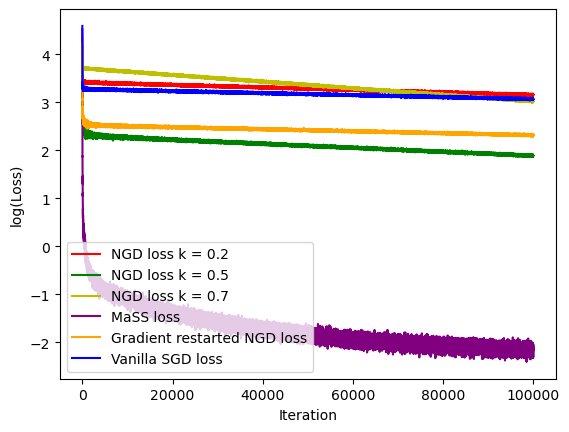

In [212]:
plt.plot(np.log10(Nesterov_losses_2), label = 'NGD loss k = 0.2', c = 'r')
plt.plot(np.log10(Nesterov_losses_5), label = 'NGD loss k = 0.5', c = 'g')
plt.plot(np.log10(Nesterov_losses_7), label = 'NGD loss k = 0.7', c = 'y')
plt.plot(np.log10(losses_mass), label = 'MaSS loss', c = 'purple')
plt.plot(np.log10(Nesterov_losses_R), label = 'Gradient restarted NGD loss', c = 'orange')


plt.plot(np.log10(losses), label = 'Vanilla SGD loss', c = 'b' )
plt.xlabel('Iteration')
plt.ylabel('log(Loss)')
plt.legend()
plt.savefig('/Users/pantelistassopoulos/Documents/texfiles/Summer-Research-2023/images/3d-spin-model-neural-net-loss-d=4.png')

In [445]:
c,z, Nesterov_losses_sgd = nesterov_train_stochastic(n = 16, steps = 30000, Dt = 1e-8)

In [6]:
c,z, losses_sgd = train_SGD(n = 16, steps = 30000, Dt = 1e-8)

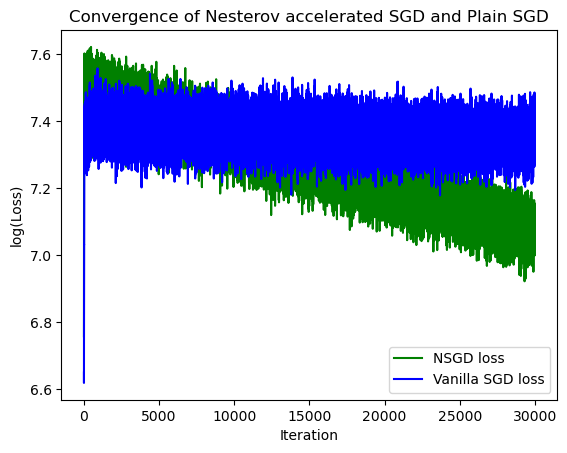

In [215]:
plt.plot(np.log10(Nesterov_losses_sgd), label = 'NSGD loss', c = 'g')
plt.plot(np.log10(losses_sgd), label = 'Vanilla SGD loss', c = 'b' )
plt.xlabel('Iteration')
plt.ylabel('log(Loss)')
plt.title('Convergence of Nesterov accelerated SGD and Plain SGD')
plt.legend()

## General Observations

- In the deterministic gradient flow (with random initialization), the Nesterov accelerated loss (green) decreases towards a minimum much faster than regular gradient descent (blue), as expected.
- In the stochastic gradient flow (with random initialization), the Nesterov accelerated loss (green) decreases  towards a minimum faster than regular gradient descent (blue), though the losses stay closer together
